In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = []
strings = """[
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,11],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.00025 ,11],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.00025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.00025 ,21]
]"""

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.7,
    risk_tolerance_stdev = 0.2,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[4552, 2084, 2578, 4493, 9895, 5358, 4920, 5416, 8686, 2224, 3507, 7096, 7887, 8127, 2335, 6628, 3041, 3506, 9698, 4041]
log initialized
Average similarity between family members is 0.9708759030221956 at temperature -1
Average similarity between family and home is 0.9998486839755688 at temperature -1
Average similarity between students and their classroom is 0.9552974104097343 at temperature -1
Average classroom occupancy is 1.7393939393939395 and number classrooms is 165
Average similarity between workers is 0.9718834115965617 at temperature -1
Average office occupancy is 3.5053763440860215 and number offices is 186
Average friend similarity for adults: 0.8602713571534957 for kids: 0.7375423818804067
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.60878927935199
avg restaurant similarity 0.6763374574965659
avg restaurant similarity 0.6790831674534208
avg restaurant similarity 0.6312413381264883
avg restaurant similarity 0.6072845634051905
avg restaurant similarity 0.6621715869687163
avg restaurant similarity 0.6273393021578733
avg restaurant similarity 0.6818078526469482
avg restaurant similarity 0.5879827386329793
avg restaurant similarity 0.6863202652838201
avg restaurant similarity 0.6651781062278631
avg restaurant similarity 0.6666957748870886
avg restaurant similarity 0.6180285102939579
avg restaurant similarity 0.6674573439983267
avg restaurant similarity 0.629745102750576
avg restaurant similarity 0.6547140742024997
avg restaurant similarity 0.7583729922442414
avg restaurant similarity 0.6597883706588494
avg restaurant similarity 0.6742900028589606
avg restaurant similarity 0.6027515456025622
avg restaurant similarity 0.6064760041803526
avg restaurant similarity 0.6518388072073461
avg restauran

avg restaurant similarity 0.7148641164656284
avg restaurant similarity 0.652817967845238
avg restaurant similarity 0.6541663941013549
avg restaurant similarity 0.6388699563335931
avg restaurant similarity 0.6324724348420353
avg restaurant similarity 0.6421274689131161
avg restaurant similarity 0.6385098555780173
avg restaurant similarity 0.7116912233452793
avg restaurant similarity 0.6128562613735934
avg restaurant similarity 0.6635456860154649
avg restaurant similarity 0.6783769470297205
avg restaurant similarity 0.6585321102723525
avg restaurant similarity 0.6617721846824212
avg restaurant similarity 0.6191841016788452
avg restaurant similarity 0.6698637337386949
avg restaurant similarity 0.663301644510345
avg restaurant similarity 0.7224085788959769
avg restaurant similarity 0.6522686638442
avg restaurant similarity 0.6998918635285116
avg restaurant similarity 0.6844334023198583
avg restaurant similarity 0.6355179944855294
avg restaurant similarity 0.6652018607653858
avg restaurant 

Average similarity between workers is 0.9737611912630982 at temperature -1
Average office occupancy is 3.431578947368421 and number offices is 190
Average friend similarity for adults: 0.8610495191647227 for kids: 0.7517437079958768
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.6419487716283635
avg restaurant similarity 0.6575299446192475
avg restaurant similarity 0.6471190408087535
avg restaurant similarity 0.6480086866631827
avg restaurant similarity 0.6331146995243547
avg restaurant similarity 0.6508018439670532
avg restaurant similarity 0.6530237602012713
avg restaurant similarity 0.6647615006964456
avg restaurant similarity 0.67065937265195
avg restaurant similarity 0.6869005602736618
avg restaurant similarity 0.6613814701986584
avg restaurant similarity 0.7250777621878152
avg restaurant similarity 0.6727682289084912
avg restaurant similarity 0.6476094469757873
avg restaurant similarity 0.6265722186015581
avg restaurant similarity 0.6248011503189731
avg restaurant similarity 0.6410723870210381
avg restaurant similarity 0.6891069521465418
avg restaurant similarity 0.696321936425603
avg restaurant similarity 0.6555803014288419
avg restaurant similarity 0.6571500105556498
avg restaurant similarity 0.7055812711899803
avg restauran

avg restaurant similarity 0.6472641951839174
avg restaurant similarity 0.6690577625582199
avg restaurant similarity 0.6783525592250759
avg restaurant similarity 0.601760240813088
avg restaurant similarity 0.6592583973228753
avg restaurant similarity 0.6637933548849276
avg restaurant similarity 0.6297254871477435
avg restaurant similarity 0.6353077741698783
avg restaurant similarity 0.644066691223709
avg restaurant similarity 0.6237274099203456
avg restaurant similarity 0.7060536826106685
avg restaurant similarity 0.6688551907464674
avg restaurant similarity 0.7090481922623991
avg restaurant similarity 0.6377483348837677
avg restaurant similarity 0.6504447059875352
avg restaurant similarity 0.667548270072361
avg restaurant similarity 0.6412646121235425
avg restaurant similarity 0.6481399750128063
avg restaurant similarity 0.6141089689962358
avg restaurant similarity 0.669493514611038
avg restaurant similarity 0.6317996502296352
avg restaurant similarity 0.6256842408898685
avg restaurant

Average similarity between workers is 0.9600276646904832 at temperature -1
Average office occupancy is 3.3655913978494625 and number offices is 186
Average friend similarity for adults: 0.8465182431439355 for kids: 0.7346813300960301
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6693854855764831
avg restaurant similarity 0.6735126527050324
avg restaurant similarity 0.6389296136993876
avg restaurant similarity 0.602860794526606
avg restaurant similarity 0.6135014312928683
avg restaurant similarity 0.6099824469888536
avg restaurant similarity 0.5968324434602997
avg restaurant similarity 0.5886479400081386
avg restaurant similarity 0.6335062090777654
avg restaurant similarity 0.6340586159245895
avg restaurant similarity 0.59014747362874
avg restaurant similarity 0.6670577727526842
avg restaurant similarity 0.6556075856767251
avg restaurant similarity 0.5794592937991224
avg restaurant similarity 0.632142539024853
avg restaurant similarity 0.6256529274584219
avg restaurant similarity 0.603523891800401
avg restaurant similarity 0.5881280501896203
avg restaurant similarity 0.5952261767005316
avg restaurant similarity 0.6236283924730508
avg restaurant similarity 0.609210452536478
avg restaurant similarity 0.6879346660745725
avg restaurant s

avg restaurant similarity 0.6230524614274092
avg restaurant similarity 0.6616360544934928
avg restaurant similarity 0.5999096940136028
avg restaurant similarity 0.6735514830864346
avg restaurant similarity 0.6141363071965206
avg restaurant similarity 0.6790483997053682
avg restaurant similarity 0.6824826070022573
avg restaurant similarity 0.6418053563419626
avg restaurant similarity 0.612298247088164
avg restaurant similarity 0.6390264038719798
avg restaurant similarity 0.624753919800872
avg restaurant similarity 0.613608428254374
avg restaurant similarity 0.6160116878359768
avg restaurant similarity 0.5692782940799186
avg restaurant similarity 0.6145267834624456
avg restaurant similarity 0.5966829989453287
avg restaurant similarity 0.5818387533930922
avg restaurant similarity 0.5989882189821563
avg restaurant similarity 0.5732919275515344
avg restaurant similarity 0.5614218843345384
avg restaurant similarity 0.5907224085158951
avg restaurant similarity 0.6242106454566742
avg restauran

Average similarity between workers is 0.9485882329822205 at temperature -1
Average office occupancy is 3.6648351648351647 and number offices is 182
Average friend similarity for adults: 0.8573270298489173 for kids: 0.7202767345249635
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6621636742061382
avg restaurant similarity 0.6829584989006994
avg restaurant similarity 0.6480845570826868
avg restaurant similarity 0.7045920308917709
avg restaurant similarity 0.694500582379212
avg restaurant similarity 0.6880201645575803
avg restaurant similarity 0.6650112805950036
avg restaurant similarity 0.678512745238832
avg restaurant similarity 0.6642607535589479
avg restaurant similarity 0.6648105633593204
avg restaurant similarity 0.6756982508518817
avg restaurant similarity 0.6259238563509567
avg restaurant similarity 0.6806421800373765
avg restaurant similarity 0.6893063013012416
avg restaurant similarity 0.6437208068140243
avg restaurant similarity 0.6342248487465779
avg restaurant similarity 0.7022918406058533
avg restaurant similarity 0.6737272720173654
avg restaurant similarity 0.6606666482390704
avg restaurant similarity 0.6647785494343262
avg restaurant similarity 0.6407150846305267
avg restaurant similarity 0.6975593410584319
avg restaura

avg restaurant similarity 0.688576810922528
avg restaurant similarity 0.6519351438733605
avg restaurant similarity 0.6427539845214046
avg restaurant similarity 0.6870958755853263
avg restaurant similarity 0.7011317147913533
avg restaurant similarity 0.6738111476708174
avg restaurant similarity 0.6573790381261949
avg restaurant similarity 0.6493022422453671
avg restaurant similarity 0.651461407113935
avg restaurant similarity 0.6947114306603568
avg restaurant similarity 0.6788283661005124
avg restaurant similarity 0.6893317082650952
avg restaurant similarity 0.6470961366655399
avg restaurant similarity 0.6681712875236084
avg restaurant similarity 0.6783809970607277
avg restaurant similarity 0.6924188937806022
avg restaurant similarity 0.693458229779714
avg restaurant similarity 0.6334209603801099
avg restaurant similarity 0.6584101586291716
avg restaurant similarity 0.6981325094967289
avg restaurant similarity 0.6811714415584383
avg restaurant similarity 0.6555681117331562
avg restauran

Average similarity between workers is 0.9651284035476079 at temperature -1
Average office occupancy is 3.6263736263736264 and number offices is 182
Average friend similarity for adults: 0.8528850483099274 for kids: 0.7349957102164257
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6494885113429624
avg restaurant similarity 0.5812777868184726
avg restaurant similarity 0.6646248692393025
avg restaurant similarity 0.6506573605123614
avg restaurant similarity 0.609370439804061
avg restaurant similarity 0.6206980183743407
avg restaurant similarity 0.5931921660116006
avg restaurant similarity 0.6540702086822465
avg restaurant similarity 0.6402891109037525
avg restaurant similarity 0.657630416109146
avg restaurant similarity 0.5952326498024084
avg restaurant similarity 0.6300944468468278
avg restaurant similarity 0.6495270229092823
avg restaurant similarity 0.5822668231773451
avg restaurant similarity 0.627380252850594
avg restaurant similarity 0.5961217697370262
avg restaurant similarity 0.5992615296230615
avg restaurant similarity 0.6451759393664952
avg restaurant similarity 0.6370651554667374
avg restaurant similarity 0.6422805015670945
avg restaurant similarity 0.6313485517165722
avg restaurant similarity 0.6371186978259192
avg restauran

avg restaurant similarity 0.6185383233599727
avg restaurant similarity 0.6480305972544338
avg restaurant similarity 0.5458302791575026
avg restaurant similarity 0.6309260527561994
avg restaurant similarity 0.5970974835659497
avg restaurant similarity 0.6237445656432264
avg restaurant similarity 0.6086687027819255
avg restaurant similarity 0.6778986562386993
avg restaurant similarity 0.6696987309368541
avg restaurant similarity 0.6446939339044929
avg restaurant similarity 0.598584294159443
avg restaurant similarity 0.5653240893822384
avg restaurant similarity 0.6082689295868352
avg restaurant similarity 0.5578236245991548
avg restaurant similarity 0.6725119571193449
avg restaurant similarity 0.593309893949725
avg restaurant similarity 0.6242885497705017
avg restaurant similarity 0.635802506813003
avg restaurant similarity 0.6740771063566845
avg restaurant similarity 0.5734933372772004
avg restaurant similarity 0.6184401573000174
avg restaurant similarity 0.6481387720764555
avg restauran

Average similarity between workers is 0.9762485120240145 at temperature -1
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8623729693359417 for kids: 0.7406153311252622
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people

avg restaurant similarity 0.7152414018764076
avg restaurant similarity 0.6727893030527137
avg restaurant similarity 0.71207877272636
avg restaurant similarity 0.7034597101941876
avg restaurant similarity 0.7043173822774637
avg restaurant similarity 0.7036803188884941
avg restaurant similarity 0.7329980192691689
avg restaurant similarity 0.6917647367807127
avg restaurant similarity 0.7100366246221845
avg restaurant similarity 0.6816269025484716
avg restaurant similarity 0.7073822190614711
avg restaurant similarity 0.6922696716006917
avg restaurant similarity 0.657342658431025
avg restaurant similarity 0.6825978198544989
avg restaurant similarity 0.7187936730495298
avg restaurant similarity 0.6374736055941972
avg restaurant similarity 0.6906476648153079
avg restaurant similarity 0.6919460784121834
avg restaurant similarity 0.6917666872901393
avg restaurant similarity 0.6520164134748051
avg restaurant similarity 0.7144980502346565
avg restaurant similarity 0.681530627994773
avg restaurant

avg restaurant similarity 0.639239094593969
avg restaurant similarity 0.7130658930993771
avg restaurant similarity 0.6749587314623249
avg restaurant similarity 0.7103893410971811
avg restaurant similarity 0.7240536604486859
avg restaurant similarity 0.6916408067483208
avg restaurant similarity 0.694272276439083
avg restaurant similarity 0.7034832397148375
avg restaurant similarity 0.6904169556913577
avg restaurant similarity 0.6868851318508031
avg restaurant similarity 0.7243408268266291
avg restaurant similarity 0.7029167807589898
avg restaurant similarity 0.692203871795547
avg restaurant similarity 0.7152414913094853
avg restaurant similarity 0.6664328532126389
avg restaurant similarity 0.6647679474355448
avg restaurant similarity 0.6940160402510719
avg restaurant similarity 0.6952325949968555
avg restaurant similarity 0.7011523237107873
avg restaurant similarity 0.6880069663720781
avg restaurant similarity 0.6824939211527483
avg restaurant similarity 0.6637895225119986
avg restauran

Average similarity between workers is 0.9692407932343334 at temperature -1
Average office occupancy is 3.551912568306011 and number offices is 183
Average friend similarity for adults: 0.8585500333775814 for kids: 0.7362144026502888
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people a

avg restaurant similarity 0.6484190672375426
avg restaurant similarity 0.6463232676438405
avg restaurant similarity 0.659172563636171
avg restaurant similarity 0.643853186353974
avg restaurant similarity 0.6199045897570787
avg restaurant similarity 0.6473038174975663
avg restaurant similarity 0.6789073916198497
avg restaurant similarity 0.6381715773937363
avg restaurant similarity 0.6776825305868543
avg restaurant similarity 0.6493642989463393
avg restaurant similarity 0.6665208928023617
avg restaurant similarity 0.6804682378634218
avg restaurant similarity 0.6929136273663034
avg restaurant similarity 0.6479118333875358
avg restaurant similarity 0.6812798836281712
avg restaurant similarity 0.6590831478567474
avg restaurant similarity 0.6876204347871929
avg restaurant similarity 0.6374336919060555
avg restaurant similarity 0.6552886230511803
avg restaurant similarity 0.6516362127182292
avg restaurant similarity 0.6069057582924439
avg restaurant similarity 0.6360197111307494
avg restaura

avg restaurant similarity 0.642094022978978
avg restaurant similarity 0.6498102747511505
avg restaurant similarity 0.5949883692547512
avg restaurant similarity 0.6580438814661735
avg restaurant similarity 0.7341021614115425
avg restaurant similarity 0.6943787473564401
avg restaurant similarity 0.6239734413384087
avg restaurant similarity 0.6598451798453826
avg restaurant similarity 0.695741296999852
avg restaurant similarity 0.6965838341162396
avg restaurant similarity 0.6192934007776209
avg restaurant similarity 0.6887194496629051
avg restaurant similarity 0.701100264247677
avg restaurant similarity 0.5976186956704482
avg restaurant similarity 0.6473859202339216
avg restaurant similarity 0.6708705957613714
avg restaurant similarity 0.6725639105132623
avg restaurant similarity 0.6826971733267835
avg restaurant similarity 0.6397666301536459
avg restaurant similarity 0.6692398495531254
avg restaurant similarity 0.6741284054498582
avg restaurant similarity 0.6397932275897322
avg restauran

Average similarity between workers is 0.9786741024643549 at temperature -1
Average office occupancy is 3.6 and number offices is 185
Average friend similarity for adults: 0.8688678065066794 for kids: 0.7410059289997656
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated i

avg restaurant similarity 0.6632871124294545
avg restaurant similarity 0.6902834553389299
avg restaurant similarity 0.6610435306659794
avg restaurant similarity 0.6951826517116877
avg restaurant similarity 0.6583223224811579
avg restaurant similarity 0.7120172019245296
avg restaurant similarity 0.7051181674433429
avg restaurant similarity 0.6930017194566321
avg restaurant similarity 0.6770085791292619
avg restaurant similarity 0.6572361496495792
avg restaurant similarity 0.6940664431051893
avg restaurant similarity 0.742185929990731
avg restaurant similarity 0.6797416667085252
avg restaurant similarity 0.6797311488137987
avg restaurant similarity 0.6446141718335113
avg restaurant similarity 0.682823545592014
avg restaurant similarity 0.69836393351993
avg restaurant similarity 0.7140240727203078
avg restaurant similarity 0.6968376784235443
avg restaurant similarity 0.6666727961403952
avg restaurant similarity 0.64064756972672
avg restaurant similarity 0.7253901816983679
avg restaurant s

avg restaurant similarity 0.7261764216363222
avg restaurant similarity 0.6461640000115104
avg restaurant similarity 0.7181847900671081
avg restaurant similarity 0.6631197313893494
avg restaurant similarity 0.6857769304580951
avg restaurant similarity 0.6692495467456511
avg restaurant similarity 0.7295083801895406
avg restaurant similarity 0.6313828911849717
avg restaurant similarity 0.6460541822845622
avg restaurant similarity 0.6435532065703371
avg restaurant similarity 0.6702776472387982
avg restaurant similarity 0.6587364298865147
avg restaurant similarity 0.6943133746673235
avg restaurant similarity 0.681058333178375
avg restaurant similarity 0.6415495788683958
avg restaurant similarity 0.726532450638771
avg restaurant similarity 0.697893552359818
avg restaurant similarity 0.7478786994193417
avg restaurant similarity 0.7152178640313225
avg restaurant similarity 0.6425715966476931
avg restaurant similarity 0.7418185666703954
avg restaurant similarity 0.7042047280911699
avg restauran

Average similarity between workers is 0.9633296779286468 at temperature -1
Average office occupancy is 3.545945945945946 and number offices is 185
Average friend similarity for adults: 0.8697900197879251 for kids: 0.7618414558982398
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6613534555375066
avg restaurant similarity 0.6377599332349957
avg restaurant similarity 0.6319015446220989
avg restaurant similarity 0.6333478093841193
avg restaurant similarity 0.6562586321285787
avg restaurant similarity 0.684749208348176
avg restaurant similarity 0.6911627529489144
avg restaurant similarity 0.6937163259871915
avg restaurant similarity 0.6821719508855827
avg restaurant similarity 0.6854871973491677
avg restaurant similarity 0.6554459276087404
avg restaurant similarity 0.6340992234052383
avg restaurant similarity 0.6626807462633885
avg restaurant similarity 0.6617316018432303
avg restaurant similarity 0.6180926431454636
avg restaurant similarity 0.6991332499569527
avg restaurant similarity 0.6619618161427493
avg restaurant similarity 0.6791560343367864
avg restaurant similarity 0.691164793428889
avg restaurant similarity 0.693973571425617
avg restaurant similarity 0.6433587539009646
avg restaurant similarity 0.63670365520135
avg restaurant 

avg restaurant similarity 0.6594219931619774
avg restaurant similarity 0.6678566903111345
avg restaurant similarity 0.6846583654980728
avg restaurant similarity 0.6757524785208814
avg restaurant similarity 0.661746945920261
avg restaurant similarity 0.6142304073302767
avg restaurant similarity 0.6869336368293142
avg restaurant similarity 0.6333781139547382
avg restaurant similarity 0.6614852769154149
avg restaurant similarity 0.7049526859217156
avg restaurant similarity 0.6422459168833254
avg restaurant similarity 0.6649388213075567
avg restaurant similarity 0.6904748131531208
avg restaurant similarity 0.679082944087535
avg restaurant similarity 0.6890694600842953
avg restaurant similarity 0.6714332228094059
avg restaurant similarity 0.6794448309706784
avg restaurant similarity 0.643377217619437
avg restaurant similarity 0.6950643420084421
avg restaurant similarity 0.6530447140132987
avg restaurant similarity 0.6762854585221073
avg restaurant similarity 0.6392553840451549
avg restauran

Average similarity between workers is 0.9593735634875457 at temperature -1
Average office occupancy is 3.457627118644068 and number offices is 177
Average friend similarity for adults: 0.8470473257755297 for kids: 0.7559041458592539
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.6399414001094511
avg restaurant similarity 0.6816659688352691
avg restaurant similarity 0.647317615389655
avg restaurant similarity 0.6462446013449417
avg restaurant similarity 0.6434825182418445
avg restaurant similarity 0.6896698836671761
avg restaurant similarity 0.6382689735367809
avg restaurant similarity 0.6315728959166338
avg restaurant similarity 0.6166052048228583
avg restaurant similarity 0.6995005408598034
avg restaurant similarity 0.6439936133387787
avg restaurant similarity 0.6794467533778822
avg restaurant similarity 0.6566554992236474
avg restaurant similarity 0.6317726334861392
avg restaurant similarity 0.656752325190712
avg restaurant similarity 0.646025608187394
avg restaurant similarity 0.5931931569531513
avg restaurant similarity 0.6524346028551375
avg restaurant similarity 0.6198974255188547
avg restaurant similarity 0.6227857397478693
avg restaurant similarity 0.65142032497131
avg restaurant similarity 0.6821492688980884
avg restaurant 

avg restaurant similarity 0.6289005169504637
avg restaurant similarity 0.6630327876913532
avg restaurant similarity 0.6780662239214259
avg restaurant similarity 0.6291292248565828
avg restaurant similarity 0.6969710036743016
avg restaurant similarity 0.6362797582225883
avg restaurant similarity 0.6611971093620839
avg restaurant similarity 0.6752925987706596
avg restaurant similarity 0.6154659286228842
avg restaurant similarity 0.5938343476593358
avg restaurant similarity 0.6700850876460664
avg restaurant similarity 0.6459089357728203
avg restaurant similarity 0.6954886641272549
avg restaurant similarity 0.6381659880875057
avg restaurant similarity 0.6428863131393767
avg restaurant similarity 0.652676727109107
avg restaurant similarity 0.6248494133648613
avg restaurant similarity 0.619886713185754
avg restaurant similarity 0.6586170493136304
avg restaurant similarity 0.6377114626427302
avg restaurant similarity 0.6438879081071665
avg restaurant similarity 0.6145200948603518
avg restaura

Average similarity between workers is 0.9573659105344828 at temperature -1
Average office occupancy is 3.6847826086956523 and number offices is 184
Average friend similarity for adults: 0.8664935506744955 for kids: 0.7270138535955138
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6847552700060414
avg restaurant similarity 0.6560878559232258
avg restaurant similarity 0.6427541594404037
avg restaurant similarity 0.6398887637931859
avg restaurant similarity 0.6525673607439583
avg restaurant similarity 0.6724636502310611
avg restaurant similarity 0.6564754568473955
avg restaurant similarity 0.6154703334857625
avg restaurant similarity 0.6315128847973003
avg restaurant similarity 0.6247915725961376
avg restaurant similarity 0.6591581163058349
avg restaurant similarity 0.6752664672338635
avg restaurant similarity 0.6709177845344511
avg restaurant similarity 0.6459031763195583
avg restaurant similarity 0.6939079632312745
avg restaurant similarity 0.649593546115478
avg restaurant similarity 0.6579179238935637
avg restaurant similarity 0.6617627768183961
avg restaurant similarity 0.6166142193860884
avg restaurant similarity 0.6716820346790945
avg restaurant similarity 0.6728558978722606
avg restaurant similarity 0.6473895926973089
avg restaur

avg restaurant similarity 0.688986178227264
avg restaurant similarity 0.6683575390186427
avg restaurant similarity 0.6550185573722933
avg restaurant similarity 0.6195083279235374
avg restaurant similarity 0.6630679655653646
avg restaurant similarity 0.6690208510464496
avg restaurant similarity 0.6294515930298846
avg restaurant similarity 0.6296615773821423
avg restaurant similarity 0.6999595445074768
avg restaurant similarity 0.6971978369733848
avg restaurant similarity 0.615863766696065
avg restaurant similarity 0.611185346978649
avg restaurant similarity 0.6227507106303548
avg restaurant similarity 0.6278664942358361
avg restaurant similarity 0.6200403396475482
avg restaurant similarity 0.6509077137617595
avg restaurant similarity 0.638431162572406
avg restaurant similarity 0.6194291718792149
avg restaurant similarity 0.6508110870856828
avg restaurant similarity 0.6310886635299381
avg restaurant similarity 0.6360854230520914
avg restaurant similarity 0.6590221641063513
avg restaurant

Average similarity between workers is 0.9643932452672032 at temperature -1
Average office occupancy is 3.5815217391304346 and number offices is 184
Average friend similarity for adults: 0.8637204070646366 for kids: 0.7592903288782731
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peopl

avg restaurant similarity 0.6550751875647676
avg restaurant similarity 0.6871331186281059
avg restaurant similarity 0.7466361398325062
avg restaurant similarity 0.6618447157873082
avg restaurant similarity 0.7022915170604269
avg restaurant similarity 0.6988085996779583
avg restaurant similarity 0.7086917414225764
avg restaurant similarity 0.6815674117188727
avg restaurant similarity 0.7146487507479692
avg restaurant similarity 0.6450589038454826
avg restaurant similarity 0.6345487310553479
avg restaurant similarity 0.6598401693151179
avg restaurant similarity 0.7162776507081176
avg restaurant similarity 0.7025047910634099
avg restaurant similarity 0.6890291240769282
avg restaurant similarity 0.6670046942705922
avg restaurant similarity 0.7069761779872613
avg restaurant similarity 0.6821661244725977
avg restaurant similarity 0.7017657492975238
avg restaurant similarity 0.664647531279552
avg restaurant similarity 0.6839548126143074
avg restaurant similarity 0.6852436161378113
avg restaur

avg restaurant similarity 0.7141144623217993
avg restaurant similarity 0.7002269333814872
avg restaurant similarity 0.6920509059157792
avg restaurant similarity 0.7114018056186885
avg restaurant similarity 0.708969691906497
avg restaurant similarity 0.6916849626361422
avg restaurant similarity 0.7098485712739276
avg restaurant similarity 0.6924098973724392
avg restaurant similarity 0.765077735670821
avg restaurant similarity 0.6945582452149343
avg restaurant similarity 0.6680422635439615
avg restaurant similarity 0.670122054196485
avg restaurant similarity 0.6928769377274269
avg restaurant similarity 0.6710370466821495
avg restaurant similarity 0.6769683133413017
avg restaurant similarity 0.698845484823744
avg restaurant similarity 0.6511826387956445
avg restaurant similarity 0.7265661597043037
avg restaurant similarity 0.6815129437203321
avg restaurant similarity 0.6611423312031719
avg restaurant similarity 0.6898608966784222
avg restaurant similarity 0.6783266801057674
avg restaurant

Average similarity between workers is 0.9641391308482443 at temperature -1
Average office occupancy is 3.681318681318681 and number offices is 182
Average friend similarity for adults: 0.865889815254451 for kids: 0.7274427140266014
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 peo

avg restaurant similarity 0.6221908739174277
avg restaurant similarity 0.6605611411664964
avg restaurant similarity 0.666743109088867
avg restaurant similarity 0.6765487270049699
avg restaurant similarity 0.6301656412082899
avg restaurant similarity 0.6522748826990387
avg restaurant similarity 0.6636462484285786
avg restaurant similarity 0.6710218942455053
avg restaurant similarity 0.6620970497572454
avg restaurant similarity 0.6679662837228452
avg restaurant similarity 0.6463431156470308
avg restaurant similarity 0.6529622105847135
avg restaurant similarity 0.6776273591028312
avg restaurant similarity 0.6759092455954101
avg restaurant similarity 0.634011196087179
avg restaurant similarity 0.6693689169734717
avg restaurant similarity 0.6548411948627075
avg restaurant similarity 0.6227689430216158
avg restaurant similarity 0.6612842589051217
avg restaurant similarity 0.6727795924068528
avg restaurant similarity 0.6612650235495791
avg restaurant similarity 0.6695263016161398
avg restaura

avg restaurant similarity 0.6302418456945602
avg restaurant similarity 0.6317452187172127
avg restaurant similarity 0.6398215355083283
avg restaurant similarity 0.6434761454362711
avg restaurant similarity 0.6510266544397181
avg restaurant similarity 0.6577644256825943
avg restaurant similarity 0.6435754292979818
avg restaurant similarity 0.6738026090355238
avg restaurant similarity 0.5943904130275632
avg restaurant similarity 0.5983025991195821
avg restaurant similarity 0.6511766090444504
avg restaurant similarity 0.6811083724149819
avg restaurant similarity 0.6819683321418997
avg restaurant similarity 0.6698912013178598
avg restaurant similarity 0.6919777153243799
avg restaurant similarity 0.637613227841164
avg restaurant similarity 0.6920170940257613
avg restaurant similarity 0.6535925894761364
avg restaurant similarity 0.6785439824211227
avg restaurant similarity 0.6308102799701572
avg restaurant similarity 0.6896969874654314
avg restaurant similarity 0.663177611137737
avg restaura

Average similarity between workers is 0.9561358062475906 at temperature -1
Average office occupancy is 3.6432432432432433 and number offices is 185
Average friend similarity for adults: 0.8602166660804277 for kids: 0.7251782849784174
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.7370438259503556
avg restaurant similarity 0.6875202992701723
avg restaurant similarity 0.6919269895573156
avg restaurant similarity 0.6740471529843788
avg restaurant similarity 0.6617388434970778
avg restaurant similarity 0.6955641962875933
avg restaurant similarity 0.6797773627988087
avg restaurant similarity 0.6676727661391151
avg restaurant similarity 0.6227246915148135
avg restaurant similarity 0.7017231788718911
avg restaurant similarity 0.6496324680357676
avg restaurant similarity 0.6262804038360215
avg restaurant similarity 0.7013791405996951
avg restaurant similarity 0.6443821380068256
avg restaurant similarity 0.625076416028318
avg restaurant similarity 0.6812166180695141
avg restaurant similarity 0.6805412620814317
avg restaurant similarity 0.6424376345295302
avg restaurant similarity 0.6481437072824382
avg restaurant similarity 0.6670278639808862
avg restaurant similarity 0.7205076893740705
avg restaurant similarity 0.7121325497014434
avg restaur

avg restaurant similarity 0.6300779961390807
avg restaurant similarity 0.7036000540563956
avg restaurant similarity 0.643570226251772
avg restaurant similarity 0.6474729677196998
avg restaurant similarity 0.6910867387060851
avg restaurant similarity 0.6482882528357584
avg restaurant similarity 0.6337067109023157
avg restaurant similarity 0.6951739212731977
avg restaurant similarity 0.6429085750603721
avg restaurant similarity 0.6662360305488747
avg restaurant similarity 0.6450011639045611
avg restaurant similarity 0.6530248024799866
avg restaurant similarity 0.6498089420288712
avg restaurant similarity 0.6524253595008488
avg restaurant similarity 0.6847538214800818
avg restaurant similarity 0.6971224215078881
avg restaurant similarity 0.6740766722302451
avg restaurant similarity 0.649293248022567
avg restaurant similarity 0.685669724251536
avg restaurant similarity 0.6951528071433476
avg restaurant similarity 0.6140739192526291
avg restaurant similarity 0.6467030094551114
avg restauran

Average similarity between workers is 0.9704470471677562 at temperature -1
Average office occupancy is 3.5401069518716577 and number offices is 187
Average friend similarity for adults: 0.8570054385725053 for kids: 0.73675395807953
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.6361557704733375
avg restaurant similarity 0.6182331232574612
avg restaurant similarity 0.6426362170542124
avg restaurant similarity 0.5665540772421398
avg restaurant similarity 0.5839303649434677
avg restaurant similarity 0.6221367458913823
avg restaurant similarity 0.6572841494963282
avg restaurant similarity 0.610404766689352
avg restaurant similarity 0.6770904614058593
avg restaurant similarity 0.6334388036414601
avg restaurant similarity 0.578392611776133
avg restaurant similarity 0.6818154420381263
avg restaurant similarity 0.7042776632474999
avg restaurant similarity 0.5727615385189702
avg restaurant similarity 0.6580194712031358
avg restaurant similarity 0.6695383523454894
avg restaurant similarity 0.6022646198182853
avg restaurant similarity 0.6754574441103224
avg restaurant similarity 0.6520048801372963
avg restaurant similarity 0.6907903745688293
avg restaurant similarity 0.6054157656840503
avg restaurant similarity 0.668429901083912
avg restauran

avg restaurant similarity 0.6457941908786905
avg restaurant similarity 0.6402751142813343
avg restaurant similarity 0.5958526458048633
avg restaurant similarity 0.6487555417910411
avg restaurant similarity 0.6504374094190601
avg restaurant similarity 0.6360794510779093
avg restaurant similarity 0.6623168938647052
avg restaurant similarity 0.6315904944863261
avg restaurant similarity 0.580405554258304
avg restaurant similarity 0.6073889955271878
avg restaurant similarity 0.5826476002495227
avg restaurant similarity 0.7407412364364098
avg restaurant similarity 0.6293069117251591
avg restaurant similarity 0.6297508617987367
avg restaurant similarity 0.6299380381511441
avg restaurant similarity 0.5689112335132593
avg restaurant similarity 0.6334435528329428
avg restaurant similarity 0.7060188134337604
avg restaurant similarity 0.6376265323370034
avg restaurant similarity 0.6327007612103799
avg restaurant similarity 0.6249604587145986
avg restaurant similarity 0.5946085144623097
avg restaur

Average similarity between workers is 0.9757725727293451 at temperature -1
Average office occupancy is 3.513089005235602 and number offices is 191
Average friend similarity for adults: 0.8689236251342474 for kids: 0.7525143142582756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 peop

avg restaurant similarity 0.6286889664358518
avg restaurant similarity 0.6232365808511008
avg restaurant similarity 0.6350530011342599
avg restaurant similarity 0.663655294349797
avg restaurant similarity 0.6800901275144943
avg restaurant similarity 0.6330880180905336
avg restaurant similarity 0.6839139752027287
avg restaurant similarity 0.6522602470826588
avg restaurant similarity 0.644331446355137
avg restaurant similarity 0.6854944998337962
avg restaurant similarity 0.6452754742936783
avg restaurant similarity 0.604350401686674
avg restaurant similarity 0.6830605578205489
avg restaurant similarity 0.6516677312992213
avg restaurant similarity 0.6063696316507874
avg restaurant similarity 0.6917097003227911
avg restaurant similarity 0.6299927602493269
avg restaurant similarity 0.6195693993359335
avg restaurant similarity 0.6754093693903355
avg restaurant similarity 0.6562192660372889
avg restaurant similarity 0.6671147917077869
avg restaurant similarity 0.6743723026709856
avg restauran

avg restaurant similarity 0.6964135901544296
avg restaurant similarity 0.656117323140511
avg restaurant similarity 0.6336950178614933
avg restaurant similarity 0.6247027476503376
avg restaurant similarity 0.658433429472497
avg restaurant similarity 0.6625693767710039
avg restaurant similarity 0.6261720927276988
avg restaurant similarity 0.6178149770635422
avg restaurant similarity 0.6911256450784261
avg restaurant similarity 0.6407269208632432
avg restaurant similarity 0.6445714149690057
avg restaurant similarity 0.6615059589113237
avg restaurant similarity 0.6846070326176052
avg restaurant similarity 0.6827029974908511
avg restaurant similarity 0.6496839707684234
avg restaurant similarity 0.6959543742786962
avg restaurant similarity 0.7002930395652237
avg restaurant similarity 0.6809627846662198
avg restaurant similarity 0.6749306777235958
avg restaurant similarity 0.6244860389997676
avg restaurant similarity 0.6662058415611607
avg restaurant similarity 0.6647392937430402
avg restaura

Average similarity between workers is 0.9741300794333477 at temperature -1
Average office occupancy is 3.657754010695187 and number offices is 187
Average friend similarity for adults: 0.8730470551934346 for kids: 0.7272870765812828
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6426469203674341
avg restaurant similarity 0.6662270931578679
avg restaurant similarity 0.6945461525326494
avg restaurant similarity 0.66386608918135
avg restaurant similarity 0.672701825174356
avg restaurant similarity 0.6241389330128414
avg restaurant similarity 0.6249386990496681
avg restaurant similarity 0.6746721281430448
avg restaurant similarity 0.6796539695832469
avg restaurant similarity 0.6530338161265832
avg restaurant similarity 0.629733493156939
avg restaurant similarity 0.6062483314282051
avg restaurant similarity 0.6801883450767918
avg restaurant similarity 0.6104159966011028
avg restaurant similarity 0.6275408423795243
avg restaurant similarity 0.6076387116702191
avg restaurant similarity 0.5905714650813508
avg restaurant similarity 0.6323195252016065
avg restaurant similarity 0.6223114690459736
avg restaurant similarity 0.651004735834846
avg restaurant similarity 0.6161336047825287
avg restaurant similarity 0.6958395587017875
avg restaurant 

avg restaurant similarity 0.6752958317265684
avg restaurant similarity 0.6689048716654904
avg restaurant similarity 0.6614339385812695
avg restaurant similarity 0.6166077007579664
avg restaurant similarity 0.6280902117806514
avg restaurant similarity 0.7047828771445996
avg restaurant similarity 0.6114018120683821
avg restaurant similarity 0.630006627016328
avg restaurant similarity 0.6714065310945083
avg restaurant similarity 0.597173456211814
avg restaurant similarity 0.6123512097029035
avg restaurant similarity 0.6718196160408325
avg restaurant similarity 0.638143707852528
avg restaurant similarity 0.6154046760622566
avg restaurant similarity 0.6555779729671907
avg restaurant similarity 0.6598191471093334
avg restaurant similarity 0.6796365108256707
avg restaurant similarity 0.683107665758382
avg restaurant similarity 0.6758838510970934
avg restaurant similarity 0.6380920736992941
avg restaurant similarity 0.5841774186738229
avg restaurant similarity 0.5894962944462004
avg restaurant

Average similarity between workers is 0.9636415860898939 at temperature -1
Average office occupancy is 3.6666666666666665 and number offices is 183
Average friend similarity for adults: 0.8571466189853969 for kids: 0.7446143614897552
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.6408127689148544
avg restaurant similarity 0.6553821537007578
avg restaurant similarity 0.6679328985833858
avg restaurant similarity 0.6688572483739039
avg restaurant similarity 0.6697606971423662
avg restaurant similarity 0.6631127788487886
avg restaurant similarity 0.6206881444684992
avg restaurant similarity 0.6698073705790852
avg restaurant similarity 0.6575564083592966
avg restaurant similarity 0.6395608228797642
avg restaurant similarity 0.6513572141400507
avg restaurant similarity 0.6198716064106796
avg restaurant similarity 0.65757168237468
avg restaurant similarity 0.6477443203170554
avg restaurant similarity 0.6239625330564603
avg restaurant similarity 0.6542845011600189
avg restaurant similarity 0.6541856288167247
avg restaurant similarity 0.6252356098634448
avg restaurant similarity 0.6263366825053989
avg restaurant similarity 0.6239502726815698
avg restaurant similarity 0.6603079458500943
avg restaurant similarity 0.6246605751525973
avg restaura

avg restaurant similarity 0.6138748239431255
avg restaurant similarity 0.6313868451843796
avg restaurant similarity 0.6231550202133396
avg restaurant similarity 0.673554457367028
avg restaurant similarity 0.6175276772911552
avg restaurant similarity 0.6235480316149802
avg restaurant similarity 0.6422209393452702
avg restaurant similarity 0.634640033990342
avg restaurant similarity 0.6742842105713172
avg restaurant similarity 0.6126305124908032
avg restaurant similarity 0.6827877732018865
avg restaurant similarity 0.6493163036627947
avg restaurant similarity 0.6293318116443803
avg restaurant similarity 0.6851933206256241
avg restaurant similarity 0.6516298417090111
avg restaurant similarity 0.6578142694248686
avg restaurant similarity 0.6542560736183626
avg restaurant similarity 0.6513036952418414
avg restaurant similarity 0.6552883699103056
avg restaurant similarity 0.6174014190784193
avg restaurant similarity 0.6376353789637296
avg restaurant similarity 0.6540958470079319
avg restaura

Average similarity between workers is 0.9482771518314863 at temperature -1
Average office occupancy is 3.5801104972375692 and number offices is 181
Average friend similarity for adults: 0.8557399399132924 for kids: 0.7401936557397139
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6801962615440564
avg restaurant similarity 0.7048297675849724
avg restaurant similarity 0.6286490647705868
avg restaurant similarity 0.669131958393634
avg restaurant similarity 0.641643860224296
avg restaurant similarity 0.6796731026713233
avg restaurant similarity 0.6461106118412498
avg restaurant similarity 0.6359502058337152
avg restaurant similarity 0.6679984781983015
avg restaurant similarity 0.6933190472703349
avg restaurant similarity 0.6519655150774668
avg restaurant similarity 0.6841583255416555
avg restaurant similarity 0.6838486710532183
avg restaurant similarity 0.653649567147893
avg restaurant similarity 0.6600491839572974
avg restaurant similarity 0.6780578801945318
avg restaurant similarity 0.6646813981320702
avg restaurant similarity 0.6821387422898475
avg restaurant similarity 0.6796637491537392
avg restaurant similarity 0.6806386777185955
avg restaurant similarity 0.6514062653206801
avg restaurant similarity 0.6901913473380462
avg restauran

avg restaurant similarity 0.6658291956035686
avg restaurant similarity 0.6608130701793514
avg restaurant similarity 0.6229759205413701
avg restaurant similarity 0.6662767774463794
avg restaurant similarity 0.6758492042447267
avg restaurant similarity 0.6598193224866106
avg restaurant similarity 0.667941905874381
avg restaurant similarity 0.7287381996223147
avg restaurant similarity 0.6626379560277487
avg restaurant similarity 0.6277381884588907
avg restaurant similarity 0.6840985430809119
avg restaurant similarity 0.6766308221170585
avg restaurant similarity 0.6506870759198925
avg restaurant similarity 0.6506625186086813
avg restaurant similarity 0.6804894319805874
avg restaurant similarity 0.6917364672311132
avg restaurant similarity 0.6990073798017407
avg restaurant similarity 0.6574198506478901
avg restaurant similarity 0.6933538689062341
avg restaurant similarity 0.648620812632497
avg restaurant similarity 0.6360024094005253
avg restaurant similarity 0.6539753390841744
avg restaura

Average similarity between workers is 0.9675253703400597 at temperature -1
Average office occupancy is 3.7431693989071038 and number offices is 183
Average friend similarity for adults: 0.8585433605862418 for kids: 0.720987355694879
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.6613218159055788
avg restaurant similarity 0.635379013651664
avg restaurant similarity 0.6915145047016164
avg restaurant similarity 0.6441459718313456
avg restaurant similarity 0.6623230438526919
avg restaurant similarity 0.6433505707440248
avg restaurant similarity 0.6277072334823421
avg restaurant similarity 0.6876100036333851
avg restaurant similarity 0.6439784219727859
avg restaurant similarity 0.6655028596116228
avg restaurant similarity 0.6404743691470831
avg restaurant similarity 0.6718845997190382
avg restaurant similarity 0.6659820787317611
avg restaurant similarity 0.6052352608601345
avg restaurant similarity 0.6052984564593079
avg restaurant similarity 0.6246390143514724
avg restaurant similarity 0.6581263453103093
avg restaurant similarity 0.6691718920295752
avg restaurant similarity 0.6206057191749278
avg restaurant similarity 0.6799814590503613
avg restaurant similarity 0.6356785980195614
avg restaurant similarity 0.597529290683787
avg restaura

avg restaurant similarity 0.6378145034215659
avg restaurant similarity 0.6871361111051613
avg restaurant similarity 0.6762181570307008
avg restaurant similarity 0.5934733969035304
avg restaurant similarity 0.598565205686172
avg restaurant similarity 0.6379515444468832
avg restaurant similarity 0.5561402443538007
avg restaurant similarity 0.7082521472888207
avg restaurant similarity 0.635447805968506
avg restaurant similarity 0.6231912446004259
avg restaurant similarity 0.6276941272217296
avg restaurant similarity 0.6679222537083006
avg restaurant similarity 0.643500148774594
avg restaurant similarity 0.606918126481131
avg restaurant similarity 0.5884783342089341
avg restaurant similarity 0.6837565084379104
avg restaurant similarity 0.6289656139238246
avg restaurant similarity 0.6742334243036431
avg restaurant similarity 0.6520518758678056
avg restaurant similarity 0.6511743593003604
avg restaurant similarity 0.619339801257146
avg restaurant similarity 0.6515666259991952
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

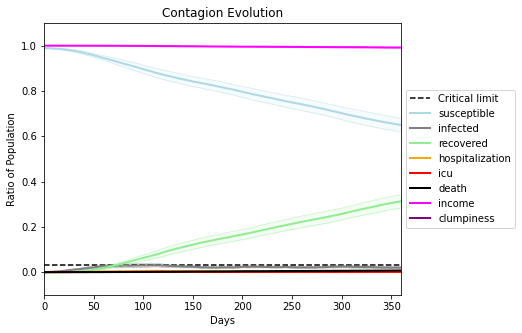

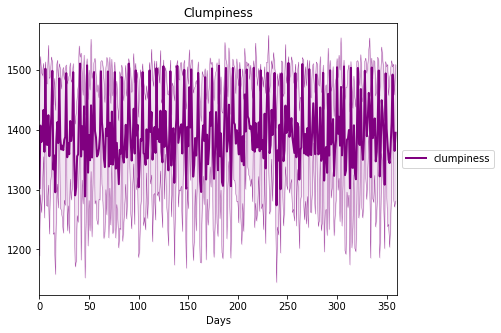

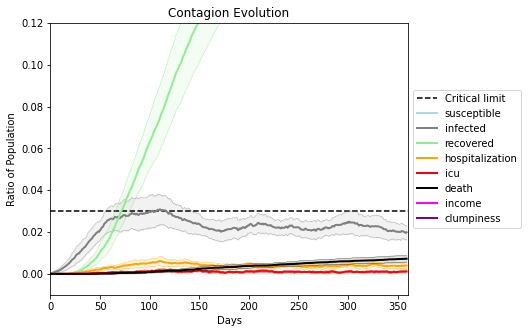

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2603, 1397, 3224, 5569, 7565, 2276, 6745, 9817, 8445, 6392, 780, 3283, 7614, 1866, 2613, 2671, 5447, 4034, 6473, 2148]
Average similarity between family members is 0.9676319938927368 at temperature -0.999
Average similarity between family and home is 0.9998507585740308 at temperature -1
Average similarity between students and their classroom is 0.9490753569706523 at temperature -0.999
Average classroom occupancy is 1.6740331491712708 and number classrooms is 181
Average similarity between workers is 0.96095203480032 at temperature -0.999
Average office occupancy is 3.595505617977528 and number offices is 178
Average friend similarity for adults: 0.8567127050360237 for kids: 0.7463196155336899
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.5814543185406339
avg restaurant similarity 0.5890520084915213
avg restaurant similarity 0.6191961905132427
avg restaurant similarity 0.6046908352136954
avg restaurant similarity 0.5899225277826234
avg restaurant similarity 0.62249069800812
avg restaurant similarity 0.6085764215998691
avg restaurant similarity 0.6141663785670205
avg restaurant similarity 0.5877985521496416
avg restaurant similarity 0.6211555925344145
avg restaurant similarity 0.5794310332569141
avg restaurant similarity 0.5794155845926039
avg restaurant similarity 0.6162585955720009
avg restaurant similarity 0.6448156858957687
avg restaurant similarity 0.6388655689721843
avg restaurant similarity 0.6070979812130716
avg restaurant similarity 0.5728703271477075
avg restaurant similarity 0.6371718793021315
avg restaurant similarity 0.5720092014142582
avg restaurant similarity 0.6360913745455065
avg restaurant similarity 0.6661743912285627
avg restaurant similarity 0.6378076452168614
avg restaura

avg restaurant similarity 0.653630622240768
avg restaurant similarity 0.6555217161087912
avg restaurant similarity 0.5730125059989849
avg restaurant similarity 0.6442878239522204
avg restaurant similarity 0.6012958775259363
avg restaurant similarity 0.6756734915872252
avg restaurant similarity 0.5401192983193873
avg restaurant similarity 0.617600834359166
avg restaurant similarity 0.6110228911010175
avg restaurant similarity 0.5632839014700667
avg restaurant similarity 0.6664914488350316
avg restaurant similarity 0.5645600552697975
avg restaurant similarity 0.6221570557144327
avg restaurant similarity 0.5960392978023479
avg restaurant similarity 0.6485948583544153
avg restaurant similarity 0.5747070226503224
avg restaurant similarity 0.7372022107972903
avg restaurant similarity 0.6333830389116003
avg restaurant similarity 0.5489029285177717
avg restaurant similarity 0.6588843077940499
avg restaurant similarity 0.6244563985069961
avg restaurant similarity 0.6130045124900633
avg restaura

Average similarity between workers is 0.9673292878870626 at temperature -0.999
Average office occupancy is 3.610810810810811 and number offices is 185
Average friend similarity for adults: 0.8600197455585009 for kids: 0.7237032119360359
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.7242936012962684
avg restaurant similarity 0.6305161288918382
avg restaurant similarity 0.6576804335460245
avg restaurant similarity 0.6364261751793417
avg restaurant similarity 0.7294401948099565
avg restaurant similarity 0.6911133180873746
avg restaurant similarity 0.6176002376157818
avg restaurant similarity 0.6700675200799756
avg restaurant similarity 0.643307805362824
avg restaurant similarity 0.7219277046133817
avg restaurant similarity 0.6524771695467
avg restaurant similarity 0.6475057082387782
avg restaurant similarity 0.6884099228716714
avg restaurant similarity 0.6526778402681864
avg restaurant similarity 0.6819764571226183
avg restaurant similarity 0.6469142409472465
avg restaurant similarity 0.5720018012469262
avg restaurant similarity 0.7195662329470329
avg restaurant similarity 0.6959941663032313
avg restaurant similarity 0.6509893061659618
avg restaurant similarity 0.6744440894517282
avg restaurant similarity 0.6842792107450966
avg restaurant

avg restaurant similarity 0.6953342696145387
avg restaurant similarity 0.6468245880120699
avg restaurant similarity 0.7031813521246196
avg restaurant similarity 0.6718115779582562
avg restaurant similarity 0.6284404343928939
avg restaurant similarity 0.6492127341711516
avg restaurant similarity 0.6852951285620948
avg restaurant similarity 0.6839348459976409
avg restaurant similarity 0.6994123431374423
avg restaurant similarity 0.6519503939602145
avg restaurant similarity 0.7442996742202729
avg restaurant similarity 0.6544366300384102
avg restaurant similarity 0.6974815513292827
avg restaurant similarity 0.7119387528542468
avg restaurant similarity 0.6091872210950762
avg restaurant similarity 0.671122369639427
avg restaurant similarity 0.6897592572488939
avg restaurant similarity 0.6704637005806151
avg restaurant similarity 0.7294257262400986
avg restaurant similarity 0.655414195459029
avg restaurant similarity 0.6613657163081417
avg restaurant similarity 0.703123343070766
avg restauran

Average similarity between workers is 0.9655297489961696 at temperature -0.999
Average office occupancy is 3.6629834254143647 and number offices is 181
Average friend similarity for adults: 0.8647080571392342 for kids: 0.734705737461723
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.6428151739050986
avg restaurant similarity 0.6305713664931322
avg restaurant similarity 0.6435248733277442
avg restaurant similarity 0.6550230537585039
avg restaurant similarity 0.6735005211370474
avg restaurant similarity 0.6577436119562878
avg restaurant similarity 0.6307934060219716
avg restaurant similarity 0.6168714052217513
avg restaurant similarity 0.6573971738728613
avg restaurant similarity 0.6374931434444582
avg restaurant similarity 0.6409655923135902
avg restaurant similarity 0.6828381519864208
avg restaurant similarity 0.6635750696805482
avg restaurant similarity 0.7044277895943734
avg restaurant similarity 0.6788575616233675
avg restaurant similarity 0.619375348922125
avg restaurant similarity 0.6651445898422478
avg restaurant similarity 0.6441405695799474
avg restaurant similarity 0.6347761727667255
avg restaurant similarity 0.6860524732275772
avg restaurant similarity 0.6883395636319896
avg restaurant similarity 0.650687346331319
avg restaura

avg restaurant similarity 0.6780758948417339
avg restaurant similarity 0.6241417021049896
avg restaurant similarity 0.6619967237538611
avg restaurant similarity 0.6488995143268772
avg restaurant similarity 0.6540496171790395
avg restaurant similarity 0.6810364788085069
avg restaurant similarity 0.6217318430398588
avg restaurant similarity 0.6348152361745142
avg restaurant similarity 0.67159635352191
avg restaurant similarity 0.6510240701108355
avg restaurant similarity 0.623561068912284
avg restaurant similarity 0.6590876372578718
avg restaurant similarity 0.6523186878022895
avg restaurant similarity 0.6469477170923091
avg restaurant similarity 0.6749964768718469
avg restaurant similarity 0.6995342888865453
avg restaurant similarity 0.6748178330156896
avg restaurant similarity 0.6879137233072424
avg restaurant similarity 0.6296022900344613
avg restaurant similarity 0.6127326942501978
avg restaurant similarity 0.6998434667489509
avg restaurant similarity 0.6546959846359528
avg restauran

Average similarity between workers is 0.9602322201641176 at temperature -0.999
Average office occupancy is 3.433862433862434 and number offices is 189
Average friend similarity for adults: 0.8491107188965336 for kids: 0.7376884210470683
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6796346216992021
avg restaurant similarity 0.6872009291276945
avg restaurant similarity 0.665500954465995
avg restaurant similarity 0.6274206261849368
avg restaurant similarity 0.6404722857871341
avg restaurant similarity 0.609003233864552
avg restaurant similarity 0.6308528074923364
avg restaurant similarity 0.6350487984613342
avg restaurant similarity 0.6496052366483085
avg restaurant similarity 0.666960020805258
avg restaurant similarity 0.6633915264012665
avg restaurant similarity 0.671222455879497
avg restaurant similarity 0.6609333052312067
avg restaurant similarity 0.628072087284475
avg restaurant similarity 0.6491878053479974
avg restaurant similarity 0.5910242548181652
avg restaurant similarity 0.6420319437186522
avg restaurant similarity 0.613133611210519
avg restaurant similarity 0.6606954302634652
avg restaurant similarity 0.6497509913137008
avg restaurant similarity 0.6333290372019454
avg restaurant similarity 0.6614630289923209
avg restaurant s

avg restaurant similarity 0.6323977368968292
avg restaurant similarity 0.676689157696204
avg restaurant similarity 0.6880642607640628
avg restaurant similarity 0.6157920621596593
avg restaurant similarity 0.6666392821584928
avg restaurant similarity 0.6599622063932813
avg restaurant similarity 0.6418163036717056
avg restaurant similarity 0.6724091406105227
avg restaurant similarity 0.6636999136421232
avg restaurant similarity 0.6622733856989677
avg restaurant similarity 0.6016629725850239
avg restaurant similarity 0.6338328100844683
avg restaurant similarity 0.6451627553652741
avg restaurant similarity 0.6444552477168332
avg restaurant similarity 0.6105968421869836
avg restaurant similarity 0.6687257844622345
avg restaurant similarity 0.6669625808217421
avg restaurant similarity 0.6504845450762392
avg restaurant similarity 0.6632637007355922
avg restaurant similarity 0.6894169106677637
avg restaurant similarity 0.6235015156315683
avg restaurant similarity 0.6694613314720455
avg restaur

Average similarity between workers is 0.9654613242140881 at temperature -0.999
Average office occupancy is 3.679558011049724 and number offices is 181
Average friend similarity for adults: 0.8573147896581399 for kids: 0.723384630652674
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.6429398715615887
avg restaurant similarity 0.6350721864580041
avg restaurant similarity 0.6974787313831192
avg restaurant similarity 0.68346088582572
avg restaurant similarity 0.6296800265875052
avg restaurant similarity 0.6779681767632552
avg restaurant similarity 0.6311805083258857
avg restaurant similarity 0.6845862766916101
avg restaurant similarity 0.6912804605506795
avg restaurant similarity 0.6340790509017421
avg restaurant similarity 0.6966120091037179
avg restaurant similarity 0.6895981969943517
avg restaurant similarity 0.6738027776743045
avg restaurant similarity 0.6539003973038789
avg restaurant similarity 0.6722409193976816
avg restaurant similarity 0.7133461040253543
avg restaurant similarity 0.7204929969213053
avg restaurant similarity 0.6837215442768708
avg restaurant similarity 0.6951943140230734
avg restaurant similarity 0.6851466173630701
avg restaurant similarity 0.6756227170619667
avg restaurant similarity 0.6710164992113002
avg restaura

avg restaurant similarity 0.7065895519046279
avg restaurant similarity 0.7031865166608336
avg restaurant similarity 0.6473562686522116
avg restaurant similarity 0.6220343841748819
avg restaurant similarity 0.6590147935692754
avg restaurant similarity 0.6945736885872436
avg restaurant similarity 0.6524994217997137
avg restaurant similarity 0.6560115805601873
avg restaurant similarity 0.6610035131260137
avg restaurant similarity 0.7108919251164266
avg restaurant similarity 0.668347644925061
avg restaurant similarity 0.6502254115672047
avg restaurant similarity 0.6822816357192725
avg restaurant similarity 0.7237113730228707
avg restaurant similarity 0.6931377470749603
avg restaurant similarity 0.6471534316977146
avg restaurant similarity 0.641992852842691
avg restaurant similarity 0.6307591727428815
avg restaurant similarity 0.6453398477629421
avg restaurant similarity 0.691704377936231
avg restaurant similarity 0.6724780671193603
avg restaurant similarity 0.7006388094548209
avg restauran

Average similarity between workers is 0.9458308917229457 at temperature -0.999
Average office occupancy is 3.5081081081081082 and number offices is 185
Average friend similarity for adults: 0.8564991857432654 for kids: 0.7337492121050584
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.6486748805615871
avg restaurant similarity 0.7390635821557169
avg restaurant similarity 0.694756203056584
avg restaurant similarity 0.6620940877801306
avg restaurant similarity 0.7219189922698283
avg restaurant similarity 0.6763309078219043
avg restaurant similarity 0.7041435531724849
avg restaurant similarity 0.6798115175297967
avg restaurant similarity 0.6501487190853545
avg restaurant similarity 0.7315156349008615
avg restaurant similarity 0.6774421237107932
avg restaurant similarity 0.7012163532846858
avg restaurant similarity 0.6612356415440217
avg restaurant similarity 0.7238808670506984
avg restaurant similarity 0.6198594764151794
avg restaurant similarity 0.6802766782984578
avg restaurant similarity 0.7519012953145939
avg restaurant similarity 0.6600457937909473
avg restaurant similarity 0.7290602800117998
avg restaurant similarity 0.6769401866875016
avg restaurant similarity 0.6676926611177837
avg restaurant similarity 0.6971410953887609
avg restaur

avg restaurant similarity 0.7115288919110766
avg restaurant similarity 0.7040464507455785
avg restaurant similarity 0.6093671223915184
avg restaurant similarity 0.7024039230453886
avg restaurant similarity 0.6614511478411875
avg restaurant similarity 0.6940351854580948
avg restaurant similarity 0.6703343185711513
avg restaurant similarity 0.7355803017310929
avg restaurant similarity 0.61653508775808
avg restaurant similarity 0.6636839271137301
avg restaurant similarity 0.6478108581091039
avg restaurant similarity 0.6962544253978303
avg restaurant similarity 0.67171992992892
avg restaurant similarity 0.7184583644686433
avg restaurant similarity 0.680168869574117
avg restaurant similarity 0.6615248465974879
avg restaurant similarity 0.689112993761426
avg restaurant similarity 0.7139766794510687
avg restaurant similarity 0.6835579813896162
avg restaurant similarity 0.6730608512267908
avg restaurant similarity 0.6901917455661261
avg restaurant similarity 0.7444891028509649
avg restaurant s

Average similarity between workers is 0.962087992036742 at temperature -0.999
Average office occupancy is 3.481283422459893 and number offices is 187
Average friend similarity for adults: 0.8511740526300022 for kids: 0.7261014499908061
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6480216603047991
avg restaurant similarity 0.7214429280954708
avg restaurant similarity 0.67779716081431
avg restaurant similarity 0.7066154751212437
avg restaurant similarity 0.7066880748397463
avg restaurant similarity 0.7144298787481169
avg restaurant similarity 0.6467355831432614
avg restaurant similarity 0.7151959443102072
avg restaurant similarity 0.7301119120315598
avg restaurant similarity 0.753330496783004
avg restaurant similarity 0.7025667330542255
avg restaurant similarity 0.6945707386159993
avg restaurant similarity 0.6599412637739224
avg restaurant similarity 0.6777982149978048
avg restaurant similarity 0.6923652992377318
avg restaurant similarity 0.7608361533810154
avg restaurant similarity 0.7180890739481621
avg restaurant similarity 0.769933960026464
avg restaurant similarity 0.6350668618740605
avg restaurant similarity 0.7172978995319448
avg restaurant similarity 0.7429245974228915
avg restaurant similarity 0.6885960398124135
avg restaurant

avg restaurant similarity 0.7016682394741509
avg restaurant similarity 0.656754477997027
avg restaurant similarity 0.67093018805982
avg restaurant similarity 0.7123135712774604
avg restaurant similarity 0.7344639897954394
avg restaurant similarity 0.7301033389345236
avg restaurant similarity 0.7261871962047494
avg restaurant similarity 0.7056257806847309
avg restaurant similarity 0.7013897884681594
avg restaurant similarity 0.7677483849336882
avg restaurant similarity 0.661177023215815
avg restaurant similarity 0.7034770917008523
avg restaurant similarity 0.676038143437177
avg restaurant similarity 0.727204693917526
avg restaurant similarity 0.7043956916049107
avg restaurant similarity 0.6792267737895921
avg restaurant similarity 0.7684974431391427
avg restaurant similarity 0.7391474516973093
avg restaurant similarity 0.6541811353176612
avg restaurant similarity 0.6911032819602845
avg restaurant similarity 0.7421732958791012
avg restaurant similarity 0.7354309094495601
avg restaurant s

Average similarity between workers is 0.976942559366886 at temperature -0.999
Average office occupancy is 3.6741573033707864 and number offices is 178
Average friend similarity for adults: 0.8480231093572641 for kids: 0.7203854398346797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.6240645605009781
avg restaurant similarity 0.6602739324567644
avg restaurant similarity 0.6103162383534338
avg restaurant similarity 0.6939370807337278
avg restaurant similarity 0.6033018048454923
avg restaurant similarity 0.6594996986752605
avg restaurant similarity 0.6004934253395557
avg restaurant similarity 0.6688691243624508
avg restaurant similarity 0.6276119142650323
avg restaurant similarity 0.639702640248872
avg restaurant similarity 0.6363615815323215
avg restaurant similarity 0.6367893477057884
avg restaurant similarity 0.6430945552740268
avg restaurant similarity 0.6032772365153471
avg restaurant similarity 0.6817223114191003
avg restaurant similarity 0.6388313204317998
avg restaurant similarity 0.6112873394417666
avg restaurant similarity 0.6742300069789765
avg restaurant similarity 0.6391740116728333
avg restaurant similarity 0.6452679641183987
avg restaurant similarity 0.6455587157811313
avg restaurant similarity 0.6566207126711692
avg restaur

avg restaurant similarity 0.6121605090802326
avg restaurant similarity 0.6484940934498276
avg restaurant similarity 0.6188267543854133
avg restaurant similarity 0.6749413262176853
avg restaurant similarity 0.6075137556085475
avg restaurant similarity 0.6596570003230464
avg restaurant similarity 0.6688316463745545
avg restaurant similarity 0.6249090576985274
avg restaurant similarity 0.6323678788449958
avg restaurant similarity 0.6678284420703648
avg restaurant similarity 0.6352922327001319
avg restaurant similarity 0.6555385609932127
avg restaurant similarity 0.5777946215660761
avg restaurant similarity 0.6363496209693963
avg restaurant similarity 0.6116815390069168
avg restaurant similarity 0.5809974538415196
avg restaurant similarity 0.634762030554185
avg restaurant similarity 0.6106673994866362
avg restaurant similarity 0.6447726208200311
avg restaurant similarity 0.6735043718985512
avg restaurant similarity 0.6232869523593348
avg restaurant similarity 0.6664531750392378
avg restaur

Average similarity between workers is 0.961602807768268 at temperature -0.999
Average office occupancy is 3.532608695652174 and number offices is 184
Average friend similarity for adults: 0.8612049477644482 for kids: 0.7464695109136037
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.6959477432938073
avg restaurant similarity 0.6526626704880392
avg restaurant similarity 0.6959911082409022
avg restaurant similarity 0.6473426202870685
avg restaurant similarity 0.6936737878750072
avg restaurant similarity 0.6754460977312615
avg restaurant similarity 0.6976111726724137
avg restaurant similarity 0.6839289962166917
avg restaurant similarity 0.6741002751054177
avg restaurant similarity 0.7154509849296459
avg restaurant similarity 0.680868883453385
avg restaurant similarity 0.6640255168236757
avg restaurant similarity 0.7037496339571208
avg restaurant similarity 0.6342071348870362
avg restaurant similarity 0.7121187830714097
avg restaurant similarity 0.6175231975745807
avg restaurant similarity 0.6450135897609829
avg restaurant similarity 0.663101376544725
avg restaurant similarity 0.676676004718573
avg restaurant similarity 0.6558805518417704
avg restaurant similarity 0.6630879043371353
avg restaurant similarity 0.6550867679826817
avg restauran

avg restaurant similarity 0.6799696908827478
avg restaurant similarity 0.6637488634180572
avg restaurant similarity 0.6261977274647669
avg restaurant similarity 0.6778004540247586
avg restaurant similarity 0.600900538217584
avg restaurant similarity 0.6840441741296918
avg restaurant similarity 0.6271904810239253
avg restaurant similarity 0.6423895864911039
avg restaurant similarity 0.6593696483382286
avg restaurant similarity 0.6481729577282934
avg restaurant similarity 0.6255317741951926
avg restaurant similarity 0.6807771887054106
avg restaurant similarity 0.605196379513671
avg restaurant similarity 0.6170283546989043
avg restaurant similarity 0.6212877894283495
avg restaurant similarity 0.667837514209308
avg restaurant similarity 0.6570938167310937
avg restaurant similarity 0.660231387023089
avg restaurant similarity 0.6698949291209911
avg restaurant similarity 0.5642518242884774
avg restaurant similarity 0.6413023874477186
avg restaurant similarity 0.6342867814123339
avg restaurant

Average similarity between workers is 0.9652967715228876 at temperature -0.999
Average office occupancy is 3.417989417989418 and number offices is 189
Average friend similarity for adults: 0.8484282111077868 for kids: 0.729223304866784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6229307323350113
avg restaurant similarity 0.6391449765194575
avg restaurant similarity 0.6912386188260452
avg restaurant similarity 0.6366538225979504
avg restaurant similarity 0.5931145743495315
avg restaurant similarity 0.6322100046676575
avg restaurant similarity 0.6316028578250538
avg restaurant similarity 0.639874933572446
avg restaurant similarity 0.6171534334288781
avg restaurant similarity 0.6706636994880988
avg restaurant similarity 0.6437739236233879
avg restaurant similarity 0.6075579614065736
avg restaurant similarity 0.6572975853169013
avg restaurant similarity 0.6574330759552764
avg restaurant similarity 0.6494146738501438
avg restaurant similarity 0.6035978056114317
avg restaurant similarity 0.6351344663767369
avg restaurant similarity 0.699607564471681
avg restaurant similarity 0.6259136160742282
avg restaurant similarity 0.6331957890533129
avg restaurant similarity 0.6097372519107845
avg restaurant similarity 0.6497550676071563
avg restaura

avg restaurant similarity 0.6126473955097975
avg restaurant similarity 0.6332822697362066
avg restaurant similarity 0.6531140674493563
avg restaurant similarity 0.6241014074694604
avg restaurant similarity 0.6488495900821227
avg restaurant similarity 0.653391997774845
avg restaurant similarity 0.6085858368054845
avg restaurant similarity 0.640866629868231
avg restaurant similarity 0.5922067977312093
avg restaurant similarity 0.6520654808154422
avg restaurant similarity 0.617405965249344
avg restaurant similarity 0.6220360442511826
avg restaurant similarity 0.6085915119290707
avg restaurant similarity 0.6309696038937935
avg restaurant similarity 0.655786743709496
avg restaurant similarity 0.6367511390987067
avg restaurant similarity 0.6096504732554123
avg restaurant similarity 0.6678884562903658
avg restaurant similarity 0.6622115987803721
avg restaurant similarity 0.6844838892940994
avg restaurant similarity 0.6067037391900272
avg restaurant similarity 0.6468095128786312
avg restaurant

Average similarity between workers is 0.9661760313153319 at temperature -0.999
Average office occupancy is 3.5245901639344264 and number offices is 183
Average friend similarity for adults: 0.8627253602903318 for kids: 0.7537506129238513
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.7251271157711419
avg restaurant similarity 0.692351135949919
avg restaurant similarity 0.7270218678098669
avg restaurant similarity 0.6775137157523828
avg restaurant similarity 0.6690566444106691
avg restaurant similarity 0.6730038924293253
avg restaurant similarity 0.6601569431237689
avg restaurant similarity 0.6872166545249945
avg restaurant similarity 0.7335999828685609
avg restaurant similarity 0.6531900943496547
avg restaurant similarity 0.6703789182295121
avg restaurant similarity 0.6805838332873909
avg restaurant similarity 0.6240979583015742
avg restaurant similarity 0.6880775021523359
avg restaurant similarity 0.6752354607854776
avg restaurant similarity 0.6983681566963148
avg restaurant similarity 0.642941815938295
avg restaurant similarity 0.7263239446743036
avg restaurant similarity 0.6849175177720408
avg restaurant similarity 0.7003271067115002
avg restaurant similarity 0.7157188441591359
avg restaurant similarity 0.6663710616965524
avg restaura

avg restaurant similarity 0.6447527664711108
avg restaurant similarity 0.7681222417337792
avg restaurant similarity 0.6923302912039269
avg restaurant similarity 0.7633538853859444
avg restaurant similarity 0.6973696030697507
avg restaurant similarity 0.7078448444524817
avg restaurant similarity 0.705579120757906
avg restaurant similarity 0.6822397994545347
avg restaurant similarity 0.6753994884210966
avg restaurant similarity 0.6592066170976514
avg restaurant similarity 0.7405061054225701
avg restaurant similarity 0.6924275615716712
avg restaurant similarity 0.6540114353677532
avg restaurant similarity 0.726548583691587
avg restaurant similarity 0.6983179374383099
avg restaurant similarity 0.6989461981128466
avg restaurant similarity 0.6764466313158076
avg restaurant similarity 0.6830884048474305
avg restaurant similarity 0.7218820401638476
avg restaurant similarity 0.6997015031512129
avg restaurant similarity 0.6791964702017481
avg restaurant similarity 0.7071889311486421
avg restaura

Average friend similarity for adults: 0.8536356472223535 for kids: 0.7343021034242777
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.6342070989410697
avg restaurant similarity 0.6453173716210399
avg restaurant similarity 0.6425637995501995
avg restaurant similarity 0.6476352276221479
avg restaurant similarity 0.6262264462869779
avg restaurant similarity 0.7017605028921107
avg restaurant similarity 0.6510816974813568
avg restaurant similarity 0.6519340289369896
avg restaurant similarity 0.6728768019181528
avg restaurant similarity 0.6866882559277134
avg restaurant similarity 0.6466471956794956
avg restaurant similarity 0.6445545889423278
avg restaurant similarity 0.6773517580018343
avg restaurant similarity 0.6678637661596768
avg restaurant similarity 0.6755263811182655
avg restaurant similarity 0.6454993880411609
avg restaurant similarity 0.653026790103798
avg restaurant similarity 0.7124433160389058
avg restaurant similarity 0.6328398708607959
avg restaurant similarity 0.6564592821850385
avg restaurant similarity 0.678374085160096
avg restaurant similarity 0.6814626553758012
avg restaura

avg restaurant similarity 0.7064034664364766
avg restaurant similarity 0.6478857754808803
avg restaurant similarity 0.6977185610021596
avg restaurant similarity 0.6436536453567012
avg restaurant similarity 0.671183655624542
avg restaurant similarity 0.6455897135568427
avg restaurant similarity 0.6552280705518801
avg restaurant similarity 0.6750275220765763
avg restaurant similarity 0.6249626166309774
avg restaurant similarity 0.6405333938515212
avg restaurant similarity 0.6821200833168506
avg restaurant similarity 0.6363410533618016
avg restaurant similarity 0.6854583236859452
avg restaurant similarity 0.6984422010209997
avg restaurant similarity 0.6538546089703857
avg restaurant similarity 0.6541989559457306
avg restaurant similarity 0.6471849351585562
avg restaurant similarity 0.676130414950098
avg restaurant similarity 0.6427275757639935
avg restaurant similarity 0.6740801108332876
avg restaurant similarity 0.6628855291428348
avg restaurant similarity 0.7013783778601554
avg restaura

Average similarity between workers is 0.9614304982896665 at temperature -0.999
Average office occupancy is 3.562162162162162 and number offices is 185
Average friend similarity for adults: 0.8653842341842909 for kids: 0.739060408194517
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.6838577363745899
avg restaurant similarity 0.6441024821912341
avg restaurant similarity 0.649814597948079
avg restaurant similarity 0.645268425226584
avg restaurant similarity 0.6398247456897062
avg restaurant similarity 0.6755929826359656
avg restaurant similarity 0.5818309322824134
avg restaurant similarity 0.5920883808880628
avg restaurant similarity 0.6551706474917183
avg restaurant similarity 0.6588020583767693
avg restaurant similarity 0.6703960992425944
avg restaurant similarity 0.6335735221150286
avg restaurant similarity 0.6837275389685356
avg restaurant similarity 0.646826373210594
avg restaurant similarity 0.6355155701969849
avg restaurant similarity 0.648768340374634
avg restaurant similarity 0.7041809659614695
avg restaurant similarity 0.6126717327974649
avg restaurant similarity 0.6102090063670111
avg restaurant similarity 0.6905098529160092
avg restaurant similarity 0.59063763337056
avg restaurant similarity 0.6005474386887664
avg restaurant s

avg restaurant similarity 0.6437280514808038
avg restaurant similarity 0.6294658183117358
avg restaurant similarity 0.6622501419886119
avg restaurant similarity 0.6032582489046214
avg restaurant similarity 0.5649339004095807
avg restaurant similarity 0.6353072541242284
avg restaurant similarity 0.6497023749577814
avg restaurant similarity 0.6573187837728006
avg restaurant similarity 0.694589201858018
avg restaurant similarity 0.6514394925371446
avg restaurant similarity 0.5625048824768787
avg restaurant similarity 0.6040838733417989
avg restaurant similarity 0.6530528886463913
avg restaurant similarity 0.6007057896342781
avg restaurant similarity 0.6457982035142045
avg restaurant similarity 0.6712423928681578
avg restaurant similarity 0.6315005086576428
avg restaurant similarity 0.6311382587982086
avg restaurant similarity 0.6114163932467446
avg restaurant similarity 0.624712345657757
avg restaurant similarity 0.5979894469256912
avg restaurant similarity 0.6121794465886964
avg restaura

Average similarity between workers is 0.9586582581380991 at temperature -0.999
Average office occupancy is 3.876470588235294 and number offices is 170
Average friend similarity for adults: 0.8652609561943341 for kids: 0.746596535289291
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.6606677508877558
avg restaurant similarity 0.6707203174309999
avg restaurant similarity 0.6529673240026678
avg restaurant similarity 0.6564327334344748
avg restaurant similarity 0.7261636402221365
avg restaurant similarity 0.6408840235514622
avg restaurant similarity 0.6339289016648034
avg restaurant similarity 0.6550496540877455
avg restaurant similarity 0.6844152447128738
avg restaurant similarity 0.6681495056897956
avg restaurant similarity 0.6358752978188241
avg restaurant similarity 0.6898216765775029
avg restaurant similarity 0.6589633174656934
avg restaurant similarity 0.6426371935783992
avg restaurant similarity 0.6883411116084893
avg restaurant similarity 0.7092809339104607
avg restaurant similarity 0.6636210012580763
avg restaurant similarity 0.6968776547475346
avg restaurant similarity 0.6554023299504026
avg restaurant similarity 0.739452034238949
avg restaurant similarity 0.6529386161575349
avg restaurant similarity 0.6857796568067555
avg restaur

avg restaurant similarity 0.6489913894269118
avg restaurant similarity 0.6540809318447499
avg restaurant similarity 0.6779754785202577
avg restaurant similarity 0.6459593664094809
avg restaurant similarity 0.6563696363367519
avg restaurant similarity 0.633891728878753
avg restaurant similarity 0.6721981813601114
avg restaurant similarity 0.6848036755080102
avg restaurant similarity 0.6124437237756666
avg restaurant similarity 0.6792480352360173
avg restaurant similarity 0.6665140007459712
avg restaurant similarity 0.6462174976859687
avg restaurant similarity 0.6489809463092413
avg restaurant similarity 0.6623815892687586
avg restaurant similarity 0.6499688439134487
avg restaurant similarity 0.6251821296607686
avg restaurant similarity 0.6662972692226439
avg restaurant similarity 0.6916139719258547
avg restaurant similarity 0.661237674184707
avg restaurant similarity 0.6644599784826974
avg restaurant similarity 0.6510786506344421
avg restaurant similarity 0.6784783332815607
avg restaura

Average similarity between workers is 0.9623159347896192 at temperature -0.999
Average office occupancy is 3.6868131868131866 and number offices is 182
Average friend similarity for adults: 0.8579638155599362 for kids: 0.7245222157453519
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6876258763247753
avg restaurant similarity 0.646605418798599
avg restaurant similarity 0.6064083991070227
avg restaurant similarity 0.6326126616379532
avg restaurant similarity 0.6962452442879193
avg restaurant similarity 0.6692044379658896
avg restaurant similarity 0.5893869876999523
avg restaurant similarity 0.602754246154884
avg restaurant similarity 0.6848916309656268
avg restaurant similarity 0.6039945183336595
avg restaurant similarity 0.60241393503647
avg restaurant similarity 0.6309567193480949
avg restaurant similarity 0.7251206050051733
avg restaurant similarity 0.6177371313034846
avg restaurant similarity 0.6503664239883584
avg restaurant similarity 0.6784672615525376
avg restaurant similarity 0.7087122803725446
avg restaurant similarity 0.6365219816298628
avg restaurant similarity 0.6679327857080656
avg restaurant similarity 0.6582572337523293
avg restaurant similarity 0.6456186080930577
avg restaurant similarity 0.6417196952381021
avg restaurant

avg restaurant similarity 0.6331054237552952
avg restaurant similarity 0.6382849530158229
avg restaurant similarity 0.6952521860345
avg restaurant similarity 0.6750934918765445
avg restaurant similarity 0.6911946003766295
avg restaurant similarity 0.6178110149882752
avg restaurant similarity 0.725138124704647
avg restaurant similarity 0.6763720357997189
avg restaurant similarity 0.6468684497170156
avg restaurant similarity 0.6178349333927888
avg restaurant similarity 0.6397020363346383
avg restaurant similarity 0.6589131831090017
avg restaurant similarity 0.6220288024667678
avg restaurant similarity 0.6764983706930445
avg restaurant similarity 0.6512309491897332
avg restaurant similarity 0.668858032382567
avg restaurant similarity 0.609049145184795
avg restaurant similarity 0.6692024769098347
avg restaurant similarity 0.6008687711531003
avg restaurant similarity 0.6616049462956046
avg restaurant similarity 0.6501256801429206
avg restaurant similarity 0.6707598557047632
avg restaurant s

Average similarity between workers is 0.9712412798898381 at temperature -0.999
Average office occupancy is 3.810344827586207 and number offices is 174
Average friend similarity for adults: 0.8567083952395348 for kids: 0.7373638427263935
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6354270750149966
avg restaurant similarity 0.6452075493668524
avg restaurant similarity 0.5980773304349203
avg restaurant similarity 0.695734983053476
avg restaurant similarity 0.7004382460544993
avg restaurant similarity 0.6671142047929862
avg restaurant similarity 0.6341888760507407
avg restaurant similarity 0.726093081722391
avg restaurant similarity 0.6787816808828997
avg restaurant similarity 0.6711960287332724
avg restaurant similarity 0.6436095789181256
avg restaurant similarity 0.6211738255365054
avg restaurant similarity 0.6465097627542384
avg restaurant similarity 0.6857881694055796
avg restaurant similarity 0.6710808925084828
avg restaurant similarity 0.6697371366690226
avg restaurant similarity 0.659904715850678
avg restaurant similarity 0.6005751387112637
avg restaurant similarity 0.6767783349518358
avg restaurant similarity 0.6736610583127942
avg restaurant similarity 0.6392316288241914
avg restaurant similarity 0.6719136060075823
avg restauran

avg restaurant similarity 0.6216339567208556
avg restaurant similarity 0.6829157386824015
avg restaurant similarity 0.6738742684376102
avg restaurant similarity 0.6541499667603544
avg restaurant similarity 0.6698214803206592
avg restaurant similarity 0.7355671034591535
avg restaurant similarity 0.6805580119589044
avg restaurant similarity 0.6376368364876255
avg restaurant similarity 0.666236259585333
avg restaurant similarity 0.6720424608110356
avg restaurant similarity 0.6430504337911046
avg restaurant similarity 0.6807568069817371
avg restaurant similarity 0.6955847827366196
avg restaurant similarity 0.6685934563363131
avg restaurant similarity 0.6572816024364887
avg restaurant similarity 0.6755572547484392
avg restaurant similarity 0.6563547496104103
avg restaurant similarity 0.6098864087260089
avg restaurant similarity 0.7253421356884974
avg restaurant similarity 0.646814534110085
avg restaurant similarity 0.6892681045987707
avg restaurant similarity 0.6174260342558566
avg restaura

Average similarity between workers is 0.9611989365708223 at temperature -0.999
Average office occupancy is 3.5555555555555554 and number offices is 180
Average friend similarity for adults: 0.863357496737759 for kids: 0.7581156143162324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.6908564125713699
avg restaurant similarity 0.6567563042667679
avg restaurant similarity 0.7124225214158627
avg restaurant similarity 0.6998667563206861
avg restaurant similarity 0.6966768568371648
avg restaurant similarity 0.7071743119253932
avg restaurant similarity 0.7590417075481496
avg restaurant similarity 0.6928040999405981
avg restaurant similarity 0.6732690657839552
avg restaurant similarity 0.6877292518316277
avg restaurant similarity 0.6898069765424356
avg restaurant similarity 0.7314647460220443
avg restaurant similarity 0.6482679363427887
avg restaurant similarity 0.6670301095638073
avg restaurant similarity 0.7017898089181044
avg restaurant similarity 0.6765482178541953
avg restaurant similarity 0.6336763258598379
avg restaurant similarity 0.7022621994640738
avg restaurant similarity 0.6878416926577241
avg restaurant similarity 0.7225370125547522
avg restaurant similarity 0.6905944529021537
avg restaurant similarity 0.683324557586531
avg restaur

avg restaurant similarity 0.7204712613723349
avg restaurant similarity 0.6630889821808293
avg restaurant similarity 0.6541521830861405
avg restaurant similarity 0.6354614460332375
avg restaurant similarity 0.6454179406646272
avg restaurant similarity 0.6566166201674597
avg restaurant similarity 0.6885825842390245
avg restaurant similarity 0.668288710810751
avg restaurant similarity 0.6851622914160668
avg restaurant similarity 0.6207186679327337
avg restaurant similarity 0.7000797550614658
avg restaurant similarity 0.6926079714064982
avg restaurant similarity 0.7125690394904111
avg restaurant similarity 0.6703366302548553
avg restaurant similarity 0.730879637481092
avg restaurant similarity 0.6875428451595087
avg restaurant similarity 0.7515976233263109
avg restaurant similarity 0.7264870288401865
avg restaurant similarity 0.6731449122208687
avg restaurant similarity 0.6406859119117477
avg restaurant similarity 0.7149039464515347
avg restaurant similarity 0.7116385157560087
avg restaura

Average friend similarity for adults: 0.85620814564228 for kids: 0.7385216789269992
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.7176174199481862
avg restaurant similarity 0.7080409092540996
avg restaurant similarity 0.708206461548481
avg restaurant similarity 0.6749467020706935
avg restaurant similarity 0.689412807665637
avg restaurant similarity 0.6632780428894212
avg restaurant similarity 0.6668998052539992
avg restaurant similarity 0.6901157818056535
avg restaurant similarity 0.6487722883893057
avg restaurant similarity 0.6560650356890008
avg restaurant similarity 0.6794257949658926
avg restaurant similarity 0.655171879094209
avg restaurant similarity 0.7021955316756457
avg restaurant similarity 0.7083333259354678
avg restaurant similarity 0.6790833594523082
avg restaurant similarity 0.664400263222708
avg restaurant similarity 0.6894858134182199
avg restaurant similarity 0.6985093007493854
avg restaurant similarity 0.6713517241487629
avg restaurant similarity 0.6911933297032196
avg restaurant similarity 0.652606829355015
avg restaurant similarity 0.6554069956771845
avg restaurant 

avg restaurant similarity 0.7163368458821041
avg restaurant similarity 0.7170478542618905
avg restaurant similarity 0.6838261324585247
avg restaurant similarity 0.7225168746921925
avg restaurant similarity 0.6535210959576756
avg restaurant similarity 0.6434334075965787
avg restaurant similarity 0.677106433103099
avg restaurant similarity 0.6828888445553031
avg restaurant similarity 0.6621833822179992
avg restaurant similarity 0.6505867778789078
avg restaurant similarity 0.6746676091547364
avg restaurant similarity 0.6763522982920808
avg restaurant similarity 0.6745605615678257
avg restaurant similarity 0.6923010296408193
avg restaurant similarity 0.7257424433317662
avg restaurant similarity 0.6890903461920562
avg restaurant similarity 0.7076866301405955
avg restaurant similarity 0.6784913738351257
avg restaurant similarity 0.6656785947331212
avg restaurant similarity 0.6636927473338429
avg restaurant similarity 0.714390157966753
avg restaurant similarity 0.6583352267926661
avg restaura

Average similarity between workers is 0.9578496548829254 at temperature -0.999
Average office occupancy is 3.5359116022099446 and number offices is 181
Average friend similarity for adults: 0.8576687208418191 for kids: 0.7467412389456167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.7431559398939551
avg restaurant similarity 0.6824638410114786
avg restaurant similarity 0.6975928355111609
avg restaurant similarity 0.6933715566828873
avg restaurant similarity 0.6620991961895959
avg restaurant similarity 0.7216380698837681
avg restaurant similarity 0.6865426223080622
avg restaurant similarity 0.6683596744802588
avg restaurant similarity 0.6926797341305084
avg restaurant similarity 0.6544766384072087
avg restaurant similarity 0.6748955158836102
avg restaurant similarity 0.6321983326896311
avg restaurant similarity 0.7151569763047423
avg restaurant similarity 0.7161510089574027
avg restaurant similarity 0.7240905549665521
avg restaurant similarity 0.700620726023978
avg restaurant similarity 0.6776314267850858
avg restaurant similarity 0.6409013498229261
avg restaurant similarity 0.6846863963088379
avg restaurant similarity 0.700640220933138
avg restaurant similarity 0.69475411408353
avg restaurant similarity 0.6594342567665897
avg restaurant

avg restaurant similarity 0.6535191451439235
avg restaurant similarity 0.6553508123830201
avg restaurant similarity 0.6684100806093324
avg restaurant similarity 0.6577533070294311
avg restaurant similarity 0.6487874093872807
avg restaurant similarity 0.6360244680658035
avg restaurant similarity 0.6892668170309227
avg restaurant similarity 0.7043778763403222
avg restaurant similarity 0.6558322252913528
avg restaurant similarity 0.6744466458681179
avg restaurant similarity 0.6322323296167064
avg restaurant similarity 0.6537273578907677
avg restaurant similarity 0.6375309381923272
avg restaurant similarity 0.7100856602650113
avg restaurant similarity 0.6442676495342216
avg restaurant similarity 0.6487813853154254
avg restaurant similarity 0.6567883956317583
avg restaurant similarity 0.6675569017397812
avg restaurant similarity 0.728540884591279
avg restaurant similarity 0.6768808065616625
avg restaurant similarity 0.6538449537992637
avg restaurant similarity 0.7112099355012591
avg restaur

Average similarity between workers is 0.9640381888371471 at temperature -0.999
Average office occupancy is 3.596685082872928 and number offices is 181
Average friend similarity for adults: 0.8593286050862607 for kids: 0.745822918848757
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.7200452087582107
avg restaurant similarity 0.7233181337286334
avg restaurant similarity 0.6954626370273286
avg restaurant similarity 0.7036237420735895
avg restaurant similarity 0.7560799086444064
avg restaurant similarity 0.7035221758574476
avg restaurant similarity 0.7023754179594272
avg restaurant similarity 0.6904791925054767
avg restaurant similarity 0.6885280239300443
avg restaurant similarity 0.701767156843936
avg restaurant similarity 0.6746872816573323
avg restaurant similarity 0.7222206238792361
avg restaurant similarity 0.7392343922278546
avg restaurant similarity 0.7183655417910983
avg restaurant similarity 0.7437606075909661
avg restaurant similarity 0.6791351383382014
avg restaurant similarity 0.7170134817245144
avg restaurant similarity 0.7607422749852436
avg restaurant similarity 0.7164778032968939
avg restaurant similarity 0.7297586268949682
avg restaurant similarity 0.721181073165644
avg restaurant similarity 0.7392624204518456
avg restaura

avg restaurant similarity 0.6809537440656158
avg restaurant similarity 0.7109815989435688
avg restaurant similarity 0.6717007325991055
avg restaurant similarity 0.6574882214545595
avg restaurant similarity 0.6885583029485108
avg restaurant similarity 0.7124507363354057
avg restaurant similarity 0.6720788080025512
avg restaurant similarity 0.7482760221371134
avg restaurant similarity 0.6903735202658264
avg restaurant similarity 0.6842146242584258
avg restaurant similarity 0.6955028409946105
avg restaurant similarity 0.704134676312466
avg restaurant similarity 0.7006467051731718
avg restaurant similarity 0.691911379015198
avg restaurant similarity 0.741180477027439
avg restaurant similarity 0.7071322065501441
avg restaurant similarity 0.7003478265202614
avg restaurant similarity 0.7001131515253372
avg restaurant similarity 0.7097748962597147
avg restaurant similarity 0.7269374349799247
avg restaurant similarity 0.6946802570033407
avg restaurant similarity 0.7045433974679267
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

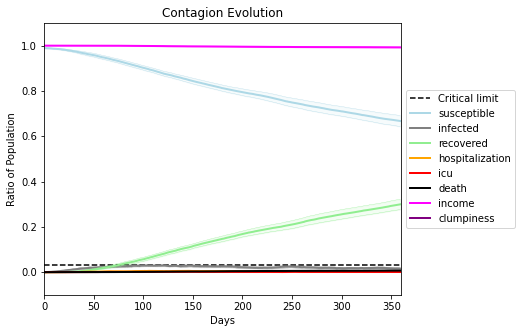

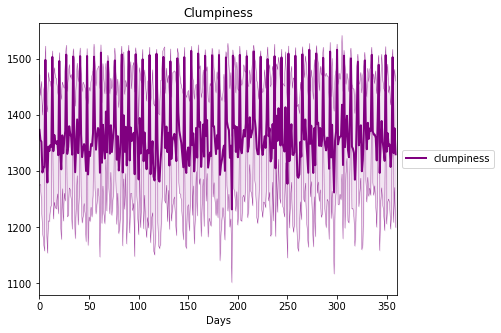

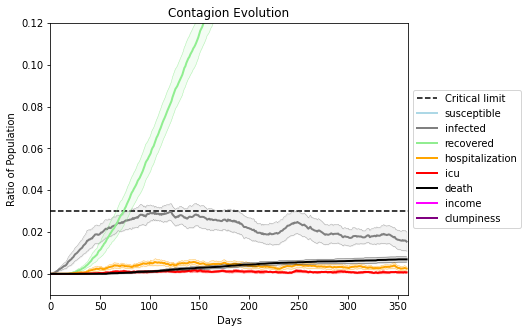

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8021, 993, 1346, 8689, 2430, 114, 8878, 9458, 9185, 8248, 2836, 3766, 4193, 4770, 9571, 155, 407, 5676, 9298, 6379]
Average similarity between family members is 0.9751596205627114 at temperature -0.998
Average similarity between family and home is 0.9998338703883138 at temperature -1
Average similarity between students and their classroom is 0.9645283008084166 at temperature -0.998
Average classroom occupancy is 1.69364161849711 and number classrooms is 173
Average similarity between workers is 0.9648540705515596 at temperature -0.998
Average office occupancy is 3.613259668508287 and number offices is 181
Average friend similarity for adults: 0.8558923322378216 for kids: 0.7325374148171827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.663957061504167
avg restaurant similarity 0.7872706504183139
avg restaurant similarity 0.681292186983126
avg restaurant similarity 0.6835275561884548
avg restaurant similarity 0.6781583541000551
avg restaurant similarity 0.619501329199424
avg restaurant similarity 0.7298002688815867
avg restaurant similarity 0.6658157567203669
avg restaurant similarity 0.6040437248313735
avg restaurant similarity 0.6310541364297905
avg restaurant similarity 0.6819284265782943
avg restaurant similarity 0.6494474709841207
avg restaurant similarity 0.6867883904537387
avg restaurant similarity 0.7390144379850274
avg restaurant similarity 0.6245701265137085
avg restaurant similarity 0.7073637867585127
avg restaurant similarity 0.6567367372750804
avg restaurant similarity 0.684232789201438
avg restaurant similarity 0.7338455737331695
avg restaurant similarity 0.6786803190405684
avg restaurant similarity 0.7233748288470069
avg restaurant similarity 0.6721132935997732
avg restaurant

avg restaurant similarity 0.6964922603417276
avg restaurant similarity 0.6783632403101817
avg restaurant similarity 0.7035403689274943
avg restaurant similarity 0.6215164633871971
avg restaurant similarity 0.6054626735304874
avg restaurant similarity 0.6961196840742012
avg restaurant similarity 0.7186675291458466
avg restaurant similarity 0.6336438552872709
avg restaurant similarity 0.7422683481320203
avg restaurant similarity 0.6488833620442017
avg restaurant similarity 0.6748332546051435
avg restaurant similarity 0.7131166814173568
avg restaurant similarity 0.7142690597531784
avg restaurant similarity 0.6093679731392732
avg restaurant similarity 0.5900793748126086
avg restaurant similarity 0.6734561709437872
avg restaurant similarity 0.6792462346004261
avg restaurant similarity 0.7161115660264655
avg restaurant similarity 0.6643132224027046
avg restaurant similarity 0.7361498482820314
avg restaurant similarity 0.6446253873757409
avg restaurant similarity 0.701469691081457
avg restaur

Average similarity between workers is 0.9728594264664225 at temperature -0.998
Average office occupancy is 3.654054054054054 and number offices is 185
Average friend similarity for adults: 0.8634392369394384 for kids: 0.7356723560844816
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.6684130334551078
avg restaurant similarity 0.6516602525428234
avg restaurant similarity 0.6524896970994488
avg restaurant similarity 0.6778781608612768
avg restaurant similarity 0.6931287316469255
avg restaurant similarity 0.6788940660335979
avg restaurant similarity 0.666020571893945
avg restaurant similarity 0.6389067791419402
avg restaurant similarity 0.6436804374712106
avg restaurant similarity 0.673173472705761
avg restaurant similarity 0.6055829506518213
avg restaurant similarity 0.6332792917457359
avg restaurant similarity 0.664076102143814
avg restaurant similarity 0.5992726241851171
avg restaurant similarity 0.6227759645632238
avg restaurant similarity 0.6645185306753968
avg restaurant similarity 0.6176829303890867
avg restaurant similarity 0.6496038998021536
avg restaurant similarity 0.6597333473403967
avg restaurant similarity 0.6903941247010961
avg restaurant similarity 0.6935759358645001
avg restaurant similarity 0.6000999379693607
avg restauran

avg restaurant similarity 0.5918759499085378
avg restaurant similarity 0.626103757195943
avg restaurant similarity 0.6924229268657633
avg restaurant similarity 0.6861630997854702
avg restaurant similarity 0.6483625173897847
avg restaurant similarity 0.629414006556653
avg restaurant similarity 0.6897741244289648
avg restaurant similarity 0.6828184871731005
avg restaurant similarity 0.6287008011700811
avg restaurant similarity 0.6005410766521373
avg restaurant similarity 0.6368102405138975
avg restaurant similarity 0.6067657736884923
avg restaurant similarity 0.6292520292588669
avg restaurant similarity 0.6466360677292785
avg restaurant similarity 0.6255114327306842
avg restaurant similarity 0.6448117324301119
avg restaurant similarity 0.6983604271393484
avg restaurant similarity 0.6482320623003163
avg restaurant similarity 0.6852955920888445
avg restaurant similarity 0.6327937019356894
avg restaurant similarity 0.6225454076504426
avg restaurant similarity 0.5903057379741617
avg restaura

Average similarity between workers is 0.9726190751815508 at temperature -0.998
Average office occupancy is 3.7431693989071038 and number offices is 183
Average friend similarity for adults: 0.8590828040691522 for kids: 0.7239884941294605
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.6896731782856204
avg restaurant similarity 0.6687415436416199
avg restaurant similarity 0.6408108048019032
avg restaurant similarity 0.7011545414303768
avg restaurant similarity 0.696960207454588
avg restaurant similarity 0.659892347531931
avg restaurant similarity 0.6683145874419443
avg restaurant similarity 0.6852704586485048
avg restaurant similarity 0.6633419172195354
avg restaurant similarity 0.6526152310461203
avg restaurant similarity 0.7212425004039728
avg restaurant similarity 0.6133320594342135
avg restaurant similarity 0.6882674518540354
avg restaurant similarity 0.668296415045985
avg restaurant similarity 0.6425709757926574
avg restaurant similarity 0.6503709805310812
avg restaurant similarity 0.6660359736092658
avg restaurant similarity 0.7115489955188948
avg restaurant similarity 0.6143571482822107
avg restaurant similarity 0.6773945162083985
avg restaurant similarity 0.6639945443485222
avg restaurant similarity 0.64307782543801
avg restaurant 

avg restaurant similarity 0.6397618330029969
avg restaurant similarity 0.6680687515850451
avg restaurant similarity 0.6602943805475222
avg restaurant similarity 0.6892837895753359
avg restaurant similarity 0.637883711373535
avg restaurant similarity 0.6428557399081856
avg restaurant similarity 0.6869845936715875
avg restaurant similarity 0.6965219708654671
avg restaurant similarity 0.6546680875245099
avg restaurant similarity 0.6591313773261898
avg restaurant similarity 0.6525390050003027
avg restaurant similarity 0.6618871097412261
avg restaurant similarity 0.6459140993886786
avg restaurant similarity 0.6541872598906103
avg restaurant similarity 0.6586534250848394
avg restaurant similarity 0.6762279942413436
avg restaurant similarity 0.6205804457961409
avg restaurant similarity 0.653190999352167
avg restaurant similarity 0.6397160816440517
avg restaurant similarity 0.6323368435548872
avg restaurant similarity 0.6752794705439122
avg restaurant similarity 0.6795139450324289
avg restaura

Average similarity between workers is 0.9711210673952504 at temperature -0.998
Average office occupancy is 3.5 and number offices is 188
Average friend similarity for adults: 0.852097007298262 for kids: 0.7308174946507912
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocate

avg restaurant similarity 0.6184896052219051
avg restaurant similarity 0.6783411060160415
avg restaurant similarity 0.5986010971724036
avg restaurant similarity 0.6290916466348426
avg restaurant similarity 0.6872966379914068
avg restaurant similarity 0.653065845816437
avg restaurant similarity 0.6086412893816591
avg restaurant similarity 0.6433869239744024
avg restaurant similarity 0.6281192939514502
avg restaurant similarity 0.6213699774178678
avg restaurant similarity 0.6968622528819994
avg restaurant similarity 0.6702591115583612
avg restaurant similarity 0.6363723645339734
avg restaurant similarity 0.6283747814842342
avg restaurant similarity 0.6971716701286506
avg restaurant similarity 0.6242567553227425
avg restaurant similarity 0.6440554238193067
avg restaurant similarity 0.6731663951278261
avg restaurant similarity 0.6647458358932886
avg restaurant similarity 0.6013119454298175
avg restaurant similarity 0.6366290774153618
avg restaurant similarity 0.6395222660919084
avg restaur

avg restaurant similarity 0.6679203954331326
avg restaurant similarity 0.6550378964526427
avg restaurant similarity 0.5927628749644237
avg restaurant similarity 0.6850116906490664
avg restaurant similarity 0.6410572192922753
avg restaurant similarity 0.6242835546336799
avg restaurant similarity 0.6265463172732506
avg restaurant similarity 0.6374584054345441
avg restaurant similarity 0.6522385287447311
avg restaurant similarity 0.657020275495294
avg restaurant similarity 0.6609524226463735
avg restaurant similarity 0.6490829998085202
avg restaurant similarity 0.6459408636537489
avg restaurant similarity 0.6392926843908071
avg restaurant similarity 0.6416556929050351
avg restaurant similarity 0.6477854916523128
avg restaurant similarity 0.6500197704916479
avg restaurant similarity 0.6627769052496845
avg restaurant similarity 0.6752225873516868
avg restaurant similarity 0.6118257378990406
avg restaurant similarity 0.667814033433647
avg restaurant similarity 0.7097585812433669
avg restaura

Average similarity between workers is 0.9591097474497592 at temperature -0.998
Average office occupancy is 3.3333333333333335 and number offices is 189
Average friend similarity for adults: 0.8478807712987508 for kids: 0.7407118326080003
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.597332339584896
avg restaurant similarity 0.6016919404541561
avg restaurant similarity 0.6320551108022018
avg restaurant similarity 0.6527241224521444
avg restaurant similarity 0.66383217959769
avg restaurant similarity 0.5940320300460629
avg restaurant similarity 0.6768893286006568
avg restaurant similarity 0.6653176101683959
avg restaurant similarity 0.6386016753395257
avg restaurant similarity 0.6373445330065654
avg restaurant similarity 0.5655826759003394
avg restaurant similarity 0.6059349758071326
avg restaurant similarity 0.5871057474510886
avg restaurant similarity 0.6511566182080357
avg restaurant similarity 0.6142688962066233
avg restaurant similarity 0.6282565700904883
avg restaurant similarity 0.66132412355247
avg restaurant similarity 0.6472921163973833
avg restaurant similarity 0.6667851999054257
avg restaurant similarity 0.6455452422916661
avg restaurant similarity 0.6105754121874716
avg restaurant similarity 0.6252309653461865
avg restaurant 

avg restaurant similarity 0.6189685393627724
avg restaurant similarity 0.6354724421138772
avg restaurant similarity 0.6899116662566539
avg restaurant similarity 0.6779259521448396
avg restaurant similarity 0.6180179675901677
avg restaurant similarity 0.6128247164314679
avg restaurant similarity 0.6399704283813517
avg restaurant similarity 0.639342385443904
avg restaurant similarity 0.6399552599089665
avg restaurant similarity 0.6245057738456901
avg restaurant similarity 0.6656007655184394
avg restaurant similarity 0.5791370852632578
avg restaurant similarity 0.6525416277968422
avg restaurant similarity 0.6031064885988662
avg restaurant similarity 0.5851591217632711
avg restaurant similarity 0.6145360440092948
avg restaurant similarity 0.6485817884754878
avg restaurant similarity 0.6371516080934609
avg restaurant similarity 0.6494017683499538
avg restaurant similarity 0.6438162139190755
avg restaurant similarity 0.6278958757928602
avg restaurant similarity 0.6450064415336046
avg restaur

Average similarity between workers is 0.9556878635790044 at temperature -0.998
Average office occupancy is 3.521505376344086 and number offices is 186
Average friend similarity for adults: 0.8558537936936794 for kids: 0.7338145655347995
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.6670608907117165
avg restaurant similarity 0.661423472660783
avg restaurant similarity 0.7047058305749889
avg restaurant similarity 0.6947623297581823
avg restaurant similarity 0.6760221804602411
avg restaurant similarity 0.6993760306034038
avg restaurant similarity 0.6702799793984213
avg restaurant similarity 0.6724738643368963
avg restaurant similarity 0.7072095137159568
avg restaurant similarity 0.6603711789216595
avg restaurant similarity 0.6783508933603739
avg restaurant similarity 0.6816961382718839
avg restaurant similarity 0.6817787511549649
avg restaurant similarity 0.7076319297017527
avg restaurant similarity 0.715438283451214
avg restaurant similarity 0.6848146493380649
avg restaurant similarity 0.655844460137239
avg restaurant similarity 0.6583540852218247
avg restaurant similarity 0.6713447594038897
avg restaurant similarity 0.6372763117188868
avg restaurant similarity 0.6308823056018722
avg restaurant similarity 0.6629585807154562
avg restauran

avg restaurant similarity 0.6498801029279416
avg restaurant similarity 0.7452563498482743
avg restaurant similarity 0.6695217628513056
avg restaurant similarity 0.7286715197612692
avg restaurant similarity 0.697147731450286
avg restaurant similarity 0.6921058393524275
avg restaurant similarity 0.6538080784744559
avg restaurant similarity 0.6993731701341117
avg restaurant similarity 0.6792449865660232
avg restaurant similarity 0.6908094625561415
avg restaurant similarity 0.7129925311631944
avg restaurant similarity 0.6692515848871685
avg restaurant similarity 0.6701851283675843
avg restaurant similarity 0.6912970705055683
avg restaurant similarity 0.6406950370620473
avg restaurant similarity 0.6572634702082363
avg restaurant similarity 0.6844340572045047
avg restaurant similarity 0.6460960663784645
avg restaurant similarity 0.6646305252814735
avg restaurant similarity 0.6263287720843048
avg restaurant similarity 0.6480915159023648
avg restaurant similarity 0.6499988707760265
avg restaur

Average similarity between workers is 0.9669799396512297 at temperature -0.998
Average office occupancy is 3.7790697674418605 and number offices is 172
Average friend similarity for adults: 0.8590928254498169 for kids: 0.7378361352941616
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6338815854966018
avg restaurant similarity 0.595248802032832
avg restaurant similarity 0.6266891663386169
avg restaurant similarity 0.6892623086025945
avg restaurant similarity 0.634883131105967
avg restaurant similarity 0.6128905313279014
avg restaurant similarity 0.6508720234895405
avg restaurant similarity 0.6736290319627866
avg restaurant similarity 0.5641473814092006
avg restaurant similarity 0.6297968217684127
avg restaurant similarity 0.6922989963138695
avg restaurant similarity 0.6035331198678363
avg restaurant similarity 0.6557004052005398
avg restaurant similarity 0.5690113079279833
avg restaurant similarity 0.6420195763793322
avg restaurant similarity 0.6156907150973301
avg restaurant similarity 0.6605645985096323
avg restaurant similarity 0.5986250854837649
avg restaurant similarity 0.6213690851565841
avg restaurant similarity 0.6031006070111058
avg restaurant similarity 0.7417935784594365
avg restaurant similarity 0.6665587581417811
avg restaura

avg restaurant similarity 0.6001358395757919
avg restaurant similarity 0.6901580159724534
avg restaurant similarity 0.6284798743677664
avg restaurant similarity 0.607244383519312
avg restaurant similarity 0.6564818671292303
avg restaurant similarity 0.6273382604809116
avg restaurant similarity 0.6482746200449088
avg restaurant similarity 0.6098663721619082
avg restaurant similarity 0.5922845586114437
avg restaurant similarity 0.6650987332782804
avg restaurant similarity 0.6055552607537575
avg restaurant similarity 0.6350056018786797
avg restaurant similarity 0.5837104441178822
avg restaurant similarity 0.6566676203354728
avg restaurant similarity 0.6857288292788516
avg restaurant similarity 0.5900173543269233
avg restaurant similarity 0.6309861256695678
avg restaurant similarity 0.6888325649415413
avg restaurant similarity 0.6483756691307694
avg restaurant similarity 0.6453603441898185
avg restaurant similarity 0.6276074492781732
avg restaurant similarity 0.6267266647242672
avg restaur

Average similarity between workers is 0.9563073327927192 at temperature -0.998
Average office occupancy is 3.515957446808511 and number offices is 188
Average friend similarity for adults: 0.8583253897142128 for kids: 0.7298575348117952
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.6788888773114824
avg restaurant similarity 0.5917905350965237
avg restaurant similarity 0.6490005565310906
avg restaurant similarity 0.6241893690996057
avg restaurant similarity 0.6112627902047351
avg restaurant similarity 0.6627255715628991
avg restaurant similarity 0.5881478152888455
avg restaurant similarity 0.605717647910773
avg restaurant similarity 0.6143759052175957
avg restaurant similarity 0.6379862115200462
avg restaurant similarity 0.6469165666869564
avg restaurant similarity 0.6310195256771207
avg restaurant similarity 0.646616886605789
avg restaurant similarity 0.6276903201432187
avg restaurant similarity 0.6022880016589534
avg restaurant similarity 0.6023147236306555
avg restaurant similarity 0.6214769372237694
avg restaurant similarity 0.6544188924967439
avg restaurant similarity 0.6006270174274929
avg restaurant similarity 0.6445485612044091
avg restaurant similarity 0.5963216205257671
avg restaurant similarity 0.646126432870973
avg restauran

avg restaurant similarity 0.6141542874101592
avg restaurant similarity 0.6228099227333259
avg restaurant similarity 0.6197321552483892
avg restaurant similarity 0.6699309253163384
avg restaurant similarity 0.6258349215231106
avg restaurant similarity 0.6939416541315725
avg restaurant similarity 0.6029857166503974
avg restaurant similarity 0.6216523073004937
avg restaurant similarity 0.6144199712641933
avg restaurant similarity 0.6696882170527526
avg restaurant similarity 0.6426358810127812
avg restaurant similarity 0.6227389447028243
avg restaurant similarity 0.6950437922752245
avg restaurant similarity 0.5335870204108831
avg restaurant similarity 0.630081775241693
avg restaurant similarity 0.6064164162883131
avg restaurant similarity 0.6332779300279018
avg restaurant similarity 0.591403531903864
avg restaurant similarity 0.6172106928468555
avg restaurant similarity 0.6080289703583106
avg restaurant similarity 0.6193144964758631
avg restaurant similarity 0.6446969935217816
avg restaura

Average similarity between workers is 0.9695363221024085 at temperature -0.998
Average office occupancy is 3.5833333333333335 and number offices is 192
Average friend similarity for adults: 0.8711772069874192 for kids: 0.7404421755017504
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.7138113857812823
avg restaurant similarity 0.6725832480964106
avg restaurant similarity 0.6524096953933451
avg restaurant similarity 0.6498480005926358
avg restaurant similarity 0.701734113266922
avg restaurant similarity 0.7361855077245294
avg restaurant similarity 0.7012124434102556
avg restaurant similarity 0.6900523649188927
avg restaurant similarity 0.6660167304746754
avg restaurant similarity 0.6827863186516319
avg restaurant similarity 0.686114486310253
avg restaurant similarity 0.7641731844159918
avg restaurant similarity 0.7250167141736821
avg restaurant similarity 0.6942972871091552
avg restaurant similarity 0.728364704489443
avg restaurant similarity 0.6842309952891664
avg restaurant similarity 0.6888928619687829
avg restaurant similarity 0.7275582195600614
avg restaurant similarity 0.7212524876801947
avg restaurant similarity 0.689472828709687
avg restaurant similarity 0.6375055479265249
avg restaurant similarity 0.6571011230971143
avg restaurant

avg restaurant similarity 0.7107141898322066
avg restaurant similarity 0.742464304021165
avg restaurant similarity 0.6618992880974816
avg restaurant similarity 0.6380581554649215
avg restaurant similarity 0.7017792952569615
avg restaurant similarity 0.6985849934203585
avg restaurant similarity 0.6628161618478976
avg restaurant similarity 0.7037723059509465
avg restaurant similarity 0.6728347889272919
avg restaurant similarity 0.6877456925830107
avg restaurant similarity 0.6617656454204114
avg restaurant similarity 0.7124519433475546
avg restaurant similarity 0.6524287676875855
avg restaurant similarity 0.6791436708269061
avg restaurant similarity 0.6758666094091955
avg restaurant similarity 0.6949674683745652
avg restaurant similarity 0.7464528287395746
avg restaurant similarity 0.7212809427299502
avg restaurant similarity 0.7035821543364283
avg restaurant similarity 0.6930126679914035
avg restaurant similarity 0.7060692728360741
avg restaurant similarity 0.7324362542212128
avg restaur

Average similarity between workers is 0.9638355605757797 at temperature -0.998
Average office occupancy is 3.417525773195876 and number offices is 194
Average friend similarity for adults: 0.856547174053773 for kids: 0.7353850301579865
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6537546396594519
avg restaurant similarity 0.6085957617399158
avg restaurant similarity 0.6572835985239047
avg restaurant similarity 0.6224516836036
avg restaurant similarity 0.6833565943829168
avg restaurant similarity 0.6789481990111365
avg restaurant similarity 0.669316104092772
avg restaurant similarity 0.6249853431335117
avg restaurant similarity 0.6613485730169819
avg restaurant similarity 0.6501716432284207
avg restaurant similarity 0.6259835187843285
avg restaurant similarity 0.6669645365495189
avg restaurant similarity 0.7073279273388492
avg restaurant similarity 0.6481460590138757
avg restaurant similarity 0.5973136702797656
avg restaurant similarity 0.6485662147471287
avg restaurant similarity 0.6725062684893338
avg restaurant similarity 0.6573887412841314
avg restaurant similarity 0.6232172721582516
avg restaurant similarity 0.644497061205956
avg restaurant similarity 0.6248099340405641
avg restaurant similarity 0.6424817107492173
avg restaurant 

avg restaurant similarity 0.6810925148089958
avg restaurant similarity 0.6927373953748059
avg restaurant similarity 0.6600215188473088
avg restaurant similarity 0.6446395509170032
avg restaurant similarity 0.6197536093828548
avg restaurant similarity 0.7009375212743566
avg restaurant similarity 0.6571842926526932
avg restaurant similarity 0.6344130788529624
avg restaurant similarity 0.6776478759482135
avg restaurant similarity 0.6661970525618865
avg restaurant similarity 0.6886187136495249
avg restaurant similarity 0.5976783415264358
avg restaurant similarity 0.6899566505316653
avg restaurant similarity 0.6421945104041475
avg restaurant similarity 0.6218650456009154
avg restaurant similarity 0.6846136063741257
avg restaurant similarity 0.6297050934060249
avg restaurant similarity 0.7466028128037864
avg restaurant similarity 0.7167663528876548
avg restaurant similarity 0.595790570066466
avg restaurant similarity 0.6653789983808206
avg restaurant similarity 0.6866170576511912
avg restaur

Average similarity between workers is 0.9625953672230313 at temperature -0.998
Average office occupancy is 3.6557377049180326 and number offices is 183
Average friend similarity for adults: 0.8649186918682584 for kids: 0.7383248122251459
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.693281706338031
avg restaurant similarity 0.6307239160401431
avg restaurant similarity 0.6743284067990112
avg restaurant similarity 0.6643002050376333
avg restaurant similarity 0.5883735820744995
avg restaurant similarity 0.6158093843048721
avg restaurant similarity 0.6273464502082681
avg restaurant similarity 0.6525629637029884
avg restaurant similarity 0.6721438244554943
avg restaurant similarity 0.7016721477894747
avg restaurant similarity 0.6653445391495744
avg restaurant similarity 0.6540448236645746
avg restaurant similarity 0.703283805278983
avg restaurant similarity 0.6699028017291075
avg restaurant similarity 0.6664828398198218
avg restaurant similarity 0.7046932941214501
avg restaurant similarity 0.6193645121321848
avg restaurant similarity 0.6723216108028779
avg restaurant similarity 0.6444738163727263
avg restaurant similarity 0.6465987365380992
avg restaurant similarity 0.6329866672654194
avg restaurant similarity 0.6729750893993658
avg restaura

avg restaurant similarity 0.6374247626469969
avg restaurant similarity 0.6201839393525236
avg restaurant similarity 0.6056820965927605
avg restaurant similarity 0.6615436314371758
avg restaurant similarity 0.6424083130965296
avg restaurant similarity 0.6706650168450987
avg restaurant similarity 0.6418856820475498
avg restaurant similarity 0.6344576928115184
avg restaurant similarity 0.6389762473348011
avg restaurant similarity 0.6321733728296919
avg restaurant similarity 0.6090424854227764
avg restaurant similarity 0.6007822125521552
avg restaurant similarity 0.6857730045982615
avg restaurant similarity 0.6053000136832194
avg restaurant similarity 0.619121387207589
avg restaurant similarity 0.6954311490911251
avg restaurant similarity 0.6385534245768679
avg restaurant similarity 0.636482031402356
avg restaurant similarity 0.657910354221047
avg restaurant similarity 0.6598693200215542
avg restaurant similarity 0.6631881737466829
avg restaurant similarity 0.6372971851023472
avg restauran

Average similarity between workers is 0.9624045110151297 at temperature -0.998
Average office occupancy is 3.4516129032258065 and number offices is 186
Average friend similarity for adults: 0.8559897922489476 for kids: 0.754228712430371
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6863557733574114
avg restaurant similarity 0.6668624807871607
avg restaurant similarity 0.67140034712828
avg restaurant similarity 0.6937970643895264
avg restaurant similarity 0.6337919139206861
avg restaurant similarity 0.6500615415026363
avg restaurant similarity 0.7110856816644524
avg restaurant similarity 0.6444735974214028
avg restaurant similarity 0.6790712864680295
avg restaurant similarity 0.6663101493339344
avg restaurant similarity 0.6676104829440106
avg restaurant similarity 0.6536657040594174
avg restaurant similarity 0.6659675332871293
avg restaurant similarity 0.6784891836202067
avg restaurant similarity 0.6064698937755185
avg restaurant similarity 0.6651009659764046
avg restaurant similarity 0.7311400697845214
avg restaurant similarity 0.6927795473997179
avg restaurant similarity 0.6706953173312931
avg restaurant similarity 0.6924814186672896
avg restaurant similarity 0.6150651129740672
avg restaurant similarity 0.6999600182176344
avg restaura

avg restaurant similarity 0.6414751307866002
avg restaurant similarity 0.6600315657599858
avg restaurant similarity 0.6375203363501637
avg restaurant similarity 0.6494968682001585
avg restaurant similarity 0.6603916878903269
avg restaurant similarity 0.669253623394136
avg restaurant similarity 0.643650017578442
avg restaurant similarity 0.6220188200473622
avg restaurant similarity 0.6800689742758321
avg restaurant similarity 0.679031808300841
avg restaurant similarity 0.6359494745170475
avg restaurant similarity 0.6278257252612374
avg restaurant similarity 0.6767272945280133
avg restaurant similarity 0.7160286423773444
avg restaurant similarity 0.6410917604913536
avg restaurant similarity 0.6593771397477477
avg restaurant similarity 0.6648628046284529
avg restaurant similarity 0.6294391450091031
avg restaurant similarity 0.65326594648707
avg restaurant similarity 0.638071001942727
avg restaurant similarity 0.6497213660146096
avg restaurant similarity 0.6492319946889125
avg restaurant s

Average similarity between workers is 0.9689127887377683 at temperature -0.998
Average office occupancy is 3.4814814814814814 and number offices is 189
Average friend similarity for adults: 0.8567779423382692 for kids: 0.7393337931299455
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.7299212027679675
avg restaurant similarity 0.7198223634487332
avg restaurant similarity 0.7123779666892258
avg restaurant similarity 0.6548475181738417
avg restaurant similarity 0.6835649370989703
avg restaurant similarity 0.7414413843139485
avg restaurant similarity 0.7377700915609826
avg restaurant similarity 0.7098032533321568
avg restaurant similarity 0.7382284417952049
avg restaurant similarity 0.7016865091818897
avg restaurant similarity 0.7027288175966829
avg restaurant similarity 0.66626198147471
avg restaurant similarity 0.7331058802567549
avg restaurant similarity 0.7147296539199469
avg restaurant similarity 0.7063029889942622
avg restaurant similarity 0.6475861401740983
avg restaurant similarity 0.6878845527317199
avg restaurant similarity 0.6541969106979874
avg restaurant similarity 0.7252409432522595
avg restaurant similarity 0.7028151561218324
avg restaurant similarity 0.6855533968092975
avg restaurant similarity 0.7408052527430726
avg restaura

avg restaurant similarity 0.7227053382024328
avg restaurant similarity 0.7245870280348272
avg restaurant similarity 0.687026112781915
avg restaurant similarity 0.7041068154422865
avg restaurant similarity 0.7434858856653455
avg restaurant similarity 0.7333674156567369
avg restaurant similarity 0.7323049442699711
avg restaurant similarity 0.7253364596159516
avg restaurant similarity 0.6670148817614447
avg restaurant similarity 0.7307970783404462
avg restaurant similarity 0.709759949767365
avg restaurant similarity 0.7377024194639766
avg restaurant similarity 0.7412780768961484
avg restaurant similarity 0.6875650267230388
avg restaurant similarity 0.7313201809634826
avg restaurant similarity 0.6798140866984722
avg restaurant similarity 0.6676797340663049
avg restaurant similarity 0.7083082474780061
avg restaurant similarity 0.7199785287076662
avg restaurant similarity 0.6755341350617118
avg restaurant similarity 0.7004586029933422
avg restaurant similarity 0.710027533648899
avg restauran

Average similarity between workers is 0.9701968985063274 at temperature -0.998
Average office occupancy is 3.641711229946524 and number offices is 187
Average friend similarity for adults: 0.8548806881371636 for kids: 0.7073851310808902
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.6809212385244666
avg restaurant similarity 0.6010574893024047
avg restaurant similarity 0.6930776055531337
avg restaurant similarity 0.6410685109204944
avg restaurant similarity 0.6757258593154234
avg restaurant similarity 0.6211394360335746
avg restaurant similarity 0.6670190948440885
avg restaurant similarity 0.6464389837549773
avg restaurant similarity 0.6587343806654301
avg restaurant similarity 0.6770131171196023
avg restaurant similarity 0.689439617973228
avg restaurant similarity 0.6831700991970541
avg restaurant similarity 0.6164116384335213
avg restaurant similarity 0.6250776713609952
avg restaurant similarity 0.6314213426035727
avg restaurant similarity 0.6329036341421014
avg restaurant similarity 0.7167854797049091
avg restaurant similarity 0.6539334025959351
avg restaurant similarity 0.6708392304623085
avg restaurant similarity 0.5648529274877795
avg restaurant similarity 0.683764002611081
avg restaurant similarity 0.6200108814827222
avg restaura

avg restaurant similarity 0.6816401993214037
avg restaurant similarity 0.6227105631813121
avg restaurant similarity 0.6062164924509771
avg restaurant similarity 0.6531124828298104
avg restaurant similarity 0.6583266793786048
avg restaurant similarity 0.6676049544527957
avg restaurant similarity 0.6098266525601198
avg restaurant similarity 0.6449313226587555
avg restaurant similarity 0.6741079819283466
avg restaurant similarity 0.6177077785186587
avg restaurant similarity 0.5995678786139482
avg restaurant similarity 0.6643482483254483
avg restaurant similarity 0.6511614546767032
avg restaurant similarity 0.6084159498266182
avg restaurant similarity 0.6620710993339293
avg restaurant similarity 0.6512560409199282
avg restaurant similarity 0.665487655756316
avg restaurant similarity 0.6737117522240995
avg restaurant similarity 0.6316013615573784
avg restaurant similarity 0.6420398291524774
avg restaurant similarity 0.6634529868793226
avg restaurant similarity 0.5987658264430137
avg restaur

Average similarity between workers is 0.9642904325297117 at temperature -0.998
Average office occupancy is 3.6296296296296298 and number offices is 189
Average friend similarity for adults: 0.8731517923618145 for kids: 0.7409665938229114
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.71898923526193
avg restaurant similarity 0.6976251055690834
avg restaurant similarity 0.6975708514536391
avg restaurant similarity 0.699993624749686
avg restaurant similarity 0.7055350166071775
avg restaurant similarity 0.6972767961219892
avg restaurant similarity 0.6929563374028014
avg restaurant similarity 0.7236204089326363
avg restaurant similarity 0.7178747153417708
avg restaurant similarity 0.6961001274087687
avg restaurant similarity 0.7429283173511992
avg restaurant similarity 0.702043703917132
avg restaurant similarity 0.6955198097859543
avg restaurant similarity 0.7029414578859033
avg restaurant similarity 0.7310525339494867
avg restaurant similarity 0.7202393130639202
avg restaurant similarity 0.6814751954919235
avg restaurant similarity 0.6957340322677756
avg restaurant similarity 0.7302928756338147
avg restaurant similarity 0.7167420051352645
avg restaurant similarity 0.6755317799569512
avg restaurant similarity 0.7093420570866816
avg restaurant

avg restaurant similarity 0.6953962112995882
avg restaurant similarity 0.7002914377099709
avg restaurant similarity 0.6741299063427748
avg restaurant similarity 0.6987552907245317
avg restaurant similarity 0.707716743562194
avg restaurant similarity 0.713774289375958
avg restaurant similarity 0.6997155913045241
avg restaurant similarity 0.7219320099682653
avg restaurant similarity 0.672500975280048
avg restaurant similarity 0.7011012861859546
avg restaurant similarity 0.701241066984144
avg restaurant similarity 0.6999994173257883
avg restaurant similarity 0.709407660334595
avg restaurant similarity 0.7022134115010252
avg restaurant similarity 0.6895048179734369
avg restaurant similarity 0.687648406597998
avg restaurant similarity 0.718857527179597
avg restaurant similarity 0.7060554057908488
avg restaurant similarity 0.7160470406345147
avg restaurant similarity 0.7069110661857932
avg restaurant similarity 0.7123379285816043
avg restaurant similarity 0.6823212032153525
avg restaurant si

Average similarity between workers is 0.9756761435929052 at temperature -0.998
Average office occupancy is 3.4166666666666665 and number offices is 192
Average friend similarity for adults: 0.8525712231194732 for kids: 0.7288353083406487
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.6157127746932199
avg restaurant similarity 0.5855732631717182
avg restaurant similarity 0.6026703187463452
avg restaurant similarity 0.6325761200962119
avg restaurant similarity 0.6538097201399209
avg restaurant similarity 0.6518672384696286
avg restaurant similarity 0.6274085075291985
avg restaurant similarity 0.6819753782944176
avg restaurant similarity 0.6206224619884178
avg restaurant similarity 0.572866415650402
avg restaurant similarity 0.6672721486841915
avg restaurant similarity 0.6170791988334647
avg restaurant similarity 0.679244484045157
avg restaurant similarity 0.670016793371415
avg restaurant similarity 0.6223016073914933
avg restaurant similarity 0.6228048218774845
avg restaurant similarity 0.7054252521206538
avg restaurant similarity 0.6446321785930387
avg restaurant similarity 0.6567125580038229
avg restaurant similarity 0.653346171541254
avg restaurant similarity 0.5985917358468469
avg restaurant similarity 0.6688755919541894
avg restaurant

avg restaurant similarity 0.6525714231475918
avg restaurant similarity 0.6509855321033045
avg restaurant similarity 0.5986360921940103
avg restaurant similarity 0.6196873335252492
avg restaurant similarity 0.6729360083470836
avg restaurant similarity 0.63081678884458
avg restaurant similarity 0.6280399375481821
avg restaurant similarity 0.6031850982287215
avg restaurant similarity 0.6429001218428679
avg restaurant similarity 0.604530497628951
avg restaurant similarity 0.6086658438323655
avg restaurant similarity 0.6475202516170834
avg restaurant similarity 0.6872731455850984
avg restaurant similarity 0.6352698822846148
avg restaurant similarity 0.6704502246432532
avg restaurant similarity 0.6249208134744054
avg restaurant similarity 0.6421009180994326
avg restaurant similarity 0.6242096103784095
avg restaurant similarity 0.6292650082890794
avg restaurant similarity 0.6502794135692418
avg restaurant similarity 0.5951348361237637
avg restaurant similarity 0.6310172368704718
avg restauran

Average similarity between workers is 0.9654595767377138 at temperature -0.998
Average office occupancy is 3.4946236559139785 and number offices is 186
Average friend similarity for adults: 0.8495757211382498 for kids: 0.7262774601933324
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6394425679919767
avg restaurant similarity 0.6369045730405025
avg restaurant similarity 0.5522408218871293
avg restaurant similarity 0.6489794039358899
avg restaurant similarity 0.6780182432712877
avg restaurant similarity 0.61576869602773
avg restaurant similarity 0.6894834607379342
avg restaurant similarity 0.6811399416925606
avg restaurant similarity 0.6741190984165868
avg restaurant similarity 0.6875387037583138
avg restaurant similarity 0.6524362667363843
avg restaurant similarity 0.6903375363343498
avg restaurant similarity 0.6528800707998288
avg restaurant similarity 0.6361396890660064
avg restaurant similarity 0.6249816361352089
avg restaurant similarity 0.6376876938227412
avg restaurant similarity 0.6612215688984466
avg restaurant similarity 0.663175510886038
avg restaurant similarity 0.6378233799379172
avg restaurant similarity 0.6288645520520276
avg restaurant similarity 0.6279151341410495
avg restaurant similarity 0.6321125841895827
avg restauran

avg restaurant similarity 0.6164013580306906
avg restaurant similarity 0.6055286035101015
avg restaurant similarity 0.7274682833667926
avg restaurant similarity 0.6348665816873652
avg restaurant similarity 0.6010224382897497
avg restaurant similarity 0.6327540968183877
avg restaurant similarity 0.6861190318276096
avg restaurant similarity 0.6777427429158575
avg restaurant similarity 0.6701284250207
avg restaurant similarity 0.6833064587375844
avg restaurant similarity 0.6775607628478622
avg restaurant similarity 0.6833969590451491
avg restaurant similarity 0.6831742043898726
avg restaurant similarity 0.618784600700272
avg restaurant similarity 0.6066923366986133
avg restaurant similarity 0.6677209757494789
avg restaurant similarity 0.6578737122159176
avg restaurant similarity 0.6427396658966013
avg restaurant similarity 0.6655061667641734
avg restaurant similarity 0.6843777258199926
avg restaurant similarity 0.6358143402665116
avg restaurant similarity 0.5762574206477724
avg restaurant

Average similarity between workers is 0.9689171952941321 at temperature -0.998
Average office occupancy is 3.561111111111111 and number offices is 180
Average friend similarity for adults: 0.8661211274965052 for kids: 0.7571106698688564
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of

avg restaurant similarity 0.6223929190509003
avg restaurant similarity 0.6524188917736443
avg restaurant similarity 0.6762672398056122
avg restaurant similarity 0.6257576171255453
avg restaurant similarity 0.6219578748310756
avg restaurant similarity 0.6413310438536755
avg restaurant similarity 0.6641982765775669
avg restaurant similarity 0.6181241276589339
avg restaurant similarity 0.6369618578737214
avg restaurant similarity 0.6539723978173801
avg restaurant similarity 0.6337382855893906
avg restaurant similarity 0.6478864709446485
avg restaurant similarity 0.632727216068015
avg restaurant similarity 0.6812920594553746
avg restaurant similarity 0.6516301293702634
avg restaurant similarity 0.6175944309997808
avg restaurant similarity 0.6150664349116464
avg restaurant similarity 0.6474532926067273
avg restaurant similarity 0.6444246280383912
avg restaurant similarity 0.6183038732050188
avg restaurant similarity 0.6217692251734802
avg restaurant similarity 0.6527105121726805
avg restaur

avg restaurant similarity 0.6360027912277046
avg restaurant similarity 0.6295163838620057
avg restaurant similarity 0.6324281856453358
avg restaurant similarity 0.6638971441367691
avg restaurant similarity 0.6397712064233793
avg restaurant similarity 0.604212818516715
avg restaurant similarity 0.646302475192885
avg restaurant similarity 0.6216112130353759
avg restaurant similarity 0.6324870809979486
avg restaurant similarity 0.6215947349721794
avg restaurant similarity 0.6282231788517602
avg restaurant similarity 0.6116080592228712
avg restaurant similarity 0.6070082401111475
avg restaurant similarity 0.6410151069017656
avg restaurant similarity 0.6223914890367076
avg restaurant similarity 0.6325621895211224
avg restaurant similarity 0.643027756679368
avg restaurant similarity 0.6285871103722256
avg restaurant similarity 0.6342351092051193
avg restaurant similarity 0.6622716135193534
avg restaurant similarity 0.5944215314951647
avg restaurant similarity 0.6037421464780535
avg restauran

Average similarity between workers is 0.9698843220629635 at temperature -0.998
Average office occupancy is 3.455026455026455 and number offices is 189
Average friend similarity for adults: 0.8624425109213237 for kids: 0.7309681623901667
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.6424791026106111
avg restaurant similarity 0.5569121634867772
avg restaurant similarity 0.5868533474833817
avg restaurant similarity 0.6002953171493421
avg restaurant similarity 0.6426691372266323
avg restaurant similarity 0.6496428320353349
avg restaurant similarity 0.6034107917876574
avg restaurant similarity 0.5988330207418066
avg restaurant similarity 0.5911362679473638
avg restaurant similarity 0.6020789141152464
avg restaurant similarity 0.6111513082093597
avg restaurant similarity 0.6369142291115714
avg restaurant similarity 0.6217901899423555
avg restaurant similarity 0.613477429057734
avg restaurant similarity 0.6039059140100815
avg restaurant similarity 0.6000553006400008
avg restaurant similarity 0.6402011547700651
avg restaurant similarity 0.6505647042318914
avg restaurant similarity 0.6150071895085344
avg restaurant similarity 0.6224062227220376
avg restaurant similarity 0.6082753246295495
avg restaurant similarity 0.5962142736951311
avg restaur

avg restaurant similarity 0.5788419790182492
avg restaurant similarity 0.6313329713952384
avg restaurant similarity 0.6006451460141492
avg restaurant similarity 0.6311088295021846
avg restaurant similarity 0.6009598677853315
avg restaurant similarity 0.6823053677663385
avg restaurant similarity 0.6256398813195224
avg restaurant similarity 0.59498773189546
avg restaurant similarity 0.6058601860233882
avg restaurant similarity 0.6227680399011695
avg restaurant similarity 0.6357760848176891
avg restaurant similarity 0.6318622629290859
avg restaurant similarity 0.6392517331790936
avg restaurant similarity 0.5796659886203017
avg restaurant similarity 0.6199963875589053
avg restaurant similarity 0.6224952039586056
avg restaurant similarity 0.6080121083786164
avg restaurant similarity 0.5707727265734556
avg restaurant similarity 0.6780487134381302
avg restaurant similarity 0.5869579716408956
avg restaurant similarity 0.5942798348126537
avg restaurant similarity 0.6236376500263695
avg restaura

Average similarity between workers is 0.9531933121304642 at temperature -0.998
Average office occupancy is 3.7039106145251397 and number offices is 179
Average friend similarity for adults: 0.8578069339892238 for kids: 0.7373307960654729
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.6723494518397216
avg restaurant similarity 0.6851099660705322
avg restaurant similarity 0.6604359244560817
avg restaurant similarity 0.6887560037913165
avg restaurant similarity 0.6407879184475638
avg restaurant similarity 0.6688561136063134
avg restaurant similarity 0.6480900059175428
avg restaurant similarity 0.6755979766168323
avg restaurant similarity 0.6424274936538137
avg restaurant similarity 0.6518357990081167
avg restaurant similarity 0.6894501584243475
avg restaurant similarity 0.7074314874583372
avg restaurant similarity 0.6403806977405005
avg restaurant similarity 0.6355330380607046
avg restaurant similarity 0.6249645726857506
avg restaurant similarity 0.6576519852529261
avg restaurant similarity 0.6682753686259058
avg restaurant similarity 0.6389320512907499
avg restaurant similarity 0.7119843556064589
avg restaurant similarity 0.6773908271432895
avg restaurant similarity 0.6555887329084583
avg restaurant similarity 0.702492852735969
avg restaur

avg restaurant similarity 0.6651240677945021
avg restaurant similarity 0.67950348822918
avg restaurant similarity 0.6637464343027786
avg restaurant similarity 0.6583453990341631
avg restaurant similarity 0.707644990288779
avg restaurant similarity 0.6879270735534943
avg restaurant similarity 0.6604558471242465
avg restaurant similarity 0.6253699128625755
avg restaurant similarity 0.6978953606896886
avg restaurant similarity 0.6957559754466032
avg restaurant similarity 0.6668298889430126
avg restaurant similarity 0.6438549543777723
avg restaurant similarity 0.6432887555543192
avg restaurant similarity 0.6898530103476024
avg restaurant similarity 0.6507365275003313
avg restaurant similarity 0.626032090086814
avg restaurant similarity 0.6733153523680262
avg restaurant similarity 0.6031508733087348
avg restaurant similarity 0.672079994738514
avg restaurant similarity 0.6710233845612695
avg restaurant similarity 0.6803757011853202
avg restaurant similarity 0.6734233879410229
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

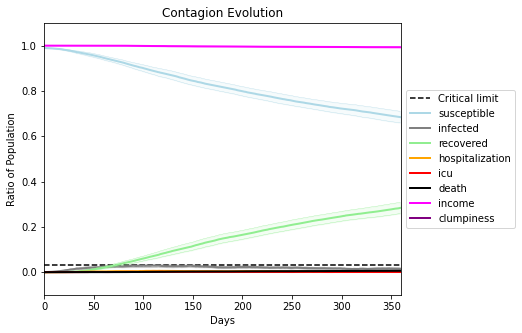

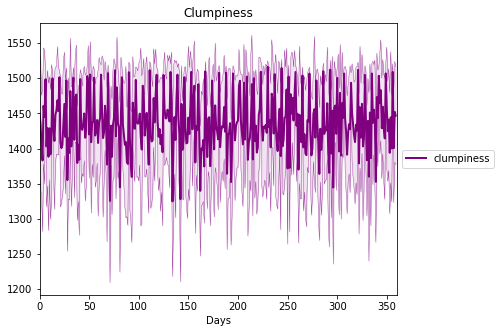

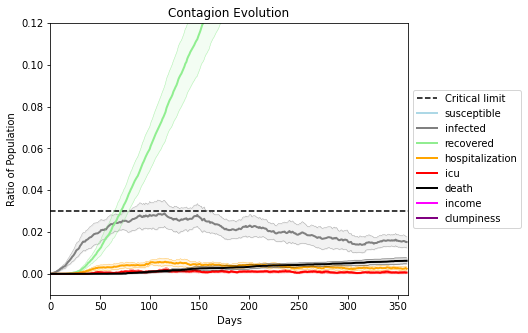

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1529, 8302, 9944, 8914, 3501, 6891, 6502, 2476, 344, 7719, 5179, 7209, 2541, 5694, 4362, 404, 1116, 6003, 6360, 4010]
Average similarity between family members is 0.9606135211999206 at temperature -0.9975
Average similarity between family and home is 0.9998458591363307 at temperature -1
Average similarity between students and their classroom is 0.9339407198981706 at temperature -0.9975
Average classroom occupancy is 1.5964912280701755 and number classrooms is 171
Average similarity between workers is 0.9337247864103233 at temperature -0.9975
Average office occupancy is 3.6432432432432433 and number offices is 185
Average friend similarity for adults: 0.8578118801757538 for kids: 0.7295150575807942
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.5714586162840346
avg restaurant similarity 0.6010189768246735
avg restaurant similarity 0.6676866719729219
avg restaurant similarity 0.6715338772246744
avg restaurant similarity 0.6533757416855632
avg restaurant similarity 0.6503258932313447
avg restaurant similarity 0.6550025214419789
avg restaurant similarity 0.6504768179475776
avg restaurant similarity 0.6241958495659374
avg restaurant similarity 0.5862697978010891
avg restaurant similarity 0.6858828975239829
avg restaurant similarity 0.6643511889797493
avg restaurant similarity 0.5997251420974758
avg restaurant similarity 0.6554314949597927
avg restaurant similarity 0.6552978129678193
avg restaurant similarity 0.6518918163844152
avg restaurant similarity 0.6293118702462553
avg restaurant similarity 0.6306792042722023
avg restaurant similarity 0.5875813982737399
avg restaurant similarity 0.5985815896776772
avg restaurant similarity 0.6497122074556491
avg restaurant similarity 0.6456006853096633
avg restau

avg restaurant similarity 0.5791555787484156
avg restaurant similarity 0.648366547726703
avg restaurant similarity 0.599850261483778
avg restaurant similarity 0.6442676328358845
avg restaurant similarity 0.6425353466464753
avg restaurant similarity 0.6052174307408041
avg restaurant similarity 0.6750100316541809
avg restaurant similarity 0.5946480536120197
avg restaurant similarity 0.717482399846684
avg restaurant similarity 0.6719133183553152
avg restaurant similarity 0.6649889433730101
avg restaurant similarity 0.578976974538464
avg restaurant similarity 0.65227363724715
avg restaurant similarity 0.6079355357337649
avg restaurant similarity 0.6290184941281076
avg restaurant similarity 0.6370697476652368
avg restaurant similarity 0.5523271330259705
avg restaurant similarity 0.6380674951184608
avg restaurant similarity 0.6851405735891749
avg restaurant similarity 0.6203314282604043
avg restaurant similarity 0.6232929401152034
avg restaurant similarity 0.5947063040473994
avg restaurant s

Average similarity between workers is 0.941227561601571 at temperature -0.9975
Average office occupancy is 3.3025641025641024 and number offices is 195
Average friend similarity for adults: 0.851304263641682 for kids: 0.7425870880114289
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.6179152423555777
avg restaurant similarity 0.619865594771598
avg restaurant similarity 0.6974854703183534
avg restaurant similarity 0.5956052851118612
avg restaurant similarity 0.6599226691076139
avg restaurant similarity 0.5869866726213571
avg restaurant similarity 0.6101708431387342
avg restaurant similarity 0.6308709344257046
avg restaurant similarity 0.6253861597576381
avg restaurant similarity 0.6395859168393688
avg restaurant similarity 0.6288131754549473
avg restaurant similarity 0.6100609472463865
avg restaurant similarity 0.5845110176468777
avg restaurant similarity 0.5968360871996597
avg restaurant similarity 0.5689598434345053
avg restaurant similarity 0.597436206217847
avg restaurant similarity 0.5949256577388157
avg restaurant similarity 0.6338598144412384
avg restaurant similarity 0.6084559899880557
avg restaurant similarity 0.5576283017055567
avg restaurant similarity 0.613523082409502
avg restaurant similarity 0.6016857144576266
avg restauran

avg restaurant similarity 0.5729067506182329
avg restaurant similarity 0.5928727840382597
avg restaurant similarity 0.6336718362741736
avg restaurant similarity 0.6101163850780255
avg restaurant similarity 0.5808995821762789
avg restaurant similarity 0.6084197494209532
avg restaurant similarity 0.6038175277364706
avg restaurant similarity 0.6176242013153668
avg restaurant similarity 0.636860745559478
avg restaurant similarity 0.587726903257476
avg restaurant similarity 0.5804987430564965
avg restaurant similarity 0.6218747732250439
avg restaurant similarity 0.6188608191975437
avg restaurant similarity 0.64879320237649
avg restaurant similarity 0.6381985486333469
avg restaurant similarity 0.5997919982295151
avg restaurant similarity 0.592469445078253
avg restaurant similarity 0.5922961773089379
avg restaurant similarity 0.5758607994355912
avg restaurant similarity 0.6119948496015013
avg restaurant similarity 0.5456289995311854
avg restaurant similarity 0.6005215674769679
avg restaurant 

Average similarity between workers is 0.9409850519683906 at temperature -0.9975
Average office occupancy is 3.3451776649746194 and number offices is 197
Average friend similarity for adults: 0.8487752205323874 for kids: 0.7262340247352821
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.6518634398068176
avg restaurant similarity 0.6552835875370442
avg restaurant similarity 0.6754698924856624
avg restaurant similarity 0.6669751641244798
avg restaurant similarity 0.6113548988385057
avg restaurant similarity 0.6444686374109508
avg restaurant similarity 0.6205334674814574
avg restaurant similarity 0.5829960441057302
avg restaurant similarity 0.6356482340755358
avg restaurant similarity 0.6349529810057027
avg restaurant similarity 0.7182730373017024
avg restaurant similarity 0.637551990332115
avg restaurant similarity 0.5916184907107358
avg restaurant similarity 0.6329045629711699
avg restaurant similarity 0.6305236509222152
avg restaurant similarity 0.6601407018754923
avg restaurant similarity 0.6022685535238587
avg restaurant similarity 0.7013433932728289
avg restaurant similarity 0.5971840810765139
avg restaurant similarity 0.6359887167816828
avg restaurant similarity 0.595184057207269
avg restaurant similarity 0.6370002521568541
avg restaura

avg restaurant similarity 0.6369308850892169
avg restaurant similarity 0.5595148609486621
avg restaurant similarity 0.6002900094980286
avg restaurant similarity 0.6210530412044171
avg restaurant similarity 0.6172722633766335
avg restaurant similarity 0.5774404033348728
avg restaurant similarity 0.684865069568495
avg restaurant similarity 0.6206975177847555
avg restaurant similarity 0.6365866236576601
avg restaurant similarity 0.6625468021318753
avg restaurant similarity 0.6609052774005274
avg restaurant similarity 0.6415516247558626
avg restaurant similarity 0.6400975484642382
avg restaurant similarity 0.6268840314371938
avg restaurant similarity 0.6726756536529579
avg restaurant similarity 0.5705336766503342
avg restaurant similarity 0.6564403170375575
avg restaurant similarity 0.622919716332449
avg restaurant similarity 0.647324905340776
avg restaurant similarity 0.6849726189197222
avg restaurant similarity 0.5880228366121456
avg restaurant similarity 0.6276100241145439
avg restauran

Average similarity between workers is 0.9373520445947703 at temperature -0.9975
Average office occupancy is 3.4656084656084656 and number offices is 189
Average friend similarity for adults: 0.861177805457272 for kids: 0.7409021834556786
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6381349327445118
avg restaurant similarity 0.6331470593260394
avg restaurant similarity 0.6032728080544799
avg restaurant similarity 0.5978929115133006
avg restaurant similarity 0.6602653140488178
avg restaurant similarity 0.6886607507891154
avg restaurant similarity 0.6408092306096278
avg restaurant similarity 0.6306185979488603
avg restaurant similarity 0.5677282185784293
avg restaurant similarity 0.6731197989201143
avg restaurant similarity 0.6548089461316802
avg restaurant similarity 0.6099740542340176
avg restaurant similarity 0.6334157302184428
avg restaurant similarity 0.6333691293059964
avg restaurant similarity 0.6158689811866573
avg restaurant similarity 0.6187289297779877
avg restaurant similarity 0.6462094103676788
avg restaurant similarity 0.6939274376531431
avg restaurant similarity 0.6461647492550265
avg restaurant similarity 0.6632034641145088
avg restaurant similarity 0.6526555194313687
avg restaurant similarity 0.7203548748253918
avg restau

avg restaurant similarity 0.59917033299532
avg restaurant similarity 0.6341916061734298
avg restaurant similarity 0.6513712549361471
avg restaurant similarity 0.639281951936871
avg restaurant similarity 0.588151469440292
avg restaurant similarity 0.6610858693826612
avg restaurant similarity 0.669147937236011
avg restaurant similarity 0.6244923388066294
avg restaurant similarity 0.6317222919733773
avg restaurant similarity 0.6795835783716396
avg restaurant similarity 0.5729706318485439
avg restaurant similarity 0.6107230125637043
avg restaurant similarity 0.6077207481284
avg restaurant similarity 0.6234386397989422
avg restaurant similarity 0.6498833682744233
avg restaurant similarity 0.6714136918250199
avg restaurant similarity 0.6560508224909851
avg restaurant similarity 0.6526187374816315
avg restaurant similarity 0.5940739355358842
avg restaurant similarity 0.6780409133065761
avg restaurant similarity 0.6680953908454356
avg restaurant similarity 0.5607435819528894
avg restaurant sim

Average similarity between workers is 0.9308687284090186 at temperature -0.9975
Average office occupancy is 3.4021164021164023 and number offices is 189
Average friend similarity for adults: 0.8621230496321521 for kids: 0.7500745443257245
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 

avg restaurant similarity 0.6365623068975494
avg restaurant similarity 0.6459413231684138
avg restaurant similarity 0.6180697195557676
avg restaurant similarity 0.6003690814418889
avg restaurant similarity 0.6454308878716027
avg restaurant similarity 0.5949793191757716
avg restaurant similarity 0.6676663002230645
avg restaurant similarity 0.6761914327244483
avg restaurant similarity 0.6099278094966157
avg restaurant similarity 0.6255665662040212
avg restaurant similarity 0.6221214312285097
avg restaurant similarity 0.659102067063007
avg restaurant similarity 0.6041715358522659
avg restaurant similarity 0.6038356132610868
avg restaurant similarity 0.6605600494781225
avg restaurant similarity 0.6268690994296366
avg restaurant similarity 0.5995059728829103
avg restaurant similarity 0.6161135140094613
avg restaurant similarity 0.6397248656000831
avg restaurant similarity 0.6085893714663047
avg restaurant similarity 0.5473505717471685
avg restaurant similarity 0.6028151662214651
avg restaur

avg restaurant similarity 0.5808439385094278
avg restaurant similarity 0.6027246700042073
avg restaurant similarity 0.6562070245817053
avg restaurant similarity 0.601205521923448
avg restaurant similarity 0.6622902118074611
avg restaurant similarity 0.6013221840065218
avg restaurant similarity 0.7105163925543895
avg restaurant similarity 0.5994576594154551
avg restaurant similarity 0.6353310921214086
avg restaurant similarity 0.6279720170690557
avg restaurant similarity 0.6665393060210857
avg restaurant similarity 0.5967059317149834
avg restaurant similarity 0.5976347762891203
avg restaurant similarity 0.6591860125107264
avg restaurant similarity 0.5675823536256549
avg restaurant similarity 0.6496778877153809
avg restaurant similarity 0.610205893263741
avg restaurant similarity 0.6392636369451722
avg restaurant similarity 0.6585841006495778
avg restaurant similarity 0.6523415183768247
avg restaurant similarity 0.5892211988054046
avg restaurant similarity 0.6442884892043411
avg restaura

Average similarity between workers is 0.9378078367871866 at temperature -0.9975
Average office occupancy is 3.3535353535353534 and number offices is 198
Average friend similarity for adults: 0.852581160713073 for kids: 0.7287374287726673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.6064022663381949
avg restaurant similarity 0.6723803312733713
avg restaurant similarity 0.6515969647195727
avg restaurant similarity 0.6118841165448579
avg restaurant similarity 0.6453108400737964
avg restaurant similarity 0.6246296084378554
avg restaurant similarity 0.621492844050347
avg restaurant similarity 0.5677259254386204
avg restaurant similarity 0.6381579054314417
avg restaurant similarity 0.6149970972107142
avg restaurant similarity 0.6379634499038702
avg restaurant similarity 0.6294263659466367
avg restaurant similarity 0.6361226062974414
avg restaurant similarity 0.5897490472228311
avg restaurant similarity 0.6696869614488125
avg restaurant similarity 0.6367898376621374
avg restaurant similarity 0.6432512863762739
avg restaurant similarity 0.635728879742182
avg restaurant similarity 0.6055180724113166
avg restaurant similarity 0.5961529130511882
avg restaurant similarity 0.6160117950610312
avg restaurant similarity 0.6191820901217048
avg restaura

avg restaurant similarity 0.6346990261086785
avg restaurant similarity 0.6757144251637867
avg restaurant similarity 0.6524343340585652
avg restaurant similarity 0.6698450270929772
avg restaurant similarity 0.6234802021839139
avg restaurant similarity 0.6295798431856244
avg restaurant similarity 0.6380153933596179
avg restaurant similarity 0.6612935162855486
avg restaurant similarity 0.5900296782690997
avg restaurant similarity 0.6061182868075417
avg restaurant similarity 0.6255763137709164
avg restaurant similarity 0.6215536637615692
avg restaurant similarity 0.6301139524883369
avg restaurant similarity 0.6499937757979185
avg restaurant similarity 0.6347000462913324
avg restaurant similarity 0.6560737780829686
avg restaurant similarity 0.6234041125023264
avg restaurant similarity 0.6019443393083499
avg restaurant similarity 0.6282127171170354
avg restaurant similarity 0.6592676907926036
avg restaurant similarity 0.617770387560433
avg restaurant similarity 0.6511176351635621
avg restaur

Average similarity between workers is 0.9292380717359501 at temperature -0.9975
Average office occupancy is 3.4385026737967914 and number offices is 187
Average friend similarity for adults: 0.8470535517974295 for kids: 0.7398863607899206
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total 

avg restaurant similarity 0.6847029077578382
avg restaurant similarity 0.6777353716660361
avg restaurant similarity 0.6907506724344118
avg restaurant similarity 0.6061775784967369
avg restaurant similarity 0.6053008632381558
avg restaurant similarity 0.6904902708725956
avg restaurant similarity 0.6061832476397262
avg restaurant similarity 0.595053604468724
avg restaurant similarity 0.6053497057064429
avg restaurant similarity 0.647200123178607
avg restaurant similarity 0.6756750316638809
avg restaurant similarity 0.6154116641480367
avg restaurant similarity 0.6766428764124848
avg restaurant similarity 0.6806020252727634
avg restaurant similarity 0.6693851910363768
avg restaurant similarity 0.6344662121093062
avg restaurant similarity 0.6910364492536912
avg restaurant similarity 0.6902764765141572
avg restaurant similarity 0.6521019641765844
avg restaurant similarity 0.6424307552854513
avg restaurant similarity 0.6862457879565526
avg restaurant similarity 0.6296873874702558
avg restaura

avg restaurant similarity 0.6736953397933578
avg restaurant similarity 0.6546311771250443
avg restaurant similarity 0.7255032329266099
avg restaurant similarity 0.6299906154204735
avg restaurant similarity 0.6837857995894053
avg restaurant similarity 0.6766656664649765
avg restaurant similarity 0.6595407220650825
avg restaurant similarity 0.6833718510062362
avg restaurant similarity 0.6706917981576822
avg restaurant similarity 0.6968782263731264
avg restaurant similarity 0.6188739576399717
avg restaurant similarity 0.6318584510335447
avg restaurant similarity 0.6583038612797649
avg restaurant similarity 0.6309710902359916
avg restaurant similarity 0.6105229157025315
avg restaurant similarity 0.5807331655717417
avg restaurant similarity 0.6481231560721455
avg restaurant similarity 0.644187391358313
avg restaurant similarity 0.6176273556028077
avg restaurant similarity 0.5820448244923745
avg restaurant similarity 0.6242714626187721
avg restaurant similarity 0.5802951678942968
avg restaur

Average similarity between workers is 0.9421962884578777 at temperature -0.9975
Average office occupancy is 3.5260416666666665 and number offices is 192
Average friend similarity for adults: 0.8647355514098343 for kids: 0.7308745218857736
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.6746678675041419
avg restaurant similarity 0.6034874511772813
avg restaurant similarity 0.6184515037805485
avg restaurant similarity 0.6417465761111693
avg restaurant similarity 0.65987329043421
avg restaurant similarity 0.6385953975372478
avg restaurant similarity 0.6570372043233479
avg restaurant similarity 0.6110893810861128
avg restaurant similarity 0.5697298557731848
avg restaurant similarity 0.6417088301873691
avg restaurant similarity 0.6506786439989314
avg restaurant similarity 0.6454594848275446
avg restaurant similarity 0.580508016192623
avg restaurant similarity 0.5958244126727095
avg restaurant similarity 0.6255741145044195
avg restaurant similarity 0.6258812518799632
avg restaurant similarity 0.6326777072887387
avg restaurant similarity 0.581112777873523
avg restaurant similarity 0.6455418720867487
avg restaurant similarity 0.5830295763432163
avg restaurant similarity 0.651132086731028
avg restaurant similarity 0.5843520557805629
avg restaurant 

avg restaurant similarity 0.5693739394304829
avg restaurant similarity 0.5908790237347006
avg restaurant similarity 0.5987331187861836
avg restaurant similarity 0.5989405073764447
avg restaurant similarity 0.60079919230573
avg restaurant similarity 0.6858390424031642
avg restaurant similarity 0.6488467523607319
avg restaurant similarity 0.6132402486641882
avg restaurant similarity 0.604391612370493
avg restaurant similarity 0.6077650053696412
avg restaurant similarity 0.6465547749806373
avg restaurant similarity 0.6617782249342684
avg restaurant similarity 0.6364192786592945
avg restaurant similarity 0.6101899044236444
avg restaurant similarity 0.6536367366952689
avg restaurant similarity 0.6312870034272308
avg restaurant similarity 0.5732784408952134
avg restaurant similarity 0.6474568548523432
avg restaurant similarity 0.6426600232259014
avg restaurant similarity 0.5809555813568181
avg restaurant similarity 0.6894622946140635
avg restaurant similarity 0.6692224962912127
avg restauran

Average similarity between workers is 0.942429864169088 at temperature -0.9975
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.8595637406241119 for kids: 0.7197106793459167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6506590819188641
avg restaurant similarity 0.6690881073301199
avg restaurant similarity 0.6350115676272281
avg restaurant similarity 0.6393913438043405
avg restaurant similarity 0.6227584679798578
avg restaurant similarity 0.6323148896200075
avg restaurant similarity 0.6577622360911132
avg restaurant similarity 0.6148292361899608
avg restaurant similarity 0.6456386124641479
avg restaurant similarity 0.645756000162197
avg restaurant similarity 0.6675438669187171
avg restaurant similarity 0.6425034271999
avg restaurant similarity 0.620838481811982
avg restaurant similarity 0.6008604466211313
avg restaurant similarity 0.6722998267404362
avg restaurant similarity 0.6856622108836277
avg restaurant similarity 0.627878895629998
avg restaurant similarity 0.6653067657584795
avg restaurant similarity 0.6375399850625708
avg restaurant similarity 0.6245603601868933
avg restaurant similarity 0.6870169750578492
avg restaurant similarity 0.6483477499364492
avg restaurant s

avg restaurant similarity 0.6632127372236399
avg restaurant similarity 0.7185141156285262
avg restaurant similarity 0.663514780055742
avg restaurant similarity 0.6647943864897619
avg restaurant similarity 0.6850772690193769
avg restaurant similarity 0.6365591009615109
avg restaurant similarity 0.6904719530168671
avg restaurant similarity 0.6610793658311035
avg restaurant similarity 0.679361111396463
avg restaurant similarity 0.6611726876522931
avg restaurant similarity 0.624632220686975
avg restaurant similarity 0.6505675194672563
avg restaurant similarity 0.6690983303256578
avg restaurant similarity 0.6031884606645631
avg restaurant similarity 0.6455116806403359
avg restaurant similarity 0.6895014640810492
avg restaurant similarity 0.665346875365642
avg restaurant similarity 0.6486240567086371
avg restaurant similarity 0.6223659843880842
avg restaurant similarity 0.6258952538573269
avg restaurant similarity 0.6294660911107102
avg restaurant similarity 0.6413849230336737
avg restaurant

Average similarity between workers is 0.9366800195151477 at temperature -0.9975
Average office occupancy is 3.3846153846153846 and number offices is 195
Average friend similarity for adults: 0.852876772114104 for kids: 0.7351636131437288
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.6350283091985368
avg restaurant similarity 0.6602578230649353
avg restaurant similarity 0.6549054477132099
avg restaurant similarity 0.5953928842400635
avg restaurant similarity 0.6383815688054951
avg restaurant similarity 0.6575541738981615
avg restaurant similarity 0.6490303777611939
avg restaurant similarity 0.5739784290261862
avg restaurant similarity 0.6400381043307284
avg restaurant similarity 0.6013994658460291
avg restaurant similarity 0.6126610014077059
avg restaurant similarity 0.6059619443607069
avg restaurant similarity 0.6392352841502302
avg restaurant similarity 0.6449737421529715
avg restaurant similarity 0.6359542154229098
avg restaurant similarity 0.6163171283092266
avg restaurant similarity 0.6596839880429423
avg restaurant similarity 0.6564037221429728
avg restaurant similarity 0.5764851282744891
avg restaurant similarity 0.6538556383386604
avg restaurant similarity 0.6520083213291401
avg restaurant similarity 0.6337655506892942
avg restau

avg restaurant similarity 0.6181164203401905
avg restaurant similarity 0.591051008470316
avg restaurant similarity 0.6148851621991994
avg restaurant similarity 0.6512838120234927
avg restaurant similarity 0.6508460404787468
avg restaurant similarity 0.6253827372014186
avg restaurant similarity 0.6250188925070331
avg restaurant similarity 0.6551135898828976
avg restaurant similarity 0.651524468949488
avg restaurant similarity 0.6200947799584702
avg restaurant similarity 0.6178982568397631
avg restaurant similarity 0.6152285869390861
avg restaurant similarity 0.6580127260320721
avg restaurant similarity 0.6345749920489049
avg restaurant similarity 0.6388094160236076
avg restaurant similarity 0.6491134351501341
avg restaurant similarity 0.6344386131144255
avg restaurant similarity 0.6038039748302378
avg restaurant similarity 0.6667352574041463
avg restaurant similarity 0.5782181940518473
avg restaurant similarity 0.5797438425563675
avg restaurant similarity 0.6466380629079129
avg restaura

Average similarity between workers is 0.9267319486950556 at temperature -0.9975
Average office occupancy is 3.439153439153439 and number offices is 189
Average friend similarity for adults: 0.8481254382954502 for kids: 0.7339767324079248
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6460182618924664
avg restaurant similarity 0.6174841653166363
avg restaurant similarity 0.6565247472926135
avg restaurant similarity 0.6325565393854607
avg restaurant similarity 0.6880343492739235
avg restaurant similarity 0.6646145566818926
avg restaurant similarity 0.6538530404301582
avg restaurant similarity 0.6306875447351475
avg restaurant similarity 0.6467608655344596
avg restaurant similarity 0.6069319095298245
avg restaurant similarity 0.6439240154563179
avg restaurant similarity 0.6700753325458764
avg restaurant similarity 0.6299374108198434
avg restaurant similarity 0.651211103951321
avg restaurant similarity 0.6217282516417062
avg restaurant similarity 0.6221682871831957
avg restaurant similarity 0.640801860467546
avg restaurant similarity 0.6199048259181255
avg restaurant similarity 0.6238414055956923
avg restaurant similarity 0.6099158662668869
avg restaurant similarity 0.628791696260057
avg restaurant similarity 0.6499377699992077
avg restauran

avg restaurant similarity 0.6041796091937279
avg restaurant similarity 0.6818086092598722
avg restaurant similarity 0.6431397709916911
avg restaurant similarity 0.6533119180384745
avg restaurant similarity 0.6650018855648443
avg restaurant similarity 0.646929503700621
avg restaurant similarity 0.6325952119813689
avg restaurant similarity 0.6973757901350918
avg restaurant similarity 0.5959932774336557
avg restaurant similarity 0.6685838580898534
avg restaurant similarity 0.638764194334285
avg restaurant similarity 0.6102485384237577
avg restaurant similarity 0.6233035842469082
avg restaurant similarity 0.6232039874352309
avg restaurant similarity 0.6289377937033122
avg restaurant similarity 0.6767074514283214
avg restaurant similarity 0.619883649456077
avg restaurant similarity 0.6360127518484493
avg restaurant similarity 0.7108015794184728
avg restaurant similarity 0.6866770934119902
avg restaurant similarity 0.6253114371572313
avg restaurant similarity 0.6368520783022318
avg restauran

Average similarity between workers is 0.9435032988954336 at temperature -0.9975
Average office occupancy is 3.554973821989529 and number offices is 191
Average friend similarity for adults: 0.8597039666777289 for kids: 0.7245460540705997
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.6161274944181933
avg restaurant similarity 0.6263635397578863
avg restaurant similarity 0.6023338869018843
avg restaurant similarity 0.603755553617496
avg restaurant similarity 0.6381505419005097
avg restaurant similarity 0.6366532019720651
avg restaurant similarity 0.6161459486700046
avg restaurant similarity 0.6053723029399483
avg restaurant similarity 0.613267024489247
avg restaurant similarity 0.6457497964183536
avg restaurant similarity 0.5846980330270479
avg restaurant similarity 0.6433944546961318
avg restaurant similarity 0.622665270178903
avg restaurant similarity 0.6143673635434458
avg restaurant similarity 0.6248026991326744
avg restaurant similarity 0.6575696547955727
avg restaurant similarity 0.6225251872178112
avg restaurant similarity 0.5761379797155877
avg restaurant similarity 0.5940809547057916
avg restaurant similarity 0.5992530747422036
avg restaurant similarity 0.5769099009839711
avg restaurant similarity 0.59651016574636
avg restaurant 

avg restaurant similarity 0.5859329226974508
avg restaurant similarity 0.5907125394573417
avg restaurant similarity 0.6144090300133447
avg restaurant similarity 0.6344347376425177
avg restaurant similarity 0.6158815323738687
avg restaurant similarity 0.5900241066095413
avg restaurant similarity 0.6406313066232155
avg restaurant similarity 0.606684954657142
avg restaurant similarity 0.604321984686985
avg restaurant similarity 0.6297912867997664
avg restaurant similarity 0.5644313458986205
avg restaurant similarity 0.5663650534604977
avg restaurant similarity 0.6436155963524033
avg restaurant similarity 0.5876390839427805
avg restaurant similarity 0.6046857399324392
avg restaurant similarity 0.6303125259745956
avg restaurant similarity 0.5812079943340833
avg restaurant similarity 0.6421141702475988
avg restaurant similarity 0.6270985806156402
avg restaurant similarity 0.6234135094567982
avg restaurant similarity 0.5849050263388084
avg restaurant similarity 0.6329697033192552
avg restaura

Average similarity between workers is 0.9450725302374433 at temperature -0.9975
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8484190011488527 for kids: 0.7215554795633252
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.607465430466653
avg restaurant similarity 0.6458718339834435
avg restaurant similarity 0.6349798427642317
avg restaurant similarity 0.6041799954381757
avg restaurant similarity 0.6252281806149769
avg restaurant similarity 0.5848056562891985
avg restaurant similarity 0.6024579141826178
avg restaurant similarity 0.591756979571844
avg restaurant similarity 0.6244966715444494
avg restaurant similarity 0.586977797338779
avg restaurant similarity 0.6625381599929231
avg restaurant similarity 0.5848707441707829
avg restaurant similarity 0.6557302785568565
avg restaurant similarity 0.6356524401053399
avg restaurant similarity 0.6321863590145107
avg restaurant similarity 0.5708507420249587
avg restaurant similarity 0.6742400685483659
avg restaurant similarity 0.6314890782913459
avg restaurant similarity 0.6122981195183846
avg restaurant similarity 0.6114623583814482
avg restaurant similarity 0.6565504659404965
avg restaurant similarity 0.6384416079470843
avg restauran

avg restaurant similarity 0.6292972034351404
avg restaurant similarity 0.6519370619131692
avg restaurant similarity 0.6647763763784292
avg restaurant similarity 0.5781023290980074
avg restaurant similarity 0.6200212113607998
avg restaurant similarity 0.6616338259333182
avg restaurant similarity 0.5949277096786777
avg restaurant similarity 0.6558663729532688
avg restaurant similarity 0.613232581080805
avg restaurant similarity 0.6263126883802002
avg restaurant similarity 0.6496619326058914
avg restaurant similarity 0.6317519967128211
avg restaurant similarity 0.6346477539023675
avg restaurant similarity 0.6366291864873405
avg restaurant similarity 0.615864713805192
avg restaurant similarity 0.6148783352979323
avg restaurant similarity 0.6842815653474141
avg restaurant similarity 0.6029835498091864
avg restaurant similarity 0.6818347153330491
avg restaurant similarity 0.5969869683393465
avg restaurant similarity 0.6189018922720331
avg restaurant similarity 0.6450586785774197
avg restaura

Average similarity between workers is 0.9362974377080246 at temperature -0.9975
Average office occupancy is 3.3711340206185567 and number offices is 194
Average friend similarity for adults: 0.8450752555916751 for kids: 0.7308599054514652
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total o

avg restaurant similarity 0.5894243826012676
avg restaurant similarity 0.643588764100239
avg restaurant similarity 0.5829407521236643
avg restaurant similarity 0.5700690684392455
avg restaurant similarity 0.5779232812758723
avg restaurant similarity 0.5457156320351678
avg restaurant similarity 0.5990733881344874
avg restaurant similarity 0.5023106687297322
avg restaurant similarity 0.6701165949032463
avg restaurant similarity 0.5100962223029636
avg restaurant similarity 0.5467784189575889
avg restaurant similarity 0.5804831152607969
avg restaurant similarity 0.6018436876538716
avg restaurant similarity 0.5320665087609856
avg restaurant similarity 0.5988383984720586
avg restaurant similarity 0.5606193792018414
avg restaurant similarity 0.6088628248294949
avg restaurant similarity 0.5608856600749555
avg restaurant similarity 0.5669017608660731
avg restaurant similarity 0.5522658119980244
avg restaurant similarity 0.5764934458389785
avg restaurant similarity 0.5813500498146595
avg restaur

avg restaurant similarity 0.5697147771252054
avg restaurant similarity 0.552533262132612
avg restaurant similarity 0.5838187530907397
avg restaurant similarity 0.5180059469353072
avg restaurant similarity 0.5811922644960861
avg restaurant similarity 0.5489496003953701
avg restaurant similarity 0.5598332977993459
avg restaurant similarity 0.6287302825750708
avg restaurant similarity 0.5499450097334977
avg restaurant similarity 0.5969307491137068
avg restaurant similarity 0.6623387613252788
avg restaurant similarity 0.579527637908849
avg restaurant similarity 0.5537179473917867
avg restaurant similarity 0.5960082687864215
avg restaurant similarity 0.5599514605560152
avg restaurant similarity 0.5847378169267458
avg restaurant similarity 0.5072783856047302
avg restaurant similarity 0.5764927373036437
avg restaurant similarity 0.5860400386825539
avg restaurant similarity 0.6294871013984198
avg restaurant similarity 0.6012070376684286
avg restaurant similarity 0.6102833193955765
avg restaura

Average similarity between workers is 0.9418063216049974 at temperature -0.9975
Average office occupancy is 3.5555555555555554 and number offices is 189
Average friend similarity for adults: 0.8607646254837361 for kids: 0.7322542930947418
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6757438611506166
avg restaurant similarity 0.628954095255601
avg restaurant similarity 0.642881196029261
avg restaurant similarity 0.6390034928894668
avg restaurant similarity 0.6494673003164506
avg restaurant similarity 0.643539772539989
avg restaurant similarity 0.6421298106463286
avg restaurant similarity 0.6106872176584796
avg restaurant similarity 0.6458014292330617
avg restaurant similarity 0.6335269669916734
avg restaurant similarity 0.6766268163983645
avg restaurant similarity 0.6732871002498453
avg restaurant similarity 0.6201087603047282
avg restaurant similarity 0.6111898662566605
avg restaurant similarity 0.6553108110198936
avg restaurant similarity 0.5896336309745904
avg restaurant similarity 0.6595437488527627
avg restaurant similarity 0.6068810079135074
avg restaurant similarity 0.633320997898611
avg restaurant similarity 0.6251876569576679
avg restaurant similarity 0.640814402233695
avg restaurant similarity 0.6104702191157448
avg restaurant 

avg restaurant similarity 0.6166001233534598
avg restaurant similarity 0.6454468020858263
avg restaurant similarity 0.6526996375219701
avg restaurant similarity 0.6402284651738169
avg restaurant similarity 0.648242974319185
avg restaurant similarity 0.6338243652758094
avg restaurant similarity 0.6435898146560632
avg restaurant similarity 0.656661965480539
avg restaurant similarity 0.6439311093106501
avg restaurant similarity 0.6469509029831987
avg restaurant similarity 0.6728929426970566
avg restaurant similarity 0.5878812362095323
avg restaurant similarity 0.6248044074252473
avg restaurant similarity 0.65347884443481
avg restaurant similarity 0.6505771678125843
avg restaurant similarity 0.638769991351306
avg restaurant similarity 0.6694094127477122
avg restaurant similarity 0.677456725010242
avg restaurant similarity 0.6196659630133353
avg restaurant similarity 0.6493561824542609
avg restaurant similarity 0.6089657677830395
avg restaurant similarity 0.6000226630555479
avg restaurant s

Average similarity between workers is 0.9234452706233834 at temperature -0.9975
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.8492592520505522 for kids: 0.7303900948153803
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.6392047502633145
avg restaurant similarity 0.5698810997363265
avg restaurant similarity 0.5688830487701322
avg restaurant similarity 0.5702212160447228
avg restaurant similarity 0.601318621765248
avg restaurant similarity 0.6492850935500245
avg restaurant similarity 0.5668144653442485
avg restaurant similarity 0.5404280771643567
avg restaurant similarity 0.6097464881283571
avg restaurant similarity 0.5740692696711899
avg restaurant similarity 0.5507425741677878
avg restaurant similarity 0.5525634596022855
avg restaurant similarity 0.6902689591772745
avg restaurant similarity 0.6369590023557897
avg restaurant similarity 0.6114739146281505
avg restaurant similarity 0.5316337628327984
avg restaurant similarity 0.6016678320950175
avg restaurant similarity 0.5850487829779647
avg restaurant similarity 0.5790217470352669
avg restaurant similarity 0.5998017186670379
avg restaurant similarity 0.5753283453310218
avg restaurant similarity 0.6538368496439748
avg restaur

avg restaurant similarity 0.6042269758507651
avg restaurant similarity 0.6080232783043492
avg restaurant similarity 0.6566791037359275
avg restaurant similarity 0.6304016453703342
avg restaurant similarity 0.6596579398762958
avg restaurant similarity 0.5673483850745715
avg restaurant similarity 0.616029305443827
avg restaurant similarity 0.6399530312608935
avg restaurant similarity 0.5935046632355983
avg restaurant similarity 0.6119015094197485
avg restaurant similarity 0.6543368659172134
avg restaurant similarity 0.6132096717943303
avg restaurant similarity 0.5849312840981336
avg restaurant similarity 0.5949859869715373
avg restaurant similarity 0.5498408302488873
avg restaurant similarity 0.574932272872381
avg restaurant similarity 0.6413232102285373
avg restaurant similarity 0.5741349278970012
avg restaurant similarity 0.6104993406554257
avg restaurant similarity 0.569842504738549
avg restaurant similarity 0.6210207108325123
avg restaurant similarity 0.650519040630011
avg restaurant

Average similarity between workers is 0.9327480048256493 at temperature -0.9975
Average office occupancy is 3.331578947368421 and number offices is 190
Average friend similarity for adults: 0.8578149962702977 for kids: 0.7369922084892222
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.586566475245511
avg restaurant similarity 0.6068201723342852
avg restaurant similarity 0.6630483224684354
avg restaurant similarity 0.6026229571884243
avg restaurant similarity 0.6087960206679293
avg restaurant similarity 0.6187520201321219
avg restaurant similarity 0.6507100228191856
avg restaurant similarity 0.6603154827000789
avg restaurant similarity 0.5930134048847264
avg restaurant similarity 0.6671397614527935
avg restaurant similarity 0.642432819915569
avg restaurant similarity 0.5806811466534003
avg restaurant similarity 0.6123209512277624
avg restaurant similarity 0.6706841801300547
avg restaurant similarity 0.6457069924019209
avg restaurant similarity 0.6159013336141456
avg restaurant similarity 0.5604019272076435
avg restaurant similarity 0.7333339879743668
avg restaurant similarity 0.6491029038039391
avg restaurant similarity 0.6116473457995258
avg restaurant similarity 0.6104970084421268
avg restaurant similarity 0.6346813745008397
avg restaura

avg restaurant similarity 0.5614169434737559
avg restaurant similarity 0.6766845380679876
avg restaurant similarity 0.6351165293894879
avg restaurant similarity 0.5957943432641472
avg restaurant similarity 0.6581017409854686
avg restaurant similarity 0.6721019014843278
avg restaurant similarity 0.6607061550326986
avg restaurant similarity 0.6012878947154857
avg restaurant similarity 0.6140568399553739
avg restaurant similarity 0.5764688867159581
avg restaurant similarity 0.6712359729963813
avg restaurant similarity 0.6412713303861628
avg restaurant similarity 0.6546216138128799
avg restaurant similarity 0.6262185085374679
avg restaurant similarity 0.6388131185005292
avg restaurant similarity 0.6053108511284785
avg restaurant similarity 0.5804183253501489
avg restaurant similarity 0.5994405377146051
avg restaurant similarity 0.5813964458538182
avg restaurant similarity 0.6323419933605924
avg restaurant similarity 0.5898690276737012
avg restaurant similarity 0.6370771858958053
avg restau

Average similarity between workers is 0.9489231347560662 at temperature -0.9975
Average office occupancy is 3.448453608247423 and number offices is 194
Average friend similarity for adults: 0.8603898661756902 for kids: 0.7343969098214587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.7182632809643548
avg restaurant similarity 0.6833011093663728
avg restaurant similarity 0.6554867020824593
avg restaurant similarity 0.6479458203695094
avg restaurant similarity 0.6618491167087189
avg restaurant similarity 0.655226370998801
avg restaurant similarity 0.6522116389236567
avg restaurant similarity 0.6348991897044906
avg restaurant similarity 0.6385562377003078
avg restaurant similarity 0.6732206172708535
avg restaurant similarity 0.6522384563007428
avg restaurant similarity 0.5968563500158621
avg restaurant similarity 0.6466800624768523
avg restaurant similarity 0.6313605160314785
avg restaurant similarity 0.690518420348317
avg restaurant similarity 0.6165909706737857
avg restaurant similarity 0.6251305794133162
avg restaurant similarity 0.6928565897541148
avg restaurant similarity 0.6940142876358053
avg restaurant similarity 0.6504563693315047
avg restaurant similarity 0.6095654088084128
avg restaurant similarity 0.6195016176639396
avg restaura

avg restaurant similarity 0.6043198517654809
avg restaurant similarity 0.7120165442985708
avg restaurant similarity 0.659262171508845
avg restaurant similarity 0.60103597106755
avg restaurant similarity 0.6446154331188383
avg restaurant similarity 0.7016408947681092
avg restaurant similarity 0.6474428896302179
avg restaurant similarity 0.6213312515351309
avg restaurant similarity 0.6331362425156104
avg restaurant similarity 0.6334167416428265
avg restaurant similarity 0.6633343088304925
avg restaurant similarity 0.6534562902439511
avg restaurant similarity 0.6321683870040726
avg restaurant similarity 0.6291011720187922
avg restaurant similarity 0.6332104860110079
avg restaurant similarity 0.6194915171111244
avg restaurant similarity 0.60816755075078
avg restaurant similarity 0.6983033952491916
avg restaurant similarity 0.6785473620845827
avg restaurant similarity 0.636411326494749
avg restaurant similarity 0.6582503697364475
avg restaurant similarity 0.6733858699975875
avg restaurant s

Average similarity between workers is 0.9278103031156828 at temperature -0.9975
Average office occupancy is 3.387434554973822 and number offices is 191
Average friend similarity for adults: 0.8513106979816766 for kids: 0.7332239734213838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6084710513276699
avg restaurant similarity 0.6420996626157828
avg restaurant similarity 0.6464179508402508
avg restaurant similarity 0.5814588671193086
avg restaurant similarity 0.6174204397788154
avg restaurant similarity 0.5955148378488129
avg restaurant similarity 0.6035702729213058
avg restaurant similarity 0.5840169217470043
avg restaurant similarity 0.6612813311732694
avg restaurant similarity 0.6235566701450181
avg restaurant similarity 0.6191355884000773
avg restaurant similarity 0.6756814413609965
avg restaurant similarity 0.5920631328485647
avg restaurant similarity 0.6210528796683982
avg restaurant similarity 0.6559586100086134
avg restaurant similarity 0.6602145656667504
avg restaurant similarity 0.6407862049215471
avg restaurant similarity 0.5929628197145059
avg restaurant similarity 0.6627197864536934
avg restaurant similarity 0.5908573756065973
avg restaurant similarity 0.6056636325968712
avg restaurant similarity 0.6207221900869458
avg restau

avg restaurant similarity 0.6733889101113875
avg restaurant similarity 0.6457968719483408
avg restaurant similarity 0.5682584074722945
avg restaurant similarity 0.6050160958013967
avg restaurant similarity 0.6014455398468008
avg restaurant similarity 0.5962260770800042
avg restaurant similarity 0.6239318600568426
avg restaurant similarity 0.6313628056789418
avg restaurant similarity 0.6266630101417623
avg restaurant similarity 0.5939681969567417
avg restaurant similarity 0.6142407015039367
avg restaurant similarity 0.6472966502294047
avg restaurant similarity 0.5734197695783652
avg restaurant similarity 0.6725584018978156
avg restaurant similarity 0.6486806647051638
avg restaurant similarity 0.6228452036401427
avg restaurant similarity 0.5959169569897161
avg restaurant similarity 0.6210158901099966
avg restaurant similarity 0.6006772688817059
avg restaurant similarity 0.6128052053690767
avg restaurant similarity 0.6197988788509162
avg restaurant similarity 0.6104057453338624
avg restau

Average similarity between workers is 0.931118228366004 at temperature -0.9975
Average office occupancy is 3.2741116751269037 and number offices is 197
Average friend similarity for adults: 0.8517485615552199 for kids: 0.7442795696195539
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.6007428684377435
avg restaurant similarity 0.6069193779984965
avg restaurant similarity 0.6359449550775405
avg restaurant similarity 0.6127657563653005
avg restaurant similarity 0.5342460166880226
avg restaurant similarity 0.6585888541414037
avg restaurant similarity 0.6474908793152314
avg restaurant similarity 0.5833629912043778
avg restaurant similarity 0.5950412215735971
avg restaurant similarity 0.6289065869696349
avg restaurant similarity 0.5721752608521664
avg restaurant similarity 0.6230630838855282
avg restaurant similarity 0.623694842806528
avg restaurant similarity 0.6343367740124196
avg restaurant similarity 0.5871149244548408
avg restaurant similarity 0.5683433089380083
avg restaurant similarity 0.6202680347037344
avg restaurant similarity 0.626216771153365
avg restaurant similarity 0.61438749938281
avg restaurant similarity 0.602327834668352
avg restaurant similarity 0.5680583151666186
avg restaurant similarity 0.6365927638173162
avg restaurant 

avg restaurant similarity 0.5931260948495537
avg restaurant similarity 0.6492396454711153
avg restaurant similarity 0.6497918631660037
avg restaurant similarity 0.6139460078474672
avg restaurant similarity 0.5940672898909235
avg restaurant similarity 0.5891757689702868
avg restaurant similarity 0.6290862520994838
avg restaurant similarity 0.5937844267816647
avg restaurant similarity 0.5804200710802211
avg restaurant similarity 0.6197189449518571
avg restaurant similarity 0.6024781070250254
avg restaurant similarity 0.5975607133353902
avg restaurant similarity 0.6036265386230821
avg restaurant similarity 0.6160450611186156
avg restaurant similarity 0.6514990152514541
avg restaurant similarity 0.5858268848482229
avg restaurant similarity 0.6719901108229949
avg restaurant similarity 0.5868902508301419
avg restaurant similarity 0.631882746755663
avg restaurant similarity 0.5634912090368742
avg restaurant similarity 0.6562600667110355
avg restaurant similarity 0.5737261047207708
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

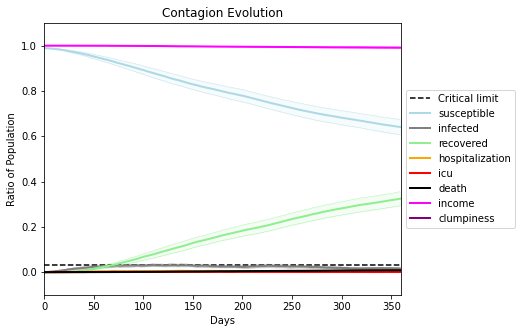

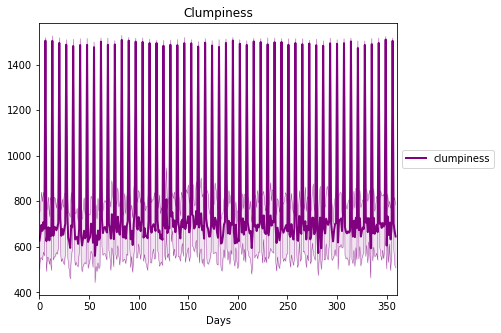

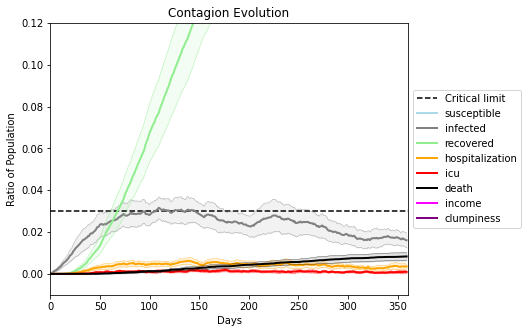

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6699, 3121, 2121, 8043, 2800, 9117, 4944, 8681, 8017, 7520, 6652, 2580, 930, 2005, 6468, 5101, 7666, 5013, 7374, 4774]
Average similarity between family members is 0.9562915416095779 at temperature -0.997
Average similarity between family and home is 0.9998510463444776 at temperature -1
Average similarity between students and their classroom is 0.8988940550677926 at temperature -0.997
Average classroom occupancy is 1.705521472392638 and number classrooms is 163
Average similarity between workers is 0.9212807662991593 at temperature -0.997
Average office occupancy is 3.536842105263158 and number offices is 190
Average friend similarity for adults: 0.8623126956736308 for kids: 0.7198956738333171
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.5474897863541249
avg restaurant similarity 0.5752886178411178
avg restaurant similarity 0.6271456468515577
avg restaurant similarity 0.5772600027976743
avg restaurant similarity 0.5804778193617617
avg restaurant similarity 0.6386930462340118
avg restaurant similarity 0.6123975963853867
avg restaurant similarity 0.5584896415074162
avg restaurant similarity 0.590458172172757
avg restaurant similarity 0.6015828628149068
avg restaurant similarity 0.5701985946388004
avg restaurant similarity 0.6617303419351179
avg restaurant similarity 0.617272316339297
avg restaurant similarity 0.5608361433006348
avg restaurant similarity 0.6106317346222357
avg restaurant similarity 0.5667598258821208
avg restaurant similarity 0.5880641700951198
avg restaurant similarity 0.6120119694207399
avg restaurant similarity 0.6532486792663542
avg restaurant similarity 0.5578446161674584
avg restaurant similarity 0.6135983500294817
avg restaurant similarity 0.6040511983141453
avg restaura

avg restaurant similarity 0.5923484910680048
avg restaurant similarity 0.5807550493082654
avg restaurant similarity 0.6231966102667954
avg restaurant similarity 0.6062365132442231
avg restaurant similarity 0.623853530373725
avg restaurant similarity 0.6156844889245557
avg restaurant similarity 0.5363666996470567
avg restaurant similarity 0.5396927597241064
avg restaurant similarity 0.5578823085011623
avg restaurant similarity 0.6067858688795094
avg restaurant similarity 0.5560702774279331
avg restaurant similarity 0.6141941719245994
avg restaurant similarity 0.6244786541379336
avg restaurant similarity 0.606260425656514
avg restaurant similarity 0.6696637534237438
avg restaurant similarity 0.5989572229028118
avg restaurant similarity 0.5856081747324149
avg restaurant similarity 0.6758142571543386
avg restaurant similarity 0.6349319375550527
avg restaurant similarity 0.6358941575968923
avg restaurant similarity 0.6579187726310418
avg restaurant similarity 0.5850045603489653
avg restaura

Average similarity between workers is 0.9098220062881748 at temperature -0.997
Average office occupancy is 3.3484848484848486 and number offices is 198
Average friend similarity for adults: 0.8497252075688914 for kids: 0.7228310512120407
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5937514954156052
avg restaurant similarity 0.5754807446279393
avg restaurant similarity 0.6836348836950055
avg restaurant similarity 0.5777911952562901
avg restaurant similarity 0.5938353409162397
avg restaurant similarity 0.5578514675791625
avg restaurant similarity 0.5886740141221976
avg restaurant similarity 0.6201244683575456
avg restaurant similarity 0.6110550803504505
avg restaurant similarity 0.6200081108365396
avg restaurant similarity 0.6376192696539118
avg restaurant similarity 0.5975103194861269
avg restaurant similarity 0.5692638821999783
avg restaurant similarity 0.5891679015142823
avg restaurant similarity 0.6124578709047017
avg restaurant similarity 0.5802500638651074
avg restaurant similarity 0.6349015868100318
avg restaurant similarity 0.6056016622579887
avg restaurant similarity 0.5700633107884813
avg restaurant similarity 0.6127368432546858
avg restaurant similarity 0.5981803188028342
avg restaurant similarity 0.657259537971112
avg restaur

avg restaurant similarity 0.5984310639771206
avg restaurant similarity 0.607033381522462
avg restaurant similarity 0.6330331312408518
avg restaurant similarity 0.5866878655780529
avg restaurant similarity 0.6060448482046465
avg restaurant similarity 0.61595431798921
avg restaurant similarity 0.5853043740640279
avg restaurant similarity 0.6376539200552668
avg restaurant similarity 0.6144280439609984
avg restaurant similarity 0.5967602107653399
avg restaurant similarity 0.6447296820506213
avg restaurant similarity 0.645407309550584
avg restaurant similarity 0.5867251963945214
avg restaurant similarity 0.5684867137997086
avg restaurant similarity 0.6500143744038562
avg restaurant similarity 0.6232848909690613
avg restaurant similarity 0.619596712637314
avg restaurant similarity 0.584557727909827
avg restaurant similarity 0.5793223570233703
avg restaurant similarity 0.5897995052239403
avg restaurant similarity 0.5860560931641369
avg restaurant similarity 0.6355263720323396
avg restaurant s

Average similarity between workers is 0.9295007684398512 at temperature -0.997
Average office occupancy is 3.4031413612565444 and number offices is 191
Average friend similarity for adults: 0.8655222592726517 for kids: 0.7402357481513255
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6391674837383878
avg restaurant similarity 0.6134586520433775
avg restaurant similarity 0.6221471478504994
avg restaurant similarity 0.6330031444074863
avg restaurant similarity 0.63915604397339
avg restaurant similarity 0.6191765089879073
avg restaurant similarity 0.6285882627409587
avg restaurant similarity 0.6707024526541981
avg restaurant similarity 0.6189374278734839
avg restaurant similarity 0.6291705059074444
avg restaurant similarity 0.6121681634980101
avg restaurant similarity 0.6673663592780401
avg restaurant similarity 0.6380484574237616
avg restaurant similarity 0.6749783380559758
avg restaurant similarity 0.5814042058499391
avg restaurant similarity 0.6365626836903103
avg restaurant similarity 0.618528347210527
avg restaurant similarity 0.6280742556435805
avg restaurant similarity 0.6109626389687057
avg restaurant similarity 0.5435575372398028
avg restaurant similarity 0.617580685203783
avg restaurant similarity 0.6402758138053866
avg restaurant

avg restaurant similarity 0.6226965183171329
avg restaurant similarity 0.6563059868575032
avg restaurant similarity 0.6140640362843025
avg restaurant similarity 0.6076251439165358
avg restaurant similarity 0.5917431520058578
avg restaurant similarity 0.6752619700693155
avg restaurant similarity 0.595954726179674
avg restaurant similarity 0.5766930726699774
avg restaurant similarity 0.5952292857812347
avg restaurant similarity 0.6507402821948199
avg restaurant similarity 0.6929573229357896
avg restaurant similarity 0.6023562520582469
avg restaurant similarity 0.6358354507696855
avg restaurant similarity 0.6279997101234837
avg restaurant similarity 0.6484063241016313
avg restaurant similarity 0.6081721667716735
avg restaurant similarity 0.6559524135704428
avg restaurant similarity 0.6556762937598621
avg restaurant similarity 0.5736930029337096
avg restaurant similarity 0.6162392278878583
avg restaurant similarity 0.5881177044417623
avg restaurant similarity 0.5494815577450617
avg restaur

Average similarity between workers is 0.937888456458134 at temperature -0.997
Average office occupancy is 3.404040404040404 and number offices is 198
Average friend similarity for adults: 0.8630633063244187 for kids: 0.7292584546665976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.6241118421662586
avg restaurant similarity 0.6110317215750077
avg restaurant similarity 0.6227978411479359
avg restaurant similarity 0.6893273770245906
avg restaurant similarity 0.5947059433221329
avg restaurant similarity 0.7024777716687781
avg restaurant similarity 0.6380285551784723
avg restaurant similarity 0.6278589595928968
avg restaurant similarity 0.6606075589824648
avg restaurant similarity 0.6571517549726039
avg restaurant similarity 0.6453559191951685
avg restaurant similarity 0.6403419718347523
avg restaurant similarity 0.6064555136834696
avg restaurant similarity 0.6421753812336023
avg restaurant similarity 0.6144649410457015
avg restaurant similarity 0.6810569649027808
avg restaurant similarity 0.6730977960194684
avg restaurant similarity 0.5998233901911176
avg restaurant similarity 0.7006839020507256
avg restaurant similarity 0.6154136447005019
avg restaurant similarity 0.6461336920550579
avg restaurant similarity 0.6374837442350515
avg restau

avg restaurant similarity 0.5913098414867534
avg restaurant similarity 0.6141228117072417
avg restaurant similarity 0.6756364251204978
avg restaurant similarity 0.6813841519775532
avg restaurant similarity 0.6223328126037858
avg restaurant similarity 0.6315186939758575
avg restaurant similarity 0.6260624304450504
avg restaurant similarity 0.618557794721296
avg restaurant similarity 0.6344337227261894
avg restaurant similarity 0.6550557150585876
avg restaurant similarity 0.6659606400596181
avg restaurant similarity 0.6124886880367456
avg restaurant similarity 0.5509657664735628
avg restaurant similarity 0.6139271110398044
avg restaurant similarity 0.6121486029516647
avg restaurant similarity 0.6134843940970334
avg restaurant similarity 0.615442704440953
avg restaurant similarity 0.6989424506291524
avg restaurant similarity 0.6305879269101672
avg restaurant similarity 0.6510232567554295
avg restaurant similarity 0.6465685579452718
avg restaurant similarity 0.6346255995595824
avg restaura

Average similarity between workers is 0.9305317341827624 at temperature -0.997
Average office occupancy is 3.446236559139785 and number offices is 186
Average friend similarity for adults: 0.8534507257986158 for kids: 0.7487123001739093
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5742843369111545
avg restaurant similarity 0.6323974577525997
avg restaurant similarity 0.5745643436424117
avg restaurant similarity 0.577997612201107
avg restaurant similarity 0.6484615969009181
avg restaurant similarity 0.6106075270416725
avg restaurant similarity 0.5954710799283167
avg restaurant similarity 0.5727470225228035
avg restaurant similarity 0.6177862578276451
avg restaurant similarity 0.6206667092205355
avg restaurant similarity 0.5919620957650308
avg restaurant similarity 0.5965870912545298
avg restaurant similarity 0.555417221692072
avg restaurant similarity 0.5899521281040843
avg restaurant similarity 0.5909412700601445
avg restaurant similarity 0.5990538182499149
avg restaurant similarity 0.5942551694290813
avg restaurant similarity 0.5982244220245998
avg restaurant similarity 0.5929857909760928
avg restaurant similarity 0.6140115981034948
avg restaurant similarity 0.6610353738283195
avg restaurant similarity 0.6161964600530246
avg restaura

avg restaurant similarity 0.6165925695674558
avg restaurant similarity 0.6663562291020388
avg restaurant similarity 0.5955793286867535
avg restaurant similarity 0.614715933161249
avg restaurant similarity 0.5843936275876932
avg restaurant similarity 0.5744482487353079
avg restaurant similarity 0.5781162941194947
avg restaurant similarity 0.5481257953319
avg restaurant similarity 0.6026338340438382
avg restaurant similarity 0.6365102097769855
avg restaurant similarity 0.5793761452235265
avg restaurant similarity 0.5718599016198638
avg restaurant similarity 0.5502611640511629
avg restaurant similarity 0.5653073461479488
avg restaurant similarity 0.6632749368997236
avg restaurant similarity 0.5760753079965042
avg restaurant similarity 0.5629790814597462
avg restaurant similarity 0.5560907182130911
avg restaurant similarity 0.5871792562993328
avg restaurant similarity 0.6065567524843039
avg restaurant similarity 0.6477187887369005
avg restaurant similarity 0.6203663284591289
avg restaurant

Average similarity between workers is 0.9312165857583478 at temperature -0.997
Average office occupancy is 3.377551020408163 and number offices is 196
Average friend similarity for adults: 0.8629261355837713 for kids: 0.7531368043349396
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6895881192749547
avg restaurant similarity 0.6769223015876891
avg restaurant similarity 0.6493744032270912
avg restaurant similarity 0.6912564199483341
avg restaurant similarity 0.6517349088730133
avg restaurant similarity 0.6862418488396567
avg restaurant similarity 0.6149957332347631
avg restaurant similarity 0.6331147040192425
avg restaurant similarity 0.6453360799904492
avg restaurant similarity 0.6834748027629838
avg restaurant similarity 0.6874844466811072
avg restaurant similarity 0.6721245981127645
avg restaurant similarity 0.6480082159563068
avg restaurant similarity 0.6364779896690043
avg restaurant similarity 0.6283837079854061
avg restaurant similarity 0.6164142019982507
avg restaurant similarity 0.6936568718932044
avg restaurant similarity 0.6496279816113443
avg restaurant similarity 0.6690034243834029
avg restaurant similarity 0.6537614576070712
avg restaurant similarity 0.6719562786158157
avg restaurant similarity 0.6467680421560533
avg restau

avg restaurant similarity 0.7194500994306567
avg restaurant similarity 0.6942803848366599
avg restaurant similarity 0.6416719219829903
avg restaurant similarity 0.6447417536223312
avg restaurant similarity 0.6714640848706623
avg restaurant similarity 0.6818243436342546
avg restaurant similarity 0.5967382216036712
avg restaurant similarity 0.703174870718778
avg restaurant similarity 0.6320074892611128
avg restaurant similarity 0.6314762986329319
avg restaurant similarity 0.6287636768296266
avg restaurant similarity 0.6118710372702278
avg restaurant similarity 0.6070324038274162
avg restaurant similarity 0.6961510402483657
avg restaurant similarity 0.700175772777851
avg restaurant similarity 0.688117753846348
avg restaurant similarity 0.6816243097737777
avg restaurant similarity 0.6706485272747061
avg restaurant similarity 0.6631638536454915
avg restaurant similarity 0.6580157338187839
avg restaurant similarity 0.6241116383102049
avg restaurant similarity 0.6948971252357689
avg restauran

Average similarity between workers is 0.9254750854647229 at temperature -0.997
Average office occupancy is 3.38659793814433 and number offices is 194
Average friend similarity for adults: 0.8568481998430293 for kids: 0.731379534336349
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.6139171962974765
avg restaurant similarity 0.6226126351866713
avg restaurant similarity 0.5910275132751123
avg restaurant similarity 0.5749333739324056
avg restaurant similarity 0.6150716603623474
avg restaurant similarity 0.6136606617828622
avg restaurant similarity 0.6514919557282873
avg restaurant similarity 0.6343797948069364
avg restaurant similarity 0.608388565246977
avg restaurant similarity 0.5790329691522239
avg restaurant similarity 0.5693406133443173
avg restaurant similarity 0.574694118525969
avg restaurant similarity 0.6100698849717011
avg restaurant similarity 0.5437487957950703
avg restaurant similarity 0.6494874574283225
avg restaurant similarity 0.6176065533695023
avg restaurant similarity 0.5784238081243275
avg restaurant similarity 0.61187987991483
avg restaurant similarity 0.6110359690770298
avg restaurant similarity 0.6080619569461126
avg restaurant similarity 0.5273472683874042
avg restaurant similarity 0.6194690153398806
avg restaurant

avg restaurant similarity 0.5949169352492942
avg restaurant similarity 0.5867761087635753
avg restaurant similarity 0.642580248270657
avg restaurant similarity 0.603209735421168
avg restaurant similarity 0.5592000082062312
avg restaurant similarity 0.5913206614457059
avg restaurant similarity 0.6038959341747958
avg restaurant similarity 0.6509963081597163
avg restaurant similarity 0.6341955670547635
avg restaurant similarity 0.6064455780463922
avg restaurant similarity 0.6251006978068181
avg restaurant similarity 0.6161383281962461
avg restaurant similarity 0.5863796356189949
avg restaurant similarity 0.6116194009924282
avg restaurant similarity 0.5746823000654695
avg restaurant similarity 0.587291416560089
avg restaurant similarity 0.6247038795139208
avg restaurant similarity 0.647150670021347
avg restaurant similarity 0.5755056714366825
avg restaurant similarity 0.61616468601323
avg restaurant similarity 0.5565600880190172
avg restaurant similarity 0.5815843599574501
avg restaurant s

Average similarity between workers is 0.9349140879086861 at temperature -0.997
Average office occupancy is 3.2091836734693877 and number offices is 196
Average friend similarity for adults: 0.8471910290094115 for kids: 0.7335436596319618
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total o

avg restaurant similarity 0.6455082076206324
avg restaurant similarity 0.6290763786054314
avg restaurant similarity 0.6262003047289624
avg restaurant similarity 0.7007634090632235
avg restaurant similarity 0.6639768943982445
avg restaurant similarity 0.6462964884797874
avg restaurant similarity 0.6947036028773181
avg restaurant similarity 0.6692396908883258
avg restaurant similarity 0.6678010601515882
avg restaurant similarity 0.6679670230561594
avg restaurant similarity 0.6350187116106968
avg restaurant similarity 0.6647105815400041
avg restaurant similarity 0.6455118110611316
avg restaurant similarity 0.6596711589116397
avg restaurant similarity 0.6558835335607743
avg restaurant similarity 0.6479866496207042
avg restaurant similarity 0.6627549644404183
avg restaurant similarity 0.6747030499429214
avg restaurant similarity 0.6342949584354731
avg restaurant similarity 0.667574907972512
avg restaurant similarity 0.6665476656925099
avg restaurant similarity 0.6940621053464461
avg restaur

avg restaurant similarity 0.6290199838550563
avg restaurant similarity 0.6704702559911683
avg restaurant similarity 0.6421644530862811
avg restaurant similarity 0.6542274410250699
avg restaurant similarity 0.6421111054059667
avg restaurant similarity 0.6288874043987632
avg restaurant similarity 0.6933522402810313
avg restaurant similarity 0.6238309232134462
avg restaurant similarity 0.6234368530464118
avg restaurant similarity 0.6117159393781478
avg restaurant similarity 0.6433290798678504
avg restaurant similarity 0.7006576174950607
avg restaurant similarity 0.6196538441401782
avg restaurant similarity 0.6205023674917843
avg restaurant similarity 0.6680638913074727
avg restaurant similarity 0.6280630581172483
avg restaurant similarity 0.6187833369209653
avg restaurant similarity 0.6367558375526321
avg restaurant similarity 0.6722914416654698
avg restaurant similarity 0.6276246122365019
avg restaurant similarity 0.647762516710077
avg restaurant similarity 0.6179931149882427
avg restaur

Average similarity between workers is 0.9326750877472966 at temperature -0.997
Average office occupancy is 3.486772486772487 and number offices is 189
Average friend similarity for adults: 0.8581964226966236 for kids: 0.7317166757598789
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.632301954598456
avg restaurant similarity 0.6406435718175261
avg restaurant similarity 0.61063633223393
avg restaurant similarity 0.6123506830054192
avg restaurant similarity 0.6653372365610974
avg restaurant similarity 0.6429330675962978
avg restaurant similarity 0.6325759094863914
avg restaurant similarity 0.6065268486558646
avg restaurant similarity 0.6557221417380523
avg restaurant similarity 0.6824352099381414
avg restaurant similarity 0.6565908324012583
avg restaurant similarity 0.6194730474982536
avg restaurant similarity 0.614651271189177
avg restaurant similarity 0.6504354356270633
avg restaurant similarity 0.6063454493081015
avg restaurant similarity 0.6746036609049227
avg restaurant similarity 0.6272025575558897
avg restaurant similarity 0.6747502473507625
avg restaurant similarity 0.6438312163525257
avg restaurant similarity 0.5964316006233801
avg restaurant similarity 0.6502671621719059
avg restaurant similarity 0.6058720715426771
avg restaurant

avg restaurant similarity 0.6519834977069434
avg restaurant similarity 0.6546509930623425
avg restaurant similarity 0.604807263563451
avg restaurant similarity 0.6429537122790641
avg restaurant similarity 0.6482730619908355
avg restaurant similarity 0.5845548537727838
avg restaurant similarity 0.6131987001665336
avg restaurant similarity 0.6540722580935109
avg restaurant similarity 0.6519022614065578
avg restaurant similarity 0.6639005700890095
avg restaurant similarity 0.579082066668195
avg restaurant similarity 0.6387978265468315
avg restaurant similarity 0.648200719372221
avg restaurant similarity 0.6277367549316184
avg restaurant similarity 0.666804166849656
avg restaurant similarity 0.6491019303675651
avg restaurant similarity 0.6360257934135758
avg restaurant similarity 0.6517808067839795
avg restaurant similarity 0.6080305831977694
avg restaurant similarity 0.6229946885369214
avg restaurant similarity 0.6372958971559534
avg restaurant similarity 0.6587936855822217
avg restaurant

Average similarity between workers is 0.9221662410186217 at temperature -0.997
Average office occupancy is 3.4559585492227978 and number offices is 193
Average friend similarity for adults: 0.8627101212325787 for kids: 0.7297734023103053
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.602094212740632
avg restaurant similarity 0.6400317254437237
avg restaurant similarity 0.6148206631631753
avg restaurant similarity 0.5742577155835096
avg restaurant similarity 0.6096397748102039
avg restaurant similarity 0.6454294220071634
avg restaurant similarity 0.6177344548042194
avg restaurant similarity 0.600523613945464
avg restaurant similarity 0.6422568872214581
avg restaurant similarity 0.585280172573604
avg restaurant similarity 0.6070997957601596
avg restaurant similarity 0.6325482907484173
avg restaurant similarity 0.6175275050546758
avg restaurant similarity 0.6854939296391589
avg restaurant similarity 0.6330478731950993
avg restaurant similarity 0.6019419244419314
avg restaurant similarity 0.5742273168111183
avg restaurant similarity 0.6003442482998206
avg restaurant similarity 0.6485198341025767
avg restaurant similarity 0.6236367968536425
avg restaurant similarity 0.5958996831249426
avg restaurant similarity 0.6266858336860135
avg restauran

avg restaurant similarity 0.6255319557820833
avg restaurant similarity 0.6140117008167906
avg restaurant similarity 0.5979046220721933
avg restaurant similarity 0.6622841659362467
avg restaurant similarity 0.6534720967764825
avg restaurant similarity 0.6512737785052743
avg restaurant similarity 0.6382384297465774
avg restaurant similarity 0.6746873258025345
avg restaurant similarity 0.589694954668257
avg restaurant similarity 0.6443870374799665
avg restaurant similarity 0.623967021179596
avg restaurant similarity 0.6228505616695339
avg restaurant similarity 0.6292040515485477
avg restaurant similarity 0.6319359496395077
avg restaurant similarity 0.6148460923069828
avg restaurant similarity 0.6187990023130215
avg restaurant similarity 0.6461453692236264
avg restaurant similarity 0.6544886755228332
avg restaurant similarity 0.6312182072971729
avg restaurant similarity 0.6490104848785826
avg restaurant similarity 0.6287249181888424
avg restaurant similarity 0.5678570872267044
avg restaura

Average similarity between workers is 0.9300680084896945 at temperature -0.997
Average office occupancy is 3.292307692307692 and number offices is 195
Average friend similarity for adults: 0.8481047023656197 for kids: 0.7285031878827367
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.63447705170012
avg restaurant similarity 0.6205059251088849
avg restaurant similarity 0.6221002239570705
avg restaurant similarity 0.5917982104159474
avg restaurant similarity 0.6361692376343864
avg restaurant similarity 0.594372909394694
avg restaurant similarity 0.6266771134582889
avg restaurant similarity 0.6333658325128307
avg restaurant similarity 0.6296466900052464
avg restaurant similarity 0.5918369567026537
avg restaurant similarity 0.5924794512703004
avg restaurant similarity 0.6542817624673529
avg restaurant similarity 0.6061787501508452
avg restaurant similarity 0.5688074028213507
avg restaurant similarity 0.5951355369354581
avg restaurant similarity 0.5520225986249191
avg restaurant similarity 0.5969336633636234
avg restaurant similarity 0.6512682667115793
avg restaurant similarity 0.639116454496276
avg restaurant similarity 0.6011427780116521
avg restaurant similarity 0.619448997569667
avg restaurant similarity 0.5810995754389948
avg restaurant 

avg restaurant similarity 0.61482928626143
avg restaurant similarity 0.5772674667287705
avg restaurant similarity 0.5864407142499196
avg restaurant similarity 0.5756693660780838
avg restaurant similarity 0.5862681834455266
avg restaurant similarity 0.5394583927883099
avg restaurant similarity 0.603762878918562
avg restaurant similarity 0.55640465384658
avg restaurant similarity 0.6276250447748832
avg restaurant similarity 0.6045769066288289
avg restaurant similarity 0.613229542951754
avg restaurant similarity 0.5811545181336252
avg restaurant similarity 0.602724299102866
avg restaurant similarity 0.5598822579335503
avg restaurant similarity 0.574341384701261
avg restaurant similarity 0.5938426222743489
avg restaurant similarity 0.5754210503228945
avg restaurant similarity 0.6504689530466831
avg restaurant similarity 0.6194203251424124
avg restaurant similarity 0.6321007194266443
avg restaurant similarity 0.5832539611707088
avg restaurant similarity 0.6161118874786337
avg restaurant sim

Average similarity between workers is 0.9300051919951212 at temperature -0.997
Average office occupancy is 3.4894736842105263 and number offices is 190
Average friend similarity for adults: 0.8645001635288284 for kids: 0.7488669730581065
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.607975836907158
avg restaurant similarity 0.6170807746082302
avg restaurant similarity 0.6335213238983259
avg restaurant similarity 0.6120298057460907
avg restaurant similarity 0.7142536013436428
avg restaurant similarity 0.6433499448603757
avg restaurant similarity 0.6570083537045548
avg restaurant similarity 0.6401233821099674
avg restaurant similarity 0.6542843465125412
avg restaurant similarity 0.6875624113208625
avg restaurant similarity 0.683368361993253
avg restaurant similarity 0.6474857439672587
avg restaurant similarity 0.6094304127668877
avg restaurant similarity 0.6930735654721724
avg restaurant similarity 0.6478992356859249
avg restaurant similarity 0.6815223100040729
avg restaurant similarity 0.6706469921916803
avg restaurant similarity 0.6392952659168581
avg restaurant similarity 0.6598881751988491
avg restaurant similarity 0.6568009099014122
avg restaurant similarity 0.6505614266704598
avg restaurant similarity 0.6315278533384603
avg restaura

avg restaurant similarity 0.6628511854299908
avg restaurant similarity 0.6392766953922052
avg restaurant similarity 0.6494922102574624
avg restaurant similarity 0.6703019303823214
avg restaurant similarity 0.6091165273879572
avg restaurant similarity 0.6332640089020347
avg restaurant similarity 0.6556221614300558
avg restaurant similarity 0.6295184102546819
avg restaurant similarity 0.578665276414449
avg restaurant similarity 0.6914866320761717
avg restaurant similarity 0.5894428735151822
avg restaurant similarity 0.681281833577837
avg restaurant similarity 0.6065145164777231
avg restaurant similarity 0.6440645522983733
avg restaurant similarity 0.6939609023702249
avg restaurant similarity 0.6664629331200962
avg restaurant similarity 0.6513100313763737
avg restaurant similarity 0.7133939213833174
avg restaurant similarity 0.6539892122540736
avg restaurant similarity 0.6447592340106323
avg restaurant similarity 0.6100921754057302
avg restaurant similarity 0.5577808943238666
avg restaura

Average similarity between workers is 0.9159458866034349 at temperature -0.997
Average office occupancy is 3.2666666666666666 and number offices is 195
Average friend similarity for adults: 0.8531589298100395 for kids: 0.7481334515367377
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5980860132210273
avg restaurant similarity 0.6148818945688117
avg restaurant similarity 0.6486474841488716
avg restaurant similarity 0.617147617983298
avg restaurant similarity 0.6113150546151013
avg restaurant similarity 0.6269916378116038
avg restaurant similarity 0.6244798193338995
avg restaurant similarity 0.5960184854543729
avg restaurant similarity 0.5915774573717144
avg restaurant similarity 0.6263438668158015
avg restaurant similarity 0.5826612285103356
avg restaurant similarity 0.6110019362288109
avg restaurant similarity 0.6226114264004652
avg restaurant similarity 0.6156120206281586
avg restaurant similarity 0.5714748952562464
avg restaurant similarity 0.6472993278568132
avg restaurant similarity 0.637878313398086
avg restaurant similarity 0.5921480680113088
avg restaurant similarity 0.6233183597148967
avg restaurant similarity 0.6266741393929447
avg restaurant similarity 0.6107189903114195
avg restaurant similarity 0.5887867214109594
avg restaura

avg restaurant similarity 0.6436644746655179
avg restaurant similarity 0.6038638130300076
avg restaurant similarity 0.5993132939503382
avg restaurant similarity 0.6450096902186148
avg restaurant similarity 0.6132758081026366
avg restaurant similarity 0.5681104674950002
avg restaurant similarity 0.5863660815158258
avg restaurant similarity 0.6045558880091128
avg restaurant similarity 0.5919427008504546
avg restaurant similarity 0.6733751410003617
avg restaurant similarity 0.6250926454625614
avg restaurant similarity 0.6447044986545396
avg restaurant similarity 0.609198358300627
avg restaurant similarity 0.5954026656975722
avg restaurant similarity 0.606833855746488
avg restaurant similarity 0.5861076655725209
avg restaurant similarity 0.6263145845363738
avg restaurant similarity 0.5619688529637349
avg restaurant similarity 0.5904066074278951
avg restaurant similarity 0.6058658369021205
avg restaurant similarity 0.6383457978381284
avg restaurant similarity 0.6155625777907653
avg restaura

Average similarity between workers is 0.9279825618371813 at temperature -0.997
Average office occupancy is 3.372448979591837 and number offices is 196
Average friend similarity for adults: 0.8542190673305965 for kids: 0.7378987764572544
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.6878374917547787
avg restaurant similarity 0.6178377763608086
avg restaurant similarity 0.6319274507165554
avg restaurant similarity 0.6011901220276793
avg restaurant similarity 0.6052964967426384
avg restaurant similarity 0.6037894773882446
avg restaurant similarity 0.6270045772992994
avg restaurant similarity 0.6388711080369001
avg restaurant similarity 0.6374485939965547
avg restaurant similarity 0.6468188270568171
avg restaurant similarity 0.6424508951251057
avg restaurant similarity 0.6049591427772006
avg restaurant similarity 0.5808989914765281
avg restaurant similarity 0.5479039916451041
avg restaurant similarity 0.6134119569348588
avg restaurant similarity 0.6022678541461962
avg restaurant similarity 0.6300028426500749
avg restaurant similarity 0.5608466943380704
avg restaurant similarity 0.6253454313217892
avg restaurant similarity 0.6039850875985034
avg restaurant similarity 0.6267593600364997
avg restaurant similarity 0.5998827393995995
avg restau

avg restaurant similarity 0.6060483743582469
avg restaurant similarity 0.5914086904586081
avg restaurant similarity 0.5990358250120154
avg restaurant similarity 0.6181293493836267
avg restaurant similarity 0.5825452148063389
avg restaurant similarity 0.5725884009113242
avg restaurant similarity 0.5500626813012472
avg restaurant similarity 0.6875718398268555
avg restaurant similarity 0.6596032140554873
avg restaurant similarity 0.6092115485671503
avg restaurant similarity 0.6444313037802237
avg restaurant similarity 0.6125741415958075
avg restaurant similarity 0.6292734802591576
avg restaurant similarity 0.7186228857315994
avg restaurant similarity 0.6711577400752664
avg restaurant similarity 0.6878942406773116
avg restaurant similarity 0.6502162336810147
avg restaurant similarity 0.6156574672820593
avg restaurant similarity 0.6441630526359373
avg restaurant similarity 0.6369983821570492
avg restaurant similarity 0.6284729478319832
avg restaurant similarity 0.6622095809485771
avg restau

Average similarity between workers is 0.9190318279992524 at temperature -0.997
Average office occupancy is 3.3465346534653464 and number offices is 202
Average friend similarity for adults: 0.857240347866984 for kids: 0.7215947650886223
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6000852969106729
avg restaurant similarity 0.6189818742859727
avg restaurant similarity 0.5779015856507183
avg restaurant similarity 0.6132709273904934
avg restaurant similarity 0.6321707792394047
avg restaurant similarity 0.5995957396349249
avg restaurant similarity 0.5984838199822186
avg restaurant similarity 0.6157921018372071
avg restaurant similarity 0.6448368888150536
avg restaurant similarity 0.6345049457027695
avg restaurant similarity 0.6240704384860841
avg restaurant similarity 0.671170169721094
avg restaurant similarity 0.6166354851375259
avg restaurant similarity 0.6377484439060701
avg restaurant similarity 0.6601572861167777
avg restaurant similarity 0.6043137710676286
avg restaurant similarity 0.5699097832204093
avg restaurant similarity 0.578865678593203
avg restaurant similarity 0.6930501072505424
avg restaurant similarity 0.6270155243334475
avg restaurant similarity 0.6521461341997578
avg restaurant similarity 0.5824587537590648
avg restaura

avg restaurant similarity 0.619628294894242
avg restaurant similarity 0.6557255680730792
avg restaurant similarity 0.6021720172002938
avg restaurant similarity 0.5787189857910529
avg restaurant similarity 0.6437509780959962
avg restaurant similarity 0.6419737067759447
avg restaurant similarity 0.6721679036864051
avg restaurant similarity 0.6533265853152868
avg restaurant similarity 0.5838694201173479
avg restaurant similarity 0.597385230113454
avg restaurant similarity 0.5876083369952749
avg restaurant similarity 0.5947094791312221
avg restaurant similarity 0.582220445233721
avg restaurant similarity 0.5644313161973631
avg restaurant similarity 0.6184270876927921
avg restaurant similarity 0.6304825126083793
avg restaurant similarity 0.5572001472853069
avg restaurant similarity 0.614651972924488
avg restaurant similarity 0.5968789927058799
avg restaurant similarity 0.6163346938226487
avg restaurant similarity 0.649740280335288
avg restaurant similarity 0.6541023749651338
avg restaurant 

Average similarity between workers is 0.9152669077995959 at temperature -0.997
Average office occupancy is 3.4947368421052634 and number offices is 190
Average friend similarity for adults: 0.848164604505489 for kids: 0.73611763690976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.572885194226179
avg restaurant similarity 0.5905978708288476
avg restaurant similarity 0.5891487291198835
avg restaurant similarity 0.6314015405127665
avg restaurant similarity 0.6495141243202273
avg restaurant similarity 0.5788099625695642
avg restaurant similarity 0.598941121231736
avg restaurant similarity 0.5745010216348966
avg restaurant similarity 0.604373634504894
avg restaurant similarity 0.5783301882898129
avg restaurant similarity 0.5882189124559142
avg restaurant similarity 0.6007060468980444
avg restaurant similarity 0.6152031166889907
avg restaurant similarity 0.5880142399168095
avg restaurant similarity 0.5721928302117024
avg restaurant similarity 0.6162834509115678
avg restaurant similarity 0.6224429507447777
avg restaurant similarity 0.6070529984323658
avg restaurant similarity 0.5555684361766041
avg restaurant similarity 0.605735132646583
avg restaurant similarity 0.6220737381226746
avg restaurant similarity 0.58543398216584
avg restaurant s

avg restaurant similarity 0.5981145117734273
avg restaurant similarity 0.6398160536144867
avg restaurant similarity 0.6078569692111139
avg restaurant similarity 0.592466533421611
avg restaurant similarity 0.6002905847350285
avg restaurant similarity 0.5856812794520655
avg restaurant similarity 0.6096042184578391
avg restaurant similarity 0.6187103593418511
avg restaurant similarity 0.5844121677545261
avg restaurant similarity 0.5550381512021652
avg restaurant similarity 0.622635370795741
avg restaurant similarity 0.5895523628342489
avg restaurant similarity 0.6539615592579312
avg restaurant similarity 0.5952339812963229
avg restaurant similarity 0.5575143310087269
avg restaurant similarity 0.6523519122145407
avg restaurant similarity 0.5921750662243068
avg restaurant similarity 0.5904072991936059
avg restaurant similarity 0.5798242117559589
avg restaurant similarity 0.6375675327374941
avg restaurant similarity 0.5997437700824447
avg restaurant similarity 0.5521875968954537
avg restaura

Average similarity between workers is 0.9348103425016334 at temperature -0.997
Average office occupancy is 3.5555555555555554 and number offices is 189
Average friend similarity for adults: 0.8638723668735633 for kids: 0.7332852372212599
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6716157756557218
avg restaurant similarity 0.6839665141794165
avg restaurant similarity 0.6375293358679494
avg restaurant similarity 0.5890200117269566
avg restaurant similarity 0.6694047867210725
avg restaurant similarity 0.6558525953684459
avg restaurant similarity 0.7309820233669746
avg restaurant similarity 0.6366036038963622
avg restaurant similarity 0.6696479492251597
avg restaurant similarity 0.6221620639941152
avg restaurant similarity 0.711587265662108
avg restaurant similarity 0.7037273151183444
avg restaurant similarity 0.7044676736898854
avg restaurant similarity 0.7119018166898644
avg restaurant similarity 0.650725957074023
avg restaurant similarity 0.6416534204480179
avg restaurant similarity 0.6427259371934475
avg restaurant similarity 0.7059567889429084
avg restaurant similarity 0.6580602886267175
avg restaurant similarity 0.6119874289679674
avg restaurant similarity 0.6849657150619713
avg restaurant similarity 0.6471891121377504
avg restaura

avg restaurant similarity 0.6862724263703202
avg restaurant similarity 0.5821053559120053
avg restaurant similarity 0.6047118243856122
avg restaurant similarity 0.6718716309249445
avg restaurant similarity 0.6734315318281691
avg restaurant similarity 0.6037787984149887
avg restaurant similarity 0.6124038201789316
avg restaurant similarity 0.6903693336724431
avg restaurant similarity 0.6151128487962789
avg restaurant similarity 0.5965379908625156
avg restaurant similarity 0.6687967496105294
avg restaurant similarity 0.6886902587741579
avg restaurant similarity 0.6966509293454157
avg restaurant similarity 0.599662708815905
avg restaurant similarity 0.7005179945291906
avg restaurant similarity 0.6126388276184193
avg restaurant similarity 0.6869709286704198
avg restaurant similarity 0.6321761195752268
avg restaurant similarity 0.6311464064186451
avg restaurant similarity 0.696772392741713
avg restaurant similarity 0.6015497195018134
avg restaurant similarity 0.6897726682740738
avg restaura

Average similarity between workers is 0.9198492157331992 at temperature -0.997
Average office occupancy is 3.516304347826087 and number offices is 184
Average friend similarity for adults: 0.8504155226574461 for kids: 0.728451828948983
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 

avg restaurant similarity 0.5859767710172897
avg restaurant similarity 0.661246339624639
avg restaurant similarity 0.6516009467313265
avg restaurant similarity 0.620790283536645
avg restaurant similarity 0.5592416073149619
avg restaurant similarity 0.6457396784978262
avg restaurant similarity 0.6139655132907712
avg restaurant similarity 0.62114777076224
avg restaurant similarity 0.6261912250058103
avg restaurant similarity 0.6453242583882474
avg restaurant similarity 0.6119839773522117
avg restaurant similarity 0.6188142677173749
avg restaurant similarity 0.6265494151426243
avg restaurant similarity 0.5854937268988157
avg restaurant similarity 0.6615563044145033
avg restaurant similarity 0.6175414873677113
avg restaurant similarity 0.5725361067582183
avg restaurant similarity 0.5940448920424648
avg restaurant similarity 0.5690623654141489
avg restaurant similarity 0.588920398903242
avg restaurant similarity 0.6506778186024633
avg restaurant similarity 0.623851538409186
avg restaurant s

avg restaurant similarity 0.6403519422465246
avg restaurant similarity 0.6415735269294354
avg restaurant similarity 0.6527290994849035
avg restaurant similarity 0.617658491113519
avg restaurant similarity 0.6382650946603956
avg restaurant similarity 0.6399481972511502
avg restaurant similarity 0.606406607096271
avg restaurant similarity 0.5945209673337061
avg restaurant similarity 0.6256915946468161
avg restaurant similarity 0.57657364878547
avg restaurant similarity 0.6463840217082499
avg restaurant similarity 0.6038126719474909
avg restaurant similarity 0.6214081688953469
avg restaurant similarity 0.6488366171973309
avg restaurant similarity 0.6430908453297846
avg restaurant similarity 0.6067477293334769
avg restaurant similarity 0.5510632063917811
avg restaurant similarity 0.5680978091071316
avg restaurant similarity 0.6528291419464183
avg restaurant similarity 0.5564351135110822
avg restaurant similarity 0.5709490667065086
avg restaurant similarity 0.6209383822930558
avg restaurant

Average similarity between workers is 0.9435260877175161 at temperature -0.997
Average office occupancy is 3.4322916666666665 and number offices is 192
Average friend similarity for adults: 0.848931341363989 for kids: 0.717900547069137
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.597477439505086
avg restaurant similarity 0.6373599836333784
avg restaurant similarity 0.5774202968560451
avg restaurant similarity 0.5898791413290797
avg restaurant similarity 0.6061666845589847
avg restaurant similarity 0.6317857071706029
avg restaurant similarity 0.6023387012917608
avg restaurant similarity 0.6202088675948183
avg restaurant similarity 0.5823664407760967
avg restaurant similarity 0.5851262474534679
avg restaurant similarity 0.6280219546226483
avg restaurant similarity 0.6020241863688389
avg restaurant similarity 0.5904495855255241
avg restaurant similarity 0.6288404961666051
avg restaurant similarity 0.6023357157008254
avg restaurant similarity 0.6304732115885376
avg restaurant similarity 0.6513583172415391
avg restaurant similarity 0.612325084827472
avg restaurant similarity 0.5517434049591953
avg restaurant similarity 0.5645835248966837
avg restaurant similarity 0.6105249243457765
avg restaurant similarity 0.6551745067685355
avg restaura

avg restaurant similarity 0.5497946115672765
avg restaurant similarity 0.5872760991968473
avg restaurant similarity 0.6786480535636463
avg restaurant similarity 0.5997474579037947
avg restaurant similarity 0.5408358497608657
avg restaurant similarity 0.590488689919457
avg restaurant similarity 0.5800822458815725
avg restaurant similarity 0.5994677003828567
avg restaurant similarity 0.5842208256334849
avg restaurant similarity 0.6300204405351787
avg restaurant similarity 0.618616200060551
avg restaurant similarity 0.6437230536790743
avg restaurant similarity 0.6047635484375824
avg restaurant similarity 0.6145663530098631
avg restaurant similarity 0.5962430857675391
avg restaurant similarity 0.6159070247795239
avg restaurant similarity 0.5381747211415217
avg restaurant similarity 0.5126628693323256
avg restaurant similarity 0.6047355702048687
avg restaurant similarity 0.6271494377564079
avg restaurant similarity 0.5230998840443123
avg restaurant similarity 0.616069003994545
avg restauran

Average similarity between workers is 0.9266987139754749 at temperature -0.997
Average office occupancy is 3.4270833333333335 and number offices is 192
Average friend similarity for adults: 0.8578855723676284 for kids: 0.7340817580873643
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5784816941194801
avg restaurant similarity 0.6417702195048485
avg restaurant similarity 0.6951238806221686
avg restaurant similarity 0.5716439144885272
avg restaurant similarity 0.623691944544789
avg restaurant similarity 0.600622965888815
avg restaurant similarity 0.5951797278377932
avg restaurant similarity 0.6173262094868674
avg restaurant similarity 0.5621174608878209
avg restaurant similarity 0.603008684693178
avg restaurant similarity 0.6378186901718316
avg restaurant similarity 0.6170519941385562
avg restaurant similarity 0.5905698716217217
avg restaurant similarity 0.5964496543151102
avg restaurant similarity 0.5793186548527324
avg restaurant similarity 0.6056759389575905
avg restaurant similarity 0.6118752660292147
avg restaurant similarity 0.6285564635976787
avg restaurant similarity 0.6482413772432413
avg restaurant similarity 0.6383509657572959
avg restaurant similarity 0.5972565213932249
avg restaurant similarity 0.6521412981183896
avg restauran

avg restaurant similarity 0.668374801131761
avg restaurant similarity 0.5959364483386751
avg restaurant similarity 0.5852946949175637
avg restaurant similarity 0.6291273669232852
avg restaurant similarity 0.6048648370577332
avg restaurant similarity 0.5814875800757149
avg restaurant similarity 0.6269413479744496
avg restaurant similarity 0.6130626700788528
avg restaurant similarity 0.598782055212194
avg restaurant similarity 0.5984685606539697
avg restaurant similarity 0.5678304392994856
avg restaurant similarity 0.6195484896771484
avg restaurant similarity 0.637856917177053
avg restaurant similarity 0.605812051228601
avg restaurant similarity 0.6188928737762199
avg restaurant similarity 0.6372571405653772
avg restaurant similarity 0.6309020514669392
avg restaurant similarity 0.6500542250779945
avg restaurant similarity 0.612106056022339
avg restaurant similarity 0.5711301003178474
avg restaurant similarity 0.6018007131894599
avg restaurant similarity 0.6062427760729183
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

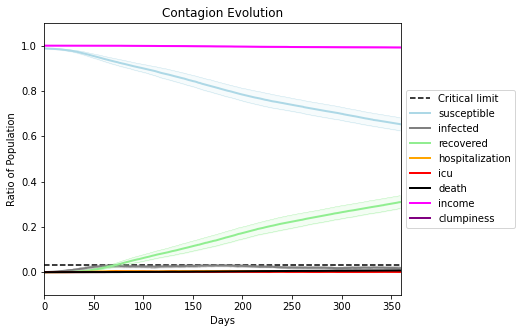

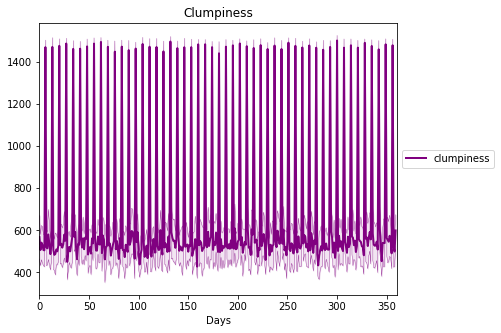

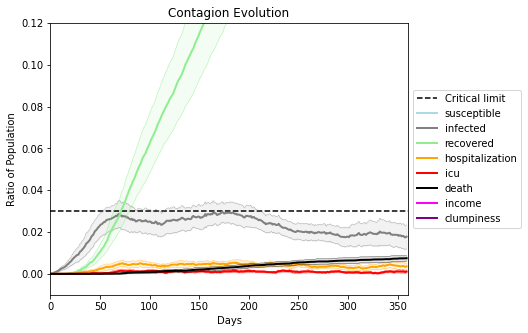

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5206, 7564, 1274, 6920, 5604, 4540, 6227, 2084, 7444, 5215, 8497, 9222, 2999, 5711, 4729, 8486, 9999, 2074, 9653, 4392]
Average similarity between family members is 0.9527379917060677 at temperature -0.996
Average similarity between family and home is 0.9998574624279345 at temperature -1
Average similarity between students and their classroom is 0.9263028320869849 at temperature -0.996
Average classroom occupancy is 1.6353591160220995 and number classrooms is 181
Average similarity between workers is 0.9282480761168093 at temperature -0.996
Average office occupancy is 3.4545454545454546 and number offices is 187
Average friend similarity for adults: 0.8620371590183644 for kids: 0.7387408086870495
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.6088390168396457
avg restaurant similarity 0.5889920414494461
avg restaurant similarity 0.633038714442491
avg restaurant similarity 0.6237998558206526
avg restaurant similarity 0.6085685617562344
avg restaurant similarity 0.6031768110023353
avg restaurant similarity 0.6674595074441683
avg restaurant similarity 0.5998388790965953
avg restaurant similarity 0.6314178875299402
avg restaurant similarity 0.6156338790389879
avg restaurant similarity 0.6188705827606211
avg restaurant similarity 0.6512449323608513
avg restaurant similarity 0.6566687592524821
avg restaurant similarity 0.6588164455228533
avg restaurant similarity 0.6647835624873003
avg restaurant similarity 0.6763522800552784
avg restaurant similarity 0.5661745512938544
avg restaurant similarity 0.6453160600957206
avg restaurant similarity 0.616264132957921
avg restaurant similarity 0.6315571193253846
avg restaurant similarity 0.6454277476246238
avg restaurant similarity 0.5906403323144931
avg restaura

avg restaurant similarity 0.6378805005982967
avg restaurant similarity 0.6375363148162417
avg restaurant similarity 0.6050250762563883
avg restaurant similarity 0.681130693999152
avg restaurant similarity 0.6036016112919655
avg restaurant similarity 0.6367939875784281
avg restaurant similarity 0.676063025741815
avg restaurant similarity 0.6201685717469659
avg restaurant similarity 0.5779076238632688
avg restaurant similarity 0.6493304321396846
avg restaurant similarity 0.5962143410658948
avg restaurant similarity 0.6364737925679738
avg restaurant similarity 0.6373866562512961
avg restaurant similarity 0.6220296363696936
avg restaurant similarity 0.5753674297654304
avg restaurant similarity 0.6216283351530548
avg restaurant similarity 0.6728785243211535
avg restaurant similarity 0.6113123878826502
avg restaurant similarity 0.6570945977998157
avg restaurant similarity 0.6591319785415469
avg restaurant similarity 0.6160408311516807
avg restaurant similarity 0.5988830250492264
avg restaura

Average similarity between workers is 0.9316689609511775 at temperature -0.996
Average office occupancy is 3.3076923076923075 and number offices is 195
Average friend similarity for adults: 0.8621386997328864 for kids: 0.7426215362738363
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of

avg restaurant similarity 0.5739996137665162
avg restaurant similarity 0.562469095504155
avg restaurant similarity 0.6201690321002509
avg restaurant similarity 0.5942501455031525
avg restaurant similarity 0.5883553293477624
avg restaurant similarity 0.6320351656119612
avg restaurant similarity 0.6221752631455754
avg restaurant similarity 0.6095103800043663
avg restaurant similarity 0.5856393769472468
avg restaurant similarity 0.6102135141840417
avg restaurant similarity 0.6331305094301833
avg restaurant similarity 0.5750897898214705
avg restaurant similarity 0.6189174905419065
avg restaurant similarity 0.6270090477729885
avg restaurant similarity 0.6385484671847164
avg restaurant similarity 0.6304725814138974
avg restaurant similarity 0.611678005670223
avg restaurant similarity 0.6025898919769441
avg restaurant similarity 0.629517221314674
avg restaurant similarity 0.6210111626793515
avg restaurant similarity 0.553385893007206
avg restaurant similarity 0.5885012691660642
avg restaurant

avg restaurant similarity 0.6353796601581172
avg restaurant similarity 0.6188033594372336
avg restaurant similarity 0.6300595055947563
avg restaurant similarity 0.5867257314152855
avg restaurant similarity 0.5957147153325536
avg restaurant similarity 0.6048554880537114
avg restaurant similarity 0.5555500432706253
avg restaurant similarity 0.5508089450008199
avg restaurant similarity 0.570867148973222
avg restaurant similarity 0.6025701591001009
avg restaurant similarity 0.5643898684149158
avg restaurant similarity 0.6544887355456861
avg restaurant similarity 0.6637877299769555
avg restaurant similarity 0.5801221794873173
avg restaurant similarity 0.6926617449655327
avg restaurant similarity 0.60428816642684
avg restaurant similarity 0.6042092641635572
avg restaurant similarity 0.6191126376332337
avg restaurant similarity 0.6382055801192272
avg restaurant similarity 0.6223726949471199
avg restaurant similarity 0.6525157369018771
avg restaurant similarity 0.6085944380283456
avg restauran

Average similarity between workers is 0.9146505836454405 at temperature -0.996
Average office occupancy is 3.627027027027027 and number offices is 185
Average friend similarity for adults: 0.8632807100814465 for kids: 0.7320466364014313
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.542249592560893
avg restaurant similarity 0.5774632143138005
avg restaurant similarity 0.6065410581139984
avg restaurant similarity 0.6738422425282157
avg restaurant similarity 0.5433216352511303
avg restaurant similarity 0.5377951861239032
avg restaurant similarity 0.5875014677663318
avg restaurant similarity 0.5745261297348688
avg restaurant similarity 0.5766340171457993
avg restaurant similarity 0.617966521466594
avg restaurant similarity 0.5863110087101477
avg restaurant similarity 0.5737469672585911
avg restaurant similarity 0.6064864917800628
avg restaurant similarity 0.5749414131179464
avg restaurant similarity 0.5844077412701121
avg restaurant similarity 0.5615157312953887
avg restaurant similarity 0.5478885233692479
avg restaurant similarity 0.5390786968345522
avg restaurant similarity 0.5806762059805423
avg restaurant similarity 0.5754838808061241
avg restaurant similarity 0.5310228390590479
avg restaurant similarity 0.6132719742937882
avg restaura

avg restaurant similarity 0.5554199584273665
avg restaurant similarity 0.5995406466239641
avg restaurant similarity 0.6409283101082638
avg restaurant similarity 0.6329284915855735
avg restaurant similarity 0.5383399283012184
avg restaurant similarity 0.5779312781819461
avg restaurant similarity 0.5472142776724662
avg restaurant similarity 0.5497375794596718
avg restaurant similarity 0.5310268260912141
avg restaurant similarity 0.5638167545092484
avg restaurant similarity 0.6446587273589932
avg restaurant similarity 0.5373346454397523
avg restaurant similarity 0.5826966620118526
avg restaurant similarity 0.5490694807403204
avg restaurant similarity 0.5582395273942024
avg restaurant similarity 0.6088041908867855
avg restaurant similarity 0.6295279177579038
avg restaurant similarity 0.5847209793012532
avg restaurant similarity 0.5770916372999433
avg restaurant similarity 0.5530761513322442
avg restaurant similarity 0.5511159713249294
avg restaurant similarity 0.5830435638398372
avg restau

Average similarity between workers is 0.9313774395448929 at temperature -0.996
Average office occupancy is 3.322751322751323 and number offices is 189
Average friend similarity for adults: 0.8504555228634795 for kids: 0.7463074965328261
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.6158468152988456
avg restaurant similarity 0.5738811270162999
avg restaurant similarity 0.6400144605994907
avg restaurant similarity 0.5703121004734298
avg restaurant similarity 0.6650799906580138
avg restaurant similarity 0.596770802815776
avg restaurant similarity 0.5753513647273143
avg restaurant similarity 0.6148605491840143
avg restaurant similarity 0.6276402777573354
avg restaurant similarity 0.6825643814949472
avg restaurant similarity 0.6299680291404254
avg restaurant similarity 0.5981764947548186
avg restaurant similarity 0.5832999428008309
avg restaurant similarity 0.5996670353345597
avg restaurant similarity 0.5848533568033419
avg restaurant similarity 0.6607938283773664
avg restaurant similarity 0.6225647530762004
avg restaurant similarity 0.6248736711726327
avg restaurant similarity 0.6268654626236427
avg restaurant similarity 0.6132512602478098
avg restaurant similarity 0.6459130133794686
avg restaurant similarity 0.6254373735140317
avg restaur

avg restaurant similarity 0.5862231362728453
avg restaurant similarity 0.6093910591383962
avg restaurant similarity 0.6259960308230414
avg restaurant similarity 0.5805641906364771
avg restaurant similarity 0.5922922562591189
avg restaurant similarity 0.5797841267764761
avg restaurant similarity 0.5684280467311896
avg restaurant similarity 0.641686135053633
avg restaurant similarity 0.6243739725315978
avg restaurant similarity 0.5644609235554156
avg restaurant similarity 0.5870756116389023
avg restaurant similarity 0.6853123812630932
avg restaurant similarity 0.6248187907277744
avg restaurant similarity 0.6434058860205468
avg restaurant similarity 0.647033728488514
avg restaurant similarity 0.656110004768764
avg restaurant similarity 0.5807143741850913
avg restaurant similarity 0.6340673967674044
avg restaurant similarity 0.6221789777068646
avg restaurant similarity 0.5663328541378367
avg restaurant similarity 0.5623490991831489
avg restaurant similarity 0.5857294922454643
avg restauran

Average similarity between workers is 0.9353219248162717 at temperature -0.996
Average office occupancy is 3.568421052631579 and number offices is 190
Average friend similarity for adults: 0.862319979844907 for kids: 0.7357531540780069
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5897469453766252
avg restaurant similarity 0.5606230528073054
avg restaurant similarity 0.6251707571741559
avg restaurant similarity 0.5520964735545457
avg restaurant similarity 0.6241695158728776
avg restaurant similarity 0.5974464492031688
avg restaurant similarity 0.6059555702150422
avg restaurant similarity 0.5781846041178786
avg restaurant similarity 0.6193967996491101
avg restaurant similarity 0.5805863368357125
avg restaurant similarity 0.6105825359453578
avg restaurant similarity 0.5950580678848563
avg restaurant similarity 0.6309077812575015
avg restaurant similarity 0.5463352561089116
avg restaurant similarity 0.6663883262077637
avg restaurant similarity 0.6046342949588689
avg restaurant similarity 0.602307483091881
avg restaurant similarity 0.6122667615130664
avg restaurant similarity 0.6141736048396355
avg restaurant similarity 0.6100281618573395
avg restaurant similarity 0.5355119879215129
avg restaurant similarity 0.6466045743313532
avg restaur

avg restaurant similarity 0.6196655413069633
avg restaurant similarity 0.5516527381891181
avg restaurant similarity 0.6232434968860653
avg restaurant similarity 0.5564306503127079
avg restaurant similarity 0.6593117619612575
avg restaurant similarity 0.614177036703663
avg restaurant similarity 0.6242045271806679
avg restaurant similarity 0.5810523187673573
avg restaurant similarity 0.6377426219657767
avg restaurant similarity 0.5955534921257465
avg restaurant similarity 0.6456516054640415
avg restaurant similarity 0.549747995205986
avg restaurant similarity 0.5711049227974657
avg restaurant similarity 0.5973778443835638
avg restaurant similarity 0.6366301849380354
avg restaurant similarity 0.6238873705969313
avg restaurant similarity 0.5839267016448195
avg restaurant similarity 0.5624452488547401
avg restaurant similarity 0.5620069950587462
avg restaurant similarity 0.5744783438218329
avg restaurant similarity 0.6058194220847803
avg restaurant similarity 0.6198473800201116
avg restaura

Average similarity between workers is 0.9302278412345599 at temperature -0.996
Average office occupancy is 3.4041450777202074 and number offices is 193
Average friend similarity for adults: 0.8552989939436215 for kids: 0.7358339574596815
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total o

avg restaurant similarity 0.5773210533681389
avg restaurant similarity 0.6104686596535198
avg restaurant similarity 0.5715465020915723
avg restaurant similarity 0.5271197387960997
avg restaurant similarity 0.5506763640878101
avg restaurant similarity 0.5537786142643357
avg restaurant similarity 0.5774231734676314
avg restaurant similarity 0.5989784622717114
avg restaurant similarity 0.5606178384048899
avg restaurant similarity 0.6034808846567442
avg restaurant similarity 0.555094509811607
avg restaurant similarity 0.6196515552485161
avg restaurant similarity 0.6023938293048289
avg restaurant similarity 0.5996872784538739
avg restaurant similarity 0.6106382424826178
avg restaurant similarity 0.5895004371696855
avg restaurant similarity 0.5448396876915275
avg restaurant similarity 0.6423128515379339
avg restaurant similarity 0.5895118221893374
avg restaurant similarity 0.6203551677757875
avg restaurant similarity 0.5966514231063732
avg restaurant similarity 0.5666587204493335
avg restaur

avg restaurant similarity 0.6480517334185363
avg restaurant similarity 0.5710402435742945
avg restaurant similarity 0.5545320745657409
avg restaurant similarity 0.5769128902537061
avg restaurant similarity 0.5773195332856931
avg restaurant similarity 0.5536570061978164
avg restaurant similarity 0.5186484097011443
avg restaurant similarity 0.5824988557944094
avg restaurant similarity 0.5643278841016628
avg restaurant similarity 0.6459816891700519
avg restaurant similarity 0.5049895675584667
avg restaurant similarity 0.5704012202717853
avg restaurant similarity 0.5753018831312047
avg restaurant similarity 0.5262765251505009
avg restaurant similarity 0.5842905019186211
avg restaurant similarity 0.6015998557585801
avg restaurant similarity 0.547368749406171
avg restaurant similarity 0.5798533012931286
avg restaurant similarity 0.5381237832455914
avg restaurant similarity 0.5735764009793931
avg restaurant similarity 0.5340999373135605
avg restaurant similarity 0.6287765047528088
avg restaur

Average similarity between workers is 0.9234702797662391 at temperature -0.996
Average office occupancy is 3.3842105263157896 and number offices is 190
Average friend similarity for adults: 0.8474773309876309 for kids: 0.7386871961815732
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6054805757547135
avg restaurant similarity 0.6080442804768248
avg restaurant similarity 0.6300181485107953
avg restaurant similarity 0.6474823750466931
avg restaurant similarity 0.6431878079755013
avg restaurant similarity 0.6071397059851091
avg restaurant similarity 0.6383138552206823
avg restaurant similarity 0.6544950466269635
avg restaurant similarity 0.6788012166694684
avg restaurant similarity 0.5952972471943727
avg restaurant similarity 0.6294791152991336
avg restaurant similarity 0.6067595376447366
avg restaurant similarity 0.5421218605314002
avg restaurant similarity 0.6056476870157212
avg restaurant similarity 0.6466972587421189
avg restaurant similarity 0.6313158888046224
avg restaurant similarity 0.5748434299499521
avg restaurant similarity 0.5987841506015689
avg restaurant similarity 0.6441186315406062
avg restaurant similarity 0.5996111818335517
avg restaurant similarity 0.6273922954957889
avg restaurant similarity 0.6081622013123252
avg restau

avg restaurant similarity 0.6346003154948259
avg restaurant similarity 0.6302264708922464
avg restaurant similarity 0.6019368366141193
avg restaurant similarity 0.6052006033009377
avg restaurant similarity 0.5665746529460933
avg restaurant similarity 0.6096213638736352
avg restaurant similarity 0.599445798090194
avg restaurant similarity 0.6295235346611386
avg restaurant similarity 0.6039821305640929
avg restaurant similarity 0.6171570869094123
avg restaurant similarity 0.6029782771387182
avg restaurant similarity 0.6403817396447956
avg restaurant similarity 0.5834531481621279
avg restaurant similarity 0.6232220863165857
avg restaurant similarity 0.6124169714614752
avg restaurant similarity 0.5854740423069716
avg restaurant similarity 0.6351657752595392
avg restaurant similarity 0.6271226108869232
avg restaurant similarity 0.6323415367364439
avg restaurant similarity 0.6395440908448016
avg restaurant similarity 0.6427907167303799
avg restaurant similarity 0.5745942665107996
avg restaur

Average similarity between workers is 0.9365762837456363 at temperature -0.996
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for adults: 0.8648231153411216 for kids: 0.7454044963756097
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.6245776581131023
avg restaurant similarity 0.6386597821462026
avg restaurant similarity 0.5384147303049002
avg restaurant similarity 0.611764310673762
avg restaurant similarity 0.6467732931623239
avg restaurant similarity 0.6863037467801881
avg restaurant similarity 0.6343608419483047
avg restaurant similarity 0.6289111189527016
avg restaurant similarity 0.6302451835551791
avg restaurant similarity 0.606628621651689
avg restaurant similarity 0.6485798805799914
avg restaurant similarity 0.6443727232380908
avg restaurant similarity 0.6244747830758359
avg restaurant similarity 0.6182310316345991
avg restaurant similarity 0.6612846700043005
avg restaurant similarity 0.6011605885193322
avg restaurant similarity 0.6180094204490858
avg restaurant similarity 0.6188275976131509
avg restaurant similarity 0.6254177331314454
avg restaurant similarity 0.6274813173801552
avg restaurant similarity 0.602116457816679
avg restaurant similarity 0.621356983601677
avg restaurant

avg restaurant similarity 0.6014569893363498
avg restaurant similarity 0.6832180491942017
avg restaurant similarity 0.6503043851057582
avg restaurant similarity 0.6317916366335119
avg restaurant similarity 0.6110896837499767
avg restaurant similarity 0.5623021632161465
avg restaurant similarity 0.6261772658777681
avg restaurant similarity 0.5630309014597784
avg restaurant similarity 0.6486324513465038
avg restaurant similarity 0.5929517151860229
avg restaurant similarity 0.609593821440631
avg restaurant similarity 0.6345109730958491
avg restaurant similarity 0.6300100231880958
avg restaurant similarity 0.5782866633739556
avg restaurant similarity 0.67785245738589
avg restaurant similarity 0.6623318778604865
avg restaurant similarity 0.6185929929931739
avg restaurant similarity 0.5434773167513233
avg restaurant similarity 0.5904943999669628
avg restaurant similarity 0.6636556294689199
avg restaurant similarity 0.6737207117985353
avg restaurant similarity 0.5943401267131929
avg restauran

Average similarity between workers is 0.9279563746801336 at temperature -0.996
Average office occupancy is 3.5425531914893615 and number offices is 188
Average friend similarity for adults: 0.8641236096179273 for kids: 0.7363751409760082
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6039412382645165
avg restaurant similarity 0.5848042647676212
avg restaurant similarity 0.6289768902884957
avg restaurant similarity 0.5977674273094867
avg restaurant similarity 0.606798571809506
avg restaurant similarity 0.6539437282828421
avg restaurant similarity 0.5905112836955051
avg restaurant similarity 0.608349785235472
avg restaurant similarity 0.5976968514942994
avg restaurant similarity 0.6228091593675855
avg restaurant similarity 0.5959715080235825
avg restaurant similarity 0.6450767535891848
avg restaurant similarity 0.6600501132024673
avg restaurant similarity 0.6389537850882537
avg restaurant similarity 0.641338158087648
avg restaurant similarity 0.6380563706534887
avg restaurant similarity 0.6056216052921203
avg restaurant similarity 0.6366044170570512
avg restaurant similarity 0.6542953786094532
avg restaurant similarity 0.5506395207289473
avg restaurant similarity 0.6023650406226014
avg restaurant similarity 0.6263787195092915
avg restauran

avg restaurant similarity 0.6241798919284314
avg restaurant similarity 0.6073491367633954
avg restaurant similarity 0.6094355496017447
avg restaurant similarity 0.6541706056698667
avg restaurant similarity 0.6123812643081644
avg restaurant similarity 0.5291058783632903
avg restaurant similarity 0.6126520618625155
avg restaurant similarity 0.6461384792052559
avg restaurant similarity 0.6410494242300673
avg restaurant similarity 0.6071836926345686
avg restaurant similarity 0.6487462444747346
avg restaurant similarity 0.6733889412155983
avg restaurant similarity 0.616058893941542
avg restaurant similarity 0.6198372716713109
avg restaurant similarity 0.6576602976164131
avg restaurant similarity 0.6202550597390073
avg restaurant similarity 0.6876057335978218
avg restaurant similarity 0.66311332389975
avg restaurant similarity 0.585366242635901
avg restaurant similarity 0.5675539354489811
avg restaurant similarity 0.6026353586059503
avg restaurant similarity 0.6240356473790221
avg restaurant

Average similarity between workers is 0.9181317894232051 at temperature -0.996
Average office occupancy is 3.294736842105263 and number offices is 190
Average friend similarity for adults: 0.8485570081784615 for kids: 0.7406600649332977
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5884208232439248
avg restaurant similarity 0.6130230308381565
avg restaurant similarity 0.5743607428167805
avg restaurant similarity 0.5720595895393418
avg restaurant similarity 0.6065337913346313
avg restaurant similarity 0.5732432132452172
avg restaurant similarity 0.5993353105603725
avg restaurant similarity 0.6527402141923074
avg restaurant similarity 0.6084310823347933
avg restaurant similarity 0.5553565747765045
avg restaurant similarity 0.586188109699063
avg restaurant similarity 0.5697228505189215
avg restaurant similarity 0.5755602750656803
avg restaurant similarity 0.6142594755662669
avg restaurant similarity 0.6446449129814613
avg restaurant similarity 0.600478305340158
avg restaurant similarity 0.6041714322093692
avg restaurant similarity 0.5474875133275506
avg restaurant similarity 0.6188778264569899
avg restaurant similarity 0.634382132216054
avg restaurant similarity 0.6377487564311134
avg restaurant similarity 0.6168645512061472
avg restauran

avg restaurant similarity 0.5542880708166903
avg restaurant similarity 0.6542743413050867
avg restaurant similarity 0.6384200615543881
avg restaurant similarity 0.6185712975762493
avg restaurant similarity 0.5513389569898092
avg restaurant similarity 0.6061825408272723
avg restaurant similarity 0.5527082717415777
avg restaurant similarity 0.5960464059961623
avg restaurant similarity 0.5634100294707233
avg restaurant similarity 0.5939774182179441
avg restaurant similarity 0.6284485538985978
avg restaurant similarity 0.622944903396075
avg restaurant similarity 0.628116312405969
avg restaurant similarity 0.5935914571947387
avg restaurant similarity 0.6698952923081405
avg restaurant similarity 0.5564829131884719
avg restaurant similarity 0.5787045859684345
avg restaurant similarity 0.608572594007185
avg restaurant similarity 0.608910237091507
avg restaurant similarity 0.616266931943435
avg restaurant similarity 0.6530437123262137
avg restaurant similarity 0.5584808517979316
avg restaurant 

Average similarity between workers is 0.9246351969720839 at temperature -0.996
Average office occupancy is 3.5654450261780104 and number offices is 191
Average friend similarity for adults: 0.8590871416660545 for kids: 0.7240766157972053
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.5901825999444372
avg restaurant similarity 0.605879489790544
avg restaurant similarity 0.5962401553913975
avg restaurant similarity 0.5964993641410844
avg restaurant similarity 0.5699719361969856
avg restaurant similarity 0.586010112672137
avg restaurant similarity 0.6301873112887485
avg restaurant similarity 0.5568263248139051
avg restaurant similarity 0.5692324536592582
avg restaurant similarity 0.6151734582581039
avg restaurant similarity 0.6219308397795881
avg restaurant similarity 0.603303851063279
avg restaurant similarity 0.5608001208653933
avg restaurant similarity 0.6253952110812411
avg restaurant similarity 0.5751515693827426
avg restaurant similarity 0.6237668453220171
avg restaurant similarity 0.6150601705373956
avg restaurant similarity 0.5553250443391347
avg restaurant similarity 0.5862148827947538
avg restaurant similarity 0.6328383492435671
avg restaurant similarity 0.6197351279468301
avg restaurant similarity 0.5184383268870165
avg restauran

avg restaurant similarity 0.5233175211162455
avg restaurant similarity 0.5749107946727191
avg restaurant similarity 0.6046202356342983
avg restaurant similarity 0.5864083705018027
avg restaurant similarity 0.6074529711407335
avg restaurant similarity 0.5947660602556007
avg restaurant similarity 0.6271353921360511
avg restaurant similarity 0.5905091739751915
avg restaurant similarity 0.5923787278517765
avg restaurant similarity 0.6364072913208872
avg restaurant similarity 0.5385245768287348
avg restaurant similarity 0.6242289808991563
avg restaurant similarity 0.6070365977900197
avg restaurant similarity 0.5391050651606497
avg restaurant similarity 0.5964508022087571
avg restaurant similarity 0.5884039321445126
avg restaurant similarity 0.5656290894105866
avg restaurant similarity 0.5934780636951027
avg restaurant similarity 0.5983544502716652
avg restaurant similarity 0.5498003349841611
avg restaurant similarity 0.589977757472464
avg restaurant similarity 0.5586717224088815
avg restaur

Average similarity between workers is 0.9247560543422852 at temperature -0.996
Average office occupancy is 3.195876288659794 and number offices is 194
Average friend similarity for adults: 0.8399642135875685 for kids: 0.7443503808013666
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.61499962770355
avg restaurant similarity 0.6078178825740486
avg restaurant similarity 0.6387682743270706
avg restaurant similarity 0.6250062436613351
avg restaurant similarity 0.619726596140804
avg restaurant similarity 0.6197031071526957
avg restaurant similarity 0.6154031476851104
avg restaurant similarity 0.5877720591482788
avg restaurant similarity 0.5975424649282188
avg restaurant similarity 0.5767135780413835
avg restaurant similarity 0.5949963482173499
avg restaurant similarity 0.5984344992915208
avg restaurant similarity 0.5891015703039147
avg restaurant similarity 0.5780171312883039
avg restaurant similarity 0.5660863068093424
avg restaurant similarity 0.5915144939442009
avg restaurant similarity 0.612604255914815
avg restaurant similarity 0.5970722468295415
avg restaurant similarity 0.5696450277704084
avg restaurant similarity 0.5961272605165351
avg restaurant similarity 0.5801279905203931
avg restaurant similarity 0.5740149159297344
avg restaurant

avg restaurant similarity 0.579270526187494
avg restaurant similarity 0.5943774447088968
avg restaurant similarity 0.591737408680886
avg restaurant similarity 0.5744512376883935
avg restaurant similarity 0.5295219766852415
avg restaurant similarity 0.5922308471800074
avg restaurant similarity 0.5547222878407391
avg restaurant similarity 0.588428826522072
avg restaurant similarity 0.5883542605202998
avg restaurant similarity 0.5987164734103435
avg restaurant similarity 0.6048346520695197
avg restaurant similarity 0.5955979360496003
avg restaurant similarity 0.5610979458251644
avg restaurant similarity 0.6061479781435702
avg restaurant similarity 0.5998785759950538
avg restaurant similarity 0.5952437805811277
avg restaurant similarity 0.6053796696128345
avg restaurant similarity 0.5751898204632229
avg restaurant similarity 0.6088691417649784
avg restaurant similarity 0.5963202294450242
avg restaurant similarity 0.617735662810793
avg restaurant similarity 0.5870559822699339
avg restaurant

Average similarity between workers is 0.9296179127157279 at temperature -0.996
Average office occupancy is 3.473684210526316 and number offices is 190
Average friend similarity for adults: 0.8574290292948812 for kids: 0.729463519616476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.611492354927613
avg restaurant similarity 0.7120807678020197
avg restaurant similarity 0.6226193889546884
avg restaurant similarity 0.6429722398952273
avg restaurant similarity 0.5813522173788214
avg restaurant similarity 0.611825900059265
avg restaurant similarity 0.6203754491348263
avg restaurant similarity 0.7076921317443727
avg restaurant similarity 0.6425173614045085
avg restaurant similarity 0.6982691209321862
avg restaurant similarity 0.6071549780498668
avg restaurant similarity 0.6291924465692948
avg restaurant similarity 0.6097300381021173
avg restaurant similarity 0.6740158571774949
avg restaurant similarity 0.6371784623803294
avg restaurant similarity 0.6224467559836742
avg restaurant similarity 0.5983703123746664
avg restaurant similarity 0.6156879027978017
avg restaurant similarity 0.6297029913878343
avg restaurant similarity 0.5839584591095116
avg restaurant similarity 0.6130243399182154
avg restaurant similarity 0.5948199147118831
avg restaura

avg restaurant similarity 0.6190591219319416
avg restaurant similarity 0.6223717383535107
avg restaurant similarity 0.6043784133926658
avg restaurant similarity 0.6014176269325946
avg restaurant similarity 0.5894097240975796
avg restaurant similarity 0.6452583922617595
avg restaurant similarity 0.6042293963745548
avg restaurant similarity 0.6810448689192955
avg restaurant similarity 0.6408910582761809
avg restaurant similarity 0.5977692947702573
avg restaurant similarity 0.6235779921099821
avg restaurant similarity 0.6238686305473637
avg restaurant similarity 0.602385476753422
avg restaurant similarity 0.6387165100063725
avg restaurant similarity 0.6053585312858306
avg restaurant similarity 0.6824591046800378
avg restaurant similarity 0.6329814921146747
avg restaurant similarity 0.6803682176444328
avg restaurant similarity 0.6482637836684908
avg restaurant similarity 0.6436263295563309
avg restaurant similarity 0.6356805098157947
avg restaurant similarity 0.6493562704079703
avg restaur

Average similarity between workers is 0.9260314606917186 at temperature -0.996
Average office occupancy is 3.3958333333333335 and number offices is 192
Average friend similarity for adults: 0.8551052290322658 for kids: 0.7330009704826722
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.6030542304319985
avg restaurant similarity 0.6426435002988543
avg restaurant similarity 0.6030643381065488
avg restaurant similarity 0.6174293518906455
avg restaurant similarity 0.6381414193771272
avg restaurant similarity 0.607203186788946
avg restaurant similarity 0.6447484960271724
avg restaurant similarity 0.6706458626522666
avg restaurant similarity 0.6502586356589383
avg restaurant similarity 0.686104865480358
avg restaurant similarity 0.6344305769775964
avg restaurant similarity 0.6562727382521634
avg restaurant similarity 0.6052431468048056
avg restaurant similarity 0.612710090148017
avg restaurant similarity 0.6327710968119497
avg restaurant similarity 0.5862567700567547
avg restaurant similarity 0.6078268460612044
avg restaurant similarity 0.6270130690053171
avg restaurant similarity 0.5853231373236658
avg restaurant similarity 0.6552228406845997
avg restaurant similarity 0.6148053602125104
avg restaurant similarity 0.6340619022733487
avg restauran

avg restaurant similarity 0.6553488996631078
avg restaurant similarity 0.633800414548159
avg restaurant similarity 0.6192621017175409
avg restaurant similarity 0.600097991010153
avg restaurant similarity 0.656801476016343
avg restaurant similarity 0.6573012609978138
avg restaurant similarity 0.6347840264733177
avg restaurant similarity 0.6565624819624349
avg restaurant similarity 0.6730691257055123
avg restaurant similarity 0.6805650425962121
avg restaurant similarity 0.6042869238489111
avg restaurant similarity 0.5710355324998352
avg restaurant similarity 0.6831438112023409
avg restaurant similarity 0.6401079827461857
avg restaurant similarity 0.5805067565373613
avg restaurant similarity 0.666340227199003
avg restaurant similarity 0.6421607471021772
avg restaurant similarity 0.6720707686921861
avg restaurant similarity 0.6843472925939397
avg restaurant similarity 0.6574427140988618
avg restaurant similarity 0.665688321494703
avg restaurant similarity 0.6304089442165235
avg restaurant 

Average similarity between workers is 0.9388261092091571 at temperature -0.996
Average office occupancy is 3.2806122448979593 and number offices is 196
Average friend similarity for adults: 0.8675130809913352 for kids: 0.7503932028332162
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.669944206245367
avg restaurant similarity 0.6357152511675239
avg restaurant similarity 0.6577406365205288
avg restaurant similarity 0.5875776623587406
avg restaurant similarity 0.6442662007071465
avg restaurant similarity 0.5749656507025507
avg restaurant similarity 0.6319070064900713
avg restaurant similarity 0.5727949867686769
avg restaurant similarity 0.6713148729000082
avg restaurant similarity 0.6200176872862606
avg restaurant similarity 0.6823105260851148
avg restaurant similarity 0.6658386132566592
avg restaurant similarity 0.6261989997326624
avg restaurant similarity 0.5796593148092076
avg restaurant similarity 0.6446841129230738
avg restaurant similarity 0.6333646133735246
avg restaurant similarity 0.6192438927465469
avg restaurant similarity 0.6616801116481903
avg restaurant similarity 0.6446188190565768
avg restaurant similarity 0.659432089681555
avg restaurant similarity 0.6461987494428301
avg restaurant similarity 0.602289156584519
avg restauran

avg restaurant similarity 0.6431926582694298
avg restaurant similarity 0.6108820564288882
avg restaurant similarity 0.6325091385851362
avg restaurant similarity 0.6470688588838069
avg restaurant similarity 0.5797136701689352
avg restaurant similarity 0.6276768731114906
avg restaurant similarity 0.6906785701901538
avg restaurant similarity 0.6365683918844206
avg restaurant similarity 0.6292656421913353
avg restaurant similarity 0.6097868751485911
avg restaurant similarity 0.5833477204182523
avg restaurant similarity 0.6408868687537614
avg restaurant similarity 0.6905565225088279
avg restaurant similarity 0.6596252550344679
avg restaurant similarity 0.6451597761324075
avg restaurant similarity 0.6337613112628935
avg restaurant similarity 0.6653735290189318
avg restaurant similarity 0.6321931173626235
avg restaurant similarity 0.6318576754203313
avg restaurant similarity 0.6238727933779387
avg restaurant similarity 0.7076351881844982
avg restaurant similarity 0.6594747323955149
avg restau

Average similarity between workers is 0.9269717881955338 at temperature -0.996
Average office occupancy is 3.336734693877551 and number offices is 196
Average friend similarity for adults: 0.8588374256466563 for kids: 0.7372782734062099
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5962511885982911
avg restaurant similarity 0.6250285798105722
avg restaurant similarity 0.5511767761004839
avg restaurant similarity 0.625144843670239
avg restaurant similarity 0.6017936657626112
avg restaurant similarity 0.646416071461864
avg restaurant similarity 0.6605656471896116
avg restaurant similarity 0.5647483869978677
avg restaurant similarity 0.6192666367457118
avg restaurant similarity 0.5824469152671189
avg restaurant similarity 0.6224698618025026
avg restaurant similarity 0.6118851361151633
avg restaurant similarity 0.5958926768359694
avg restaurant similarity 0.605529811092765
avg restaurant similarity 0.5999262405562132
avg restaurant similarity 0.5953045922713697
avg restaurant similarity 0.6264762145595414
avg restaurant similarity 0.6458283143908904
avg restaurant similarity 0.58022075470571
avg restaurant similarity 0.6402946181530453
avg restaurant similarity 0.6477739998136063
avg restaurant similarity 0.7285961106276074
avg restaurant 

avg restaurant similarity 0.62489425985684
avg restaurant similarity 0.6067983546800481
avg restaurant similarity 0.6209314334906062
avg restaurant similarity 0.5484987578358927
avg restaurant similarity 0.6345898989121819
avg restaurant similarity 0.5920577137166207
avg restaurant similarity 0.6914342618563823
avg restaurant similarity 0.5667736643365133
avg restaurant similarity 0.6290471159134848
avg restaurant similarity 0.5783051943285109
avg restaurant similarity 0.5846597452685892
avg restaurant similarity 0.5990377555171608
avg restaurant similarity 0.6470823636093367
avg restaurant similarity 0.5638942385846396
avg restaurant similarity 0.6180164857153889
avg restaurant similarity 0.5684064051470258
avg restaurant similarity 0.5823619102188397
avg restaurant similarity 0.6366976876774056
avg restaurant similarity 0.6336121762178739
avg restaurant similarity 0.6736172932363942
avg restaurant similarity 0.6528128114618119
avg restaurant similarity 0.6464786979512084
avg restaura

Average similarity between workers is 0.9307856737485297 at temperature -0.996
Average office occupancy is 3.350253807106599 and number offices is 197
Average friend similarity for adults: 0.857400346373074 for kids: 0.7330479282172758
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 peo

avg restaurant similarity 0.5978130161849269
avg restaurant similarity 0.555308608962439
avg restaurant similarity 0.5811242586067804
avg restaurant similarity 0.5780218952975877
avg restaurant similarity 0.6405546163797168
avg restaurant similarity 0.5741775571424655
avg restaurant similarity 0.6069890721891537
avg restaurant similarity 0.6108802689282212
avg restaurant similarity 0.671019551394038
avg restaurant similarity 0.6586330423875935
avg restaurant similarity 0.6492963409981448
avg restaurant similarity 0.5755133071388334
avg restaurant similarity 0.6182852260681387
avg restaurant similarity 0.6741385606768878
avg restaurant similarity 0.6216128937894866
avg restaurant similarity 0.5931710080043675
avg restaurant similarity 0.5797933214349871
avg restaurant similarity 0.6593685689164239
avg restaurant similarity 0.6168126314813088
avg restaurant similarity 0.6490702233278445
avg restaurant similarity 0.5454018323190974
avg restaurant similarity 0.6612495036799104
avg restaura

avg restaurant similarity 0.561985748086236
avg restaurant similarity 0.5862426481914432
avg restaurant similarity 0.6091928754257692
avg restaurant similarity 0.594081921793036
avg restaurant similarity 0.6502386526495476
avg restaurant similarity 0.5944010181960065
avg restaurant similarity 0.5975991631643647
avg restaurant similarity 0.6327726560920012
avg restaurant similarity 0.6481516046868124
avg restaurant similarity 0.5886566623795142
avg restaurant similarity 0.5537619434456629
avg restaurant similarity 0.6308543586711467
avg restaurant similarity 0.5952760165292238
avg restaurant similarity 0.6211083809323624
avg restaurant similarity 0.6175350191642202
avg restaurant similarity 0.5999920810695283
avg restaurant similarity 0.6156957467448663
avg restaurant similarity 0.6357100170252952
avg restaurant similarity 0.5946494886941022
avg restaurant similarity 0.612127318539226
avg restaurant similarity 0.6100115851903712
avg restaurant similarity 0.6034726584216706
avg restauran

Average similarity between workers is 0.9401276338885513 at temperature -0.996
Average office occupancy is 3.430051813471503 and number offices is 193
Average friend similarity for adults: 0.8587632020620043 for kids: 0.7300638399903405
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5945542494241746
avg restaurant similarity 0.629083872463945
avg restaurant similarity 0.5958252893630286
avg restaurant similarity 0.6239024374897446
avg restaurant similarity 0.608704316650185
avg restaurant similarity 0.6319948145089744
avg restaurant similarity 0.5992565897934501
avg restaurant similarity 0.6023629584477009
avg restaurant similarity 0.6139631972339391
avg restaurant similarity 0.613303492928298
avg restaurant similarity 0.6161541821065145
avg restaurant similarity 0.6329247199538297
avg restaurant similarity 0.5896354989215736
avg restaurant similarity 0.5775846930449243
avg restaurant similarity 0.6222184838066098
avg restaurant similarity 0.602547567487225
avg restaurant similarity 0.6166030368258018
avg restaurant similarity 0.6425062120847795
avg restaurant similarity 0.5881924189634391
avg restaurant similarity 0.5990276782174938
avg restaurant similarity 0.6126153977534227
avg restaurant similarity 0.5775209470146443
avg restaurant

avg restaurant similarity 0.5870878722157438
avg restaurant similarity 0.5965920994468362
avg restaurant similarity 0.630388531366264
avg restaurant similarity 0.5884241204906778
avg restaurant similarity 0.6391686322922687
avg restaurant similarity 0.5895255480971009
avg restaurant similarity 0.6416512548871971
avg restaurant similarity 0.5826065948206671
avg restaurant similarity 0.6011525933662826
avg restaurant similarity 0.5704629416742167
avg restaurant similarity 0.5664282868054885
avg restaurant similarity 0.6396543435394695
avg restaurant similarity 0.5737660428090722
avg restaurant similarity 0.5920257901420042
avg restaurant similarity 0.6072111941003675
avg restaurant similarity 0.6001490954632548
avg restaurant similarity 0.5701287765958861
avg restaurant similarity 0.5505302669632898
avg restaurant similarity 0.6054282936857086
avg restaurant similarity 0.6263143369911808
avg restaurant similarity 0.541666235993707
avg restaurant similarity 0.5899693242740102
avg restaura

Average similarity between workers is 0.9252034358996827 at temperature -0.996
Average office occupancy is 3.4742268041237114 and number offices is 194
Average friend similarity for adults: 0.8626893653308118 for kids: 0.7427990891591923
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.615604526567629
avg restaurant similarity 0.7205162487455609
avg restaurant similarity 0.6343820236266701
avg restaurant similarity 0.6172334079508056
avg restaurant similarity 0.6568654029173212
avg restaurant similarity 0.6282098858960744
avg restaurant similarity 0.6292807019429315
avg restaurant similarity 0.6303344517555112
avg restaurant similarity 0.6350602403144938
avg restaurant similarity 0.5629353214873961
avg restaurant similarity 0.6283142737346463
avg restaurant similarity 0.6383877193756166
avg restaurant similarity 0.6267271442518809
avg restaurant similarity 0.6409793525383713
avg restaurant similarity 0.6260697349511986
avg restaurant similarity 0.6459389292451537
avg restaurant similarity 0.6218140515089623
avg restaurant similarity 0.6189938042949441
avg restaurant similarity 0.5971212464411244
avg restaurant similarity 0.5842473135365146
avg restaurant similarity 0.600616535689463
avg restaurant similarity 0.6426714602153216
avg restaura

avg restaurant similarity 0.6212951623030796
avg restaurant similarity 0.6095348824910602
avg restaurant similarity 0.6084387556085893
avg restaurant similarity 0.6350813064790116
avg restaurant similarity 0.6008165128158611
avg restaurant similarity 0.6685695579275077
avg restaurant similarity 0.6271345501687435
avg restaurant similarity 0.614513344827715
avg restaurant similarity 0.590515530713925
avg restaurant similarity 0.627038900806747
avg restaurant similarity 0.6078072371135981
avg restaurant similarity 0.5952834376515274
avg restaurant similarity 0.6400150465821561
avg restaurant similarity 0.5959689827352681
avg restaurant similarity 0.6097852411333142
avg restaurant similarity 0.6446271504944988
avg restaurant similarity 0.6149044447849449
avg restaurant similarity 0.6165824087132141
avg restaurant similarity 0.564783840603062
avg restaurant similarity 0.5768301879233532
avg restaurant similarity 0.6307579799443789
avg restaurant similarity 0.5828231301177772
avg restaurant

Average similarity between workers is 0.9359566149501737 at temperature -0.996
Average office occupancy is 3.3402061855670104 and number offices is 194
Average friend similarity for adults: 0.8590311045496298 for kids: 0.7376147236395503
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.6511702716556507
avg restaurant similarity 0.5649365703896042
avg restaurant similarity 0.6211909642478368
avg restaurant similarity 0.5722322245970137
avg restaurant similarity 0.5995837960147001
avg restaurant similarity 0.611280730186827
avg restaurant similarity 0.5965500481691804
avg restaurant similarity 0.6467024117791357
avg restaurant similarity 0.6165303549672987
avg restaurant similarity 0.6587837860929232
avg restaurant similarity 0.6195119158865329
avg restaurant similarity 0.6262277710084658
avg restaurant similarity 0.6534356246913353
avg restaurant similarity 0.608331194173575
avg restaurant similarity 0.597464124952634
avg restaurant similarity 0.656807250593364
avg restaurant similarity 0.5773854119441948
avg restaurant similarity 0.6064597625324369
avg restaurant similarity 0.5723813583198424
avg restaurant similarity 0.5772659400761236
avg restaurant similarity 0.6177220807418002
avg restaurant similarity 0.6224678732678903
avg restaurant

avg restaurant similarity 0.5167109860448857
avg restaurant similarity 0.6243809786569915
avg restaurant similarity 0.6454623682093814
avg restaurant similarity 0.6141225463488188
avg restaurant similarity 0.5705759256969809
avg restaurant similarity 0.5478198823561006
avg restaurant similarity 0.5949795070255419
avg restaurant similarity 0.6609502151962758
avg restaurant similarity 0.6061660675761187
avg restaurant similarity 0.6263683928580617
avg restaurant similarity 0.5996423845479536
avg restaurant similarity 0.560363266868374
avg restaurant similarity 0.6391377513986931
avg restaurant similarity 0.6443608436080352
avg restaurant similarity 0.6043952530063605
avg restaurant similarity 0.5943367585137906
avg restaurant similarity 0.5806238324175959
avg restaurant similarity 0.6648156279060915
avg restaurant similarity 0.6282806896377243
avg restaurant similarity 0.5987743233482605
avg restaurant similarity 0.609892318954529
avg restaurant similarity 0.5587779346755591
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

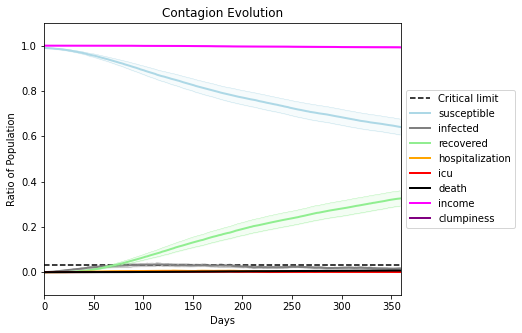

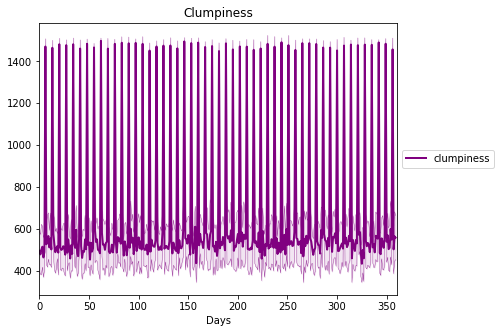

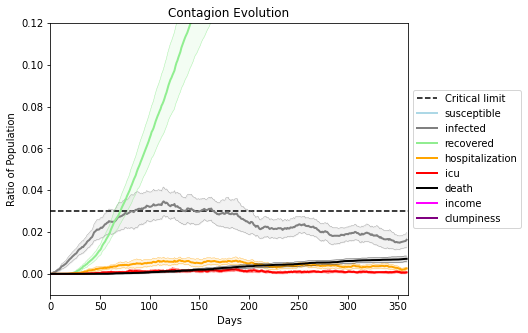

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2112, 8235, 203, 5989, 113, 5029, 404, 292, 6914, 7794, 8309, 7791, 309, 2685, 2553, 2859, 3607, 1978, 8521, 7057]
Average similarity between family members is 0.9454666743121675 at temperature -0.995
Average similarity between family and home is 0.99984738930551 at temperature -1
Average similarity between students and their classroom is 0.8778427914463628 at temperature -0.995
Average classroom occupancy is 1.6054054054054054 and number classrooms is 185
Average similarity between workers is 0.8913175808067357 at temperature -0.995
Average office occupancy is 3.2857142857142856 and number offices is 196
Average friend similarity for adults: 0.8620776946448532 for kids: 0.7392266999866011
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5847305337368944
avg restaurant similarity 0.6344612959650425
avg restaurant similarity 0.602063972053299
avg restaurant similarity 0.6065153039109485
avg restaurant similarity 0.5600459422167566
avg restaurant similarity 0.5885626474911961
avg restaurant similarity 0.6209980206600111
avg restaurant similarity 0.5678588438749752
avg restaurant similarity 0.571144207296849
avg restaurant similarity 0.5689137677535757
avg restaurant similarity 0.5909323074819898
avg restaurant similarity 0.6555612242402584
avg restaurant similarity 0.6207760991329686
avg restaurant similarity 0.5550613185350309
avg restaurant similarity 0.5946263682093101
avg restaurant similarity 0.6466738142788481
avg restaurant similarity 0.6101428130243789
avg restaurant similarity 0.6020116834209457
avg restaurant similarity 0.6035864254782318
avg restaurant similarity 0.5905296862962135
avg restaurant similarity 0.6268211496816063
avg restaurant similarity 0.6120712613505309
avg restaura

avg restaurant similarity 0.6180757230426577
avg restaurant similarity 0.6256040520333358
avg restaurant similarity 0.6136649225542321
avg restaurant similarity 0.5501141314032749
avg restaurant similarity 0.6450017619499185
avg restaurant similarity 0.6096564069897319
avg restaurant similarity 0.6248855879869526
avg restaurant similarity 0.6137860719011157
avg restaurant similarity 0.6402819348937918
avg restaurant similarity 0.6834470078679828
avg restaurant similarity 0.5820359391678289
avg restaurant similarity 0.5628885069043993
avg restaurant similarity 0.6405960375202315
avg restaurant similarity 0.6019661157787932
avg restaurant similarity 0.5906199195687731
avg restaurant similarity 0.6629701644839439
avg restaurant similarity 0.6379286441162672
avg restaurant similarity 0.6076986347424227
avg restaurant similarity 0.6106577598622529
avg restaurant similarity 0.5566490728718427
avg restaurant similarity 0.5868765493264261
avg restaurant similarity 0.6379358586154168
avg restau

Average similarity between workers is 0.9048396929053933 at temperature -0.995
Average office occupancy is 3.345 and number offices is 200
Average friend similarity for adults: 0.8470725810808083 for kids: 0.7212405317429144
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people all

avg restaurant similarity 0.5188948278570282
avg restaurant similarity 0.5382070406970039
avg restaurant similarity 0.5505653385000413
avg restaurant similarity 0.5320836931098244
avg restaurant similarity 0.5915275141821537
avg restaurant similarity 0.5321851896385218
avg restaurant similarity 0.5220839699417207
avg restaurant similarity 0.5634173073875955
avg restaurant similarity 0.535379152129975
avg restaurant similarity 0.5644589941434774
avg restaurant similarity 0.5206276719297591
avg restaurant similarity 0.5762140807327717
avg restaurant similarity 0.5384934714519347
avg restaurant similarity 0.555391247520433
avg restaurant similarity 0.5584249262712551
avg restaurant similarity 0.5441279054507464
avg restaurant similarity 0.5345581399440262
avg restaurant similarity 0.5264004107079439
avg restaurant similarity 0.61221840462152
avg restaurant similarity 0.5645751055362331
avg restaurant similarity 0.5797742723369257
avg restaurant similarity 0.5012493895719985
avg restaurant

avg restaurant similarity 0.5526785808188117
avg restaurant similarity 0.5854166067064933
avg restaurant similarity 0.5766815725894976
avg restaurant similarity 0.5489623757045788
avg restaurant similarity 0.5772679826410012
avg restaurant similarity 0.5636966417671196
avg restaurant similarity 0.5347488190098552
avg restaurant similarity 0.5473021546860397
avg restaurant similarity 0.516421597065866
avg restaurant similarity 0.5465069738346114
avg restaurant similarity 0.5563373776086048
avg restaurant similarity 0.5722562964443156
avg restaurant similarity 0.5311640849787169
avg restaurant similarity 0.561629260481194
avg restaurant similarity 0.5545717581794857
avg restaurant similarity 0.5860912758022969
avg restaurant similarity 0.5139112992197626
avg restaurant similarity 0.5447641648247009
avg restaurant similarity 0.5530262928413973
avg restaurant similarity 0.6080080336207405
avg restaurant similarity 0.5232246579913813
avg restaurant similarity 0.5577217860230922
avg restaura

Average similarity between workers is 0.9029074003006494 at temperature -0.995
Average office occupancy is 3.3756345177664975 and number offices is 197
Average friend similarity for adults: 0.8504620372598596 for kids: 0.733534740954798
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.5723605360188803
avg restaurant similarity 0.5720437209044987
avg restaurant similarity 0.5772720652866413
avg restaurant similarity 0.5636646170343167
avg restaurant similarity 0.6015154344607984
avg restaurant similarity 0.5408331417032557
avg restaurant similarity 0.5411042407432077
avg restaurant similarity 0.5341772303785443
avg restaurant similarity 0.5609937949518484
avg restaurant similarity 0.5671278654352029
avg restaurant similarity 0.5387962519106873
avg restaurant similarity 0.5872051326881258
avg restaurant similarity 0.5710593779491527
avg restaurant similarity 0.5790269290039265
avg restaurant similarity 0.5616647762587376
avg restaurant similarity 0.5369786771865696
avg restaurant similarity 0.5836065341627502
avg restaurant similarity 0.6056166995666358
avg restaurant similarity 0.5519891186714418
avg restaurant similarity 0.6127312622174718
avg restaurant similarity 0.6007320279404078
avg restaurant similarity 0.5893248284657505
avg restau

avg restaurant similarity 0.5503147258577836
avg restaurant similarity 0.5654051573003994
avg restaurant similarity 0.6344026719300319
avg restaurant similarity 0.5525031293129529
avg restaurant similarity 0.5188733584504739
avg restaurant similarity 0.5529144745430719
avg restaurant similarity 0.5478795240661373
avg restaurant similarity 0.5788706302091606
avg restaurant similarity 0.5841835361002137
avg restaurant similarity 0.5851635045775943
avg restaurant similarity 0.5896053913098573
avg restaurant similarity 0.6017106530999152
avg restaurant similarity 0.5204814775579456
avg restaurant similarity 0.6075164969261908
avg restaurant similarity 0.5369925102461242
avg restaurant similarity 0.6231060064681342
avg restaurant similarity 0.6109712272681928
avg restaurant similarity 0.552498894700214
avg restaurant similarity 0.6016555371038853
avg restaurant similarity 0.6307829269491623
avg restaurant similarity 0.5306641072303079
avg restaurant similarity 0.528021448145114
avg restaura

Average similarity between workers is 0.8810076385629036 at temperature -0.995
Average office occupancy is 3.3282051282051284 and number offices is 195
Average friend similarity for adults: 0.8444607537854009 for kids: 0.7303335005413272
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of

avg restaurant similarity 0.5542629764778371
avg restaurant similarity 0.5760341114108868
avg restaurant similarity 0.612941864395146
avg restaurant similarity 0.5755386650080943
avg restaurant similarity 0.5620701697916564
avg restaurant similarity 0.5968303529367452
avg restaurant similarity 0.5990593807438773
avg restaurant similarity 0.527552964081588
avg restaurant similarity 0.5760703624865383
avg restaurant similarity 0.6090120745327697
avg restaurant similarity 0.5625079351911901
avg restaurant similarity 0.5326847722641903
avg restaurant similarity 0.5489412286211675
avg restaurant similarity 0.5693773853737388
avg restaurant similarity 0.6285604863375769
avg restaurant similarity 0.5904441554721757
avg restaurant similarity 0.6030023140404674
avg restaurant similarity 0.5810705360397448
avg restaurant similarity 0.5585768440729956
avg restaurant similarity 0.5375658965200277
avg restaurant similarity 0.5500108950175707
avg restaurant similarity 0.623630047737634
avg restauran

avg restaurant similarity 0.547131058438104
avg restaurant similarity 0.5146994231707888
avg restaurant similarity 0.4894152104283857
avg restaurant similarity 0.5366613446402179
avg restaurant similarity 0.5722477202040727
avg restaurant similarity 0.5338422152307696
avg restaurant similarity 0.6039093538338501
avg restaurant similarity 0.5313344125052564
avg restaurant similarity 0.590600761892075
avg restaurant similarity 0.53812393596124
avg restaurant similarity 0.6097781574950304
avg restaurant similarity 0.5326035191990703
avg restaurant similarity 0.609434721348604
avg restaurant similarity 0.5713695469256713
avg restaurant similarity 0.5986166170504285
avg restaurant similarity 0.5448051889684792
avg restaurant similarity 0.5736879461453921
avg restaurant similarity 0.5388373431972786
avg restaurant similarity 0.5595317591902221
avg restaurant similarity 0.6035295238564711
avg restaurant similarity 0.5981596618699392
avg restaurant similarity 0.5716477488597936
avg restaurant 

Average similarity between workers is 0.8968272251364134 at temperature -0.995
Average office occupancy is 3.4307692307692306 and number offices is 195
Average friend similarity for adults: 0.8639611197908369 for kids: 0.7325643338392197
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5848922131045293
avg restaurant similarity 0.5306772671881567
avg restaurant similarity 0.6132197796323939
avg restaurant similarity 0.614075260096032
avg restaurant similarity 0.6115134870588076
avg restaurant similarity 0.5777525149969479
avg restaurant similarity 0.5916813632873614
avg restaurant similarity 0.5430201308570249
avg restaurant similarity 0.6467713666273306
avg restaurant similarity 0.6126198099063686
avg restaurant similarity 0.5803082008024484
avg restaurant similarity 0.5733044498748403
avg restaurant similarity 0.6468877072062409
avg restaurant similarity 0.6352953900286119
avg restaurant similarity 0.5637173300949949
avg restaurant similarity 0.6723901212217067
avg restaurant similarity 0.6228093626904622
avg restaurant similarity 0.6136583068142553
avg restaurant similarity 0.6605474792100189
avg restaurant similarity 0.647394726230985
avg restaurant similarity 0.5870997201880297
avg restaurant similarity 0.6166256846845592
avg restaura

avg restaurant similarity 0.6065670847123518
avg restaurant similarity 0.6111461272523471
avg restaurant similarity 0.5311448693856069
avg restaurant similarity 0.5944377111945343
avg restaurant similarity 0.5911585460690232
avg restaurant similarity 0.6170104918833428
avg restaurant similarity 0.5925376213104179
avg restaurant similarity 0.6105640762830444
avg restaurant similarity 0.6283010393785512
avg restaurant similarity 0.6042791875449673
avg restaurant similarity 0.5881044118145801
avg restaurant similarity 0.6191809604923911
avg restaurant similarity 0.6075709250193084
avg restaurant similarity 0.6187565768311383
avg restaurant similarity 0.6115299885466964
avg restaurant similarity 0.6208999050823151
avg restaurant similarity 0.6295954224329217
avg restaurant similarity 0.630988331553949
avg restaurant similarity 0.5783163777077336
avg restaurant similarity 0.5666105931482625
avg restaurant similarity 0.5537742742455563
avg restaurant similarity 0.6303835865814956
avg restaur

Average similarity between workers is 0.8921688892126816 at temperature -0.995
Average office occupancy is 3.4263959390862944 and number offices is 197
Average friend similarity for adults: 0.8541394335421351 for kids: 0.7208537659726143
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.4980924577107515
avg restaurant similarity 0.5806920555952046
avg restaurant similarity 0.5931847374254009
avg restaurant similarity 0.6578807677249068
avg restaurant similarity 0.5740786895631395
avg restaurant similarity 0.5727089716134122
avg restaurant similarity 0.6050186076286631
avg restaurant similarity 0.5700577173381751
avg restaurant similarity 0.5778465597743285
avg restaurant similarity 0.6373306008678598
avg restaurant similarity 0.6041238825633277
avg restaurant similarity 0.6299232052025291
avg restaurant similarity 0.5492230867004253
avg restaurant similarity 0.5934547823556486
avg restaurant similarity 0.5902187438080189
avg restaurant similarity 0.5999665546456993
avg restaurant similarity 0.6240789266556003
avg restaurant similarity 0.5927123107391664
avg restaurant similarity 0.6102917436980979
avg restaurant similarity 0.5995733951144732
avg restaurant similarity 0.582723616383856
avg restaurant similarity 0.6035691126194138
avg restaur

avg restaurant similarity 0.6278948978545987
avg restaurant similarity 0.632065454118722
avg restaurant similarity 0.5727495024133051
avg restaurant similarity 0.5662451005171592
avg restaurant similarity 0.5932641991185986
avg restaurant similarity 0.5746878194658285
avg restaurant similarity 0.5831192151663933
avg restaurant similarity 0.629757304289069
avg restaurant similarity 0.6307237285720955
avg restaurant similarity 0.5845065804964017
avg restaurant similarity 0.5891754095649069
avg restaurant similarity 0.6069326567177523
avg restaurant similarity 0.5939152510542575
avg restaurant similarity 0.5642228090897454
avg restaurant similarity 0.5221134329444718
avg restaurant similarity 0.6795512219170596
avg restaurant similarity 0.5851891061405697
avg restaurant similarity 0.5943829739700297
avg restaurant similarity 0.5892976138250124
avg restaurant similarity 0.6078941191594311
avg restaurant similarity 0.6277568272276589
avg restaurant similarity 0.5577323213634205
avg restaura

Average similarity between workers is 0.8847510381002427 at temperature -0.995
Average office occupancy is 3.299492385786802 and number offices is 197
Average friend similarity for adults: 0.8458200656857908 for kids: 0.733937078650953
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.552893416524877
avg restaurant similarity 0.5511498066026618
avg restaurant similarity 0.543718920134599
avg restaurant similarity 0.5691592486839921
avg restaurant similarity 0.5442560168116786
avg restaurant similarity 0.570288185284236
avg restaurant similarity 0.5628606908767377
avg restaurant similarity 0.5852154105029079
avg restaurant similarity 0.5582734433185825
avg restaurant similarity 0.5827024580339866
avg restaurant similarity 0.5414736280854946
avg restaurant similarity 0.5219983166879528
avg restaurant similarity 0.5599531530942067
avg restaurant similarity 0.5027030251618259
avg restaurant similarity 0.562474539924997
avg restaurant similarity 0.5700356830247979
avg restaurant similarity 0.5637619105431098
avg restaurant similarity 0.5638225944858304
avg restaurant similarity 0.5516590751076778
avg restaurant similarity 0.5376968684345023
avg restaurant similarity 0.5482937709380286
avg restaurant similarity 0.5199920912990493
avg restaurant

avg restaurant similarity 0.5488258318205729
avg restaurant similarity 0.5249906202064472
avg restaurant similarity 0.4917101989244256
avg restaurant similarity 0.5362374989558729
avg restaurant similarity 0.5102578124991137
avg restaurant similarity 0.5754617435235365
avg restaurant similarity 0.5086777791746596
avg restaurant similarity 0.5723828774411895
avg restaurant similarity 0.5278854032481034
avg restaurant similarity 0.5694282543373228
avg restaurant similarity 0.603146922250347
avg restaurant similarity 0.47922499470412583
avg restaurant similarity 0.6231729112716055
avg restaurant similarity 0.6189363236835432
avg restaurant similarity 0.5914185898216863
avg restaurant similarity 0.5522699745695882
avg restaurant similarity 0.583903889661312
avg restaurant similarity 0.5388656628871705
avg restaurant similarity 0.6070296535663486
avg restaurant similarity 0.5452609257411808
avg restaurant similarity 0.6152367522698723
avg restaurant similarity 0.583286135607867
avg restaura

Average similarity between workers is 0.8933457531454612 at temperature -0.995
Average office occupancy is 3.4607329842931938 and number offices is 191
Average friend similarity for adults: 0.8531162248047401 for kids: 0.7168086966482914
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total o

avg restaurant similarity 0.6176539528150696
avg restaurant similarity 0.5562693233164815
avg restaurant similarity 0.5811730562916266
avg restaurant similarity 0.6074496428834839
avg restaurant similarity 0.6127030398777955
avg restaurant similarity 0.6186301740717125
avg restaurant similarity 0.588203315528595
avg restaurant similarity 0.5956279489776471
avg restaurant similarity 0.5806119343327912
avg restaurant similarity 0.5697047059644212
avg restaurant similarity 0.6005914915871394
avg restaurant similarity 0.6090125932156077
avg restaurant similarity 0.6041704901501066
avg restaurant similarity 0.5659353822256274
avg restaurant similarity 0.6039775353009156
avg restaurant similarity 0.5899329933731445
avg restaurant similarity 0.6175337202794254
avg restaurant similarity 0.6052203050335287
avg restaurant similarity 0.6251185085433179
avg restaurant similarity 0.5687582104827941
avg restaurant similarity 0.5731415553774114
avg restaurant similarity 0.5721416981343693
avg restaur

avg restaurant similarity 0.5475122201399396
avg restaurant similarity 0.5893041734408245
avg restaurant similarity 0.5694315997796926
avg restaurant similarity 0.5777684983837312
avg restaurant similarity 0.6121442130803995
avg restaurant similarity 0.5930491793060412
avg restaurant similarity 0.5940783065800547
avg restaurant similarity 0.5919933954837123
avg restaurant similarity 0.56790959117143
avg restaurant similarity 0.6008044739365088
avg restaurant similarity 0.6181632256269861
avg restaurant similarity 0.5810711261036285
avg restaurant similarity 0.5750164131757133
avg restaurant similarity 0.5925700609363453
avg restaurant similarity 0.6460601855837216
avg restaurant similarity 0.6468055467304173
avg restaurant similarity 0.613823979420244
avg restaurant similarity 0.5870424626536136
avg restaurant similarity 0.548498356425223
avg restaurant similarity 0.6233102569541277
avg restaurant similarity 0.5825139756133886
avg restaurant similarity 0.6100111805172754
avg restaurant

Average similarity between workers is 0.8850091490288586 at temperature -0.995
Average office occupancy is 3.4093264248704664 and number offices is 193
Average friend similarity for adults: 0.8574911793766895 for kids: 0.743953571641691
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5482887285176714
avg restaurant similarity 0.5081052517973903
avg restaurant similarity 0.5997016646566113
avg restaurant similarity 0.5848499628392463
avg restaurant similarity 0.5609076399937638
avg restaurant similarity 0.5532122123687913
avg restaurant similarity 0.5242049564870458
avg restaurant similarity 0.5544461235874198
avg restaurant similarity 0.5495103625143106
avg restaurant similarity 0.5885279774577772
avg restaurant similarity 0.6429414269835413
avg restaurant similarity 0.5275611989668374
avg restaurant similarity 0.5608410709127438
avg restaurant similarity 0.5529446662905592
avg restaurant similarity 0.5515612716291797
avg restaurant similarity 0.6047481174744742
avg restaurant similarity 0.5379770874438361
avg restaurant similarity 0.5810536344610411
avg restaurant similarity 0.5817473542980272
avg restaurant similarity 0.5443856539986811
avg restaurant similarity 0.5555040773611091
avg restaurant similarity 0.5552955115243986
avg restau

avg restaurant similarity 0.5924539118348477
avg restaurant similarity 0.6113648627895593
avg restaurant similarity 0.5413556221861284
avg restaurant similarity 0.624736457989377
avg restaurant similarity 0.5376717322216112
avg restaurant similarity 0.5858068651703905
avg restaurant similarity 0.5167602467519486
avg restaurant similarity 0.5854577047901418
avg restaurant similarity 0.5931992905128504
avg restaurant similarity 0.53612844456529
avg restaurant similarity 0.5771306565648419
avg restaurant similarity 0.5472881009314852
avg restaurant similarity 0.5576238469298463
avg restaurant similarity 0.5302198385029254
avg restaurant similarity 0.5921973903919848
avg restaurant similarity 0.5817995529346461
avg restaurant similarity 0.5649440420064696
avg restaurant similarity 0.5478155361353834
avg restaurant similarity 0.5728294019901784
avg restaurant similarity 0.5914878171093674
avg restaurant similarity 0.5516451113995642
avg restaurant similarity 0.6211204346957847
avg restauran

Average similarity between workers is 0.8973271251583282 at temperature -0.995
Average office occupancy is 3.5 and number offices is 194
Average friend similarity for adults: 0.8567548913619027 for kids: 0.7309864325596754
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people alloc

avg restaurant similarity 0.5947239404775929
avg restaurant similarity 0.6157428601361674
avg restaurant similarity 0.6200582103328732
avg restaurant similarity 0.6204165048790519
avg restaurant similarity 0.598430491707906
avg restaurant similarity 0.6173273934243223
avg restaurant similarity 0.6220910962742434
avg restaurant similarity 0.6014544443591099
avg restaurant similarity 0.6102529390118523
avg restaurant similarity 0.6088971109871569
avg restaurant similarity 0.5874365805069333
avg restaurant similarity 0.6380773519445383
avg restaurant similarity 0.5928472711951226
avg restaurant similarity 0.6164214592327042
avg restaurant similarity 0.6184419359124003
avg restaurant similarity 0.5828181240813222
avg restaurant similarity 0.5925362095099781
avg restaurant similarity 0.5883705923953473
avg restaurant similarity 0.579574187369411
avg restaurant similarity 0.5876387231819352
avg restaurant similarity 0.599562702710323
avg restaurant similarity 0.6062466998010477
avg restauran

avg restaurant similarity 0.5666000436167777
avg restaurant similarity 0.5624529614462579
avg restaurant similarity 0.6493346668609192
avg restaurant similarity 0.669774275813737
avg restaurant similarity 0.5782253176823803
avg restaurant similarity 0.5825017927351109
avg restaurant similarity 0.5862220849924608
avg restaurant similarity 0.6242177568163167
avg restaurant similarity 0.6371640381136018
avg restaurant similarity 0.6048833932154335
avg restaurant similarity 0.5960299483220041
avg restaurant similarity 0.6208914885649792
avg restaurant similarity 0.6215890710141071
avg restaurant similarity 0.5910386297571631
avg restaurant similarity 0.57068910284621
avg restaurant similarity 0.6180507358574796
avg restaurant similarity 0.5610336950024808
avg restaurant similarity 0.6057076202160184
avg restaurant similarity 0.5937323806271617
avg restaurant similarity 0.6611186445144855
avg restaurant similarity 0.5823934838023143
avg restaurant similarity 0.608265841146609
avg restaurant

Average similarity between workers is 0.8879035741108957 at temperature -0.995
Average office occupancy is 3.392857142857143 and number offices is 196
Average friend similarity for adults: 0.8493895827688945 for kids: 0.7226133098608071
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5554019687641628
avg restaurant similarity 0.592307381104048
avg restaurant similarity 0.5866789503466232
avg restaurant similarity 0.6113576844355266
avg restaurant similarity 0.5404739546602796
avg restaurant similarity 0.5408555142328325
avg restaurant similarity 0.5987599576052631
avg restaurant similarity 0.5285945323071676
avg restaurant similarity 0.5715689356563615
avg restaurant similarity 0.49067120373971007
avg restaurant similarity 0.5188238801959335
avg restaurant similarity 0.5280106361564657
avg restaurant similarity 0.4805809687649656
avg restaurant similarity 0.5972011706956697
avg restaurant similarity 0.5346073557526764
avg restaurant similarity 0.5795576421525458
avg restaurant similarity 0.5965776395929567
avg restaurant similarity 0.51983009388347
avg restaurant similarity 0.5819942150338245
avg restaurant similarity 0.5382440646163485
avg restaurant similarity 0.5528671926490613
avg restaurant similarity 0.5542620621605716
avg restaura

avg restaurant similarity 0.5301992744726014
avg restaurant similarity 0.5319804373413187
avg restaurant similarity 0.6108892109030691
avg restaurant similarity 0.4754743288568443
avg restaurant similarity 0.5060157453077363
avg restaurant similarity 0.5696404622722504
avg restaurant similarity 0.5677748281638187
avg restaurant similarity 0.5442468637912135
avg restaurant similarity 0.5102522520280471
avg restaurant similarity 0.5224118593028395
avg restaurant similarity 0.5573948745521539
avg restaurant similarity 0.5110499045222119
avg restaurant similarity 0.5256016795827589
avg restaurant similarity 0.5051524266276094
avg restaurant similarity 0.5135106526795363
avg restaurant similarity 0.5362600478471748
avg restaurant similarity 0.5497149366519732
avg restaurant similarity 0.5232395102736473
avg restaurant similarity 0.5883993105299746
avg restaurant similarity 0.5598924092188398
avg restaurant similarity 0.5701478457157537
avg restaurant similarity 0.5367132908858552
avg restau

Average similarity between workers is 0.8985681350915041 at temperature -0.995
Average office occupancy is 3.326530612244898 and number offices is 196
Average friend similarity for adults: 0.8547391517060824 for kids: 0.7518185163564911
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of

avg restaurant similarity 0.6153966234093493
avg restaurant similarity 0.6341954839424578
avg restaurant similarity 0.637759096523092
avg restaurant similarity 0.6553736771171044
avg restaurant similarity 0.6256323495889307
avg restaurant similarity 0.6087192703400384
avg restaurant similarity 0.6354360281057239
avg restaurant similarity 0.6323359627706606
avg restaurant similarity 0.6176953583415881
avg restaurant similarity 0.6136681340740954
avg restaurant similarity 0.6552864733513739
avg restaurant similarity 0.605807628822274
avg restaurant similarity 0.6070224765175168
avg restaurant similarity 0.5826660563529925
avg restaurant similarity 0.5495810334091694
avg restaurant similarity 0.5979685736249073
avg restaurant similarity 0.5980446221200689
avg restaurant similarity 0.6221207691030339
avg restaurant similarity 0.5742871984060546
avg restaurant similarity 0.6211973786176708
avg restaurant similarity 0.6431269681059156
avg restaurant similarity 0.5873366050524733
avg restaura

avg restaurant similarity 0.5661574926858535
avg restaurant similarity 0.6279298131314145
avg restaurant similarity 0.5946781518660267
avg restaurant similarity 0.535650187016513
avg restaurant similarity 0.5898645541808913
avg restaurant similarity 0.6636190483310911
avg restaurant similarity 0.6067808668411311
avg restaurant similarity 0.5609583468933838
avg restaurant similarity 0.6507767996013414
avg restaurant similarity 0.5913056198143195
avg restaurant similarity 0.6146766573571155
avg restaurant similarity 0.6084160902323678
avg restaurant similarity 0.595627886007031
avg restaurant similarity 0.6417341886916721
avg restaurant similarity 0.6370920449103075
avg restaurant similarity 0.6416478428810916
avg restaurant similarity 0.6034363573337851
avg restaurant similarity 0.596197486608375
avg restaurant similarity 0.6389092376627417
avg restaurant similarity 0.6508244517998477
avg restaurant similarity 0.6179793663616434
avg restaurant similarity 0.5723306424142466
avg restauran

Average similarity between workers is 0.8962320023331348 at temperature -0.995
Average office occupancy is 3.321243523316062 and number offices is 193
Average friend similarity for adults: 0.8505387118342703 for kids: 0.7315380319530813
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of

avg restaurant similarity 0.6346531466198647
avg restaurant similarity 0.5936437276324297
avg restaurant similarity 0.5524372316615159
avg restaurant similarity 0.6077908177131958
avg restaurant similarity 0.5809630697384506
avg restaurant similarity 0.6513655803433056
avg restaurant similarity 0.5738793821380522
avg restaurant similarity 0.6548885007380203
avg restaurant similarity 0.5609931229023408
avg restaurant similarity 0.6520450689283697
avg restaurant similarity 0.6032298589170377
avg restaurant similarity 0.5799172114715699
avg restaurant similarity 0.5913067938171291
avg restaurant similarity 0.6142637639230945
avg restaurant similarity 0.5734255645074978
avg restaurant similarity 0.6460525980990836
avg restaurant similarity 0.6057779928640065
avg restaurant similarity 0.5538371399969179
avg restaurant similarity 0.5982377277187326
avg restaurant similarity 0.611749481267975
avg restaurant similarity 0.5925360052845923
avg restaurant similarity 0.5870502526812761
avg restaur

avg restaurant similarity 0.5847119163469087
avg restaurant similarity 0.6430637129466742
avg restaurant similarity 0.5595326517891993
avg restaurant similarity 0.6125339668053785
avg restaurant similarity 0.614177381744281
avg restaurant similarity 0.542191237311398
avg restaurant similarity 0.5808947776553751
avg restaurant similarity 0.6256206291616645
avg restaurant similarity 0.6402222560698347
avg restaurant similarity 0.5473351499406978
avg restaurant similarity 0.6135262626510827
avg restaurant similarity 0.6208857177360052
avg restaurant similarity 0.6328960560528515
avg restaurant similarity 0.6144688450716579
avg restaurant similarity 0.604161284404213
avg restaurant similarity 0.5642900531253343
avg restaurant similarity 0.5809026248789932
avg restaurant similarity 0.6304686172253142
avg restaurant similarity 0.5699639893430409
avg restaurant similarity 0.5623304374034699
avg restaurant similarity 0.591655314350039
avg restaurant similarity 0.5830494080397398
avg restaurant

Average similarity between workers is 0.9047045223018281 at temperature -0.995
Average office occupancy is 3.5051020408163267 and number offices is 196
Average friend similarity for adults: 0.864446032750155 for kids: 0.7150487219985499
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.6130482430091988
avg restaurant similarity 0.6103649428223512
avg restaurant similarity 0.5932560044198151
avg restaurant similarity 0.5887757559190184
avg restaurant similarity 0.5903176584274274
avg restaurant similarity 0.6139002381246405
avg restaurant similarity 0.5723159920122826
avg restaurant similarity 0.691148567227237
avg restaurant similarity 0.6210163270355362
avg restaurant similarity 0.5945737730857081
avg restaurant similarity 0.5837751275844916
avg restaurant similarity 0.5657115733044997
avg restaurant similarity 0.5773832485458344
avg restaurant similarity 0.5712086578797531
avg restaurant similarity 0.6227678983682711
avg restaurant similarity 0.6001801107214474
avg restaurant similarity 0.6126129650593314
avg restaurant similarity 0.6367036009265725
avg restaurant similarity 0.5811221046282424
avg restaurant similarity 0.5973646399841126
avg restaurant similarity 0.6544353028774296
avg restaurant similarity 0.6246560771320031
avg restaur

avg restaurant similarity 0.568085138419752
avg restaurant similarity 0.6332686570726497
avg restaurant similarity 0.63611100277833
avg restaurant similarity 0.5810933567467736
avg restaurant similarity 0.5609409060802198
avg restaurant similarity 0.622694573189183
avg restaurant similarity 0.5780729453593587
avg restaurant similarity 0.6173579575621756
avg restaurant similarity 0.5529136329749991
avg restaurant similarity 0.5627147235193513
avg restaurant similarity 0.6302710991313879
avg restaurant similarity 0.5845751675054248
avg restaurant similarity 0.5855918443899445
avg restaurant similarity 0.572549173323912
avg restaurant similarity 0.5812300044467761
avg restaurant similarity 0.6515990181110574
avg restaurant similarity 0.6229568150651287
avg restaurant similarity 0.5808772508203011
avg restaurant similarity 0.5875295010415801
avg restaurant similarity 0.582073458955631
avg restaurant similarity 0.6121360452553133
avg restaurant similarity 0.5908988978802527
avg restaurant s

Average similarity between workers is 0.8939951621789957 at temperature -0.995
Average office occupancy is 3.5025641025641026 and number offices is 195
Average friend similarity for adults: 0.8583435877338913 for kids: 0.7380394634730829
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6086576042481984
avg restaurant similarity 0.584172189655488
avg restaurant similarity 0.6727300494614824
avg restaurant similarity 0.5871633744534713
avg restaurant similarity 0.6412797620319167
avg restaurant similarity 0.5899690733777613
avg restaurant similarity 0.6015878308967888
avg restaurant similarity 0.6682301703444467
avg restaurant similarity 0.6303673883313119
avg restaurant similarity 0.5967951105251313
avg restaurant similarity 0.5695130095353438
avg restaurant similarity 0.6662752923521705
avg restaurant similarity 0.5791923337776798
avg restaurant similarity 0.5911649173598945
avg restaurant similarity 0.615137677695502
avg restaurant similarity 0.616675798568209
avg restaurant similarity 0.6724967224310826
avg restaurant similarity 0.5566419445150798
avg restaurant similarity 0.5927303033122143
avg restaurant similarity 0.518421803369732
avg restaurant similarity 0.6081277616739059
avg restaurant similarity 0.5696585348641885
avg restaurant

avg restaurant similarity 0.6048636150455095
avg restaurant similarity 0.5923514466747486
avg restaurant similarity 0.5540618975790537
avg restaurant similarity 0.6104163145703544
avg restaurant similarity 0.5924703701569901
avg restaurant similarity 0.5080135539305227
avg restaurant similarity 0.5809533175222756
avg restaurant similarity 0.5434552817028142
avg restaurant similarity 0.5701079565138434
avg restaurant similarity 0.5728315490290908
avg restaurant similarity 0.605780092598098
avg restaurant similarity 0.6122243626503359
avg restaurant similarity 0.5851133021841844
avg restaurant similarity 0.6270668004978458
avg restaurant similarity 0.6493108332231605
avg restaurant similarity 0.6342351525312893
avg restaurant similarity 0.595588056452588
avg restaurant similarity 0.6316154561309923
avg restaurant similarity 0.5955159629446523
avg restaurant similarity 0.5937926998482718
avg restaurant similarity 0.6235787799357365
avg restaurant similarity 0.5386456882924787
avg restaura

Average similarity between workers is 0.8969455504405888 at temperature -0.995
Average office occupancy is 3.2010309278350517 and number offices is 194
Average friend similarity for adults: 0.8383851996058032 for kids: 0.7397941149514963
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16

avg restaurant similarity 0.5687741968451903
avg restaurant similarity 0.6313076757516835
avg restaurant similarity 0.5945305667674696
avg restaurant similarity 0.6208779122610313
avg restaurant similarity 0.5474987552372801
avg restaurant similarity 0.5960497670669094
avg restaurant similarity 0.6023537938343885
avg restaurant similarity 0.5888839984771168
avg restaurant similarity 0.5912595212937706
avg restaurant similarity 0.6401548706782589
avg restaurant similarity 0.5823119945830048
avg restaurant similarity 0.6540523387488953
avg restaurant similarity 0.5558615842345331
avg restaurant similarity 0.5560500939745542
avg restaurant similarity 0.5691452512067089
avg restaurant similarity 0.6319966381999923
avg restaurant similarity 0.5544868157277506
avg restaurant similarity 0.6461420704544955
avg restaurant similarity 0.5738252801810397
avg restaurant similarity 0.5903242946212435
avg restaurant similarity 0.6166178092814555
avg restaurant similarity 0.598969535061839
avg restaur

avg restaurant similarity 0.60673407219778
avg restaurant similarity 0.5786506705633045
avg restaurant similarity 0.5975733105918181
avg restaurant similarity 0.5947715537859312
avg restaurant similarity 0.6186401362497032
avg restaurant similarity 0.629505843077334
avg restaurant similarity 0.5867978768190946
avg restaurant similarity 0.6203529210867751
avg restaurant similarity 0.6070265587518082
avg restaurant similarity 0.6186298844939925
avg restaurant similarity 0.6059365929356035
avg restaurant similarity 0.6216312757235016
avg restaurant similarity 0.6134964135613461
avg restaurant similarity 0.5609770796558082
avg restaurant similarity 0.588056687328482
avg restaurant similarity 0.6153450794245462
avg restaurant similarity 0.64135247417666
avg restaurant similarity 0.6092393269738262
avg restaurant similarity 0.5843327415547841
avg restaurant similarity 0.5714400663923903
avg restaurant similarity 0.6275632178538926
avg restaurant similarity 0.5719839254469228
avg restaurant s

Average similarity between workers is 0.892721976248403 at temperature -0.995
Average office occupancy is 3.3608247422680413 and number offices is 194
Average friend similarity for adults: 0.8548825051455693 for kids: 0.7346119681130304
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.59101003322783
avg restaurant similarity 0.5984068705529693
avg restaurant similarity 0.5887789531653732
avg restaurant similarity 0.566159414064206
avg restaurant similarity 0.5943621372736009
avg restaurant similarity 0.5445727910340068
avg restaurant similarity 0.6079826951081978
avg restaurant similarity 0.5608384878422283
avg restaurant similarity 0.5825096369901616
avg restaurant similarity 0.644544098149693
avg restaurant similarity 0.6187140839762926
avg restaurant similarity 0.6410716430316094
avg restaurant similarity 0.6466645589943265
avg restaurant similarity 0.5557203393808632
avg restaurant similarity 0.532671591652297
avg restaurant similarity 0.5977509330749703
avg restaurant similarity 0.5728439596658976
avg restaurant similarity 0.5721689279548013
avg restaurant similarity 0.5767868643415868
avg restaurant similarity 0.5688989693796876
avg restaurant similarity 0.6209824983831179
avg restaurant similarity 0.6204934804931941
avg restaurant 

avg restaurant similarity 0.6887726868400044
avg restaurant similarity 0.5411699192330399
avg restaurant similarity 0.6614334259351297
avg restaurant similarity 0.5857942126964918
avg restaurant similarity 0.5923511707177113
avg restaurant similarity 0.6038769334896786
avg restaurant similarity 0.5600580714154166
avg restaurant similarity 0.5768084692247214
avg restaurant similarity 0.6070502766092842
avg restaurant similarity 0.62454530298734
avg restaurant similarity 0.6471640610488303
avg restaurant similarity 0.630053031127427
avg restaurant similarity 0.6124449310905938
avg restaurant similarity 0.5771836662537686
avg restaurant similarity 0.5625972001768836
avg restaurant similarity 0.6061346020745025
avg restaurant similarity 0.637341077520085
avg restaurant similarity 0.561156941509666
avg restaurant similarity 0.5993935598404984
avg restaurant similarity 0.6225833212629693
avg restaurant similarity 0.5897342624292462
avg restaurant similarity 0.5991685729462898
avg restaurant 

Average similarity between workers is 0.8941252377724098 at temperature -0.995
Average office occupancy is 3.3469387755102042 and number offices is 196
Average friend similarity for adults: 0.8516087839201438 for kids: 0.7245604816220939
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5871099622780888
avg restaurant similarity 0.6039803304417244
avg restaurant similarity 0.6246996584944725
avg restaurant similarity 0.6104028364241599
avg restaurant similarity 0.6519129698971664
avg restaurant similarity 0.5936223208557604
avg restaurant similarity 0.6013662364195691
avg restaurant similarity 0.6317170612758235
avg restaurant similarity 0.579232131529712
avg restaurant similarity 0.6420742642233171
avg restaurant similarity 0.6326465621025251
avg restaurant similarity 0.5747611931215174
avg restaurant similarity 0.6103298871144679
avg restaurant similarity 0.679280414605148
avg restaurant similarity 0.6178056138568603
avg restaurant similarity 0.6502161062256069
avg restaurant similarity 0.5857774442539554
avg restaurant similarity 0.5570336650654238
avg restaurant similarity 0.6078956327995269
avg restaurant similarity 0.6661606879190967
avg restaurant similarity 0.646960375708162
avg restaurant similarity 0.5592323941462475
avg restauran

avg restaurant similarity 0.6143973803337665
avg restaurant similarity 0.6069991208721149
avg restaurant similarity 0.6187182755310342
avg restaurant similarity 0.6135837921636054
avg restaurant similarity 0.6312875093186863
avg restaurant similarity 0.6412144506831144
avg restaurant similarity 0.6181370515285532
avg restaurant similarity 0.6392014044842455
avg restaurant similarity 0.5981136151532304
avg restaurant similarity 0.6428890263494628
avg restaurant similarity 0.6373764184578053
avg restaurant similarity 0.5665472525097499
avg restaurant similarity 0.6186123012042415
avg restaurant similarity 0.6255418293149493
avg restaurant similarity 0.6091240337394462
avg restaurant similarity 0.6391095863405047
avg restaurant similarity 0.621730066298405
avg restaurant similarity 0.6269363151981346
avg restaurant similarity 0.6175341073950117
avg restaurant similarity 0.6250429808641059
avg restaurant similarity 0.626007303320345
avg restaurant similarity 0.635188648847854
avg restauran

Average similarity between workers is 0.8926494131557915 at temperature -0.995
Average office occupancy is 3.5287958115183247 and number offices is 191
Average friend similarity for adults: 0.8535219996179886 for kids: 0.735919542830258
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5481553912916487
avg restaurant similarity 0.607235892915871
avg restaurant similarity 0.5076909284302936
avg restaurant similarity 0.5286056000973672
avg restaurant similarity 0.5514842473081304
avg restaurant similarity 0.5507000148569423
avg restaurant similarity 0.5680205844890786
avg restaurant similarity 0.5458573458515428
avg restaurant similarity 0.5828621779699962
avg restaurant similarity 0.6518824519214139
avg restaurant similarity 0.5378385687886278
avg restaurant similarity 0.5280764394883424
avg restaurant similarity 0.540436549570429
avg restaurant similarity 0.5561842920370674
avg restaurant similarity 0.5281293632586705
avg restaurant similarity 0.5573783810817169
avg restaurant similarity 0.5561740385897096
avg restaurant similarity 0.5792603071691482
avg restaurant similarity 0.5713948682295469
avg restaurant similarity 0.6501168455819133
avg restaurant similarity 0.5678744451083879
avg restaurant similarity 0.48895024967558903
avg restaur

avg restaurant similarity 0.5736461150936017
avg restaurant similarity 0.5612482443717306
avg restaurant similarity 0.584482865107732
avg restaurant similarity 0.5437993224734604
avg restaurant similarity 0.532265104346883
avg restaurant similarity 0.5948340451728528
avg restaurant similarity 0.6833731113073029
avg restaurant similarity 0.5795609277742347
avg restaurant similarity 0.5762459261237446
avg restaurant similarity 0.5571491986005158
avg restaurant similarity 0.6295257750665488
avg restaurant similarity 0.5672972037824694
avg restaurant similarity 0.502088565609147
avg restaurant similarity 0.5396104814766074
avg restaurant similarity 0.6164132113250097
avg restaurant similarity 0.592158599682898
avg restaurant similarity 0.5558646787100349
avg restaurant similarity 0.5280454128469207
avg restaurant similarity 0.5914610678195221
avg restaurant similarity 0.555698746102306
avg restaurant similarity 0.5482749778665161
avg restaurant similarity 0.54770845919676
avg restaurant si

Average similarity between workers is 0.8919566751263065 at temperature -0.995
Average office occupancy is 3.4093264248704664 and number offices is 193
Average friend similarity for adults: 0.8477079868941464 for kids: 0.7375036060637903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total o

avg restaurant similarity 0.5606911878137525
avg restaurant similarity 0.5737480513722846
avg restaurant similarity 0.581523736861326
avg restaurant similarity 0.5650326539202002
avg restaurant similarity 0.5752104620243937
avg restaurant similarity 0.5734686385351813
avg restaurant similarity 0.5206552760896224
avg restaurant similarity 0.5973964496498677
avg restaurant similarity 0.5316127392515574
avg restaurant similarity 0.5906763377843391
avg restaurant similarity 0.5493498382829453
avg restaurant similarity 0.5920852665085473
avg restaurant similarity 0.5488505456172184
avg restaurant similarity 0.6190120772843676
avg restaurant similarity 0.5568978287595289
avg restaurant similarity 0.5125441956886565
avg restaurant similarity 0.5418197182565756
avg restaurant similarity 0.5747629734537175
avg restaurant similarity 0.6055281931185086
avg restaurant similarity 0.5676784401217015
avg restaurant similarity 0.5434058755982838
avg restaurant similarity 0.5653991490992217
avg restaur

avg restaurant similarity 0.5611960058761862
avg restaurant similarity 0.5663614313617306
avg restaurant similarity 0.6158392213164618
avg restaurant similarity 0.6233850125910186
avg restaurant similarity 0.5337218620003295
avg restaurant similarity 0.5508081056839317
avg restaurant similarity 0.6005323053654434
avg restaurant similarity 0.5260528288756634
avg restaurant similarity 0.6003610061666934
avg restaurant similarity 0.5846649675174503
avg restaurant similarity 0.5945608161155669
avg restaurant similarity 0.5633466481604409
avg restaurant similarity 0.586922736923713
avg restaurant similarity 0.5892348977539544
avg restaurant similarity 0.5777402429815135
avg restaurant similarity 0.5338966458718781
avg restaurant similarity 0.572616217388858
avg restaurant similarity 0.5391650629490109
avg restaurant similarity 0.5685403010240679
avg restaurant similarity 0.5632027242405823
avg restaurant similarity 0.5858451915228815
avg restaurant similarity 0.6557876071872925
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

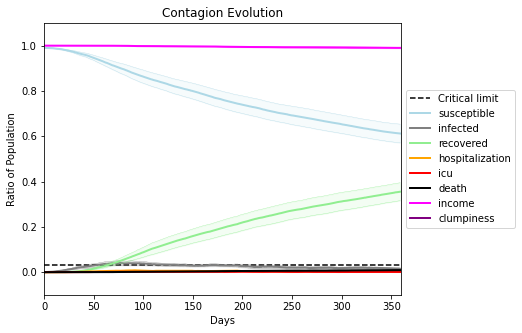

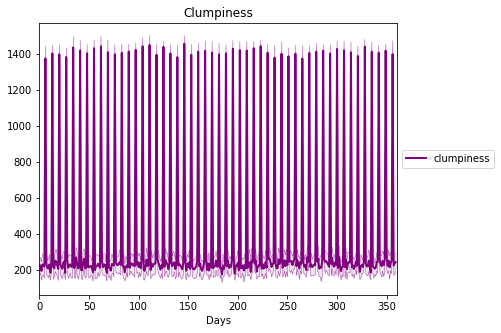

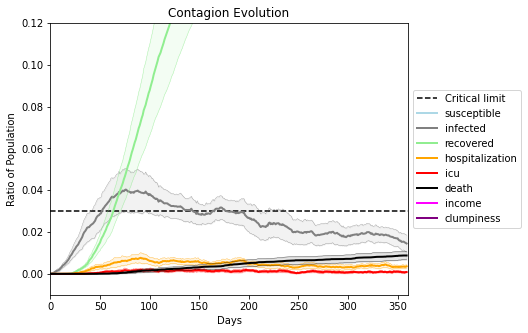

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2324, 9901, 7002, 359, 6132, 9967, 6322, 8311, 6447, 8832, 7623, 44, 2311, 1670, 5042, 4550, 2784, 1965, 2556, 3374]
Average similarity between family members is 0.9377230170557078 at temperature -0.994
Average similarity between family and home is 0.9998663725357221 at temperature -1
Average similarity between students and their classroom is 0.8693383782345988 at temperature -0.994
Average classroom occupancy is 1.5879120879120878 and number classrooms is 182
Average similarity between workers is 0.8816870682583612 at temperature -0.994
Average office occupancy is 3.397905759162304 and number offices is 191
Average friend similarity for adults: 0.8462560491315343 for kids: 0.740358360764935
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5340421464903155
avg restaurant similarity 0.6601344442893906
avg restaurant similarity 0.5712500703644011
avg restaurant similarity 0.5958802281683317
avg restaurant similarity 0.5978167844590186
avg restaurant similarity 0.5833918312161677
avg restaurant similarity 0.5780443951053583
avg restaurant similarity 0.6038610092753005
avg restaurant similarity 0.614982987044673
avg restaurant similarity 0.5751655182574108
avg restaurant similarity 0.6077709507341855
avg restaurant similarity 0.6050585860308366
avg restaurant similarity 0.6037145079440647
avg restaurant similarity 0.5380647766568432
avg restaurant similarity 0.5594152120436934
avg restaurant similarity 0.5995628492476838
avg restaurant similarity 0.5464164132880079
avg restaurant similarity 0.6099808290782184
avg restaurant similarity 0.5766130965336529
avg restaurant similarity 0.5915751875152754
avg restaurant similarity 0.6151006927101037
avg restaurant similarity 0.573306655164546
avg restaura

avg restaurant similarity 0.5751802035010231
avg restaurant similarity 0.6048765233209938
avg restaurant similarity 0.563125022385761
avg restaurant similarity 0.5994136222593522
avg restaurant similarity 0.6398496168250852
avg restaurant similarity 0.6076098811182526
avg restaurant similarity 0.5292246668096336
avg restaurant similarity 0.5954529449827223
avg restaurant similarity 0.538505229317441
avg restaurant similarity 0.5840150743838057
avg restaurant similarity 0.6018402549942857
avg restaurant similarity 0.6043143447825585
avg restaurant similarity 0.6017723493616456
avg restaurant similarity 0.6214190107681316
avg restaurant similarity 0.6167416544373843
avg restaurant similarity 0.6225992910763127
avg restaurant similarity 0.6054047688946524
avg restaurant similarity 0.6053952540571883
avg restaurant similarity 0.6319161255594261
avg restaurant similarity 0.5020699474442816
avg restaurant similarity 0.5812652910126354
avg restaurant similarity 0.5785639146404711
avg restaura

Average similarity between workers is 0.8928742726186986 at temperature -0.994
Average office occupancy is 3.241206030150754 and number offices is 199
Average friend similarity for adults: 0.8449765248438765 for kids: 0.7350987063697496
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.5815691155006439
avg restaurant similarity 0.603405176969097
avg restaurant similarity 0.5855815107437687
avg restaurant similarity 0.5546440022770435
avg restaurant similarity 0.5481794305501246
avg restaurant similarity 0.6288417740541736
avg restaurant similarity 0.6262556962601997
avg restaurant similarity 0.6050595062408997
avg restaurant similarity 0.6039617564382258
avg restaurant similarity 0.6227052610516222
avg restaurant similarity 0.6032912585753312
avg restaurant similarity 0.5748096824622906
avg restaurant similarity 0.6160190327748991
avg restaurant similarity 0.632395107138325
avg restaurant similarity 0.5768761801041119
avg restaurant similarity 0.5563971268440604
avg restaurant similarity 0.5614443048577842
avg restaurant similarity 0.6368914170915454
avg restaurant similarity 0.5515394797183223
avg restaurant similarity 0.5695023464502893
avg restaurant similarity 0.6078591486052325
avg restaurant similarity 0.574743478943703
avg restauran

avg restaurant similarity 0.6352444752278537
avg restaurant similarity 0.5699795015165952
avg restaurant similarity 0.5624512272441209
avg restaurant similarity 0.6069340387116416
avg restaurant similarity 0.5635317527084692
avg restaurant similarity 0.6216070922335664
avg restaurant similarity 0.5358501182879672
avg restaurant similarity 0.6071027867154725
avg restaurant similarity 0.5911093926950203
avg restaurant similarity 0.5829554487128807
avg restaurant similarity 0.5735408717935601
avg restaurant similarity 0.5834311001740877
avg restaurant similarity 0.5831637868857219
avg restaurant similarity 0.5659935430841777
avg restaurant similarity 0.6357869432389657
avg restaurant similarity 0.5726300821593245
avg restaurant similarity 0.6161145997884874
avg restaurant similarity 0.6260876916414815
avg restaurant similarity 0.5697689116589688
avg restaurant similarity 0.611692733173978
avg restaurant similarity 0.6451231973225425
avg restaurant similarity 0.6349727671916247
avg restaur

Average similarity between workers is 0.8905540721140787 at temperature -0.994
Average office occupancy is 3.4030612244897958 and number offices is 196
Average friend similarity for adults: 0.8513888751070299 for kids: 0.7165318555157069
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5384433583911359
avg restaurant similarity 0.5582194377974665
avg restaurant similarity 0.5435630685947418
avg restaurant similarity 0.4965564891612523
avg restaurant similarity 0.5067078544885476
avg restaurant similarity 0.5543605458129014
avg restaurant similarity 0.5527046830720463
avg restaurant similarity 0.5914361456928697
avg restaurant similarity 0.5578460384988283
avg restaurant similarity 0.568507667138636
avg restaurant similarity 0.5480381608372966
avg restaurant similarity 0.556977313504386
avg restaurant similarity 0.5513400934049753
avg restaurant similarity 0.5662052999903786
avg restaurant similarity 0.5147039257170333
avg restaurant similarity 0.4989739349938959
avg restaurant similarity 0.5397866397482208
avg restaurant similarity 0.5221550801109203
avg restaurant similarity 0.5117119758619234
avg restaurant similarity 0.5130597321067129
avg restaurant similarity 0.5714818662418003
avg restaurant similarity 0.5692343770967618
avg restaura

avg restaurant similarity 0.5725705686173062
avg restaurant similarity 0.5486821714275237
avg restaurant similarity 0.5610958235826391
avg restaurant similarity 0.583087227588994
avg restaurant similarity 0.5561800480759924
avg restaurant similarity 0.5461038085838947
avg restaurant similarity 0.5478345644945158
avg restaurant similarity 0.5766943955886069
avg restaurant similarity 0.5167513380373582
avg restaurant similarity 0.5307820381307969
avg restaurant similarity 0.5377794289087019
avg restaurant similarity 0.5473460167204477
avg restaurant similarity 0.5349219610411918
avg restaurant similarity 0.5759575178252804
avg restaurant similarity 0.512424597971552
avg restaurant similarity 0.5514780761938151
avg restaurant similarity 0.5498291317632905
avg restaurant similarity 0.5464392701423767
avg restaurant similarity 0.4889223830199137
avg restaurant similarity 0.5189873438787871
avg restaurant similarity 0.475699230038957
avg restaurant similarity 0.5385183686083577
avg restauran

Average similarity between workers is 0.8963911257297309 at temperature -0.994
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.8562019656743344 for kids: 0.7413478049137299
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people all

avg restaurant similarity 0.5543407332820725
avg restaurant similarity 0.6024426692173342
avg restaurant similarity 0.5922248277701652
avg restaurant similarity 0.6237871484149461
avg restaurant similarity 0.5341502726206474
avg restaurant similarity 0.6306365556968124
avg restaurant similarity 0.5727481703488345
avg restaurant similarity 0.5744894905845294
avg restaurant similarity 0.5940593143773336
avg restaurant similarity 0.5833347974489346
avg restaurant similarity 0.5835699897859793
avg restaurant similarity 0.6373855182592404
avg restaurant similarity 0.5930744749617243
avg restaurant similarity 0.5722885777170356
avg restaurant similarity 0.5464393044681579
avg restaurant similarity 0.6008007626689367
avg restaurant similarity 0.5896884245003855
avg restaurant similarity 0.6039840965392598
avg restaurant similarity 0.5606177293722833
avg restaurant similarity 0.5886959681684512
avg restaurant similarity 0.5901170945162277
avg restaurant similarity 0.6477071860971229
avg restau

avg restaurant similarity 0.5771824628683683
avg restaurant similarity 0.5719730082274872
avg restaurant similarity 0.6025406022462284
avg restaurant similarity 0.6066855003975841
avg restaurant similarity 0.6088609738568604
avg restaurant similarity 0.5478167738791937
avg restaurant similarity 0.5613950168089363
avg restaurant similarity 0.5809846681342237
avg restaurant similarity 0.5396978855762445
avg restaurant similarity 0.6116948521428994
avg restaurant similarity 0.5366168522089175
avg restaurant similarity 0.5500701645634166
avg restaurant similarity 0.5949465612329693
avg restaurant similarity 0.5570744146948486
avg restaurant similarity 0.5156748582220375
avg restaurant similarity 0.5881390590745227
avg restaurant similarity 0.5696901769147387
avg restaurant similarity 0.5626529579998549
avg restaurant similarity 0.5406960422740418
avg restaurant similarity 0.5594376490966126
avg restaurant similarity 0.5587373435359554
avg restaurant similarity 0.5979272220352329
avg restau

Average similarity between workers is 0.8792415779011299 at temperature -0.994
Average office occupancy is 3.5668449197860963 and number offices is 187
Average friend similarity for adults: 0.8529785475167417 for kids: 0.721898417203585
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5757895541221107
avg restaurant similarity 0.5831843842562927
avg restaurant similarity 0.6064615405413727
avg restaurant similarity 0.5902398965871946
avg restaurant similarity 0.5929037658517899
avg restaurant similarity 0.5994387332471136
avg restaurant similarity 0.5445413499224451
avg restaurant similarity 0.6108346983104482
avg restaurant similarity 0.6041523782193425
avg restaurant similarity 0.5756402560632666
avg restaurant similarity 0.5658807022268582
avg restaurant similarity 0.6022175153297549
avg restaurant similarity 0.5075879844970026
avg restaurant similarity 0.577044064758491
avg restaurant similarity 0.6128347528072047
avg restaurant similarity 0.6014674940260293
avg restaurant similarity 0.6005422898620127
avg restaurant similarity 0.5983277101247464
avg restaurant similarity 0.5922997566099413
avg restaurant similarity 0.6072026501301042
avg restaurant similarity 0.5671661736565042
avg restaurant similarity 0.568099372713803
avg restaura

avg restaurant similarity 0.5821080874281569
avg restaurant similarity 0.5340409996252204
avg restaurant similarity 0.5518905716257699
avg restaurant similarity 0.5805554534396856
avg restaurant similarity 0.5875291431713207
avg restaurant similarity 0.612266114066194
avg restaurant similarity 0.5717338928814948
avg restaurant similarity 0.5372765939000206
avg restaurant similarity 0.5765878438826268
avg restaurant similarity 0.5887605534525202
avg restaurant similarity 0.5101943196939339
avg restaurant similarity 0.62630480804288
avg restaurant similarity 0.6237866798991241
avg restaurant similarity 0.638158367408748
avg restaurant similarity 0.6273964060891747
avg restaurant similarity 0.582545958363941
avg restaurant similarity 0.5314645394067358
avg restaurant similarity 0.5041001632486009
avg restaurant similarity 0.6048090689790805
avg restaurant similarity 0.5350051781915441
avg restaurant similarity 0.6306525603621773
avg restaurant similarity 0.5741925822955305
avg restaurant 

Average similarity between workers is 0.8818350489549974 at temperature -0.994
Average office occupancy is 3.3979591836734695 and number offices is 196
Average friend similarity for adults: 0.8522260820882751 for kids: 0.7206951756564488
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.5596051725447129
avg restaurant similarity 0.5563692929281813
avg restaurant similarity 0.540746906639071
avg restaurant similarity 0.5850647226892406
avg restaurant similarity 0.5390408904034952
avg restaurant similarity 0.5169443503561504
avg restaurant similarity 0.5093698163974855
avg restaurant similarity 0.5449987843483707
avg restaurant similarity 0.5233575617640588
avg restaurant similarity 0.5365550237998302
avg restaurant similarity 0.5805025952277355
avg restaurant similarity 0.5655307718927576
avg restaurant similarity 0.5352844385668066
avg restaurant similarity 0.574117948389392
avg restaurant similarity 0.5670082193822531
avg restaurant similarity 0.5359943248736777
avg restaurant similarity 0.5423680718586097
avg restaurant similarity 0.5518292017173072
avg restaurant similarity 0.5085839002022324
avg restaurant similarity 0.5318520475471677
avg restaurant similarity 0.5510795155873593
avg restaurant similarity 0.5139325203949755
avg restaura

avg restaurant similarity 0.5335127579310486
avg restaurant similarity 0.589001816757882
avg restaurant similarity 0.5262062689035314
avg restaurant similarity 0.5689541233150605
avg restaurant similarity 0.5395591366526584
avg restaurant similarity 0.5273712685984973
avg restaurant similarity 0.560140585356411
avg restaurant similarity 0.5450217305674888
avg restaurant similarity 0.5424574998593144
avg restaurant similarity 0.5367210611378574
avg restaurant similarity 0.6019159422488635
avg restaurant similarity 0.5440267480883862
avg restaurant similarity 0.5447436850327735
avg restaurant similarity 0.5149483692708992
avg restaurant similarity 0.5496317474389639
avg restaurant similarity 0.5557849781611706
avg restaurant similarity 0.5699268411567308
avg restaurant similarity 0.4989945537979645
avg restaurant similarity 0.5963738747497294
avg restaurant similarity 0.580368933180103
avg restaurant similarity 0.5242576004119975
avg restaurant similarity 0.5853649567358581
avg restauran

Average similarity between workers is 0.8807445340606319 at temperature -0.994
Average office occupancy is 3.4093264248704664 and number offices is 193
Average friend similarity for adults: 0.8546068144730377 for kids: 0.7340217538873048
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5197461732932086
avg restaurant similarity 0.5392788211088686
avg restaurant similarity 0.59018369753987
avg restaurant similarity 0.5698225755756584
avg restaurant similarity 0.5816430851147543
avg restaurant similarity 0.5514504801658101
avg restaurant similarity 0.5484948291474956
avg restaurant similarity 0.5302940693321627
avg restaurant similarity 0.5894927816609785
avg restaurant similarity 0.5898761859969889
avg restaurant similarity 0.5458431714799801
avg restaurant similarity 0.5726241312814775
avg restaurant similarity 0.5673341349192664
avg restaurant similarity 0.5753251315393215
avg restaurant similarity 0.5593451684572648
avg restaurant similarity 0.5726957635427751
avg restaurant similarity 0.6077647294791556
avg restaurant similarity 0.5867925836244724
avg restaurant similarity 0.5384260196603302
avg restaurant similarity 0.5998606789234905
avg restaurant similarity 0.5909023548096141
avg restaurant similarity 0.5087824315809116
avg restaura

avg restaurant similarity 0.5992560317831841
avg restaurant similarity 0.5846108598618438
avg restaurant similarity 0.5626061471785834
avg restaurant similarity 0.5679777788663501
avg restaurant similarity 0.5680008279300401
avg restaurant similarity 0.5767239177502048
avg restaurant similarity 0.56338225023319
avg restaurant similarity 0.5075393771840523
avg restaurant similarity 0.6101010452004227
avg restaurant similarity 0.5543798901305439
avg restaurant similarity 0.5355565734188005
avg restaurant similarity 0.5378309305763657
avg restaurant similarity 0.5449331640775724
avg restaurant similarity 0.5433522192784117
avg restaurant similarity 0.5908315695939446
avg restaurant similarity 0.5723720756745649
avg restaurant similarity 0.5659123869691273
avg restaurant similarity 0.5476778538169501
avg restaurant similarity 0.6218942285265033
avg restaurant similarity 0.5393700664564705
avg restaurant similarity 0.584299828842655
avg restaurant similarity 0.5368585992635008
avg restauran

Average similarity between workers is 0.8926458198433127 at temperature -0.994
Average office occupancy is 3.3418367346938775 and number offices is 196
Average friend similarity for adults: 0.854821028252215 for kids: 0.7413821280477361
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5896979810628046
avg restaurant similarity 0.5580705516213205
avg restaurant similarity 0.5878555067546062
avg restaurant similarity 0.6318344052873384
avg restaurant similarity 0.587122888329277
avg restaurant similarity 0.5820074795178765
avg restaurant similarity 0.612271651583026
avg restaurant similarity 0.590511599609793
avg restaurant similarity 0.6061495891090084
avg restaurant similarity 0.5912264249845441
avg restaurant similarity 0.5938474165701089
avg restaurant similarity 0.573447431267074
avg restaurant similarity 0.6407987376870935
avg restaurant similarity 0.6186829039718528
avg restaurant similarity 0.5710735747576956
avg restaurant similarity 0.6272773612086706
avg restaurant similarity 0.5631741060994678
avg restaurant similarity 0.6104097459950724
avg restaurant similarity 0.62384316176172
avg restaurant similarity 0.5754037312755752
avg restaurant similarity 0.6137698069112982
avg restaurant similarity 0.595461557038728
avg restaurant si

avg restaurant similarity 0.6115418509642838
avg restaurant similarity 0.5864106010000903
avg restaurant similarity 0.5969081993818911
avg restaurant similarity 0.6102327856013959
avg restaurant similarity 0.6163869975219629
avg restaurant similarity 0.5600773231369993
avg restaurant similarity 0.6104247107205316
avg restaurant similarity 0.5909114786407021
avg restaurant similarity 0.5892746610249159
avg restaurant similarity 0.6021668217993621
avg restaurant similarity 0.5896256952353296
avg restaurant similarity 0.5837259483176088
avg restaurant similarity 0.5639551749967651
avg restaurant similarity 0.6467272996188171
avg restaurant similarity 0.5790708086790266
avg restaurant similarity 0.5932761405697083
avg restaurant similarity 0.6280697153831651
avg restaurant similarity 0.6387034531370605
avg restaurant similarity 0.6315396987764297
avg restaurant similarity 0.6006067938259728
avg restaurant similarity 0.5389425740210383
avg restaurant similarity 0.6276172397625618
avg restau

Average similarity between workers is 0.8807920825293635 at temperature -0.994
Average office occupancy is 3.4368421052631577 and number offices is 190
Average friend similarity for adults: 0.8461872821064139 for kids: 0.7277837240192618
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5952111507786891
avg restaurant similarity 0.5411185200233809
avg restaurant similarity 0.5953710585313443
avg restaurant similarity 0.5663630409350723
avg restaurant similarity 0.5738156362252861
avg restaurant similarity 0.5584519499699941
avg restaurant similarity 0.5296888762331712
avg restaurant similarity 0.6219092348317637
avg restaurant similarity 0.5646256377086237
avg restaurant similarity 0.4985312398607346
avg restaurant similarity 0.5413884752033671
avg restaurant similarity 0.523557342313274
avg restaurant similarity 0.5720363113656636
avg restaurant similarity 0.5547632902858709
avg restaurant similarity 0.623644219118636
avg restaurant similarity 0.542047450356076
avg restaurant similarity 0.6244596533050796
avg restaurant similarity 0.5692950652976584
avg restaurant similarity 0.518587014462838
avg restaurant similarity 0.5247434829779268
avg restaurant similarity 0.5798422183923336
avg restaurant similarity 0.5930450120315456
avg restaurant

avg restaurant similarity 0.5318585592477981
avg restaurant similarity 0.5957210906490811
avg restaurant similarity 0.521119127301774
avg restaurant similarity 0.5040361079743041
avg restaurant similarity 0.48857521599621156
avg restaurant similarity 0.5456842240822288
avg restaurant similarity 0.5767093909212565
avg restaurant similarity 0.610432091445185
avg restaurant similarity 0.5453076662443432
avg restaurant similarity 0.5623378299726355
avg restaurant similarity 0.5673354962317749
avg restaurant similarity 0.576370024938254
avg restaurant similarity 0.4738763544678588
avg restaurant similarity 0.5860389322715704
avg restaurant similarity 0.6426940734467158
avg restaurant similarity 0.5677885667947418
avg restaurant similarity 0.5496106511881733
avg restaurant similarity 0.6120985996631731
avg restaurant similarity 0.5588139235423191
avg restaurant similarity 0.5825883058372046
avg restaurant similarity 0.5583525610715909
avg restaurant similarity 0.5619176465084874
avg restaura

Average similarity between workers is 0.8968927211310971 at temperature -0.994
Average office occupancy is 3.4123711340206184 and number offices is 194
Average friend similarity for adults: 0.8460913306166646 for kids: 0.7332102694367045
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5430797526676947
avg restaurant similarity 0.5458982993953215
avg restaurant similarity 0.5784390589430923
avg restaurant similarity 0.539919879647447
avg restaurant similarity 0.576641198492164
avg restaurant similarity 0.5964847655207474
avg restaurant similarity 0.5145802205845516
avg restaurant similarity 0.5766026034154352
avg restaurant similarity 0.5710617965323271
avg restaurant similarity 0.5335997027060589
avg restaurant similarity 0.5264768644206523
avg restaurant similarity 0.5910567712392216
avg restaurant similarity 0.56540347058725
avg restaurant similarity 0.5398413614734118
avg restaurant similarity 0.5505677212204644
avg restaurant similarity 0.5435468528536685
avg restaurant similarity 0.5703677061594168
avg restaurant similarity 0.5299641575502997
avg restaurant similarity 0.6324737530384594
avg restaurant similarity 0.544302642049587
avg restaurant similarity 0.5763709868571382
avg restaurant similarity 0.5334652427260308
avg restaurant 

avg restaurant similarity 0.6027709046796988
avg restaurant similarity 0.5490514371134864
avg restaurant similarity 0.5607880066994995
avg restaurant similarity 0.5603647889377115
avg restaurant similarity 0.6073414122598069
avg restaurant similarity 0.5767389093714319
avg restaurant similarity 0.5736235106352829
avg restaurant similarity 0.5585807802522949
avg restaurant similarity 0.5890591485786105
avg restaurant similarity 0.607317694393389
avg restaurant similarity 0.5618512662075213
avg restaurant similarity 0.563363960726946
avg restaurant similarity 0.5736028726790633
avg restaurant similarity 0.5389637216688277
avg restaurant similarity 0.5918309375512236
avg restaurant similarity 0.5386433234641991
avg restaurant similarity 0.5443453624775052
avg restaurant similarity 0.5446434608784255
avg restaurant similarity 0.6045082292188437
avg restaurant similarity 0.5537189325613517
avg restaurant similarity 0.5666968750546453
avg restaurant similarity 0.5709372637581508
avg restaura

Average similarity between workers is 0.8772518080696864 at temperature -0.994
Average office occupancy is 3.3089005235602094 and number offices is 191
Average friend similarity for adults: 0.8457540104265748 for kids: 0.7313143009310571
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5366012963231815
avg restaurant similarity 0.5710802040446032
avg restaurant similarity 0.5533925900445079
avg restaurant similarity 0.5457362229583163
avg restaurant similarity 0.5812326057977922
avg restaurant similarity 0.5653701967736429
avg restaurant similarity 0.587035543646837
avg restaurant similarity 0.5476298775603677
avg restaurant similarity 0.5637991484593824
avg restaurant similarity 0.5991299122078368
avg restaurant similarity 0.5789555617430829
avg restaurant similarity 0.5440218862105554
avg restaurant similarity 0.5774861730997677
avg restaurant similarity 0.5982506896031436
avg restaurant similarity 0.6225636355916836
avg restaurant similarity 0.5458468322341206
avg restaurant similarity 0.5682972097824701
avg restaurant similarity 0.5666747266087727
avg restaurant similarity 0.5607365853560046
avg restaurant similarity 0.5735985846548023
avg restaurant similarity 0.5485395231147728
avg restaurant similarity 0.5246508195335373
avg restaur

avg restaurant similarity 0.5616406303491599
avg restaurant similarity 0.5272517030685085
avg restaurant similarity 0.5309143127789294
avg restaurant similarity 0.5588231030591165
avg restaurant similarity 0.5715951484243794
avg restaurant similarity 0.5103290439177521
avg restaurant similarity 0.560720656581134
avg restaurant similarity 0.5343328105224527
avg restaurant similarity 0.5149694929160847
avg restaurant similarity 0.5729503727045357
avg restaurant similarity 0.5354541029080654
avg restaurant similarity 0.5875301939167287
avg restaurant similarity 0.5719801348131166
avg restaurant similarity 0.5588099989168117
avg restaurant similarity 0.5125076825689313
avg restaurant similarity 0.5733406864551747
avg restaurant similarity 0.5774528061178826
avg restaurant similarity 0.5273510155233961
avg restaurant similarity 0.5348867624095021
avg restaurant similarity 0.5352652916053032
avg restaurant similarity 0.5221606862940145
avg restaurant similarity 0.5739945378944648
avg restaur

Average similarity between workers is 0.8995371828605087 at temperature -0.994
Average office occupancy is 3.318407960199005 and number offices is 201
Average friend similarity for adults: 0.8524505779436758 for kids: 0.7320763417345814
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5950396374051704
avg restaurant similarity 0.6034967421127435
avg restaurant similarity 0.5750221422813119
avg restaurant similarity 0.5846479968831426
avg restaurant similarity 0.5724853324912926
avg restaurant similarity 0.6053047403002588
avg restaurant similarity 0.5692957556565679
avg restaurant similarity 0.5808211489001237
avg restaurant similarity 0.5983904475328041
avg restaurant similarity 0.5772203003679577
avg restaurant similarity 0.5181361350410263
avg restaurant similarity 0.550253869514371
avg restaurant similarity 0.5710272897783375
avg restaurant similarity 0.5797966543486381
avg restaurant similarity 0.5309274065885057
avg restaurant similarity 0.555771324453494
avg restaurant similarity 0.5642377649874508
avg restaurant similarity 0.57094022092027
avg restaurant similarity 0.5557615908615209
avg restaurant similarity 0.5525740420222086
avg restaurant similarity 0.5744057403174173
avg restaurant similarity 0.5635041189834773
avg restaurant

avg restaurant similarity 0.5753334549441066
avg restaurant similarity 0.5799072925542428
avg restaurant similarity 0.5798738276164567
avg restaurant similarity 0.6396929394043417
avg restaurant similarity 0.5759765565500825
avg restaurant similarity 0.6007073924127714
avg restaurant similarity 0.5900721371774829
avg restaurant similarity 0.5313038197234575
avg restaurant similarity 0.5541814092855211
avg restaurant similarity 0.5300294600825728
avg restaurant similarity 0.5660100341431209
avg restaurant similarity 0.5783534494089123
avg restaurant similarity 0.5694002230060955
avg restaurant similarity 0.5667331013250341
avg restaurant similarity 0.5353040460252634
avg restaurant similarity 0.562950074798421
avg restaurant similarity 0.5243476879823357
avg restaurant similarity 0.583345546773529
avg restaurant similarity 0.5806319102455313
avg restaurant similarity 0.5661101974180223
avg restaurant similarity 0.5906615980516683
avg restaurant similarity 0.5934554391471213
avg restaura

Average similarity between workers is 0.8831035560722063 at temperature -0.994
Average office occupancy is 3.3419689119170983 and number offices is 193
Average friend similarity for adults: 0.8372595219611009 for kids: 0.7246961816416346
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5667012994771106
avg restaurant similarity 0.5494794606555276
avg restaurant similarity 0.5379076101613923
avg restaurant similarity 0.5382039407876928
avg restaurant similarity 0.49554389904823887
avg restaurant similarity 0.4983794476827147
avg restaurant similarity 0.527115541332999
avg restaurant similarity 0.5228273228703476
avg restaurant similarity 0.57071127800921
avg restaurant similarity 0.5486028999060362
avg restaurant similarity 0.5990754490326138
avg restaurant similarity 0.5636112876748957
avg restaurant similarity 0.5408653616291575
avg restaurant similarity 0.5276949332207592
avg restaurant similarity 0.5858454426170014
avg restaurant similarity 0.5689845878637232
avg restaurant similarity 0.5345715864567437
avg restaurant similarity 0.5889935042116606
avg restaurant similarity 0.4870626999221043
avg restaurant similarity 0.6171140200861893
avg restaurant similarity 0.5329112676723066
avg restaurant similarity 0.5622835057601833
avg restaura

avg restaurant similarity 0.6136927901973807
avg restaurant similarity 0.5663824689607851
avg restaurant similarity 0.5095909656754422
avg restaurant similarity 0.5429546403596324
avg restaurant similarity 0.5593926777006213
avg restaurant similarity 0.5506928141889047
avg restaurant similarity 0.560767174883064
avg restaurant similarity 0.5545610882231942
avg restaurant similarity 0.5325985014753524
avg restaurant similarity 0.5850604035466193
avg restaurant similarity 0.5467911462964096
avg restaurant similarity 0.5651168561969478
avg restaurant similarity 0.5203515508257978
avg restaurant similarity 0.5417973163096667
avg restaurant similarity 0.5487135034098677
avg restaurant similarity 0.5867601016046387
avg restaurant similarity 0.5244929906754003
avg restaurant similarity 0.5790125399858564
avg restaurant similarity 0.5022733275306932
avg restaurant similarity 0.5293112262954188
avg restaurant similarity 0.5602947396001353
avg restaurant similarity 0.5490077008711669
avg restaur

Average similarity between workers is 0.9092109202326039 at temperature -0.994
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.8547639107575531 for kids: 0.7205202807946856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5909280386389544
avg restaurant similarity 0.562283798068469
avg restaurant similarity 0.55148797533927
avg restaurant similarity 0.5554756911904326
avg restaurant similarity 0.5315457386410454
avg restaurant similarity 0.6198839333011327
avg restaurant similarity 0.5538540317070118
avg restaurant similarity 0.5492750499917164
avg restaurant similarity 0.5554545356811802
avg restaurant similarity 0.5728726064518593
avg restaurant similarity 0.5922543684762777
avg restaurant similarity 0.6104328674477686
avg restaurant similarity 0.6211800535549458
avg restaurant similarity 0.600413047246389
avg restaurant similarity 0.5650919912980972
avg restaurant similarity 0.5689309293021833
avg restaurant similarity 0.5510710139757568
avg restaurant similarity 0.6246686953602844
avg restaurant similarity 0.6036615392124465
avg restaurant similarity 0.5527794660428926
avg restaurant similarity 0.535864522785501
avg restaurant similarity 0.5823404195562476
avg restaurant 

avg restaurant similarity 0.571963805207917
avg restaurant similarity 0.5908529654287087
avg restaurant similarity 0.609730470440629
avg restaurant similarity 0.5824750630796804
avg restaurant similarity 0.5953290671095187
avg restaurant similarity 0.6156668407851943
avg restaurant similarity 0.5746613633644121
avg restaurant similarity 0.5492969067042324
avg restaurant similarity 0.56811450628584
avg restaurant similarity 0.5627675051075477
avg restaurant similarity 0.6575020505197252
avg restaurant similarity 0.6165668730563203
avg restaurant similarity 0.5328817582362657
avg restaurant similarity 0.587558066724194
avg restaurant similarity 0.6031344997981036
avg restaurant similarity 0.6173317561612897
avg restaurant similarity 0.5983178158630301
avg restaurant similarity 0.5269074652218063
avg restaurant similarity 0.5761501417001236
avg restaurant similarity 0.5689453914820851
avg restaurant similarity 0.5256156533073195
avg restaurant similarity 0.6006483625494374
avg restaurant 

Average similarity between workers is 0.89394053928723 at temperature -0.994
Average office occupancy is 3.31 and number offices is 200
Average friend similarity for adults: 0.8513990504632931 for kids: 0.7206207210643962
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocate

avg restaurant similarity 0.5849955575939763
avg restaurant similarity 0.6191935884907708
avg restaurant similarity 0.5584183706037651
avg restaurant similarity 0.5784689008249998
avg restaurant similarity 0.5981162576130775
avg restaurant similarity 0.5134889899538245
avg restaurant similarity 0.6611612416324248
avg restaurant similarity 0.5640335730298446
avg restaurant similarity 0.5546978706456717
avg restaurant similarity 0.5729902747937893
avg restaurant similarity 0.5751912112694577
avg restaurant similarity 0.5674826257427377
avg restaurant similarity 0.5562804199043095
avg restaurant similarity 0.5741748642367855
avg restaurant similarity 0.5980228967292047
avg restaurant similarity 0.5508459223572264
avg restaurant similarity 0.5538933242565629
avg restaurant similarity 0.6316623961535874
avg restaurant similarity 0.550967566644004
avg restaurant similarity 0.5577250223979494
avg restaurant similarity 0.5590878167824395
avg restaurant similarity 0.5985450469887749
avg restaur

avg restaurant similarity 0.6048017262018405
avg restaurant similarity 0.6041634107676433
avg restaurant similarity 0.5723252404565139
avg restaurant similarity 0.5792278692286108
avg restaurant similarity 0.5138875366732357
avg restaurant similarity 0.5889265655376265
avg restaurant similarity 0.6149759674580019
avg restaurant similarity 0.567353979014152
avg restaurant similarity 0.5647604350161418
avg restaurant similarity 0.5830231072706782
avg restaurant similarity 0.6245745207994978
avg restaurant similarity 0.5731378806201047
avg restaurant similarity 0.617331044691334
avg restaurant similarity 0.49949971834152324
avg restaurant similarity 0.646064729602491
avg restaurant similarity 0.6088642014512085
avg restaurant similarity 0.5629078128856413
avg restaurant similarity 0.611081330647682
avg restaurant similarity 0.5907985083097235
avg restaurant similarity 0.5737732200303703
avg restaurant similarity 0.637589294112987
avg restaurant similarity 0.5897216797438108
avg restaurant

Average similarity between workers is 0.8871486176704686 at temperature -0.994
Average office occupancy is 3.5309278350515463 and number offices is 194
Average friend similarity for adults: 0.8557966209537607 for kids: 0.7266822912838647
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.547349601537215
avg restaurant similarity 0.6011407884566944
avg restaurant similarity 0.6247807160843505
avg restaurant similarity 0.5853310151755189
avg restaurant similarity 0.5819770169083045
avg restaurant similarity 0.5544007325085896
avg restaurant similarity 0.619219462740354
avg restaurant similarity 0.6119415322224845
avg restaurant similarity 0.5608763027765402
avg restaurant similarity 0.5920698042846306
avg restaurant similarity 0.633396066055827
avg restaurant similarity 0.5966913401965961
avg restaurant similarity 0.5473052444313423
avg restaurant similarity 0.5695243522438557
avg restaurant similarity 0.5685708214865581
avg restaurant similarity 0.624221989679887
avg restaurant similarity 0.6140413035004304
avg restaurant similarity 0.6736617398379776
avg restaurant similarity 0.5734583211277048
avg restaurant similarity 0.5821638476158777
avg restaurant similarity 0.5975973761647286
avg restaurant similarity 0.5953667906084001
avg restaurant

avg restaurant similarity 0.5912284887810696
avg restaurant similarity 0.6000749653932859
avg restaurant similarity 0.5709742310182017
avg restaurant similarity 0.6426523733293326
avg restaurant similarity 0.6347514675058058
avg restaurant similarity 0.5784340548841291
avg restaurant similarity 0.6529702922958863
avg restaurant similarity 0.5220207250862308
avg restaurant similarity 0.6049267941319698
avg restaurant similarity 0.585221002405454
avg restaurant similarity 0.6238857503101529
avg restaurant similarity 0.5263299934099223
avg restaurant similarity 0.6642262342002418
avg restaurant similarity 0.6032852191945817
avg restaurant similarity 0.5503793661664326
avg restaurant similarity 0.5678637632834294
avg restaurant similarity 0.5643659094439274
avg restaurant similarity 0.5878435843288102
avg restaurant similarity 0.6306460889593312
avg restaurant similarity 0.5688822179573619
avg restaurant similarity 0.5746054691165632
avg restaurant similarity 0.5642715506919652
avg restaur

Average similarity between workers is 0.8854531933125043 at temperature -0.994
Average office occupancy is 3.38860103626943 and number offices is 193
Average friend similarity for adults: 0.8519001329573289 for kids: 0.7285238006639283
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7

avg restaurant similarity 0.5797511010433436
avg restaurant similarity 0.6166408912823249
avg restaurant similarity 0.5765333952475381
avg restaurant similarity 0.5604443146261493
avg restaurant similarity 0.5645281976736808
avg restaurant similarity 0.5924496334572034
avg restaurant similarity 0.6286272282540902
avg restaurant similarity 0.5747803635094818
avg restaurant similarity 0.5861675701231378
avg restaurant similarity 0.5732026623703713
avg restaurant similarity 0.5832424228515368
avg restaurant similarity 0.5856716630598151
avg restaurant similarity 0.5572982067386945
avg restaurant similarity 0.5573880725274101
avg restaurant similarity 0.560389474958067
avg restaurant similarity 0.6081514583854546
avg restaurant similarity 0.5814060538506991
avg restaurant similarity 0.5476746077599249
avg restaurant similarity 0.5909472713800444
avg restaurant similarity 0.6023111182406473
avg restaurant similarity 0.588409836394056
avg restaurant similarity 0.5872457502785767
avg restaura

avg restaurant similarity 0.5616232129695529
avg restaurant similarity 0.5683036117328174
avg restaurant similarity 0.5559385450852858
avg restaurant similarity 0.5731107096610001
avg restaurant similarity 0.5721461966717875
avg restaurant similarity 0.5706376075674688
avg restaurant similarity 0.5579086326171083
avg restaurant similarity 0.5982326781304234
avg restaurant similarity 0.5672501967651176
avg restaurant similarity 0.6013612358452002
avg restaurant similarity 0.5631106811572187
avg restaurant similarity 0.5921906162170265
avg restaurant similarity 0.5729985401515629
avg restaurant similarity 0.5705992717545798
avg restaurant similarity 0.5474993945469766
avg restaurant similarity 0.5819002637599181
avg restaurant similarity 0.5689677538181522
avg restaurant similarity 0.5387486933963505
avg restaurant similarity 0.5737323365040193
avg restaurant similarity 0.5669795881067423
avg restaurant similarity 0.5963845586618277
avg restaurant similarity 0.6044915411945557
avg restau

Average similarity between workers is 0.8909404123608924 at temperature -0.994
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.8426923404157715 for kids: 0.7224265013011381
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5826940082951674
avg restaurant similarity 0.5387023368574131
avg restaurant similarity 0.5475733474824831
avg restaurant similarity 0.551332429049808
avg restaurant similarity 0.5446742168160786
avg restaurant similarity 0.5069146673518857
avg restaurant similarity 0.5671291407913344
avg restaurant similarity 0.5809260873841345
avg restaurant similarity 0.591382664966318
avg restaurant similarity 0.5845166407685993
avg restaurant similarity 0.5037153529930016
avg restaurant similarity 0.5922861579190611
avg restaurant similarity 0.544723318367441
avg restaurant similarity 0.604782550391697
avg restaurant similarity 0.5352738180390499
avg restaurant similarity 0.6141379139981147
avg restaurant similarity 0.5431445735992321
avg restaurant similarity 0.5114581444336261
avg restaurant similarity 0.5543154006736434
avg restaurant similarity 0.5757635953333036
avg restaurant similarity 0.5493482121767809
avg restaurant similarity 0.5002927241378312
avg restaurant

avg restaurant similarity 0.4753456465682314
avg restaurant similarity 0.5817421990235689
avg restaurant similarity 0.560945936952272
avg restaurant similarity 0.559846000658954
avg restaurant similarity 0.5051362005929088
avg restaurant similarity 0.536052978422079
avg restaurant similarity 0.6140687163664837
avg restaurant similarity 0.5750043414770544
avg restaurant similarity 0.5545508921262369
avg restaurant similarity 0.5373487246146663
avg restaurant similarity 0.5560481003735844
avg restaurant similarity 0.5812582528638185
avg restaurant similarity 0.5217838292368847
avg restaurant similarity 0.4781421341960672
avg restaurant similarity 0.5316486993786151
avg restaurant similarity 0.5428402246596526
avg restaurant similarity 0.5941547004882444
avg restaurant similarity 0.5424794644777191
avg restaurant similarity 0.4978694776735812
avg restaurant similarity 0.5729431133110673
avg restaurant similarity 0.5931124484231362
avg restaurant similarity 0.5184262588577799
avg restauran

Average similarity between workers is 0.8919758238116975 at temperature -0.994
Average office occupancy is 3.1666666666666665 and number offices is 198
Average friend similarity for adults: 0.8474951642820238 for kids: 0.7361591402255254
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of

avg restaurant similarity 0.5768913996295643
avg restaurant similarity 0.587312723747396
avg restaurant similarity 0.5533880627922085
avg restaurant similarity 0.5882598417822246
avg restaurant similarity 0.5726451636301865
avg restaurant similarity 0.5615637809019317
avg restaurant similarity 0.5922750294875487
avg restaurant similarity 0.5666270054466053
avg restaurant similarity 0.5264981892989988
avg restaurant similarity 0.5655888962984829
avg restaurant similarity 0.5433878474751905
avg restaurant similarity 0.5191550054340099
avg restaurant similarity 0.6014932397744712
avg restaurant similarity 0.5564772406983459
avg restaurant similarity 0.5739084033658024
avg restaurant similarity 0.5506830932542169
avg restaurant similarity 0.5393547118895935
avg restaurant similarity 0.5904898625281857
avg restaurant similarity 0.6005245434551612
avg restaurant similarity 0.5474119427769905
avg restaurant similarity 0.5610769310493521
avg restaurant similarity 0.6045146591236054
avg restaur

avg restaurant similarity 0.5424072860483102
avg restaurant similarity 0.5419779935903485
avg restaurant similarity 0.5538274317580792
avg restaurant similarity 0.6121906988552563
avg restaurant similarity 0.6004102761592781
avg restaurant similarity 0.537522899301193
avg restaurant similarity 0.6045344494997624
avg restaurant similarity 0.5728218381844841
avg restaurant similarity 0.5520933328978465
avg restaurant similarity 0.555446852375247
avg restaurant similarity 0.5814965885981839
avg restaurant similarity 0.6091309625928661
avg restaurant similarity 0.5365263087999635
avg restaurant similarity 0.5807696049768839
avg restaurant similarity 0.5967870157182819
avg restaurant similarity 0.5921014750072545
avg restaurant similarity 0.6345868479773673
avg restaurant similarity 0.6237968295372897
avg restaurant similarity 0.5473310337179237
avg restaurant similarity 0.5397544248897213
avg restaurant similarity 0.5610851227401515
avg restaurant similarity 0.5357740454998934
avg restaura

Average similarity between workers is 0.8807265474488306 at temperature -0.994
Average office occupancy is 3.3316831683168315 and number offices is 202
Average friend similarity for adults: 0.8558343169535352 for kids: 0.7281946747938541
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5202593355731815
avg restaurant similarity 0.48004296329063123
avg restaurant similarity 0.5514512537524566
avg restaurant similarity 0.5567794735385421
avg restaurant similarity 0.563625251039579
avg restaurant similarity 0.5482444761792656
avg restaurant similarity 0.5916447778613222
avg restaurant similarity 0.571044311977718
avg restaurant similarity 0.5710654474493795
avg restaurant similarity 0.5543464879224858
avg restaurant similarity 0.5328849397353329
avg restaurant similarity 0.5615544513823774
avg restaurant similarity 0.5955943522031779
avg restaurant similarity 0.5156238850956131
avg restaurant similarity 0.4802291969683901
avg restaurant similarity 0.49583116951269446
avg restaurant similarity 0.5544210533123671
avg restaurant similarity 0.5711613121141745
avg restaurant similarity 0.5394523859156434
avg restaurant similarity 0.5623553190998982
avg restaurant similarity 0.628248039344082
avg restaurant similarity 0.5290729423180432
avg restaur

avg restaurant similarity 0.5664984911604002
avg restaurant similarity 0.5915453645981181
avg restaurant similarity 0.5221034652160406
avg restaurant similarity 0.5282281227704763
avg restaurant similarity 0.5310463034688195
avg restaurant similarity 0.6261926377610104
avg restaurant similarity 0.5428692290855921
avg restaurant similarity 0.5922789724435876
avg restaurant similarity 0.5622465990398314
avg restaurant similarity 0.5802858035569914
avg restaurant similarity 0.6129807621981143
avg restaurant similarity 0.5498438573712068
avg restaurant similarity 0.5920626080528213
avg restaurant similarity 0.5935278102501195
avg restaurant similarity 0.6096116251422373
avg restaurant similarity 0.6094909311377875
avg restaurant similarity 0.5684779841890374
avg restaurant similarity 0.5341159498739504
avg restaurant similarity 0.538331177671911
avg restaurant similarity 0.5547962481726157
avg restaurant similarity 0.6005261461203877
avg restaurant similarity 0.569445124810641
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

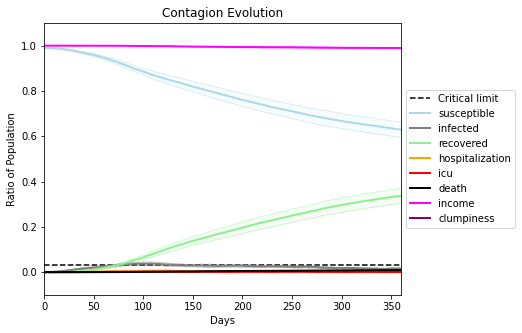

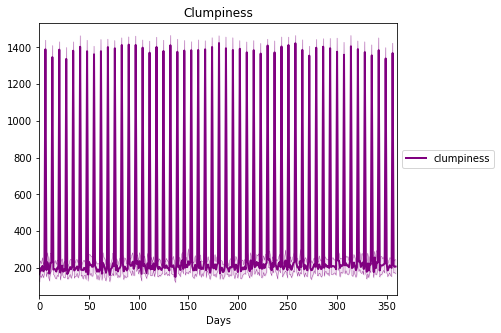

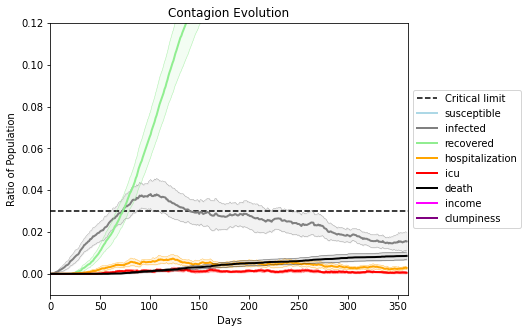

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5809, 6238, 200, 1361, 702, 8621, 5896, 1694, 9696, 1356, 562, 3386, 8793, 3273, 177, 7757, 4014, 156, 4848, 5328]
Average similarity between family members is 0.9277108001028501 at temperature -0.993
Average similarity between family and home is 0.9998597916851438 at temperature -1
Average similarity between students and their classroom is 0.8558551413475272 at temperature -0.993
Average classroom occupancy is 1.6923076923076923 and number classrooms is 182
Average similarity between workers is 0.8678926105125128 at temperature -0.993
Average office occupancy is 3.321243523316062 and number offices is 193
Average friend similarity for adults: 0.8371944226242405 for kids: 0.7360816434665375
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.6031118568435779
avg restaurant similarity 0.5171966779208109
avg restaurant similarity 0.5947693774841174
avg restaurant similarity 0.4892350401522783
avg restaurant similarity 0.5247736538153263
avg restaurant similarity 0.4852539173638546
avg restaurant similarity 0.5694221140573859
avg restaurant similarity 0.4659660754310389
avg restaurant similarity 0.5190378822454538
avg restaurant similarity 0.5387269958842084
avg restaurant similarity 0.5294675521298562
avg restaurant similarity 0.535771794859697
avg restaurant similarity 0.452529137190141
avg restaurant similarity 0.4871748302691321
avg restaurant similarity 0.49238537742485794
avg restaurant similarity 0.5098263062616466
avg restaurant similarity 0.4592916297443155
avg restaurant similarity 0.5748179505689823
avg restaurant similarity 0.5139139074705839
avg restaurant similarity 0.5335578472781112
avg restaurant similarity 0.5231403645975351
avg restaurant similarity 0.5456897945564255
avg restaur

avg restaurant similarity 0.4842716961037032
avg restaurant similarity 0.4971560178556346
avg restaurant similarity 0.5034287389125887
avg restaurant similarity 0.5184582283422746
avg restaurant similarity 0.5007524020200125
avg restaurant similarity 0.503134321946764
avg restaurant similarity 0.5697600188623886
avg restaurant similarity 0.5284339174103158
avg restaurant similarity 0.514469205212868
avg restaurant similarity 0.5843570156226807
avg restaurant similarity 0.5327841396333652
avg restaurant similarity 0.5727530503964107
avg restaurant similarity 0.5467417281877863
avg restaurant similarity 0.5214539555028833
avg restaurant similarity 0.5387270691568298
avg restaurant similarity 0.5484464530819135
avg restaurant similarity 0.4844750959283508
avg restaurant similarity 0.5566107246811376
avg restaurant similarity 0.5229658263638268
avg restaurant similarity 0.5092198668688528
avg restaurant similarity 0.567836798334856
avg restaurant similarity 0.5784521389626557
avg restauran

Average similarity between workers is 0.8714354189793695 at temperature -0.993
Average office occupancy is 3.4123711340206184 and number offices is 194
Average friend similarity for adults: 0.8486471053055289 for kids: 0.7297401778916773
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.5633903999802362
avg restaurant similarity 0.5677297606417732
avg restaurant similarity 0.5519546214576011
avg restaurant similarity 0.565303781687557
avg restaurant similarity 0.5931662228133207
avg restaurant similarity 0.6136312003189258
avg restaurant similarity 0.5391059628436684
avg restaurant similarity 0.5718657770869188
avg restaurant similarity 0.5787679362844076
avg restaurant similarity 0.5383422279320171
avg restaurant similarity 0.598984745501782
avg restaurant similarity 0.5892015884404544
avg restaurant similarity 0.6030143800603802
avg restaurant similarity 0.6086987651019078
avg restaurant similarity 0.6434875335964734
avg restaurant similarity 0.5809690185076414
avg restaurant similarity 0.6067431087814424
avg restaurant similarity 0.5541430605974911
avg restaurant similarity 0.5704663494601081
avg restaurant similarity 0.55869939650024
avg restaurant similarity 0.5337246900008933
avg restaurant similarity 0.565849596123318
avg restaurant 

avg restaurant similarity 0.5682515955155822
avg restaurant similarity 0.5617459573774013
avg restaurant similarity 0.5589949445399162
avg restaurant similarity 0.5626408837722275
avg restaurant similarity 0.5105423842015719
avg restaurant similarity 0.6211781582760392
avg restaurant similarity 0.5652688292857498
avg restaurant similarity 0.5689687948519682
avg restaurant similarity 0.5399433351123933
avg restaurant similarity 0.5963742393286355
avg restaurant similarity 0.5374575967861588
avg restaurant similarity 0.5979274475296029
avg restaurant similarity 0.5557074793578793
avg restaurant similarity 0.5496128086295159
avg restaurant similarity 0.6019543523947907
avg restaurant similarity 0.5590973559890111
avg restaurant similarity 0.5761541629449982
avg restaurant similarity 0.6221495752882636
avg restaurant similarity 0.5509446912461348
avg restaurant similarity 0.5473554746627945
avg restaurant similarity 0.5357543643571645
avg restaurant similarity 0.6201479494501774
avg restau

Average similarity between workers is 0.8728638990042267 at temperature -0.993
Average office occupancy is 3.5235602094240837 and number offices is 191
Average friend similarity for adults: 0.8474244346591164 for kids: 0.7259137341305834
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5334134922610603
avg restaurant similarity 0.5564981722290847
avg restaurant similarity 0.5594449351728916
avg restaurant similarity 0.5120097435694531
avg restaurant similarity 0.5594567075015987
avg restaurant similarity 0.5630169699290587
avg restaurant similarity 0.5727364641378695
avg restaurant similarity 0.5491031839523873
avg restaurant similarity 0.512244144094027
avg restaurant similarity 0.5650560652389732
avg restaurant similarity 0.6028926390773134
avg restaurant similarity 0.5431645048247823
avg restaurant similarity 0.5712983582760423
avg restaurant similarity 0.5496964365814477
avg restaurant similarity 0.5638000565166373
avg restaurant similarity 0.5724089514023492
avg restaurant similarity 0.601411319222259
avg restaurant similarity 0.5479365933646837
avg restaurant similarity 0.5829922119246057
avg restaurant similarity 0.5560399880497215
avg restaurant similarity 0.5544025093947609
avg restaurant similarity 0.5141921986434318
avg restaura

avg restaurant similarity 0.5755347976716607
avg restaurant similarity 0.5976726441450604
avg restaurant similarity 0.5670675938892531
avg restaurant similarity 0.5672166582987316
avg restaurant similarity 0.5841617119222167
avg restaurant similarity 0.4830482728707759
avg restaurant similarity 0.5648115589720984
avg restaurant similarity 0.5740583734945708
avg restaurant similarity 0.5936503696746536
avg restaurant similarity 0.5417389727006664
avg restaurant similarity 0.47084619376784104
avg restaurant similarity 0.5783278590326794
avg restaurant similarity 0.49163417238613577
avg restaurant similarity 0.5290298479548176
avg restaurant similarity 0.5936841180446917
avg restaurant similarity 0.556727250970167
avg restaurant similarity 0.5262458669999012
avg restaurant similarity 0.5281068685854614
avg restaurant similarity 0.580526810731968
avg restaurant similarity 0.5554719252285122
avg restaurant similarity 0.5390203515325344
avg restaurant similarity 0.5710208193460259
avg restau

Average similarity between workers is 0.8793919285079784 at temperature -0.993
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.844923267068238 for kids: 0.7262835164697258
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.46874380765096485
avg restaurant similarity 0.622344474293305
avg restaurant similarity 0.5524220397286215
avg restaurant similarity 0.563073747113752
avg restaurant similarity 0.5816290760205702
avg restaurant similarity 0.5598403842361653
avg restaurant similarity 0.5204417603934121
avg restaurant similarity 0.573969397160337
avg restaurant similarity 0.521609323525162
avg restaurant similarity 0.557751406413652
avg restaurant similarity 0.48760625499636606
avg restaurant similarity 0.5647339882341109
avg restaurant similarity 0.5195427957440463
avg restaurant similarity 0.6012788714955498
avg restaurant similarity 0.5540937124871946
avg restaurant similarity 0.5374262554142157
avg restaurant similarity 0.5771385103120401
avg restaurant similarity 0.6020924575517675
avg restaurant similarity 0.5631713427193983
avg restaurant similarity 0.5764942130586453
avg restaurant similarity 0.5414985974929618
avg restaurant similarity 0.5799915337922916
avg restauran

avg restaurant similarity 0.5628521172616822
avg restaurant similarity 0.5928150108713884
avg restaurant similarity 0.6037361638181507
avg restaurant similarity 0.5336748239035704
avg restaurant similarity 0.5536159620956753
avg restaurant similarity 0.5553286965400674
avg restaurant similarity 0.5678273793176712
avg restaurant similarity 0.6046587816613576
avg restaurant similarity 0.5581702525545368
avg restaurant similarity 0.5329037692112059
avg restaurant similarity 0.5483176269940614
avg restaurant similarity 0.5495508651011644
avg restaurant similarity 0.6127809009657584
avg restaurant similarity 0.6037228225221893
avg restaurant similarity 0.5103009855650168
avg restaurant similarity 0.5596804420827918
avg restaurant similarity 0.5614964977075595
avg restaurant similarity 0.5797857666762404
avg restaurant similarity 0.5393088007772129
avg restaurant similarity 0.5206377030961242
avg restaurant similarity 0.539467599620439
avg restaurant similarity 0.5470500658484112
avg restaur

Average similarity between workers is 0.8623094115491984 at temperature -0.993
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.8434996540005218 for kids: 0.7089598159686166
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5379097549792334
avg restaurant similarity 0.5119652719699653
avg restaurant similarity 0.5064705303719979
avg restaurant similarity 0.5740649837895759
avg restaurant similarity 0.5790376159933656
avg restaurant similarity 0.5450934096927672
avg restaurant similarity 0.5475725731689056
avg restaurant similarity 0.5284328473019863
avg restaurant similarity 0.5229661812922304
avg restaurant similarity 0.6041461192730774
avg restaurant similarity 0.4955512990154019
avg restaurant similarity 0.5731083998294911
avg restaurant similarity 0.5030843695207511
avg restaurant similarity 0.5573561804475582
avg restaurant similarity 0.48832805705072163
avg restaurant similarity 0.543350960635983
avg restaurant similarity 0.5609556623652509
avg restaurant similarity 0.5577286808155579
avg restaurant similarity 0.5312879097176268
avg restaurant similarity 0.5588743219274085
avg restaurant similarity 0.5182652194085114
avg restaurant similarity 0.5248268972979884
avg restau

avg restaurant similarity 0.49869504450922303
avg restaurant similarity 0.516784801994884
avg restaurant similarity 0.5424659791634863
avg restaurant similarity 0.5284253400469043
avg restaurant similarity 0.5332300809670724
avg restaurant similarity 0.4872003268074734
avg restaurant similarity 0.5632882538038997
avg restaurant similarity 0.577243236232507
avg restaurant similarity 0.5029717902996035
avg restaurant similarity 0.5153118422498107
avg restaurant similarity 0.4739450766508131
avg restaurant similarity 0.5818224526323444
avg restaurant similarity 0.5526703545203131
avg restaurant similarity 0.5528209853592511
avg restaurant similarity 0.5354663233218322
avg restaurant similarity 0.559644031510705
avg restaurant similarity 0.5268139678755818
avg restaurant similarity 0.5114813987171066
avg restaurant similarity 0.4739016376890224
avg restaurant similarity 0.5530047848890445
avg restaurant similarity 0.4864751255397226
avg restaurant similarity 0.5953984541539418
avg restaura

Average similarity between workers is 0.8766454575698808 at temperature -0.993
Average office occupancy is 3.425 and number offices is 200
Average friend similarity for adults: 0.8573659378856657 for kids: 0.7138389131839677
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people all

avg restaurant similarity 0.5800221873641731
avg restaurant similarity 0.5761566348130046
avg restaurant similarity 0.6413011024786953
avg restaurant similarity 0.5874108220169929
avg restaurant similarity 0.5717664128557589
avg restaurant similarity 0.595746656276519
avg restaurant similarity 0.542496533099025
avg restaurant similarity 0.5964012947419018
avg restaurant similarity 0.5685658865161373
avg restaurant similarity 0.5627368353333427
avg restaurant similarity 0.597293369437855
avg restaurant similarity 0.5816995033226829
avg restaurant similarity 0.5927212979619985
avg restaurant similarity 0.5901188881724623
avg restaurant similarity 0.6020481811850364
avg restaurant similarity 0.5284600559419695
avg restaurant similarity 0.5623502760493198
avg restaurant similarity 0.5655323072256304
avg restaurant similarity 0.6295219066378691
avg restaurant similarity 0.5443247592309962
avg restaurant similarity 0.6364899427961889
avg restaurant similarity 0.6344637047466074
avg restauran

avg restaurant similarity 0.5918917771954928
avg restaurant similarity 0.5524499425998523
avg restaurant similarity 0.6062347847310565
avg restaurant similarity 0.6340692106928318
avg restaurant similarity 0.5926110146542448
avg restaurant similarity 0.6243855217809989
avg restaurant similarity 0.5912655766972937
avg restaurant similarity 0.5783738037044766
avg restaurant similarity 0.6204620730448438
avg restaurant similarity 0.6418283378450855
avg restaurant similarity 0.6147500269380252
avg restaurant similarity 0.6109106773633125
avg restaurant similarity 0.5816357758017986
avg restaurant similarity 0.6234938380528646
avg restaurant similarity 0.6004320292670807
avg restaurant similarity 0.6043684234203086
avg restaurant similarity 0.5202311171938937
avg restaurant similarity 0.584274778868578
avg restaurant similarity 0.5988815602456901
avg restaurant similarity 0.6284285183111536
avg restaurant similarity 0.5858555649717583
avg restaurant similarity 0.5626450946696294
avg restaur

Average similarity between workers is 0.875165582143436 at temperature -0.993
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.850960506054974 for kids: 0.7191625519030838
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5757152471908841
avg restaurant similarity 0.5098666598889566
avg restaurant similarity 0.5467548896499073
avg restaurant similarity 0.4924695399572831
avg restaurant similarity 0.5324433229541221
avg restaurant similarity 0.5187228291426461
avg restaurant similarity 0.4749310203117039
avg restaurant similarity 0.5148838246929512
avg restaurant similarity 0.48959795549095625
avg restaurant similarity 0.5276378490499233
avg restaurant similarity 0.5820332663322059
avg restaurant similarity 0.5206560103360145
avg restaurant similarity 0.5500073443876057
avg restaurant similarity 0.5545363061928167
avg restaurant similarity 0.5126391522465378
avg restaurant similarity 0.526614361789078
avg restaurant similarity 0.4767065861116475
avg restaurant similarity 0.5135417610824009
avg restaurant similarity 0.5834743789601436
avg restaurant similarity 0.5187770808565759
avg restaurant similarity 0.5396963511475072
avg restaurant similarity 0.5185566763729097
avg restau

avg restaurant similarity 0.49422095287531137
avg restaurant similarity 0.5122942931002871
avg restaurant similarity 0.5034750907170864
avg restaurant similarity 0.5057662060399668
avg restaurant similarity 0.5198136347789436
avg restaurant similarity 0.48996913919566715
avg restaurant similarity 0.5115523942832474
avg restaurant similarity 0.4994878369334465
avg restaurant similarity 0.47218999056317995
avg restaurant similarity 0.4897361967484349
avg restaurant similarity 0.5034643535152438
avg restaurant similarity 0.4970519909432994
avg restaurant similarity 0.5038989950255626
avg restaurant similarity 0.5743903064832148
avg restaurant similarity 0.5571405770962006
avg restaurant similarity 0.4835540565672108
avg restaurant similarity 0.49139290868803376
avg restaurant similarity 0.5194951448413154
avg restaurant similarity 0.5171374864939474
avg restaurant similarity 0.5276004520412498
avg restaurant similarity 0.5469164768012339
avg restaurant similarity 0.4854958991674879
avg re

Average similarity between workers is 0.8540728279579416 at temperature -0.993
Average office occupancy is 3.4256410256410255 and number offices is 195
Average friend similarity for adults: 0.8399463759112524 for kids: 0.7198524731223964
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total o

avg restaurant similarity 0.49633968398346184
avg restaurant similarity 0.5751847427603116
avg restaurant similarity 0.5792897736137372
avg restaurant similarity 0.5260969673593834
avg restaurant similarity 0.5081844500854593
avg restaurant similarity 0.5154172893920641
avg restaurant similarity 0.6152432166804169
avg restaurant similarity 0.5179593915651113
avg restaurant similarity 0.5776433661588412
avg restaurant similarity 0.5251761804082014
avg restaurant similarity 0.5531907322323084
avg restaurant similarity 0.5084189498353853
avg restaurant similarity 0.5310803624334267
avg restaurant similarity 0.5738645175363684
avg restaurant similarity 0.5616393746526875
avg restaurant similarity 0.5061210295853854
avg restaurant similarity 0.56662579328413
avg restaurant similarity 0.4988439597070245
avg restaurant similarity 0.567569635323845
avg restaurant similarity 0.5685435453103674
avg restaurant similarity 0.5484086275905995
avg restaurant similarity 0.54527969811024
avg restaurant

avg restaurant similarity 0.5819665233960956
avg restaurant similarity 0.5483957520083735
avg restaurant similarity 0.5722522041794623
avg restaurant similarity 0.5284754818434766
avg restaurant similarity 0.5813469917172893
avg restaurant similarity 0.512784316971268
avg restaurant similarity 0.5855018655364481
avg restaurant similarity 0.5735387596056867
avg restaurant similarity 0.4926120263050553
avg restaurant similarity 0.5632340190245408
avg restaurant similarity 0.6320845591122204
avg restaurant similarity 0.5341466005277129
avg restaurant similarity 0.550612344846018
avg restaurant similarity 0.5932460160177353
avg restaurant similarity 0.5185382793134241
avg restaurant similarity 0.5122093060450083
avg restaurant similarity 0.5358717658209239
avg restaurant similarity 0.5819509198744547
avg restaurant similarity 0.532885568528345
avg restaurant similarity 0.5720123255572064
avg restaurant similarity 0.562842288824286
avg restaurant similarity 0.5464870588064673
avg restaurant

Average similarity between workers is 0.853517032199677 at temperature -0.993
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.8363062066757844 for kids: 0.7294716925749102
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5454425966262358
avg restaurant similarity 0.5772716097357599
avg restaurant similarity 0.5565860991261699
avg restaurant similarity 0.5697489754486988
avg restaurant similarity 0.4989621756263667
avg restaurant similarity 0.5345899619708911
avg restaurant similarity 0.5295494819319457
avg restaurant similarity 0.49695485039559445
avg restaurant similarity 0.5175264002703089
avg restaurant similarity 0.4971535461024061
avg restaurant similarity 0.4902737408525778
avg restaurant similarity 0.5556585471625464
avg restaurant similarity 0.5557407266346756
avg restaurant similarity 0.5635594864736735
avg restaurant similarity 0.4781649436206676
avg restaurant similarity 0.6039477689899728
avg restaurant similarity 0.511836722745238
avg restaurant similarity 0.5244003896436532
avg restaurant similarity 0.5036088332376946
avg restaurant similarity 0.4961579080482277
avg restaurant similarity 0.5336367273016567
avg restaurant similarity 0.5067366384849717
avg restau

avg restaurant similarity 0.5395780516856412
avg restaurant similarity 0.5181489079728467
avg restaurant similarity 0.466947526017361
avg restaurant similarity 0.5297605445033214
avg restaurant similarity 0.5189442905086306
avg restaurant similarity 0.5172091102589647
avg restaurant similarity 0.5008812006509117
avg restaurant similarity 0.5030701904881542
avg restaurant similarity 0.49801631730681073
avg restaurant similarity 0.5525887054975432
avg restaurant similarity 0.5164663565695968
avg restaurant similarity 0.5310177899516287
avg restaurant similarity 0.48523712074245234
avg restaurant similarity 0.4742296837743786
avg restaurant similarity 0.5157730339154718
avg restaurant similarity 0.48266183054251466
avg restaurant similarity 0.5353974874134827
avg restaurant similarity 0.49200667309071977
avg restaurant similarity 0.510337046452879
avg restaurant similarity 0.5747554878400863
avg restaurant similarity 0.5009594358204914
avg restaurant similarity 0.5327965661322241
avg rest

Average similarity between workers is 0.8753151557583284 at temperature -0.993
Average office occupancy is 3.2944162436548226 and number offices is 197
Average friend similarity for adults: 0.8496674196121218 for kids: 0.7258202321873091
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of

avg restaurant similarity 0.5895573656823195
avg restaurant similarity 0.5734961590331679
avg restaurant similarity 0.5554856954149309
avg restaurant similarity 0.6176567708933294
avg restaurant similarity 0.6116603218644808
avg restaurant similarity 0.5593328460725144
avg restaurant similarity 0.5510377707182191
avg restaurant similarity 0.5650302689533953
avg restaurant similarity 0.5928298570029464
avg restaurant similarity 0.5564698933924827
avg restaurant similarity 0.578201449908642
avg restaurant similarity 0.6008961696235838
avg restaurant similarity 0.5890055131684564
avg restaurant similarity 0.496113853154816
avg restaurant similarity 0.5645697504967364
avg restaurant similarity 0.6305719771191473
avg restaurant similarity 0.5688434140962881
avg restaurant similarity 0.5433559603707222
avg restaurant similarity 0.5441332620876004
avg restaurant similarity 0.5755981243041505
avg restaurant similarity 0.5466991589270562
avg restaurant similarity 0.5412376414567908
avg restaura

avg restaurant similarity 0.5546652506409389
avg restaurant similarity 0.58617100037047
avg restaurant similarity 0.6055170850712502
avg restaurant similarity 0.5613885927924893
avg restaurant similarity 0.610729462054765
avg restaurant similarity 0.6219308774909711
avg restaurant similarity 0.5525712540136416
avg restaurant similarity 0.5887131191807075
avg restaurant similarity 0.5212499179679364
avg restaurant similarity 0.5916710481735914
avg restaurant similarity 0.5871336488510345
avg restaurant similarity 0.5720048996161277
avg restaurant similarity 0.5841221624066162
avg restaurant similarity 0.5882761890466753
avg restaurant similarity 0.6011594466870305
avg restaurant similarity 0.5550311530101395
avg restaurant similarity 0.5468982137145414
avg restaurant similarity 0.5837929806378105
avg restaurant similarity 0.5247273048242904
avg restaurant similarity 0.5706356607914043
avg restaurant similarity 0.5410639574890517
avg restaurant similarity 0.6121769192818055
avg restauran

Average similarity between workers is 0.8684166090935906 at temperature -0.993
Average office occupancy is 3.2436548223350252 and number offices is 197
Average friend similarity for adults: 0.8369020745223527 for kids: 0.725703798870115
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5563706147628702
avg restaurant similarity 0.5971971221523307
avg restaurant similarity 0.5314412571931016
avg restaurant similarity 0.5779935557429485
avg restaurant similarity 0.5273352740009529
avg restaurant similarity 0.5505384846521907
avg restaurant similarity 0.5608623008727104
avg restaurant similarity 0.5570455194408057
avg restaurant similarity 0.5574257917216777
avg restaurant similarity 0.5972311483180289
avg restaurant similarity 0.606591467929512
avg restaurant similarity 0.5714751579387104
avg restaurant similarity 0.5357815170411797
avg restaurant similarity 0.5110698463564156
avg restaurant similarity 0.5476488593540189
avg restaurant similarity 0.5651572370424179
avg restaurant similarity 0.5706342943640894
avg restaurant similarity 0.5802856810706688
avg restaurant similarity 0.5643803915815988
avg restaurant similarity 0.5662530910388274
avg restaurant similarity 0.5793061855540595
avg restaurant similarity 0.5745143223915994
avg restaur

avg restaurant similarity 0.5485287608724881
avg restaurant similarity 0.5673547883496324
avg restaurant similarity 0.5451833067938858
avg restaurant similarity 0.5170068765699217
avg restaurant similarity 0.5067646560947737
avg restaurant similarity 0.5658328941316358
avg restaurant similarity 0.506153661866554
avg restaurant similarity 0.582465772794059
avg restaurant similarity 0.5551506256016229
avg restaurant similarity 0.5319130996979706
avg restaurant similarity 0.5438761578147511
avg restaurant similarity 0.5740207687151246
avg restaurant similarity 0.5578198884777175
avg restaurant similarity 0.5722832894215065
avg restaurant similarity 0.6124409593792673
avg restaurant similarity 0.5557950820679881
avg restaurant similarity 0.5401105961943526
avg restaurant similarity 0.5276568919597046
avg restaurant similarity 0.5011460081501137
avg restaurant similarity 0.5485796335788597
avg restaurant similarity 0.5527068218971763
avg restaurant similarity 0.5406966531335456
avg restaura

Average similarity between workers is 0.8568508124991802 at temperature -0.993
Average office occupancy is 3.263959390862944 and number offices is 197
Average friend similarity for adults: 0.8403300503032253 for kids: 0.7263060183124249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 

avg restaurant similarity 0.5353970978801729
avg restaurant similarity 0.5032272470388184
avg restaurant similarity 0.5182151737263313
avg restaurant similarity 0.5419580334456899
avg restaurant similarity 0.5611142550427864
avg restaurant similarity 0.5681056881075243
avg restaurant similarity 0.5660501853124444
avg restaurant similarity 0.5053518931499773
avg restaurant similarity 0.5079692702079522
avg restaurant similarity 0.46467747145134164
avg restaurant similarity 0.5011633971036158
avg restaurant similarity 0.5053996511677046
avg restaurant similarity 0.5476467925350685
avg restaurant similarity 0.5565253527775036
avg restaurant similarity 0.5434178630718508
avg restaurant similarity 0.5184978220544676
avg restaurant similarity 0.5626923232517893
avg restaurant similarity 0.5730008392225989
avg restaurant similarity 0.5696559219749299
avg restaurant similarity 0.5420126504162174
avg restaurant similarity 0.4936599555027883
avg restaurant similarity 0.5025180912032792
avg resta

avg restaurant similarity 0.5115283098151401
avg restaurant similarity 0.5674862512846585
avg restaurant similarity 0.5050919362938969
avg restaurant similarity 0.5723903887607767
avg restaurant similarity 0.5360596425463277
avg restaurant similarity 0.5562848127211812
avg restaurant similarity 0.5342742991362319
avg restaurant similarity 0.5323176538976898
avg restaurant similarity 0.5340589261045103
avg restaurant similarity 0.49929833406738866
avg restaurant similarity 0.4850417376047915
avg restaurant similarity 0.5178940117697945
avg restaurant similarity 0.5487949712775136
avg restaurant similarity 0.5253687456398747
avg restaurant similarity 0.5123199366652715
avg restaurant similarity 0.5485513470740739
avg restaurant similarity 0.5100464686983008
avg restaurant similarity 0.5298485666538687
avg restaurant similarity 0.5472723550430587
avg restaurant similarity 0.5278081196557676
avg restaurant similarity 0.5435028619240584
avg restaurant similarity 0.5369675067905013
avg resta

Average similarity between workers is 0.865473058840722 at temperature -0.993
Average office occupancy is 3.4587628865979383 and number offices is 194
Average friend similarity for adults: 0.8429226708708502 for kids: 0.731101889673872
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5576967333889021
avg restaurant similarity 0.5295239589255708
avg restaurant similarity 0.5535119497677047
avg restaurant similarity 0.585894362167523
avg restaurant similarity 0.5569020385440943
avg restaurant similarity 0.6487876788716327
avg restaurant similarity 0.5351774840468596
avg restaurant similarity 0.5661438675170071
avg restaurant similarity 0.5372894821767541
avg restaurant similarity 0.5534225881116971
avg restaurant similarity 0.5244283641661706
avg restaurant similarity 0.5757624659115537
avg restaurant similarity 0.5579996755094472
avg restaurant similarity 0.5551054703090987
avg restaurant similarity 0.5468475906904942
avg restaurant similarity 0.5136461410581924
avg restaurant similarity 0.5258540327673136
avg restaurant similarity 0.5245761261870269
avg restaurant similarity 0.5896958405503551
avg restaurant similarity 0.5878274121123643
avg restaurant similarity 0.6262607771003699
avg restaurant similarity 0.5459728072636009
avg restaur

avg restaurant similarity 0.5930223174318149
avg restaurant similarity 0.5854652390372663
avg restaurant similarity 0.5916384766443176
avg restaurant similarity 0.5491542793598471
avg restaurant similarity 0.5700198033196082
avg restaurant similarity 0.5305187131639721
avg restaurant similarity 0.5695730533661053
avg restaurant similarity 0.6578736667882975
avg restaurant similarity 0.5338516850036846
avg restaurant similarity 0.5657951826520282
avg restaurant similarity 0.5142111507797928
avg restaurant similarity 0.5390443959136185
avg restaurant similarity 0.5347663176686198
avg restaurant similarity 0.5477767767646567
avg restaurant similarity 0.602525378604762
avg restaurant similarity 0.558720244150907
avg restaurant similarity 0.5286802450076237
avg restaurant similarity 0.45838549745489443
avg restaurant similarity 0.514500158276725
avg restaurant similarity 0.5550527302104085
avg restaurant similarity 0.526744248097186
avg restaurant similarity 0.5768155001301638
avg restauran

Average similarity between workers is 0.8723599463883369 at temperature -0.993
Average office occupancy is 3.4497354497354498 and number offices is 189
Average friend similarity for adults: 0.8431550497050663 for kids: 0.7202729067757799
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.6172623529769169
avg restaurant similarity 0.5744294396325395
avg restaurant similarity 0.5341628396513193
avg restaurant similarity 0.5634952782110032
avg restaurant similarity 0.5483446647901136
avg restaurant similarity 0.6145990049669311
avg restaurant similarity 0.5253067165119372
avg restaurant similarity 0.5698085931127118
avg restaurant similarity 0.5890693128175934
avg restaurant similarity 0.6089150948746884
avg restaurant similarity 0.5962033200172702
avg restaurant similarity 0.6039770662837429
avg restaurant similarity 0.6229061806225873
avg restaurant similarity 0.5616384277417399
avg restaurant similarity 0.5584367681856229
avg restaurant similarity 0.596880420275491
avg restaurant similarity 0.5165834976915602
avg restaurant similarity 0.6108660919422697
avg restaurant similarity 0.5557709178704349
avg restaurant similarity 0.5573299582081277
avg restaurant similarity 0.5741321696203915
avg restaurant similarity 0.5550259992133787
avg restaur

avg restaurant similarity 0.528237731214411
avg restaurant similarity 0.5755871746530462
avg restaurant similarity 0.5537034046815577
avg restaurant similarity 0.5473238054978227
avg restaurant similarity 0.6320862856775522
avg restaurant similarity 0.5624786948846814
avg restaurant similarity 0.5423289599904458
avg restaurant similarity 0.5568167022019098
avg restaurant similarity 0.5533670068271409
avg restaurant similarity 0.5698892237911631
avg restaurant similarity 0.5625984141918104
avg restaurant similarity 0.5811402061955739
avg restaurant similarity 0.6020734160650597
avg restaurant similarity 0.5814811420372389
avg restaurant similarity 0.6352021862790385
avg restaurant similarity 0.5597610828953531
avg restaurant similarity 0.5904750570057569
avg restaurant similarity 0.6034209348495081
avg restaurant similarity 0.5835835013365474
avg restaurant similarity 0.5712313494368889
avg restaurant similarity 0.6296413134166924
avg restaurant similarity 0.5202235366236223
avg restaur

Average similarity between workers is 0.8505354205465382 at temperature -0.993
Average office occupancy is 3.3969072164948453 and number offices is 194
Average friend similarity for adults: 0.8356882759123756 for kids: 0.7225875959263605
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 peo

avg restaurant similarity 0.5868848649845
avg restaurant similarity 0.5214683942454084
avg restaurant similarity 0.5773816477870394
avg restaurant similarity 0.5534571523207681
avg restaurant similarity 0.5388534758767834
avg restaurant similarity 0.5148790485566775
avg restaurant similarity 0.5434849440168206
avg restaurant similarity 0.5807824683167555
avg restaurant similarity 0.5930647114174304
avg restaurant similarity 0.5621072496949655
avg restaurant similarity 0.5942153341664159
avg restaurant similarity 0.5202734015724313
avg restaurant similarity 0.46174525244260767
avg restaurant similarity 0.5693753191962451
avg restaurant similarity 0.5739647751750375
avg restaurant similarity 0.5405650680695094
avg restaurant similarity 0.5409093177153074
avg restaurant similarity 0.5539916727464856
avg restaurant similarity 0.519747916006075
avg restaurant similarity 0.5479136296120939
avg restaurant similarity 0.5392389107564157
avg restaurant similarity 0.5181874502797805
avg restauran

avg restaurant similarity 0.5831995463482182
avg restaurant similarity 0.5842957950312297
avg restaurant similarity 0.5652834389283562
avg restaurant similarity 0.5745139709012841
avg restaurant similarity 0.46514977907758087
avg restaurant similarity 0.5439264177214037
avg restaurant similarity 0.4929898354377615
avg restaurant similarity 0.601029933554626
avg restaurant similarity 0.5071669126256878
avg restaurant similarity 0.5950734136495377
avg restaurant similarity 0.623978712984882
avg restaurant similarity 0.5736176023865017
avg restaurant similarity 0.576063577930324
avg restaurant similarity 0.5194546629079603
avg restaurant similarity 0.5505404044310088
avg restaurant similarity 0.5559623077472052
avg restaurant similarity 0.593919444099541
avg restaurant similarity 0.5917962573163168
avg restaurant similarity 0.5824192785627125
avg restaurant similarity 0.5367021655325535
avg restaurant similarity 0.5535235776816996
avg restaurant similarity 0.5491024751452505
avg restauran

Average similarity between workers is 0.8633209694566697 at temperature -0.993
Average office occupancy is 3.3604060913705585 and number offices is 197
Average friend similarity for adults: 0.8474944189980582 for kids: 0.7191295686360123
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5713383628111821
avg restaurant similarity 0.5343883245785831
avg restaurant similarity 0.5341018468776886
avg restaurant similarity 0.5418768606254798
avg restaurant similarity 0.5431427440318058
avg restaurant similarity 0.5179518252817352
avg restaurant similarity 0.49617542003543375
avg restaurant similarity 0.5001958535435851
avg restaurant similarity 0.522665106892012
avg restaurant similarity 0.5268111479765778
avg restaurant similarity 0.5411849694259971
avg restaurant similarity 0.5483230091379304
avg restaurant similarity 0.5225144406421499
avg restaurant similarity 0.5378553984714097
avg restaurant similarity 0.4813154765850065
avg restaurant similarity 0.5398379292217469
avg restaurant similarity 0.5645133445440025
avg restaurant similarity 0.5728558190322829
avg restaurant similarity 0.5283746751945824
avg restaurant similarity 0.5288565373669663
avg restaurant similarity 0.5147162955393386
avg restaurant similarity 0.6075693520488987
avg restau

avg restaurant similarity 0.5763123060490042
avg restaurant similarity 0.5487155143410873
avg restaurant similarity 0.5144029490410985
avg restaurant similarity 0.5525396796708548
avg restaurant similarity 0.5945086098268321
avg restaurant similarity 0.5365566672469293
avg restaurant similarity 0.5239863307946309
avg restaurant similarity 0.5100363451000829
avg restaurant similarity 0.5392460611808275
avg restaurant similarity 0.5190085645918533
avg restaurant similarity 0.6185541118410738
avg restaurant similarity 0.501997076407544
avg restaurant similarity 0.4957363574512351
avg restaurant similarity 0.591216779798676
avg restaurant similarity 0.5631699939176921
avg restaurant similarity 0.5350448771794635
avg restaurant similarity 0.5839446553708203
avg restaurant similarity 0.5312131518520283
avg restaurant similarity 0.5353760303765331
avg restaurant similarity 0.5096397469661477
avg restaurant similarity 0.5116671061871533
avg restaurant similarity 0.5277393062457011
avg restaura

Average similarity between workers is 0.8627809456778595 at temperature -0.993
Average office occupancy is 3.404040404040404 and number offices is 198
Average friend similarity for adults: 0.8419144216499744 for kids: 0.7083397529515933
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5125835164937447
avg restaurant similarity 0.533847172586552
avg restaurant similarity 0.5632849877590245
avg restaurant similarity 0.5727383103282224
avg restaurant similarity 0.5779768163661491
avg restaurant similarity 0.5722909979520112
avg restaurant similarity 0.4920991010694506
avg restaurant similarity 0.5444723375550392
avg restaurant similarity 0.5208471752417153
avg restaurant similarity 0.5577775733961977
avg restaurant similarity 0.505180022784722
avg restaurant similarity 0.5170271710751917
avg restaurant similarity 0.5388809300802049
avg restaurant similarity 0.5161658671728288
avg restaurant similarity 0.6268628527632152
avg restaurant similarity 0.5291341510700314
avg restaurant similarity 0.6128499898281556
avg restaurant similarity 0.5856758191801604
avg restaurant similarity 0.5374843005557182
avg restaurant similarity 0.534808782901533
avg restaurant similarity 0.5359455304405276
avg restaurant similarity 0.5929741491328748
avg restauran

avg restaurant similarity 0.5420241941822336
avg restaurant similarity 0.5578483151195137
avg restaurant similarity 0.5120751287231855
avg restaurant similarity 0.5961944615908207
avg restaurant similarity 0.5602939368928499
avg restaurant similarity 0.5516335878626979
avg restaurant similarity 0.550726916156516
avg restaurant similarity 0.522485236604406
avg restaurant similarity 0.5663467197981921
avg restaurant similarity 0.5888908277178436
avg restaurant similarity 0.5519074057349284
avg restaurant similarity 0.5671493659290462
avg restaurant similarity 0.554180309048442
avg restaurant similarity 0.5583186699283067
avg restaurant similarity 0.5682655316946603
avg restaurant similarity 0.5170404461455449
avg restaurant similarity 0.490289156428877
avg restaurant similarity 0.5401356072608285
avg restaurant similarity 0.5341118848802822
avg restaurant similarity 0.565579761965667
avg restaurant similarity 0.5476131709556967
avg restaurant similarity 0.48595163839724526
avg restaurant

Average similarity between workers is 0.8676225089157171 at temperature -0.993
Average office occupancy is 3.1930693069306932 and number offices is 202
Average friend similarity for adults: 0.8381926676678464 for kids: 0.7245880577842797
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.5785467408426808
avg restaurant similarity 0.5074057226646259
avg restaurant similarity 0.5598110112817576
avg restaurant similarity 0.570273099966822
avg restaurant similarity 0.56357753675718
avg restaurant similarity 0.5077596371236224
avg restaurant similarity 0.5386712534035621
avg restaurant similarity 0.5204519833872464
avg restaurant similarity 0.6009207546432621
avg restaurant similarity 0.5073045938885935
avg restaurant similarity 0.5889264960663562
avg restaurant similarity 0.5551664015014157
avg restaurant similarity 0.5255622455266407
avg restaurant similarity 0.5765897821015339
avg restaurant similarity 0.5537478139759694
avg restaurant similarity 0.5406523000231235
avg restaurant similarity 0.552438759710667
avg restaurant similarity 0.6216472543036332
avg restaurant similarity 0.49470686015618287
avg restaurant similarity 0.5629182893442556
avg restaurant similarity 0.5609786843778585
avg restaurant similarity 0.5605013760415005
avg restauran

avg restaurant similarity 0.6082400063293447
avg restaurant similarity 0.5607123935265749
avg restaurant similarity 0.5320527987008924
avg restaurant similarity 0.5616471313338449
avg restaurant similarity 0.5877298000750122
avg restaurant similarity 0.5688048086010805
avg restaurant similarity 0.5415038459315911
avg restaurant similarity 0.584566963528064
avg restaurant similarity 0.5465875255359508
avg restaurant similarity 0.5422054499698609
avg restaurant similarity 0.5385309420748579
avg restaurant similarity 0.5807162713275
avg restaurant similarity 0.5583697999166688
avg restaurant similarity 0.5270063955663964
avg restaurant similarity 0.5304272569728063
avg restaurant similarity 0.5364496087059738
avg restaurant similarity 0.5584288092613556
avg restaurant similarity 0.5454572166608347
avg restaurant similarity 0.5595477336770226
avg restaurant similarity 0.5643171627381353
avg restaurant similarity 0.5515726842828739
avg restaurant similarity 0.5810360746208425
avg restaurant

Average similarity between workers is 0.852884935450866 at temperature -0.993
Average office occupancy is 3.350515463917526 and number offices is 194
Average friend similarity for adults: 0.840350787192689 for kids: 0.7258934523685364
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.5146083517920599
avg restaurant similarity 0.4859704903550412
avg restaurant similarity 0.5171865666849156
avg restaurant similarity 0.5726691727163956
avg restaurant similarity 0.519247867677783
avg restaurant similarity 0.5638156797041192
avg restaurant similarity 0.5052285372465174
avg restaurant similarity 0.47249624345065544
avg restaurant similarity 0.48057560818625267
avg restaurant similarity 0.5217466951110229
avg restaurant similarity 0.5635460545700367
avg restaurant similarity 0.5608277593345806
avg restaurant similarity 0.5550674727072693
avg restaurant similarity 0.5809931605280996
avg restaurant similarity 0.5688260915490481
avg restaurant similarity 0.5474481441091621
avg restaurant similarity 0.5449401044468235
avg restaurant similarity 0.6274309420161296
avg restaurant similarity 0.5473377241405185
avg restaurant similarity 0.5413090033366554
avg restaurant similarity 0.5889709701444009
avg restaurant similarity 0.5173447827259642
avg resta

avg restaurant similarity 0.5561619443183262
avg restaurant similarity 0.5319130515240906
avg restaurant similarity 0.5755893969503972
avg restaurant similarity 0.5838996668809174
avg restaurant similarity 0.5673788035552266
avg restaurant similarity 0.5513760167840734
avg restaurant similarity 0.4959337960734969
avg restaurant similarity 0.5292910021914794
avg restaurant similarity 0.6390572154567332
avg restaurant similarity 0.4755423079349851
avg restaurant similarity 0.6429101597482556
avg restaurant similarity 0.5740852752420815
avg restaurant similarity 0.5278014337748591
avg restaurant similarity 0.6112941425023465
avg restaurant similarity 0.5151404100799313
avg restaurant similarity 0.5241339643937309
avg restaurant similarity 0.48796786835259026
avg restaurant similarity 0.598117034805345
avg restaurant similarity 0.5312939346158332
avg restaurant similarity 0.5192122864029506
avg restaurant similarity 0.5228846194167479
avg restaurant similarity 0.5331231044697582
avg restau

Average similarity between workers is 0.8788635927480711 at temperature -0.993
Average office occupancy is 3.510204081632653 and number offices is 196
Average friend similarity for adults: 0.8541666755341634 for kids: 0.7219634776370819
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 peop

avg restaurant similarity 0.579321105472447
avg restaurant similarity 0.5093441098556698
avg restaurant similarity 0.5170992342502393
avg restaurant similarity 0.5099299743936418
avg restaurant similarity 0.5688340815670523
avg restaurant similarity 0.549535077667751
avg restaurant similarity 0.5665301342369798
avg restaurant similarity 0.5418416582384007
avg restaurant similarity 0.5786014113215792
avg restaurant similarity 0.590596909521778
avg restaurant similarity 0.5315793832070941
avg restaurant similarity 0.593247242490194
avg restaurant similarity 0.5128079255784227
avg restaurant similarity 0.5678240001636361
avg restaurant similarity 0.5297895942130147
avg restaurant similarity 0.5227214662723935
avg restaurant similarity 0.5252369916583516
avg restaurant similarity 0.5349380945907827
avg restaurant similarity 0.5286092795039675
avg restaurant similarity 0.5203987109750745
avg restaurant similarity 0.521722831606587
avg restaurant similarity 0.5552008830931154
avg restaurant 

avg restaurant similarity 0.6179515201318933
avg restaurant similarity 0.5316926195655229
avg restaurant similarity 0.5473685205673424
avg restaurant similarity 0.544787477999509
avg restaurant similarity 0.5545219888203415
avg restaurant similarity 0.528778743090684
avg restaurant similarity 0.5723602351567318
avg restaurant similarity 0.5135164186821921
avg restaurant similarity 0.5403324020221106
avg restaurant similarity 0.5774048862971703
avg restaurant similarity 0.5301127270758281
avg restaurant similarity 0.5217251290846756
avg restaurant similarity 0.5168879913436539
avg restaurant similarity 0.5701773022322087
avg restaurant similarity 0.512969214649409
avg restaurant similarity 0.612989285420483
avg restaurant similarity 0.556668290006252
avg restaurant similarity 0.5673979204772178
avg restaurant similarity 0.5438468711328753
avg restaurant similarity 0.5691193790052648
avg restaurant similarity 0.5772270740426468
avg restaurant similarity 0.5694258283091386
avg restaurant 

(<function dict.items>, <function dict.items>, <function dict.items>)

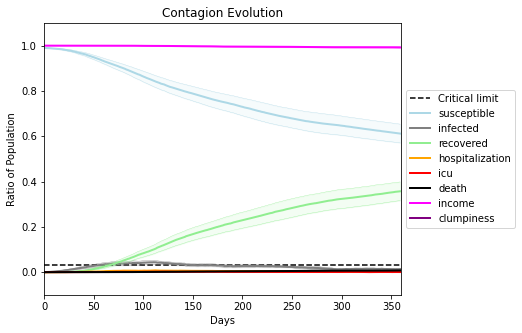

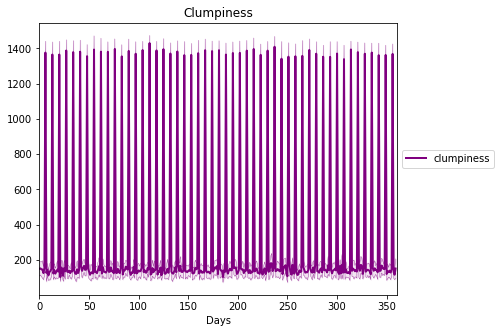

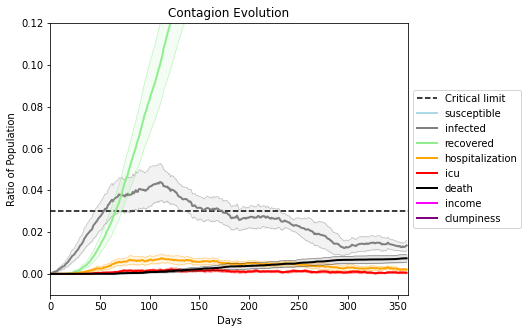

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2257, 1854, 6131, 1646, 9146, 5108, 7797, 7915, 3257, 3669, 6287, 4538, 7425, 144, 1046, 9979, 5768, 3623, 8972, 9578]
Average similarity between family members is 0.9186328803583899 at temperature -0.992
Average similarity between family and home is 0.9998587782869083 at temperature -1
Average similarity between students and their classroom is 0.8333218660024435 at temperature -0.992
Average classroom occupancy is 1.65 and number classrooms is 180
Average similarity between workers is 0.845501855817445 at temperature -0.992
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8343160996270693 for kids: 0.7297728419775971
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneou

avg restaurant similarity 0.47031043436380393
avg restaurant similarity 0.48218967473891444
avg restaurant similarity 0.4793161973554565
avg restaurant similarity 0.4285695365969155
avg restaurant similarity 0.4901941510296333
avg restaurant similarity 0.5216377131886599
avg restaurant similarity 0.5111234202340477
avg restaurant similarity 0.4992173516457016
avg restaurant similarity 0.4635874856564687
avg restaurant similarity 0.47281314155611565
avg restaurant similarity 0.5327843167077053
avg restaurant similarity 0.5177769325098139
avg restaurant similarity 0.4756931081770665
avg restaurant similarity 0.4845170552136282
avg restaurant similarity 0.5103343938285734
avg restaurant similarity 0.5057981019003621
avg restaurant similarity 0.48595262027363084
avg restaurant similarity 0.5119403290252402
avg restaurant similarity 0.5414135358726461
avg restaurant similarity 0.5170358368627368
avg restaurant similarity 0.4688467583658766
avg restaurant similarity 0.5012784834578442
avg re

avg restaurant similarity 0.4926480154556892
avg restaurant similarity 0.46405220533022296
avg restaurant similarity 0.5137681037841214
avg restaurant similarity 0.5272033317805345
avg restaurant similarity 0.4648886753628461
avg restaurant similarity 0.5268776653366318
avg restaurant similarity 0.48568373109191365
avg restaurant similarity 0.5247223928236006
avg restaurant similarity 0.47577952929901796
avg restaurant similarity 0.5496820744536673
avg restaurant similarity 0.5909713717488772
avg restaurant similarity 0.5243688906196183
avg restaurant similarity 0.5403266043847191
avg restaurant similarity 0.5310082062208066
avg restaurant similarity 0.5276442523885903
avg restaurant similarity 0.5509967346048247
avg restaurant similarity 0.49836410816076226
avg restaurant similarity 0.5126206430073624
avg restaurant similarity 0.5167326918852881
avg restaurant similarity 0.5000118528818221
avg restaurant similarity 0.5068058820989083
avg restaurant similarity 0.5340999281562396
avg re

Average similarity between workers is 0.8509555385926868 at temperature -0.992
Average office occupancy is 3.3622448979591835 and number offices is 196
Average friend similarity for adults: 0.8349438984864078 for kids: 0.7259380392835174
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5331397843951734
avg restaurant similarity 0.49946696084731634
avg restaurant similarity 0.5376299025158736
avg restaurant similarity 0.545171381740158
avg restaurant similarity 0.5261117540223396
avg restaurant similarity 0.5742803109712725
avg restaurant similarity 0.5440572257124714
avg restaurant similarity 0.5503118744005628
avg restaurant similarity 0.5538044584058215
avg restaurant similarity 0.546929111310405
avg restaurant similarity 0.5600751279311241
avg restaurant similarity 0.5720843143154086
avg restaurant similarity 0.5774117146082984
avg restaurant similarity 0.5406466067740927
avg restaurant similarity 0.588944483894203
avg restaurant similarity 0.5480853662516972
avg restaurant similarity 0.5635132436527673
avg restaurant similarity 0.5542015877636878
avg restaurant similarity 0.5598036284637395
avg restaurant similarity 0.5127756753684871
avg restaurant similarity 0.5626655525062731
avg restaurant similarity 0.5097312093594736
avg restaura

avg restaurant similarity 0.5360937151942696
avg restaurant similarity 0.5531680058863653
avg restaurant similarity 0.5815982350138627
avg restaurant similarity 0.543157747636064
avg restaurant similarity 0.5480582686136715
avg restaurant similarity 0.5174357228907348
avg restaurant similarity 0.49404065176977296
avg restaurant similarity 0.5261395768427307
avg restaurant similarity 0.5118670431318779
avg restaurant similarity 0.5277278519794476
avg restaurant similarity 0.555938507024683
avg restaurant similarity 0.5750637634362576
avg restaurant similarity 0.5432798026265065
avg restaurant similarity 0.5282271573482701
avg restaurant similarity 0.5525016369361686
avg restaurant similarity 0.5920177193950488
avg restaurant similarity 0.5266681658549833
avg restaurant similarity 0.520661913139195
avg restaurant similarity 0.5307075184769439
avg restaurant similarity 0.5987575253600378
avg restaurant similarity 0.5163438160047179
avg restaurant similarity 0.5840652141922142
avg restaura

Average similarity between workers is 0.8467898605201395 at temperature -0.992
Average office occupancy is 3.5291005291005293 and number offices is 189
Average friend similarity for adults: 0.8429627838980372 for kids: 0.7207736848349474
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5873026539484606
avg restaurant similarity 0.5216047028854734
avg restaurant similarity 0.4722197172543913
avg restaurant similarity 0.5280469422585159
avg restaurant similarity 0.5272084440797968
avg restaurant similarity 0.5085797387047017
avg restaurant similarity 0.544544900317339
avg restaurant similarity 0.5569497372419188
avg restaurant similarity 0.5188439215876889
avg restaurant similarity 0.5430258537038011
avg restaurant similarity 0.4937551340852704
avg restaurant similarity 0.527864678906742
avg restaurant similarity 0.5247791516252132
avg restaurant similarity 0.49952852115860974
avg restaurant similarity 0.5870796943703908
avg restaurant similarity 0.5359555518609234
avg restaurant similarity 0.5619941822976046
avg restaurant similarity 0.5383187214972087
avg restaurant similarity 0.5574300140112809
avg restaurant similarity 0.521239983986033
avg restaurant similarity 0.503443411164964
avg restaurant similarity 0.5288547056549804
avg restauran

avg restaurant similarity 0.5262594002483679
avg restaurant similarity 0.506050611758618
avg restaurant similarity 0.5107152004119898
avg restaurant similarity 0.5134958903802791
avg restaurant similarity 0.5338211947873278
avg restaurant similarity 0.588871080839793
avg restaurant similarity 0.5262417844100338
avg restaurant similarity 0.4874482033449568
avg restaurant similarity 0.5874396643388214
avg restaurant similarity 0.56565501188076
avg restaurant similarity 0.5509217697192312
avg restaurant similarity 0.5271719690843769
avg restaurant similarity 0.49060553538357254
avg restaurant similarity 0.5276053721351407
avg restaurant similarity 0.597610159900816
avg restaurant similarity 0.5023394859207541
avg restaurant similarity 0.5500813012505337
avg restaurant similarity 0.5367950221286879
avg restaurant similarity 0.5553028684260203
avg restaurant similarity 0.5860522843946833
avg restaurant similarity 0.5272231552268004
avg restaurant similarity 0.5339350961956123
avg restaurant

Average similarity between workers is 0.8542208061220168 at temperature -0.992
Average office occupancy is 3.43 and number offices is 200
Average friend similarity for adults: 0.8528926346817101 for kids: 0.7282510248247805
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allo

avg restaurant similarity 0.6206334234743444
avg restaurant similarity 0.5191062522293526
avg restaurant similarity 0.5677232059275823
avg restaurant similarity 0.5446765243491262
avg restaurant similarity 0.5988118086505275
avg restaurant similarity 0.48082060584380876
avg restaurant similarity 0.6219927347738929
avg restaurant similarity 0.5290510332097962
avg restaurant similarity 0.5348320234342171
avg restaurant similarity 0.5445200652817523
avg restaurant similarity 0.4765060515813882
avg restaurant similarity 0.5506319872403785
avg restaurant similarity 0.586413417800093
avg restaurant similarity 0.5808526110322664
avg restaurant similarity 0.5261188510832372
avg restaurant similarity 0.6095501158827904
avg restaurant similarity 0.5076408171517353
avg restaurant similarity 0.5844272343077997
avg restaurant similarity 0.48905482591917954
avg restaurant similarity 0.5301794547086727
avg restaurant similarity 0.5389034446110683
avg restaurant similarity 0.5303142229672244
avg resta

avg restaurant similarity 0.5730387220027829
avg restaurant similarity 0.5598558243867041
avg restaurant similarity 0.5837790965302045
avg restaurant similarity 0.5236587221960737
avg restaurant similarity 0.5704171632653223
avg restaurant similarity 0.5064699211995992
avg restaurant similarity 0.5668670226842997
avg restaurant similarity 0.5419271016323859
avg restaurant similarity 0.5681222458917896
avg restaurant similarity 0.6038816741045153
avg restaurant similarity 0.54847955605618
avg restaurant similarity 0.5439480912894762
avg restaurant similarity 0.6144293691551697
avg restaurant similarity 0.5844133116834501
avg restaurant similarity 0.5199042147097974
avg restaurant similarity 0.5969145643044561
avg restaurant similarity 0.5432255337535306
avg restaurant similarity 0.58347335612049
avg restaurant similarity 0.5466781814986215
avg restaurant similarity 0.5073188789567812
avg restaurant similarity 0.5539246472699964
avg restaurant similarity 0.5839978246399845
avg restaurant

Average similarity between workers is 0.858087975421768 at temperature -0.992
Average office occupancy is 3.3367875647668392 and number offices is 193
Average friend similarity for adults: 0.8419310606504908 for kids: 0.7410536390077964
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 

avg restaurant similarity 0.5371713589257102
avg restaurant similarity 0.49867892950757803
avg restaurant similarity 0.5563551202216389
avg restaurant similarity 0.5093614465507941
avg restaurant similarity 0.5537794652471454
avg restaurant similarity 0.525972517836381
avg restaurant similarity 0.5642973012126185
avg restaurant similarity 0.5153198492406186
avg restaurant similarity 0.5275084871592998
avg restaurant similarity 0.5290707570509159
avg restaurant similarity 0.553028515025983
avg restaurant similarity 0.507405029925971
avg restaurant similarity 0.41886880733897913
avg restaurant similarity 0.4961683950171119
avg restaurant similarity 0.5161039201785383
avg restaurant similarity 0.5637155422964583
avg restaurant similarity 0.5591881595395655
avg restaurant similarity 0.5411903834820874
avg restaurant similarity 0.5407422288059927
avg restaurant similarity 0.5238612948797716
avg restaurant similarity 0.49426613330947183
avg restaurant similarity 0.5146064598291342
avg restau

avg restaurant similarity 0.4845139878858795
avg restaurant similarity 0.573017942510061
avg restaurant similarity 0.60802267317533
avg restaurant similarity 0.49127890041153893
avg restaurant similarity 0.5194792731079081
avg restaurant similarity 0.5629001439676806
avg restaurant similarity 0.5786875783571463
avg restaurant similarity 0.49637016683106033
avg restaurant similarity 0.5377187363242786
avg restaurant similarity 0.520709366050237
avg restaurant similarity 0.49699630408655254
avg restaurant similarity 0.5052728338648286
avg restaurant similarity 0.5393103757591052
avg restaurant similarity 0.5942377859847715
avg restaurant similarity 0.5064417526067313
avg restaurant similarity 0.5233528941112457
avg restaurant similarity 0.5323835260566603
avg restaurant similarity 0.5529933376313005
avg restaurant similarity 0.5390402871642168
avg restaurant similarity 0.5251480728993813
avg restaurant similarity 0.5476036899382668
avg restaurant similarity 0.5492425013005862
avg restaur

Average similarity between workers is 0.8399385832621055 at temperature -0.992
Average office occupancy is 3.375661375661376 and number offices is 189
Average friend similarity for adults: 0.8262405556174844 for kids: 0.7223079494546298
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.46228449252168047
avg restaurant similarity 0.4900697741874772
avg restaurant similarity 0.551512640113325
avg restaurant similarity 0.4847793662361211
avg restaurant similarity 0.5284694185439186
avg restaurant similarity 0.5058376709638539
avg restaurant similarity 0.48289021269814697
avg restaurant similarity 0.5310804768291836
avg restaurant similarity 0.5159003495260147
avg restaurant similarity 0.5261085704232387
avg restaurant similarity 0.444736275924786
avg restaurant similarity 0.4817521455151233
avg restaurant similarity 0.4862254014660241
avg restaurant similarity 0.4994413071565508
avg restaurant similarity 0.540049436610005
avg restaurant similarity 0.5113735193218354
avg restaurant similarity 0.5308904522569238
avg restaurant similarity 0.533670075871653
avg restaurant similarity 0.5391327519703574
avg restaurant similarity 0.4506287393440741
avg restaurant similarity 0.5311686353859986
avg restaurant similarity 0.5301072802011085
avg restaura

avg restaurant similarity 0.5328544504107473
avg restaurant similarity 0.465547893915552
avg restaurant similarity 0.4637206053579191
avg restaurant similarity 0.5040782150863968
avg restaurant similarity 0.47592634059492456
avg restaurant similarity 0.5434286441570203
avg restaurant similarity 0.5514775512188358
avg restaurant similarity 0.545614027019388
avg restaurant similarity 0.5057832670008279
avg restaurant similarity 0.45977221342072994
avg restaurant similarity 0.5228125213020709
avg restaurant similarity 0.4586657304955902
avg restaurant similarity 0.5112915059850713
avg restaurant similarity 0.4820090096578371
avg restaurant similarity 0.5564514160711508
avg restaurant similarity 0.5114929353377368
avg restaurant similarity 0.5203562512120743
avg restaurant similarity 0.5370896635175162
avg restaurant similarity 0.5346772772260303
avg restaurant similarity 0.49963298482684204
avg restaurant similarity 0.5101842212724249
avg restaurant similarity 0.5437831688313011
avg resta

Average similarity between workers is 0.8521546522468088 at temperature -0.992
Average office occupancy is 3.5255102040816326 and number offices is 196
Average friend similarity for adults: 0.8501956537493431 for kids: 0.7074716942271817
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.5442661035821238
avg restaurant similarity 0.49512318750956796
avg restaurant similarity 0.5060904961922347
avg restaurant similarity 0.5429719273960769
avg restaurant similarity 0.47768207740152174
avg restaurant similarity 0.568055686673109
avg restaurant similarity 0.5796979104096454
avg restaurant similarity 0.4992335627005739
avg restaurant similarity 0.5330452730143134
avg restaurant similarity 0.5860648836004378
avg restaurant similarity 0.5240937253159778
avg restaurant similarity 0.5273104358928405
avg restaurant similarity 0.5587694804142753
avg restaurant similarity 0.6096353055457077
avg restaurant similarity 0.5367711756090338
avg restaurant similarity 0.5361988035120779
avg restaurant similarity 0.5406468117217988
avg restaurant similarity 0.5647518051484772
avg restaurant similarity 0.5111436373721535
avg restaurant similarity 0.5670840957376931
avg restaurant similarity 0.5552899881899706
avg restaurant similarity 0.5100891288221224
avg resta

avg restaurant similarity 0.5429127943550812
avg restaurant similarity 0.5449736655408013
avg restaurant similarity 0.5892371933784161
avg restaurant similarity 0.5412111896884007
avg restaurant similarity 0.560845362193368
avg restaurant similarity 0.5270767698958927
avg restaurant similarity 0.5178112581326345
avg restaurant similarity 0.49150653762367646
avg restaurant similarity 0.5001232196843095
avg restaurant similarity 0.538141954405531
avg restaurant similarity 0.4958602962612805
avg restaurant similarity 0.5506739142439215
avg restaurant similarity 0.5261269076255524
avg restaurant similarity 0.5202739472086454
avg restaurant similarity 0.5703203094699095
avg restaurant similarity 0.5871905706909647
avg restaurant similarity 0.5541129519299143
avg restaurant similarity 0.5747407344958149
avg restaurant similarity 0.5617107277144981
avg restaurant similarity 0.4540805512693622
avg restaurant similarity 0.5056936239414679
avg restaurant similarity 0.528836167988786
avg restaura

Average similarity between workers is 0.8425012019999277 at temperature -0.992
Average office occupancy is 3.471794871794872 and number offices is 195
Average friend similarity for adults: 0.8469604053958324 for kids: 0.7211988160201314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5535792633364345
avg restaurant similarity 0.5791522949880522
avg restaurant similarity 0.5091848097311392
avg restaurant similarity 0.5318840577683982
avg restaurant similarity 0.5387620948057034
avg restaurant similarity 0.5072420463847428
avg restaurant similarity 0.5011361031525249
avg restaurant similarity 0.5486641290804353
avg restaurant similarity 0.56174251270703
avg restaurant similarity 0.5508029041729066
avg restaurant similarity 0.49615831206979444
avg restaurant similarity 0.5135941364206446
avg restaurant similarity 0.5526006947615821
avg restaurant similarity 0.5558325072781891
avg restaurant similarity 0.5223816098900291
avg restaurant similarity 0.5343146324295223
avg restaurant similarity 0.5287459157342757
avg restaurant similarity 0.5634743597041738
avg restaurant similarity 0.5223855057043166
avg restaurant similarity 0.5523717374010336
avg restaurant similarity 0.5157502582696941
avg restaurant similarity 0.5349208603387546
avg restaur

avg restaurant similarity 0.5239569342508575
avg restaurant similarity 0.5377729505876856
avg restaurant similarity 0.5176682970401338
avg restaurant similarity 0.5478116210531548
avg restaurant similarity 0.5569536962409731
avg restaurant similarity 0.5507657077875844
avg restaurant similarity 0.47629006258267026
avg restaurant similarity 0.49522879772135947
avg restaurant similarity 0.5622173189305125
avg restaurant similarity 0.5526249185028833
avg restaurant similarity 0.5588899799629476
avg restaurant similarity 0.5750846956872917
avg restaurant similarity 0.5342586383330533
avg restaurant similarity 0.5010322138231311
avg restaurant similarity 0.5789560743130934
avg restaurant similarity 0.5201640696055827
avg restaurant similarity 0.5558502624512262
avg restaurant similarity 0.5118385920074509
avg restaurant similarity 0.47973839282063896
avg restaurant similarity 0.5673496084802064
avg restaurant similarity 0.5644395131497953
avg restaurant similarity 0.5256597062606774
avg res

Average similarity between workers is 0.844850302387225 at temperature -0.992
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.8388497461391519 for kids: 0.7215174023201705
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5299906140042548
avg restaurant similarity 0.5569253037012375
avg restaurant similarity 0.5158717072122295
avg restaurant similarity 0.5380563767148742
avg restaurant similarity 0.5035261820168917
avg restaurant similarity 0.5168808812077637
avg restaurant similarity 0.5054919987850024
avg restaurant similarity 0.5662915191952774
avg restaurant similarity 0.5147026766061993
avg restaurant similarity 0.518769331418336
avg restaurant similarity 0.5039040919457114
avg restaurant similarity 0.4812800566361435
avg restaurant similarity 0.5747109453893731
avg restaurant similarity 0.5257213160960975
avg restaurant similarity 0.584974128761021
avg restaurant similarity 0.5308853152524032
avg restaurant similarity 0.5180106826266181
avg restaurant similarity 0.5689490985513259
avg restaurant similarity 0.5759530714422061
avg restaurant similarity 0.5732334706709253
avg restaurant similarity 0.5800921039801451
avg restaurant similarity 0.568640455076361
avg restauran

avg restaurant similarity 0.6006463522571572
avg restaurant similarity 0.5218259543901952
avg restaurant similarity 0.4536905116985739
avg restaurant similarity 0.5254392055441037
avg restaurant similarity 0.5891701140133818
avg restaurant similarity 0.532064555565928
avg restaurant similarity 0.5073234993094565
avg restaurant similarity 0.5442198569640778
avg restaurant similarity 0.5213666490370197
avg restaurant similarity 0.54853388183031
avg restaurant similarity 0.5416817401035834
avg restaurant similarity 0.564218508592024
avg restaurant similarity 0.5076142991484622
avg restaurant similarity 0.5646499631893312
avg restaurant similarity 0.5319721926980043
avg restaurant similarity 0.6060930416174005
avg restaurant similarity 0.49090133191196883
avg restaurant similarity 0.5079702497214093
avg restaurant similarity 0.5619101058848222
avg restaurant similarity 0.5410586105879926
avg restaurant similarity 0.5720104435476147
avg restaurant similarity 0.4795207045899117
avg restauran

Average similarity between workers is 0.8517151412074511 at temperature -0.992
Average office occupancy is 3.4329896907216493 and number offices is 194
Average friend similarity for adults: 0.84834848087677 for kids: 0.7194481303870759
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peo

avg restaurant similarity 0.5216157444630909
avg restaurant similarity 0.5346123996931654
avg restaurant similarity 0.5363486811690521
avg restaurant similarity 0.5643336787789666
avg restaurant similarity 0.5117282619152538
avg restaurant similarity 0.5265241122791623
avg restaurant similarity 0.5442365408085328
avg restaurant similarity 0.5488211166640546
avg restaurant similarity 0.5200828542951561
avg restaurant similarity 0.5589742626748855
avg restaurant similarity 0.5771807983000649
avg restaurant similarity 0.5850406523313785
avg restaurant similarity 0.5272628281000881
avg restaurant similarity 0.47562985889846954
avg restaurant similarity 0.5552956743312953
avg restaurant similarity 0.49490690720130676
avg restaurant similarity 0.5491774191576042
avg restaurant similarity 0.5434086020238675
avg restaurant similarity 0.4943004863712711
avg restaurant similarity 0.5290369725414672
avg restaurant similarity 0.5360891681519131
avg restaurant similarity 0.46175901501143873
avg res

avg restaurant similarity 0.5610254769522951
avg restaurant similarity 0.5389510514701447
avg restaurant similarity 0.5320045923335738
avg restaurant similarity 0.46704551750198275
avg restaurant similarity 0.5852296561377355
avg restaurant similarity 0.517530808685911
avg restaurant similarity 0.4990860541783892
avg restaurant similarity 0.5303942207900695
avg restaurant similarity 0.5235884890939242
avg restaurant similarity 0.5479652671526867
avg restaurant similarity 0.542487117400654
avg restaurant similarity 0.5501362275521082
avg restaurant similarity 0.5693852949407525
avg restaurant similarity 0.57700559612097
avg restaurant similarity 0.5008658061584106
avg restaurant similarity 0.4884036532302604
avg restaurant similarity 0.5651240030092579
avg restaurant similarity 0.5262115592761908
avg restaurant similarity 0.5249607139153517
avg restaurant similarity 0.48934856520950887
avg restaurant similarity 0.49417019716997795
avg restaurant similarity 0.5526074645580449
avg restaur

Average similarity between workers is 0.8523933952236835 at temperature -0.992
Average office occupancy is 3.315 and number offices is 200
Average friend similarity for adults: 0.8457372409411776 for kids: 0.7157776873161669
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people all

avg restaurant similarity 0.5766680731561217
avg restaurant similarity 0.5500802758789539
avg restaurant similarity 0.5984337620094807
avg restaurant similarity 0.5624902879921765
avg restaurant similarity 0.5253519130708054
avg restaurant similarity 0.5326792137487808
avg restaurant similarity 0.615460206306385
avg restaurant similarity 0.5404636832724846
avg restaurant similarity 0.5583111292783138
avg restaurant similarity 0.5652587604649385
avg restaurant similarity 0.5353240534973772
avg restaurant similarity 0.6046214591204871
avg restaurant similarity 0.5325207274275945
avg restaurant similarity 0.522520280141846
avg restaurant similarity 0.5004712194399602
avg restaurant similarity 0.5555485301648354
avg restaurant similarity 0.5096458048019432
avg restaurant similarity 0.5430889306674592
avg restaurant similarity 0.5048829330272081
avg restaurant similarity 0.5721677662156366
avg restaurant similarity 0.6191715409242211
avg restaurant similarity 0.47985980579785004
avg restaur

avg restaurant similarity 0.6036206242133003
avg restaurant similarity 0.5754628951661312
avg restaurant similarity 0.5140364467639863
avg restaurant similarity 0.5925605918281737
avg restaurant similarity 0.5263361866088792
avg restaurant similarity 0.5071611918467482
avg restaurant similarity 0.551757467363059
avg restaurant similarity 0.5349319353724975
avg restaurant similarity 0.5481959233899613
avg restaurant similarity 0.5123371768852731
avg restaurant similarity 0.576797432164034
avg restaurant similarity 0.559050233773992
avg restaurant similarity 0.5789630036039649
avg restaurant similarity 0.5278896907293409
avg restaurant similarity 0.5341944004948694
avg restaurant similarity 0.5682296889247144
avg restaurant similarity 0.535904729954184
avg restaurant similarity 0.6002425505391579
avg restaurant similarity 0.5824428209896595
avg restaurant similarity 0.5136178744624724
avg restaurant similarity 0.4781910423451855
avg restaurant similarity 0.5940732733910679
avg restaurant

Average similarity between workers is 0.8430391746272061 at temperature -0.992
Average office occupancy is 3.4635416666666665 and number offices is 192
Average friend similarity for adults: 0.8295746746527745 for kids: 0.7288787024859096
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5117583478013227
avg restaurant similarity 0.47771010798478436
avg restaurant similarity 0.4935699607684389
avg restaurant similarity 0.5506845470349703
avg restaurant similarity 0.4732264934198974
avg restaurant similarity 0.4891296828969634
avg restaurant similarity 0.47442242914717647
avg restaurant similarity 0.5224681719196536
avg restaurant similarity 0.5104701909532834
avg restaurant similarity 0.5576964903079402
avg restaurant similarity 0.5099945664496137
avg restaurant similarity 0.5358886010116466
avg restaurant similarity 0.5279869156271344
avg restaurant similarity 0.47289938308375956
avg restaurant similarity 0.5387230676679519
avg restaurant similarity 0.48691797767960454
avg restaurant similarity 0.5603461895920507
avg restaurant similarity 0.4774173142739417
avg restaurant similarity 0.45064061829912283
avg restaurant similarity 0.545441682249816
avg restaurant similarity 0.4571394097417028
avg restaurant similarity 0.5019334723531008
avg re

avg restaurant similarity 0.5272936979954421
avg restaurant similarity 0.5494230918909896
avg restaurant similarity 0.5412436051194334
avg restaurant similarity 0.5017793423958256
avg restaurant similarity 0.4845882345099263
avg restaurant similarity 0.4836619240980561
avg restaurant similarity 0.4732980921883037
avg restaurant similarity 0.5234061706044636
avg restaurant similarity 0.49732401099760165
avg restaurant similarity 0.43597254797370755
avg restaurant similarity 0.5328092568125762
avg restaurant similarity 0.5145902753032926
avg restaurant similarity 0.4986799297410144
avg restaurant similarity 0.5701216932383842
avg restaurant similarity 0.5347713850461665
avg restaurant similarity 0.5492029497612059
avg restaurant similarity 0.5079117505005181
avg restaurant similarity 0.5074058699091646
avg restaurant similarity 0.48625883156207134
avg restaurant similarity 0.5226442882814781
avg restaurant similarity 0.5038010210899715
avg restaurant similarity 0.47956899814829984
avg re

Average similarity between workers is 0.8296419465622695 at temperature -0.992
Average office occupancy is 3.283505154639175 and number offices is 194
Average friend similarity for adults: 0.8321332182613371 for kids: 0.720759276856393
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.49728029363926063
avg restaurant similarity 0.5191934655336538
avg restaurant similarity 0.5195505620433564
avg restaurant similarity 0.49270827443957566
avg restaurant similarity 0.5448187887580688
avg restaurant similarity 0.5107843664018206
avg restaurant similarity 0.5701337925772663
avg restaurant similarity 0.4915945791353205
avg restaurant similarity 0.5928445134809968
avg restaurant similarity 0.5471761149362054
avg restaurant similarity 0.5006164844621835
avg restaurant similarity 0.5087725391391253
avg restaurant similarity 0.5644952953948746
avg restaurant similarity 0.4992017418217998
avg restaurant similarity 0.557764023320161
avg restaurant similarity 0.518330307024457
avg restaurant similarity 0.5794052486106563
avg restaurant similarity 0.5114412986585377
avg restaurant similarity 0.5618453256481238
avg restaurant similarity 0.5960352446962697
avg restaurant similarity 0.5156180786989912
avg restaurant similarity 0.5292619396242121
avg restau

avg restaurant similarity 0.5376752587168521
avg restaurant similarity 0.5678513181771873
avg restaurant similarity 0.5058970796939004
avg restaurant similarity 0.5451302560370027
avg restaurant similarity 0.5292334468364291
avg restaurant similarity 0.5210636657291003
avg restaurant similarity 0.5266253709401837
avg restaurant similarity 0.5265074912020924
avg restaurant similarity 0.4995790868926456
avg restaurant similarity 0.48038011569852096
avg restaurant similarity 0.5409910558565307
avg restaurant similarity 0.5631824707299127
avg restaurant similarity 0.5483298932719672
avg restaurant similarity 0.5054194138093534
avg restaurant similarity 0.5557456776522982
avg restaurant similarity 0.49165338205055703
avg restaurant similarity 0.5757817627427968
avg restaurant similarity 0.48548401622626736
avg restaurant similarity 0.5398243008572955
avg restaurant similarity 0.5748690313071207
avg restaurant similarity 0.5313672276265976
avg restaurant similarity 0.5267893236787189
avg res

Average similarity between workers is 0.8679957333182944 at temperature -0.992
Average office occupancy is 3.351758793969849 and number offices is 199
Average friend similarity for adults: 0.8534899740988979 for kids: 0.7312855396995325
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5267244408870247
avg restaurant similarity 0.5206885532588266
avg restaurant similarity 0.5095619402322984
avg restaurant similarity 0.47117041954224675
avg restaurant similarity 0.5663170839655659
avg restaurant similarity 0.5034095313503552
avg restaurant similarity 0.5246914452828931
avg restaurant similarity 0.5155219578680453
avg restaurant similarity 0.5230797886959878
avg restaurant similarity 0.5798563277954889
avg restaurant similarity 0.5384461094666605
avg restaurant similarity 0.544847059489448
avg restaurant similarity 0.5264677367634256
avg restaurant similarity 0.5757350285788598
avg restaurant similarity 0.5513116494859507
avg restaurant similarity 0.533001220527118
avg restaurant similarity 0.5140147328596651
avg restaurant similarity 0.5565952459036313
avg restaurant similarity 0.5372659163337521
avg restaurant similarity 0.5219889656149231
avg restaurant similarity 0.593648163727638
avg restaurant similarity 0.5297583970558583
avg restaura

avg restaurant similarity 0.5609267338721315
avg restaurant similarity 0.563987270196138
avg restaurant similarity 0.5188056607298178
avg restaurant similarity 0.510802842383177
avg restaurant similarity 0.5138067301343621
avg restaurant similarity 0.5315190213718771
avg restaurant similarity 0.546219329889422
avg restaurant similarity 0.5170344327851252
avg restaurant similarity 0.5420775191072814
avg restaurant similarity 0.4965314638831784
avg restaurant similarity 0.5369485841142576
avg restaurant similarity 0.5433220819139807
avg restaurant similarity 0.5859048027828059
avg restaurant similarity 0.4866116496589827
avg restaurant similarity 0.522541326853848
avg restaurant similarity 0.5368040543051719
avg restaurant similarity 0.520027688136744
avg restaurant similarity 0.5259455015778188
avg restaurant similarity 0.558848460889202
avg restaurant similarity 0.4811362243777979
avg restaurant similarity 0.5217948004775654
avg restaurant similarity 0.585594956930245
avg restaurant si

Average similarity between workers is 0.8425794434689866 at temperature -0.992
Average office occupancy is 3.512562814070352 and number offices is 199
Average friend similarity for adults: 0.8411021391158673 for kids: 0.6876549583984101
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.513252096159856
avg restaurant similarity 0.4618812641030021
avg restaurant similarity 0.5106625696470228
avg restaurant similarity 0.5419225109406449
avg restaurant similarity 0.5245842936454206
avg restaurant similarity 0.5273844914308478
avg restaurant similarity 0.5266324302957233
avg restaurant similarity 0.5355489132968411
avg restaurant similarity 0.5813736937234478
avg restaurant similarity 0.4870092517566949
avg restaurant similarity 0.511425971229997
avg restaurant similarity 0.48222693966763885
avg restaurant similarity 0.511240923300416
avg restaurant similarity 0.5274848999429628
avg restaurant similarity 0.5327223107735056
avg restaurant similarity 0.4951079574351206
avg restaurant similarity 0.5715855077505141
avg restaurant similarity 0.5906066651591741
avg restaurant similarity 0.5102744045127369
avg restaurant similarity 0.5159180684147576
avg restaurant similarity 0.5115229804137027
avg restaurant similarity 0.5068755271978637
avg restaura

avg restaurant similarity 0.5511815702599987
avg restaurant similarity 0.4833269203744604
avg restaurant similarity 0.4770644623822249
avg restaurant similarity 0.5520359922983489
avg restaurant similarity 0.525825135276169
avg restaurant similarity 0.5257308826426742
avg restaurant similarity 0.5490706013516338
avg restaurant similarity 0.5371131891892659
avg restaurant similarity 0.5379418962632437
avg restaurant similarity 0.48464981916100003
avg restaurant similarity 0.4985827845109449
avg restaurant similarity 0.5167391958672402
avg restaurant similarity 0.5207195534308469
avg restaurant similarity 0.5783308818545537
avg restaurant similarity 0.5388746939718884
avg restaurant similarity 0.5444091641993748
avg restaurant similarity 0.5497265799253571
avg restaurant similarity 0.5646262553257508
avg restaurant similarity 0.5409278033782048
avg restaurant similarity 0.4476440892927811
avg restaurant similarity 0.5465062100620384
avg restaurant similarity 0.5040845726795317
avg restau

Average similarity between workers is 0.8520781407345787 at temperature -0.992
Average office occupancy is 3.405128205128205 and number offices is 195
Average friend similarity for adults: 0.840055527351991 for kids: 0.7199795146005417
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 peopl

avg restaurant similarity 0.5413507123643053
avg restaurant similarity 0.5996494882365645
avg restaurant similarity 0.5569128578143149
avg restaurant similarity 0.5194537078954654
avg restaurant similarity 0.5978055823718227
avg restaurant similarity 0.5639422739033517
avg restaurant similarity 0.6127022745212309
avg restaurant similarity 0.6242402420848371
avg restaurant similarity 0.5820583407995467
avg restaurant similarity 0.5585560410505593
avg restaurant similarity 0.5322641374281079
avg restaurant similarity 0.6126580554561062
avg restaurant similarity 0.5346610693459158
avg restaurant similarity 0.566947348539105
avg restaurant similarity 0.5467413290197686
avg restaurant similarity 0.625496933178531
avg restaurant similarity 0.6190382978215926
avg restaurant similarity 0.5253093490284428
avg restaurant similarity 0.5871149564151255
avg restaurant similarity 0.5430519559593765
avg restaurant similarity 0.5390688998445542
avg restaurant similarity 0.5539320197344391
avg restaura

avg restaurant similarity 0.6234246033686961
avg restaurant similarity 0.5780501252964514
avg restaurant similarity 0.5870266482095794
avg restaurant similarity 0.5860903221241264
avg restaurant similarity 0.6019553022618837
avg restaurant similarity 0.5307336349903669
avg restaurant similarity 0.5558726667201724
avg restaurant similarity 0.5411717422706696
avg restaurant similarity 0.6241117234291258
avg restaurant similarity 0.5802020367371953
avg restaurant similarity 0.5430110294686524
avg restaurant similarity 0.5724414337814793
avg restaurant similarity 0.5327762751791645
avg restaurant similarity 0.6052371515707528
avg restaurant similarity 0.5343066460583598
avg restaurant similarity 0.5895115150997297
avg restaurant similarity 0.5376165564562241
avg restaurant similarity 0.5798277928341938
avg restaurant similarity 0.6056008010871348
avg restaurant similarity 0.549330983409431
avg restaurant similarity 0.5733573568240586
avg restaurant similarity 0.5208571359020042
avg restaur

Average similarity between workers is 0.8554006514928315 at temperature -0.992
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.8479509780437574 for kids: 0.7305275658219658
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.503281497729411
avg restaurant similarity 0.542372240013682
avg restaurant similarity 0.4905031246544001
avg restaurant similarity 0.5197633116273227
avg restaurant similarity 0.5154570733842662
avg restaurant similarity 0.5489791201075493
avg restaurant similarity 0.5147476414726027
avg restaurant similarity 0.5637342337654652
avg restaurant similarity 0.5265871530580345
avg restaurant similarity 0.4908358444057944
avg restaurant similarity 0.5348823749768425
avg restaurant similarity 0.537476323641046
avg restaurant similarity 0.4536697381578265
avg restaurant similarity 0.5931834620879962
avg restaurant similarity 0.5107742462475253
avg restaurant similarity 0.5362157676589492
avg restaurant similarity 0.49136263382645023
avg restaurant similarity 0.5186588981348318
avg restaurant similarity 0.5716763854717561
avg restaurant similarity 0.5377081311283314
avg restaurant similarity 0.5580060503608653
avg restaurant similarity 0.5460291417422396
avg restaura

avg restaurant similarity 0.5004284747426146
avg restaurant similarity 0.5088384694445415
avg restaurant similarity 0.5206127028554238
avg restaurant similarity 0.5022925795315132
avg restaurant similarity 0.5023046201457315
avg restaurant similarity 0.5764210756468464
avg restaurant similarity 0.4726928078619654
avg restaurant similarity 0.5644737304226806
avg restaurant similarity 0.5292786834471955
avg restaurant similarity 0.510086141621213
avg restaurant similarity 0.5400140463358913
avg restaurant similarity 0.5122747958499563
avg restaurant similarity 0.5506971357069835
avg restaurant similarity 0.5427476618197885
avg restaurant similarity 0.560876923126258
avg restaurant similarity 0.5904700025574655
avg restaurant similarity 0.49053951363284165
avg restaurant similarity 0.5363286804581763
avg restaurant similarity 0.4749906729701934
avg restaurant similarity 0.5176072561276124
avg restaurant similarity 0.5452778587689976
avg restaurant similarity 0.4905258669571624
avg restaur

Average similarity between workers is 0.8455298852085885 at temperature -0.992
Average office occupancy is 3.6510416666666665 and number offices is 192
Average friend similarity for adults: 0.846169331774656 for kids: 0.7034256299736091
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.5603454130878499
avg restaurant similarity 0.4515538479007442
avg restaurant similarity 0.5415315806008331
avg restaurant similarity 0.5871865844172784
avg restaurant similarity 0.5141983634997741
avg restaurant similarity 0.5082961570518021
avg restaurant similarity 0.5049832175670153
avg restaurant similarity 0.5008176259547159
avg restaurant similarity 0.5246324894591445
avg restaurant similarity 0.5718762701570513
avg restaurant similarity 0.48952134035520983
avg restaurant similarity 0.5157282468296566
avg restaurant similarity 0.5352712513664235
avg restaurant similarity 0.5666703507297923
avg restaurant similarity 0.49031319675255625
avg restaurant similarity 0.5290863351538927
avg restaurant similarity 0.5624553013442998
avg restaurant similarity 0.5384361032183071
avg restaurant similarity 0.546068486731147
avg restaurant similarity 0.5226743230544837
avg restaurant similarity 0.5972706084309386
avg restaurant similarity 0.5845283931175145
avg resta

avg restaurant similarity 0.5448402538027505
avg restaurant similarity 0.5886352388649665
avg restaurant similarity 0.49763344816746
avg restaurant similarity 0.5552835094042244
avg restaurant similarity 0.5016913088767504
avg restaurant similarity 0.5027234343904388
avg restaurant similarity 0.532371002418487
avg restaurant similarity 0.5876611586909594
avg restaurant similarity 0.5066533115571968
avg restaurant similarity 0.5549871599316847
avg restaurant similarity 0.5485431988209415
avg restaurant similarity 0.5553557441334028
avg restaurant similarity 0.4921927580402402
avg restaurant similarity 0.5464720460652323
avg restaurant similarity 0.5229953467988168
avg restaurant similarity 0.5336133919002976
avg restaurant similarity 0.5458056430664626
avg restaurant similarity 0.5143645439248411
avg restaurant similarity 0.5547358459351382
avg restaurant similarity 0.49508548591913726
avg restaurant similarity 0.5206149142811975
avg restaurant similarity 0.5615516326410873
avg restaura

Average similarity between workers is 0.8556288218514025 at temperature -0.992
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.8461091209813026 for kids: 0.7253965672673836
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5241765080603152
avg restaurant similarity 0.5207984280775281
avg restaurant similarity 0.518322353919243
avg restaurant similarity 0.533544852015693
avg restaurant similarity 0.5362247453894182
avg restaurant similarity 0.5176869550056432
avg restaurant similarity 0.5892762636770078
avg restaurant similarity 0.5777978626730929
avg restaurant similarity 0.49319435344006973
avg restaurant similarity 0.520065532453617
avg restaurant similarity 0.5485953395468989
avg restaurant similarity 0.5119981046838593
avg restaurant similarity 0.5752310135666021
avg restaurant similarity 0.5228448355651143
avg restaurant similarity 0.543574008581988
avg restaurant similarity 0.5754036585215262
avg restaurant similarity 0.4766656050264437
avg restaurant similarity 0.4527919898845579
avg restaurant similarity 0.5716509568855005
avg restaurant similarity 0.5165642713599868
avg restaurant similarity 0.5628661900893094
avg restaurant similarity 0.5291985198059052
avg restauran

avg restaurant similarity 0.5818347817358797
avg restaurant similarity 0.5533838498693364
avg restaurant similarity 0.5702883421880186
avg restaurant similarity 0.5481208661635965
avg restaurant similarity 0.5080249698587291
avg restaurant similarity 0.5639417033370316
avg restaurant similarity 0.5453082921455812
avg restaurant similarity 0.5092814817847718
avg restaurant similarity 0.530351369019232
avg restaurant similarity 0.5176252045728088
avg restaurant similarity 0.5040356633853329
avg restaurant similarity 0.524702192930134
avg restaurant similarity 0.5045983072345225
avg restaurant similarity 0.5711901418128851
avg restaurant similarity 0.5394131145874295
avg restaurant similarity 0.5390191375563668
avg restaurant similarity 0.5202972256118401
avg restaurant similarity 0.5194424818273449
avg restaurant similarity 0.5524845013578737
avg restaurant similarity 0.4969927949492666
avg restaurant similarity 0.5299866851420982
avg restaurant similarity 0.5060024387341993
avg restaura

Average similarity between workers is 0.8495649340382496 at temperature -0.992
Average office occupancy is 3.3678756476683938 and number offices is 193
Average friend similarity for adults: 0.841862772042133 for kids: 0.7339468054253224
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 

avg restaurant similarity 0.5611436383675217
avg restaurant similarity 0.49409703862344656
avg restaurant similarity 0.5191073154604068
avg restaurant similarity 0.5367358176265083
avg restaurant similarity 0.5225681558309919
avg restaurant similarity 0.6111627101100969
avg restaurant similarity 0.5829735431842538
avg restaurant similarity 0.5166946651698073
avg restaurant similarity 0.4671326477872331
avg restaurant similarity 0.534519291562953
avg restaurant similarity 0.5261745297737546
avg restaurant similarity 0.47201781789695607
avg restaurant similarity 0.5404919006394795
avg restaurant similarity 0.4506290853268617
avg restaurant similarity 0.543859504976833
avg restaurant similarity 0.5559284675527393
avg restaurant similarity 0.5177635268879942
avg restaurant similarity 0.541576279055128
avg restaurant similarity 0.4882319634941054
avg restaurant similarity 0.5311928858444868
avg restaurant similarity 0.5040050023418888
avg restaurant similarity 0.48080103987045975
avg restau

avg restaurant similarity 0.502363863618537
avg restaurant similarity 0.5622673735313917
avg restaurant similarity 0.5978052358850299
avg restaurant similarity 0.5277564760055105
avg restaurant similarity 0.5038501858882998
avg restaurant similarity 0.5536848262588017
avg restaurant similarity 0.48453690335549016
avg restaurant similarity 0.5216126337149664
avg restaurant similarity 0.5130064505070985
avg restaurant similarity 0.5119481545581487
avg restaurant similarity 0.5131318008323341
avg restaurant similarity 0.5323716088493637
avg restaurant similarity 0.5426345599362945
avg restaurant similarity 0.5502550021171507
avg restaurant similarity 0.4155294822917958
avg restaurant similarity 0.48027047642221476
avg restaurant similarity 0.5583978445199722
avg restaurant similarity 0.5311088235975457
avg restaurant similarity 0.5126666019435743
avg restaurant similarity 0.5769898583325819
avg restaurant similarity 0.5984690783633917
avg restaurant similarity 0.5754661105285064
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

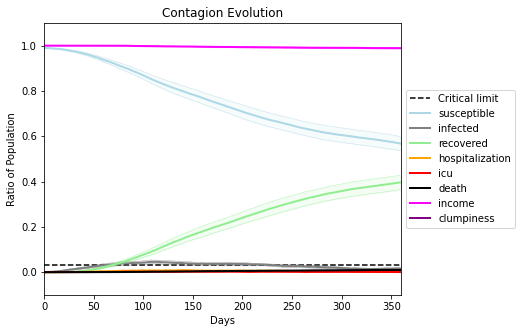

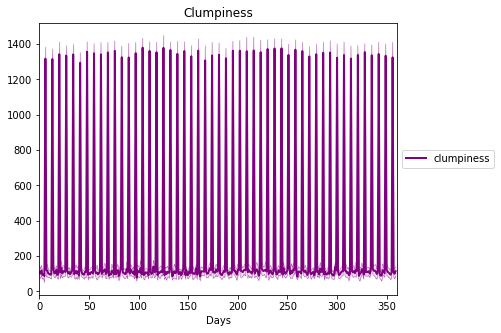

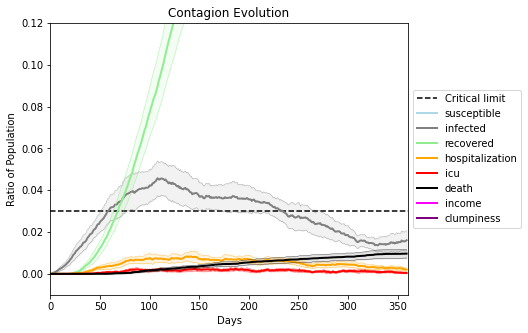

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4151, 7558, 5498, 156, 5493, 25, 7727, 9861, 2006, 6056, 503, 8904, 9573, 9617, 6348, 6873, 3139, 3461, 9412, 1785]
Average similarity between family members is 0.9189564236306776 at temperature -0.991
Average similarity between family and home is 0.9998497156344403 at temperature -1
Average similarity between students and their classroom is 0.8063287457711412 at temperature -0.991
Average classroom occupancy is 1.6453488372093024 and number classrooms is 172
Average similarity between workers is 0.8379834969341685 at temperature -0.991
Average office occupancy is 3.5291005291005293 and number offices is 189
Average friend similarity for adults: 0.8409286132072221 for kids: 0.7181477465589711
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.5436773005329257
avg restaurant similarity 0.4628196678470117
avg restaurant similarity 0.4438210510821773
avg restaurant similarity 0.5183227136796983
avg restaurant similarity 0.466062566533791
avg restaurant similarity 0.5502671719875074
avg restaurant similarity 0.5414778148983374
avg restaurant similarity 0.5184887556506483
avg restaurant similarity 0.45963479121361356
avg restaurant similarity 0.5035368770326871
avg restaurant similarity 0.5186646749651792
avg restaurant similarity 0.4851903454277238
avg restaurant similarity 0.4844801245419266
avg restaurant similarity 0.5027613688315314
avg restaurant similarity 0.5131978846149297
avg restaurant similarity 0.5068485683430297
avg restaurant similarity 0.4445003963590223
avg restaurant similarity 0.5142141326987792
avg restaurant similarity 0.4916080516399909
avg restaurant similarity 0.4776567408254303
avg restaurant similarity 0.45695832936493175
avg restaurant similarity 0.4457368256343404
avg resta

avg restaurant similarity 0.47227735221921424
avg restaurant similarity 0.49462822285330693
avg restaurant similarity 0.5278711638490404
avg restaurant similarity 0.5187895113132986
avg restaurant similarity 0.4984166593190749
avg restaurant similarity 0.44812368774478845
avg restaurant similarity 0.4828470552979583
avg restaurant similarity 0.4776888736002056
avg restaurant similarity 0.5200654066672263
avg restaurant similarity 0.5006876104136617
avg restaurant similarity 0.5438930052722805
avg restaurant similarity 0.5242859245260345
avg restaurant similarity 0.5004422509803133
avg restaurant similarity 0.5061185118533827
avg restaurant similarity 0.5046143135175591
avg restaurant similarity 0.4926003455265287
avg restaurant similarity 0.4853106036863801
avg restaurant similarity 0.5057868710304673
avg restaurant similarity 0.5091781099317256
avg restaurant similarity 0.4697516501903587
avg restaurant similarity 0.5208660096275795
avg restaurant similarity 0.48317188482237305
avg re

Average similarity between workers is 0.8495049451564167 at temperature -0.991
Average office occupancy is 3.4536082474226806 and number offices is 194
Average friend similarity for adults: 0.841419682085392 for kids: 0.7188194550191296
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 pe

avg restaurant similarity 0.4684635187970122
avg restaurant similarity 0.5017341783284649
avg restaurant similarity 0.4545115785450684
avg restaurant similarity 0.5044265159464172
avg restaurant similarity 0.5314833938123235
avg restaurant similarity 0.5151133002460307
avg restaurant similarity 0.5371019612174445
avg restaurant similarity 0.49136497111680566
avg restaurant similarity 0.4702870944314386
avg restaurant similarity 0.5281882513511864
avg restaurant similarity 0.4858040764660723
avg restaurant similarity 0.5067819680703194
avg restaurant similarity 0.5175327097481496
avg restaurant similarity 0.4959387270709382
avg restaurant similarity 0.524621815359381
avg restaurant similarity 0.49675772827137193
avg restaurant similarity 0.5386108005876624
avg restaurant similarity 0.5124707779419606
avg restaurant similarity 0.526308899931536
avg restaurant similarity 0.500916580933781
avg restaurant similarity 0.5107031170384055
avg restaurant similarity 0.4736616807875644
avg restaur

avg restaurant similarity 0.49393119097915383
avg restaurant similarity 0.5727296937991707
avg restaurant similarity 0.48236315145666214
avg restaurant similarity 0.5118865078833397
avg restaurant similarity 0.5047888442177313
avg restaurant similarity 0.513480719900489
avg restaurant similarity 0.504336369824853
avg restaurant similarity 0.5159371567058871
avg restaurant similarity 0.49158009801305996
avg restaurant similarity 0.5239395874337265
avg restaurant similarity 0.5228741069270313
avg restaurant similarity 0.5111779876072878
avg restaurant similarity 0.5050957685264359
avg restaurant similarity 0.46033469045084147
avg restaurant similarity 0.5500671090197367
avg restaurant similarity 0.5079792825777123
avg restaurant similarity 0.478018643032515
avg restaurant similarity 0.46743462041283834
avg restaurant similarity 0.5471387716963125
avg restaurant similarity 0.5304215325685422
avg restaurant similarity 0.47780077732281445
avg restaurant similarity 0.5545645041813659
avg res

Average similarity between workers is 0.8242287328255077 at temperature -0.991
Average office occupancy is 3.263959390862944 and number offices is 197
Average friend similarity for adults: 0.8151564230596514 for kids: 0.7108373196394697
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.57203066437648
avg restaurant similarity 0.4965954549312329
avg restaurant similarity 0.5055986531139823
avg restaurant similarity 0.49186661553930694
avg restaurant similarity 0.49791090076245875
avg restaurant similarity 0.5417752704799349
avg restaurant similarity 0.519574755067953
avg restaurant similarity 0.5401175248231576
avg restaurant similarity 0.533853477377278
avg restaurant similarity 0.4790039046094196
avg restaurant similarity 0.48943766759980684
avg restaurant similarity 0.5145999021348399
avg restaurant similarity 0.4699702497875982
avg restaurant similarity 0.49094428921030303
avg restaurant similarity 0.48637665537636526
avg restaurant similarity 0.4986822015886827
avg restaurant similarity 0.519092027619114
avg restaurant similarity 0.5190332805121357
avg restaurant similarity 0.5111101709954025
avg restaurant similarity 0.5434544745965595
avg restaurant similarity 0.5392631542757025
avg restaurant similarity 0.4926565068401439
avg restau

avg restaurant similarity 0.4852089681773303
avg restaurant similarity 0.537693777844045
avg restaurant similarity 0.5056411777643454
avg restaurant similarity 0.5213118077231496
avg restaurant similarity 0.527039404535715
avg restaurant similarity 0.5279526369581337
avg restaurant similarity 0.48116895514195535
avg restaurant similarity 0.5060860638284954
avg restaurant similarity 0.5788295945560976
avg restaurant similarity 0.5206753365845237
avg restaurant similarity 0.5389270395951696
avg restaurant similarity 0.4775258360445646
avg restaurant similarity 0.49765330354267573
avg restaurant similarity 0.4814546856270947
avg restaurant similarity 0.5390136182192315
avg restaurant similarity 0.5335178326395904
avg restaurant similarity 0.4894054581536523
avg restaurant similarity 0.4813254873912887
avg restaurant similarity 0.5081423531236097
avg restaurant similarity 0.4981061719410912
avg restaurant similarity 0.5343110458973449
avg restaurant similarity 0.5004299920912298
avg restau

Average similarity between students and their classroom is 0.81426827543972 at temperature -0.991
Average classroom occupancy is 1.6378378378378378 and number classrooms is 185
Average similarity between workers is 0.8336633621104474 at temperature -0.991
Average office occupancy is 3.3247422680412373 and number offices is 194
Average friend similarity for adults: 0.8304824311164536 for kids: 0.7152186465447016
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated 

avg restaurant similarity 0.5794189919414755
avg restaurant similarity 0.5015301067868699
avg restaurant similarity 0.4876390460154758
avg restaurant similarity 0.4816845705792906
avg restaurant similarity 0.4894979165272948
avg restaurant similarity 0.49668715402733066
avg restaurant similarity 0.5511043519174743
avg restaurant similarity 0.5066615911283955
avg restaurant similarity 0.5202124224182402
avg restaurant similarity 0.5342131743721161
avg restaurant similarity 0.49454324129937777
avg restaurant similarity 0.5121724463816879
avg restaurant similarity 0.5234398230444509
avg restaurant similarity 0.5258225090947836
avg restaurant similarity 0.5379809869624504
avg restaurant similarity 0.5200534114050339
avg restaurant similarity 0.5774278793580607
avg restaurant similarity 0.5254269564586657
avg restaurant similarity 0.5045199896969436
avg restaurant similarity 0.5142170874252502
avg restaurant similarity 0.5071703269210385
avg restaurant similarity 0.4789094450518935
avg rest

avg restaurant similarity 0.5144335326523622
avg restaurant similarity 0.4826358786025418
avg restaurant similarity 0.5149461009866936
avg restaurant similarity 0.4939209545098148
avg restaurant similarity 0.492324550379898
avg restaurant similarity 0.5477590888267734
avg restaurant similarity 0.5187869284421739
avg restaurant similarity 0.5323291739211681
avg restaurant similarity 0.5498266561643015
avg restaurant similarity 0.5232696124309241
avg restaurant similarity 0.4240062797558852
avg restaurant similarity 0.5363521029310384
avg restaurant similarity 0.5213313875470854
avg restaurant similarity 0.5286194179846652
avg restaurant similarity 0.4726843467644374
avg restaurant similarity 0.49022370746079885
avg restaurant similarity 0.5062007196424554
avg restaurant similarity 0.5260971898022503
avg restaurant similarity 0.5733484222963139
avg restaurant similarity 0.5451352818908887
avg restaurant similarity 0.48733318994361485
avg restaurant similarity 0.4643659815965009
avg resta

Average similarity between workers is 0.838117444731299 at temperature -0.991
Average office occupancy is 3.4358974358974357 and number offices is 195
Average friend similarity for adults: 0.8365928875964067 for kids: 0.7062501638779456
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.480591756924438
avg restaurant similarity 0.5130524122379497
avg restaurant similarity 0.5947369571969089
avg restaurant similarity 0.5212756705681557
avg restaurant similarity 0.5675514326364856
avg restaurant similarity 0.5304908879321527
avg restaurant similarity 0.519947122293776
avg restaurant similarity 0.44640669339390293
avg restaurant similarity 0.4868272125754487
avg restaurant similarity 0.5377558777682633
avg restaurant similarity 0.5558907889828345
avg restaurant similarity 0.5487863560360727
avg restaurant similarity 0.5058647225334475
avg restaurant similarity 0.5233559575623301
avg restaurant similarity 0.46587363004889953
avg restaurant similarity 0.5083118908271815
avg restaurant similarity 0.5009578504219377
avg restaurant similarity 0.5675084632392361
avg restaurant similarity 0.4955543481652396
avg restaurant similarity 0.497658309966481
avg restaurant similarity 0.5097083243736691
avg restaurant similarity 0.57349196732934
avg restauran

avg restaurant similarity 0.51050325206238
avg restaurant similarity 0.5145179792683572
avg restaurant similarity 0.5834385873931308
avg restaurant similarity 0.4956935812305046
avg restaurant similarity 0.5370476536994913
avg restaurant similarity 0.4729857448355182
avg restaurant similarity 0.47917992098427986
avg restaurant similarity 0.5600518400774275
avg restaurant similarity 0.518472930044294
avg restaurant similarity 0.5283810909028794
avg restaurant similarity 0.5067188495239991
avg restaurant similarity 0.5365465969367221
avg restaurant similarity 0.5166168258506372
avg restaurant similarity 0.507357591275862
avg restaurant similarity 0.5195391737379594
avg restaurant similarity 0.4925409155045488
avg restaurant similarity 0.5455714544673894
avg restaurant similarity 0.5500763745114385
avg restaurant similarity 0.46259246307181673
avg restaurant similarity 0.48789010560726775
avg restaurant similarity 0.503104186810222
avg restaurant similarity 0.5093768503507177
avg restaura

Average similarity between workers is 0.8193485663231656 at temperature -0.991
Average office occupancy is 3.3711340206185567 and number offices is 194
Average friend similarity for adults: 0.8253967578108078 for kids: 0.7117878902292142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5468675267994748
avg restaurant similarity 0.4694495836366248
avg restaurant similarity 0.4876907735381239
avg restaurant similarity 0.5966159744850833
avg restaurant similarity 0.4664463913879966
avg restaurant similarity 0.5074283645202144
avg restaurant similarity 0.48314903256514957
avg restaurant similarity 0.48667909001972615
avg restaurant similarity 0.5439200534546015
avg restaurant similarity 0.5188000914478893
avg restaurant similarity 0.5024105188155444
avg restaurant similarity 0.47234604878997244
avg restaurant similarity 0.5496612619064652
avg restaurant similarity 0.4843985013114382
avg restaurant similarity 0.4267526057332055
avg restaurant similarity 0.4976701876089781
avg restaurant similarity 0.4807250833477638
avg restaurant similarity 0.5096401374861995
avg restaurant similarity 0.49369800712181605
avg restaurant similarity 0.5330279989289678
avg restaurant similarity 0.5543115089080681
avg restaurant similarity 0.5192927265933792
avg re

avg restaurant similarity 0.550282031388594
avg restaurant similarity 0.4871844158577657
avg restaurant similarity 0.47161791170414546
avg restaurant similarity 0.47901694741888695
avg restaurant similarity 0.5032889299684828
avg restaurant similarity 0.5570440737374264
avg restaurant similarity 0.5582158938454219
avg restaurant similarity 0.5204410474452674
avg restaurant similarity 0.5349796595854324
avg restaurant similarity 0.49118756558057797
avg restaurant similarity 0.5054756188391722
avg restaurant similarity 0.491557959717319
avg restaurant similarity 0.5077949922092247
avg restaurant similarity 0.5214909143250915
avg restaurant similarity 0.5406585167626544
avg restaurant similarity 0.4875201411934902
avg restaurant similarity 0.45295385352982825
avg restaurant similarity 0.5512472339920639
avg restaurant similarity 0.4871067889349501
avg restaurant similarity 0.5224961597830146
avg restaurant similarity 0.4854834239035815
avg restaurant similarity 0.46258616987797596
avg res

Average similarity between workers is 0.8404033465645638 at temperature -0.991
Average office occupancy is 3.3096446700507616 and number offices is 197
Average friend similarity for adults: 0.8281418863255554 for kids: 0.7092783316940912
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5222082416169674
avg restaurant similarity 0.5040307303026357
avg restaurant similarity 0.5160678465603181
avg restaurant similarity 0.4975074721285161
avg restaurant similarity 0.5156424770769926
avg restaurant similarity 0.46631642656668676
avg restaurant similarity 0.4880136249060085
avg restaurant similarity 0.4846746021061798
avg restaurant similarity 0.48983722356154713
avg restaurant similarity 0.48212150882789007
avg restaurant similarity 0.4955005496460199
avg restaurant similarity 0.5025781250003538
avg restaurant similarity 0.49222265911963325
avg restaurant similarity 0.4463643258405697
avg restaurant similarity 0.5101256568499974
avg restaurant similarity 0.5047388437662982
avg restaurant similarity 0.5360533564858857
avg restaurant similarity 0.5054090648019783
avg restaurant similarity 0.562923703992567
avg restaurant similarity 0.4638077325501219
avg restaurant similarity 0.47800279298411014
avg restaurant similarity 0.5782552094497335
avg re

avg restaurant similarity 0.5410694264296355
avg restaurant similarity 0.5021610310857009
avg restaurant similarity 0.5015126398115285
avg restaurant similarity 0.5324818222293223
avg restaurant similarity 0.5405918710281139
avg restaurant similarity 0.5257979649660545
avg restaurant similarity 0.4963565517825945
avg restaurant similarity 0.5000935006557142
avg restaurant similarity 0.5026765946346617
avg restaurant similarity 0.46189736190041975
avg restaurant similarity 0.4868175357728785
avg restaurant similarity 0.5112014159549334
avg restaurant similarity 0.4825802507657599
avg restaurant similarity 0.5149315473966696
avg restaurant similarity 0.4462621153155623
avg restaurant similarity 0.48093329435625837
avg restaurant similarity 0.49528793897313067
avg restaurant similarity 0.4679347156161756
avg restaurant similarity 0.4966542767288078
avg restaurant similarity 0.4926344434426476
avg restaurant similarity 0.49956257019572153
avg restaurant similarity 0.4895684938796273
avg re

Average similarity between workers is 0.8417777172857013 at temperature -0.991
Average office occupancy is 3.455026455026455 and number offices is 189
Average friend similarity for adults: 0.8378257603743566 for kids: 0.726909243626295
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.5180332516912578
avg restaurant similarity 0.5460533721710599
avg restaurant similarity 0.4712279630740235
avg restaurant similarity 0.44909834810967975
avg restaurant similarity 0.46805651526128944
avg restaurant similarity 0.5293158504983106
avg restaurant similarity 0.5292433824285213
avg restaurant similarity 0.4868933838481642
avg restaurant similarity 0.5212076944298193
avg restaurant similarity 0.5547377967111015
avg restaurant similarity 0.5244424811671252
avg restaurant similarity 0.5303741332565994
avg restaurant similarity 0.524911240425439
avg restaurant similarity 0.5094896027391911
avg restaurant similarity 0.5749914203480109
avg restaurant similarity 0.5661353263683647
avg restaurant similarity 0.5528447479840105
avg restaurant similarity 0.5710483558837
avg restaurant similarity 0.5505208521970701
avg restaurant similarity 0.5632442848129301
avg restaurant similarity 0.5260550015990545
avg restaurant similarity 0.5186825312940081
avg restaura

avg restaurant similarity 0.5518400750252168
avg restaurant similarity 0.5251015992655031
avg restaurant similarity 0.5650449779668948
avg restaurant similarity 0.5253234139965353
avg restaurant similarity 0.5192103548961619
avg restaurant similarity 0.5295381918348321
avg restaurant similarity 0.5781367516147295
avg restaurant similarity 0.5259357009012147
avg restaurant similarity 0.5455325304212759
avg restaurant similarity 0.5312212922894646
avg restaurant similarity 0.5436838962181945
avg restaurant similarity 0.5552625635773755
avg restaurant similarity 0.564063317402708
avg restaurant similarity 0.5445694689476724
avg restaurant similarity 0.5132052897118325
avg restaurant similarity 0.5230590905920379
avg restaurant similarity 0.5462191049323819
avg restaurant similarity 0.4943283729130387
avg restaurant similarity 0.5373325450602672
avg restaurant similarity 0.5251565043787585
avg restaurant similarity 0.5689368380693041
avg restaurant similarity 0.5249818009007046
avg restaur

Average similarity between workers is 0.8601922947291906 at temperature -0.991
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.8484005353260069 for kids: 0.7329698406355393
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people alloca

avg restaurant similarity 0.5220877444333889
avg restaurant similarity 0.5275126351446596
avg restaurant similarity 0.5762665531982971
avg restaurant similarity 0.5438411159287545
avg restaurant similarity 0.5479814671086716
avg restaurant similarity 0.5122736424782335
avg restaurant similarity 0.534476388799691
avg restaurant similarity 0.46019224128388575
avg restaurant similarity 0.5539929317884085
avg restaurant similarity 0.47630700856600483
avg restaurant similarity 0.5235835801862945
avg restaurant similarity 0.4651995525438077
avg restaurant similarity 0.5497301584249852
avg restaurant similarity 0.5396010962548281
avg restaurant similarity 0.5110537231463299
avg restaurant similarity 0.5580131635739576
avg restaurant similarity 0.48700252664591503
avg restaurant similarity 0.5066970099463252
avg restaurant similarity 0.5495901851881607
avg restaurant similarity 0.5310155283380563
avg restaurant similarity 0.5082370978895949
avg restaurant similarity 0.5254303561948678
avg rest

avg restaurant similarity 0.5310942072289803
avg restaurant similarity 0.524598014365115
avg restaurant similarity 0.5025296468430925
avg restaurant similarity 0.49934106025261493
avg restaurant similarity 0.521029473570866
avg restaurant similarity 0.49742711168187675
avg restaurant similarity 0.5207128263485085
avg restaurant similarity 0.47569959505419024
avg restaurant similarity 0.5556217508103516
avg restaurant similarity 0.5438695955734872
avg restaurant similarity 0.50160664421395
avg restaurant similarity 0.4792518292179506
avg restaurant similarity 0.5818128272846536
avg restaurant similarity 0.4945728695773639
avg restaurant similarity 0.5178044202016864
avg restaurant similarity 0.5056823418228088
avg restaurant similarity 0.5502749574467579
avg restaurant similarity 0.5810486565691437
avg restaurant similarity 0.5858753245102852
avg restaurant similarity 0.5228693696270733
avg restaurant similarity 0.5777993990473561
avg restaurant similarity 0.4686546422544158
avg restaur

Average similarity between workers is 0.8397644252090898 at temperature -0.991
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for adults: 0.8365824160328666 for kids: 0.7297062945643071
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.4834442442440248
avg restaurant similarity 0.6025857561701772
avg restaurant similarity 0.545084490185929
avg restaurant similarity 0.5130527050536676
avg restaurant similarity 0.5429063577561831
avg restaurant similarity 0.4940451418927265
avg restaurant similarity 0.49815575445364596
avg restaurant similarity 0.43417946168608534
avg restaurant similarity 0.5183739337309319
avg restaurant similarity 0.5071971368347183
avg restaurant similarity 0.47980347607555385
avg restaurant similarity 0.547344865528301
avg restaurant similarity 0.5742022667509467
avg restaurant similarity 0.5112557533521639
avg restaurant similarity 0.5255376107295907
avg restaurant similarity 0.508307005026136
avg restaurant similarity 0.5880549982310512
avg restaurant similarity 0.46768242121895903
avg restaurant similarity 0.5491063664516037
avg restaurant similarity 0.5039278874250253
avg restaurant similarity 0.4912818978110111
avg restaurant similarity 0.4742157472655742
avg resta

avg restaurant similarity 0.5325761801596965
avg restaurant similarity 0.5691706256998673
avg restaurant similarity 0.5016069627920609
avg restaurant similarity 0.5257973278310124
avg restaurant similarity 0.5231029079298061
avg restaurant similarity 0.5195269250501444
avg restaurant similarity 0.5259064903194983
avg restaurant similarity 0.5283940899526633
avg restaurant similarity 0.5606446496797121
avg restaurant similarity 0.5234915015315048
avg restaurant similarity 0.5485004785083153
avg restaurant similarity 0.5366686117884854
avg restaurant similarity 0.5223180926836928
avg restaurant similarity 0.5214188728811339
avg restaurant similarity 0.5454646735681753
avg restaurant similarity 0.5163994487490308
avg restaurant similarity 0.5036956837073016
avg restaurant similarity 0.5321602109622086
avg restaurant similarity 0.49029449134183223
avg restaurant similarity 0.5263218468257473
avg restaurant similarity 0.535680317156077
avg restaurant similarity 0.4597347745229738
avg restau

Average similarity between workers is 0.8507424525083847 at temperature -0.991
Average office occupancy is 3.353846153846154 and number offices is 195
Average friend similarity for adults: 0.8385736767100447 for kids: 0.7362875477797844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.47818768016442964
avg restaurant similarity 0.5125497765179357
avg restaurant similarity 0.49411974757133353
avg restaurant similarity 0.5403257127154328
avg restaurant similarity 0.5166882948603468
avg restaurant similarity 0.5006163796948154
avg restaurant similarity 0.4958910565033717
avg restaurant similarity 0.5338516333753027
avg restaurant similarity 0.49483361082984
avg restaurant similarity 0.5050027111850085
avg restaurant similarity 0.536240272302355
avg restaurant similarity 0.49313425034323377
avg restaurant similarity 0.5146496681925794
avg restaurant similarity 0.5257438688016678
avg restaurant similarity 0.5330804093841822
avg restaurant similarity 0.5161445181131857
avg restaurant similarity 0.5080433380470012
avg restaurant similarity 0.5269219713700191
avg restaurant similarity 0.516565752158715
avg restaurant similarity 0.4898593041799271
avg restaurant similarity 0.46006180158109955
avg restaurant similarity 0.5227503322758539
avg restau

avg restaurant similarity 0.4939213583186893
avg restaurant similarity 0.44731164075061886
avg restaurant similarity 0.5188496511058991
avg restaurant similarity 0.5005145448867602
avg restaurant similarity 0.46871076507854303
avg restaurant similarity 0.49376477986789935
avg restaurant similarity 0.5178053441609415
avg restaurant similarity 0.498594444348385
avg restaurant similarity 0.515451109421654
avg restaurant similarity 0.4939918517998431
avg restaurant similarity 0.5113511937322481
avg restaurant similarity 0.539181715832788
avg restaurant similarity 0.49573123921476064
avg restaurant similarity 0.535482575412823
avg restaurant similarity 0.5412306251492751
avg restaurant similarity 0.5175569319806728
avg restaurant similarity 0.4673171356820847
avg restaurant similarity 0.5588045551390189
avg restaurant similarity 0.5685149023190934
avg restaurant similarity 0.526094550631625
avg restaurant similarity 0.5036377824643162
avg restaurant similarity 0.5362699829010583
avg restaur

Average similarity between workers is 0.8518653704244292 at temperature -0.991
Average office occupancy is 3.4271356783919598 and number offices is 199
Average friend similarity for adults: 0.8473842605278444 for kids: 0.7165674870382591
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.48116697497227306
avg restaurant similarity 0.5309897053747864
avg restaurant similarity 0.5184226740976411
avg restaurant similarity 0.5278320669371033
avg restaurant similarity 0.5052025067959774
avg restaurant similarity 0.5146278184023474
avg restaurant similarity 0.48354535354933537
avg restaurant similarity 0.48721590947302296
avg restaurant similarity 0.5093711417270219
avg restaurant similarity 0.5184945674847229
avg restaurant similarity 0.48763221164225806
avg restaurant similarity 0.5146219783775019
avg restaurant similarity 0.4947423002916011
avg restaurant similarity 0.5238278203313307
avg restaurant similarity 0.5141130462989427
avg restaurant similarity 0.5087624105479216
avg restaurant similarity 0.5228151643657354
avg restaurant similarity 0.5030625290660834
avg restaurant similarity 0.4645105727658351
avg restaurant similarity 0.5255658549385503
avg restaurant similarity 0.4887075065040509
avg restaurant similarity 0.5143611949651656
avg re

avg restaurant similarity 0.5135326074892903
avg restaurant similarity 0.5415818856857453
avg restaurant similarity 0.4703954038918858
avg restaurant similarity 0.4698718750833091
avg restaurant similarity 0.5247253815555176
avg restaurant similarity 0.4866057901126218
avg restaurant similarity 0.5322150198865604
avg restaurant similarity 0.5090478997863297
avg restaurant similarity 0.4823280330571938
avg restaurant similarity 0.5044991130446623
avg restaurant similarity 0.4978226308944958
avg restaurant similarity 0.5147579658522843
avg restaurant similarity 0.529888846730882
avg restaurant similarity 0.44889687855875254
avg restaurant similarity 0.5085021837077842
avg restaurant similarity 0.5254264333416978
avg restaurant similarity 0.5419364790190593
avg restaurant similarity 0.5417723814632787
avg restaurant similarity 0.5099089129024086
avg restaurant similarity 0.51144254633145
avg restaurant similarity 0.555447892419261
avg restaurant similarity 0.5035295046969321
avg restauran

Average similarity between workers is 0.8446835643433214 at temperature -0.991
Average office occupancy is 3.373056994818653 and number offices is 193
Average friend similarity for adults: 0.8442489806688324 for kids: 0.7360661819866728
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 

avg restaurant similarity 0.5490775571983674
avg restaurant similarity 0.4842076668756583
avg restaurant similarity 0.5315295867628943
avg restaurant similarity 0.499279270093529
avg restaurant similarity 0.5317865089510262
avg restaurant similarity 0.5913682691213062
avg restaurant similarity 0.6041545370539683
avg restaurant similarity 0.5198676275336679
avg restaurant similarity 0.5061865360818467
avg restaurant similarity 0.514898524474116
avg restaurant similarity 0.5373779164284789
avg restaurant similarity 0.5091537658508998
avg restaurant similarity 0.530622260951896
avg restaurant similarity 0.5147241627676525
avg restaurant similarity 0.5752885387351298
avg restaurant similarity 0.5379524099456917
avg restaurant similarity 0.5360500509443026
avg restaurant similarity 0.5385479734999271
avg restaurant similarity 0.5628312979911426
avg restaurant similarity 0.5221877952367164
avg restaurant similarity 0.5188332523897241
avg restaurant similarity 0.5854139085535583
avg restauran

avg restaurant similarity 0.545041805961927
avg restaurant similarity 0.5534958140935264
avg restaurant similarity 0.5203194946123496
avg restaurant similarity 0.5104534431838063
avg restaurant similarity 0.5724098940813529
avg restaurant similarity 0.5302698098863904
avg restaurant similarity 0.545803095446067
avg restaurant similarity 0.5501452375982301
avg restaurant similarity 0.5066334348486585
avg restaurant similarity 0.5601274698655029
avg restaurant similarity 0.5472967873653307
avg restaurant similarity 0.6005344148908601
avg restaurant similarity 0.515967501679064
avg restaurant similarity 0.5252257125245553
avg restaurant similarity 0.5656508330403839
avg restaurant similarity 0.5450233814777614
avg restaurant similarity 0.4887360587438293
avg restaurant similarity 0.5196816158096037
avg restaurant similarity 0.566521449921318
avg restaurant similarity 0.47572556869915084
avg restaurant similarity 0.6037407143630442
avg restaurant similarity 0.5697374759225248
avg restauran

Average similarity between workers is 0.8281858669650315 at temperature -0.991
Average office occupancy is 3.422680412371134 and number offices is 194
Average friend similarity for adults: 0.8396918237890233 for kids: 0.719753576059441
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.5238714492896075
avg restaurant similarity 0.5310990724134343
avg restaurant similarity 0.5392818014295011
avg restaurant similarity 0.5328795060723581
avg restaurant similarity 0.5869047102904474
avg restaurant similarity 0.5788789432562992
avg restaurant similarity 0.5694959561041105
avg restaurant similarity 0.5070691346961522
avg restaurant similarity 0.4905138321115055
avg restaurant similarity 0.5317355503161696
avg restaurant similarity 0.5258726284064207
avg restaurant similarity 0.593996191845852
avg restaurant similarity 0.510230949941919
avg restaurant similarity 0.5231817315243895
avg restaurant similarity 0.5203027457635699
avg restaurant similarity 0.517684353992083
avg restaurant similarity 0.5231030291924051
avg restaurant similarity 0.5995187437411964
avg restaurant similarity 0.5440259852362229
avg restaurant similarity 0.5460154970007293
avg restaurant similarity 0.4713552551309197
avg restaurant similarity 0.6156801208126282
avg restauran

avg restaurant similarity 0.5109256406904774
avg restaurant similarity 0.4754431277801658
avg restaurant similarity 0.5263174875138114
avg restaurant similarity 0.5201196389383785
avg restaurant similarity 0.49341770074334307
avg restaurant similarity 0.5384626195806924
avg restaurant similarity 0.5744524583627512
avg restaurant similarity 0.5070800629424849
avg restaurant similarity 0.5147400561533119
avg restaurant similarity 0.5347180785779564
avg restaurant similarity 0.5423165573537737
avg restaurant similarity 0.5416793953245486
avg restaurant similarity 0.564512689872683
avg restaurant similarity 0.5775590371209944
avg restaurant similarity 0.5597054056644433
avg restaurant similarity 0.5408309914266929
avg restaurant similarity 0.5164193893123888
avg restaurant similarity 0.5017479555401626
avg restaurant similarity 0.569790011603857
avg restaurant similarity 0.5059822332918473
avg restaurant similarity 0.5275407846220833
avg restaurant similarity 0.5581968101068476
avg restaur

Average similarity between workers is 0.8493841938316974 at temperature -0.991
Average office occupancy is 3.321243523316062 and number offices is 193
Average friend similarity for adults: 0.836043770364592 for kids: 0.7373107852525812
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.5473841335430916
avg restaurant similarity 0.5621500595148747
avg restaurant similarity 0.49390996540090176
avg restaurant similarity 0.5318599296216008
avg restaurant similarity 0.5066392342870341
avg restaurant similarity 0.5802599478707362
avg restaurant similarity 0.5027793654841187
avg restaurant similarity 0.563350602286164
avg restaurant similarity 0.48038793808937796
avg restaurant similarity 0.4813527259645628
avg restaurant similarity 0.546041789345891
avg restaurant similarity 0.5708969292326891
avg restaurant similarity 0.48921519812513825
avg restaurant similarity 0.5164667147030527
avg restaurant similarity 0.5413970943371882
avg restaurant similarity 0.5726917683843405
avg restaurant similarity 0.5046687446473287
avg restaurant similarity 0.5052996670938406
avg restaurant similarity 0.5178757082275659
avg restaurant similarity 0.5028786172249237
avg restaurant similarity 0.554095453753516
avg restaurant similarity 0.5431552546651635
avg restau

avg restaurant similarity 0.4720544216278485
avg restaurant similarity 0.5541896977518588
avg restaurant similarity 0.5535930583752664
avg restaurant similarity 0.5196619239132145
avg restaurant similarity 0.47669004261921
avg restaurant similarity 0.46762047287037833
avg restaurant similarity 0.5291185937109072
avg restaurant similarity 0.4769876198052681
avg restaurant similarity 0.5023103036064562
avg restaurant similarity 0.5178023096639289
avg restaurant similarity 0.5053146295798714
avg restaurant similarity 0.55490832223233
avg restaurant similarity 0.5791481607149399
avg restaurant similarity 0.5433380664660638
avg restaurant similarity 0.471660101642195
avg restaurant similarity 0.5135090080750405
avg restaurant similarity 0.5137549803553192
avg restaurant similarity 0.5186670984663656
avg restaurant similarity 0.5310020092162783
avg restaurant similarity 0.5725019431060306
avg restaurant similarity 0.5315462583835598
avg restaurant similarity 0.48202510480219946
avg restauran

Average similarity between workers is 0.8323127076949578 at temperature -0.991
Average office occupancy is 3.405263157894737 and number offices is 190
Average friend similarity for adults: 0.8357631470757052 for kids: 0.7148162940156401
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.5665288448035325
avg restaurant similarity 0.54499157859274
avg restaurant similarity 0.5581826044163984
avg restaurant similarity 0.4645769416779274
avg restaurant similarity 0.5261973962715524
avg restaurant similarity 0.5659956220776591
avg restaurant similarity 0.5210546493537529
avg restaurant similarity 0.5143093058847755
avg restaurant similarity 0.5461457467894048
avg restaurant similarity 0.5424941020599896
avg restaurant similarity 0.5137612981324299
avg restaurant similarity 0.5032421763138523
avg restaurant similarity 0.47005399748103377
avg restaurant similarity 0.5221023624390244
avg restaurant similarity 0.5103568695458867
avg restaurant similarity 0.5205707348932122
avg restaurant similarity 0.5997434213235009
avg restaurant similarity 0.5641646586589317
avg restaurant similarity 0.5138293505442184
avg restaurant similarity 0.5276838636630979
avg restaurant similarity 0.5482738056514379
avg restaurant similarity 0.513541512282671
avg restaura

avg restaurant similarity 0.5053130467048653
avg restaurant similarity 0.4785350362474334
avg restaurant similarity 0.46676598088248794
avg restaurant similarity 0.4764571252218021
avg restaurant similarity 0.5140486412675187
avg restaurant similarity 0.4758988117824754
avg restaurant similarity 0.5466203630550192
avg restaurant similarity 0.5582912521133176
avg restaurant similarity 0.4765678246109668
avg restaurant similarity 0.5377879455037314
avg restaurant similarity 0.5230736966842436
avg restaurant similarity 0.5710246671189153
avg restaurant similarity 0.48901674990667415
avg restaurant similarity 0.5223089402307745
avg restaurant similarity 0.5674498378980688
avg restaurant similarity 0.5281922711796103
avg restaurant similarity 0.5271292400200003
avg restaurant similarity 0.5687256648886017
avg restaurant similarity 0.5358271162025561
avg restaurant similarity 0.5746483040717264
avg restaurant similarity 0.544941101593841
avg restaurant similarity 0.5153155927758261
avg resta

Average similarity between students and their classroom is 0.8036291781176733 at temperature -0.991
Average classroom occupancy is 1.6 and number classrooms is 180
Average similarity between workers is 0.8347247372511023 at temperature -0.991
Average office occupancy is 3.393782383419689 and number offices is 193
Average friend similarity for adults: 0.8350182451572521 for kids: 0.7246656070118771
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district

avg restaurant similarity 0.5727220279807034
avg restaurant similarity 0.5109612874025093
avg restaurant similarity 0.4743983236861012
avg restaurant similarity 0.49817188127678735
avg restaurant similarity 0.5370131879812812
avg restaurant similarity 0.5154103589011896
avg restaurant similarity 0.48452876621100477
avg restaurant similarity 0.46797326845089304
avg restaurant similarity 0.5891132694633969
avg restaurant similarity 0.534813777746229
avg restaurant similarity 0.46556659356773195
avg restaurant similarity 0.4318848143152485
avg restaurant similarity 0.4628233151480621
avg restaurant similarity 0.47862373455771
avg restaurant similarity 0.5166824683249381
avg restaurant similarity 0.49849535581771764
avg restaurant similarity 0.5211539369378192
avg restaurant similarity 0.4924701236658284
avg restaurant similarity 0.5153459256512624
avg restaurant similarity 0.47212710513968836
avg restaurant similarity 0.4418144258329598
avg restaurant similarity 0.4514085004474292
avg res

avg restaurant similarity 0.5304551292192211
avg restaurant similarity 0.4609331342365199
avg restaurant similarity 0.5397274976702376
avg restaurant similarity 0.45883179477830105
avg restaurant similarity 0.47881866207965024
avg restaurant similarity 0.4860363332994544
avg restaurant similarity 0.4735123027959896
avg restaurant similarity 0.47193350575304865
avg restaurant similarity 0.49994861992252054
avg restaurant similarity 0.46030934114106414
avg restaurant similarity 0.5517142831624088
avg restaurant similarity 0.4969475654548434
avg restaurant similarity 0.5482534016122957
avg restaurant similarity 0.531275215652553
avg restaurant similarity 0.4861904896472634
avg restaurant similarity 0.5216918844766344
avg restaurant similarity 0.45160806870501813
avg restaurant similarity 0.42880970686071995
avg restaurant similarity 0.5407034609991499
avg restaurant similarity 0.49706490459353386
avg restaurant similarity 0.574342569610797
avg restaurant similarity 0.4414378828296214
avg 

Average similarity between workers is 0.8292147798313766 at temperature -0.991
Average office occupancy is 3.336734693877551 and number offices is 196
Average friend similarity for adults: 0.8404550809465833 for kids: 0.7334056662294193
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5263322220059051
avg restaurant similarity 0.5646762380409273
avg restaurant similarity 0.5377871264674141
avg restaurant similarity 0.5591577519984864
avg restaurant similarity 0.595256395686344
avg restaurant similarity 0.5733113774354313
avg restaurant similarity 0.5690062462450591
avg restaurant similarity 0.5328256734913781
avg restaurant similarity 0.6217850172879694
avg restaurant similarity 0.5780588507433462
avg restaurant similarity 0.535904904368992
avg restaurant similarity 0.578479917006257
avg restaurant similarity 0.5502987473777589
avg restaurant similarity 0.581028433852767
avg restaurant similarity 0.5360260393268623
avg restaurant similarity 0.5304844705551028
avg restaurant similarity 0.4854014963342171
avg restaurant similarity 0.5458001493684814
avg restaurant similarity 0.5402412418114674
avg restaurant similarity 0.5115985515278537
avg restaurant similarity 0.5549156436091708
avg restaurant similarity 0.5404163379645869
avg restaurant

avg restaurant similarity 0.574820730446394
avg restaurant similarity 0.5090230554683671
avg restaurant similarity 0.5394609414027418
avg restaurant similarity 0.49236050745350834
avg restaurant similarity 0.5806276586941169
avg restaurant similarity 0.5700324729085536
avg restaurant similarity 0.5122031804310304
avg restaurant similarity 0.5145018736296981
avg restaurant similarity 0.5653108032116556
avg restaurant similarity 0.5360746146832417
avg restaurant similarity 0.5417882014441322
avg restaurant similarity 0.5862255255890316
avg restaurant similarity 0.5739461043683399
avg restaurant similarity 0.5499639522442362
avg restaurant similarity 0.581456891161423
avg restaurant similarity 0.5413280346759966
avg restaurant similarity 0.5834102605873678
avg restaurant similarity 0.5128469024151263
avg restaurant similarity 0.4998766511772658
avg restaurant similarity 0.5366276909258526
avg restaurant similarity 0.520563266033871
avg restaurant similarity 0.569353231898108
avg restauran

Average similarity between workers is 0.842299764443688 at temperature -0.991
Average office occupancy is 3.393782383419689 and number offices is 193
Average friend similarity for adults: 0.8374916300317693 for kids: 0.7157576950276104
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5655475415619902
avg restaurant similarity 0.5305351617128463
avg restaurant similarity 0.5271803278439976
avg restaurant similarity 0.5731661643725391
avg restaurant similarity 0.501717713579016
avg restaurant similarity 0.5585378412458714
avg restaurant similarity 0.5159652998943185
avg restaurant similarity 0.5403877182688066
avg restaurant similarity 0.5295372366381271
avg restaurant similarity 0.5553560221195717
avg restaurant similarity 0.5417831587358584
avg restaurant similarity 0.5447015832938269
avg restaurant similarity 0.551696096095811
avg restaurant similarity 0.5349628805551834
avg restaurant similarity 0.5271562347819344
avg restaurant similarity 0.5832884836616163
avg restaurant similarity 0.568150295338855
avg restaurant similarity 0.5662920037321911
avg restaurant similarity 0.49174746682772935
avg restaurant similarity 0.5028531507857977
avg restaurant similarity 0.5195286604036056
avg restaurant similarity 0.5359657528720239
avg restaura

avg restaurant similarity 0.5433382813759654
avg restaurant similarity 0.5297899868733893
avg restaurant similarity 0.5285133456185943
avg restaurant similarity 0.5572926053314916
avg restaurant similarity 0.5372288493273758
avg restaurant similarity 0.540340195523347
avg restaurant similarity 0.554908418195245
avg restaurant similarity 0.48196991869644434
avg restaurant similarity 0.5623351880009207
avg restaurant similarity 0.5258186513149348
avg restaurant similarity 0.5187479968451487
avg restaurant similarity 0.5311364890466009
avg restaurant similarity 0.48889932231542604
avg restaurant similarity 0.5748564751559854
avg restaurant similarity 0.520327769686489
avg restaurant similarity 0.5424418763533354
avg restaurant similarity 0.5274993535290673
avg restaurant similarity 0.49647508728223233
avg restaurant similarity 0.5558981258954242
avg restaurant similarity 0.5130646336129385
avg restaurant similarity 0.5189061398514884
avg restaurant similarity 0.5178458517923427
avg restau

Average similarity between workers is 0.8374161156633466 at temperature -0.991
Average office occupancy is 3.3471502590673574 and number offices is 193
Average friend similarity for adults: 0.8390821423364935 for kids: 0.7250964439969704
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5956173375212028
avg restaurant similarity 0.5327473706004885
avg restaurant similarity 0.5437615781865504
avg restaurant similarity 0.5608803104954092
avg restaurant similarity 0.5222265740306428
avg restaurant similarity 0.5310363715062844
avg restaurant similarity 0.5249514713138439
avg restaurant similarity 0.585019614162151
avg restaurant similarity 0.5654403853491884
avg restaurant similarity 0.5217650136346894
avg restaurant similarity 0.5951702001739086
avg restaurant similarity 0.6023460261714624
avg restaurant similarity 0.5465473393937004
avg restaurant similarity 0.5216725403004375
avg restaurant similarity 0.5552611422932037
avg restaurant similarity 0.6221141333343198
avg restaurant similarity 0.5665404593602072
avg restaurant similarity 0.5171280921685667
avg restaurant similarity 0.5582425340492922
avg restaurant similarity 0.5649981805667655
avg restaurant similarity 0.5937892349263634
avg restaurant similarity 0.6096354964012533
avg restaur

avg restaurant similarity 0.6191010685649676
avg restaurant similarity 0.521542342604693
avg restaurant similarity 0.5591842510776336
avg restaurant similarity 0.5542893690051138
avg restaurant similarity 0.608277678075717
avg restaurant similarity 0.5626603687660532
avg restaurant similarity 0.5545724373121848
avg restaurant similarity 0.5619372615275723
avg restaurant similarity 0.5573838142354207
avg restaurant similarity 0.5905485311803326
avg restaurant similarity 0.544578220381251
avg restaurant similarity 0.5766972437042059
avg restaurant similarity 0.5865452024148431
avg restaurant similarity 0.5882768310210508
avg restaurant similarity 0.5411412592460172
avg restaurant similarity 0.5455081910354916
avg restaurant similarity 0.562769960203592
avg restaurant similarity 0.5505368524226466
avg restaurant similarity 0.5408776426230509
avg restaurant similarity 0.6274163920033804
avg restaurant similarity 0.5626688434586543
avg restaurant similarity 0.5736382584721761
avg restaurant

(<function dict.items>, <function dict.items>, <function dict.items>)

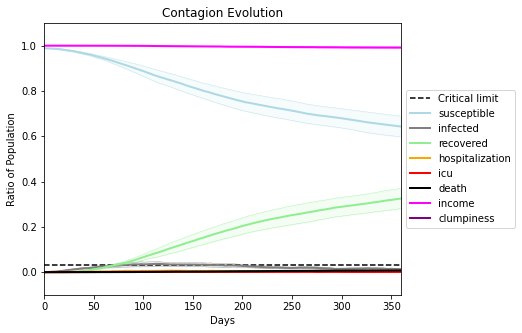

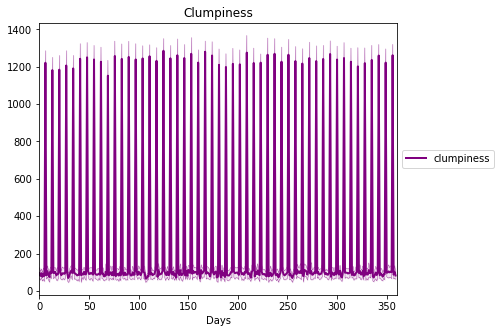

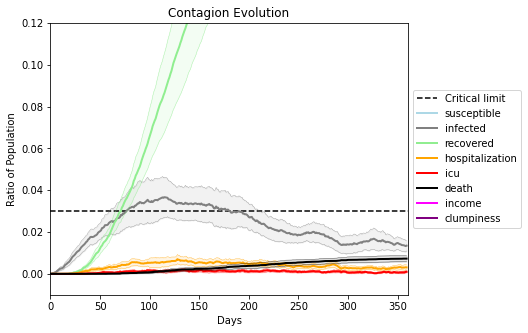

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2127, 6715, 1858, 9945, 3830, 6571, 8551, 6135, 4705, 1971, 7927, 9263, 9234, 6657, 2674, 532, 2526, 9774, 5702, 8810]
Average similarity between family members is 0.9106504906796714 at temperature -0.99
Average similarity between family and home is 0.9998451950731686 at temperature -1
Average similarity between students and their classroom is 0.7919240593293251 at temperature -0.99
Average classroom occupancy is 1.6931818181818181 and number classrooms is 176
Average similarity between workers is 0.8165452540469611 at temperature -0.99
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.8383338271299162 for kids: 0.7290606704574294
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogeneous

avg restaurant similarity 0.5474815374617161
avg restaurant similarity 0.44190462343614123
avg restaurant similarity 0.5346570539032988
avg restaurant similarity 0.4860427501945743
avg restaurant similarity 0.47484439779321935
avg restaurant similarity 0.48647523084231603
avg restaurant similarity 0.44574605114458077
avg restaurant similarity 0.4883840269481112
avg restaurant similarity 0.5289487224166556
avg restaurant similarity 0.46969132264915586
avg restaurant similarity 0.5280103645569888
avg restaurant similarity 0.5150745005431191
avg restaurant similarity 0.43821584774953976
avg restaurant similarity 0.4960858299067163
avg restaurant similarity 0.544033801795677
avg restaurant similarity 0.514794640534701
avg restaurant similarity 0.47889362007815184
avg restaurant similarity 0.522590580737478
avg restaurant similarity 0.48775511954435957
avg restaurant similarity 0.5283777880110643
avg restaurant similarity 0.4965454449768661
avg restaurant similarity 0.5133307593392492
avg r

avg restaurant similarity 0.449507597602798
avg restaurant similarity 0.508310348435958
avg restaurant similarity 0.5319156019762008
avg restaurant similarity 0.43677172967935946
avg restaurant similarity 0.47402180010134376
avg restaurant similarity 0.5509477701280773
avg restaurant similarity 0.4608729281451954
avg restaurant similarity 0.5047338098644742
avg restaurant similarity 0.5414509896077097
avg restaurant similarity 0.47157555531048684
avg restaurant similarity 0.5225595539335881
avg restaurant similarity 0.4998669089518269
avg restaurant similarity 0.5146978906289148
avg restaurant similarity 0.43859623507100837
avg restaurant similarity 0.5363719678562137
avg restaurant similarity 0.49810143319774625
avg restaurant similarity 0.4871323838356077
avg restaurant similarity 0.4772068870111647
avg restaurant similarity 0.5293307765432371
avg restaurant similarity 0.4846631108458864
avg restaurant similarity 0.44143770368789875
avg restaurant similarity 0.5048108669715942
avg re

Average similarity between workers is 0.8139447168736176 at temperature -0.99
Average office occupancy is 3.4526315789473685 and number offices is 190
Average friend similarity for adults: 0.8269133438589766 for kids: 0.7245980474889253
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5265707806408872
avg restaurant similarity 0.4764719323341785
avg restaurant similarity 0.4837478192025829
avg restaurant similarity 0.4958085525970801
avg restaurant similarity 0.5383568377775024
avg restaurant similarity 0.5108983595661728
avg restaurant similarity 0.5098972961655001
avg restaurant similarity 0.5292195469694373
avg restaurant similarity 0.4906861436752987
avg restaurant similarity 0.4727460659187727
avg restaurant similarity 0.49410836602427344
avg restaurant similarity 0.5118272055454723
avg restaurant similarity 0.5016831670270907
avg restaurant similarity 0.4910307103144268
avg restaurant similarity 0.4345558013309267
avg restaurant similarity 0.4888070374928992
avg restaurant similarity 0.5205687644651796
avg restaurant similarity 0.49605432516400816
avg restaurant similarity 0.4487885294084254
avg restaurant similarity 0.49528334288739906
avg restaurant similarity 0.4571464225721458
avg restaurant similarity 0.5053318985087697
avg res

avg restaurant similarity 0.4869366921592913
avg restaurant similarity 0.4975050699238762
avg restaurant similarity 0.49074227409629834
avg restaurant similarity 0.47339187268117017
avg restaurant similarity 0.4816194210518824
avg restaurant similarity 0.4580039926089346
avg restaurant similarity 0.4415698066527349
avg restaurant similarity 0.49667278674548787
avg restaurant similarity 0.4561958938725598
avg restaurant similarity 0.4286912908647946
avg restaurant similarity 0.43356816178201685
avg restaurant similarity 0.4518231789502379
avg restaurant similarity 0.4732444097962018
avg restaurant similarity 0.480842252710809
avg restaurant similarity 0.4911427905810941
avg restaurant similarity 0.45926335825224696
avg restaurant similarity 0.5177947808504053
avg restaurant similarity 0.4549525174364464
avg restaurant similarity 0.4850470661712358
avg restaurant similarity 0.533038032427853
avg restaurant similarity 0.4461368719951853
avg restaurant similarity 0.5092696462485832
avg res

Average similarity between workers is 0.8230545572485721 at temperature -0.99
Average office occupancy is 3.326530612244898 and number offices is 196
Average friend similarity for adults: 0.8338860738174249 for kids: 0.7221028700758273
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5095081905175679
avg restaurant similarity 0.48132231197732517
avg restaurant similarity 0.4968557709310153
avg restaurant similarity 0.5325941089058415
avg restaurant similarity 0.4769196414542034
avg restaurant similarity 0.4613679785644603
avg restaurant similarity 0.478196247061524
avg restaurant similarity 0.5324499406147417
avg restaurant similarity 0.5262888337902113
avg restaurant similarity 0.5116068173576774
avg restaurant similarity 0.4431157400701918
avg restaurant similarity 0.5133778785240536
avg restaurant similarity 0.5483230261689086
avg restaurant similarity 0.5213091409182553
avg restaurant similarity 0.5360136226109463
avg restaurant similarity 0.5215369080321524
avg restaurant similarity 0.5143938748769599
avg restaurant similarity 0.4780633642587181
avg restaurant similarity 0.5867714584685858
avg restaurant similarity 0.49611059256094187
avg restaurant similarity 0.4498669322097617
avg restaurant similarity 0.4926258183528918
avg resta

avg restaurant similarity 0.499537873538332
avg restaurant similarity 0.5242906439113865
avg restaurant similarity 0.5160589519116363
avg restaurant similarity 0.508583408574617
avg restaurant similarity 0.479159947815507
avg restaurant similarity 0.5096804677812381
avg restaurant similarity 0.5112679409742026
avg restaurant similarity 0.49232045728519114
avg restaurant similarity 0.5198971954928369
avg restaurant similarity 0.55812866856142
avg restaurant similarity 0.512441478300337
avg restaurant similarity 0.5157110637708995
avg restaurant similarity 0.48406902640927935
avg restaurant similarity 0.5057574536026511
avg restaurant similarity 0.47248880970089635
avg restaurant similarity 0.5407867610324834
avg restaurant similarity 0.4943824591128962
avg restaurant similarity 0.526211182143163
avg restaurant similarity 0.5165375559065898
avg restaurant similarity 0.48622108295250555
avg restaurant similarity 0.4670383377502969
avg restaurant similarity 0.4919546525679356
avg restauran

Average similarity between workers is 0.8056433697529525 at temperature -0.99
Average office occupancy is 3.4759358288770055 and number offices is 187
Average friend similarity for adults: 0.8247650026004274 for kids: 0.714954722633551
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.4797232682868707
avg restaurant similarity 0.4762908971033252
avg restaurant similarity 0.5091437800002117
avg restaurant similarity 0.46326686164816827
avg restaurant similarity 0.49969683577433643
avg restaurant similarity 0.5066571722142112
avg restaurant similarity 0.5130777507738968
avg restaurant similarity 0.4843466436120887
avg restaurant similarity 0.4954139758382022
avg restaurant similarity 0.4645576559837744
avg restaurant similarity 0.4601419432344867
avg restaurant similarity 0.5455820685695117
avg restaurant similarity 0.4847593775510151
avg restaurant similarity 0.5112880482863098
avg restaurant similarity 0.4783104853084735
avg restaurant similarity 0.49935340918378246
avg restaurant similarity 0.4927897361201461
avg restaurant similarity 0.44711191037397796
avg restaurant similarity 0.5184963881136234
avg restaurant similarity 0.5165746404694179
avg restaurant similarity 0.5121379747829279
avg restaurant similarity 0.48035515148810676
avg r

avg restaurant similarity 0.4914686281123496
avg restaurant similarity 0.5129489640148648
avg restaurant similarity 0.45507517297776473
avg restaurant similarity 0.4547778728869239
avg restaurant similarity 0.5007613843309207
avg restaurant similarity 0.47523859721323547
avg restaurant similarity 0.5045420756632422
avg restaurant similarity 0.48970130384510285
avg restaurant similarity 0.4833307134627318
avg restaurant similarity 0.5212449373034284
avg restaurant similarity 0.4520499442744223
avg restaurant similarity 0.5265713377674603
avg restaurant similarity 0.5048866133260199
avg restaurant similarity 0.45054952032337353
avg restaurant similarity 0.47361103953273453
avg restaurant similarity 0.49533907570226865
avg restaurant similarity 0.5529234020932811
avg restaurant similarity 0.4734251436064293
avg restaurant similarity 0.5162608768696778
avg restaurant similarity 0.458845527942554
avg restaurant similarity 0.46289059855412445
avg restaurant similarity 0.517847764422572
avg r

Average similarity between workers is 0.8233449407968151 at temperature -0.99
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.828113734902062 for kids: 0.7178870853692307
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.4872929839744113
avg restaurant similarity 0.5289750003209043
avg restaurant similarity 0.5239095988751034
avg restaurant similarity 0.5567139927383584
avg restaurant similarity 0.5160807211100499
avg restaurant similarity 0.47705931228030685
avg restaurant similarity 0.5162275717892139
avg restaurant similarity 0.5154431965525508
avg restaurant similarity 0.5478465380895393
avg restaurant similarity 0.48938843219032935
avg restaurant similarity 0.5338761951841969
avg restaurant similarity 0.4646063798162739
avg restaurant similarity 0.4926189085102863
avg restaurant similarity 0.5297734955688748
avg restaurant similarity 0.5111970090490078
avg restaurant similarity 0.4512084740211252
avg restaurant similarity 0.49399201771894846
avg restaurant similarity 0.562083681100278
avg restaurant similarity 0.5353094158678192
avg restaurant similarity 0.4979241340215389
avg restaurant similarity 0.49411328373956187
avg restaurant similarity 0.48363278604857707
avg re

avg restaurant similarity 0.5363892996127095
avg restaurant similarity 0.5145854350367681
avg restaurant similarity 0.49058363429860324
avg restaurant similarity 0.46970365239018486
avg restaurant similarity 0.4587465315082573
avg restaurant similarity 0.44898934526415163
avg restaurant similarity 0.4808264633994047
avg restaurant similarity 0.5162238163206637
avg restaurant similarity 0.5664069332123939
avg restaurant similarity 0.5040117631126697
avg restaurant similarity 0.5250520073799895
avg restaurant similarity 0.5397634480604754
avg restaurant similarity 0.4920654179682726
avg restaurant similarity 0.507395126079289
avg restaurant similarity 0.4357885936341095
avg restaurant similarity 0.526553477471707
avg restaurant similarity 0.4569225049677138
avg restaurant similarity 0.5341045326012036
avg restaurant similarity 0.5120896763202205
avg restaurant similarity 0.5155399850485555
avg restaurant similarity 0.5251813873734553
avg restaurant similarity 0.5079995971100577
avg resta

Average similarity between workers is 0.8331541196937438 at temperature -0.99
Average office occupancy is 3.38659793814433 and number offices is 194
Average friend similarity for adults: 0.8384676136217415 for kids: 0.7234890681083126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.6125197501083619
avg restaurant similarity 0.5381875954681902
avg restaurant similarity 0.4884410190626611
avg restaurant similarity 0.5335702540180773
avg restaurant similarity 0.544903149203485
avg restaurant similarity 0.5340994655723923
avg restaurant similarity 0.5019936363751567
avg restaurant similarity 0.5409218711391751
avg restaurant similarity 0.5431154853116009
avg restaurant similarity 0.5559612537953348
avg restaurant similarity 0.5392409198766902
avg restaurant similarity 0.5280527741627424
avg restaurant similarity 0.5798236374516921
avg restaurant similarity 0.5497834722094145
avg restaurant similarity 0.5116651171420497
avg restaurant similarity 0.5346232028963438
avg restaurant similarity 0.5055611953715758
avg restaurant similarity 0.5681025267698403
avg restaurant similarity 0.5312853649425078
avg restaurant similarity 0.51818238551971
avg restaurant similarity 0.5124266527601629
avg restaurant similarity 0.5371420066259139
avg restauran

avg restaurant similarity 0.5508321695142064
avg restaurant similarity 0.5038617888718891
avg restaurant similarity 0.6180579109669446
avg restaurant similarity 0.5331727009655081
avg restaurant similarity 0.507692352197067
avg restaurant similarity 0.5410186551937832
avg restaurant similarity 0.517938261822731
avg restaurant similarity 0.522251351012271
avg restaurant similarity 0.5154998291987611
avg restaurant similarity 0.5529499867590074
avg restaurant similarity 0.5469323297548739
avg restaurant similarity 0.6001742348925277
avg restaurant similarity 0.5773429650002296
avg restaurant similarity 0.4949773818854404
avg restaurant similarity 0.5250372519211136
avg restaurant similarity 0.5384132894237406
avg restaurant similarity 0.5839736360153558
avg restaurant similarity 0.4566496424854431
avg restaurant similarity 0.5922744842130596
avg restaurant similarity 0.5385335245438602
avg restaurant similarity 0.5457958726129488
avg restaurant similarity 0.5850144519892571
avg restauran

Average similarity between workers is 0.8197117917518411 at temperature -0.99
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.8323251181423083 for kids: 0.710999801773491
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people alloc

avg restaurant similarity 0.44491219944577676
avg restaurant similarity 0.5179054156246747
avg restaurant similarity 0.5025662992843781
avg restaurant similarity 0.47724753905281664
avg restaurant similarity 0.5101996610706828
avg restaurant similarity 0.4952480295877164
avg restaurant similarity 0.49204275102416395
avg restaurant similarity 0.5049088975739302
avg restaurant similarity 0.5130873204152301
avg restaurant similarity 0.5231608545030116
avg restaurant similarity 0.5119305861383507
avg restaurant similarity 0.43714995887600056
avg restaurant similarity 0.44900008412646913
avg restaurant similarity 0.4980439919945448
avg restaurant similarity 0.4850554815425934
avg restaurant similarity 0.49134731576888857
avg restaurant similarity 0.513036425253085
avg restaurant similarity 0.5207044298947147
avg restaurant similarity 0.46339897443572176
avg restaurant similarity 0.5230959942671013
avg restaurant similarity 0.42276545420396483
avg restaurant similarity 0.48541801079230273
av

avg restaurant similarity 0.5214299304911958
avg restaurant similarity 0.41915557704873135
avg restaurant similarity 0.44116723683600634
avg restaurant similarity 0.4527183366727639
avg restaurant similarity 0.4885120047126185
avg restaurant similarity 0.4942548636684038
avg restaurant similarity 0.442269149351528
avg restaurant similarity 0.5153674148953733
avg restaurant similarity 0.4846192720677589
avg restaurant similarity 0.48592752016430074
avg restaurant similarity 0.4833216455215635
avg restaurant similarity 0.49444967648323124
avg restaurant similarity 0.473490630820066
avg restaurant similarity 0.3945520990654384
avg restaurant similarity 0.4496492131954179
avg restaurant similarity 0.5104605559078738
avg restaurant similarity 0.5002003755215754
avg restaurant similarity 0.454538591424176
avg restaurant similarity 0.4375805792846899
avg restaurant similarity 0.4592435224761983
avg restaurant similarity 0.4518202122951896
avg restaurant similarity 0.47881673238122097
avg rest

Average similarity between workers is 0.8100892532689676 at temperature -0.99
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.8323338111010083 for kids: 0.7127393134990351
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.5422138298140105
avg restaurant similarity 0.5275457207118747
avg restaurant similarity 0.5517805320428185
avg restaurant similarity 0.4684983793396746
avg restaurant similarity 0.5300536296829768
avg restaurant similarity 0.5016494356851158
avg restaurant similarity 0.5073863004264906
avg restaurant similarity 0.5297506967529236
avg restaurant similarity 0.5393400372273851
avg restaurant similarity 0.4539562003490299
avg restaurant similarity 0.548141754062688
avg restaurant similarity 0.4931947053460584
avg restaurant similarity 0.4781430650628369
avg restaurant similarity 0.5056319443371604
avg restaurant similarity 0.5058725553378688
avg restaurant similarity 0.5142784583100397
avg restaurant similarity 0.4965299925131131
avg restaurant similarity 0.5241501002460748
avg restaurant similarity 0.49359764039951914
avg restaurant similarity 0.5059241225879212
avg restaurant similarity 0.5010419818216113
avg restaurant similarity 0.5712612567849276
avg restau

avg restaurant similarity 0.4258424893619584
avg restaurant similarity 0.4896114550929619
avg restaurant similarity 0.4786858272820145
avg restaurant similarity 0.504087406472024
avg restaurant similarity 0.49362154640178885
avg restaurant similarity 0.4844535155408004
avg restaurant similarity 0.5480742411945754
avg restaurant similarity 0.47614466172841696
avg restaurant similarity 0.47244372332387474
avg restaurant similarity 0.4903882444903767
avg restaurant similarity 0.5305286624913526
avg restaurant similarity 0.50279253359072
avg restaurant similarity 0.5247907549206655
avg restaurant similarity 0.47881068816378336
avg restaurant similarity 0.5431097514558336
avg restaurant similarity 0.5420492829723217
avg restaurant similarity 0.5171030894310616
avg restaurant similarity 0.48728053368168234
avg restaurant similarity 0.4346938797457476
avg restaurant similarity 0.5008623389842335
avg restaurant similarity 0.5169850744160567
avg restaurant similarity 0.533192354052307
avg resta

Average similarity between workers is 0.8246315889685889 at temperature -0.99
Average office occupancy is 3.4895833333333335 and number offices is 192
Average friend similarity for adults: 0.836521314412055 for kids: 0.7175505095133751
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.5293169909470242
avg restaurant similarity 0.48860646753582426
avg restaurant similarity 0.48967228241158917
avg restaurant similarity 0.4677784814876382
avg restaurant similarity 0.5169200662400425
avg restaurant similarity 0.4827797106727592
avg restaurant similarity 0.43978284154531394
avg restaurant similarity 0.4650908635166463
avg restaurant similarity 0.5110289757460781
avg restaurant similarity 0.48670901957693424
avg restaurant similarity 0.4910391309141145
avg restaurant similarity 0.45296388859971015
avg restaurant similarity 0.5188041311516923
avg restaurant similarity 0.49712333329434316
avg restaurant similarity 0.4734614503792415
avg restaurant similarity 0.5096578221620559
avg restaurant similarity 0.45051886708083944
avg restaurant similarity 0.5218565411441163
avg restaurant similarity 0.5098025507082395
avg restaurant similarity 0.461203347610449
avg restaurant similarity 0.4340497027674659
avg restaurant similarity 0.5132398781800975
avg 

avg restaurant similarity 0.49515218587635224
avg restaurant similarity 0.4938374984757003
avg restaurant similarity 0.46439794559086495
avg restaurant similarity 0.47515674330094076
avg restaurant similarity 0.43201303774574673
avg restaurant similarity 0.47167927598860604
avg restaurant similarity 0.4050720948977431
avg restaurant similarity 0.453686837161211
avg restaurant similarity 0.49303521550156354
avg restaurant similarity 0.523783346520833
avg restaurant similarity 0.5268373323460882
avg restaurant similarity 0.48408399677761693
avg restaurant similarity 0.44819444476202125
avg restaurant similarity 0.4672210900902664
avg restaurant similarity 0.500618937527757
avg restaurant similarity 0.5154261531666978
avg restaurant similarity 0.4790391685052528
avg restaurant similarity 0.5055966802544566
avg restaurant similarity 0.4939106064553968
avg restaurant similarity 0.5080864518535777
avg restaurant similarity 0.5314825675574616
avg restaurant similarity 0.5037725911449582
avg r

Average similarity between workers is 0.8391418093198341 at temperature -0.99
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.8451664778367197 for kids: 0.728641841794919
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 pe

avg restaurant similarity 0.4788314408057684
avg restaurant similarity 0.5109052469154447
avg restaurant similarity 0.5296615451817738
avg restaurant similarity 0.5206661141122421
avg restaurant similarity 0.4757113623716645
avg restaurant similarity 0.48228199670787175
avg restaurant similarity 0.5333961045815433
avg restaurant similarity 0.5385531218548308
avg restaurant similarity 0.5268852578210904
avg restaurant similarity 0.48225331394997395
avg restaurant similarity 0.608348332639267
avg restaurant similarity 0.5454062096394905
avg restaurant similarity 0.5200685305203528
avg restaurant similarity 0.5594227044310351
avg restaurant similarity 0.5925206054178155
avg restaurant similarity 0.5017734147981588
avg restaurant similarity 0.542430268387647
avg restaurant similarity 0.562955835967393
avg restaurant similarity 0.5169139370981729
avg restaurant similarity 0.5093832813840308
avg restaurant similarity 0.5171920532047405
avg restaurant similarity 0.5274632106377859
avg restaur

avg restaurant similarity 0.4789676233089485
avg restaurant similarity 0.5077148853220033
avg restaurant similarity 0.5214647069598677
avg restaurant similarity 0.5282168927255138
avg restaurant similarity 0.5233534327111148
avg restaurant similarity 0.4890463911401095
avg restaurant similarity 0.5589463283895657
avg restaurant similarity 0.48223342349855447
avg restaurant similarity 0.4839690821068248
avg restaurant similarity 0.49321616417406655
avg restaurant similarity 0.4892741490716781
avg restaurant similarity 0.5155693565931845
avg restaurant similarity 0.5031940667622821
avg restaurant similarity 0.534071022990809
avg restaurant similarity 0.5444345339838147
avg restaurant similarity 0.525685294686742
avg restaurant similarity 0.47706754470375273
avg restaurant similarity 0.5123458650369741
avg restaurant similarity 0.531177006032593
avg restaurant similarity 0.528596950966606
avg restaurant similarity 0.549870503077772
avg restaurant similarity 0.5654361675619821
avg restaura

Average similarity between workers is 0.8243289916090527 at temperature -0.99
Average office occupancy is 3.5925925925925926 and number offices is 189
Average friend similarity for adults: 0.847922803114234 for kids: 0.7212606253461702
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5446094915080194
avg restaurant similarity 0.5106793084378636
avg restaurant similarity 0.4831132469533484
avg restaurant similarity 0.5059684408221877
avg restaurant similarity 0.5165120777786588
avg restaurant similarity 0.5171881002224247
avg restaurant similarity 0.5123292957440965
avg restaurant similarity 0.4622298564443032
avg restaurant similarity 0.5433878091884583
avg restaurant similarity 0.5799337881932809
avg restaurant similarity 0.4574778664710752
avg restaurant similarity 0.49014795261216443
avg restaurant similarity 0.4938303709620844
avg restaurant similarity 0.5596456072152307
avg restaurant similarity 0.5518725148944108
avg restaurant similarity 0.5336447347270911
avg restaurant similarity 0.4945017492284068
avg restaurant similarity 0.5381889900948836
avg restaurant similarity 0.5082131824036283
avg restaurant similarity 0.5173669593521445
avg restaurant similarity 0.547474911134397
avg restaurant similarity 0.5139828617887889
avg restau

avg restaurant similarity 0.4773302085425418
avg restaurant similarity 0.5596486433332464
avg restaurant similarity 0.49811737052601013
avg restaurant similarity 0.5099526398254127
avg restaurant similarity 0.46646431842249003
avg restaurant similarity 0.5425414225513921
avg restaurant similarity 0.46141418027430253
avg restaurant similarity 0.49339607782186506
avg restaurant similarity 0.5207022346319842
avg restaurant similarity 0.5271480202079301
avg restaurant similarity 0.5096984139594751
avg restaurant similarity 0.4829368142755872
avg restaurant similarity 0.5217335052011134
avg restaurant similarity 0.5074732608225527
avg restaurant similarity 0.4798882979103221
avg restaurant similarity 0.5306282414295519
avg restaurant similarity 0.47565287583614735
avg restaurant similarity 0.5109149459780125
avg restaurant similarity 0.4813592318703516
avg restaurant similarity 0.4956518501312831
avg restaurant similarity 0.5405996272595953
avg restaurant similarity 0.5550347225025232
avg r

Average similarity between workers is 0.8276677056921897 at temperature -0.99
Average office occupancy is 3.4789473684210526 and number offices is 190
Average friend similarity for adults: 0.8388468231123248 for kids: 0.7258313299729199
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.495526048816048
avg restaurant similarity 0.4930698304089915
avg restaurant similarity 0.4927480122630401
avg restaurant similarity 0.5271163209562498
avg restaurant similarity 0.5038580321687777
avg restaurant similarity 0.48267648542553043
avg restaurant similarity 0.43239387049890454
avg restaurant similarity 0.5164178070931156
avg restaurant similarity 0.5343293593238707
avg restaurant similarity 0.5234636072552802
avg restaurant similarity 0.4867888536834745
avg restaurant similarity 0.5306738762550616
avg restaurant similarity 0.5877233640265607
avg restaurant similarity 0.5092782876958342
avg restaurant similarity 0.5525461991613604
avg restaurant similarity 0.5197795760027943
avg restaurant similarity 0.521488811329203
avg restaurant similarity 0.4805513748584246
avg restaurant similarity 0.522066348866745
avg restaurant similarity 0.4958363334725112
avg restaurant similarity 0.559061786839304
avg restaurant similarity 0.46610309734558936
avg restaur

avg restaurant similarity 0.5386761282087907
avg restaurant similarity 0.47451339008960663
avg restaurant similarity 0.5621220785927868
avg restaurant similarity 0.4923331546246534
avg restaurant similarity 0.534832581399611
avg restaurant similarity 0.4704356468113087
avg restaurant similarity 0.5212547460685928
avg restaurant similarity 0.5223990018814868
avg restaurant similarity 0.48353493459413177
avg restaurant similarity 0.5163827624887589
avg restaurant similarity 0.5510575310599501
avg restaurant similarity 0.563195306578834
avg restaurant similarity 0.49679089470973437
avg restaurant similarity 0.42247753877324185
avg restaurant similarity 0.5080124597140712
avg restaurant similarity 0.5009935458599413
avg restaurant similarity 0.49832545820804336
avg restaurant similarity 0.5362875161408827
avg restaurant similarity 0.5335381292715252
avg restaurant similarity 0.4995700926687774
avg restaurant similarity 0.5190137177196648
avg restaurant similarity 0.5105260847292447
avg res

Average similarity between workers is 0.8132557206586959 at temperature -0.99
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults: 0.8295230591889697 for kids: 0.6967790832633278
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6

avg restaurant similarity 0.46786422378833037
avg restaurant similarity 0.4892511958100586
avg restaurant similarity 0.5130322553093435
avg restaurant similarity 0.5072402940176217
avg restaurant similarity 0.5276970593462672
avg restaurant similarity 0.47595353682184144
avg restaurant similarity 0.48872420483208034
avg restaurant similarity 0.4709314777460407
avg restaurant similarity 0.514867202823007
avg restaurant similarity 0.48501313090089077
avg restaurant similarity 0.4881607540861436
avg restaurant similarity 0.5234563873640001
avg restaurant similarity 0.5117820631953859
avg restaurant similarity 0.4705491855030982
avg restaurant similarity 0.4911043969974795
avg restaurant similarity 0.44908368973909757
avg restaurant similarity 0.5329650393852158
avg restaurant similarity 0.4847460188196084
avg restaurant similarity 0.489010515694386
avg restaurant similarity 0.46199153756767647
avg restaurant similarity 0.4724492528928704
avg restaurant similarity 0.47012932833050697
avg r

avg restaurant similarity 0.5056913214145562
avg restaurant similarity 0.5067922664016273
avg restaurant similarity 0.5134245144427815
avg restaurant similarity 0.4776604862073863
avg restaurant similarity 0.5364901389857352
avg restaurant similarity 0.5172244121823906
avg restaurant similarity 0.5038998672527588
avg restaurant similarity 0.45470446556049954
avg restaurant similarity 0.5095325738984419
avg restaurant similarity 0.5122291424170242
avg restaurant similarity 0.5220296425932426
avg restaurant similarity 0.5107515225559379
avg restaurant similarity 0.42691486322266337
avg restaurant similarity 0.5033253250113106
avg restaurant similarity 0.5077795455471055
avg restaurant similarity 0.4756257741761035
avg restaurant similarity 0.5178393271617167
avg restaurant similarity 0.5172801276870997
avg restaurant similarity 0.527956195278502
avg restaurant similarity 0.4887135669311112
avg restaurant similarity 0.46191853814859435
avg restaurant similarity 0.46096886915871255
avg res

Average similarity between students and their classroom is 0.7660145026900274 at temperature -0.99
Average classroom occupancy is 1.670731707317073 and number classrooms is 164
Average similarity between workers is 0.8148667488820138 at temperature -0.99
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.8311389165289133 for kids: 0.6972787765637009
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated

avg restaurant similarity 0.48921281838745967
avg restaurant similarity 0.5017083301613708
avg restaurant similarity 0.5021343963332344
avg restaurant similarity 0.4884989648375158
avg restaurant similarity 0.46375289917592394
avg restaurant similarity 0.4960847234616824
avg restaurant similarity 0.46165427275875476
avg restaurant similarity 0.5396864614843874
avg restaurant similarity 0.45807450516017506
avg restaurant similarity 0.5447699023654949
avg restaurant similarity 0.5071413891186597
avg restaurant similarity 0.5124435664200332
avg restaurant similarity 0.5008465855164991
avg restaurant similarity 0.47454629189302266
avg restaurant similarity 0.5354316193497521
avg restaurant similarity 0.5067334786135201
avg restaurant similarity 0.5617994144596219
avg restaurant similarity 0.5132149735727282
avg restaurant similarity 0.4936475045647147
avg restaurant similarity 0.49378199664126116
avg restaurant similarity 0.4563419315171764
avg restaurant similarity 0.4814370178282368
avg 

avg restaurant similarity 0.465946471766205
avg restaurant similarity 0.5249150101838247
avg restaurant similarity 0.5027705518945619
avg restaurant similarity 0.48069388800220336
avg restaurant similarity 0.5292862943826411
avg restaurant similarity 0.5035564012111766
avg restaurant similarity 0.4363364210196488
avg restaurant similarity 0.45758758640879427
avg restaurant similarity 0.42211740501490047
avg restaurant similarity 0.4904961889796108
avg restaurant similarity 0.450707313398115
avg restaurant similarity 0.48988076865438096
avg restaurant similarity 0.48338409276926086
avg restaurant similarity 0.5201154818825536
avg restaurant similarity 0.5047230727746695
avg restaurant similarity 0.5485183100578346
avg restaurant similarity 0.5072538845847739
avg restaurant similarity 0.5444792338275823
avg restaurant similarity 0.5099610273414176
avg restaurant similarity 0.5084445242099753
avg restaurant similarity 0.48426655489519554
avg restaurant similarity 0.47136176216277625
avg r

Average similarity between students and their classroom is 0.7710487234532154 at temperature -0.99
Average classroom occupancy is 1.691860465116279 and number classrooms is 172
Average similarity between workers is 0.8117697553556938 at temperature -0.99
Average office occupancy is 3.295336787564767 and number offices is 193
Average friend similarity for adults: 0.8250146397240649 for kids: 0.7213842558892339
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in t

avg restaurant similarity 0.43500148026441837
avg restaurant similarity 0.4900304821084716
avg restaurant similarity 0.5228315996543041
avg restaurant similarity 0.4581323260641294
avg restaurant similarity 0.5299979745719108
avg restaurant similarity 0.5568425951394441
avg restaurant similarity 0.5128069278003871
avg restaurant similarity 0.47356834911847484
avg restaurant similarity 0.5346189237897111
avg restaurant similarity 0.5482780210843101
avg restaurant similarity 0.5125203770066047
avg restaurant similarity 0.5176638861306682
avg restaurant similarity 0.46888312397240106
avg restaurant similarity 0.5205824418845166
avg restaurant similarity 0.510178790723088
avg restaurant similarity 0.5118260545335848
avg restaurant similarity 0.4628247020737305
avg restaurant similarity 0.527581182753851
avg restaurant similarity 0.43989701439303114
avg restaurant similarity 0.5019413145144613
avg restaurant similarity 0.5097651561208215
avg restaurant similarity 0.45370204592530217
avg res

avg restaurant similarity 0.4929166368191018
avg restaurant similarity 0.5209940131070192
avg restaurant similarity 0.5488055366081246
avg restaurant similarity 0.49212556782735545
avg restaurant similarity 0.5074149399089933
avg restaurant similarity 0.5354299582036209
avg restaurant similarity 0.5181307933574014
avg restaurant similarity 0.5177014290917165
avg restaurant similarity 0.5452494524086808
avg restaurant similarity 0.47973935550289354
avg restaurant similarity 0.5064692466705125
avg restaurant similarity 0.44850210073461716
avg restaurant similarity 0.46640060655678967
avg restaurant similarity 0.5104057066213654
avg restaurant similarity 0.49198783484552305
avg restaurant similarity 0.46233366338049897
avg restaurant similarity 0.5372931865686544
avg restaurant similarity 0.5291115416091045
avg restaurant similarity 0.5262010001044753
avg restaurant similarity 0.4331916935819404
avg restaurant similarity 0.4733976811978802
avg restaurant similarity 0.5258984075863352
avg 

Average similarity between students and their classroom is 0.7832366554704402 at temperature -0.99
Average classroom occupancy is 1.7298850574712643 and number classrooms is 174
Average similarity between workers is 0.8225472900043084 at temperature -0.99
Average office occupancy is 3.296875 and number offices is 192
Average friend similarity for adults: 0.8165470100244013 for kids: 0.7118455661070043
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this dist

avg restaurant similarity 0.4576345998405122
avg restaurant similarity 0.4750634310575511
avg restaurant similarity 0.5156532994784258
avg restaurant similarity 0.4996226517988338
avg restaurant similarity 0.4714552928768927
avg restaurant similarity 0.49812627657899033
avg restaurant similarity 0.4937554593897396
avg restaurant similarity 0.5076056876634035
avg restaurant similarity 0.403796766697059
avg restaurant similarity 0.5391919600990788
avg restaurant similarity 0.5626671230871023
avg restaurant similarity 0.4706451314464324
avg restaurant similarity 0.5047263641399836
avg restaurant similarity 0.512891347073476
avg restaurant similarity 0.5291553087560187
avg restaurant similarity 0.5142509035356796
avg restaurant similarity 0.43974790546387277
avg restaurant similarity 0.5240517816146812
avg restaurant similarity 0.48056287150756843
avg restaurant similarity 0.4728666317407366
avg restaurant similarity 0.5751143983221793
avg restaurant similarity 0.5637790570401533
avg resta

avg restaurant similarity 0.49286132791525383
avg restaurant similarity 0.5194338652278039
avg restaurant similarity 0.5457372218190011
avg restaurant similarity 0.5090067190524327
avg restaurant similarity 0.4652059626048878
avg restaurant similarity 0.5617955385753851
avg restaurant similarity 0.5409779067467936
avg restaurant similarity 0.4944676296270063
avg restaurant similarity 0.4767129792079476
avg restaurant similarity 0.5334195739521972
avg restaurant similarity 0.4409311860327014
avg restaurant similarity 0.49282933980062155
avg restaurant similarity 0.5527144184754037
avg restaurant similarity 0.4525897612602999
avg restaurant similarity 0.5715209251361386
avg restaurant similarity 0.5049906589261277
avg restaurant similarity 0.47916822885673316
avg restaurant similarity 0.5196542463920528
avg restaurant similarity 0.5369490192186711
avg restaurant similarity 0.48879040920479705
avg restaurant similarity 0.461319451288368
avg restaurant similarity 0.5561764626326972
avg res

Average similarity between workers is 0.8143559844520896 at temperature -0.99
Average office occupancy is 3.3076923076923075 and number offices is 195
Average friend similarity for adults: 0.8195179016974923 for kids: 0.725545291927109
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peo

avg restaurant similarity 0.4761941709319575
avg restaurant similarity 0.47549483355179495
avg restaurant similarity 0.5197904746471235
avg restaurant similarity 0.4912602843524163
avg restaurant similarity 0.4605271908207991
avg restaurant similarity 0.46338367981330364
avg restaurant similarity 0.4625020836316644
avg restaurant similarity 0.4888037816681707
avg restaurant similarity 0.4952571468183809
avg restaurant similarity 0.5028983240475267
avg restaurant similarity 0.5087149082195248
avg restaurant similarity 0.5531039853588907
avg restaurant similarity 0.48765797861270954
avg restaurant similarity 0.5164402728500623
avg restaurant similarity 0.49518651708073463
avg restaurant similarity 0.5646392111263301
avg restaurant similarity 0.5209693220357686
avg restaurant similarity 0.47305763287912084
avg restaurant similarity 0.5019070823899052
avg restaurant similarity 0.5124572605795219
avg restaurant similarity 0.5016947869816324
avg restaurant similarity 0.4987266962061427
avg r

avg restaurant similarity 0.4422681516546166
avg restaurant similarity 0.44800002851506854
avg restaurant similarity 0.502681876843107
avg restaurant similarity 0.4436369581840091
avg restaurant similarity 0.5325995478830157
avg restaurant similarity 0.5007467948609788
avg restaurant similarity 0.4916291359651502
avg restaurant similarity 0.4696540954875152
avg restaurant similarity 0.4673410860713059
avg restaurant similarity 0.4552095918701626
avg restaurant similarity 0.4943123022820416
avg restaurant similarity 0.5038856701120898
avg restaurant similarity 0.5245000059183949
avg restaurant similarity 0.518756086784648
avg restaurant similarity 0.4920062670875649
avg restaurant similarity 0.47800819976007763
avg restaurant similarity 0.522010685917023
avg restaurant similarity 0.5207149411524893
avg restaurant similarity 0.5227285326550408
avg restaurant similarity 0.4952285283301929
avg restaurant similarity 0.4733947008522436
avg restaurant similarity 0.5059461707915971
avg restaur

Average similarity between students and their classroom is 0.794896687467246 at temperature -0.99
Average classroom occupancy is 1.6927710843373494 and number classrooms is 166
Average similarity between workers is 0.825007579797945 at temperature -0.99
Average office occupancy is 3.38265306122449 and number offices is 196
Average friend similarity for adults: 0.8364435598218888 for kids: 0.7107069099666021
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in

avg restaurant similarity 0.44886936705185815
avg restaurant similarity 0.5171512457522857
avg restaurant similarity 0.479352269804297
avg restaurant similarity 0.51187637580375
avg restaurant similarity 0.522232244576066
avg restaurant similarity 0.5193837793162908
avg restaurant similarity 0.47387437859386533
avg restaurant similarity 0.46037118127880444
avg restaurant similarity 0.47949927718066665
avg restaurant similarity 0.4298530415593345
avg restaurant similarity 0.5355767790495299
avg restaurant similarity 0.5061447538931853
avg restaurant similarity 0.5466596867061347
avg restaurant similarity 0.5183273660749843
avg restaurant similarity 0.5004034173088303
avg restaurant similarity 0.5403316706830056
avg restaurant similarity 0.5172806690912488
avg restaurant similarity 0.5165545310831156
avg restaurant similarity 0.44955558223119796
avg restaurant similarity 0.5158821404127367
avg restaurant similarity 0.49557696759522596
avg restaurant similarity 0.5235541378726479
avg rest

avg restaurant similarity 0.5578591362887112
avg restaurant similarity 0.5067785383655211
avg restaurant similarity 0.49826976226301123
avg restaurant similarity 0.4616659806692333
avg restaurant similarity 0.49516422091308204
avg restaurant similarity 0.48166165887370926
avg restaurant similarity 0.4846071301319694
avg restaurant similarity 0.4833691626760015
avg restaurant similarity 0.5253554379821122
avg restaurant similarity 0.5207664509203913
avg restaurant similarity 0.44317665898064384
avg restaurant similarity 0.47727050698093804
avg restaurant similarity 0.4951377185901466
avg restaurant similarity 0.43992401377809287
avg restaurant similarity 0.48952852137621283
avg restaurant similarity 0.45254164302785055
avg restaurant similarity 0.4446420216293279
avg restaurant similarity 0.5024375153100535
avg restaurant similarity 0.498669710163429
avg restaurant similarity 0.517045204931562
avg restaurant similarity 0.45608366944562784
avg restaurant similarity 0.5239132027373203
avg

Average similarity between workers is 0.8307526313281658 at temperature -0.99
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.8302985321566386 for kids: 0.7198987421335588
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.4485890037323926
avg restaurant similarity 0.489583696334718
avg restaurant similarity 0.45024867528490353
avg restaurant similarity 0.4645969866320879
avg restaurant similarity 0.5326730621442711
avg restaurant similarity 0.4742049258442648
avg restaurant similarity 0.44616309467800264
avg restaurant similarity 0.47318090319065065
avg restaurant similarity 0.48851589553927477
avg restaurant similarity 0.5180974153093009
avg restaurant similarity 0.46578920198504625
avg restaurant similarity 0.4565515827582256
avg restaurant similarity 0.4954781417055759
avg restaurant similarity 0.47224684012260587
avg restaurant similarity 0.4888600504341802
avg restaurant similarity 0.4957864983245102
avg restaurant similarity 0.529384426707607
avg restaurant similarity 0.48815891151078694
avg restaurant similarity 0.4840150555155857
avg restaurant similarity 0.4585910840583039
avg restaurant similarity 0.44367440682563536
avg restaurant similarity 0.5172550462615579
avg 

avg restaurant similarity 0.46829929046807567
avg restaurant similarity 0.4849929863254669
avg restaurant similarity 0.42688651353755813
avg restaurant similarity 0.4757471465369092
avg restaurant similarity 0.46644354324922743
avg restaurant similarity 0.5099241695901369
avg restaurant similarity 0.4841263968800764
avg restaurant similarity 0.4455596190488646
avg restaurant similarity 0.43436485092739313
avg restaurant similarity 0.511179584915124
avg restaurant similarity 0.476266280844503
avg restaurant similarity 0.4666351290725213
avg restaurant similarity 0.44261752246453984
avg restaurant similarity 0.47531764408625504
avg restaurant similarity 0.47474313453570915
avg restaurant similarity 0.4799616918966666
avg restaurant similarity 0.4791276705905574
avg restaurant similarity 0.48471251532422366
avg restaurant similarity 0.49412106500473596
avg restaurant similarity 0.4885243088530482
avg restaurant similarity 0.5060144010419172
avg restaurant similarity 0.5203053774164694
avg

Average similarity between workers is 0.8336480511252704 at temperature -0.99
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.8410801903996856 for kids: 0.7330649825421397
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.5155756566958254
avg restaurant similarity 0.4938199960872849
avg restaurant similarity 0.5134801983793057
avg restaurant similarity 0.5429418220979412
avg restaurant similarity 0.5843240343415825
avg restaurant similarity 0.5079046669114443
avg restaurant similarity 0.5000606535439777
avg restaurant similarity 0.5384750790778605
avg restaurant similarity 0.46800098226188774
avg restaurant similarity 0.5368662242241513
avg restaurant similarity 0.5776942991478237
avg restaurant similarity 0.46487525442938815
avg restaurant similarity 0.505333207389619
avg restaurant similarity 0.5185374964818042
avg restaurant similarity 0.4846026075364616
avg restaurant similarity 0.5339744435793438
avg restaurant similarity 0.5073654708565345
avg restaurant similarity 0.501218687627594
avg restaurant similarity 0.49194710206810677
avg restaurant similarity 0.49461777788204586
avg restaurant similarity 0.46553818488111065
avg restaurant similarity 0.5414656367549029
avg res

avg restaurant similarity 0.5500709541524713
avg restaurant similarity 0.4373472320793432
avg restaurant similarity 0.5114736523112008
avg restaurant similarity 0.556231471772076
avg restaurant similarity 0.5588188548881178
avg restaurant similarity 0.504671578900275
avg restaurant similarity 0.5675555678591087
avg restaurant similarity 0.4449073652267148
avg restaurant similarity 0.5483210777958865
avg restaurant similarity 0.4917873989799068
avg restaurant similarity 0.5546362149208571
avg restaurant similarity 0.5448713409024681
avg restaurant similarity 0.5554406257304564
avg restaurant similarity 0.5383270786139277
avg restaurant similarity 0.5804693842548535
avg restaurant similarity 0.4634227574235314
avg restaurant similarity 0.5528769104063941
avg restaurant similarity 0.531330318043839
avg restaurant similarity 0.5208523376250122
avg restaurant similarity 0.5316154110937817
avg restaurant similarity 0.5545289162663031
avg restaurant similarity 0.5483690052193834
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

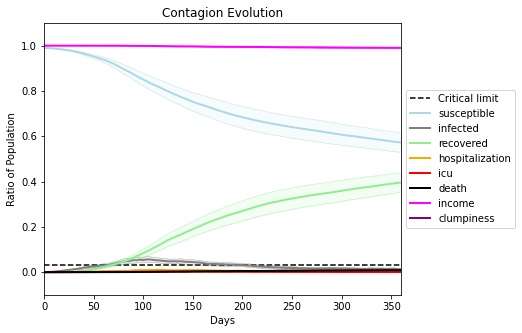

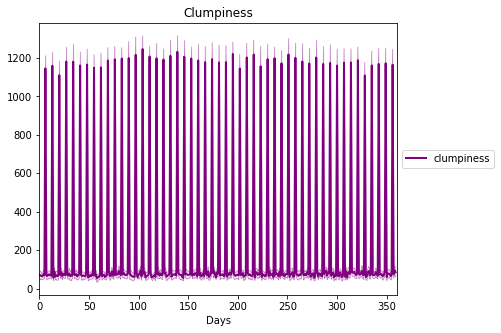

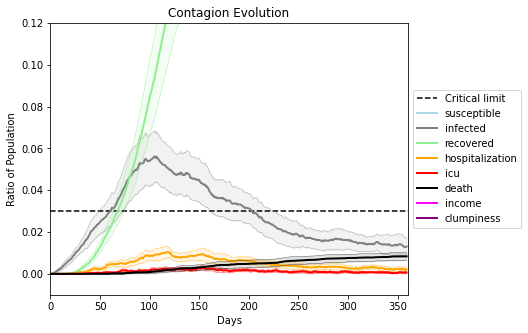

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[6692, 6771, 6092, 2235, 8222, 4268, 2493, 3839, 393, 1027, 1166, 211, 7801, 9285, 5581, 5240, 1054, 6588, 2104, 3519]
Average similarity between family members is 0.5577118669059846 at temperature -0.9
Average similarity between family and home is 0.9998525321800998 at temperature -1
Average similarity between students and their classroom is 0.23610530399838203 at temperature -0.9
Average classroom occupancy is 1.6290322580645162 and number classrooms is 186
Average similarity between workers is 0.4538689180702156 at temperature -0.9
Average office occupancy is 3.1940298507462686 and number offices is 201
Average friend similarity for adults: 0.5947705978548592 for kids: 0.5000769809603424
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.20338392307558836
avg restaurant similarity 0.14891827391542156
avg restaurant similarity 0.1495494144767255
avg restaurant similarity 0.09570183790016706
avg restaurant similarity 0.12119281827517617
avg restaurant similarity 0.1209375408671774
avg restaurant similarity 0.13865106084423023
avg restaurant similarity 0.1636213451908594
avg restaurant similarity 0.12113617870596886
avg restaurant similarity 0.10056094247854745
avg restaurant similarity 0.07122466945482911
avg restaurant similarity 0.1352677188808864
avg restaurant similarity 0.1362189086627463
avg restaurant similarity 0.12615586764597797
avg restaurant similarity 0.12070537611734708
avg restaurant similarity 0.11326964590816656
avg restaurant similarity 0.14428344587533073
avg restaurant similarity 0.116344335341527
avg restaurant similarity 0.1293266942460028
avg restaurant similarity 0.14846902931632633
avg restaurant similarity 0.11827810882654048
avg restaurant similarity 0.21923230937305

avg restaurant similarity 0.1766270627775091
avg restaurant similarity 0.15297725151490132
avg restaurant similarity 0.19214025096977305
avg restaurant similarity 0.21506703891655643
avg restaurant similarity 0.17421234362483642
avg restaurant similarity 0.18666151932382405
avg restaurant similarity 0.13125213640097805
avg restaurant similarity 0.17990737314085228
avg restaurant similarity 0.033847210138138045
avg restaurant similarity 0.1714739448469901
avg restaurant similarity 0.19716339728206767
avg restaurant similarity 0.08335584742585209
avg restaurant similarity 0.11507847664626203
avg restaurant similarity 0.12320017395851772
avg restaurant similarity 0.1248140342334878
avg restaurant similarity 0.11475115333775696
avg restaurant similarity 0.09188063573962299
avg restaurant similarity 0.14642420853391022
avg restaurant similarity 0.1429671790150733
avg restaurant similarity 0.1484942534122171
avg restaurant similarity 0.17682796531545536
avg restaurant similarity 0.1031955917

Average similarity between family members is 0.5551762489502613 at temperature -0.9
Average similarity between family and home is 0.9998719647380943 at temperature -1
Average similarity between students and their classroom is 0.24899695886258894 at temperature -0.9
Average classroom occupancy is 1.655367231638418 and number classrooms is 177
Average similarity between workers is 0.45053251073517175 at temperature -0.9
Average office occupancy is 3.253731343283582 and number offices is 201
Average friend similarity for adults: 0.6064195322523803 for kids: 0.5100863420519957
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity 0.11450888980486341
avg restaurant similarity 0.13747827657756778
avg restaurant similarity 0.1318662013169922
avg restaurant similarity 0.11071684085887326
avg restaurant similarity 0.0618172665980593
avg restaurant similarity 0.04924485310113766
avg restaurant similarity 0.11549299438544862
avg restaurant similarity 0.060302494900961026
avg restaurant similarity 0.1079609120793036
avg restaurant similarity 0.11647649027139152
avg restaurant similarity 0.0076546995095559305
avg restaurant similarity 0.1282506123206947
avg restaurant similarity 0.10162420023965214
avg restaurant similarity 0.08491144922908918
avg restaurant similarity 0.10203077608811195
avg restaurant similarity 0.1800440464297134
avg restaurant similarity 0.008752968046941359
avg restaurant similarity 0.06861234826152467
avg restaurant similarity 0.08690019982605879
avg restaurant similarity 0.1218895394326732
avg restaurant similarity 0.10011883540024824
avg restaurant similarity 0.13933483

avg restaurant similarity 0.1021930038532651
avg restaurant similarity 0.04514474602668382
avg restaurant similarity 0.12710986311262368
avg restaurant similarity 0.0804702517858178
avg restaurant similarity 0.08379520480079135
avg restaurant similarity 0.0861003544453381
avg restaurant similarity 0.13677640028270027
avg restaurant similarity 0.13758483165353114
avg restaurant similarity 0.13196579644440937
avg restaurant similarity 0.12866656480027536
avg restaurant similarity 0.09781749756047615
avg restaurant similarity 0.1312683082256644
avg restaurant similarity 0.09928748237654632
avg restaurant similarity 0.14134128184731515
avg restaurant similarity 0.1467866167338378
avg restaurant similarity 0.12949991078510698
avg restaurant similarity 0.09908589947771138
avg restaurant similarity 0.10660956928753153
avg restaurant similarity 0.11873797640201296
avg restaurant similarity 0.1847564547611958
avg restaurant similarity 0.08667788702186735
avg restaurant similarity 0.011925417490

avg restaurant similarity 0.09322828558256727
avg restaurant similarity 0.1524817911682321
Average similarity between family members is 0.5526676757865927 at temperature -0.9
Average similarity between family and home is 0.999854591875478 at temperature -1
Average similarity between students and their classroom is 0.23839141889895993 at temperature -0.9
Average classroom occupancy is 1.5901639344262295 and number classrooms is 183
Average similarity between workers is 0.4575396176334476 at temperature -0.9
Average office occupancy is 3.321608040201005 and number offices is 199
Average friend similarity for adults: 0.6008464396910436 for kids: 0.5001541865506037
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated unit

avg restaurant similarity 0.07503873544534957
avg restaurant similarity 0.07229976215052421
avg restaurant similarity 0.04758107454435483
avg restaurant similarity 0.04594973212325282
avg restaurant similarity 0.09932649224093054
avg restaurant similarity 0.0409949154428506
avg restaurant similarity 0.04834650012191619
avg restaurant similarity 0.07928819727689791
avg restaurant similarity 0.002213876202168872
avg restaurant similarity 0.053321786803717866
avg restaurant similarity 0.07570160362095996
avg restaurant similarity 0.07436128034293385
avg restaurant similarity 0.057002959455608064
avg restaurant similarity -0.010199684910681637
avg restaurant similarity 0.025672739032465395
avg restaurant similarity 0.05959133695706462
avg restaurant similarity 0.07598489719737533
avg restaurant similarity 0.06468532332105859
avg restaurant similarity 0.09376347267601065
avg restaurant similarity 0.06814799255948217
avg restaurant similarity 0.06304561604016265
avg restaurant similarity 0.0

avg restaurant similarity 0.016794100699868298
avg restaurant similarity 0.09848919646611562
avg restaurant similarity 0.1171061256161136
avg restaurant similarity 0.024757323419518015
avg restaurant similarity 0.07740823593888477
avg restaurant similarity 0.004233740009448814
avg restaurant similarity 0.09309651633295939
avg restaurant similarity 0.06591781987995665
avg restaurant similarity 0.10220976720630014
avg restaurant similarity 0.007176991044836961
avg restaurant similarity 0.02392595230643413
avg restaurant similarity 0.05060958430779383
avg restaurant similarity 0.11127461109571452
avg restaurant similarity 0.004421830816750664
avg restaurant similarity 0.11409407984776655
avg restaurant similarity 0.13769123846491838
avg restaurant similarity 0.04455146608032434
avg restaurant similarity 0.036346167223361994
avg restaurant similarity 0.11657421131549833
avg restaurant similarity 0.019705502352950627
avg restaurant similarity 0.12649202991576958
avg restaurant similarity 0.

avg restaurant similarity 0.055175714932308766
avg restaurant similarity 0.06797332718126209
avg restaurant similarity 0.052216624990371364
avg restaurant similarity 0.04459291095089761
Average similarity between family members is 0.5498974642984682 at temperature -0.9
Average similarity between family and home is 0.9998549996280132 at temperature -1
Average similarity between students and their classroom is 0.26904015234555306 at temperature -0.9
Average classroom occupancy is 1.6129032258064515 and number classrooms is 186
Average similarity between workers is 0.4508977527042734 at temperature -0.9
Average office occupancy is 3.3520408163265305 and number offices is 196
Average friend similarity for adults: 0.5950689996836598 for kids: 0.5125387769592844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.042530007150578635
avg restaurant similarity 0.0834493395629192
avg restaurant similarity 0.14459595263452546
avg restaurant similarity 0.06170482051020868
avg restaurant similarity 0.2080728383809819
avg restaurant similarity 0.07241936990315745
avg restaurant similarity 0.058301916704925454
avg restaurant similarity 0.157634429105172
avg restaurant similarity 0.08735437279504613
avg restaurant similarity 0.033349257720132586
avg restaurant similarity 0.12193915645412232
avg restaurant similarity 0.18516179957687762
avg restaurant similarity 0.15517827666187556
avg restaurant similarity 0.11795732452991485
avg restaurant similarity 0.009458261896726284
avg restaurant similarity 0.12481140751845758
avg restaurant similarity 0.06454203026021847
avg restaurant similarity 0.1554060556495082
avg restaurant similarity 0.12395745047042517
avg restaurant similarity 0.10176306288945319
avg restaurant similarity 0.1009109407395305
avg restaurant similarity 0.11271350

avg restaurant similarity 0.10836304085514627
avg restaurant similarity 0.05565681786603116
avg restaurant similarity 0.047934363190570324
avg restaurant similarity 0.15396379812149913
avg restaurant similarity 0.1557439209919244
avg restaurant similarity 0.106980377841925
avg restaurant similarity 0.10054127856271344
avg restaurant similarity 0.043290326147314026
avg restaurant similarity 0.0459683854066583
avg restaurant similarity 0.11931512404194503
avg restaurant similarity 0.16503595296366283
avg restaurant similarity 0.12602387584682617
avg restaurant similarity 0.11161005238225301
avg restaurant similarity 0.098132622162554
avg restaurant similarity 0.13529737718150803
avg restaurant similarity 0.1387760909604788
avg restaurant similarity 0.10010068885159698
avg restaurant similarity 0.12064805979351924
avg restaurant similarity 0.11590704074861079
avg restaurant similarity 0.13411112641092016
avg restaurant similarity 0.06986615699074573
avg restaurant similarity 0.10169588255

avg restaurant similarity 0.09807795743713679
avg restaurant similarity 0.13242157536726365
Average similarity between family members is 0.5590699422586352 at temperature -0.9
Average similarity between family and home is 0.999857477573965 at temperature -1
Average similarity between students and their classroom is 0.2551118108332205 at temperature -0.9
Average classroom occupancy is 1.6067415730337078 and number classrooms is 178
Average similarity between workers is 0.4414682017528448 at temperature -0.9
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.5976265802749755 for kids: 0.501579299143872
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated unit

avg restaurant similarity 0.09464768704790927
avg restaurant similarity 0.08360936347701727
avg restaurant similarity 0.06986597152914058
avg restaurant similarity 0.1694626248397615
avg restaurant similarity 0.1304870290897411
avg restaurant similarity 0.0128045571458856
avg restaurant similarity 0.10397574822542116
avg restaurant similarity 0.12090183109719428
avg restaurant similarity 0.07696022367391239
avg restaurant similarity 0.08705012659025789
avg restaurant similarity 0.096989075024257
avg restaurant similarity 0.14332305954163857
avg restaurant similarity 0.08597209819685314
avg restaurant similarity 0.09177376664417426
avg restaurant similarity 0.06882548917342547
avg restaurant similarity 0.040462627608267826
avg restaurant similarity 0.13305470313002515
avg restaurant similarity 0.07012483156654302
avg restaurant similarity 0.0870250128157787
avg restaurant similarity 0.10130677411703863
avg restaurant similarity 0.10874757501234987
avg restaurant similarity 0.12934718946

avg restaurant similarity 0.10235270765869903
avg restaurant similarity 0.09549053598559484
avg restaurant similarity 0.12418480706129323
avg restaurant similarity 0.148811450509959
avg restaurant similarity 0.17260220693049905
avg restaurant similarity 0.10143281215934649
avg restaurant similarity 0.1156858411482885
avg restaurant similarity 0.12062435102840172
avg restaurant similarity 0.13978720927567798
avg restaurant similarity 0.1676158326772603
avg restaurant similarity 0.04177109904178719
avg restaurant similarity 0.09746023843205595
avg restaurant similarity 0.020149885821818734
avg restaurant similarity 0.03894821375532755
avg restaurant similarity 0.09165749198583797
avg restaurant similarity 0.10626975381770054
avg restaurant similarity 0.10001277784829504
avg restaurant similarity 0.12437641642442394
avg restaurant similarity 0.16131264611147317
avg restaurant similarity 0.12062028067457323
avg restaurant similarity 0.1332104999627067
avg restaurant similarity 0.1167717213

avg restaurant similarity 0.09228666509246417
avg restaurant similarity 0.07410606471717662
Average similarity between family members is 0.5526723809153017 at temperature -0.9
Average similarity between family and home is 0.9998435404417662 at temperature -1
Average similarity between students and their classroom is 0.2628544037822398 at temperature -0.9
Average classroom occupancy is 1.5988372093023255 and number classrooms is 172
Average similarity between workers is 0.4483135977472148 at temperature -0.9
Average office occupancy is 3.371287128712871 and number offices is 202
Average friend similarity for adults: 0.6000251763618514 for kids: 0.4926217507456519
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated uni

avg restaurant similarity 0.06406298257782762
avg restaurant similarity 0.11150854782047935
avg restaurant similarity 0.12504617826570033
avg restaurant similarity 0.05824606657367282
avg restaurant similarity 0.05619917911843083
avg restaurant similarity 0.05177675091474701
avg restaurant similarity 0.04993604339217924
avg restaurant similarity 0.08308971433730246
avg restaurant similarity 0.03702312609100366
avg restaurant similarity 0.14542416136193187
avg restaurant similarity 0.05157428223105886
avg restaurant similarity 0.1308259644334298
avg restaurant similarity 0.03327773599140352
avg restaurant similarity -0.00825168235251169
avg restaurant similarity 0.07206643294127893
avg restaurant similarity 0.04512561584638456
avg restaurant similarity 0.06155582228681338
avg restaurant similarity 0.026328809012417367
avg restaurant similarity 0.12160858562022586
avg restaurant similarity 0.10011063777447934
avg restaurant similarity 0.09566719604047136
avg restaurant similarity 0.08434

avg restaurant similarity 0.09314368624006762
avg restaurant similarity 0.04679816751784015
avg restaurant similarity 0.02805049153979374
avg restaurant similarity 0.10631904929085122
avg restaurant similarity 0.1346376974505538
avg restaurant similarity 0.12077302437453352
avg restaurant similarity 0.09081365121154321
avg restaurant similarity 0.05211949796251436
avg restaurant similarity 0.049718277725635904
avg restaurant similarity 0.07270649153073545
avg restaurant similarity 0.06872771913488188
avg restaurant similarity 0.09121572066128002
avg restaurant similarity 0.1290956463690789
avg restaurant similarity 0.03274552733146784
avg restaurant similarity 0.07992571601710192
avg restaurant similarity 0.09423836619146402
avg restaurant similarity 0.05499107891697865
avg restaurant similarity 0.0813585175229912
avg restaurant similarity 0.06365788783423358
avg restaurant similarity 0.03157364979714501
avg restaurant similarity 0.11666906586863529
avg restaurant similarity 0.01837372

avg restaurant similarity 0.07523153985538672
avg restaurant similarity 0.0360147929623235
avg restaurant similarity 0.06505538459462727
Average similarity between family members is 0.5535342220782931 at temperature -0.9
Average similarity between family and home is 0.9998520799504629 at temperature -1
Average similarity between students and their classroom is 0.25699171474084914 at temperature -0.9
Average classroom occupancy is 1.6284153005464481 and number classrooms is 183
Average similarity between workers is 0.4388373769090928 at temperature -0.9
Average office occupancy is 3.103448275862069 and number offices is 203
Average friend similarity for adults: 0.5893988444950805 for kids: 0.4978405075899439
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (eac

avg restaurant similarity 0.1155895618571644
avg restaurant similarity 0.0481102917357401
avg restaurant similarity 0.1547632507746074
avg restaurant similarity 0.0846821028359096
avg restaurant similarity 0.06758589396745922
avg restaurant similarity 0.020775749636259624
avg restaurant similarity 0.1578347718672937
avg restaurant similarity 0.07295015041724742
avg restaurant similarity 0.154750937331714
avg restaurant similarity 0.13271458148606582
avg restaurant similarity 0.08246263977626153
avg restaurant similarity 0.10475364708255329
avg restaurant similarity 0.07246432970862299
avg restaurant similarity 0.07596062858933723
avg restaurant similarity 0.0975252574052729
avg restaurant similarity 0.06851515309049896
avg restaurant similarity 0.14612104081548435
avg restaurant similarity 0.11230304652696074
avg restaurant similarity 0.15278625741783683
avg restaurant similarity 0.14517849264140847
avg restaurant similarity 0.14843006882463838
avg restaurant similarity 0.1785768716547

avg restaurant similarity 0.12649654645695205
avg restaurant similarity 0.10699526859750712
avg restaurant similarity 0.11255784540587631
avg restaurant similarity 0.09494400697891793
avg restaurant similarity 0.10631215260937972
avg restaurant similarity 0.09004482492031779
avg restaurant similarity 0.06386707010805495
avg restaurant similarity 0.14818205177623658
avg restaurant similarity 0.20580519121119545
avg restaurant similarity 0.1504918231117018
avg restaurant similarity 0.0399931900483696
avg restaurant similarity 0.03804014963701932
avg restaurant similarity 0.09598671696007736
avg restaurant similarity 0.12719773969662984
avg restaurant similarity 0.024507423226587416
avg restaurant similarity 0.12765107131429546
avg restaurant similarity 0.1541251358619734
avg restaurant similarity 0.08479236603091121
avg restaurant similarity 0.09919117261191032
avg restaurant similarity 0.05557571579650534
avg restaurant similarity 0.11346749670239001
avg restaurant similarity 0.12148251

avg restaurant similarity 0.0512501833947834
avg restaurant similarity 0.07345435429865758
Average similarity between family members is 0.5656310192773009 at temperature -0.9
Average similarity between family and home is 0.999860122778041 at temperature -1
Average similarity between students and their classroom is 0.23003435715298906 at temperature -0.9
Average classroom occupancy is 1.5372340425531914 and number classrooms is 188
Average similarity between workers is 0.4595985640838311 at temperature -0.9
Average office occupancy is 3.208955223880597 and number offices is 201
Average friend similarity for adults: 0.6048949910637061 for kids: 0.5146853935520651
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated unit

avg restaurant similarity 0.11328878039620016
avg restaurant similarity 0.07978377299017235
avg restaurant similarity 0.0017549909564335768
avg restaurant similarity 0.075774567393397
avg restaurant similarity 0.05071680191632164
avg restaurant similarity 0.14148795737390749
avg restaurant similarity 0.09667559537695844
avg restaurant similarity 0.030082376064103668
avg restaurant similarity 0.17584035085020053
avg restaurant similarity 0.08328742624502909
avg restaurant similarity 0.13612367961609448
avg restaurant similarity 0.10292677920496796
avg restaurant similarity 0.07768301680213183
avg restaurant similarity 0.09393967577389248
avg restaurant similarity 0.17772989221962304
avg restaurant similarity -0.02546448961694191
avg restaurant similarity 0.08353485589472522
avg restaurant similarity 0.06298220553635453
avg restaurant similarity 0.09600253501203483
avg restaurant similarity 0.10632973861659857
avg restaurant similarity 0.12227119587122155
avg restaurant similarity 0.0963

avg restaurant similarity 0.11157029595694996
avg restaurant similarity 0.05177962490289043
avg restaurant similarity 0.09303593364086944
avg restaurant similarity 0.04006978257493708
avg restaurant similarity 0.10304899382755794
avg restaurant similarity 0.07654640555628872
avg restaurant similarity 0.06885624962878907
avg restaurant similarity 0.09290431688994766
avg restaurant similarity 0.07498282442985706
avg restaurant similarity 0.0045490996508922585
avg restaurant similarity 0.13395525235023054
avg restaurant similarity 0.1608828023758401
avg restaurant similarity 0.11291128699563752
avg restaurant similarity 0.09191283485412463
avg restaurant similarity 0.13713062041785581
avg restaurant similarity 0.15252366190474612
avg restaurant similarity 0.10109242094560883
avg restaurant similarity 0.13214202538363676
avg restaurant similarity 0.1462818531101894
avg restaurant similarity 0.07493329485845507
avg restaurant similarity 0.10520573641390166
avg restaurant similarity 0.121488

avg restaurant similarity 0.14320161658359862
avg restaurant similarity 0.17247492553066893
Average similarity between family members is 0.5518112819563834 at temperature -0.9
Average similarity between family and home is 0.9998626053685123 at temperature -1
Average similarity between students and their classroom is 0.23807158584024582 at temperature -0.9
Average classroom occupancy is 1.6979166666666667 and number classrooms is 192
Average similarity between workers is 0.4520090186066738 at temperature -0.9
Average office occupancy is 3.121212121212121 and number offices is 198
Average friend similarity for adults: 0.598416857207221 for kids: 0.514492333901104
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.04964894456826625
avg restaurant similarity 0.08167395533473129
avg restaurant similarity 0.13630721624518244
avg restaurant similarity 0.1083082337752296
avg restaurant similarity 0.12874720321182462
avg restaurant similarity 0.09839805014314769
avg restaurant similarity 0.0818038539581277
avg restaurant similarity 0.06311559718487436
avg restaurant similarity 0.13448580083247608
avg restaurant similarity 0.07362355862031217
avg restaurant similarity 0.14796888581777484
avg restaurant similarity 0.09290042706837534
avg restaurant similarity 0.1553502071548319
avg restaurant similarity 0.07637746357062185
avg restaurant similarity 0.10675118107307517
avg restaurant similarity 0.12453320992307354
avg restaurant similarity 0.11162928396113096
avg restaurant similarity 0.12437306042104905
avg restaurant similarity 0.04197442998337585
avg restaurant similarity 0.0691566897131697
avg restaurant similarity 0.10135610655388157
avg restaurant similarity 0.0974688043

avg restaurant similarity 0.09533768732494785
avg restaurant similarity 0.04382456055069427
avg restaurant similarity 0.1646909999708001
avg restaurant similarity 0.04046198418702193
avg restaurant similarity 0.10562870246204922
avg restaurant similarity 0.11690924469229899
avg restaurant similarity 0.10732893495999382
avg restaurant similarity 0.11483203068564905
avg restaurant similarity 0.08875501869652297
avg restaurant similarity 0.06023824303414896
avg restaurant similarity 0.0883826879652559
avg restaurant similarity 0.0824693013074126
avg restaurant similarity 0.0743202653819747
avg restaurant similarity 0.026282323201179784
avg restaurant similarity 0.06352848849669289
avg restaurant similarity 0.11393868060358855
avg restaurant similarity 0.09473636654558838
avg restaurant similarity 0.10173548507333795
avg restaurant similarity 0.0693586625112497
avg restaurant similarity 0.15576004200558966
avg restaurant similarity 0.11158988312482489
avg restaurant similarity 0.1112064680

avg restaurant similarity 0.10232137877628955
avg restaurant similarity 0.12725420566210016
Average similarity between family members is 0.553791865213392 at temperature -0.9
Average similarity between family and home is 0.9998511166908786 at temperature -1
Average similarity between students and their classroom is 0.2542954310264566 at temperature -0.9
Average classroom occupancy is 1.623456790123457 and number classrooms is 162
Average similarity between workers is 0.443793194277305 at temperature -0.9
Average office occupancy is 3.4343434343434343 and number offices is 198
Average friend similarity for adults: 0.6039091438489529 for kids: 0.4865809256558753
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units

avg restaurant similarity 0.009005001191232641
avg restaurant similarity 0.040721691079155
avg restaurant similarity 0.11476334944233353
avg restaurant similarity 0.10114963893444164
avg restaurant similarity 0.11366796052713761
avg restaurant similarity 0.07229431736952147
avg restaurant similarity 0.04626900323759739
avg restaurant similarity 0.0462932106473369
avg restaurant similarity 0.06094862987957022
avg restaurant similarity 0.09244971694223898
avg restaurant similarity 0.11407330020944363
avg restaurant similarity 0.12523210900817122
avg restaurant similarity 0.022114350627736337
avg restaurant similarity 0.17459270893476356
avg restaurant similarity 0.0875636835748797
avg restaurant similarity 0.12250869890776117
avg restaurant similarity 0.058107273184405776
avg restaurant similarity 0.11663761041946484
avg restaurant similarity 0.08866213176968311
avg restaurant similarity 0.12343163279960935
avg restaurant similarity 0.09043915661679103
avg restaurant similarity 0.0517293

avg restaurant similarity 0.09670775688513102
avg restaurant similarity 0.09112983228937177
avg restaurant similarity 0.12244698106268728
avg restaurant similarity 0.10429969715183139
avg restaurant similarity 0.10934182106123985
avg restaurant similarity 0.04961878726724461
avg restaurant similarity 0.008639576062831713
avg restaurant similarity 0.07548056041417062
avg restaurant similarity 0.05246464786431088
avg restaurant similarity 0.09865126386311215
avg restaurant similarity 0.14128554970026772
avg restaurant similarity 0.040369590553758446
avg restaurant similarity 0.04141677217651209
avg restaurant similarity 0.14933688955554397
avg restaurant similarity 0.08143713271575868
avg restaurant similarity 0.05132895763744493
avg restaurant similarity 0.11377699499292353
avg restaurant similarity 0.019875020161435632
avg restaurant similarity 0.07889624378524909
avg restaurant similarity 0.08150133456765007
avg restaurant similarity 0.12548283501899352
avg restaurant similarity 0.068

avg restaurant similarity 0.06047393724632953
avg restaurant similarity 0.08573012366427057
Average similarity between family members is 0.5459295068110713 at temperature -0.9
Average similarity between family and home is 0.9998420246164065 at temperature -1
Average similarity between students and their classroom is 0.21330865130332818 at temperature -0.9
Average classroom occupancy is 1.634517766497462 and number classrooms is 197
Average similarity between workers is 0.4453764187818898 at temperature -0.9
Average office occupancy is 3.0935960591133007 and number offices is 203
Average friend similarity for adults: 0.5999705188761336 for kids: 0.5205705492651852
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.04275173812274065
avg restaurant similarity 0.07596504112353564
avg restaurant similarity 0.09121062475354082
avg restaurant similarity 0.14764171079702032
avg restaurant similarity 0.09718353604792171
avg restaurant similarity 0.03319116237911255
avg restaurant similarity 0.10456266401870558
avg restaurant similarity 0.14439727702308006
avg restaurant similarity 0.12847328057452168
avg restaurant similarity 0.15425404155664113
avg restaurant similarity 0.1372350541078693
avg restaurant similarity 0.07199588218391878
avg restaurant similarity 0.09506904100629868
avg restaurant similarity 0.16065995813261924
avg restaurant similarity 0.12191153128645738
avg restaurant similarity 0.11592223373682156
avg restaurant similarity 0.06425644440608966
avg restaurant similarity 0.08517767740596151
avg restaurant similarity 0.08131587288923138
avg restaurant similarity 0.07236914650918927
avg restaurant similarity 0.07132120874898397
avg restaurant similarity 0.1388010

avg restaurant similarity 0.09134106692724926
avg restaurant similarity 0.17754084061950776
avg restaurant similarity 0.1905625599894381
avg restaurant similarity 0.11529039985657286
avg restaurant similarity 0.13499334459073864
avg restaurant similarity 0.18012919491002655
avg restaurant similarity 0.0979154096525669
avg restaurant similarity 0.10998771721480446
avg restaurant similarity 0.06478679985974872
avg restaurant similarity 0.13754365584447129
avg restaurant similarity 0.1292878652547142
avg restaurant similarity 0.04761298381748551
avg restaurant similarity 0.10946063736100997
avg restaurant similarity 0.05958082335187693
avg restaurant similarity 0.04857659635977024
avg restaurant similarity 0.09468235118020414
avg restaurant similarity 0.10295027371672649
avg restaurant similarity 0.16526405735635644
avg restaurant similarity 0.10438593860213168
avg restaurant similarity 0.09249475558958128
avg restaurant similarity 0.13139531063823215
avg restaurant similarity 0.102297520

avg restaurant similarity 0.05396266297143706
avg restaurant similarity 0.12097111550711608
Average similarity between family members is 0.5514097518086224 at temperature -0.9
Average similarity between family and home is 0.9998510802396646 at temperature -1
Average similarity between students and their classroom is 0.2408865769158827 at temperature -0.9
Average classroom occupancy is 1.6774193548387097 and number classrooms is 186
Average similarity between workers is 0.43756503178182016 at temperature -0.9
Average office occupancy is 3.33160621761658 and number offices is 193
Average friend similarity for adults: 0.5881222670139887 for kids: 0.5099566413345269
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.033449784012982375
avg restaurant similarity 0.08761337329585289
avg restaurant similarity 0.06292196674801312
avg restaurant similarity 0.1166569491579166
avg restaurant similarity 0.08834456865061956
avg restaurant similarity 0.1028637551097743
avg restaurant similarity 0.0725624198920955
avg restaurant similarity 0.05316090499015653
avg restaurant similarity 0.07706909907316449
avg restaurant similarity 0.053404050536691366
avg restaurant similarity 0.03358157198612914
avg restaurant similarity 0.0434367893902153
avg restaurant similarity 0.11232141495378138
avg restaurant similarity 0.13628568010616243
avg restaurant similarity 0.060259971321063976
avg restaurant similarity 0.1403318717028665
avg restaurant similarity 0.04610972447629236
avg restaurant similarity 0.053597644374523565
avg restaurant similarity 0.09318112035555347
avg restaurant similarity 0.09528443748125291
avg restaurant similarity 0.08860494697665777
avg restaurant similarity 0.0736544

avg restaurant similarity 0.14438293990234188
avg restaurant similarity 0.06004243901334602
avg restaurant similarity 0.07281844688389794
avg restaurant similarity 0.1029003203212973
avg restaurant similarity 0.04799011036434299
avg restaurant similarity 0.08998169350094722
avg restaurant similarity 0.12922583603746307
avg restaurant similarity 0.06107606140843747
avg restaurant similarity 0.06758113223626755
avg restaurant similarity 0.10069274908158252
avg restaurant similarity 0.06435926714577811
avg restaurant similarity 0.05715784996084165
avg restaurant similarity 0.16281436810935593
avg restaurant similarity 0.07698063085252407
avg restaurant similarity 0.13332055758707465
avg restaurant similarity 0.07573779064818605
avg restaurant similarity 0.06846181541447609
avg restaurant similarity 0.09764931797692529
avg restaurant similarity 0.00630858711667573
avg restaurant similarity 0.03572521073675589
avg restaurant similarity 0.09242384331343902
avg restaurant similarity 0.0421893

avg restaurant similarity 0.0716145453354101
avg restaurant similarity 0.16849859220839436
avg restaurant similarity 0.11333668000215366
Average similarity between family members is 0.5527954767227579 at temperature -0.9
Average similarity between family and home is 0.9998479935597331 at temperature -1
Average similarity between students and their classroom is 0.2535463645078842 at temperature -0.9
Average classroom occupancy is 1.644808743169399 and number classrooms is 183
Average similarity between workers is 0.4568642050733601 at temperature -0.9
Average office occupancy is 3.1773399014778323 and number offices is 203
Average friend similarity for adults: 0.597464899936744 for kids: 0.4987805120329558
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.15392705331554177
avg restaurant similarity 0.1096477381617554
avg restaurant similarity 0.11762676362446499
avg restaurant similarity 0.07988397564523926
avg restaurant similarity 0.12306284750909478
avg restaurant similarity 0.14479348900027336
avg restaurant similarity 0.18731649972370637
avg restaurant similarity 0.10818695067165218
avg restaurant similarity 0.11932132658392391
avg restaurant similarity 0.09009251912948357
avg restaurant similarity 0.08357079330404261
avg restaurant similarity 0.1505531709518159
avg restaurant similarity 0.08359701934132824
avg restaurant similarity 0.13208714693514417
avg restaurant similarity 0.16666535678311928
avg restaurant similarity 0.1077568037086109
avg restaurant similarity 0.1195581798038993
avg restaurant similarity 0.16706128734974474
avg restaurant similarity 0.07881408657419527
avg restaurant similarity 0.18895784756012587
avg restaurant similarity 0.13029415183446053
avg restaurant similarity 0.0967974367

avg restaurant similarity 0.07522184014652945
avg restaurant similarity 0.08034952896809412
avg restaurant similarity 0.09370234018705478
avg restaurant similarity 0.13537838901126575
avg restaurant similarity 0.16861092190359464
avg restaurant similarity 0.15688769578961456
avg restaurant similarity 0.178410756348167
avg restaurant similarity 0.06877467096015084
avg restaurant similarity 0.08830287349214432
avg restaurant similarity 0.10448541023072022
avg restaurant similarity 0.16674686295938626
avg restaurant similarity 0.07152693667729944
avg restaurant similarity 0.18321787755526786
avg restaurant similarity 0.17281917758252147
avg restaurant similarity 0.12372541444784899
avg restaurant similarity 0.10795406811764847
avg restaurant similarity 0.11664976733839771
avg restaurant similarity 0.1006628194285435
avg restaurant similarity 0.2028803197691774
avg restaurant similarity 0.1341430349839025
avg restaurant similarity 0.031115009747600026
avg restaurant similarity 0.1303813320

avg restaurant similarity 0.10637475965617627
avg restaurant similarity 0.17501239942331373
Average similarity between family members is 0.5516113693880453 at temperature -0.9
Average similarity between family and home is 0.9998612241968516 at temperature -1
Average similarity between students and their classroom is 0.23266926047742584 at temperature -0.9
Average classroom occupancy is 1.581151832460733 and number classrooms is 191
Average similarity between workers is 0.4493516782412006 at temperature -0.9
Average office occupancy is 3.218905472636816 and number offices is 201
Average friend similarity for adults: 0.5941512011684736 for kids: 0.49433589995200466
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.15145663699360762
avg restaurant similarity 0.11863328537196072
avg restaurant similarity 0.10676815716177172
avg restaurant similarity 0.12835999993226635
avg restaurant similarity 0.09649088879551865
avg restaurant similarity 0.1496506443307331
avg restaurant similarity 0.10799558254031913
avg restaurant similarity 0.0899747356367072
avg restaurant similarity 0.15433309172073625
avg restaurant similarity 0.1767649649843515
avg restaurant similarity 0.12247687491514637
avg restaurant similarity 0.14957675993397807
avg restaurant similarity 0.10555619835739305
avg restaurant similarity 0.07145097346290791
avg restaurant similarity 0.15944328692350695
avg restaurant similarity 0.140754143799548
avg restaurant similarity 0.030057641470274576
avg restaurant similarity 0.18255019220786853
avg restaurant similarity 0.11728094847475831
avg restaurant similarity 0.15391799499447584
avg restaurant similarity 0.18129086839464295
avg restaurant similarity 0.1446315610

avg restaurant similarity 0.17294532166495866
avg restaurant similarity 0.07052771601068525
avg restaurant similarity 0.09021062847615419
avg restaurant similarity 0.14932214749291098
avg restaurant similarity 0.1467134967416566
avg restaurant similarity 0.1622687672551365
avg restaurant similarity 0.1218937441160902
avg restaurant similarity 0.11781585714918992
avg restaurant similarity 0.14220676618500233
avg restaurant similarity 0.0915846870629738
avg restaurant similarity 0.10137809864931309
avg restaurant similarity 0.14975907537107583
avg restaurant similarity 0.0875672092434618
avg restaurant similarity 0.08807251455488646
avg restaurant similarity 0.15004406668001294
avg restaurant similarity 0.09575739117399777
avg restaurant similarity 0.10111742363580176
avg restaurant similarity 0.09825852387508796
avg restaurant similarity 0.20049366897645532
avg restaurant similarity 0.12839957039969913
avg restaurant similarity 0.19525774108696656
avg restaurant similarity 0.18840465819

avg restaurant similarity 0.10516422917689108
avg restaurant similarity 0.17032445740896346
Average similarity between family members is 0.5483034207760951 at temperature -0.9
Average similarity between family and home is 0.9998479146578189 at temperature -1
Average similarity between students and their classroom is 0.2128489988090264 at temperature -0.9
Average classroom occupancy is 1.6145833333333333 and number classrooms is 192
Average similarity between workers is 0.43950493270164587 at temperature -0.9
Average office occupancy is 3.1928934010152283 and number offices is 197
Average friend similarity for adults: 0.5903655131684669 for kids: 0.5073966164456318
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.09660275028035344
avg restaurant similarity 0.12703912618635038
avg restaurant similarity 0.0435899820495092
avg restaurant similarity 0.13812854127570567
avg restaurant similarity 0.1281598982171307
avg restaurant similarity 0.15331589436919854
avg restaurant similarity 0.08522405741657209
avg restaurant similarity 0.051084852002049444
avg restaurant similarity 0.11739759814153461
avg restaurant similarity 0.10416795301675898
avg restaurant similarity 0.1614777382519418
avg restaurant similarity 0.08590903455913165
avg restaurant similarity 0.100454655816895
avg restaurant similarity 0.03301861014836914
avg restaurant similarity 0.15419116583575915
avg restaurant similarity 0.09581027543976964
avg restaurant similarity 0.09149841997042532
avg restaurant similarity 0.0544016787347742
avg restaurant similarity 0.13434914289700653
avg restaurant similarity 0.07157534761513851
avg restaurant similarity 0.16383336663821163
avg restaurant similarity 0.15600529794

avg restaurant similarity 0.0772153905712443
avg restaurant similarity 0.17012165704680063
avg restaurant similarity 0.1956869279866006
avg restaurant similarity 0.14970449602337563
avg restaurant similarity 0.18506880772721768
avg restaurant similarity 0.09668670251015307
avg restaurant similarity 0.1281455167456036
avg restaurant similarity 0.15534256878771618
avg restaurant similarity 0.10020690572820012
avg restaurant similarity 0.08028547927102735
avg restaurant similarity 0.14141253304475826
avg restaurant similarity 0.0764097032715849
avg restaurant similarity 0.13071748304282396
avg restaurant similarity 0.08748771585110589
avg restaurant similarity 0.12618185563107645
avg restaurant similarity 0.13701882932847553
avg restaurant similarity 0.09212270270386431
avg restaurant similarity 0.06318846468297093
avg restaurant similarity 0.05876802351641384
avg restaurant similarity 0.15125962045500857
avg restaurant similarity 0.13388307828533505
avg restaurant similarity 0.1961661868

avg restaurant similarity 0.16551492700838072
avg restaurant similarity 0.07172755275621678
Average similarity between family members is 0.5544551129265616 at temperature -0.9
Average similarity between family and home is 0.999846217171863 at temperature -1
Average similarity between students and their classroom is 0.23296437815829663 at temperature -0.9
Average classroom occupancy is 1.670391061452514 and number classrooms is 179
Average similarity between workers is 0.45594869721357245 at temperature -0.9
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.5962344712386264 for kids: 0.5075884788156895
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a to

avg restaurant similarity 0.05191663649887225
avg restaurant similarity 0.03151398830851539
avg restaurant similarity 0.1036061683368217
avg restaurant similarity -0.0008750581685965878
avg restaurant similarity 0.09427273151702825
avg restaurant similarity 0.12051716939972223
avg restaurant similarity 0.05078476177320831
avg restaurant similarity 0.10906118972353816
avg restaurant similarity 0.08663435466542176
avg restaurant similarity 0.09037556463716871
avg restaurant similarity 0.05585719259954377
avg restaurant similarity 0.06986198498839376
avg restaurant similarity 0.12621435374246387
avg restaurant similarity 0.06556883113195444
avg restaurant similarity 0.03698747850881473
avg restaurant similarity 0.07537956989196445
avg restaurant similarity 0.044591119560280286
avg restaurant similarity 0.032117216258945244
avg restaurant similarity 0.06474419711391513
avg restaurant similarity 0.12815864024909832
avg restaurant similarity 0.09810032019610408
avg restaurant similarity 0.08

avg restaurant similarity 0.13344708213021747
avg restaurant similarity 0.15463766932559928
avg restaurant similarity 0.09901360247856274
avg restaurant similarity 0.09618045733637502
avg restaurant similarity 0.07334035937833738
avg restaurant similarity 0.10517803363558972
avg restaurant similarity 0.14751589792038344
avg restaurant similarity 0.07869715876740738
avg restaurant similarity 0.11012534144632244
avg restaurant similarity 0.025176642100990947
avg restaurant similarity 0.0880716405469812
avg restaurant similarity 0.07912990263727751
avg restaurant similarity 0.03308008993648941
avg restaurant similarity 0.046979304283105316
avg restaurant similarity -0.01419403736896785
avg restaurant similarity 0.08554054358281282
avg restaurant similarity 0.06367276999026694
avg restaurant similarity 0.06319450783474567
avg restaurant similarity 0.06931104241798898
avg restaurant similarity 0.08759636370224679
avg restaurant similarity 0.09102394665855139
avg restaurant similarity 0.1379

avg restaurant similarity 0.09443200990172547
avg restaurant similarity 0.0631001401835824
avg restaurant similarity 0.03848966930071333
Average similarity between family members is 0.546980831524859 at temperature -0.9
Average similarity between family and home is 0.9998584492264635 at temperature -1
Average similarity between students and their classroom is 0.2667834472089191 at temperature -0.9
Average classroom occupancy is 1.569767441860465 and number classrooms is 172
Average similarity between workers is 0.44986567096260804 at temperature -0.9
Average office occupancy is 3.3482587064676617 and number offices is 201
Average friend similarity for adults: 0.6043250264697937 for kids: 0.5078978989464816
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.08354393397175575
avg restaurant similarity 0.09147881707129106
avg restaurant similarity -0.01425871688262375
avg restaurant similarity -0.0029131186507794513
avg restaurant similarity 0.061827915090513115
avg restaurant similarity 0.03714116101072044
avg restaurant similarity 0.049733313272327925
avg restaurant similarity 0.054471134659194884
avg restaurant similarity 0.03443295352604349
avg restaurant similarity 0.13310025528363642
avg restaurant similarity 0.10858457222036148
avg restaurant similarity 0.11930118272887662
avg restaurant similarity 0.08091620012246603
avg restaurant similarity 0.07738275336677444
avg restaurant similarity 0.05541780696954256
avg restaurant similarity 0.17804972791752038
avg restaurant similarity 0.13932186014450257
avg restaurant similarity 0.07354729413151156
avg restaurant similarity 0.138953646024503
avg restaurant similarity 0.08412141907844684
avg restaurant similarity 0.0718409929488354
avg restaurant similarity 0.04

avg restaurant similarity 0.04975488414802245
avg restaurant similarity 0.09130638670861524
avg restaurant similarity 0.08288499666350799
avg restaurant similarity 0.06398161375392336
avg restaurant similarity 0.018522086534132055
avg restaurant similarity 0.06211125242188054
avg restaurant similarity 0.06308866036986518
avg restaurant similarity 0.09965457646456088
avg restaurant similarity 0.024862892506620184
avg restaurant similarity 0.11804545509508217
avg restaurant similarity 0.018587849629418368
avg restaurant similarity 0.07647484932768749
avg restaurant similarity 0.03251818455056684
avg restaurant similarity 0.06392695218599322
avg restaurant similarity 0.09668670100434015
avg restaurant similarity 0.11086453468177769
avg restaurant similarity 0.08597331866050077
avg restaurant similarity 0.20140326098746505
avg restaurant similarity 0.03284967827933689
avg restaurant similarity 0.12002724894273838
avg restaurant similarity 0.06070469726031756
avg restaurant similarity 0.025

avg restaurant similarity 0.1364045290384718
avg restaurant similarity 0.1863440604955179
avg restaurant similarity 0.1495908575041174
Average similarity between family members is 0.5316375911150608 at temperature -0.9
Average similarity between family and home is 0.999853894048738 at temperature -1
Average similarity between students and their classroom is 0.23131115215372458 at temperature -0.9
Average classroom occupancy is 1.576086956521739 and number classrooms is 184
Average similarity between workers is 0.4564158544159566 at temperature -0.9
Average office occupancy is 3.336734693877551 and number offices is 196
Average friend similarity for adults: 0.6072763924764608 for kids: 0.4978384206391418
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.10664265618450781
avg restaurant similarity 0.009338939984425514
avg restaurant similarity 0.06533241175041686
avg restaurant similarity 0.05862226716257482
avg restaurant similarity 0.1195329013919694
avg restaurant similarity 0.13884315630755212
avg restaurant similarity 0.08189316860471381
avg restaurant similarity 0.08862295515379735
avg restaurant similarity 0.15254702506620657
avg restaurant similarity 0.20533848115982353
avg restaurant similarity 0.10222470569250146
avg restaurant similarity 0.060054973363178984
avg restaurant similarity 0.08222395835286188
avg restaurant similarity 0.04273219743687976
avg restaurant similarity 0.09489164903198737
avg restaurant similarity 0.09617122970690123
avg restaurant similarity 0.06261368288972886
avg restaurant similarity 0.09459495537809126
avg restaurant similarity 0.1513754100918315
avg restaurant similarity 0.13767625464495087
avg restaurant similarity 0.08631702205018732
avg restaurant similarity 0.108602

avg restaurant similarity 0.05702540010835307
avg restaurant similarity 0.14785859592507836
avg restaurant similarity 0.13227518400979896
avg restaurant similarity 0.05584959736910308
avg restaurant similarity 0.15574795475970024
avg restaurant similarity 0.12238005096401981
avg restaurant similarity 0.14908684969094285
avg restaurant similarity 0.09519133798221435
avg restaurant similarity 0.1296144761075074
avg restaurant similarity 0.1741532783906202
avg restaurant similarity 0.018235219910688473
avg restaurant similarity 0.06697170451400897
avg restaurant similarity 0.1342458179887469
avg restaurant similarity 0.06548016823765637
avg restaurant similarity 0.06590442158885955
avg restaurant similarity 0.0690409527882068
avg restaurant similarity 0.1022419485584407
avg restaurant similarity 0.045413008449927864
avg restaurant similarity 0.11999450593828768
avg restaurant similarity 0.12459853933014861
avg restaurant similarity 0.10074397390921072
avg restaurant similarity 0.108332717

avg restaurant similarity 0.09009771355705877
avg restaurant similarity 0.09413310340462636
Average similarity between family members is 0.5588735338373351 at temperature -0.9
Average similarity between family and home is 0.9998588661472871 at temperature -1
Average similarity between students and their classroom is 0.24574297889108573 at temperature -0.9
Average classroom occupancy is 1.5375722543352601 and number classrooms is 173
Average similarity between workers is 0.4541124869965157 at temperature -0.9
Average office occupancy is 3.4228855721393034 and number offices is 201
Average friend similarity for adults: 0.6099551040379031 for kids: 0.4969143846326536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.11414279191252762
avg restaurant similarity 0.10839896709997178
avg restaurant similarity 0.0470857985644086
avg restaurant similarity 0.04478311747038411
avg restaurant similarity 0.14520356049008273
avg restaurant similarity 0.11628668878008003
avg restaurant similarity 0.09761617075878205
avg restaurant similarity 0.007654477749052977
avg restaurant similarity 0.08578539133126763
avg restaurant similarity 0.0940572623121985
avg restaurant similarity 0.06437500554161672
avg restaurant similarity 0.061985587860405165
avg restaurant similarity 0.0747336537020274
avg restaurant similarity 0.03350297893466376
avg restaurant similarity 0.051749253470665675
avg restaurant similarity 0.07789904410988384
avg restaurant similarity 0.014708209821932052
avg restaurant similarity 0.12671583731250396
avg restaurant similarity 0.04419743995394324
avg restaurant similarity 0.05800442202943527
avg restaurant similarity 0.10130488274096161
avg restaurant similarity 0.09109

avg restaurant similarity -0.0031220969210765622
avg restaurant similarity -0.030844705797563324
avg restaurant similarity 0.07947203233622047
avg restaurant similarity 0.03502449998497432
avg restaurant similarity 0.03052319481626504
avg restaurant similarity 0.04349410974771851
avg restaurant similarity 0.05089671772885897
avg restaurant similarity 0.0027110280643989067
avg restaurant similarity 0.12932964297599744
avg restaurant similarity 0.04522415746385653
avg restaurant similarity 0.04382441835491261
avg restaurant similarity 0.05836821411731788
avg restaurant similarity 0.07043357518449289
avg restaurant similarity 0.0944604201711812
avg restaurant similarity 0.052255433926194576
avg restaurant similarity 0.02846339557039046
avg restaurant similarity 0.06540021428543043
avg restaurant similarity 0.04797760350706554
avg restaurant similarity 0.016459265101075187
avg restaurant similarity 0.03781610888835092
avg restaurant similarity 0.10841249523247903
avg restaurant similarity 

avg restaurant similarity 0.03277497607834565
avg restaurant similarity 0.08232803757217079
avg restaurant similarity 0.0896679990323439
avg restaurant similarity 0.02523787359297392
Average similarity between family members is 0.5677055780466217 at temperature -0.9
Average similarity between family and home is 0.9998356012751428 at temperature -1
Average similarity between students and their classroom is 0.23936615931446356 at temperature -0.9
Average classroom occupancy is 1.6302083333333333 and number classrooms is 192
Average similarity between workers is 0.47491844378914977 at temperature -0.9
Average office occupancy is 3.233502538071066 and number offices is 197
Average friend similarity for adults: 0.6074027837936936 for kids: 0.514475390846433
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.15075573563890046
avg restaurant similarity 0.1606510676991824
avg restaurant similarity 0.07503435098523181
avg restaurant similarity 0.10708377933107126
avg restaurant similarity 0.1406748630050334
avg restaurant similarity 0.0858085326811376
avg restaurant similarity 0.1522825576675173
avg restaurant similarity 0.11571714085654382
avg restaurant similarity 0.10490728621065955
avg restaurant similarity 0.10613256942321388
avg restaurant similarity 0.06104722369962557
avg restaurant similarity 0.03520945877551447
avg restaurant similarity 0.09477046127922348
avg restaurant similarity 0.1314170756826289
avg restaurant similarity 0.12901207048359464
avg restaurant similarity 0.1137982399756465
avg restaurant similarity 0.13752220231969545
avg restaurant similarity 0.11431904338382422
avg restaurant similarity 0.09709395685182716
avg restaurant similarity 0.10407608163331665
avg restaurant similarity 0.15785307749981875
avg restaurant similarity 0.188084417047

avg restaurant similarity 0.1324270637265569
avg restaurant similarity 0.12552702379549938
avg restaurant similarity 0.1231349768386108
avg restaurant similarity 0.10998704431578615
avg restaurant similarity 0.12061083147933815
avg restaurant similarity 0.14735040102481248
avg restaurant similarity 0.14010088715635471
avg restaurant similarity 0.08002593110208689
avg restaurant similarity 0.09368863913426596
avg restaurant similarity 0.10754616534472575
avg restaurant similarity 0.1210666246471299
avg restaurant similarity 0.12487263387255357
avg restaurant similarity 0.06454651943910718
avg restaurant similarity 0.10386800642846193
avg restaurant similarity 0.10735136875015086
avg restaurant similarity 0.0966694121082494
avg restaurant similarity 0.08607823741856391
avg restaurant similarity 0.10432128724355196
avg restaurant similarity 0.11756513988151492
avg restaurant similarity 0.11025086569477975
avg restaurant similarity 0.12438214812117095
avg restaurant similarity 0.1304231259

avg restaurant similarity 0.0522970036567299
using average of time series:
stats on susceptible:
data: [0.726586111111111, 0.7000583333333333, 0.7905944444444444, 0.8281440781440782, 0.7785305555555556, 0.7344666666666667, 0.8313277777777779, 0.7888222222222222, 0.855686111111111, 0.734188034188034, 0.6578555555555555, 0.8412999999999999, 0.6638194444444445, 0.7671777777777778, 0.8035742035742035, 0.7094305555555555, 0.7171083333333333, 0.6915250000000001, 0.8173972222222223, 0.7095055555555555]
min:
0.6578555555555555
max:
0.855686111111111
std:
0.059185732227780154
mean:
0.7573548991286492
median:
0.7508222222222223
95% confidence interval for the mean:
(0.7289355292751498,0.7857742689821485)
using average of time series:
stats on infected:
data: [0.033947222222222226, 0.032794444444444446, 0.025380555555555556, 0.018994893994893996, 0.02638333333333333, 0.030291666666666668, 0.022480555555555556, 0.026452777777777776, 0.015458333333333334, 0.02562160062160062, 0.03491944444444444, 0

(<function dict.items>, <function dict.items>, <function dict.items>)

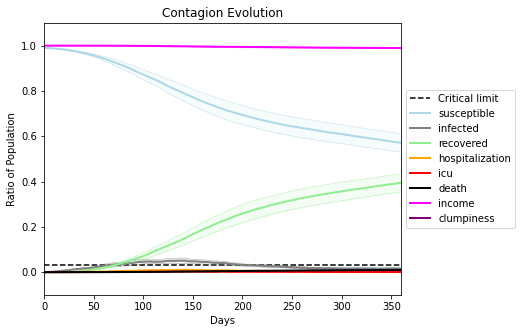

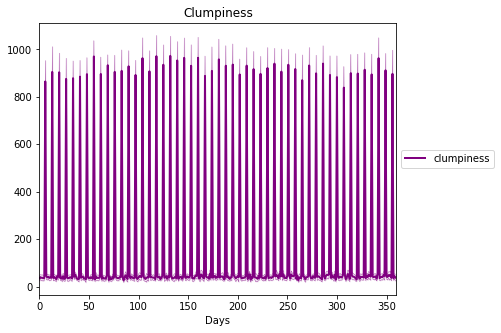

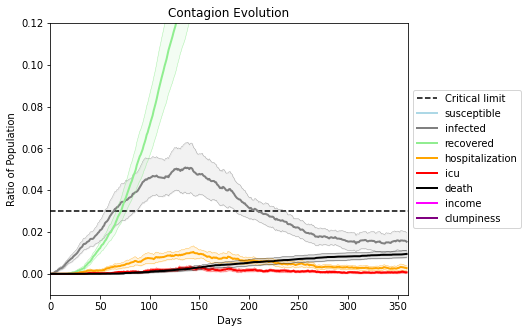

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2559, 7482, 9468, 9868, 4239, 1675, 3028, 2405, 2658, 3854, 5686, 1557, 9508, 4363, 7767, 68, 5627, 5648, 3668, 363]
Average similarity between family members is 0.41581568784684275 at temperature -0.8
Average similarity between family and home is 0.9998566157869389 at temperature -1
Average similarity between students and their classroom is 0.14162680157723917 at temperature -0.8
Average classroom occupancy is 1.6337209302325582 and number classrooms is 172
Average similarity between workers is 0.31581054394827707 at temperature -0.8
Average office occupancy is 3.2233009708737863 and number offices is 206
Average friend similarity for adults: 0.49525115609149334 for kids: 0.3630869394346584
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.14754280151471347
avg restaurant similarity 0.10839793338503226
avg restaurant similarity 0.07411617753760194
avg restaurant similarity 0.12097049033712219
avg restaurant similarity 0.029624522116215836
avg restaurant similarity 0.09278565976551602
avg restaurant similarity 0.07312616645398086
avg restaurant similarity 0.08025893008808023
avg restaurant similarity 0.13683357772657195
avg restaurant similarity 0.09192537537183262
avg restaurant similarity 0.13211382101816876
avg restaurant similarity 0.13103014239664648
avg restaurant similarity 0.12064783365316345
avg restaurant similarity 0.11830646538742678
avg restaurant similarity 0.08788365694768849
avg restaurant similarity 0.10446111038156154
avg restaurant similarity 0.03742465771773079
avg restaurant similarity -0.04339674982546436
avg restaurant similarity 0.07752189603027715
avg restaurant similarity 0.10536427928489722
avg restaurant similarity 0.12926320094576538
avg restaurant similarity 0.1078

avg restaurant similarity 0.05871621717220742
avg restaurant similarity 0.08352735152470567
avg restaurant similarity 0.06461801418771926
avg restaurant similarity 0.0857107898192104
avg restaurant similarity 0.09882315484720024
avg restaurant similarity 0.07446099639632502
avg restaurant similarity 0.07493977617821468
avg restaurant similarity 0.012785737911963318
avg restaurant similarity 0.07983504535903642
avg restaurant similarity 0.022872930750475643
avg restaurant similarity -0.00045130912274906726
avg restaurant similarity 0.038514253506639805
avg restaurant similarity 0.12619819144733097
avg restaurant similarity 0.02991822290623132
avg restaurant similarity 0.0984236906841159
avg restaurant similarity 0.0942908873181885
avg restaurant similarity 0.12546867694384856
avg restaurant similarity 0.08058792578384166
avg restaurant similarity 0.036481675134850775
avg restaurant similarity 0.09908905462628347
avg restaurant similarity 0.0692841827880847
avg restaurant similarity 0.08

avg restaurant similarity 0.11240884930210923
avg restaurant similarity 0.11407488831513998
avg restaurant similarity 0.12151598682275044
Average similarity between family members is 0.43084164770047134 at temperature -0.8
Average similarity between family and home is 0.9998438060480768 at temperature -1
Average similarity between students and their classroom is 0.17128057727150986 at temperature -0.8
Average classroom occupancy is 1.5542857142857143 and number classrooms is 175
Average similarity between workers is 0.283463831971936 at temperature -0.8
Average office occupancy is 3.303921568627451 and number offices is 204
Average friend similarity for adults: 0.49318516371499366 for kids: 0.3848974710237235
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.05008060472996211
avg restaurant similarity 0.08615826248901383
avg restaurant similarity 0.11685759537365047
avg restaurant similarity 0.11317574574841846
avg restaurant similarity 0.11590841885537052
avg restaurant similarity 0.10960552497415024
avg restaurant similarity 0.12570479755217884
avg restaurant similarity 0.09942927692801531
avg restaurant similarity 0.03313427066090995
avg restaurant similarity 0.14123097767299667
avg restaurant similarity 0.10080910619371825
avg restaurant similarity 0.07545034714468175
avg restaurant similarity 0.08471515863338339
avg restaurant similarity 0.12978980379184077
avg restaurant similarity 0.142991210334356
avg restaurant similarity 0.11703384872647886
avg restaurant similarity 0.08781954100671706
avg restaurant similarity 0.10342388607024265
avg restaurant similarity 0.06895219927853148
avg restaurant similarity 0.10983591594108094
avg restaurant similarity 0.07628256035837948
avg restaurant similarity 0.09834396

avg restaurant similarity 0.1373632771493812
avg restaurant similarity 0.12110936169718017
avg restaurant similarity 0.11259521336389165
avg restaurant similarity -0.005604291360818537
avg restaurant similarity 0.1783673261915212
avg restaurant similarity 0.109353550145355
avg restaurant similarity 0.1121164419049013
avg restaurant similarity 0.15215703312862414
avg restaurant similarity 0.06323667170636045
avg restaurant similarity 0.12712807630076145
avg restaurant similarity 0.058324986775562034
avg restaurant similarity 0.017908378737926257
avg restaurant similarity 0.0405309199149852
avg restaurant similarity 0.11884810890571892
avg restaurant similarity 0.07106655905736216
avg restaurant similarity 0.08138204607108497
avg restaurant similarity 0.05400460702289284
avg restaurant similarity 0.05529613016214014
avg restaurant similarity 0.07079745888763446
avg restaurant similarity 0.11358940958042398
avg restaurant similarity 0.12357521608617457
avg restaurant similarity 0.12368695

avg restaurant similarity 0.10815078812768346
avg restaurant similarity 0.044823535865072525
Average similarity between family members is 0.4281289107266187 at temperature -0.8
Average similarity between family and home is 0.9998623022571711 at temperature -1
Average similarity between students and their classroom is 0.17341178814254485 at temperature -0.8
Average classroom occupancy is 1.6627906976744187 and number classrooms is 172
Average similarity between workers is 0.28243538200481977 at temperature -0.8
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.49444423504064466 for kids: 0.37412021578883287
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.056397743949386125
avg restaurant similarity 0.06834690842812527
avg restaurant similarity 0.05369687272765252
avg restaurant similarity 0.027164004379235062
avg restaurant similarity 0.029299080700242678
avg restaurant similarity 0.06434456449187749
avg restaurant similarity -0.0032256113742772743
avg restaurant similarity -0.0013254600832148828
avg restaurant similarity 0.09155080541106494
avg restaurant similarity 0.021900369854234478
avg restaurant similarity -0.002982755896413378
avg restaurant similarity 0.01613200142533078
avg restaurant similarity 0.07778510058513512
avg restaurant similarity 0.024512362225504247
avg restaurant similarity 0.08503898680519627
avg restaurant similarity 0.026841416204195733
avg restaurant similarity 0.06011544686576046
avg restaurant similarity 0.04088563099545945
avg restaurant similarity 0.08211050928098919
avg restaurant similarity 0.08285132084118511
avg restaurant similarity -0.015734604668369227
avg restaurant sim

avg restaurant similarity 0.036910172610916024
avg restaurant similarity 0.049096357478270486
avg restaurant similarity 0.034231708780800105
avg restaurant similarity 0.10905629294227558
avg restaurant similarity 0.04940761483500819
avg restaurant similarity 0.07408142230685597
avg restaurant similarity 0.05461269176512003
avg restaurant similarity 0.045136501935147115
avg restaurant similarity 0.07111532974032406
avg restaurant similarity 0.036254463687225694
avg restaurant similarity 0.06731965565636333
avg restaurant similarity 0.08289030851935418
avg restaurant similarity 0.06282203009239595
avg restaurant similarity 0.04905706423853554
avg restaurant similarity 0.047530855672784804
avg restaurant similarity 0.03656210663614416
avg restaurant similarity -0.0005337254417982606
avg restaurant similarity 0.057995695832574065
avg restaurant similarity 0.03192315551473841
avg restaurant similarity 0.1115738604892823
avg restaurant similarity 0.03163477547081903
avg restaurant similarity

avg restaurant similarity 0.039830376800329095
avg restaurant similarity 0.027010256013697404
avg restaurant similarity 0.035371182023662594
avg restaurant similarity 0.09035037238126212
avg restaurant similarity 0.029790060348751122
avg restaurant similarity 0.10583153844551033
Average similarity between family members is 0.45444009422233 at temperature -0.8
Average similarity between family and home is 0.9998489280240636 at temperature -1
Average similarity between students and their classroom is 0.18091264678476848 at temperature -0.8
Average classroom occupancy is 1.611764705882353 and number classrooms is 170
Average similarity between workers is 0.30950079528614954 at temperature -0.8
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.5072740952931061 for kids: 0.38316033293636564
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 

avg restaurant similarity 0.07273846796006041
avg restaurant similarity 0.09777047982748892
avg restaurant similarity 0.08412229515947384
avg restaurant similarity 0.09366453584690689
avg restaurant similarity 0.08041903721416689
avg restaurant similarity 0.10809288455410151
avg restaurant similarity 0.0795023267934385
avg restaurant similarity 0.08369577636410981
avg restaurant similarity 0.09249059476495114
avg restaurant similarity 0.058548930782711756
avg restaurant similarity 0.1236680525205407
avg restaurant similarity 0.08044300448402837
avg restaurant similarity 0.07241118478302956
avg restaurant similarity 0.1348208157617389
avg restaurant similarity 0.1030477492074339
avg restaurant similarity 0.05959430022812956
avg restaurant similarity 0.06851437441708681
avg restaurant similarity 0.06504697474690053
avg restaurant similarity 0.08945248878557134
avg restaurant similarity 0.05484709924872245
avg restaurant similarity 0.05897801644159542
avg restaurant similarity 0.105089214

avg restaurant similarity 0.08362757922619474
avg restaurant similarity 0.08114562963918347
avg restaurant similarity 0.05496431339536189
avg restaurant similarity 0.10561343474732018
avg restaurant similarity 0.10982362943598274
avg restaurant similarity 0.10360891481051507
avg restaurant similarity 0.07856662489163767
avg restaurant similarity 0.090553553362183
avg restaurant similarity 0.08661771946806668
avg restaurant similarity 0.10491609316802751
avg restaurant similarity 0.088158754557516
avg restaurant similarity 0.13585396267228092
avg restaurant similarity 0.05519521290457781
avg restaurant similarity 0.09987266683575663
avg restaurant similarity 0.09487402947616239
avg restaurant similarity 0.08680076002535018
avg restaurant similarity 0.0908548544038829
avg restaurant similarity 0.10364784883724541
avg restaurant similarity 0.11680620418305031
avg restaurant similarity 0.0323079760299088
avg restaurant similarity 0.08810330102141974
avg restaurant similarity 0.053480499133

avg restaurant similarity 0.12938208464791787
avg restaurant similarity 0.102127555416341
Average similarity between family members is 0.4368584117416778 at temperature -0.8
Average similarity between family and home is 0.9998412560526145 at temperature -1
Average similarity between students and their classroom is 0.19782337446712098 at temperature -0.8
Average classroom occupancy is 1.5284090909090908 and number classrooms is 176
Average similarity between workers is 0.31046649507923096 at temperature -0.8
Average office occupancy is 3.371287128712871 and number offices is 202
Average friend similarity for adults: 0.5026685591074302 for kids: 0.3567603618186043
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.019544914354921304
avg restaurant similarity 0.12403096948239888
avg restaurant similarity 0.0684659233120529
avg restaurant similarity 0.14007162375619228
avg restaurant similarity 0.09590879558328946
avg restaurant similarity 0.053774201399506324
avg restaurant similarity 0.08555752545775121
avg restaurant similarity 0.06144776727130517
avg restaurant similarity 0.022188454743949777
avg restaurant similarity 0.08608296841096122
avg restaurant similarity 0.0768047074738848
avg restaurant similarity 0.12736883872124255
avg restaurant similarity 0.07428500457538992
avg restaurant similarity 0.06806580222200202
avg restaurant similarity 0.05049528255205641
avg restaurant similarity 0.07489428582376487
avg restaurant similarity 0.07115348753154938
avg restaurant similarity 0.1087478123667614
avg restaurant similarity 0.08548441254601545
avg restaurant similarity 0.04258111940528377
avg restaurant similarity 0.0975291683959127
avg restaurant similarity 0.1737152

avg restaurant similarity 0.05007609474815154
avg restaurant similarity 0.08171430618836903
avg restaurant similarity 0.1874258632086406
avg restaurant similarity 0.0826434817904353
avg restaurant similarity 0.09836646410947097
avg restaurant similarity 0.14371350144593564
avg restaurant similarity 0.10117106705635102
avg restaurant similarity 0.05299477881462
avg restaurant similarity 0.07258110144234536
avg restaurant similarity 0.14880148075655023
avg restaurant similarity 0.08992344523961553
avg restaurant similarity 0.06310911402440693
avg restaurant similarity 0.051791666333447485
avg restaurant similarity 0.08996501811803498
avg restaurant similarity 0.07272884910083664
avg restaurant similarity 0.02430211442057195
avg restaurant similarity 0.07802923214534303
avg restaurant similarity 0.08755850913108068
avg restaurant similarity 0.05294027239137172
avg restaurant similarity 0.12519394635552822
avg restaurant similarity 0.0655948758733033
avg restaurant similarity 0.10305204584

avg restaurant similarity 0.07637407121640706
avg restaurant similarity 0.018435947315800873
avg restaurant similarity 0.02707338056088417
Average similarity between family members is 0.43188033696995154 at temperature -0.8
Average similarity between family and home is 0.9998551623358656 at temperature -1
Average similarity between students and their classroom is 0.14654899948542643 at temperature -0.8
Average classroom occupancy is 1.6686046511627908 and number classrooms is 172
Average similarity between workers is 0.30179387561707743 at temperature -0.8
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.49110201715124113 for kids: 0.38325939309316037
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.07471924099839711
avg restaurant similarity 0.12888319292887604
avg restaurant similarity 0.09742982444450633
avg restaurant similarity 0.08614936075754633
avg restaurant similarity 0.0372252633780445
avg restaurant similarity 0.14196825404091645
avg restaurant similarity 0.07590813344157589
avg restaurant similarity 0.11503624020569578
avg restaurant similarity 0.02865395032238899
avg restaurant similarity 0.10328180304315021
avg restaurant similarity 0.07426173794732545
avg restaurant similarity 0.12776547984996078
avg restaurant similarity 0.11333825205272693
avg restaurant similarity 0.13345966954881583
avg restaurant similarity 0.11847116519206137
avg restaurant similarity 0.15027602459541106
avg restaurant similarity 0.08948117549055286
avg restaurant similarity 0.11438535983345645
avg restaurant similarity 0.05296057116934444
avg restaurant similarity 0.1306873759789348
avg restaurant similarity 0.07582535253836822
avg restaurant similarity 0.09800099

avg restaurant similarity 0.06222711061383092
avg restaurant similarity 0.08304295789443956
avg restaurant similarity 0.07408773436455067
avg restaurant similarity 0.17230194479909847
avg restaurant similarity 0.08376625249229594
avg restaurant similarity 0.15092830273322522
avg restaurant similarity 0.07775000899289239
avg restaurant similarity 0.04036024846826526
avg restaurant similarity 0.12139940098750497
avg restaurant similarity 0.05040263415583733
avg restaurant similarity 0.05450003486932286
avg restaurant similarity 0.14875279813675485
avg restaurant similarity 0.07073424918754588
avg restaurant similarity 0.09903119154468748
avg restaurant similarity 0.14624942365405819
avg restaurant similarity 0.11460750865359201
avg restaurant similarity 0.10314032762893034
avg restaurant similarity 0.06931187246000589
avg restaurant similarity 0.07489107356819254
avg restaurant similarity 0.10885564815839989
avg restaurant similarity 0.1116941822979969
avg restaurant similarity 0.1246892

avg restaurant similarity 0.06920315701222497
avg restaurant similarity 0.1635135633450821
Average similarity between family members is 0.43435086232876907 at temperature -0.8
Average similarity between family and home is 0.9998566936905883 at temperature -1
Average similarity between students and their classroom is 0.2043062693569571 at temperature -0.8
Average classroom occupancy is 1.5978260869565217 and number classrooms is 184
Average similarity between workers is 0.2882687292060304 at temperature -0.8
Average office occupancy is 3.206896551724138 and number offices is 203
Average friend similarity for adults: 0.49306779876568646 for kids: 0.3858752705655512
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated 

avg restaurant similarity 0.12278484261739912
avg restaurant similarity 0.10909081452745487
avg restaurant similarity 0.11191777452310835
avg restaurant similarity 0.11290006611237531
avg restaurant similarity 0.053662604208120454
avg restaurant similarity 0.14450512958866124
avg restaurant similarity 0.061105799980317184
avg restaurant similarity 0.06454290196343664
avg restaurant similarity 0.0777248633186384
avg restaurant similarity 0.0680600037712833
avg restaurant similarity 0.09418441965856902
avg restaurant similarity 0.09742308135854474
avg restaurant similarity 0.13494901490787456
avg restaurant similarity 0.15026277683823383
avg restaurant similarity 0.07709880570695932
avg restaurant similarity 0.07189052020566872
avg restaurant similarity 0.09767803148232923
avg restaurant similarity 0.09058558357398201
avg restaurant similarity 0.18069624606456586
avg restaurant similarity 0.12928480600658482
avg restaurant similarity 0.08791801172979243
avg restaurant similarity 0.064285

avg restaurant similarity 0.1378138932917576
avg restaurant similarity 0.143340352250769
avg restaurant similarity 0.09008506415705496
avg restaurant similarity 0.1051760239290522
avg restaurant similarity 0.12470564006379346
avg restaurant similarity 0.12698486904210476
avg restaurant similarity 0.10487055684573073
avg restaurant similarity 0.09193358300009737
avg restaurant similarity 0.1441544882872928
avg restaurant similarity 0.14250564181339204
avg restaurant similarity 0.09435386075719158
avg restaurant similarity 0.12505664370257313
avg restaurant similarity 0.17595937077142595
avg restaurant similarity 0.08787772698576399
avg restaurant similarity 0.09214562364469688
avg restaurant similarity 0.13277386747868672
avg restaurant similarity 0.14265234374107486
avg restaurant similarity 0.10745037498661485
avg restaurant similarity 0.09081315580558946
avg restaurant similarity 0.0720621718003655
avg restaurant similarity 0.16597038390345595
avg restaurant similarity 0.115931671401

avg restaurant similarity 0.05970080119889241
avg restaurant similarity 0.037526131780728264
Average similarity between family members is 0.4298377936973466 at temperature -0.8
Average similarity between family and home is 0.9998536776155705 at temperature -1
Average similarity between students and their classroom is 0.190863222278197 at temperature -0.8
Average classroom occupancy is 1.641304347826087 and number classrooms is 184
Average similarity between workers is 0.2975680461519821 at temperature -0.8
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.49897402260033125 for kids: 0.39557620273275695
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated u

avg restaurant similarity 0.08620510493307038
avg restaurant similarity 0.0769129576115322
avg restaurant similarity 0.06363350830426735
avg restaurant similarity 0.020803624958024465
avg restaurant similarity 0.023282296380816973
avg restaurant similarity 0.05501047855365915
avg restaurant similarity 0.1273489031463792
avg restaurant similarity 0.05888356627563107
avg restaurant similarity 0.08967064700828807
avg restaurant similarity 0.031013314121554857
avg restaurant similarity 0.0963481117121139
avg restaurant similarity 0.08372502835074039
avg restaurant similarity 0.07210878512016183
avg restaurant similarity 0.08301461403064908
avg restaurant similarity 0.11873924087914377
avg restaurant similarity 0.1397185451541281
avg restaurant similarity 0.09203144004930845
avg restaurant similarity 0.0799650602386303
avg restaurant similarity 0.1346867039492127
avg restaurant similarity 0.11960428039016051
avg restaurant similarity 0.11817840313677634
avg restaurant similarity 0.080197689

avg restaurant similarity 0.0889272754346473
avg restaurant similarity 0.08389425121428089
avg restaurant similarity 0.12041995971430364
avg restaurant similarity 0.09218047453493998
avg restaurant similarity 0.10697465842098601
avg restaurant similarity 0.0891304695546319
avg restaurant similarity 0.09908146010029417
avg restaurant similarity 0.06905872217812926
avg restaurant similarity 0.06640967687994861
avg restaurant similarity 0.10117878325045959
avg restaurant similarity 0.07717654486169238
avg restaurant similarity 0.11871724899408416
avg restaurant similarity 0.09586711483735579
avg restaurant similarity 0.07459424211646846
avg restaurant similarity 0.1157592936027842
avg restaurant similarity 0.07254107086353574
avg restaurant similarity 0.07456114374211496
avg restaurant similarity 0.0721750870509633
avg restaurant similarity 0.11230035271308092
avg restaurant similarity 0.10907412625671592
avg restaurant similarity 0.10575187066296794
avg restaurant similarity 0.0399922288

avg restaurant similarity 0.03681483659405586
avg restaurant similarity 0.07963360196613563
Average similarity between family members is 0.4388572012907659 at temperature -0.8
Average similarity between family and home is 0.999846650046613 at temperature -1
Average similarity between students and their classroom is 0.161090843413072 at temperature -0.8
Average classroom occupancy is 1.5251396648044693 and number classrooms is 179
Average similarity between workers is 0.27709753116113967 at temperature -0.8
Average office occupancy is 3.2829268292682925 and number offices is 205
Average friend similarity for adults: 0.49968146875341335 for kids: 0.3831156052457323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.07619721468533155
avg restaurant similarity 0.11958671801277382
avg restaurant similarity 0.08064190612878308
avg restaurant similarity 0.09263402264015684
avg restaurant similarity 0.08559980463069981
avg restaurant similarity 0.0262386127911409
avg restaurant similarity 0.14117201698733287
avg restaurant similarity 0.11693355493798709
avg restaurant similarity 0.09394652701277377
avg restaurant similarity 0.11389704724451914
avg restaurant similarity 0.02671575115838226
avg restaurant similarity 0.08312172551692926
avg restaurant similarity 0.09197020611184192
avg restaurant similarity 0.07776872677599568
avg restaurant similarity 0.09427131680947182
avg restaurant similarity 0.09618578540005966
avg restaurant similarity 0.07992237278687346
avg restaurant similarity 0.11696927612900045
avg restaurant similarity 0.10813982634642637
avg restaurant similarity 0.0936437722609879
avg restaurant similarity 0.039099738559596954
avg restaurant similarity 0.1613161

avg restaurant similarity 0.0912861814389439
avg restaurant similarity 0.15689259594101146
avg restaurant similarity 0.0928374214006198
avg restaurant similarity 0.07818960128280082
avg restaurant similarity 0.10345435402666757
avg restaurant similarity 0.05213962327400078
avg restaurant similarity 0.06538307019945933
avg restaurant similarity 0.09683873425542001
avg restaurant similarity 0.0407473950291406
avg restaurant similarity 0.041712090099722265
avg restaurant similarity 0.05384224730742592
avg restaurant similarity 0.09787066658110122
avg restaurant similarity 0.08581853686065405
avg restaurant similarity 0.1610491244184817
avg restaurant similarity 0.10554821197895317
avg restaurant similarity 0.08237087841697756
avg restaurant similarity 0.14567488823450755
avg restaurant similarity 0.14617888294774412
avg restaurant similarity 0.1416861882799972
avg restaurant similarity 0.040914626930317756
avg restaurant similarity 0.1274093608829073
avg restaurant similarity 0.0510011171

avg restaurant similarity 0.07956096045830965
avg restaurant similarity 0.10373456408581577
Average similarity between family members is 0.42927827174170197 at temperature -0.8
Average similarity between family and home is 0.9998330286217929 at temperature -1
Average similarity between students and their classroom is 0.20548088595600422 at temperature -0.8
Average classroom occupancy is 1.6205128205128205 and number classrooms is 195
Average similarity between workers is 0.2660374999896872 at temperature -0.8
Average office occupancy is 3.1928934010152283 and number offices is 197
Average friend similarity for adults: 0.4900104889064908 for kids: 0.4086951049913541
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.05005616317374201
avg restaurant similarity 0.059863330984070144
avg restaurant similarity 0.06502044229936736
avg restaurant similarity 0.01028205537437776
avg restaurant similarity 0.11565836418442411
avg restaurant similarity 0.05015603908773982
avg restaurant similarity 0.09148042013860044
avg restaurant similarity 0.14481170443613575
avg restaurant similarity 0.13561370633038153
avg restaurant similarity 0.07402990980148073
avg restaurant similarity 0.04285938592064686
avg restaurant similarity 0.07244070537126747
avg restaurant similarity 0.062445376881988715
avg restaurant similarity 0.16016562712057916
avg restaurant similarity 0.07233648114461289
avg restaurant similarity 0.09841557638708996
avg restaurant similarity 0.07839504642143331
avg restaurant similarity 0.09985229801363256
avg restaurant similarity 0.07533154938561697
avg restaurant similarity 0.038447771648861914
avg restaurant similarity 0.07216400464142209
avg restaurant similarity 0.085

avg restaurant similarity 0.11469992034153995
avg restaurant similarity 0.08537325767643732
avg restaurant similarity 0.07110963470357776
avg restaurant similarity 0.11523776174647067
avg restaurant similarity 0.06783517413141392
avg restaurant similarity 0.04053593173283007
avg restaurant similarity 0.12076883962780052
avg restaurant similarity 0.10412310921336329
avg restaurant similarity 0.08479143941683642
avg restaurant similarity 0.07396262540179165
avg restaurant similarity 0.09267242002923226
avg restaurant similarity 0.10926121812313297
avg restaurant similarity 0.1334802432639417
avg restaurant similarity 0.0561654186844166
avg restaurant similarity 0.02058507724047882
avg restaurant similarity 0.10321667634673123
avg restaurant similarity 0.06432241660445406
avg restaurant similarity 0.11213838159714179
avg restaurant similarity 0.08089406842440137
avg restaurant similarity 0.08091952934849812
avg restaurant similarity 0.04086705631714818
avg restaurant similarity 0.06170255

avg restaurant similarity 0.07909655752312363
avg restaurant similarity 0.09085968134823583
Average similarity between family members is 0.4327964750146993 at temperature -0.8
Average similarity between family and home is 0.9998610811069087 at temperature -1
Average similarity between students and their classroom is 0.16296706037434971 at temperature -0.8
Average classroom occupancy is 1.656084656084656 and number classrooms is 189
Average similarity between workers is 0.31564510374333904 at temperature -0.8
Average office occupancy is 3.1666666666666665 and number offices is 198
Average friend similarity for adults: 0.4931221271655087 for kids: 0.3949315566755755
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated

avg restaurant similarity 0.0830895572778331
avg restaurant similarity 0.07360370125726377
avg restaurant similarity 0.09922434315088415
avg restaurant similarity 0.12744252496689135
avg restaurant similarity 0.08496754325929759
avg restaurant similarity 0.0658494177907628
avg restaurant similarity 0.09000213341467293
avg restaurant similarity 0.07497069700445172
avg restaurant similarity 0.06596739826689318
avg restaurant similarity 0.08154804761503776
avg restaurant similarity 0.08798149310136512
avg restaurant similarity 0.10443747463450552
avg restaurant similarity 0.07783532379949323
avg restaurant similarity 0.08973783462137119
avg restaurant similarity 0.11782552669937146
avg restaurant similarity 0.0739516454611373
avg restaurant similarity 0.025254775100837144
avg restaurant similarity 0.0480488134442988
avg restaurant similarity 0.1013423607830953
avg restaurant similarity 0.12216571277373668
avg restaurant similarity 0.05726710725318738
avg restaurant similarity 0.0478376082

avg restaurant similarity 0.07873219315013638
avg restaurant similarity 0.07294084153735503
avg restaurant similarity 0.09785076331734754
avg restaurant similarity 0.04929948160904516
avg restaurant similarity 0.09732119894290184
avg restaurant similarity 0.11393647623656349
avg restaurant similarity 0.08821288231088385
avg restaurant similarity 0.06284151588585031
avg restaurant similarity 0.11790791088993396
avg restaurant similarity 0.07613756727506787
avg restaurant similarity 0.08858405929397203
avg restaurant similarity 0.03641095350382556
avg restaurant similarity 0.057202238221036907
avg restaurant similarity 0.04586030721927604
avg restaurant similarity 0.1270945754088014
avg restaurant similarity -0.004291447498381776
avg restaurant similarity 0.06722682942252603
avg restaurant similarity 0.08143757452099817
avg restaurant similarity 0.05495523042685702
avg restaurant similarity 0.03956448578849355
avg restaurant similarity 0.05670580208531284
avg restaurant similarity 0.1634

avg restaurant similarity 0.06315321658318158
avg restaurant similarity 0.05063561799693705
Average similarity between family members is 0.4214522550477663 at temperature -0.8
Average similarity between family and home is 0.9998587531768378 at temperature -1
Average similarity between students and their classroom is 0.15696805823502327 at temperature -0.8
Average classroom occupancy is 1.5191256830601092 and number classrooms is 183
Average similarity between workers is 0.28331880673473037 at temperature -0.8
Average office occupancy is 3.209756097560976 and number offices is 205
Average friend similarity for adults: 0.4940555782775395 for kids: 0.3756923625964576
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated

avg restaurant similarity 0.07257006760249456
avg restaurant similarity 0.05430096629667761
avg restaurant similarity 0.13809316582755515
avg restaurant similarity 0.10069328969892964
avg restaurant similarity 0.06901370548566035
avg restaurant similarity 0.0539495259617498
avg restaurant similarity 0.01645553147801796
avg restaurant similarity 0.03095228131413154
avg restaurant similarity 0.03839984119705052
avg restaurant similarity 0.0763310747954404
avg restaurant similarity 0.04226465177000417
avg restaurant similarity 0.04111327788100469
avg restaurant similarity 0.07919776983239978
avg restaurant similarity 0.046559832757119606
avg restaurant similarity 0.10470544123501316
avg restaurant similarity 0.0591307464990901
avg restaurant similarity 0.08863887308208976
avg restaurant similarity 0.09056540302220352
avg restaurant similarity 0.10205292476801504
avg restaurant similarity 0.029020000816649728
avg restaurant similarity 0.0977192749311572
avg restaurant similarity 0.09165768

avg restaurant similarity 0.05328568387349216
avg restaurant similarity 0.13783066965738314
avg restaurant similarity 0.06241223640931467
avg restaurant similarity 0.051599647331870106
avg restaurant similarity 0.08989420122069043
avg restaurant similarity 0.10710561530277106
avg restaurant similarity 0.08258430635730717
avg restaurant similarity 0.2035415332893348
avg restaurant similarity 0.10557696201642545
avg restaurant similarity 0.054406464055584
avg restaurant similarity -0.006305773942640675
avg restaurant similarity 0.0707262069420545
avg restaurant similarity 0.06354418960911976
avg restaurant similarity 0.10902013632815101
avg restaurant similarity 0.14447796885442127
avg restaurant similarity 0.10947355365069328
avg restaurant similarity 0.020292798037355817
avg restaurant similarity 0.02039884817921603
avg restaurant similarity 0.10007835026786376
avg restaurant similarity 0.04071480740031773
avg restaurant similarity 0.10021282872023132
avg restaurant similarity 0.039031

avg restaurant similarity 0.11536191548755685
avg restaurant similarity 0.11199475929600586
Average similarity between family members is 0.43287845776474887 at temperature -0.8
Average similarity between family and home is 0.9998541785397181 at temperature -1
Average similarity between students and their classroom is 0.1651557907686034 at temperature -0.8
Average classroom occupancy is 1.6486486486486487 and number classrooms is 185
Average similarity between workers is 0.3040779331146673 at temperature -0.8
Average office occupancy is 3.2233502538071064 and number offices is 197
Average friend similarity for adults: 0.5020517702135305 for kids: 0.39976284776746307
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.042109077524790574
avg restaurant similarity 0.08360598267121895
avg restaurant similarity 0.08892103953506297
avg restaurant similarity 0.07785639183242532
avg restaurant similarity 0.07355652561246229
avg restaurant similarity 0.10404016374226016
avg restaurant similarity 0.1555813816656804
avg restaurant similarity 0.09740031953402072
avg restaurant similarity 0.06433481030656625
avg restaurant similarity 0.09129874971749084
avg restaurant similarity 0.10943391731819171
avg restaurant similarity 0.0932111723431978
avg restaurant similarity 0.08238221895889594
avg restaurant similarity 0.053003410936908274
avg restaurant similarity 0.11516829201600684
avg restaurant similarity 0.05368210521741813
avg restaurant similarity 0.11751904799558509
avg restaurant similarity 0.07801898664781803
avg restaurant similarity 0.12431012784086642
avg restaurant similarity 0.14398495753078686
avg restaurant similarity 0.09982868263846265
avg restaurant similarity 0.090797

avg restaurant similarity 0.10799832706394033
avg restaurant similarity 0.11233668516737214
avg restaurant similarity 0.04591305179892119
avg restaurant similarity 0.11166868410686137
avg restaurant similarity 0.06412229301531262
avg restaurant similarity 0.04090811614118018
avg restaurant similarity 0.1489649235429304
avg restaurant similarity 0.0749604799108808
avg restaurant similarity 0.09819582502047941
avg restaurant similarity 0.09418899778840119
avg restaurant similarity 0.10018053335048031
avg restaurant similarity 0.08922446271540642
avg restaurant similarity 0.09722019750697622
avg restaurant similarity 0.04882922983948147
avg restaurant similarity 0.07894577872506654
avg restaurant similarity 0.11884593712834365
avg restaurant similarity 0.18104855175372478
avg restaurant similarity 0.1428228067119809
avg restaurant similarity 0.11342996210646791
avg restaurant similarity 0.10842510403012823
avg restaurant similarity 0.08887680455010184
avg restaurant similarity 0.108078654

avg restaurant similarity 0.11047971415498281
avg restaurant similarity 0.1600242329355351
Average similarity between family members is 0.41795428687004954 at temperature -0.8
Average similarity between family and home is 0.999846916613726 at temperature -1
Average similarity between students and their classroom is 0.18284598502170923 at temperature -0.8
Average classroom occupancy is 1.5921787709497206 and number classrooms is 179
Average similarity between workers is 0.28546232409137645 at temperature -0.8
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.49280670275792726 for kids: 0.39168695221983185
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.047178791080452406
avg restaurant similarity 0.10017350072334452
avg restaurant similarity 0.06325111243831895
avg restaurant similarity 0.07045539100961952
avg restaurant similarity 0.06471595215403125
avg restaurant similarity 0.036502597430803245
avg restaurant similarity 0.04653299728502191
avg restaurant similarity 0.0248977378681141
avg restaurant similarity 0.03212214495289817
avg restaurant similarity 0.03792000684985111
avg restaurant similarity 0.06567780475014891
avg restaurant similarity 0.07950307009511219
avg restaurant similarity 0.025156585837304648
avg restaurant similarity 0.06558645831220412
avg restaurant similarity 0.06658615706732164
avg restaurant similarity 0.0745219005394719
avg restaurant similarity 0.07879245126764581
avg restaurant similarity 0.06790853786404016
avg restaurant similarity 0.0874941088835521
avg restaurant similarity 0.08299256138143415
avg restaurant similarity 0.017828393186972203
avg restaurant similarity 0.03216

avg restaurant similarity 0.09271684327441918
avg restaurant similarity 0.10423238824962067
avg restaurant similarity 0.08697930346618042
avg restaurant similarity 0.05468939590800667
avg restaurant similarity 0.050265454081081594
avg restaurant similarity 0.059950184286383656
avg restaurant similarity 0.06780530847709344
avg restaurant similarity 0.10530234416378122
avg restaurant similarity 0.07008457824007251
avg restaurant similarity 0.05299843688191159
avg restaurant similarity 0.06108922856828631
avg restaurant similarity 0.059663189774304175
avg restaurant similarity 0.06004286421553034
avg restaurant similarity 0.07952424934175419
avg restaurant similarity 0.0586161294340371
avg restaurant similarity 0.06590507115923577
avg restaurant similarity 0.028799549001584882
avg restaurant similarity 0.10968024444271933
avg restaurant similarity 0.04250734007765309
avg restaurant similarity 0.03667087708045121
avg restaurant similarity 0.10188325296728483
avg restaurant similarity 0.117

avg restaurant similarity 0.04023738608085934
avg restaurant similarity 0.10433364748647243
Average similarity between family members is 0.43727217803817015 at temperature -0.8
Average similarity between family and home is 0.9998627302904096 at temperature -1
Average similarity between students and their classroom is 0.19076476178148402 at temperature -0.8
Average classroom occupancy is 1.6825396825396826 and number classrooms is 189
Average similarity between workers is 0.28043648809942506 at temperature -0.8
Average office occupancy is 3.15 and number offices is 200
Average friend similarity for adults: 0.4948871584209666 for kids: 0.4006339117978182
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with 

avg restaurant similarity 0.028405184104003858
avg restaurant similarity 0.08685200280916978
avg restaurant similarity 0.05339559784949175
avg restaurant similarity 0.1351619387225419
avg restaurant similarity 0.10328368266900334
avg restaurant similarity 0.10073235480719171
avg restaurant similarity 0.0920188932285918
avg restaurant similarity 0.14218983417191014
avg restaurant similarity 0.12561692747434883
avg restaurant similarity 0.08658085225710932
avg restaurant similarity 0.04490620768573378
avg restaurant similarity 0.116991758475195
avg restaurant similarity 0.022400259711235826
avg restaurant similarity 0.057086309347993865
avg restaurant similarity 0.1318168543536073
avg restaurant similarity 0.15098645580607298
avg restaurant similarity 0.1275914866548714
avg restaurant similarity 0.11263527023662127
avg restaurant similarity 0.11873348705246992
avg restaurant similarity 0.05088015007101911
avg restaurant similarity 0.07839288544733662
avg restaurant similarity 0.114961533

avg restaurant similarity 0.08232897177594563
avg restaurant similarity -0.00768257981774436
avg restaurant similarity 0.15587229324434224
avg restaurant similarity 0.07220680472934027
avg restaurant similarity 0.11350423075887729
avg restaurant similarity 0.09366942279067446
avg restaurant similarity 0.08777859478122793
avg restaurant similarity 0.17899606133862145
avg restaurant similarity 0.13657811058034022
avg restaurant similarity 0.1106595997794362
avg restaurant similarity 0.047284265132120376
avg restaurant similarity 0.1256645279939034
avg restaurant similarity 0.10409164819756538
avg restaurant similarity 0.04670935029193647
avg restaurant similarity 0.09602794609506271
avg restaurant similarity 0.09556484346419139
avg restaurant similarity 0.08097116486963454
avg restaurant similarity 0.03540601955804389
avg restaurant similarity 0.09507596981497826
avg restaurant similarity 0.1066760310739214
avg restaurant similarity 0.16307395376921974
avg restaurant similarity 0.0991270

avg restaurant similarity 0.06012051143324457
avg restaurant similarity 0.11689566503092072
Average similarity between family members is 0.4355749249625336 at temperature -0.8
Average similarity between family and home is 0.999853852279251 at temperature -1
Average similarity between students and their classroom is 0.19106188579608657 at temperature -0.8
Average classroom occupancy is 1.5411764705882354 and number classrooms is 170
Average similarity between workers is 0.30864176690490985 at temperature -0.8
Average office occupancy is 3.388059701492537 and number offices is 201
Average friend similarity for adults: 0.49739341791818 for kids: 0.37482213949783083
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated u

avg restaurant similarity 0.10540418295315139
avg restaurant similarity 0.06618622565246302
avg restaurant similarity 0.07909535068426714
avg restaurant similarity 0.13390386911397642
avg restaurant similarity 0.0900789109311084
avg restaurant similarity 0.13226074557247072
avg restaurant similarity 0.05200058805866596
avg restaurant similarity 0.13752808732799857
avg restaurant similarity 0.10102545561053564
avg restaurant similarity 0.08147017431847335
avg restaurant similarity 0.07897671785657606
avg restaurant similarity 0.05978259535357324
avg restaurant similarity 0.008987363310063782
avg restaurant similarity 0.0721388784204458
avg restaurant similarity 0.07180227359745824
avg restaurant similarity 0.10561348884023074
avg restaurant similarity 0.1064472172320026
avg restaurant similarity 0.0828288450269084
avg restaurant similarity 0.09631692605664127
avg restaurant similarity 0.10298368642181702
avg restaurant similarity 0.10851991376521261
avg restaurant similarity 0.089376051

avg restaurant similarity 0.06616694643146682
avg restaurant similarity 0.0983585629297698
avg restaurant similarity 0.11946281960874135
avg restaurant similarity 0.09351057214549287
avg restaurant similarity 0.13069809384037065
avg restaurant similarity 0.10820563444814145
avg restaurant similarity 0.09313420025156949
avg restaurant similarity 0.16577326142900176
avg restaurant similarity 0.07697328511755991
avg restaurant similarity 0.07463585315122381
avg restaurant similarity 0.09648869531728138
avg restaurant similarity 0.036737514959556974
avg restaurant similarity 0.12487985764142943
avg restaurant similarity 0.11640450637617022
avg restaurant similarity 0.09837810151245437
avg restaurant similarity 0.1104123727482103
avg restaurant similarity 0.13279679233184918
avg restaurant similarity 0.07930943369948706
avg restaurant similarity 0.07370657811078496
avg restaurant similarity 0.08004640180143564
avg restaurant similarity 0.09531955885867192
avg restaurant similarity 0.0756487

avg restaurant similarity 0.05251567918429895
avg restaurant similarity 0.11025564092827304
Average similarity between family members is 0.4402922004645817 at temperature -0.8
Average similarity between family and home is 0.9998525033872151 at temperature -1
Average similarity between students and their classroom is 0.16482045943842455 at temperature -0.8
Average classroom occupancy is 1.4782608695652173 and number classrooms is 184
Average similarity between workers is 0.30156897165480745 at temperature -0.8
Average office occupancy is 3.2829268292682925 and number offices is 205
Average friend similarity for adults: 0.4980146779771297 for kids: 0.3635550068904309
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.09480751459454885
avg restaurant similarity 0.09821184861983276
avg restaurant similarity 0.048312218816899045
avg restaurant similarity 0.061573540403045995
avg restaurant similarity 0.0932779219469406
avg restaurant similarity 0.07192280573878439
avg restaurant similarity 0.14238548258831696
avg restaurant similarity 0.06554188728386222
avg restaurant similarity 0.07556165190648953
avg restaurant similarity 0.11230121635404618
avg restaurant similarity 0.08964750438249576
avg restaurant similarity 0.08898245402550466
avg restaurant similarity 0.12295854363828539
avg restaurant similarity 0.037539656493165804
avg restaurant similarity 0.04618992446260489
avg restaurant similarity 0.0687411975899697
avg restaurant similarity 0.06307942784396896
avg restaurant similarity 0.01757971239545534
avg restaurant similarity 0.15806063166661302
avg restaurant similarity 0.08565143992667525
avg restaurant similarity 0.11657438286374114
avg restaurant similarity 0.09539

avg restaurant similarity 0.10801726214344363
avg restaurant similarity 0.10581066442935574
avg restaurant similarity 0.1127396736315801
avg restaurant similarity 0.08014415452584425
avg restaurant similarity 0.03461448050415676
avg restaurant similarity 0.15699251399944744
avg restaurant similarity 0.08559846747643488
avg restaurant similarity 0.08097809771719883
avg restaurant similarity 0.07724074101195662
avg restaurant similarity 0.11033168656517585
avg restaurant similarity 0.07552904445084244
avg restaurant similarity 0.12793598086922778
avg restaurant similarity 0.11802378475279451
avg restaurant similarity 0.13080106612878967
avg restaurant similarity 0.12657399115366727
avg restaurant similarity 0.06008206406866524
avg restaurant similarity 0.11614859131635881
avg restaurant similarity 0.14966692285393202
avg restaurant similarity 0.07371084254447767
avg restaurant similarity 0.13882246756867822
avg restaurant similarity 0.13223831165190836
avg restaurant similarity 0.0956524

avg restaurant similarity 0.08333841364596452
avg restaurant similarity 0.14354310889108635
Average similarity between family members is 0.43623012280897605 at temperature -0.8
Average similarity between family and home is 0.9998547536035934 at temperature -1
Average similarity between students and their classroom is 0.164946454283945 at temperature -0.8
Average classroom occupancy is 1.5795454545454546 and number classrooms is 176
Average similarity between workers is 0.29701418017222597 at temperature -0.8
Average office occupancy is 3.268292682926829 and number offices is 205
Average friend similarity for adults: 0.5038650872793087 for kids: 0.375697847132924
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated u

avg restaurant similarity 0.08435523214872803
avg restaurant similarity 0.08238732635385797
avg restaurant similarity 0.016433601498628672
avg restaurant similarity 0.032444218365375456
avg restaurant similarity 0.07600725864110255
avg restaurant similarity 0.072753486403798
avg restaurant similarity 0.09938534965672632
avg restaurant similarity 0.05877319721593105
avg restaurant similarity 0.08589347822413951
avg restaurant similarity 0.0472810406761568
avg restaurant similarity 0.07511335143401389
avg restaurant similarity 0.0638226711572579
avg restaurant similarity 0.04552688230629094
avg restaurant similarity 0.08834172065864292
avg restaurant similarity 0.07962253603964058
avg restaurant similarity 0.03950102279842034
avg restaurant similarity 0.1107106460464328
avg restaurant similarity 0.052697061223235406
avg restaurant similarity 0.07001917415937672
avg restaurant similarity 0.020392833681210948
avg restaurant similarity 0.1284572014128695
avg restaurant similarity 0.05838283

avg restaurant similarity 0.10753699162269599
avg restaurant similarity 0.042613541645008794
avg restaurant similarity 0.07084281410380036
avg restaurant similarity 0.028859862958345715
avg restaurant similarity 0.03952089177400923
avg restaurant similarity 0.08025117464600533
avg restaurant similarity 0.04334588438810112
avg restaurant similarity 0.004019865934045202
avg restaurant similarity 0.058122571138822215
avg restaurant similarity 0.06613613563809076
avg restaurant similarity 0.0306529564510604
avg restaurant similarity 0.09480146805690252
avg restaurant similarity 0.08926419255818376
avg restaurant similarity 0.09113640799921581
avg restaurant similarity -0.02081497263506048
avg restaurant similarity 0.08974612950913502
avg restaurant similarity 0.06684731205975547
avg restaurant similarity 0.09453448177990821
avg restaurant similarity 0.090091596651067
avg restaurant similarity 0.04970350955752533
avg restaurant similarity 0.011366477708956204
avg restaurant similarity 0.049

avg restaurant similarity 0.11552798260937316
avg restaurant similarity 9.022154895721872e-06
avg restaurant similarity 0.08872808920313195
avg restaurant similarity 0.057340090645319766
Average similarity between family members is 0.43063311200624527 at temperature -0.8
Average similarity between family and home is 0.9998358214331006 at temperature -1
Average similarity between students and their classroom is 0.16016688970835602 at temperature -0.8
Average classroom occupancy is 1.6844919786096257 and number classrooms is 187
Average similarity between workers is 0.30409175073976835 at temperature -0.8
Average office occupancy is 3.09 and number offices is 200
Average friend similarity for adults: 0.4953518193308101 for kids: 0.397045943407132
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.10502920605655648
avg restaurant similarity 0.07130152088529679
avg restaurant similarity 0.08174366294680563
avg restaurant similarity 0.1375423763285177
avg restaurant similarity -0.012757141765447804
avg restaurant similarity 0.11338499899552995
avg restaurant similarity 0.08640925322158449
avg restaurant similarity 0.08377063486020457
avg restaurant similarity 0.07808878774560675
avg restaurant similarity 0.10786009341301092
avg restaurant similarity 0.08841420143160418
avg restaurant similarity 0.11339970724527161
avg restaurant similarity 0.06742862568045783
avg restaurant similarity 0.19430547920889943
avg restaurant similarity 0.07373310711089519
avg restaurant similarity 0.10472290386855569
avg restaurant similarity 0.13014599912691358
avg restaurant similarity 0.12700590109592422
avg restaurant similarity 0.11769469430110706
avg restaurant similarity 0.08826122356808797
avg restaurant similarity 0.028802160386541115
avg restaurant similarity 0.0593

avg restaurant similarity 0.0677605814959066
avg restaurant similarity 0.15810663285881746
avg restaurant similarity 0.179979746259367
avg restaurant similarity 0.09581076925516485
avg restaurant similarity 0.14529396483017565
avg restaurant similarity 0.12128362255364682
avg restaurant similarity 0.07968838480263989
avg restaurant similarity 0.10443931661564344
avg restaurant similarity 0.13454843434777478
avg restaurant similarity 0.05412996266826811
avg restaurant similarity 0.17133079413694013
avg restaurant similarity 0.06742102488190237
avg restaurant similarity 0.12725521851095753
avg restaurant similarity 0.1325280925882938
avg restaurant similarity 0.11912470095968587
avg restaurant similarity 0.15982217938463505
avg restaurant similarity 0.0714452993899211
avg restaurant similarity 0.12595027919558724
avg restaurant similarity 0.14368087261388193
avg restaurant similarity 0.17132387300903923
avg restaurant similarity 0.09648470488609101
avg restaurant similarity 0.11445871173

avg restaurant similarity 0.11829254865396363
avg restaurant similarity 0.12276753697279073
Average similarity between family members is 0.42406515571644504 at temperature -0.8
Average similarity between family and home is 0.9998657995616521 at temperature -1
Average similarity between students and their classroom is 0.14370641221079128 at temperature -0.8
Average classroom occupancy is 1.6337209302325582 and number classrooms is 172
Average similarity between workers is 0.29295531329354474 at temperature -0.8
Average office occupancy is 3.200980392156863 and number offices is 204
Average friend similarity for adults: 0.4933814000207834 for kids: 0.38631420553442747
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocat

avg restaurant similarity 0.041799863949243246
avg restaurant similarity 0.05599527776869634
avg restaurant similarity 0.059925239270650195
avg restaurant similarity 0.03349256383853409
avg restaurant similarity 0.10087493108250335
avg restaurant similarity 0.13020677600716524
avg restaurant similarity 0.09088986678085242
avg restaurant similarity 0.08360844267732538
avg restaurant similarity 0.1455207767319831
avg restaurant similarity 0.14887159416418577
avg restaurant similarity 0.1392245974499549
avg restaurant similarity 0.17286662400922184
avg restaurant similarity 0.11085702810304313
avg restaurant similarity 0.0903112564013758
avg restaurant similarity 0.11884749330803268
avg restaurant similarity 0.05203935329184486
avg restaurant similarity 0.13571952493567185
avg restaurant similarity 0.13148519429717243
avg restaurant similarity 0.060996883439157615
avg restaurant similarity 0.08890524500974997
avg restaurant similarity 0.05392715293966033
avg restaurant similarity 0.116088

avg restaurant similarity 0.103005269659375
avg restaurant similarity 0.08650511664596032
avg restaurant similarity 0.15493773941929412
avg restaurant similarity 0.13142406440294546
avg restaurant similarity 0.08353001892734965
avg restaurant similarity 0.09561976041481984
avg restaurant similarity 0.06564969985856473
avg restaurant similarity 0.07735014772461804
avg restaurant similarity 0.07550078313951428
avg restaurant similarity 0.06745119217880133
avg restaurant similarity 0.05362706649082799
avg restaurant similarity 0.04056003307419612
avg restaurant similarity 0.0822388815637903
avg restaurant similarity 0.07885337251526543
avg restaurant similarity 0.08248754242017052
avg restaurant similarity 0.009544372734908128
avg restaurant similarity 0.1007823627156752
avg restaurant similarity 0.09716416757595837
avg restaurant similarity 0.1438850422835562
avg restaurant similarity 0.010284273817082603
avg restaurant similarity 0.09191988214062466
avg restaurant similarity 0.104444482

avg restaurant similarity 0.08290486151035835
avg restaurant similarity 0.09882732286411572
using average of time series:
stats on susceptible:
data: [0.7057916666666667, 0.7976972222222224, 0.7483044733044734, 0.7677333333333334, 0.7915944444444444, 0.725061111111111, 0.7962759462759463, 0.8215305555555557, 0.7676055555555557, 0.7639555555555556, 0.6245972222222222, 0.8224527777777777, 0.8768805555555557, 0.8463777777777779, 0.6880472222222223, 0.6100916666666667, 0.833475, 0.8888555555555555, 0.7720194444444445, 0.7641777777777778]
min:
0.6100916666666667
max:
0.8888555555555555
std:
0.07171563983908866
mean:
0.7706262432012432
median:
0.7698763888888889
95% confidence interval for the mean:
(0.7361903544126479,0.8050621319898384)
using average of time series:
stats on infected:
data: [0.03308333333333333, 0.025108333333333333, 0.029156954156954157, 0.02514444444444445, 0.02237777777777778, 0.027338888888888892, 0.024431124431124433, 0.022058333333333333, 0.02701111111111111, 0.02541

(<function dict.items>, <function dict.items>, <function dict.items>)

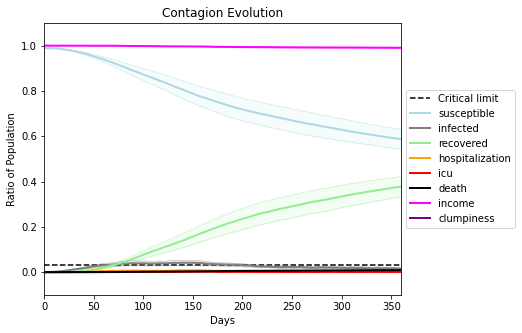

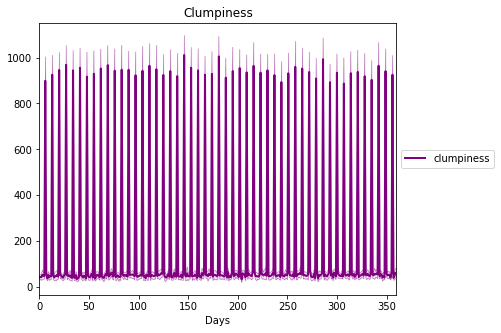

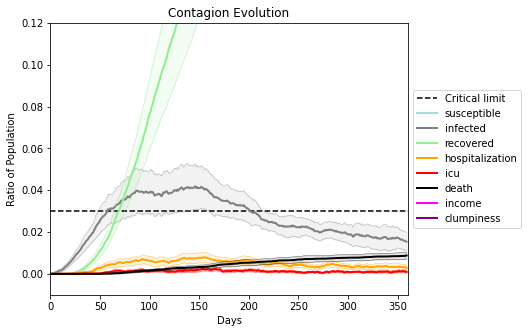

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[411, 3417, 3358, 8931, 4597, 6830, 907, 5238, 849, 756, 6110, 6583, 958, 5274, 306, 3251, 8838, 9228, 1376, 997]
Average similarity between family members is 0.34598898740684464 at temperature -0.7
Average similarity between family and home is 0.9998551123007076 at temperature -1
Average similarity between students and their classroom is 0.1619249049921959 at temperature -0.7
Average classroom occupancy is 1.588235294117647 and number classrooms is 187
Average similarity between workers is 0.1605829573607131 at temperature -0.7
Average office occupancy is 3.2039800995024876 and number offices is 201
Average friend similarity for adults: 0.4179244725896682 for kids: 0.30469133964515327
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.0989511192555029
avg restaurant similarity 0.05077063171647621
avg restaurant similarity 0.032458256400037085
avg restaurant similarity 0.045483227069922756
avg restaurant similarity 0.09685329921742596
avg restaurant similarity 0.06584921011333032
avg restaurant similarity 0.07471641015369196
avg restaurant similarity 0.11878339906963511
avg restaurant similarity 0.0712857257709081
avg restaurant similarity 0.08570115781827785
avg restaurant similarity 0.06022082648242668
avg restaurant similarity 0.06925048512581482
avg restaurant similarity 0.08795889473565524
avg restaurant similarity 0.05823181941360312
avg restaurant similarity 0.030736471176244548
avg restaurant similarity 0.06252637144475737
avg restaurant similarity 0.11081091707250972
avg restaurant similarity 0.0359863677960142
avg restaurant similarity 0.070681325379774
avg restaurant similarity 0.008603604508712953
avg restaurant similarity 0.06633014781938344
avg restaurant similarity 0.0483270

avg restaurant similarity -0.019933118258477028
avg restaurant similarity 0.05837730447801737
avg restaurant similarity 0.052449271172081355
avg restaurant similarity 0.019399662466220723
avg restaurant similarity 0.1009130359391816
avg restaurant similarity 0.0818523931911644
avg restaurant similarity 0.10993790427563958
avg restaurant similarity 0.07384106207033171
avg restaurant similarity 0.025656714342134897
avg restaurant similarity 0.11094560418083986
avg restaurant similarity 0.07554124366354464
avg restaurant similarity 0.04121410684538656
avg restaurant similarity 0.03360879387783984
avg restaurant similarity 0.04258591313449718
avg restaurant similarity 0.05910151367947237
avg restaurant similarity 0.0477801498819771
avg restaurant similarity 0.07565105081628946
avg restaurant similarity 0.040910930469421986
avg restaurant similarity 0.006734316375317142
avg restaurant similarity 0.07494298499338974
avg restaurant similarity 0.007999827387566648
avg restaurant similarity 0.0

avg restaurant similarity 0.0992708657610571
avg restaurant similarity 0.06374935982820054
avg restaurant similarity 0.10007216037119417
avg restaurant similarity 0.050910945011291786
Average similarity between family members is 0.3410860717327469 at temperature -0.7
Average similarity between family and home is 0.9998513331751832 at temperature -1
Average similarity between students and their classroom is 0.21891502635638013 at temperature -0.7
Average classroom occupancy is 1.591160220994475 and number classrooms is 181
Average similarity between workers is 0.1724506987712945 at temperature -0.7
Average office occupancy is 3.1881188118811883 and number offices is 202
Average friend similarity for adults: 0.427433216158698 for kids: 0.2985446796045526
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity 0.10310524318109825
avg restaurant similarity 0.08611233314159071
avg restaurant similarity 0.042860931580705586
avg restaurant similarity 0.11751006726220528
avg restaurant similarity 0.046958125556126315
avg restaurant similarity 0.13046941817810837
avg restaurant similarity 0.06865430286574778
avg restaurant similarity 0.06905189206945292
avg restaurant similarity 0.052502031140991424
avg restaurant similarity 0.13218966340218372
avg restaurant similarity 0.10401732042445688
avg restaurant similarity 0.07413041305584017
avg restaurant similarity 0.05699603603548678
avg restaurant similarity 0.05448635709025245
avg restaurant similarity 0.07526141794969292
avg restaurant similarity 0.05092904750699367
avg restaurant similarity 0.06972534193729704
avg restaurant similarity 0.06468627514246918
avg restaurant similarity 0.06495581758799623
avg restaurant similarity 0.07619921866980792
avg restaurant similarity -0.00024868533669756567
avg restaurant similarity 0

avg restaurant similarity 0.034708161186347376
avg restaurant similarity 0.0171801779996227
avg restaurant similarity 0.1371063624888562
avg restaurant similarity 0.06906389867888607
avg restaurant similarity 0.0487133026897731
avg restaurant similarity 0.09502297589085794
avg restaurant similarity 0.06809648816785893
avg restaurant similarity 0.08762027432421224
avg restaurant similarity 0.11966633803852225
avg restaurant similarity 0.1061342879310507
avg restaurant similarity 0.07294357168485072
avg restaurant similarity 0.10796850056485639
avg restaurant similarity 0.1423267731684394
avg restaurant similarity 0.06894674292210043
avg restaurant similarity 0.08927202079363909
avg restaurant similarity 0.01611725134441673
avg restaurant similarity 0.09428100242371774
avg restaurant similarity 0.11368325388727572
avg restaurant similarity 0.08507907230653146
avg restaurant similarity 0.04840785558200961
avg restaurant similarity 0.08741202754954092
avg restaurant similarity 0.1244134511

avg restaurant similarity 0.06151866814478667
avg restaurant similarity 0.03964811072407003
avg restaurant similarity 0.09350721231881678
avg restaurant similarity 0.04990180535020739
Average similarity between family members is 0.36263105401920986 at temperature -0.7
Average similarity between family and home is 0.9998557714945512 at temperature -1
Average similarity between students and their classroom is 0.16705481116629856 at temperature -0.7
Average classroom occupancy is 1.5343915343915344 and number classrooms is 189
Average similarity between workers is 0.2049122216921827 at temperature -0.7
Average office occupancy is 3.267326732673267 and number offices is 202
Average friend similarity for adults: 0.4343228215122021 for kids: 0.3024032744785834
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.13810943651001256
avg restaurant similarity 0.078375272069378
avg restaurant similarity 0.050801170265919564
avg restaurant similarity 0.18915767432269015
avg restaurant similarity 0.1773104534170477
avg restaurant similarity 0.12199214127503823
avg restaurant similarity 0.1239250559025057
avg restaurant similarity 0.1150750269449634
avg restaurant similarity 0.08036624733408264
avg restaurant similarity 0.10170626937373463
avg restaurant similarity 0.08967391964324993
avg restaurant similarity 0.046329005524060406
avg restaurant similarity 0.03430145746718064
avg restaurant similarity 0.09716406800067356
avg restaurant similarity 0.1586876005746036
avg restaurant similarity 0.09882555739946484
avg restaurant similarity 0.1402728469559514
avg restaurant similarity 0.11834333233335419
avg restaurant similarity 0.16290890920584697
avg restaurant similarity 0.0404673078146948
avg restaurant similarity 0.0636364002513158
avg restaurant similarity 0.0919527012588

avg restaurant similarity 0.12431355278025007
avg restaurant similarity 0.06998492132423112
avg restaurant similarity 0.0655428020914949
avg restaurant similarity 0.14654549647382753
avg restaurant similarity 0.1094204956624192
avg restaurant similarity 0.06975483766660903
avg restaurant similarity 0.12089257196800009
avg restaurant similarity 0.09309578013386999
avg restaurant similarity 0.11610217724833193
avg restaurant similarity 0.10989072749937993
avg restaurant similarity 0.14906146022969266
avg restaurant similarity 0.14356557612793763
avg restaurant similarity 0.1004039878387494
avg restaurant similarity 0.18817198343145683
avg restaurant similarity 0.13996512377182826
avg restaurant similarity 0.08980725944262219
avg restaurant similarity 0.08651388004645597
avg restaurant similarity 0.11601162445606411
avg restaurant similarity 0.13102787237703933
avg restaurant similarity 0.01056552510934318
avg restaurant similarity 0.08007790672166724
avg restaurant similarity 0.132215029

avg restaurant similarity 0.090024978101665
avg restaurant similarity 0.07923934497197418
Average similarity between family members is 0.33961875184880075 at temperature -0.7
Average similarity between family and home is 0.9998638344473714 at temperature -1
Average similarity between students and their classroom is 0.1766670616244411 at temperature -0.7
Average classroom occupancy is 1.6397849462365592 and number classrooms is 186
Average similarity between workers is 0.17146143968351182 at temperature -0.7
Average office occupancy is 3.199004975124378 and number offices is 201
Average friend similarity for adults: 0.4178240656321102 for kids: 0.30221168221450784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.057650518389050366
avg restaurant similarity 0.06772392581935266
avg restaurant similarity 0.020407165101134234
avg restaurant similarity 0.07627143686046253
avg restaurant similarity 0.12112716414157484
avg restaurant similarity 0.05655421527175084
avg restaurant similarity 0.058053956248663344
avg restaurant similarity 0.07544581608868846
avg restaurant similarity 0.05260535638981674
avg restaurant similarity 0.10986672476494509
avg restaurant similarity 0.06890838210965763
avg restaurant similarity 0.10097146311037496
avg restaurant similarity 0.14045460236293356
avg restaurant similarity 0.053997471928126616
avg restaurant similarity 0.09557200417071093
avg restaurant similarity 0.08480720104315623
avg restaurant similarity 0.0835300826312563
avg restaurant similarity 0.05013249377175112
avg restaurant similarity 0.0673289502597805
avg restaurant similarity 0.05495281378076878
avg restaurant similarity 0.09941361232651212
avg restaurant similarity 0.0416

avg restaurant similarity 0.05708162050934797
avg restaurant similarity 0.040198867654473405
avg restaurant similarity 0.030778184059896505
avg restaurant similarity 0.06823717698910757
avg restaurant similarity 0.10648961669895572
avg restaurant similarity 0.08265028274551645
avg restaurant similarity 0.05927934758160187
avg restaurant similarity 0.058706056607952806
avg restaurant similarity 0.05538211243171076
avg restaurant similarity 0.04985740533452668
avg restaurant similarity 0.07979800939860038
avg restaurant similarity 0.0586479643442874
avg restaurant similarity -0.008829702568376658
avg restaurant similarity 0.09705963610756507
avg restaurant similarity 0.12541852158611153
avg restaurant similarity 0.11529737425580157
avg restaurant similarity 0.11527235424936959
avg restaurant similarity 0.07339267725663112
avg restaurant similarity 0.07784752216123672
avg restaurant similarity 0.05890105137821659
avg restaurant similarity 0.05827826742252683
avg restaurant similarity 0.01

avg restaurant similarity 0.10437108099533088
avg restaurant similarity 0.08888095677032287
avg restaurant similarity 0.040177838559028164
avg restaurant similarity 0.10361164293647628
Average similarity between family members is 0.3383967069339092 at temperature -0.7
Average similarity between family and home is 0.9998496451007811 at temperature -1
Average similarity between students and their classroom is 0.17085993070643934 at temperature -0.7
Average classroom occupancy is 1.6222222222222222 and number classrooms is 180
Average similarity between workers is 0.20958526995735743 at temperature -0.7
Average office occupancy is 3.1116504854368934 and number offices is 206
Average friend similarity for adults: 0.4213897704931425 for kids: 0.3045336500038908
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.11494435741651145
avg restaurant similarity 0.095792504745739
avg restaurant similarity 0.11106809593680964
avg restaurant similarity 0.0391146170274246
avg restaurant similarity 0.039953258750984655
avg restaurant similarity 0.014688720237945325
avg restaurant similarity -0.015309798276107102
avg restaurant similarity 0.043749410208795005
avg restaurant similarity 0.07756925086180376
avg restaurant similarity 0.07396273280423718
avg restaurant similarity 0.0795260866370439
avg restaurant similarity 0.08242876667631338
avg restaurant similarity 0.08735404587874343
avg restaurant similarity 0.09237808667507631
avg restaurant similarity 0.1262091829241395
avg restaurant similarity 0.05109439135901979
avg restaurant similarity 0.11116772345430062
avg restaurant similarity 0.04627683963205161
avg restaurant similarity 0.053692423997089914
avg restaurant similarity 0.09466316953211242
avg restaurant similarity 0.04132809252782574
avg restaurant similarity 0.05488

avg restaurant similarity 0.1341618779628001
avg restaurant similarity 0.0542938653343027
avg restaurant similarity 0.06197357115867124
avg restaurant similarity 0.11110796757197962
avg restaurant similarity 0.09192400814135028
avg restaurant similarity 0.09568055218223649
avg restaurant similarity 0.016039717636787132
avg restaurant similarity 0.061316274774156486
avg restaurant similarity 0.06633880290382907
avg restaurant similarity 0.06075253837128575
avg restaurant similarity 0.07221454799919856
avg restaurant similarity -0.000829365045175906
avg restaurant similarity 0.10295206652468251
avg restaurant similarity 0.03667374236842396
avg restaurant similarity 0.10506474731153223
avg restaurant similarity 0.14037542181869703
avg restaurant similarity 0.09898185371383919
avg restaurant similarity 0.053220043946365675
avg restaurant similarity 0.09141156093274437
avg restaurant similarity 0.13493550897299758
avg restaurant similarity 0.06441536356845277
avg restaurant similarity 0.140

avg restaurant similarity 0.09780731937221068
avg restaurant similarity 0.12707172896366212
avg restaurant similarity 0.07460563968703253
Average similarity between family members is 0.35260996585307514 at temperature -0.7
Average similarity between family and home is 0.9998569178149974 at temperature -1
Average similarity between students and their classroom is 0.17176446315749053 at temperature -0.7
Average classroom occupancy is 1.6424581005586592 and number classrooms is 179
Average similarity between workers is 0.1782647489893833 at temperature -0.7
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.4309112952420112 for kids: 0.3145558360860585
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.07257701880747651
avg restaurant similarity 0.1524665296783163
avg restaurant similarity 0.1291842971979708
avg restaurant similarity 0.13088072971228443
avg restaurant similarity 0.05294071576754571
avg restaurant similarity 0.12068528071784947
avg restaurant similarity 0.10746809971923296
avg restaurant similarity 0.08588131593106768
avg restaurant similarity 0.10297939355242869
avg restaurant similarity 0.12468228987250318
avg restaurant similarity 0.1375930498708508
avg restaurant similarity 0.14504839296155592
avg restaurant similarity 0.06949454693629871
avg restaurant similarity 0.07647141485187404
avg restaurant similarity 0.07262931378371204
avg restaurant similarity 0.12809095757223093
avg restaurant similarity 0.10110520178680857
avg restaurant similarity 0.06697745653366374
avg restaurant similarity 0.07674034646730644
avg restaurant similarity 0.08929751443997352
avg restaurant similarity 0.08715754164300843
avg restaurant similarity 0.113367237

avg restaurant similarity 0.04726747583080024
avg restaurant similarity 0.09048898242815512
avg restaurant similarity 0.09051444727520748
avg restaurant similarity 0.12879853271793618
avg restaurant similarity 0.09053911539469682
avg restaurant similarity 0.09729428931523967
avg restaurant similarity 0.05400659446937334
avg restaurant similarity 0.057248582156419314
avg restaurant similarity 0.10386456729797135
avg restaurant similarity 0.11029609123443188
avg restaurant similarity 0.13384402591849018
avg restaurant similarity 0.10241715863369676
avg restaurant similarity 0.1145452055902601
avg restaurant similarity 0.07790761954237667
avg restaurant similarity 0.03095099794569239
avg restaurant similarity 0.018254912270185008
avg restaurant similarity 0.047191300610609666
avg restaurant similarity 0.06700818045047624
avg restaurant similarity 0.0352253176409074
avg restaurant similarity 0.07768708247571636
avg restaurant similarity 0.06257655658623908
avg restaurant similarity 0.13929

avg restaurant similarity 0.06167055067027149
avg restaurant similarity 0.02668239986292392
Average similarity between family members is 0.3493781868896954 at temperature -0.7
Average similarity between family and home is 0.999855571971685 at temperature -1
Average similarity between students and their classroom is 0.14174882926870602 at temperature -0.7
Average classroom occupancy is 1.6555555555555554 and number classrooms is 180
Average similarity between workers is 0.2078289688669749 at temperature -0.7
Average office occupancy is 3.200980392156863 and number offices is 204
Average friend similarity for adults: 0.4320832547607642 for kids: 0.30354718597768565
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated 

avg restaurant similarity 0.052167704781489965
avg restaurant similarity 0.13294207826850937
avg restaurant similarity 0.05088634740656594
avg restaurant similarity 0.13730941556290993
avg restaurant similarity 0.1304845980918245
avg restaurant similarity 0.1617753493812432
avg restaurant similarity 0.0862885255208361
avg restaurant similarity 0.05610364577532919
avg restaurant similarity 0.040926894754379044
avg restaurant similarity 0.12488405308703517
avg restaurant similarity 0.03998954930836032
avg restaurant similarity 0.09140373124431522
avg restaurant similarity 0.09080408693957914
avg restaurant similarity 0.13782115130463596
avg restaurant similarity 0.11794634450561722
avg restaurant similarity 0.04972566487798637
avg restaurant similarity 0.14926240661418216
avg restaurant similarity 0.09405363590067228
avg restaurant similarity 0.14145330686813024
avg restaurant similarity 0.06211630265383051
avg restaurant similarity 0.09845266971202905
avg restaurant similarity 0.1226743

avg restaurant similarity 0.08116282103680965
avg restaurant similarity 0.04734762412725317
avg restaurant similarity 0.07576858294318996
avg restaurant similarity 0.12186193174018657
avg restaurant similarity 0.07949129042579552
avg restaurant similarity 0.07799349104001774
avg restaurant similarity 0.10972747405220899
avg restaurant similarity 0.06381106887299703
avg restaurant similarity 0.05041751764981865
avg restaurant similarity 0.02308235829697017
avg restaurant similarity 0.1480923733446073
avg restaurant similarity 0.07900603793272139
avg restaurant similarity 0.0924219578784413
avg restaurant similarity 0.07795907552852341
avg restaurant similarity 0.11676837720669443
avg restaurant similarity 0.08906216344562223
avg restaurant similarity 0.14563397117783194
avg restaurant similarity 0.0896891105454291
avg restaurant similarity 0.07972468460770063
avg restaurant similarity 0.059286003544739785
avg restaurant similarity 0.12365058867909534
avg restaurant similarity 0.09918598

avg restaurant similarity 0.10683082257865874
avg restaurant similarity 0.08981808534111414
Average similarity between family members is 0.3497430860606773 at temperature -0.7
Average similarity between family and home is 0.9998635482263195 at temperature -1
Average similarity between students and their classroom is 0.1446402287732885 at temperature -0.7
Average classroom occupancy is 1.7297297297297298 and number classrooms is 185
Average similarity between workers is 0.18551778834382457 at temperature -0.7
Average office occupancy is 3.142156862745098 and number offices is 204
Average friend similarity for adults: 0.42727011220872013 for kids: 0.3086324637214357
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.04761799730873695
avg restaurant similarity 0.11124166536342746
avg restaurant similarity 0.04374190612717153
avg restaurant similarity 0.07076408819709497
avg restaurant similarity 0.08694233237889898
avg restaurant similarity 0.039316037814159856
avg restaurant similarity 0.08722586779159121
avg restaurant similarity 0.05257565270318357
avg restaurant similarity 0.06096903951064445
avg restaurant similarity 0.11875766344809081
avg restaurant similarity 0.13687223530821535
avg restaurant similarity 0.10597349498361064
avg restaurant similarity 0.1372938919985891
avg restaurant similarity 0.11416082027568064
avg restaurant similarity 0.07137236897953331
avg restaurant similarity 0.0913069739423932
avg restaurant similarity 0.06283973307453093
avg restaurant similarity 0.09329763295010163
avg restaurant similarity 0.08884038031889152
avg restaurant similarity 0.08394298061256733
avg restaurant similarity 0.09528215432229552
avg restaurant similarity 0.0769092

avg restaurant similarity -0.008617139184818504
avg restaurant similarity 0.05152212612148822
avg restaurant similarity 0.09567016986176109
avg restaurant similarity 0.14131814524613823
avg restaurant similarity 0.07551991057910214
avg restaurant similarity 0.08962127451254631
avg restaurant similarity 0.0034369914928739165
avg restaurant similarity 0.05622729255867037
avg restaurant similarity 0.12074384162299046
avg restaurant similarity 0.04921066536801648
avg restaurant similarity 0.1032229978753294
avg restaurant similarity 0.09103535110368914
avg restaurant similarity 0.0913218786320482
avg restaurant similarity 0.11055180710467821
avg restaurant similarity 0.050554224181963904
avg restaurant similarity 0.10379198637436486
avg restaurant similarity 0.06367103430710969
avg restaurant similarity 0.032294632135989425
avg restaurant similarity 0.018192977441809772
avg restaurant similarity 0.12401497669437289
avg restaurant similarity 0.06482160416893297
avg restaurant similarity 0.1

avg restaurant similarity 0.02799671076482086
avg restaurant similarity 0.025181107774261642
avg restaurant similarity 0.03633120255530608
avg restaurant similarity 0.09800353808518152
Average similarity between family members is 0.35160179803737823 at temperature -0.7
Average similarity between family and home is 0.999857702987484 at temperature -1
Average similarity between students and their classroom is 0.16075220653084737 at temperature -0.7
Average classroom occupancy is 1.5628415300546448 and number classrooms is 183
Average similarity between workers is 0.17203288895282903 at temperature -0.7
Average office occupancy is 3.29064039408867 and number offices is 203
Average friend similarity for adults: 0.42342038229318923 for kids: 0.29131928939234913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.026368292106345323
avg restaurant similarity 0.026504184118622272
avg restaurant similarity 0.07378349544765286
avg restaurant similarity 0.10026635893722424
avg restaurant similarity 0.10998953289105766
avg restaurant similarity 0.14397668276561934
avg restaurant similarity 0.060536749044530505
avg restaurant similarity 0.056117128368245374
avg restaurant similarity 0.01700485463190291
avg restaurant similarity 0.09763367417724983
avg restaurant similarity 0.056868071042586746
avg restaurant similarity 0.062499024452427256
avg restaurant similarity 0.035536139141182456
avg restaurant similarity 0.09578434716124763
avg restaurant similarity 0.04112085651865225
avg restaurant similarity 0.05325006008641563
avg restaurant similarity 0.0649525817998267
avg restaurant similarity 0.07264688837657654
avg restaurant similarity 0.034404016656446205
avg restaurant similarity 0.07379835283061793
avg restaurant similarity 0.10721638980287605
avg restaurant similarity 0

avg restaurant similarity 0.10633801375051032
avg restaurant similarity 0.04265675978794457
avg restaurant similarity 0.054780006742013235
avg restaurant similarity 0.07163532212141707
avg restaurant similarity 0.06632759026118445
avg restaurant similarity 0.05536401336301419
avg restaurant similarity 0.1153499753533888
avg restaurant similarity 0.04871710898320712
avg restaurant similarity 0.12472305574593012
avg restaurant similarity 0.13850188920981188
avg restaurant similarity 0.1085190933224481
avg restaurant similarity 0.12071042632427886
avg restaurant similarity 0.08052758896796003
avg restaurant similarity 0.05319711473637091
avg restaurant similarity 0.08192118908901654
avg restaurant similarity 0.04271805930136384
avg restaurant similarity 0.08084728589076241
avg restaurant similarity 0.10261402484820306
avg restaurant similarity 0.09675896939850147
avg restaurant similarity 0.025442660041702418
avg restaurant similarity 0.10206003300811298
avg restaurant similarity 0.065763

avg restaurant similarity 0.08161505250404749
avg restaurant similarity 0.13012980235931354
avg restaurant similarity 0.11350452894297598
avg restaurant similarity 0.004608818159065793
Average similarity between family members is 0.33556955886955186 at temperature -0.7
Average similarity between family and home is 0.9998539475698771 at temperature -1
Average similarity between students and their classroom is 0.19159035102777205 at temperature -0.7
Average classroom occupancy is 1.6022099447513811 and number classrooms is 181
Average similarity between workers is 0.15391632773130282 at temperature -0.7
Average office occupancy is 3.1707317073170733 and number offices is 205
Average friend similarity for adults: 0.41775173657839937 for kids: 0.2885909994352347
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.11642145748163651
avg restaurant similarity 0.03853728424062235
avg restaurant similarity 0.09092055270091444
avg restaurant similarity 0.0759867321232865
avg restaurant similarity 0.02851859473244525
avg restaurant similarity 0.057836059136449555
avg restaurant similarity 0.011911413847049915
avg restaurant similarity 0.02714811512661058
avg restaurant similarity 0.0843112886127967
avg restaurant similarity 0.059097674524793496
avg restaurant similarity 0.05104210818639271
avg restaurant similarity 0.0782765661444603
avg restaurant similarity 0.08570448101463167
avg restaurant similarity 0.055065207207202344
avg restaurant similarity 0.07315959959317017
avg restaurant similarity 0.046376854738209884
avg restaurant similarity 0.07837491816422243
avg restaurant similarity 0.074958889359657
avg restaurant similarity 0.05716637322427745
avg restaurant similarity 0.04351981750571933
avg restaurant similarity 0.04771719911820657
avg restaurant similarity 0.097681

avg restaurant similarity 0.030372635339540904
avg restaurant similarity 0.03027946265801108
avg restaurant similarity 0.05930899871914552
avg restaurant similarity 0.04185314899838652
avg restaurant similarity 0.0773193109476459
avg restaurant similarity 0.05183318118173838
avg restaurant similarity 0.06463792982410951
avg restaurant similarity 0.07851858823432352
avg restaurant similarity 0.039735069603608855
avg restaurant similarity 0.10823718649077227
avg restaurant similarity 0.05378465577775641
avg restaurant similarity 0.04326126761458038
avg restaurant similarity 0.0795642451237969
avg restaurant similarity 0.03846330116745589
avg restaurant similarity 0.041833606686057026
avg restaurant similarity 0.042535417750959904
avg restaurant similarity 0.00583319269019585
avg restaurant similarity 0.07141474223361689
avg restaurant similarity 0.012711422581502164
avg restaurant similarity 0.07978288688124628
avg restaurant similarity 0.06784085577635779
avg restaurant similarity 0.076

avg restaurant similarity 0.13562908298829754
avg restaurant similarity 0.07777406819798705
avg restaurant similarity 0.046375066044479475
avg restaurant similarity 0.04052368829319859
Average similarity between family members is 0.3523286677864367 at temperature -0.7
Average similarity between family and home is 0.9998521471230853 at temperature -1
Average similarity between students and their classroom is 0.1574146198655386 at temperature -0.7
Average classroom occupancy is 1.5846994535519126 and number classrooms is 183
Average similarity between workers is 0.17779820390825254 at temperature -0.7
Average office occupancy is 3.3282828282828283 and number offices is 198
Average friend similarity for adults: 0.42667565393127693 for kids: 0.29650570116706987
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.08078797865795477
avg restaurant similarity 0.07661689536816356
avg restaurant similarity 0.10505138826976833
avg restaurant similarity 0.1080913354891095
avg restaurant similarity 0.09665018835995749
avg restaurant similarity 0.033834314600184635
avg restaurant similarity 0.08676961594274293
avg restaurant similarity 0.06886669990110157
avg restaurant similarity 0.08779570478215282
avg restaurant similarity 0.08670607334447776
avg restaurant similarity 0.0795229806621465
avg restaurant similarity 0.052178874239452874
avg restaurant similarity 0.03439243829845751
avg restaurant similarity 0.10291797272979387
avg restaurant similarity 0.0787816024480992
avg restaurant similarity 0.09418693961790267
avg restaurant similarity 0.12064585553063603
avg restaurant similarity 0.0226495490374935
avg restaurant similarity 0.037965245787948326
avg restaurant similarity 0.06285315048912904
avg restaurant similarity 0.03588927611171234
avg restaurant similarity 0.0804125

avg restaurant similarity 0.09222248976414511
avg restaurant similarity 0.029553665365097397
avg restaurant similarity 0.1079254858241344
avg restaurant similarity 0.033951207650379525
avg restaurant similarity 0.0754197574230991
avg restaurant similarity 0.06932340044494263
avg restaurant similarity 0.07204602518867852
avg restaurant similarity 0.080559248980557
avg restaurant similarity 0.11866254454227662
avg restaurant similarity 0.10545142059059372
avg restaurant similarity 0.07523696563342602
avg restaurant similarity 0.1458145427957325
avg restaurant similarity 0.06730645993677269
avg restaurant similarity 0.032996060491980145
avg restaurant similarity 0.12214097867979964
avg restaurant similarity 0.08887977064834542
avg restaurant similarity 0.109601672215346
avg restaurant similarity 0.07776052897249999
avg restaurant similarity 0.11474467341658688
avg restaurant similarity 0.05156990905503923
avg restaurant similarity 0.10181622050024114
avg restaurant similarity 0.1096602439

avg restaurant similarity 0.08397102289005408
avg restaurant similarity 0.08439094088930513
Average similarity between family members is 0.35355297679013314 at temperature -0.7
Average similarity between family and home is 0.9998556066829742 at temperature -1
Average similarity between students and their classroom is 0.18532631831649313 at temperature -0.7
Average classroom occupancy is 1.6555555555555554 and number classrooms is 180
Average similarity between workers is 0.17336738648645397 at temperature -0.7
Average office occupancy is 3.2160804020100504 and number offices is 199
Average friend similarity for adults: 0.42489526966675306 for kids: 0.3073389933174397
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 alloca

avg restaurant similarity 0.07384073643714274
avg restaurant similarity 0.06523314903511557
avg restaurant similarity 0.0778268935972812
avg restaurant similarity 0.13573400425442791
avg restaurant similarity 0.07339744968944686
avg restaurant similarity 0.1077006874472092
avg restaurant similarity 0.10267487734269781
avg restaurant similarity 0.08770990106429352
avg restaurant similarity 0.08313142198034817
avg restaurant similarity 0.07543079451169572
avg restaurant similarity 0.089125739371864
avg restaurant similarity 0.11472467732511223
avg restaurant similarity 0.1014367956152224
avg restaurant similarity 0.06173631116579948
avg restaurant similarity 0.03246908213202642
avg restaurant similarity 0.0034510584843983868
avg restaurant similarity 0.09405770535983943
avg restaurant similarity 0.11920832150961304
avg restaurant similarity 0.076865227574276
avg restaurant similarity 0.0843251550330281
avg restaurant similarity 0.09349860242312708
avg restaurant similarity 0.077376460431

avg restaurant similarity 0.10415574165383322
avg restaurant similarity 0.08836391792230189
avg restaurant similarity 0.11139160456437865
avg restaurant similarity 0.06096079387657611
avg restaurant similarity 0.036218855612672456
avg restaurant similarity 0.061827363097064714
avg restaurant similarity 0.025780097564967686
avg restaurant similarity 0.1144388008879154
avg restaurant similarity 0.09102963078643037
avg restaurant similarity 0.09561103350244225
avg restaurant similarity 0.10345286481119646
avg restaurant similarity 0.05798648537834194
avg restaurant similarity 0.09385684686237555
avg restaurant similarity 0.05257121649378448
avg restaurant similarity 0.09061553742858128
avg restaurant similarity 0.15031447550446808
avg restaurant similarity 0.06854828325854406
avg restaurant similarity 0.048136182004458204
avg restaurant similarity 0.10769672543401089
avg restaurant similarity 0.12281159239509573
avg restaurant similarity 0.07995055870731954
avg restaurant similarity 0.140

avg restaurant similarity 0.11378225635399687
avg restaurant similarity 0.08046103812449398
avg restaurant similarity 0.11280456353839535
Average similarity between family members is 0.35683345546416806 at temperature -0.7
Average similarity between family and home is 0.9998635512383501 at temperature -1
Average similarity between students and their classroom is 0.1896242051029409 at temperature -0.7
Average classroom occupancy is 1.6292134831460674 and number classrooms is 178
Average similarity between workers is 0.18346540492158264 at temperature -0.7
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.42438799817375367 for kids: 0.3125159002517968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.1038548951725858
avg restaurant similarity 0.09721504297061519
avg restaurant similarity 0.03370220301361458
avg restaurant similarity 0.06216802457829386
avg restaurant similarity 0.10119053549798857
avg restaurant similarity 0.1087537992671591
avg restaurant similarity 0.09057504643737996
avg restaurant similarity 0.07850782754387904
avg restaurant similarity 0.05174669771095807
avg restaurant similarity 0.031038187418006076
avg restaurant similarity 0.06884882876137059
avg restaurant similarity 0.10054942265595891
avg restaurant similarity 0.06986968132295454
avg restaurant similarity 0.10703726719482037
avg restaurant similarity 0.14416130592171378
avg restaurant similarity 0.040812630385652006
avg restaurant similarity 0.11604464089817937
avg restaurant similarity 0.10861448139006132
avg restaurant similarity 0.08212596114692153
avg restaurant similarity 0.11731388373054491
avg restaurant similarity 0.10179351632445115
avg restaurant similarity 0.131029

avg restaurant similarity 0.12105435687141361
avg restaurant similarity 0.08732883368007965
avg restaurant similarity 0.13691346468109827
avg restaurant similarity 0.0726646794324611
avg restaurant similarity 0.13946694156675854
avg restaurant similarity 0.13564083198466084
avg restaurant similarity 0.10588582528882343
avg restaurant similarity 0.1507781391548922
avg restaurant similarity 0.018379751486125404
avg restaurant similarity 0.10133813818574232
avg restaurant similarity 0.10956905259290282
avg restaurant similarity 0.07741388402338129
avg restaurant similarity 0.07580015731678175
avg restaurant similarity 0.09317171347416707
avg restaurant similarity 0.09730106017507896
avg restaurant similarity 0.14021072121545458
avg restaurant similarity 0.13840993485472602
avg restaurant similarity 0.05890012318191685
avg restaurant similarity 0.05901711217316296
avg restaurant similarity 0.14402283277499808
avg restaurant similarity 0.04503073874075381
avg restaurant similarity 0.1022136

avg restaurant similarity 0.06731040608756805
avg restaurant similarity 0.08192663391875302
avg restaurant similarity 0.09251172768283052
Average similarity between family members is 0.32243760124023085 at temperature -0.7
Average similarity between family and home is 0.9998546988156772 at temperature -1
Average similarity between students and their classroom is 0.15332561718612095 at temperature -0.7
Average classroom occupancy is 1.6321243523316062 and number classrooms is 193
Average similarity between workers is 0.1638912134755842 at temperature -0.7
Average office occupancy is 3.1940298507462686 and number offices is 201
Average friend similarity for adults: 0.4205155666351775 for kids: 0.30176568524990566
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.11792347755284402
avg restaurant similarity 0.06438356611589002
avg restaurant similarity 0.07834281248904086
avg restaurant similarity 0.0750419522990812
avg restaurant similarity 0.05532164758210873
avg restaurant similarity 0.04332545593085317
avg restaurant similarity 0.1639922027526064
avg restaurant similarity 0.061658554220444514
avg restaurant similarity 0.09337483416887729
avg restaurant similarity 0.08806481935183877
avg restaurant similarity 0.09724596423933383
avg restaurant similarity 0.1311059581082034
avg restaurant similarity 0.1116197946016541
avg restaurant similarity 0.1322816454551379
avg restaurant similarity 0.08069023371976053
avg restaurant similarity 0.09291656723185553
avg restaurant similarity 0.07954893459573043
avg restaurant similarity 0.11139499979906738
avg restaurant similarity 0.08174621828695675
avg restaurant similarity 0.03945348181665234
avg restaurant similarity 0.10826897456465882
avg restaurant similarity 0.0866939280

avg restaurant similarity 0.09814898852065854
avg restaurant similarity 0.009197307261335982
avg restaurant similarity 0.0714261350388639
avg restaurant similarity 0.1422900018387447
avg restaurant similarity 0.09670955558634477
avg restaurant similarity 0.09829722232216236
avg restaurant similarity 0.15581027197591166
avg restaurant similarity 0.07732723038392475
avg restaurant similarity 0.1257863911394093
avg restaurant similarity 0.06576810641923904
avg restaurant similarity 0.08196992830308338
avg restaurant similarity 0.11528986036979426
avg restaurant similarity 0.14313356124823992
avg restaurant similarity 0.11171123292335064
avg restaurant similarity 0.034956402916551305
avg restaurant similarity 0.10945938464606411
avg restaurant similarity 0.16850870419041838
avg restaurant similarity 0.11321427331572087
avg restaurant similarity 0.1259307927919148
avg restaurant similarity 0.0340103678478068
avg restaurant similarity 0.07538668609318902
avg restaurant similarity 0.085359009

avg restaurant similarity 0.12039468738464286
avg restaurant similarity 0.11625819968766284
Average similarity between family members is 0.34381966101686134 at temperature -0.7
Average similarity between family and home is 0.9998670971082702 at temperature -1
Average similarity between students and their classroom is 0.17801214068556834 at temperature -0.7
Average classroom occupancy is 1.651685393258427 and number classrooms is 178
Average similarity between workers is 0.1945271237784224 at temperature -0.7
Average office occupancy is 3.3266331658291457 and number offices is 199
Average friend similarity for adults: 0.4285817254041035 for kids: 0.30341892300402556
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.10479964402324761
avg restaurant similarity 0.040150301235967266
avg restaurant similarity 0.1029611175902666
avg restaurant similarity 0.04728998540192469
avg restaurant similarity 0.11234491005393743
avg restaurant similarity 0.0947337184644518
avg restaurant similarity 0.05270198741497384
avg restaurant similarity 0.11075902772259916
avg restaurant similarity 0.07445456749227986
avg restaurant similarity 0.07411081707440004
avg restaurant similarity 0.07159636416634492
avg restaurant similarity 0.04985473098095912
avg restaurant similarity 0.03981352443166743
avg restaurant similarity 0.10151308301812657
avg restaurant similarity 0.08092427029183727
avg restaurant similarity 0.09630092866488695
avg restaurant similarity 0.05945475393956989
avg restaurant similarity 0.08243389848787464
avg restaurant similarity 0.029830786944271763
avg restaurant similarity 0.08135101224720215
avg restaurant similarity 0.08203528086228441
avg restaurant similarity 0.102947

avg restaurant similarity 0.0456106869506228
avg restaurant similarity 0.07388443257403025
avg restaurant similarity 0.02738985887760751
avg restaurant similarity 0.10360126544752543
avg restaurant similarity 0.10025601525906111
avg restaurant similarity 0.05327378312126692
avg restaurant similarity 0.05989861363981473
avg restaurant similarity 0.10555015525509406
avg restaurant similarity 0.04211231970432814
avg restaurant similarity 0.029921718062717925
avg restaurant similarity 0.06249659754256777
avg restaurant similarity 0.10528419277807376
avg restaurant similarity 0.10386146688370304
avg restaurant similarity 0.09166408825250354
avg restaurant similarity 0.048166926500428
avg restaurant similarity 0.039388698771868576
avg restaurant similarity 0.07403172744503964
avg restaurant similarity 0.08108267288234686
avg restaurant similarity 0.03912707727310708
avg restaurant similarity 0.07277525006988461
avg restaurant similarity 0.07222282997563399
avg restaurant similarity 0.0499910

avg restaurant similarity 0.04796108842870933
avg restaurant similarity 0.09255480181771576
Average similarity between family members is 0.332175293653417 at temperature -0.7
Average similarity between family and home is 0.999856097771717 at temperature -1
Average similarity between students and their classroom is 0.19892389771407962 at temperature -0.7
Average classroom occupancy is 1.6721311475409837 and number classrooms is 183
Average similarity between workers is 0.18686150887180378 at temperature -0.7
Average office occupancy is 3.155 and number offices is 200
Average friend similarity for adults: 0.41629501256907203 for kids: 0.2990831942306402
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a t

avg restaurant similarity 0.050147841420734224
avg restaurant similarity 0.07329307694745013
avg restaurant similarity 0.11151873903466834
avg restaurant similarity 0.09101001936236694
avg restaurant similarity 0.06049525891438433
avg restaurant similarity 0.12304118789732353
avg restaurant similarity 0.11237499689765282
avg restaurant similarity 0.040275185992388204
avg restaurant similarity 0.08854276850292886
avg restaurant similarity 0.014074912556486555
avg restaurant similarity 0.09968879473857074
avg restaurant similarity 0.042465547290000814
avg restaurant similarity 0.0945636024812446
avg restaurant similarity 0.07440045285380108
avg restaurant similarity 0.11112272234362687
avg restaurant similarity 0.07116243753540588
avg restaurant similarity 0.13574622925735497
avg restaurant similarity 0.08048490823670326
avg restaurant similarity 0.09431972529479205
avg restaurant similarity 0.10145105773091183
avg restaurant similarity 0.05180050064137665
avg restaurant similarity 0.059

avg restaurant similarity 0.13005777066154894
avg restaurant similarity 0.12144686182509104
avg restaurant similarity 0.06157482771152557
avg restaurant similarity 0.08274302430726031
avg restaurant similarity 0.07313487801757315
avg restaurant similarity 0.13679722111301224
avg restaurant similarity 0.11749125544494234
avg restaurant similarity -0.006098665528391404
avg restaurant similarity 0.09232464904090164
avg restaurant similarity 0.046491898689379314
avg restaurant similarity 0.059724945339012264
avg restaurant similarity 0.0057297977410493165
avg restaurant similarity 0.13044128593456705
avg restaurant similarity 0.14076974139659298
avg restaurant similarity 0.09857639255040668
avg restaurant similarity 0.10860178531233594
avg restaurant similarity 0.07012574057948326
avg restaurant similarity 0.06172822147536414
avg restaurant similarity 0.009979956993541757
avg restaurant similarity 0.05349888843133054
avg restaurant similarity 0.05232214218480963
avg restaurant similarity 0

avg restaurant similarity 0.09278349976087219
avg restaurant similarity 0.006445975659715577
avg restaurant similarity 0.010213567667009297
avg restaurant similarity 0.09969104413075912
Average similarity between family members is 0.35091338448389103 at temperature -0.7
Average similarity between family and home is 0.9998500220989502 at temperature -1
Average similarity between students and their classroom is 0.19703731970257612 at temperature -0.7
Average classroom occupancy is 1.6304347826086956 and number classrooms is 184
Average similarity between workers is 0.18504508898898844 at temperature -0.7
Average office occupancy is 3.23 and number offices is 200
Average friend similarity for adults: 0.422005805339223 for kids: 0.30086693114289115
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.08977909259214041
avg restaurant similarity 0.08368497908762948
avg restaurant similarity 0.0527212054701931
avg restaurant similarity 0.08253501194071258
avg restaurant similarity 0.05709299249722278
avg restaurant similarity 0.11151187016315589
avg restaurant similarity 0.048302742596884427
avg restaurant similarity 0.048812866726133636
avg restaurant similarity 0.05644024775033297
avg restaurant similarity 0.08052200748732206
avg restaurant similarity 0.11193790972851941
avg restaurant similarity 0.14981824658564302
avg restaurant similarity 0.08544478316649186
avg restaurant similarity 0.07570947497718783
avg restaurant similarity 0.0723547488375237
avg restaurant similarity 0.08801232806930899
avg restaurant similarity 0.09011373047225878
avg restaurant similarity 0.10382937761505409
avg restaurant similarity 0.05629085369909111
avg restaurant similarity 0.04567362165486941
avg restaurant similarity 0.09271572297592345
avg restaurant similarity 0.136665

avg restaurant similarity 0.028563596685886476
avg restaurant similarity 0.058283459595232075
avg restaurant similarity 0.053360886646345355
avg restaurant similarity 0.053878975663880134
avg restaurant similarity 0.08305762319320227
avg restaurant similarity 0.059055403202049606
avg restaurant similarity 0.09362414869724256
avg restaurant similarity 0.128045887717002
avg restaurant similarity 0.08209449653919416
avg restaurant similarity 0.07928390589740775
avg restaurant similarity 0.09647250033934436
avg restaurant similarity 0.03433301658578566
avg restaurant similarity 0.15727630488851324
avg restaurant similarity 0.08771953687809057
avg restaurant similarity 0.12607596684827516
avg restaurant similarity 0.09137327028169068
avg restaurant similarity 0.0790359393311271
avg restaurant similarity 0.12887835157972782
avg restaurant similarity 0.08858468825464505
avg restaurant similarity 0.06758609570478223
avg restaurant similarity 0.054083738708674285
avg restaurant similarity 0.111

avg restaurant similarity -0.01695804527375916
avg restaurant similarity 0.017670760101504403
avg restaurant similarity 0.08298682027716343
Average similarity between family members is 0.3794191189914199 at temperature -0.7
Average similarity between family and home is 0.9998493328432005 at temperature -1
Average similarity between students and their classroom is 0.2038032259077111 at temperature -0.7
Average classroom occupancy is 1.5847953216374269 and number classrooms is 171
Average similarity between workers is 0.2026827661141285 at temperature -0.7
Average office occupancy is 3.405940594059406 and number offices is 202
Average friend similarity for adults: 0.44233321227156175 for kids: 0.30152360273321044
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.12300490788448457
avg restaurant similarity 0.09708682532207316
avg restaurant similarity 0.10506420017498593
avg restaurant similarity 0.08514455835999517
avg restaurant similarity 0.10976505479084883
avg restaurant similarity 0.14448751462682227
avg restaurant similarity 0.13556533197601525
avg restaurant similarity 0.09613729652391806
avg restaurant similarity 0.12770875771032286
avg restaurant similarity 0.09698773187480401
avg restaurant similarity 0.09975841705737434
avg restaurant similarity 0.11973741552857242
avg restaurant similarity 0.09118831186975417
avg restaurant similarity 0.11567158603702533
avg restaurant similarity 0.056576058427451385
avg restaurant similarity 0.10128505524074437
avg restaurant similarity 0.17000105555557468
avg restaurant similarity 0.13361748424182956
avg restaurant similarity 0.1275786643492566
avg restaurant similarity 0.06661511758677048
avg restaurant similarity 0.08783562467094629
avg restaurant similarity 0.068102

avg restaurant similarity 0.07559985024657198
avg restaurant similarity 0.16145756185278456
avg restaurant similarity 0.07372215635304095
avg restaurant similarity 0.14468655119671608
avg restaurant similarity 0.13129328378714697
avg restaurant similarity 0.10107036353962154
avg restaurant similarity 0.12959728632701617
avg restaurant similarity 0.08739770377210694
avg restaurant similarity 0.16058976285671006
avg restaurant similarity 0.13220251052208334
avg restaurant similarity 0.08483104759758683
avg restaurant similarity 0.16236896339928744
avg restaurant similarity 0.07468892062819094
avg restaurant similarity 0.08044688357852826
avg restaurant similarity 0.1263610753389188
avg restaurant similarity 0.10454065086681634
avg restaurant similarity 0.08665538796681088
avg restaurant similarity 0.10758355292274432
avg restaurant similarity 0.1083797325146177
avg restaurant similarity 0.0879822129811192
avg restaurant similarity 0.05621299165229994
avg restaurant similarity 0.115074166

avg restaurant similarity 0.14320884585751206
avg restaurant similarity 0.09807340577759903
Average similarity between family members is 0.3424087282357006 at temperature -0.7
Average similarity between family and home is 0.9998600567970577 at temperature -1
Average similarity between students and their classroom is 0.16631541202525674 at temperature -0.7
Average classroom occupancy is 1.6228571428571428 and number classrooms is 175
Average similarity between workers is 0.20225201141410212 at temperature -0.7
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.43158585859044174 for kids: 0.30362265271518274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.10046522907819126
avg restaurant similarity 0.0424994369125159
avg restaurant similarity 0.08417049726791428
avg restaurant similarity 0.16517359072219887
avg restaurant similarity 0.026532160644173162
avg restaurant similarity -0.006565492608414348
avg restaurant similarity 0.07576885434963725
avg restaurant similarity 0.11290463241770006
avg restaurant similarity 0.09899044955824826
avg restaurant similarity 0.08449637208619015
avg restaurant similarity 0.05802977658782728
avg restaurant similarity 0.027246730540563213
avg restaurant similarity 0.01654221916049169
avg restaurant similarity 0.2136841783641701
avg restaurant similarity 0.06766999036632425
avg restaurant similarity 0.09806244480047932
avg restaurant similarity 0.08308329143367849
avg restaurant similarity 0.07657801833911594
avg restaurant similarity 0.0772209903438686
avg restaurant similarity 0.0597617041148895
avg restaurant similarity 0.01737980815751028
avg restaurant similarity 0.084948

avg restaurant similarity 0.07213719450676066
avg restaurant similarity 0.024200558306402924
avg restaurant similarity 0.039114077409956066
avg restaurant similarity 0.07093946857314386
avg restaurant similarity 0.1341042689588211
avg restaurant similarity 0.19318253349889541
avg restaurant similarity 0.06272906261771373
avg restaurant similarity 0.07286547306568869
avg restaurant similarity 0.04210009023519817
avg restaurant similarity 0.036977885479301205
avg restaurant similarity 0.1325730811739556
avg restaurant similarity 0.02997824253590414
avg restaurant similarity 0.1759318296192815
avg restaurant similarity 0.016101971745071914
avg restaurant similarity 0.1501484285324529
avg restaurant similarity 0.029278804477894292
avg restaurant similarity -0.04631731278951053
avg restaurant similarity 0.14740502398790165
avg restaurant similarity 0.039650609768793456
avg restaurant similarity 0.07501047353488957
avg restaurant similarity 0.11158798708237154
avg restaurant similarity 0.138

avg restaurant similarity 0.0824153981919841
avg restaurant similarity 0.18999886503429755
avg restaurant similarity 0.10722333816309669
Average similarity between family members is 0.34900316001943144 at temperature -0.7
Average similarity between family and home is 0.9998515203749532 at temperature -1
Average similarity between students and their classroom is 0.14092752070694148 at temperature -0.7
Average classroom occupancy is 1.6197916666666667 and number classrooms is 192
Average similarity between workers is 0.17036523015712723 at temperature -0.7
Average office occupancy is 3.1370558375634516 and number offices is 197
Average friend similarity for adults: 0.41707415055524116 for kids: 0.3116146759676867
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.05240853899936962
avg restaurant similarity 0.05022901000998996
avg restaurant similarity 0.11368398951433911
avg restaurant similarity 0.10124271879155383
avg restaurant similarity 0.0980412914038095
avg restaurant similarity 0.08465403296150277
avg restaurant similarity 0.05158873847991414
avg restaurant similarity 0.03214847995701862
avg restaurant similarity 0.0582162232238802
avg restaurant similarity 0.07559968984401474
avg restaurant similarity 0.04782780994301255
avg restaurant similarity 0.10243675654083555
avg restaurant similarity 0.07299079853821915
avg restaurant similarity 0.028975065675391147
avg restaurant similarity 0.030509006632268357
avg restaurant similarity 0.0620175620846744
avg restaurant similarity 0.048640140076615164
avg restaurant similarity 0.09200999800760871
avg restaurant similarity 0.08640195940945429
avg restaurant similarity 0.10444774841218168
avg restaurant similarity 0.04397933499183925
avg restaurant similarity 0.084725

avg restaurant similarity 0.05921799915991983
avg restaurant similarity 0.11030368748139925
avg restaurant similarity 0.06172930343467118
avg restaurant similarity 0.0299477024793615
avg restaurant similarity 0.03626599042829354
avg restaurant similarity 0.040841307983956056
avg restaurant similarity 0.07358715231057698
avg restaurant similarity 0.11737115290707897
avg restaurant similarity 0.026197821650034706
avg restaurant similarity 0.09734963327506958
avg restaurant similarity 0.05708977229269675
avg restaurant similarity 0.04481142321911672
avg restaurant similarity 0.06761285802923901
avg restaurant similarity 0.03309105971925607
avg restaurant similarity 0.02037566719987716
avg restaurant similarity 0.06099361799174924
avg restaurant similarity 0.039803225214154185
avg restaurant similarity 0.06263644221568633
avg restaurant similarity 0.04479924932884883
avg restaurant similarity 0.06126428856445097
avg restaurant similarity 0.0686039191109933
avg restaurant similarity 0.05795

avg restaurant similarity 0.07485608968848545
avg restaurant similarity 0.05554992872648749
avg restaurant similarity 0.13075405128027795
avg restaurant similarity 0.05976871159405602
using average of time series:
stats on susceptible:
data: [0.863786111111111, 0.7909388888888891, 0.5807027777777778, 0.8503861111111112, 0.7044244843646041, 0.8000583333333334, 0.8318666666666666, 0.8454937044400265, 0.69685, 0.7842805555555555, 0.703495786205367, 0.8198333333333333, 0.768461111111111, 0.8348401598401599, 0.7798042803282326, 0.7320805555555555, 0.76835, 0.6786833333333333, 0.6677555555555555, 0.9015444444444444]
min:
0.5807027777777778
max:
0.9015444444444444
std:
0.07764031997985386
mean:
0.7701818096478085
median:
0.7820424179418941
95% confidence interval for the mean:
(0.7329010514988734,0.8074625677967435)
using average of time series:
stats on infected:
data: [0.01586388888888889, 0.025094444444444447, 0.03901666666666667, 0.018230555555555555, 0.034225992459525394, 0.0245305555555

(<function dict.items>, <function dict.items>, <function dict.items>)

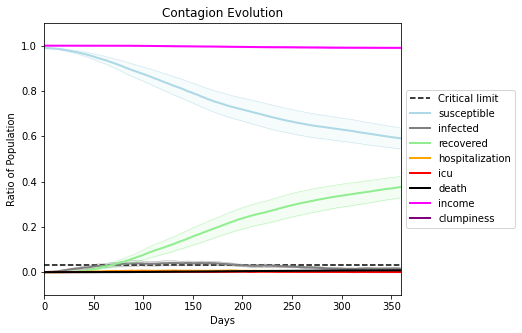

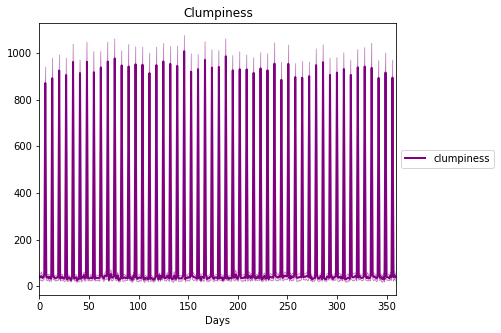

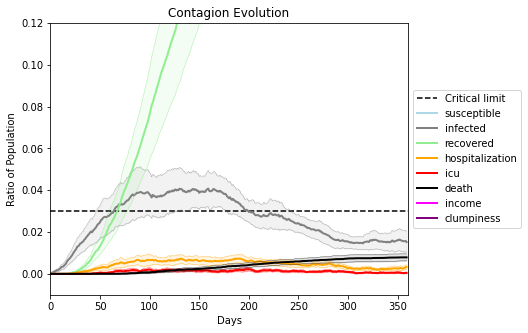

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[4614, 6529, 7864, 452, 7882, 6329, 1766, 8158, 78, 5972, 9837, 7407, 5254, 2455, 313, 2204, 5662, 6706, 7454, 1038]
Average similarity between family members is 0.3092094949821767 at temperature -0.6
Average similarity between family and home is 0.9998402235695175 at temperature -1
Average similarity between students and their classroom is 0.18684300238460794 at temperature -0.6
Average classroom occupancy is 1.6285714285714286 and number classrooms is 175
Average similarity between workers is 0.17056140591818464 at temperature -0.6
Average office occupancy is 3.38 and number offices is 200
Average friend similarity for adults: 0.3801498927415981 for kids: 0.22995028928590872
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuild

avg restaurant similarity 0.09367465865273245
avg restaurant similarity 0.08455202702086242
avg restaurant similarity 0.05568846322836284
avg restaurant similarity 0.10363662980272208
avg restaurant similarity 0.029062056520804236
avg restaurant similarity 0.08473909182895736
avg restaurant similarity 0.08662280724552376
avg restaurant similarity 0.08701999358624588
avg restaurant similarity 0.0943237063428803
avg restaurant similarity 0.08128885527325809
avg restaurant similarity 0.10517257344173328
avg restaurant similarity 0.060303354072263754
avg restaurant similarity 0.07141769333694604
avg restaurant similarity 0.047086623324998404
avg restaurant similarity 0.09807493893065695
avg restaurant similarity 0.030961470538131978
avg restaurant similarity 0.08086903066273302
avg restaurant similarity 0.09218251027430281
avg restaurant similarity 0.06307806086559843
avg restaurant similarity 0.11805528169532406
avg restaurant similarity 0.12502418699950213
avg restaurant similarity 0.113

avg restaurant similarity 0.06589312914604094
avg restaurant similarity 0.03649448447931188
avg restaurant similarity 0.08488732390640509
avg restaurant similarity 0.06466982249031177
avg restaurant similarity 0.06946165791518906
avg restaurant similarity 0.08208877536795565
avg restaurant similarity 0.031933357800146195
avg restaurant similarity 0.08070291838947358
avg restaurant similarity 0.07119538236763334
avg restaurant similarity 0.08630677948647843
avg restaurant similarity 0.0420320666812139
avg restaurant similarity 0.05914006053615643
avg restaurant similarity 0.028824598539061944
avg restaurant similarity 0.09627463899885672
avg restaurant similarity 0.042995067357119936
avg restaurant similarity 0.13558294672420707
avg restaurant similarity 0.07546019141169623
avg restaurant similarity 0.08583002932972969
avg restaurant similarity 0.06405958244756281
avg restaurant similarity 0.04687046132763014
avg restaurant similarity 0.02343635352509139
avg restaurant similarity 0.0906

avg restaurant similarity 0.0944848987530322
avg restaurant similarity 0.07374955898600141
avg restaurant similarity 0.11778798595433919
Average similarity between family members is 0.3007183842771844 at temperature -0.6
Average similarity between family and home is 0.9998580848234963 at temperature -1
Average similarity between students and their classroom is 0.14982214928808005 at temperature -0.6
Average classroom occupancy is 1.588235294117647 and number classrooms is 187
Average similarity between workers is 0.16199155322675987 at temperature -0.6
Average office occupancy is 3.236180904522613 and number offices is 199
Average friend similarity for adults: 0.36523792938298544 for kids: 0.2387731533802353
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 22 people.
Total of 22 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.10808644151617124
avg restaurant similarity 0.09812520329954989
avg restaurant similarity 0.10910711900920214
avg restaurant similarity 0.06411549392765578
avg restaurant similarity 0.07060650966348365
avg restaurant similarity 0.0968290370514214
avg restaurant similarity 0.13258425812423125
avg restaurant similarity 0.08890744179622356
avg restaurant similarity 0.044562160004568425
avg restaurant similarity 0.08081962890994775
avg restaurant similarity 0.07869724709900844
avg restaurant similarity 0.07949726938072624
avg restaurant similarity 0.08836974383470293
avg restaurant similarity 0.10915780766875274
avg restaurant similarity 0.12326551308237237
avg restaurant similarity 0.08220117005212343
avg restaurant similarity 0.10021472528845976
avg restaurant similarity 0.11033727063815053
avg restaurant similarity 0.0860474323721357
avg restaurant similarity 0.10439140949081537
avg restaurant similarity 0.07410582517900145
avg restaurant similarity 0.0877661

avg restaurant similarity 0.06682764847647213
avg restaurant similarity 0.06403948211179829
avg restaurant similarity 0.12261638167269984
avg restaurant similarity 0.0874003997266307
avg restaurant similarity 0.06192195724374841
avg restaurant similarity 0.07407586400358876
avg restaurant similarity 0.0809606981191192
avg restaurant similarity 0.11033111672021245
avg restaurant similarity 0.12833653420818436
avg restaurant similarity 0.09940494963314193
avg restaurant similarity 0.07925394531073428
avg restaurant similarity 0.09198635953173641
avg restaurant similarity 0.0917461293806374
avg restaurant similarity 0.09454140728740003
avg restaurant similarity 0.05483336014928773
avg restaurant similarity 0.078861490236628
avg restaurant similarity 0.08394076172680846
avg restaurant similarity 0.06084361504147732
avg restaurant similarity 0.06152988210655298
avg restaurant similarity 0.068573921030572
avg restaurant similarity 0.04595774678681545
avg restaurant similarity 0.0753357737277

avg restaurant similarity 0.0854601756931673
avg restaurant similarity 0.06798638114177039
Average similarity between family members is 0.28791983109811836 at temperature -0.6
Average similarity between family and home is 0.9998475178595695 at temperature -1
Average similarity between students and their classroom is 0.1518494827391717 at temperature -0.6
Average classroom occupancy is 1.576086956521739 and number classrooms is 184
Average similarity between workers is 0.1337217384495287 at temperature -0.6
Average office occupancy is 3.3484848484848486 and number offices is 198
Average friend similarity for adults: 0.3754422258104738 for kids: 0.2255702745749268
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated uni

avg restaurant similarity 0.07810488124729938
avg restaurant similarity 0.035994821239910574
avg restaurant similarity 0.05211223302535415
avg restaurant similarity 0.05659546528883416
avg restaurant similarity 0.06631521763031943
avg restaurant similarity 0.05223359540461696
avg restaurant similarity 0.06416587281544489
avg restaurant similarity 0.09656622819985099
avg restaurant similarity 0.08401473951211126
avg restaurant similarity 0.06107863479727689
avg restaurant similarity 0.06674730287635883
avg restaurant similarity 0.008358202078478398
avg restaurant similarity 0.07718182837952038
avg restaurant similarity 0.06905191859009072
avg restaurant similarity 0.07154765461838151
avg restaurant similarity 0.05736150432625267
avg restaurant similarity 0.07558954947544207
avg restaurant similarity 0.0693301180131737
avg restaurant similarity 0.08092618328177656
avg restaurant similarity 0.013704862237318585
avg restaurant similarity 0.07475845710015058
avg restaurant similarity 0.0665

avg restaurant similarity 0.025216102397432747
avg restaurant similarity 0.1357477906695499
avg restaurant similarity 0.05404002810572423
avg restaurant similarity 0.0910607523292273
avg restaurant similarity 0.02181383754729832
avg restaurant similarity 0.04095931628702334
avg restaurant similarity 0.09109585853822533
avg restaurant similarity 0.08681133420185498
avg restaurant similarity 0.06241885725655431
avg restaurant similarity 0.12894156720440272
avg restaurant similarity 0.09397981625073906
avg restaurant similarity 0.0677154016779602
avg restaurant similarity 0.12135942000733622
avg restaurant similarity 0.07169576364659168
avg restaurant similarity 0.015023242325368814
avg restaurant similarity 0.05593203761907806
avg restaurant similarity 0.015781590271766854
avg restaurant similarity 0.09787005279031967
avg restaurant similarity 0.11881279976229835
avg restaurant similarity 0.07976744520503222
avg restaurant similarity 0.07089491024267816
avg restaurant similarity 0.054262

avg restaurant similarity 0.061297762987606884
avg restaurant similarity 0.027956521334274943
avg restaurant similarity 0.1257297289472616
avg restaurant similarity 0.06852210502855781
Average similarity between family members is 0.3081678990307079 at temperature -0.6
Average similarity between family and home is 0.9998664791501316 at temperature -1
Average similarity between students and their classroom is 0.17705416226834822 at temperature -0.6
Average classroom occupancy is 1.5159574468085106 and number classrooms is 188
Average similarity between workers is 0.16488573496123027 at temperature -0.6
Average office occupancy is 3.2758620689655173 and number offices is 203
Average friend similarity for adults: 0.3732575058709286 for kids: 0.22376956350291863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.10763249508400546
avg restaurant similarity 0.12477520054002317
avg restaurant similarity 0.03985106347406164
avg restaurant similarity 0.11259038067526358
avg restaurant similarity 0.0646309528456506
avg restaurant similarity 0.09444860079805001
avg restaurant similarity 0.11689102375120755
avg restaurant similarity 0.05351257513910955
avg restaurant similarity 0.08016880857866615
avg restaurant similarity 0.046940043551257124
avg restaurant similarity 0.018718591927666523
avg restaurant similarity 0.07786609798209314
avg restaurant similarity 0.057485490662186584
avg restaurant similarity 0.07818153182834245
avg restaurant similarity 0.05324074110233161
avg restaurant similarity 0.04566547155112248
avg restaurant similarity 0.1314418517953654
avg restaurant similarity 0.1177599510613079
avg restaurant similarity 0.13561451408195574
avg restaurant similarity 0.04850401492209712
avg restaurant similarity 0.0503207057301268
avg restaurant similarity 0.0832669

avg restaurant similarity 0.07463126153601188
avg restaurant similarity 0.09106754380247009
avg restaurant similarity 0.1250939497174832
avg restaurant similarity 0.06454456925337823
avg restaurant similarity 0.07035196970157297
avg restaurant similarity 0.12080065410700484
avg restaurant similarity 0.07657017809603575
avg restaurant similarity 0.08691462873500118
avg restaurant similarity 0.081092183772028
avg restaurant similarity 0.07772350428457937
avg restaurant similarity 0.04999368866051987
avg restaurant similarity 0.1010480147186429
avg restaurant similarity 0.0957260535200761
avg restaurant similarity 0.09787866682294825
avg restaurant similarity 0.0689512290326024
avg restaurant similarity 0.15621489115186035
avg restaurant similarity 0.09260659875014383
avg restaurant similarity 0.13814721643776398
avg restaurant similarity 0.15332271122257116
avg restaurant similarity 0.12282279461407876
avg restaurant similarity 0.06711051814429236
avg restaurant similarity 0.091933108727

avg restaurant similarity 0.05728908140739582
avg restaurant similarity 0.09662004102538345
Average similarity between family members is 0.3099575965100839 at temperature -0.6
Average similarity between family and home is 0.99986887734617 at temperature -1
Average similarity between students and their classroom is 0.16067111352164656 at temperature -0.6
Average classroom occupancy is 1.5524861878453038 and number classrooms is 181
Average similarity between workers is 0.16005683497043677 at temperature -0.6
Average office occupancy is 3.2450980392156863 and number offices is 204
Average friend similarity for adults: 0.36882292923254284 for kids: 0.21422295471353756
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.06561249404340268
avg restaurant similarity 0.0353143547889758
avg restaurant similarity 0.0897140439916754
avg restaurant similarity 0.10875849532025836
avg restaurant similarity 0.04218596877568861
avg restaurant similarity 0.07818440624353457
avg restaurant similarity 0.09288893304748876
avg restaurant similarity 0.09723008667850308
avg restaurant similarity 0.06264094510523327
avg restaurant similarity 0.10033728836714503
avg restaurant similarity 0.016725246198472016
avg restaurant similarity 0.06884141196110494
avg restaurant similarity 0.06072012788236849
avg restaurant similarity 0.10092691792495043
avg restaurant similarity 0.034491414895688986
avg restaurant similarity 0.054804737465604575
avg restaurant similarity 0.09608615471406139
avg restaurant similarity 0.08855984945899217
avg restaurant similarity 0.051324729583890304
avg restaurant similarity 0.090903497328448
avg restaurant similarity 0.0928151633414233
avg restaurant similarity 0.0651689

avg restaurant similarity 0.04080624103672799
avg restaurant similarity 0.05753578020708596
avg restaurant similarity 0.07721271897435807
avg restaurant similarity 0.07628566311548572
avg restaurant similarity 0.08350190340792477
avg restaurant similarity 0.04423451892215428
avg restaurant similarity 0.11009279956122922
avg restaurant similarity 0.07892623681737725
avg restaurant similarity 0.07302302165953133
avg restaurant similarity 0.03739973975518835
avg restaurant similarity 0.07133734701984995
avg restaurant similarity 0.06360970830227403
avg restaurant similarity 0.11872407012226728
avg restaurant similarity 0.012566493322522609
avg restaurant similarity 0.044697652905965835
avg restaurant similarity 0.04362964621990676
avg restaurant similarity 0.09462732505119163
avg restaurant similarity 0.05644036106698965
avg restaurant similarity 0.09652529489665779
avg restaurant similarity 0.0669787531111157
avg restaurant similarity 0.05795868691214717
avg restaurant similarity 0.08480

avg restaurant similarity 0.10932342553287266
avg restaurant similarity 0.027356733902132647
avg restaurant similarity 0.0685418051536198
avg restaurant similarity 0.045000033387275894
Average similarity between family members is 0.2894176722307972 at temperature -0.6
Average similarity between family and home is 0.9998603312074678 at temperature -1
Average similarity between students and their classroom is 0.1720500067993028 at temperature -0.6
Average classroom occupancy is 1.5617977528089888 and number classrooms is 178
Average similarity between workers is 0.16089354580538903 at temperature -0.6
Average office occupancy is 3.2401960784313726 and number offices is 204
Average friend similarity for adults: 0.37624417396156995 for kids: 0.21941099268239858
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.0763259742633202
avg restaurant similarity 0.04380548653207247
avg restaurant similarity 0.03749928738807511
avg restaurant similarity 0.062080089002325936
avg restaurant similarity 0.0629305461023417
avg restaurant similarity 0.03274492114213684
avg restaurant similarity 0.0653958707271789
avg restaurant similarity 0.04877430175687079
avg restaurant similarity 0.013546843989495912
avg restaurant similarity 0.027936175889261623
avg restaurant similarity 0.07384804416743632
avg restaurant similarity 0.08006864006973424
avg restaurant similarity 0.05421930827881595
avg restaurant similarity 0.07036916415543457
avg restaurant similarity 0.0882391037198835
avg restaurant similarity 0.041565424930175995
avg restaurant similarity 0.018433845325550518
avg restaurant similarity 0.061789341254125364
avg restaurant similarity 0.04847711894320166
avg restaurant similarity 0.01635224160969231
avg restaurant similarity 0.10584945665642986
avg restaurant similarity 0.0628

avg restaurant similarity 0.044873523631188295
avg restaurant similarity 0.0414633695421907
avg restaurant similarity 0.08443089336755753
avg restaurant similarity 0.07235246403961511
avg restaurant similarity 0.03947543765400382
avg restaurant similarity 0.05962213114938469
avg restaurant similarity 0.09528040379325796
avg restaurant similarity -0.042877863415194305
avg restaurant similarity 0.0979033116051814
avg restaurant similarity 0.04591026005061213
avg restaurant similarity 0.039411399236523315
avg restaurant similarity 0.11231366286304242
avg restaurant similarity 0.03442093639792451
avg restaurant similarity 0.0655683925564576
avg restaurant similarity 0.007099095382049646
avg restaurant similarity 0.04559750723852386
avg restaurant similarity 0.10444860122677889
avg restaurant similarity 0.062032796499273735
avg restaurant similarity 0.05749096971477424
avg restaurant similarity 0.04274372416001974
avg restaurant similarity 0.07785410441497974
avg restaurant similarity 0.109

avg restaurant similarity 0.057150943293854235
avg restaurant similarity 0.011733266386218293
avg restaurant similarity 0.07378776442722847
avg restaurant similarity 0.07014717371241225
Average similarity between family members is 0.3325593893440072 at temperature -0.6
Average similarity between family and home is 0.9998612574467536 at temperature -1
Average similarity between students and their classroom is 0.20992563988558383 at temperature -0.6
Average classroom occupancy is 1.6573033707865168 and number classrooms is 178
Average similarity between workers is 0.14828985486981072 at temperature -0.6
Average office occupancy is 3.3248730964467006 and number offices is 197
Average friend similarity for adults: 0.37419143518779346 for kids: 0.23615016615241277
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) distr

avg restaurant similarity 0.026107334572333763
avg restaurant similarity 0.08320355987351455
avg restaurant similarity 0.08157723568534413
avg restaurant similarity 0.02826041047156349
avg restaurant similarity 0.08246043127075825
avg restaurant similarity 0.03255331419415965
avg restaurant similarity 0.06358216895066145
avg restaurant similarity 0.07649424794776677
avg restaurant similarity 0.05401825252287904
avg restaurant similarity 0.01095135922029761
avg restaurant similarity 0.04788499887052033
avg restaurant similarity 0.0441279770017047
avg restaurant similarity 0.0774440269034957
avg restaurant similarity 0.08137339396697414
avg restaurant similarity 0.049923144428741566
avg restaurant similarity 0.10632990019676974
avg restaurant similarity 0.04312930383076651
avg restaurant similarity 0.030157994748531477
avg restaurant similarity 0.024236835840492098
avg restaurant similarity 0.05088284878344187
avg restaurant similarity 0.040695432737165804
avg restaurant similarity 0.059

avg restaurant similarity 0.0159877915958533
avg restaurant similarity 0.024066532646488534
avg restaurant similarity 0.07666204665627106
avg restaurant similarity 0.0034886472620392814
avg restaurant similarity 0.06211307506359661
avg restaurant similarity 0.042112482649570133
avg restaurant similarity 0.043083855450980375
avg restaurant similarity 0.08772395995191974
avg restaurant similarity 0.06119438962766438
avg restaurant similarity 0.11461053953315993
avg restaurant similarity 0.030181270260126396
avg restaurant similarity 0.05326806709680643
avg restaurant similarity 0.014120348605070799
avg restaurant similarity 0.054352226586144255
avg restaurant similarity 0.005479590856960718
avg restaurant similarity 0.05761533355031693
avg restaurant similarity 0.0739878268105038
avg restaurant similarity 0.04813311286317508
avg restaurant similarity 0.1125275862488007
avg restaurant similarity 0.05486885095676811
avg restaurant similarity 0.06823939553925207
avg restaurant similarity 0.

avg restaurant similarity 0.039729737913218446
avg restaurant similarity 0.05354065271236072
avg restaurant similarity 0.030970660221806272
avg restaurant similarity 0.07991597702404779
Average similarity between family members is 0.29611238624723846 at temperature -0.6
Average similarity between family and home is 0.9998460605891711 at temperature -1
Average similarity between students and their classroom is 0.17155013090463006 at temperature -0.6
Average classroom occupancy is 1.5856353591160222 and number classrooms is 181
Average similarity between workers is 0.15792398557006396 at temperature -0.6
Average office occupancy is 3.31 and number offices is 200
Average friend similarity for adults: 0.3729026214736577 for kids: 0.22606486651485846
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.10576177440161423
avg restaurant similarity 0.0045250398954556695
avg restaurant similarity 0.1382572671975286
avg restaurant similarity 0.07328020246736018
avg restaurant similarity 0.045221272469728305
avg restaurant similarity 0.09953296394042761
avg restaurant similarity 0.08039168724974714
avg restaurant similarity 0.027371694349869476
avg restaurant similarity 0.0851449386013232
avg restaurant similarity 0.10137373523268199
avg restaurant similarity 0.04634271131121704
avg restaurant similarity 0.048939896841857476
avg restaurant similarity 0.05088372032961461
avg restaurant similarity 0.028740593428673897
avg restaurant similarity 0.06273118664448206
avg restaurant similarity 0.10783924936986916
avg restaurant similarity 0.08424778842174582
avg restaurant similarity 0.07400534584129456
avg restaurant similarity 0.053674186030930215
avg restaurant similarity 0.11068672873472134
avg restaurant similarity 0.03678095667478972
avg restaurant similarity 0.0

avg restaurant similarity 0.10717166507245403
avg restaurant similarity 0.07219236247885998
avg restaurant similarity 0.0841813578990037
avg restaurant similarity 0.049175319853536445
avg restaurant similarity 0.1209211652935877
avg restaurant similarity 0.1360623552149171
avg restaurant similarity 0.08718985679335692
avg restaurant similarity 0.08614150136579544
avg restaurant similarity 0.05453296799410896
avg restaurant similarity 0.11848795952342125
avg restaurant similarity 0.08519749308903754
avg restaurant similarity 0.05864662122237924
avg restaurant similarity 0.15325038617388598
avg restaurant similarity 0.07204904360393821
avg restaurant similarity 0.055120305380711936
avg restaurant similarity 0.0884920171647647
avg restaurant similarity 0.05571406920716278
avg restaurant similarity 0.04082245116594645
avg restaurant similarity 0.08049129586415497
avg restaurant similarity 0.09366216376985578
avg restaurant similarity 0.051715982365430596
avg restaurant similarity 0.0915486

avg restaurant similarity 0.11075590831711354
avg restaurant similarity 0.08660470479410955
avg restaurant similarity 0.08415567621460268
Average similarity between family members is 0.3040142440804969 at temperature -0.6
Average similarity between family and home is 0.9998456201768072 at temperature -1
Average similarity between students and their classroom is 0.1927253405694336 at temperature -0.6
Average classroom occupancy is 1.6384180790960452 and number classrooms is 177
Average similarity between workers is 0.1650576155224031 at temperature -0.6
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.3782812621662384 for kids: 0.24008823657563588
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with cap

avg restaurant similarity 0.09213365413332072
avg restaurant similarity 0.13476339199424822
avg restaurant similarity 0.16954877307106167
avg restaurant similarity 0.11859124312293931
avg restaurant similarity 0.1267515615339345
avg restaurant similarity 0.06172212626810084
avg restaurant similarity 0.05822068511620115
avg restaurant similarity 0.1105357024904965
avg restaurant similarity 0.1343801290103156
avg restaurant similarity 0.07047679433400826
avg restaurant similarity 0.08130785026170262
avg restaurant similarity 0.1357403772742148
avg restaurant similarity 0.13918973850145164
avg restaurant similarity 0.12447282300377413
avg restaurant similarity 0.14819249715597882
avg restaurant similarity 0.1229485620655564
avg restaurant similarity 0.1355112124016544
avg restaurant similarity 0.07868189245203099
avg restaurant similarity 0.12371303028729223
avg restaurant similarity 0.10573245811608742
avg restaurant similarity 0.09998880820976427
avg restaurant similarity 0.101825740748

avg restaurant similarity 0.1051296126801637
avg restaurant similarity 0.10778441043665843
avg restaurant similarity 0.09742492892469526
avg restaurant similarity 0.10947829053878984
avg restaurant similarity 0.07184626635863611
avg restaurant similarity 0.16100441061095178
avg restaurant similarity 0.12804535371278117
avg restaurant similarity 0.11634032353201769
avg restaurant similarity 0.10914647891368867
avg restaurant similarity 0.06813084400216245
avg restaurant similarity 0.11994668181522987
avg restaurant similarity 0.09055421921446555
avg restaurant similarity 0.02872889124422512
avg restaurant similarity 0.09028870393507256
avg restaurant similarity 0.05047257190053216
avg restaurant similarity 0.08159599032639836
avg restaurant similarity 0.08146767831087008
avg restaurant similarity 0.07829695062104959
avg restaurant similarity 0.10677794393070196
avg restaurant similarity 0.06893023392458952
avg restaurant similarity 0.1145263020302936
avg restaurant similarity 0.05581832

avg restaurant similarity 0.11562607591047859
avg restaurant similarity 0.10594841980700981
Average similarity between family members is 0.3044189860106041 at temperature -0.6
Average similarity between family and home is 0.9998551613099607 at temperature -1
Average similarity between students and their classroom is 0.15329297059703204 at temperature -0.6
Average classroom occupancy is 1.5988372093023255 and number classrooms is 172
Average similarity between workers is 0.14983930009203053 at temperature -0.6
Average office occupancy is 3.265 and number offices is 200
Average friend similarity for adults: 0.3717094199263519 for kids: 0.227973221634862
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a t

avg restaurant similarity 0.05934730461933495
avg restaurant similarity -0.005969921842130624
avg restaurant similarity 0.061859153898461826
avg restaurant similarity 0.053032322178727984
avg restaurant similarity 0.056095291153950726
avg restaurant similarity -0.004457911511420061
avg restaurant similarity 0.0734316346172005
avg restaurant similarity 0.05801040209925971
avg restaurant similarity 0.06057777987034455
avg restaurant similarity 0.05923495869246471
avg restaurant similarity 0.06443052050773995
avg restaurant similarity 0.0465053061667996
avg restaurant similarity 0.07883063630780048
avg restaurant similarity 0.06847631380342843
avg restaurant similarity 0.06201911122245301
avg restaurant similarity 0.0623724100857079
avg restaurant similarity 0.08496297128877182
avg restaurant similarity 0.045067969621274344
avg restaurant similarity 0.1019767188349408
avg restaurant similarity 0.03473652776320675
avg restaurant similarity 0.060941081885493895
avg restaurant similarity 0.0

avg restaurant similarity 0.08281714713870904
avg restaurant similarity 0.08149892485137104
avg restaurant similarity 0.10149247278340953
avg restaurant similarity 0.022451593292243357
avg restaurant similarity 0.10635353235190251
avg restaurant similarity 0.04894703165966783
avg restaurant similarity 0.04986336964132638
avg restaurant similarity 0.03809742153445526
avg restaurant similarity 0.05100447438124548
avg restaurant similarity 0.05845947560171921
avg restaurant similarity 0.09769505213351717
avg restaurant similarity 0.040855985984652635
avg restaurant similarity 0.06850516567679317
avg restaurant similarity 0.08226481661135998
avg restaurant similarity 0.05313815669163845
avg restaurant similarity 0.03514886538755927
avg restaurant similarity 0.1552845283993369
avg restaurant similarity 0.07010739296309393
avg restaurant similarity 0.033465470943566306
avg restaurant similarity 0.11255108489316558
avg restaurant similarity 0.03208839518014856
avg restaurant similarity 0.0175

avg restaurant similarity 0.06355531222160908
avg restaurant similarity 0.07338908462070057
avg restaurant similarity 0.06497492856990811
avg restaurant similarity 0.12260006968799143
Average similarity between family members is 0.2712658035782887 at temperature -0.6
Average similarity between family and home is 0.9998536785279859 at temperature -1
Average similarity between students and their classroom is 0.15238783048710253 at temperature -0.6
Average classroom occupancy is 1.5397727272727273 and number classrooms is 176
Average similarity between workers is 0.15106229555062942 at temperature -0.6
Average office occupancy is 3.415 and number offices is 200
Average friend similarity for adults: 0.3776323711362382 for kids: 0.21272135584946034
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.051108246968563004
avg restaurant similarity 0.035622278892471104
avg restaurant similarity 0.07876217525022844
avg restaurant similarity 0.08445265737244698
avg restaurant similarity 0.07491569862487008
avg restaurant similarity 0.079610980134982
avg restaurant similarity 0.07808710916236965
avg restaurant similarity 0.057809793498899635
avg restaurant similarity 0.034224260375006026
avg restaurant similarity 0.024935584677830677
avg restaurant similarity 0.050223681059045566
avg restaurant similarity 0.0510678855667978
avg restaurant similarity 0.08667822454372208
avg restaurant similarity 0.03963404933704594
avg restaurant similarity 0.07127513453242358
avg restaurant similarity 0.06317138918484291
avg restaurant similarity 0.09543906685776475
avg restaurant similarity 0.10011608953112157
avg restaurant similarity 0.070858981536772
avg restaurant similarity 0.11213272428527189
avg restaurant similarity 0.03777323968346485
avg restaurant similarity 0.06269

avg restaurant similarity 0.08711444199460876
avg restaurant similarity 0.07552091007911972
avg restaurant similarity 0.09232554398904333
avg restaurant similarity 0.06403950108270604
avg restaurant similarity 0.12105492910094054
avg restaurant similarity 0.06073481111865624
avg restaurant similarity 0.07485213459988867
avg restaurant similarity 0.04962075760186177
avg restaurant similarity 0.08358013143285797
avg restaurant similarity 0.060176846112416575
avg restaurant similarity 0.06825613349359129
avg restaurant similarity 0.06355993042189052
avg restaurant similarity 0.04120754980700508
avg restaurant similarity 0.060547708009465157
avg restaurant similarity 0.024421675530128733
avg restaurant similarity 0.09014169681863886
avg restaurant similarity 0.04608200677778126
avg restaurant similarity 0.023592702034633928
avg restaurant similarity 0.08555886257369676
avg restaurant similarity 0.05033263435170166
avg restaurant similarity 0.10162495945107283
avg restaurant similarity 0.07

avg restaurant similarity 0.06783420184781555
avg restaurant similarity 0.07318593010365729
avg restaurant similarity 0.07003887282275245
avg restaurant similarity 0.04682217271565693
Average similarity between family members is 0.30685123416774973 at temperature -0.6
Average similarity between family and home is 0.9998343355192115 at temperature -1
Average similarity between students and their classroom is 0.21298034269486205 at temperature -0.6
Average classroom occupancy is 1.4833333333333334 and number classrooms is 180
Average similarity between workers is 0.150083991138133 at temperature -0.6
Average office occupancy is 3.321951219512195 and number offices is 205
Average friend similarity for adults: 0.37948087361332156 for kids: 0.22935638312576745
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.12181308361252562
avg restaurant similarity 0.09030690416651233
avg restaurant similarity 0.13210913774070338
avg restaurant similarity 0.11118218573977112
avg restaurant similarity 0.06385319415825685
avg restaurant similarity 0.07694818171133327
avg restaurant similarity 0.07456987813026623
avg restaurant similarity 0.06969531954540432
avg restaurant similarity 0.10949259679213717
avg restaurant similarity 0.04711281570944848
avg restaurant similarity 0.116969500909564
avg restaurant similarity 0.10029028796806254
avg restaurant similarity 0.06384548968215037
avg restaurant similarity 0.13336892179322501
avg restaurant similarity 0.0690089156793275
avg restaurant similarity 0.08253578111510586
avg restaurant similarity 0.06507885168476416
avg restaurant similarity 0.06413147146294228
avg restaurant similarity 0.10827736474644076
avg restaurant similarity 0.060346978526985284
avg restaurant similarity 0.09839691602715292
avg restaurant similarity 0.06913386

avg restaurant similarity 0.07333134196389388
avg restaurant similarity 0.0960313749424198
avg restaurant similarity 0.08311904204931762
avg restaurant similarity 0.03862982001762948
avg restaurant similarity 0.04964127574108062
avg restaurant similarity 0.08307311326600973
avg restaurant similarity 0.003791626451524952
avg restaurant similarity 0.06888210879403857
avg restaurant similarity 0.042186679830117646
avg restaurant similarity 0.09706151279226717
avg restaurant similarity 0.030124522968421785
avg restaurant similarity 0.08321547394378077
avg restaurant similarity 0.0401675875021636
avg restaurant similarity 0.12425012923576581
avg restaurant similarity 0.0041697947246407095
avg restaurant similarity 0.10463551093149415
avg restaurant similarity 0.081977465582249
avg restaurant similarity 0.04755324706783665
avg restaurant similarity 0.06645020514815014
avg restaurant similarity 0.10466840538431213
avg restaurant similarity 0.05211914355460836
avg restaurant similarity 0.06922

avg restaurant similarity 0.07941868140169127
avg restaurant similarity 0.11064723292711034
Average similarity between family members is 0.2849712298581857 at temperature -0.6
Average similarity between family and home is 0.9998508058482056 at temperature -1
Average similarity between students and their classroom is 0.1549047256517356 at temperature -0.6
Average classroom occupancy is 1.5747126436781609 and number classrooms is 174
Average similarity between workers is 0.13128085615224508 at temperature -0.6
Average office occupancy is 3.2058823529411766 and number offices is 204
Average friend similarity for adults: 0.36819565192681025 for kids: 0.2150756809546214
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocate

avg restaurant similarity 0.07579724705982359
avg restaurant similarity 0.0911527185045945
avg restaurant similarity 0.059249888499304
avg restaurant similarity 0.07098518471557001
avg restaurant similarity 0.09136477621506758
avg restaurant similarity 0.05439085508342378
avg restaurant similarity 0.07242967823637567
avg restaurant similarity 0.09170976335619338
avg restaurant similarity 0.06969529589317376
avg restaurant similarity 0.08528729448763862
avg restaurant similarity 0.09099619981084571
avg restaurant similarity 0.07890888416285609
avg restaurant similarity 0.035655671973449723
avg restaurant similarity 0.07579331412925483
avg restaurant similarity 0.09526475614336269
avg restaurant similarity 0.061778921475661774
avg restaurant similarity 0.04399829441394161
avg restaurant similarity 0.08988668065227419
avg restaurant similarity 0.06178654066550912
avg restaurant similarity 0.06390417303189275
avg restaurant similarity 0.06348030303698002
avg restaurant similarity 0.0980540

avg restaurant similarity 0.11451179929925344
avg restaurant similarity 0.05245903737636272
avg restaurant similarity 0.08397688267740659
avg restaurant similarity 0.09151207234375745
avg restaurant similarity 0.07574965276504027
avg restaurant similarity 0.11639487196379797
avg restaurant similarity 0.10994937992531145
avg restaurant similarity 0.05023769521310903
avg restaurant similarity 0.027412000331815758
avg restaurant similarity 0.07482081835571247
avg restaurant similarity 0.10044638606685194
avg restaurant similarity 0.09345486442697298
avg restaurant similarity 0.08488182095866613
avg restaurant similarity 0.07894430682795184
avg restaurant similarity 0.14398932663357503
avg restaurant similarity 0.0725718379370876
avg restaurant similarity 0.07756581240535096
avg restaurant similarity 0.10401423138482475
avg restaurant similarity 0.04991849285966235
avg restaurant similarity 0.10391233065157204
avg restaurant similarity 0.08547230629125964
avg restaurant similarity 0.059692

avg restaurant similarity 0.06227856112811866
avg restaurant similarity 0.046143042288452674
Average similarity between family members is 0.28787918671139484 at temperature -0.6
Average similarity between family and home is 0.9998587480417619 at temperature -1
Average similarity between students and their classroom is 0.15732215651762269 at temperature -0.6
Average classroom occupancy is 1.5536723163841808 and number classrooms is 177
Average similarity between workers is 0.15026887399413616 at temperature -0.6
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.3799202810592586 for kids: 0.22221907073369646
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloc

avg restaurant similarity 0.022431752114261034
avg restaurant similarity 0.060651228569655484
avg restaurant similarity 0.06824047159738024
avg restaurant similarity 0.1091740192900641
avg restaurant similarity 0.021008471369027063
avg restaurant similarity 0.046781732551384424
avg restaurant similarity 0.028096540629398866
avg restaurant similarity 0.04979194269960439
avg restaurant similarity 0.05669834448838037
avg restaurant similarity 0.0578802015684446
avg restaurant similarity 0.10295504033982888
avg restaurant similarity 0.09049468343212705
avg restaurant similarity 0.03563234358091135
avg restaurant similarity 0.11116244710841702
avg restaurant similarity 0.08122881004690348
avg restaurant similarity 0.061807189786243125
avg restaurant similarity 0.11226762817288395
avg restaurant similarity 0.060978297817558674
avg restaurant similarity 0.086822141915658
avg restaurant similarity 0.021076008295770072
avg restaurant similarity 0.01679223845916149
avg restaurant similarity 0.01

avg restaurant similarity 0.09632018254329477
avg restaurant similarity 0.033485310516726506
avg restaurant similarity 0.06917092118981256
avg restaurant similarity 0.09556843224929798
avg restaurant similarity 0.0568058844321162
avg restaurant similarity 0.059025296767560485
avg restaurant similarity 0.05579382275403923
avg restaurant similarity 0.09555468123437777
avg restaurant similarity 0.09162522625776917
avg restaurant similarity 0.05797696471139939
avg restaurant similarity 0.028041378075427403
avg restaurant similarity 0.10281638283707939
avg restaurant similarity 0.06839884108962901
avg restaurant similarity 0.13761477174597264
avg restaurant similarity -0.010091692415389276
avg restaurant similarity 0.11942577733773424
avg restaurant similarity 0.06692013377603914
avg restaurant similarity 0.10657867757209452
avg restaurant similarity 0.05005510985850132
avg restaurant similarity 0.08284558944179628
avg restaurant similarity 0.017037081178935348
avg restaurant similarity 0.0

avg restaurant similarity 0.08217482833034559
avg restaurant similarity 0.10949819222030906
avg restaurant similarity 0.035134194882952594
avg restaurant similarity 0.05680465259960227
Average similarity between family members is 0.2854701657242619 at temperature -0.6
Average similarity between family and home is 0.9998637926721246 at temperature -1
Average similarity between students and their classroom is 0.1883806091559751 at temperature -0.6
Average classroom occupancy is 1.6536312849162011 and number classrooms is 179
Average similarity between workers is 0.13883355604376119 at temperature -0.6
Average office occupancy is 3.285 and number offices is 200
Average friend similarity for adults: 0.3709712835777282 for kids: 0.2344072404589995
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.08622973040735513
avg restaurant similarity 0.06457705136283501
avg restaurant similarity 0.07185213625612727
avg restaurant similarity 0.03701812981336274
avg restaurant similarity 0.044227592048809904
avg restaurant similarity 0.042266773094250414
avg restaurant similarity 0.04493147296482713
avg restaurant similarity 0.0778439884244502
avg restaurant similarity 0.08077622108859772
avg restaurant similarity 0.09908154262081367
avg restaurant similarity 0.10035830439022883
avg restaurant similarity 0.08180477264961174
avg restaurant similarity 0.11748388595283123
avg restaurant similarity 0.06715199477546847
avg restaurant similarity 0.053703374426178146
avg restaurant similarity 0.09540662812675003
avg restaurant similarity 0.019422506388901646
avg restaurant similarity 0.041599172449784894
avg restaurant similarity 0.11913184271610944
avg restaurant similarity 0.09070652123788984
avg restaurant similarity 0.09648273422996594
avg restaurant similarity 0.09

avg restaurant similarity 0.08775453571782027
avg restaurant similarity 0.06003250399244929
avg restaurant similarity 0.06608229226153582
avg restaurant similarity 0.078112270322559
avg restaurant similarity 0.09206956330864499
avg restaurant similarity 0.07846499423132433
avg restaurant similarity 0.08709750439000892
avg restaurant similarity 0.07414100049151019
avg restaurant similarity 0.07539757551243922
avg restaurant similarity 0.019567620003877285
avg restaurant similarity 0.08841668033982017
avg restaurant similarity 0.10857201484868957
avg restaurant similarity 0.044131573916864474
avg restaurant similarity 0.08272740807634506
avg restaurant similarity 0.09610942687686597
avg restaurant similarity 0.11707219570385431
avg restaurant similarity 0.0718039755798498
avg restaurant similarity 0.08663761225169338
avg restaurant similarity 0.060865364814612126
avg restaurant similarity 0.1216225362995647
avg restaurant similarity 0.046737982462079816
avg restaurant similarity 0.097487

avg restaurant similarity 0.07023872279027059
avg restaurant similarity 0.0630855829016624
avg restaurant similarity 0.056711685829571576
avg restaurant similarity 0.06829222617330712
Average similarity between family members is 0.2896943886238253 at temperature -0.6
Average similarity between family and home is 0.9998621782482789 at temperature -1
Average similarity between students and their classroom is 0.18399683634286498 at temperature -0.6
Average classroom occupancy is 1.6483516483516483 and number classrooms is 182
Average similarity between workers is 0.1587536424496538 at temperature -0.6
Average office occupancy is 3.1449275362318843 and number offices is 207
Average friend similarity for adults: 0.3716434832275578 for kids: 0.2339061578640694
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.10153057924157807
avg restaurant similarity 0.17395154240883545
avg restaurant similarity 0.11782715089988752
avg restaurant similarity 0.07563895236373248
avg restaurant similarity 0.12657364391336465
avg restaurant similarity 0.12239225800777467
avg restaurant similarity 0.15972481194210864
avg restaurant similarity 0.14257843637572484
avg restaurant similarity 0.1105706857515271
avg restaurant similarity 0.08584069949074423
avg restaurant similarity 0.13223112254687988
avg restaurant similarity 0.0714349385405651
avg restaurant similarity 0.07316661936769861
avg restaurant similarity 0.10614588036074828
avg restaurant similarity 0.12302666387478332
avg restaurant similarity 0.07142020252276311
avg restaurant similarity 0.07421522555731051
avg restaurant similarity 0.09089206520956883
avg restaurant similarity 0.09235222408077905
avg restaurant similarity 0.13328080433730236
avg restaurant similarity 0.09834618912993207
avg restaurant similarity 0.07358268

avg restaurant similarity 0.09502645342171125
avg restaurant similarity 0.07660835891337192
avg restaurant similarity 0.08711776953600439
avg restaurant similarity 0.05380663722842453
avg restaurant similarity 0.007623402231099319
avg restaurant similarity 0.09041126264738258
avg restaurant similarity 0.09941999672405744
avg restaurant similarity 0.06618288348134901
avg restaurant similarity 0.07203404302979786
avg restaurant similarity 0.11124785517536968
avg restaurant similarity 0.029468556613276586
avg restaurant similarity 0.1257056568527298
avg restaurant similarity 0.0889622216400407
avg restaurant similarity 0.07144286493841807
avg restaurant similarity 0.0982172679514826
avg restaurant similarity 0.09713684476715789
avg restaurant similarity 0.07807571402491915
avg restaurant similarity 0.0984411175017144
avg restaurant similarity 0.08550566564278722
avg restaurant similarity 0.1443983093326323
avg restaurant similarity 0.12364368000010689
avg restaurant similarity 0.079169580

avg restaurant similarity 0.11274131101837612
avg restaurant similarity 0.07626151702459887
Average similarity between family members is 0.29671181008218445 at temperature -0.6
Average similarity between family and home is 0.9998573630396476 at temperature -1
Average similarity between students and their classroom is 0.1906469708228947 at temperature -0.6
Average classroom occupancy is 1.5810055865921788 and number classrooms is 179
Average similarity between workers is 0.17932306239709134 at temperature -0.6
Average office occupancy is 3.180487804878049 and number offices is 205
Average friend similarity for adults: 0.3712711417718045 for kids: 0.22655490195380917
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.13102323950471584
avg restaurant similarity 0.1027088316960689
avg restaurant similarity 0.06974283697446498
avg restaurant similarity 0.06755572422214161
avg restaurant similarity 0.14313410535201512
avg restaurant similarity 0.09830783694941307
avg restaurant similarity 0.09638054512370167
avg restaurant similarity 0.06760563322132863
avg restaurant similarity 0.09710193747524762
avg restaurant similarity 0.06609937690299643
avg restaurant similarity 0.0856950137903145
avg restaurant similarity 0.04893446306912111
avg restaurant similarity 0.07522759497165035
avg restaurant similarity 0.07725204012905897
avg restaurant similarity 0.0999159580850502
avg restaurant similarity 0.01301870903201461
avg restaurant similarity 0.08780180737622136
avg restaurant similarity 0.080523256571408
avg restaurant similarity 0.10168441718370132
avg restaurant similarity 0.07586954480168251
avg restaurant similarity 0.07803749616007774
avg restaurant similarity 0.04385327146

avg restaurant similarity 0.07606052960657315
avg restaurant similarity 0.10511466230505921
avg restaurant similarity 0.043773028638089316
avg restaurant similarity 0.0942665459045368
avg restaurant similarity 0.05388247846051307
avg restaurant similarity 0.07181506522935728
avg restaurant similarity 0.04404823946883889
avg restaurant similarity 0.11478507944555269
avg restaurant similarity 0.11305729837530902
avg restaurant similarity 0.09727486267993785
avg restaurant similarity 0.056295797255425536
avg restaurant similarity 0.08610044486992707
avg restaurant similarity 0.07528543316172356
avg restaurant similarity 0.1121813856504227
avg restaurant similarity 0.07465261092841725
avg restaurant similarity 0.08329809994666688
avg restaurant similarity 0.08761803564075701
avg restaurant similarity 0.08944498144020625
avg restaurant similarity 0.11054872326254198
avg restaurant similarity 0.08536847799504775
avg restaurant similarity 0.0842658212018317
avg restaurant similarity 0.0759331

avg restaurant similarity 0.05587501438239088
avg restaurant similarity 0.12422888227082465
Average similarity between family members is 0.2848342377883858 at temperature -0.6
Average similarity between family and home is 0.9998528393412143 at temperature -1
Average similarity between students and their classroom is 0.16085247810792772 at temperature -0.6
Average classroom occupancy is 1.6347305389221556 and number classrooms is 167
Average similarity between workers is 0.18510600803788427 at temperature -0.6
Average office occupancy is 3.396039603960396 and number offices is 202
Average friend similarity for adults: 0.38109928501232315 for kids: 0.22744718891815877
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated

avg restaurant similarity 0.06850122441071378
avg restaurant similarity 0.06482219008696655
avg restaurant similarity 0.06408711745482959
avg restaurant similarity 0.07846918473816107
avg restaurant similarity 0.07953427481650442
avg restaurant similarity 0.10833168811508367
avg restaurant similarity 0.04247095003234187
avg restaurant similarity 0.1279457142906176
avg restaurant similarity 0.10266301640182468
avg restaurant similarity 0.11892992609105006
avg restaurant similarity 0.11161433178913992
avg restaurant similarity 0.058116410721219244
avg restaurant similarity 0.08759409339066575
avg restaurant similarity 0.07897028804264838
avg restaurant similarity 0.11235051953415301
avg restaurant similarity 0.14098177230992853
avg restaurant similarity 0.04389533186109023
avg restaurant similarity 0.08377973570291468
avg restaurant similarity 0.04507671848193329
avg restaurant similarity 0.1068908371977733
avg restaurant similarity 0.10431661669744685
avg restaurant similarity 0.0432746

avg restaurant similarity 0.03378198969409957
avg restaurant similarity 0.10033563400762933
avg restaurant similarity 0.07704354929076593
avg restaurant similarity 0.09465558269451094
avg restaurant similarity 0.08693764060090536
avg restaurant similarity 0.0636567178811033
avg restaurant similarity 0.08724563302052862
avg restaurant similarity 0.07096958383716644
avg restaurant similarity 0.1439664805902149
avg restaurant similarity 0.05826958193385873
avg restaurant similarity 0.12523776120935004
avg restaurant similarity 0.11996330359639866
avg restaurant similarity 0.11614171583380828
avg restaurant similarity 0.07120335723275545
avg restaurant similarity 0.14666320421168613
avg restaurant similarity 0.08306568556286549
avg restaurant similarity 0.03331556000182519
avg restaurant similarity 0.029588032858555668
avg restaurant similarity 0.07226857457689867
avg restaurant similarity 0.08215758586786329
avg restaurant similarity 0.002542971570663676
avg restaurant similarity 0.034885

avg restaurant similarity 0.08740835270215
avg restaurant similarity 0.06032432065744051
Average similarity between family members is 0.31680620300403006 at temperature -0.6
Average similarity between family and home is 0.9998498555008911 at temperature -1
Average similarity between students and their classroom is 0.19269249212418915 at temperature -0.6
Average classroom occupancy is 1.6853932584269662 and number classrooms is 178
Average similarity between workers is 0.1390859513042679 at temperature -0.6
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.37369769225926186 for kids: 0.23317510559386284
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.06890083532793738
avg restaurant similarity 0.06848321858735705
avg restaurant similarity 0.07367070790593722
avg restaurant similarity 0.07482185244805871
avg restaurant similarity 0.06182239302617795
avg restaurant similarity 0.026528371060192915
avg restaurant similarity 0.07224726533073976
avg restaurant similarity 0.08869894335537745
avg restaurant similarity -0.02581890627419759
avg restaurant similarity 0.06634109420733815
avg restaurant similarity 0.0759090711701411
avg restaurant similarity 0.09739879970350844
avg restaurant similarity 0.07462638877943356
avg restaurant similarity 0.06888166864373516
avg restaurant similarity 0.07747493661894989
avg restaurant similarity 0.05831727352155041
avg restaurant similarity 0.04211199146799269
avg restaurant similarity 0.06265321237131515
avg restaurant similarity 0.0643380651400648
avg restaurant similarity 0.05811069369905106
avg restaurant similarity 0.038759218540457156
avg restaurant similarity 0.07650

avg restaurant similarity 0.07667842352927492
avg restaurant similarity 0.04153287880273773
avg restaurant similarity 0.08333226840183583
avg restaurant similarity 0.07884508397362533
avg restaurant similarity 0.038480037999412194
avg restaurant similarity 0.07245149480723773
avg restaurant similarity 0.07259642566265054
avg restaurant similarity 0.06664227571552749
avg restaurant similarity 0.03851738537646677
avg restaurant similarity 0.058423643595017775
avg restaurant similarity 0.07405352836486985
avg restaurant similarity 0.006048075438278626
avg restaurant similarity 0.04222949423118369
avg restaurant similarity 0.06977080413104161
avg restaurant similarity 0.04315087529454032
avg restaurant similarity 0.02885092839296371
avg restaurant similarity 0.05113017584290058
avg restaurant similarity 0.0582546399046193
avg restaurant similarity 0.07546777736040022
avg restaurant similarity 0.09032039669160065
avg restaurant similarity 0.015506047071812022
avg restaurant similarity 0.095

avg restaurant similarity 0.016982768712392734
avg restaurant similarity 0.09773076966513344
avg restaurant similarity 0.03946715061101016
avg restaurant similarity 0.05453750988765415
Average similarity between family members is 0.2811790487304319 at temperature -0.6
Average similarity between family and home is 0.9998615959470308 at temperature -1
Average similarity between students and their classroom is 0.1710892914852156 at temperature -0.6
Average classroom occupancy is 1.6473988439306357 and number classrooms is 173
Average similarity between workers is 0.13907941944957966 at temperature -0.6
Average office occupancy is 3.229268292682927 and number offices is 205
Average friend similarity for adults: 0.3674818850849781 for kids: 0.2192513015580101
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.022891025908478687
avg restaurant similarity 0.06937447083024505
avg restaurant similarity 0.06911348369630405
avg restaurant similarity 0.049754828990091766
avg restaurant similarity -0.016665269286282765
avg restaurant similarity 0.07684957019369308
avg restaurant similarity 0.026553502023483472
avg restaurant similarity 0.0759494151150904
avg restaurant similarity 0.035536851298064935
avg restaurant similarity 0.011200515324846689
avg restaurant similarity 0.06451408820166926
avg restaurant similarity 0.04817176156799538
avg restaurant similarity 0.06437746148436442
avg restaurant similarity 0.05176593452040368
avg restaurant similarity 0.05591467486497409
avg restaurant similarity 0.02512263278176135
avg restaurant similarity 0.06566373343053916
avg restaurant similarity 0.09649085503315415
avg restaurant similarity 0.047018519107781015
avg restaurant similarity 0.1011380448245951
avg restaurant similarity 0.010924369126495217
avg restaurant similarity 0

avg restaurant similarity 0.08894956962204772
avg restaurant similarity 0.08018858708622023
avg restaurant similarity 0.0637451237265404
avg restaurant similarity 0.02812128882644855
avg restaurant similarity 0.07869786213155144
avg restaurant similarity 0.08823338688078884
avg restaurant similarity 0.09479545117310167
avg restaurant similarity 0.052782439604210384
avg restaurant similarity 0.1451870631975945
avg restaurant similarity 0.09189994252745701
avg restaurant similarity 0.08562428079404039
avg restaurant similarity 0.0788801622765453
avg restaurant similarity 0.057780082550506935
avg restaurant similarity 0.08901682065137319
avg restaurant similarity 0.06699293443845199
avg restaurant similarity 0.053720704341719897
avg restaurant similarity 0.05658658930956197
avg restaurant similarity 0.033164803788712026
avg restaurant similarity 0.05975193890913581
avg restaurant similarity 0.06879321613602546
avg restaurant similarity 0.0751491463953929
avg restaurant similarity 0.042773

avg restaurant similarity 0.05031951366240524
avg restaurant similarity 0.09828230234791553
avg restaurant similarity 0.07007620435720269
avg restaurant similarity 0.022550371194850656
using average of time series:
stats on susceptible:
data: [0.8065434565434566, 0.8430527777777777, 0.8030722222222222, 0.7632138888888889, 0.8268833333333333, 0.8929388888888888, 0.6857027777777777, 0.8393944444444444, 0.6848079902611774, 0.7513805555555554, 0.8107142857142856, 0.6240722222222221, 0.8115245865245865, 0.7536472222222221, 0.8173222222222222, 0.8010777777777779, 0.6850055555555555, 0.7973611111111112, 0.832917082917083, 0.7554694444444444]
min:
0.6240722222222221
max:
0.8929388888888888
std:
0.06490292562039215
mean:
0.7793050923202517
median:
0.8020750000000001
95% confidence interval for the mean:
(0.7481404825679991,0.8104697020725042)
using average of time series:
stats on infected:
data: [0.025316350316350315, 0.018525, 0.020033333333333334, 0.023905555555555562, 0.018600000000000005, 

(<function dict.items>, <function dict.items>, <function dict.items>)

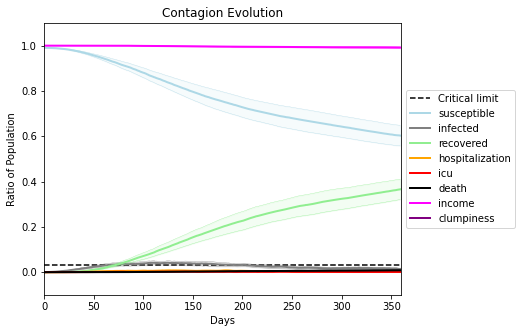

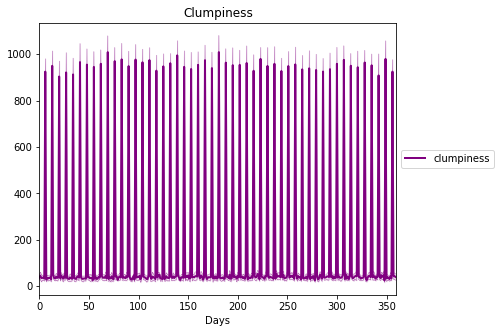

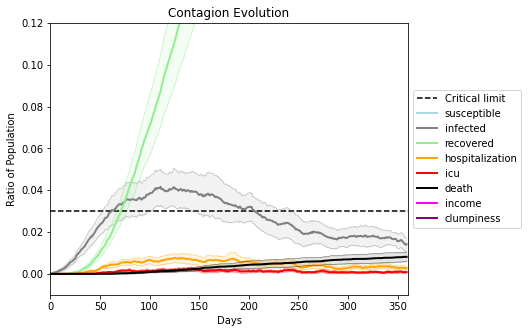

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5348, 6319, 4341, 8879, 4566, 6284, 2056, 8877, 5273, 8155, 7046, 4138, 3495, 3143, 6150, 4215, 8112, 8866, 9542, 5707]
Average similarity between family members is 0.24639460112775124 at temperature -0.5
Average similarity between family and home is 0.9998519187277385 at temperature -1
Average similarity between students and their classroom is 0.19205101618901396 at temperature -0.5
Average classroom occupancy is 1.560846560846561 and number classrooms is 189
Average similarity between workers is 0.16594724823749285 at temperature -0.5
Average office occupancy is 3.202970297029703 and number offices is 202
Average friend similarity for adults: 0.3333983352796353 for kids: 0.21987806451547137
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.11569264174885259
avg restaurant similarity 0.10054939216981665
avg restaurant similarity 0.05745232825421887
avg restaurant similarity 0.057250981420524726
avg restaurant similarity 0.09121536692051599
avg restaurant similarity 0.06309075417964839
avg restaurant similarity 0.0656152234550199
avg restaurant similarity 0.028454328129979715
avg restaurant similarity 0.11136084149647124
avg restaurant similarity 0.08750255976055668
avg restaurant similarity 0.1191268027853353
avg restaurant similarity 0.09067748167274589
avg restaurant similarity 0.0680185039778926
avg restaurant similarity 0.0065103949328656424
avg restaurant similarity 0.0460052937702922
avg restaurant similarity 0.08165527170019894
avg restaurant similarity 0.004416427673160628
avg restaurant similarity 0.06749306486214186
avg restaurant similarity 0.08320505384974738
avg restaurant similarity 0.039718755135912026
avg restaurant similarity 0.06139996747041591
avg restaurant similarity 0.0085

avg restaurant similarity 0.07332940973485112
avg restaurant similarity 0.06108844063038547
avg restaurant similarity 0.08067135375648919
avg restaurant similarity 0.0525148412622358
avg restaurant similarity 0.08422445220624146
avg restaurant similarity 0.07713557407078742
avg restaurant similarity 0.09364798863407232
avg restaurant similarity 0.06975086092719937
avg restaurant similarity 0.06726023797005379
avg restaurant similarity 0.11566008201317535
avg restaurant similarity 0.03510293048186626
avg restaurant similarity 0.043634831819447814
avg restaurant similarity 0.06711898222774759
avg restaurant similarity 0.03505392695163035
avg restaurant similarity 0.06870889196695643
avg restaurant similarity 0.07494723966142212
avg restaurant similarity 0.11904246272935981
avg restaurant similarity 0.1262444850928478
avg restaurant similarity 0.07563801450227899
avg restaurant similarity 0.11529914133452202
avg restaurant similarity 0.08838487848967981
avg restaurant similarity 0.0605683

avg restaurant similarity 0.06294298369067096
avg restaurant similarity 0.10344485195854221
avg restaurant similarity 0.03697472413367296
avg restaurant similarity 0.07186780105177351
Average similarity between family members is 0.23306848144874223 at temperature -0.5
Average similarity between family and home is 0.9998666856541917 at temperature -1
Average similarity between students and their classroom is 0.15698271927337806 at temperature -0.5
Average classroom occupancy is 1.5956284153005464 and number classrooms is 183
Average similarity between workers is 0.1660426239270235 at temperature -0.5
Average office occupancy is 3.195 and number offices is 200
Average friend similarity for adults: 0.3172004887451232 for kids: 0.20565643789393726
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.09750001586221388
avg restaurant similarity 0.08358216078602113
avg restaurant similarity 0.028974801611065238
avg restaurant similarity 0.07138555428161648
avg restaurant similarity 0.05129362209767263
avg restaurant similarity 0.06812930097813365
avg restaurant similarity 0.08931812431704418
avg restaurant similarity 0.0937927848273106
avg restaurant similarity 0.07217654102518997
avg restaurant similarity 0.02743826939393052
avg restaurant similarity 0.07662735314568087
avg restaurant similarity 0.03146444019090764
avg restaurant similarity 0.05947453481652267
avg restaurant similarity 0.037927201022827275
avg restaurant similarity 0.14203908823658581
avg restaurant similarity 0.07813872405727697
avg restaurant similarity 0.03343097161043545
avg restaurant similarity 0.009929396791425823
avg restaurant similarity 0.06346903785060067
avg restaurant similarity 0.01699719061471011
avg restaurant similarity 0.08680886367907632
avg restaurant similarity 0.0874

avg restaurant similarity 0.10890482486348137
avg restaurant similarity 0.048341392012096716
avg restaurant similarity 0.059120898558611246
avg restaurant similarity 0.03365548249752682
avg restaurant similarity 0.02345718980107007
avg restaurant similarity 0.035460156183061024
avg restaurant similarity 0.14767250716156993
avg restaurant similarity 0.0032710084303241346
avg restaurant similarity 0.07316449462134426
avg restaurant similarity 0.06538079564498944
avg restaurant similarity 0.05311954580592423
avg restaurant similarity 0.11904225105483983
avg restaurant similarity 0.09251700805122279
avg restaurant similarity 0.10991821303603477
avg restaurant similarity 0.11343633120641873
avg restaurant similarity 0.03762690856857918
avg restaurant similarity 0.04295906651679602
avg restaurant similarity 0.0863949632966332
avg restaurant similarity 0.06329135706849913
avg restaurant similarity 0.10438370286841266
avg restaurant similarity 0.06485777546253314
avg restaurant similarity 0.06

avg restaurant similarity 0.02382252983174225
avg restaurant similarity 0.05017747582724702
avg restaurant similarity 0.07851991489964434
avg restaurant similarity 0.07869500591104887
Average similarity between family members is 0.2764742268300368 at temperature -0.5
Average similarity between family and home is 0.9998661008925361 at temperature -1
Average similarity between students and their classroom is 0.16874839577555478 at temperature -0.5
Average classroom occupancy is 1.4777777777777779 and number classrooms is 180
Average similarity between workers is 0.15179192370472883 at temperature -0.5
Average office occupancy is 3.357843137254902 and number offices is 204
Average friend similarity for adults: 0.34297366772979987 for kids: 0.218920993465112
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.09000867149591431
avg restaurant similarity 0.06376033255436209
avg restaurant similarity 0.09025260811615954
avg restaurant similarity 0.05758581373970929
avg restaurant similarity 0.07493935071801798
avg restaurant similarity 0.13329709795459635
avg restaurant similarity 0.09632228702720234
avg restaurant similarity 0.06558845753765269
avg restaurant similarity 0.11752508133196889
avg restaurant similarity 0.06805971677458897
avg restaurant similarity 0.05957135410432283
avg restaurant similarity 0.05775123362325403
avg restaurant similarity 0.12712010344678054
avg restaurant similarity 0.04614599399810611
avg restaurant similarity 0.05767741819213225
avg restaurant similarity 0.09779927709966484
avg restaurant similarity 0.07305855003240705
avg restaurant similarity 0.1100590669513164
avg restaurant similarity 0.044593891854253914
avg restaurant similarity 0.06509472552353987
avg restaurant similarity 0.10954575988051198
avg restaurant similarity 0.078969

avg restaurant similarity 0.09110570862471715
avg restaurant similarity 0.09537511788380008
avg restaurant similarity 0.10588814708483012
avg restaurant similarity 0.0890315018868217
avg restaurant similarity 0.15336939825082324
avg restaurant similarity 0.08660706902313371
avg restaurant similarity 0.14354435449678224
avg restaurant similarity 0.10887797237047836
avg restaurant similarity 0.09180535540375363
avg restaurant similarity 0.064833022164136
avg restaurant similarity 0.08771818779348178
avg restaurant similarity 0.04446928235131474
avg restaurant similarity 0.07055506251081704
avg restaurant similarity 0.01317097212991559
avg restaurant similarity 0.10296742996342186
avg restaurant similarity 0.087433945178498
avg restaurant similarity 0.08925170047988967
avg restaurant similarity 0.08002186680602634
avg restaurant similarity 0.14943622395674522
avg restaurant similarity 0.04754943410324916
avg restaurant similarity 0.08344279988737967
avg restaurant similarity 0.08427100382

avg restaurant similarity 0.04274008723323334
avg restaurant similarity 0.08942438936364927
Average similarity between family members is 0.2519268514660266 at temperature -0.5
Average similarity between family and home is 0.9998500389057806 at temperature -1
Average similarity between students and their classroom is 0.19458766868924385 at temperature -0.5
Average classroom occupancy is 1.6611111111111112 and number classrooms is 180
Average similarity between workers is 0.1549613121956957 at temperature -0.5
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.3240943629617187 for kids: 0.22914547164328775
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.05541422776445671
avg restaurant similarity 0.05015645782450427
avg restaurant similarity 0.03403228803756577
avg restaurant similarity 0.08698391124175144
avg restaurant similarity 0.09148057188513302
avg restaurant similarity 0.020060603079615637
avg restaurant similarity 0.12872244586786155
avg restaurant similarity 0.04847882192343337
avg restaurant similarity 0.09052247674462581
avg restaurant similarity 0.0599995771158194
avg restaurant similarity 0.02104925138767854
avg restaurant similarity 0.0010595383342482318
avg restaurant similarity 0.04096364606378906
avg restaurant similarity 0.051975953975271785
avg restaurant similarity 0.04915415108954141
avg restaurant similarity 0.049320635945797
avg restaurant similarity 0.07800084201053414
avg restaurant similarity 0.04733532151339311
avg restaurant similarity 0.04404207782530934
avg restaurant similarity 0.0323878080440517
avg restaurant similarity 0.027127640106463204
avg restaurant similarity 0.03741

avg restaurant similarity 0.07116870758588613
avg restaurant similarity 0.041605011683261924
avg restaurant similarity 0.05079169860074588
avg restaurant similarity 0.06283932675274999
avg restaurant similarity 0.06855071599440674
avg restaurant similarity 0.09143733312913324
avg restaurant similarity 0.05426868098896814
avg restaurant similarity 0.05879004213414271
avg restaurant similarity 0.05751134125278466
avg restaurant similarity 0.05508977464875318
avg restaurant similarity 0.04441994301032979
avg restaurant similarity 0.06355579284266293
avg restaurant similarity 0.043083474366022716
avg restaurant similarity 0.1145415783813199
avg restaurant similarity 0.05674955120532393
avg restaurant similarity 0.04709253082865084
avg restaurant similarity 0.04125226008961291
avg restaurant similarity 0.04684308331246217
avg restaurant similarity 0.08457985295840466
avg restaurant similarity 0.07997859938831503
avg restaurant similarity 0.06370359745356706
avg restaurant similarity 0.06956

avg restaurant similarity 0.10290793412672902
avg restaurant similarity 0.06097273752277975
avg restaurant similarity 0.05915331376905752
avg restaurant similarity 0.0958327434943518
Average similarity between family members is 0.2578052345632064 at temperature -0.5
Average similarity between family and home is 0.9998536920548955 at temperature -1
Average similarity between students and their classroom is 0.17284789511892223 at temperature -0.5
Average classroom occupancy is 1.543956043956044 and number classrooms is 182
Average similarity between workers is 0.1380641833414739 at temperature -0.5
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.3286210131178872 for kids: 0.2210907441421131
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.08549032097476973
avg restaurant similarity 0.07128897693335232
avg restaurant similarity 0.0748480585611232
avg restaurant similarity 0.12285082132933715
avg restaurant similarity 0.04540645774460001
avg restaurant similarity 0.05288690342229283
avg restaurant similarity 0.06459722945169788
avg restaurant similarity 0.06904014008300136
avg restaurant similarity 0.048132708618559346
avg restaurant similarity 0.07151507553520897
avg restaurant similarity 0.06935026078485744
avg restaurant similarity 0.07236864950643956
avg restaurant similarity 0.07458296712687051
avg restaurant similarity 0.050952058049430406
avg restaurant similarity 0.14191611876102667
avg restaurant similarity 0.12112787860344228
avg restaurant similarity 0.06299606348503012
avg restaurant similarity 0.09489827167570752
avg restaurant similarity 0.11570642502701305
avg restaurant similarity 0.11997018448781281
avg restaurant similarity 0.05436018299222638
avg restaurant similarity 0.08873

avg restaurant similarity 0.14177418944431142
avg restaurant similarity 0.04970391895261018
avg restaurant similarity 0.07809793434488645
avg restaurant similarity 0.15579313473026002
avg restaurant similarity 0.12857264098109264
avg restaurant similarity 0.0928502881779212
avg restaurant similarity 0.05636015488191756
avg restaurant similarity 0.05820724798431423
avg restaurant similarity 0.10125302940763412
avg restaurant similarity 0.05636483610769446
avg restaurant similarity 0.10243572905209619
avg restaurant similarity 0.07622935313036262
avg restaurant similarity 0.0906716215419469
avg restaurant similarity 0.09253736466835721
avg restaurant similarity 0.10785107900793138
avg restaurant similarity 0.06873637598953466
avg restaurant similarity 0.08915967522022368
avg restaurant similarity 0.08821160659232756
avg restaurant similarity 0.05703942295333446
avg restaurant similarity 0.03676322157737912
avg restaurant similarity 0.08971418448105303
avg restaurant similarity 0.08699440

avg restaurant similarity 0.06696626247845898
avg restaurant similarity 0.058560669796263294
Average similarity between family members is 0.25351893011499654 at temperature -0.5
Average similarity between family and home is 0.9998557078005227 at temperature -1
Average similarity between students and their classroom is 0.14162462858684263 at temperature -0.5
Average classroom occupancy is 1.5730337078651686 and number classrooms is 178
Average similarity between workers is 0.16905364447874557 at temperature -0.5
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.3365123505363477 for kids: 0.21949996810309694
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units wit

avg restaurant similarity 0.04147196027462479
avg restaurant similarity 0.09940058138299965
avg restaurant similarity 0.031098042341241656
avg restaurant similarity 0.05182439568470971
avg restaurant similarity 0.04388324841605783
avg restaurant similarity 0.05475220400119027
avg restaurant similarity 0.0355241095794062
avg restaurant similarity 0.03173056643363191
avg restaurant similarity 0.05288136925356718
avg restaurant similarity 0.046136544512299094
avg restaurant similarity 0.12106398122151789
avg restaurant similarity 0.0009754585336711772
avg restaurant similarity 0.03772821214585613
avg restaurant similarity 0.06576869353621889
avg restaurant similarity 0.07670364955673124
avg restaurant similarity 0.01320328491534321
avg restaurant similarity 0.055504394830297475
avg restaurant similarity 0.027175190859943455
avg restaurant similarity 0.07693425660011323
avg restaurant similarity 0.09055785693298239
avg restaurant similarity 0.03516697914507433
avg restaurant similarity 0.0

avg restaurant similarity 0.08314852705490679
avg restaurant similarity 0.05850679763189785
avg restaurant similarity 0.05457758551303484
avg restaurant similarity 0.06898423579455307
avg restaurant similarity 0.058471571983686826
avg restaurant similarity 0.08388930313248688
avg restaurant similarity 0.11518677092681992
avg restaurant similarity 0.06023844527151787
avg restaurant similarity 0.045385915719957155
avg restaurant similarity 0.06473830855560551
avg restaurant similarity 0.03964613360627273
avg restaurant similarity 0.050614343344613316
avg restaurant similarity 0.09659479403224651
avg restaurant similarity 0.030911289038402585
avg restaurant similarity 0.0617330496101587
avg restaurant similarity 0.047034621245723614
avg restaurant similarity 0.058273352488281534
avg restaurant similarity 0.05611289404605986
avg restaurant similarity -0.012124246818522139
avg restaurant similarity 0.029795835040660773
avg restaurant similarity 0.08502161214510626
avg restaurant similarity 

avg restaurant similarity 0.07814044244977808
avg restaurant similarity 0.056009413720759786
avg restaurant similarity 0.10181963041629119
avg restaurant similarity 0.06363552495234662
Average similarity between family members is 0.25589957271569347 at temperature -0.5
Average similarity between family and home is 0.9998415838624893 at temperature -1
Average similarity between students and their classroom is 0.17827683013842274 at temperature -0.5
Average classroom occupancy is 1.5885714285714285 and number classrooms is 175
Average similarity between workers is 0.14889263988506884 at temperature -0.5
Average office occupancy is 3.409090909090909 and number offices is 198
Average friend similarity for adults: 0.32735767939392774 for kids: 0.20380807170484133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.03751403615774841
avg restaurant similarity 0.058767823248493965
avg restaurant similarity 0.045803272876481484
avg restaurant similarity 0.08074524304533781
avg restaurant similarity 0.08650527951566507
avg restaurant similarity 0.1345221279751128
avg restaurant similarity 0.03450353738249517
avg restaurant similarity 0.07361033153528448
avg restaurant similarity 0.08886259535031454
avg restaurant similarity 0.06345116927330412
avg restaurant similarity 0.04666806010050165
avg restaurant similarity 0.07846512614560686
avg restaurant similarity 0.1398027323261742
avg restaurant similarity 0.08062875606141034
avg restaurant similarity 0.055172031595316154
avg restaurant similarity 0.08038099419120555
avg restaurant similarity 0.07337478566838317
avg restaurant similarity 0.11886162739433075
avg restaurant similarity 0.06306811299858033
avg restaurant similarity 0.10611137417305244
avg restaurant similarity 0.1215049439883088
avg restaurant similarity 0.058071

avg restaurant similarity 0.07892753045163797
avg restaurant similarity 0.07724673818259425
avg restaurant similarity 0.11605418469569956
avg restaurant similarity 0.09272236667379322
avg restaurant similarity 0.12676682458135302
avg restaurant similarity 0.10559780085010412
avg restaurant similarity 0.10987371995466544
avg restaurant similarity 0.09029155908278427
avg restaurant similarity 0.05361504782817374
avg restaurant similarity 0.07076942133500462
avg restaurant similarity 0.07941353358779656
avg restaurant similarity 0.05372370476478933
avg restaurant similarity 0.08310119250171347
avg restaurant similarity 0.09486477306131035
avg restaurant similarity 0.08794436308460539
avg restaurant similarity 0.07710256584473585
avg restaurant similarity 0.08763606233492185
avg restaurant similarity 0.06819592358869316
avg restaurant similarity 0.06627744147700203
avg restaurant similarity 0.07504644947801464
avg restaurant similarity 0.0701171735996482
avg restaurant similarity 0.0489552

avg restaurant similarity 0.06704147906362894
avg restaurant similarity 0.08018682553283796
Average similarity between family members is 0.2499515678452338 at temperature -0.5
Average similarity between family and home is 0.9998559664863977 at temperature -1
Average similarity between students and their classroom is 0.1367455836965644 at temperature -0.5
Average classroom occupancy is 1.702247191011236 and number classrooms is 178
Average similarity between workers is 0.1503737212887404 at temperature -0.5
Average office occupancy is 3.2311557788944723 and number offices is 199
Average friend similarity for adults: 0.31970272390962734 for kids: 0.2145709769146303
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated un

avg restaurant similarity 0.03245517324172266
avg restaurant similarity 0.08735933710992085
avg restaurant similarity 0.11408608571561274
avg restaurant similarity 0.12405662908744317
avg restaurant similarity 0.058392770698616925
avg restaurant similarity 0.08344710244703507
avg restaurant similarity 0.0438249286487888
avg restaurant similarity 0.05833720907077529
avg restaurant similarity 0.10723535431109278
avg restaurant similarity 0.05528641391341843
avg restaurant similarity 0.11253792529694644
avg restaurant similarity 0.09853691417061781
avg restaurant similarity -0.011203144659361305
avg restaurant similarity 0.09914079987519835
avg restaurant similarity 0.04535413596169402
avg restaurant similarity 0.08546364227918166
avg restaurant similarity 0.05337598583284149
avg restaurant similarity 0.04074146520123837
avg restaurant similarity 0.07366789578379619
avg restaurant similarity 0.08211667705540183
avg restaurant similarity 0.05217804869494846
avg restaurant similarity 0.0115

avg restaurant similarity 0.07420460626970381
avg restaurant similarity 0.0599416879607226
avg restaurant similarity 0.11641938244927413
avg restaurant similarity 0.08219749223011985
avg restaurant similarity 0.06689202102787689
avg restaurant similarity -0.018092013724371022
avg restaurant similarity 0.05242351359594148
avg restaurant similarity 0.1090311800307555
avg restaurant similarity 0.10595664109366369
avg restaurant similarity 0.036038514262698905
avg restaurant similarity 0.07428450907668689
avg restaurant similarity 0.08040734092382168
avg restaurant similarity 0.060882689420926485
avg restaurant similarity -0.0016282456356796315
avg restaurant similarity 0.0013741352618827317
avg restaurant similarity 0.0915612614114885
avg restaurant similarity 0.006582556942376944
avg restaurant similarity 0.09111344845124664
avg restaurant similarity 0.05323566609547009
avg restaurant similarity 0.010936790477598787
avg restaurant similarity 0.0004020535376292818
avg restaurant similarit

avg restaurant similarity 0.04004873645152269
avg restaurant similarity 0.04679174938056162
avg restaurant similarity 0.0019203370998823132
avg restaurant similarity 0.11709876943342035
Average similarity between family members is 0.25339904324665025 at temperature -0.5
Average similarity between family and home is 0.9998474044661901 at temperature -1
Average similarity between students and their classroom is 0.17611981688944783 at temperature -0.5
Average classroom occupancy is 1.7647058823529411 and number classrooms is 170
Average similarity between workers is 0.1698370422155538 at temperature -0.5
Average office occupancy is 3.241206030150754 and number offices is 199
Average friend similarity for adults: 0.3274163989447142 for kids: 0.20764134554153327
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.07211536555875266
avg restaurant similarity 0.07046895991849209
avg restaurant similarity 0.054804718474901086
avg restaurant similarity 0.061573645464979655
avg restaurant similarity 0.07251630487350594
avg restaurant similarity 0.062266400229812335
avg restaurant similarity 0.0720618268479713
avg restaurant similarity 0.05044146738707304
avg restaurant similarity 0.07552483389957211
avg restaurant similarity 0.08241562895610059
avg restaurant similarity 0.03032773769860782
avg restaurant similarity 0.07900777732511621
avg restaurant similarity 0.09378358969579888
avg restaurant similarity 0.022493741729252566
avg restaurant similarity 0.07802534652217367
avg restaurant similarity 0.03554407352356764
avg restaurant similarity 0.13472987783236962
avg restaurant similarity 0.07370050223277706
avg restaurant similarity 0.10067141573262883
avg restaurant similarity 0.06811648262644843
avg restaurant similarity 0.018982714658345567
avg restaurant similarity 0.11

avg restaurant similarity 0.053913663724720944
avg restaurant similarity 0.115522760001528
avg restaurant similarity 0.07740156294992176
avg restaurant similarity 0.07794836918838836
avg restaurant similarity 0.10457871803424774
avg restaurant similarity 0.1002160518231651
avg restaurant similarity 0.0739639781645127
avg restaurant similarity 0.030427806277098082
avg restaurant similarity 0.08080312337459253
avg restaurant similarity 0.10879338396042708
avg restaurant similarity 0.0346798107441424
avg restaurant similarity 0.05615944607446799
avg restaurant similarity 0.09863106725656225
avg restaurant similarity 0.059373335031178594
avg restaurant similarity 0.04907531190698776
avg restaurant similarity 0.07642591320668221
avg restaurant similarity 0.11378945371442267
avg restaurant similarity 0.09167078799468902
avg restaurant similarity 0.08699047934435256
avg restaurant similarity 0.03129653238997137
avg restaurant similarity 0.07757887858620643
avg restaurant similarity 0.13491674

avg restaurant similarity 0.008402577521149346
avg restaurant similarity 0.10113280191491217
avg restaurant similarity 0.11463348835494945
Average similarity between family members is 0.24411878905646245 at temperature -0.5
Average similarity between family and home is 0.9998563365801793 at temperature -1
Average similarity between students and their classroom is 0.13784823823948558 at temperature -0.5
Average classroom occupancy is 1.5080213903743316 and number classrooms is 187
Average similarity between workers is 0.14273545330292609 at temperature -0.5
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.3275056706482394 for kids: 0.21865886658657713
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.05047966705636144
avg restaurant similarity 0.06591364034784276
avg restaurant similarity 0.10702944152399309
avg restaurant similarity 0.06347022157874348
avg restaurant similarity 0.1522694064682147
avg restaurant similarity 0.08851950892672665
avg restaurant similarity 0.11760108374601395
avg restaurant similarity 0.1051635154616399
avg restaurant similarity 0.04711373917502126
avg restaurant similarity 0.04690585275937176
avg restaurant similarity 0.03847068027849422
avg restaurant similarity 0.11003254861835018
avg restaurant similarity 0.06556538912225925
avg restaurant similarity 0.09351019070044261
avg restaurant similarity 0.04775221482371653
avg restaurant similarity 0.042729380391854116
avg restaurant similarity 0.11600277836624234
avg restaurant similarity 0.08298336949333839
avg restaurant similarity 0.12066137347009218
avg restaurant similarity 0.06075258813360191
avg restaurant similarity 0.09269884933285272
avg restaurant similarity 0.0959830

avg restaurant similarity 0.09465760754786216
avg restaurant similarity 0.10740870127473319
avg restaurant similarity 0.1390586246625286
avg restaurant similarity 0.02768898249424636
avg restaurant similarity 0.06090283583564693
avg restaurant similarity 0.13559799269376444
avg restaurant similarity 0.07270296411978945
avg restaurant similarity 0.051251631529045806
avg restaurant similarity 0.09840979062846861
avg restaurant similarity 0.05998446983520608
avg restaurant similarity 0.08390760414805769
avg restaurant similarity 0.11566322842904186
avg restaurant similarity 0.04833177040904232
avg restaurant similarity 0.09374392418964478
avg restaurant similarity 0.07900840704383416
avg restaurant similarity 0.10204919668532644
avg restaurant similarity 0.07282938855193298
avg restaurant similarity 0.04854282327230692
avg restaurant similarity 0.01901633717731427
avg restaurant similarity 0.06311279515554541
avg restaurant similarity 0.09573010978575631
avg restaurant similarity 0.101287

avg restaurant similarity 0.06750044498657343
avg restaurant similarity 0.09716645477733027
Average similarity between family members is 0.24505498022206942 at temperature -0.5
Average similarity between family and home is 0.9998410012380583 at temperature -1
Average similarity between students and their classroom is 0.15688588224942218 at temperature -0.5
Average classroom occupancy is 1.6390532544378698 and number classrooms is 169
Average similarity between workers is 0.14158056656574527 at temperature -0.5
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.32054836276195275 for kids: 0.21387995672438542
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloca

avg restaurant similarity 0.03625098089666767
avg restaurant similarity 0.020934108247106925
avg restaurant similarity 0.051177943748503894
avg restaurant similarity 0.04364747726816081
avg restaurant similarity 0.05920326908423145
avg restaurant similarity 0.03826412025631555
avg restaurant similarity 0.06323092256217602
avg restaurant similarity 0.022978118854101896
avg restaurant similarity 0.03982923753132522
avg restaurant similarity 0.023908643253204204
avg restaurant similarity 0.04578219125236892
avg restaurant similarity 0.08940158733406861
avg restaurant similarity 0.07325328943031086
avg restaurant similarity 0.10668125416297802
avg restaurant similarity -0.003743292592630516
avg restaurant similarity 0.020288471531336606
avg restaurant similarity 0.07501870702539143
avg restaurant similarity 0.047714559507008245
avg restaurant similarity 0.10191536438840178
avg restaurant similarity 0.024618980288563557
avg restaurant similarity -0.014728883523462237
avg restaurant similari

avg restaurant similarity -0.002192287324286524
avg restaurant similarity 0.012257064450235266
avg restaurant similarity 0.04256638595273345
avg restaurant similarity 0.07527913857936785
avg restaurant similarity 0.06887985589897484
avg restaurant similarity 0.024459079806531104
avg restaurant similarity 0.040245375310051595
avg restaurant similarity 0.03685222850755839
avg restaurant similarity 0.028624931097462163
avg restaurant similarity 0.049805167323559316
avg restaurant similarity 0.04404400651911873
avg restaurant similarity 0.09427632365480562
avg restaurant similarity 0.03565747861540682
avg restaurant similarity 0.08436111895376909
avg restaurant similarity 0.014632406980100912
avg restaurant similarity 0.026922243248225328
avg restaurant similarity 0.017010975434730298
avg restaurant similarity 0.039452931322130846
avg restaurant similarity 0.021588709220876412
avg restaurant similarity 0.04909486826398448
avg restaurant similarity 0.0009714116909277531
avg restaurant simil

avg restaurant similarity 0.02333690377549442
avg restaurant similarity 0.04674508671918896
avg restaurant similarity 0.02802395705799918
avg restaurant similarity -0.0014807630518311942
avg restaurant similarity 0.059116607119721776
avg restaurant similarity 0.031992198694835175
Average similarity between family members is 0.2679118784099442 at temperature -0.5
Average similarity between family and home is 0.9998434994276567 at temperature -1
Average similarity between students and their classroom is 0.12790977435034281 at temperature -0.5
Average classroom occupancy is 1.6 and number classrooms is 175
Average similarity between workers is 0.14084358914154352 at temperature -0.5
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.33250847989487614 for kids: 0.20691553354962966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total 

avg restaurant similarity 0.02608237928320225
avg restaurant similarity 0.0970712426385548
avg restaurant similarity 0.08794132432352741
avg restaurant similarity 0.0826881868730529
avg restaurant similarity 0.08680544072741532
avg restaurant similarity 0.07833835021730173
avg restaurant similarity 0.10533064345928965
avg restaurant similarity 0.028844995971165258
avg restaurant similarity 0.11194263522477087
avg restaurant similarity 0.11010887297587091
avg restaurant similarity 0.13282474347301856
avg restaurant similarity 0.08628510692660535
avg restaurant similarity 0.10309197042968761
avg restaurant similarity 0.07428588157161828
avg restaurant similarity 0.11065637346900693
avg restaurant similarity 0.0959986689289581
avg restaurant similarity 0.0808097765850106
avg restaurant similarity 0.09688250515831309
avg restaurant similarity 0.1097766469829899
avg restaurant similarity 0.07550934743388979
avg restaurant similarity 0.08048217974771135
avg restaurant similarity 0.0854206683

avg restaurant similarity 0.04920821852668591
avg restaurant similarity 0.09273695138765463
avg restaurant similarity 0.0862626283370646
avg restaurant similarity 0.07504434071365254
avg restaurant similarity 0.06496747709224003
avg restaurant similarity 0.03976581563851927
avg restaurant similarity 0.10101740483963553
avg restaurant similarity 0.09503299092059764
avg restaurant similarity 0.07896163444287009
avg restaurant similarity 0.05609452330080933
avg restaurant similarity 0.029768576252739078
avg restaurant similarity 0.058828797953220394
avg restaurant similarity 0.03007449275382205
avg restaurant similarity 0.09370453879090093
avg restaurant similarity 0.07909328509681539
avg restaurant similarity 0.07430095013041335
avg restaurant similarity 0.05688393163270239
avg restaurant similarity 0.06262392065743123
avg restaurant similarity 0.024293502432210727
avg restaurant similarity 0.03286180893227738
avg restaurant similarity 0.006944600139394963
avg restaurant similarity 0.122

avg restaurant similarity 0.0702088979698574
avg restaurant similarity 0.05592018163723765
avg restaurant similarity 0.016462549064233292
avg restaurant similarity 0.08222890497945119
Average similarity between family members is 0.2779995816033639 at temperature -0.5
Average similarity between family and home is 0.9998539075282815 at temperature -1
Average similarity between students and their classroom is 0.16213156593991804 at temperature -0.5
Average classroom occupancy is 1.6390532544378698 and number classrooms is 169
Average similarity between workers is 0.16139228715564038 at temperature -0.5
Average office occupancy is 3.5526315789473686 and number offices is 190
Average friend similarity for adults: 0.32559436784397733 for kids: 0.22058537044434207
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.028873129183349847
avg restaurant similarity 0.07768096540609395
avg restaurant similarity 0.15048109902124016
avg restaurant similarity 0.03520019191095613
avg restaurant similarity 0.03974924554969123
avg restaurant similarity 0.057144101544239115
avg restaurant similarity 0.0902958186365776
avg restaurant similarity 0.08671472941066731
avg restaurant similarity 0.032248192788899864
avg restaurant similarity 0.07136141092425212
avg restaurant similarity 0.04858973221547253
avg restaurant similarity 0.09402346281036647
avg restaurant similarity 0.14784507587936146
avg restaurant similarity 0.06139149831783733
avg restaurant similarity 0.03330533553611123
avg restaurant similarity 0.019384557401107918
avg restaurant similarity 0.06846225273496351
avg restaurant similarity 0.0708675849158953
avg restaurant similarity 0.0097835257607002
avg restaurant similarity 0.038561409391065886
avg restaurant similarity 0.07913599057325708
avg restaurant similarity 0.1178

avg restaurant similarity 0.14752732968680113
avg restaurant similarity 0.089925368617701
avg restaurant similarity 0.03992065148844295
avg restaurant similarity 0.04452782002332959
avg restaurant similarity 0.18820966907223463
avg restaurant similarity 0.13131475027879616
avg restaurant similarity 0.08456649345420501
avg restaurant similarity 0.04746113566962634
avg restaurant similarity 0.13508470728064623
avg restaurant similarity 0.06751285979081298
avg restaurant similarity 0.10310664378241714
avg restaurant similarity 0.03612435584817574
avg restaurant similarity 0.09358505339726403
avg restaurant similarity 0.08082608468083999
avg restaurant similarity 0.09666997846308441
avg restaurant similarity 0.10755727273633697
avg restaurant similarity 0.03827478633679911
avg restaurant similarity 0.1340731604790947
avg restaurant similarity -0.011824130039391737
avg restaurant similarity 0.06911726136365284
avg restaurant similarity 0.042143878427785636
avg restaurant similarity 0.048556

avg restaurant similarity 0.053085365548051655
avg restaurant similarity 0.07555058367618862
Average similarity between family members is 0.24708283237999193 at temperature -0.5
Average similarity between family and home is 0.9998539909876841 at temperature -1
Average similarity between students and their classroom is 0.17701831469974433 at temperature -0.5
Average classroom occupancy is 1.4866310160427807 and number classrooms is 187
Average similarity between workers is 0.12379044785025918 at temperature -0.5
Average office occupancy is 3.4213197969543145 and number offices is 197
Average friend similarity for adults: 0.3321130819853536 for kids: 0.2131506575614526
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.08796740476008762
avg restaurant similarity 0.05425202050933082
avg restaurant similarity 0.11069819436145462
avg restaurant similarity 0.12585548769793262
avg restaurant similarity 0.026707219253887568
avg restaurant similarity 0.07606946630949186
avg restaurant similarity 0.1155657753660631
avg restaurant similarity 0.05129759558095719
avg restaurant similarity 0.040257286903551695
avg restaurant similarity 0.07021042233375917
avg restaurant similarity 0.0643134978974688
avg restaurant similarity 0.07994985247362031
avg restaurant similarity 0.08679928887060963
avg restaurant similarity 0.06265302792955621
avg restaurant similarity 0.04205635244749088
avg restaurant similarity 0.10261524988372486
avg restaurant similarity 0.02258891808837768
avg restaurant similarity 0.043469118148916186
avg restaurant similarity 0.03519023553365971
avg restaurant similarity 0.10020117297237105
avg restaurant similarity 0.07663818234865884
avg restaurant similarity 0.06041

avg restaurant similarity 0.040521415197342495
avg restaurant similarity 0.11906849340028372
avg restaurant similarity 0.07408798027268479
avg restaurant similarity 0.08216322283116113
avg restaurant similarity 0.10105514233922548
avg restaurant similarity 0.0836893918671474
avg restaurant similarity 0.07755539727303805
avg restaurant similarity 0.06555134215721378
avg restaurant similarity 0.11891230075849823
avg restaurant similarity -0.005368962926466894
avg restaurant similarity 0.06119162595272533
avg restaurant similarity 0.053793649880568076
avg restaurant similarity 0.07255543389161304
avg restaurant similarity 0.05382496509023637
avg restaurant similarity 0.0448168423299073
avg restaurant similarity 0.0245645787012964
avg restaurant similarity 0.09688922430025391
avg restaurant similarity 0.1306790242982013
avg restaurant similarity 0.027827614733170265
avg restaurant similarity 0.033322584495114826
avg restaurant similarity 0.03386149153109772
avg restaurant similarity 0.0060

avg restaurant similarity 0.04575942690659933
avg restaurant similarity 0.03280091054818285
avg restaurant similarity -0.0022531384059732845
avg restaurant similarity 0.07351716725084985
Average similarity between family members is 0.2718249131440164 at temperature -0.5
Average similarity between family and home is 0.9998455767157394 at temperature -1
Average similarity between students and their classroom is 0.19151977045026852 at temperature -0.5
Average classroom occupancy is 1.6272189349112427 and number classrooms is 169
Average similarity between workers is 0.16821908261688892 at temperature -0.5
Average office occupancy is 3.289855072463768 and number offices is 207
Average friend similarity for adults: 0.34472925236782637 for kids: 0.2314990697211914
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.04008893430117451
avg restaurant similarity 0.09304775720140196
avg restaurant similarity 0.0855270085824202
avg restaurant similarity 0.038027563911709805
avg restaurant similarity 0.0028547176898975563
avg restaurant similarity 0.16589261113358234
avg restaurant similarity 0.10552390485843066
avg restaurant similarity 0.07790775686787121
avg restaurant similarity 0.08748807864369136
avg restaurant similarity 0.09924980266443748
avg restaurant similarity 0.05756818889111785
avg restaurant similarity 0.10375394924870332
avg restaurant similarity 0.11849225300772054
avg restaurant similarity 0.11238609814248934
avg restaurant similarity 0.08914751476715803
avg restaurant similarity 0.02249905533209118
avg restaurant similarity 0.12368686319538472
avg restaurant similarity 0.15130446803821054
avg restaurant similarity 0.06576424334217992
avg restaurant similarity 0.042987331144343104
avg restaurant similarity 0.014421791988458455
avg restaurant similarity 0.10

avg restaurant similarity 0.09376301562408351
avg restaurant similarity 0.10125239878009172
avg restaurant similarity 0.031354589112166154
avg restaurant similarity 0.0873057850590193
avg restaurant similarity -0.01633474885730936
avg restaurant similarity 0.06356410729856776
avg restaurant similarity 0.07601448998105041
avg restaurant similarity 0.13220383104365882
avg restaurant similarity 0.18723049452028817
avg restaurant similarity 0.07460315038016024
avg restaurant similarity 0.16343272891464095
avg restaurant similarity 0.1196182560697683
avg restaurant similarity 0.08183008920003652
avg restaurant similarity 0.16538188616960806
avg restaurant similarity 0.09114104128771099
avg restaurant similarity 0.15160104926142118
avg restaurant similarity 0.1354908269739679
avg restaurant similarity 0.09782374580011266
avg restaurant similarity 0.11630065414123242
avg restaurant similarity 0.07294907859454312
avg restaurant similarity 0.14920795151680322
avg restaurant similarity 0.0554790

avg restaurant similarity 0.10349347171004217
avg restaurant similarity 0.10218658151728706
Average similarity between family members is 0.2519148175148095 at temperature -0.5
Average similarity between family and home is 0.9998430019941092 at temperature -1
Average similarity between students and their classroom is 0.2096181001782012 at temperature -0.5
Average classroom occupancy is 1.5706806282722514 and number classrooms is 191
Average similarity between workers is 0.1673973024288168 at temperature -0.5
Average office occupancy is 3.2717948717948717 and number offices is 195
Average friend similarity for adults: 0.32184214515460824 for kids: 0.21487071314298783
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.10265600505059141
avg restaurant similarity 0.07213510414227954
avg restaurant similarity 0.08323250929468562
avg restaurant similarity 0.06949836350209423
avg restaurant similarity 0.028387137411977327
avg restaurant similarity 0.12093432978818056
avg restaurant similarity 0.10636114401125814
avg restaurant similarity 0.0379173478438481
avg restaurant similarity 0.09286373262323866
avg restaurant similarity 0.05048885001299685
avg restaurant similarity 0.0774285773188981
avg restaurant similarity 0.07856840916491893
avg restaurant similarity 0.04846906375750657
avg restaurant similarity 0.08681135398347656
avg restaurant similarity 0.08104475586284293
avg restaurant similarity 0.08682399797273892
avg restaurant similarity 0.0711813741976792
avg restaurant similarity 0.09495307538435266
avg restaurant similarity -0.014762591761883046
avg restaurant similarity 0.08078105091640077
avg restaurant similarity 0.11219135401867494
avg restaurant similarity 0.033173

avg restaurant similarity 0.028909048831178955
avg restaurant similarity 0.06920391729388604
avg restaurant similarity 0.0607515460442137
avg restaurant similarity 0.08694681380299296
avg restaurant similarity 0.0244389936965746
avg restaurant similarity 0.10460773285528725
avg restaurant similarity 0.059076389699340245
avg restaurant similarity 0.07809591231745466
avg restaurant similarity 0.09778850799606414
avg restaurant similarity 0.07590764085467862
avg restaurant similarity 0.08575030240748258
avg restaurant similarity 0.12551816665219237
avg restaurant similarity 0.06481179503490643
avg restaurant similarity 0.10773113530355875
avg restaurant similarity 0.12792321254027766
avg restaurant similarity 0.09141271335397046
avg restaurant similarity 0.08418213444111067
avg restaurant similarity 0.09826416569789691
avg restaurant similarity 0.05520934757418807
avg restaurant similarity 0.12607028120397673
avg restaurant similarity 0.0781895786385644
avg restaurant similarity 0.0324743

avg restaurant similarity 0.07651487580592055
avg restaurant similarity 0.04986794348329729
Average similarity between family members is 0.26579453719305035 at temperature -0.5
Average similarity between family and home is 0.9998577172641162 at temperature -1
Average similarity between students and their classroom is 0.15695293488477957 at temperature -0.5
Average classroom occupancy is 1.6123595505617978 and number classrooms is 178
Average similarity between workers is 0.16670381156075592 at temperature -0.5
Average office occupancy is 3.2205882352941178 and number offices is 204
Average friend similarity for adults: 0.33803678582383945 for kids: 0.21479007614051304
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.112132298747119
avg restaurant similarity 0.04408309089415176
avg restaurant similarity 0.034454638512702244
avg restaurant similarity 0.01722839024147742
avg restaurant similarity 0.04019067213504505
avg restaurant similarity 0.05556138962860582
avg restaurant similarity 0.03134056002848273
avg restaurant similarity 0.014113567699330797
avg restaurant similarity 0.030952264908680315
avg restaurant similarity 0.049191631019660204
avg restaurant similarity 0.026940047429508965
avg restaurant similarity 0.053078224149044194
avg restaurant similarity 0.0764403047380067
avg restaurant similarity 0.04444939299018493
avg restaurant similarity 0.02744452745631207
avg restaurant similarity 0.05682551347735422
avg restaurant similarity 0.07730503790182544
avg restaurant similarity 0.06179548329223821
avg restaurant similarity 0.07346067489046511
avg restaurant similarity 0.03266042590270019
avg restaurant similarity 0.11325940122242317
avg restaurant similarity 0.123

avg restaurant similarity 0.04917551446667493
avg restaurant similarity 0.026947494666321174
avg restaurant similarity 0.0705085317793363
avg restaurant similarity 0.04913691395276757
avg restaurant similarity 0.07933354576960297
avg restaurant similarity 0.09214263471766368
avg restaurant similarity 0.07743893468123128
avg restaurant similarity 0.05131485068483993
avg restaurant similarity 0.08869885946058552
avg restaurant similarity 0.06463344001753495
avg restaurant similarity 0.10162475020890238
avg restaurant similarity 0.07094879600633773
avg restaurant similarity 0.041003303249131734
avg restaurant similarity 0.1466854165193381
avg restaurant similarity 0.08579468789246014
avg restaurant similarity 0.059360066274131644
avg restaurant similarity -0.014266420089301934
avg restaurant similarity 0.08194889684355493
avg restaurant similarity 0.008561239912288713
avg restaurant similarity 0.09121478434038484
avg restaurant similarity 0.050775116618588
avg restaurant similarity 0.0895

avg restaurant similarity 0.06661785297185746
avg restaurant similarity 0.07001815878638643
avg restaurant similarity 0.07367767232111809
avg restaurant similarity 0.024467104469324444
Average similarity between family members is 0.273596964602308 at temperature -0.5
Average similarity between family and home is 0.9998622404624482 at temperature -1
Average similarity between students and their classroom is 0.19157490723139092 at temperature -0.5
Average classroom occupancy is 1.5405405405405406 and number classrooms is 185
Average similarity between workers is 0.16330945511186584 at temperature -0.5
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for adults: 0.3223173527602346 for kids: 0.22509455294425815
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.10237150371408875
avg restaurant similarity 0.06328873333766703
avg restaurant similarity 0.08442820494155417
avg restaurant similarity 0.05058579631922052
avg restaurant similarity 0.06947238092594153
avg restaurant similarity 0.03688424710255241
avg restaurant similarity 0.08809199608714496
avg restaurant similarity 0.10223098700609756
avg restaurant similarity 0.06451736234555727
avg restaurant similarity 0.05984105272814705
avg restaurant similarity 0.04010663853792982
avg restaurant similarity 0.05874934109335635
avg restaurant similarity 0.08101818887973021
avg restaurant similarity 0.0549547497368202
avg restaurant similarity 0.09882342325628542
avg restaurant similarity 0.07820201417647445
avg restaurant similarity 0.056404426580378496
avg restaurant similarity 0.09232575134154251
avg restaurant similarity 0.06555020509416022
avg restaurant similarity 0.06708633446061724
avg restaurant similarity 0.10910908815263255
avg restaurant similarity 0.072115

avg restaurant similarity 0.04942957605746181
avg restaurant similarity 0.0920749742896716
avg restaurant similarity 0.09242625269423053
avg restaurant similarity 0.06189771762358392
avg restaurant similarity 0.06848936515210173
avg restaurant similarity 0.09030014896704407
avg restaurant similarity 0.06372098634916376
avg restaurant similarity 0.039217018787806576
avg restaurant similarity 0.11378770162237371
avg restaurant similarity 0.06253916498391404
avg restaurant similarity 0.0653012022425039
avg restaurant similarity 0.06962818594776161
avg restaurant similarity 0.04203651453259943
avg restaurant similarity 0.13242534930300667
avg restaurant similarity 0.001646677884089204
avg restaurant similarity 0.0396467035392454
avg restaurant similarity 0.13771227156661087
avg restaurant similarity 0.051705881451756606
avg restaurant similarity 0.09846750065818022
avg restaurant similarity 0.10932840468806734
avg restaurant similarity 0.07952219471959643
avg restaurant similarity 0.062965

avg restaurant similarity 0.06652396360730999
avg restaurant similarity 0.10281164076882081
Average similarity between family members is 0.254508528607358 at temperature -0.5
Average similarity between family and home is 0.9998485303952127 at temperature -1
Average similarity between students and their classroom is 0.17390984274783036 at temperature -0.5
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.15888576110787034 at temperature -0.5
Average office occupancy is 3.376237623762376 and number offices is 202
Average friend similarity for adults: 0.32863537857112834 for kids: 0.20563178889305783
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.0459306379625987
avg restaurant similarity 0.060569013556187004
avg restaurant similarity 0.033996086503612986
avg restaurant similarity 0.10272267550944345
avg restaurant similarity 0.05389244074214241
avg restaurant similarity 0.1194741900770519
avg restaurant similarity 0.09730882776481063
avg restaurant similarity 0.05266440145807703
avg restaurant similarity 0.06566799019812365
avg restaurant similarity 0.018993002740102263
avg restaurant similarity 0.12745970521960207
avg restaurant similarity 0.015363340736257142
avg restaurant similarity 0.0760004232473877
avg restaurant similarity 0.045347708890038106
avg restaurant similarity 0.047066052358045764
avg restaurant similarity 0.09092773290688622
avg restaurant similarity 0.05164357593392814
avg restaurant similarity 0.08825116535561711
avg restaurant similarity 0.057400221474516795
avg restaurant similarity 0.05963042231287109
avg restaurant similarity -0.010347117513496639
avg restaurant similarity 0.

avg restaurant similarity 0.08508628731905574
avg restaurant similarity 0.06262704425935166
avg restaurant similarity 0.02399508608150387
avg restaurant similarity 0.035711033456791
avg restaurant similarity 0.03987620030088357
avg restaurant similarity 0.10419683294603922
avg restaurant similarity 0.05815579884185064
avg restaurant similarity 0.034172939397866565
avg restaurant similarity 0.05172090933737921
avg restaurant similarity 0.0806968459565244
avg restaurant similarity 0.032500101619960475
avg restaurant similarity 0.056120064424054254
avg restaurant similarity 0.06978982433910587
avg restaurant similarity 0.023569077761641667
avg restaurant similarity 0.08806779264104467
avg restaurant similarity 0.08800471566092569
avg restaurant similarity 0.06274951041139928
avg restaurant similarity 0.08492909270013993
avg restaurant similarity 0.03775375795436521
avg restaurant similarity 0.040605587734626546
avg restaurant similarity 0.04996310532954154
avg restaurant similarity 0.0624

avg restaurant similarity 0.0907869510273109
avg restaurant similarity 0.07532029415257906
avg restaurant similarity 0.07473157175772367
Average similarity between family members is 0.24768436973249386 at temperature -0.5
Average similarity between family and home is 0.9998515168602052 at temperature -1
Average similarity between students and their classroom is 0.16276795585064927 at temperature -0.5
Average classroom occupancy is 1.5888888888888888 and number classrooms is 180
Average similarity between workers is 0.16218524918522967 at temperature -0.5
Average office occupancy is 3.2524752475247523 and number offices is 202
Average friend similarity for adults: 0.3250955212786296 for kids: 0.20239805067406957
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.11264642854967843
avg restaurant similarity 0.056517669768177126
avg restaurant similarity 0.05873360697512868
avg restaurant similarity 0.07182659423733959
avg restaurant similarity 0.09988236653945358
avg restaurant similarity 0.09119097297977569
avg restaurant similarity 0.062722844194334
avg restaurant similarity 0.06457463084075506
avg restaurant similarity 0.07609481371434071
avg restaurant similarity 0.09726960577677844
avg restaurant similarity 0.08960840968434272
avg restaurant similarity 0.13048378050708753
avg restaurant similarity 0.07684367270594993
avg restaurant similarity 0.07437038259323311
avg restaurant similarity 0.10503440860399246
avg restaurant similarity 0.06466972489392613
avg restaurant similarity 0.026020721958592674
avg restaurant similarity 0.0622017091112679
avg restaurant similarity 0.046935730915150256
avg restaurant similarity 0.07299399354990439
avg restaurant similarity 0.026854119865167815
avg restaurant similarity 0.09506

avg restaurant similarity 0.049881621163647596
avg restaurant similarity 0.10637714282367246
avg restaurant similarity 0.07515885207884869
avg restaurant similarity 0.03359669031399771
avg restaurant similarity 0.11907509653148786
avg restaurant similarity 0.06294928505540569
avg restaurant similarity 0.059180643291798625
avg restaurant similarity 0.12254353101939494
avg restaurant similarity 0.08154874974334432
avg restaurant similarity 0.04432347027879526
avg restaurant similarity 0.08212402692982355
avg restaurant similarity 0.07899484215571166
avg restaurant similarity 0.034090658286663286
avg restaurant similarity 0.10910789565161169
avg restaurant similarity 0.09981827460623682
avg restaurant similarity 0.0939882307372836
avg restaurant similarity 0.09567845717026995
avg restaurant similarity 0.021142820486383274
avg restaurant similarity 0.12047897302959532
avg restaurant similarity 0.10037469863509975
avg restaurant similarity 0.09470233540399804
avg restaurant similarity 0.081

avg restaurant similarity 0.07788566187897542
avg restaurant similarity 0.09997435944226662
using average of time series:
stats on susceptible:
data: [0.8922621025811455, 0.8125861111111111, 0.834163888888889, 0.7906038406038407, 0.7022222222222223, 0.8161944444444446, 0.7556083333333333, 0.7903277777777779, 0.7761781991572411, 0.6406916666666667, 0.6465388888888889, 0.6450138888888889, 0.7151638888888887, 0.7233960483960484, 0.6720499999999999, 0.5451527777777778, 0.8391966067864272, 0.7435166666666666, 0.7320055555555556, 0.683575]
min:
0.5451527777777778
max:
0.8922621025811455
std:
0.0822490235116869
mean:
0.7378223954317906
median:
0.7377611111111111
95% confidence interval for the mean:
(0.698328663897442,0.7773161269661393)
using average of time series:
stats on infected:
data: [0.014750193862855875, 0.022652777777777775, 0.022213888888888887, 0.02051837051837052, 0.029261111111111113, 0.02323611111111111, 0.024783333333333334, 0.02801666666666667, 0.029291417165668663, 0.035425

(<function dict.items>, <function dict.items>, <function dict.items>)

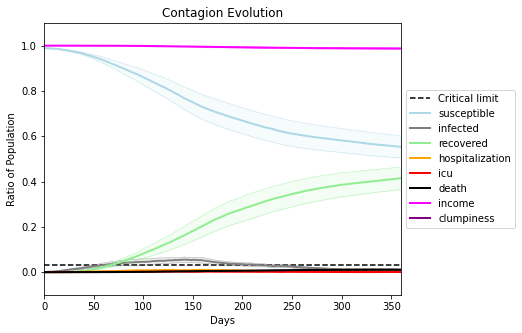

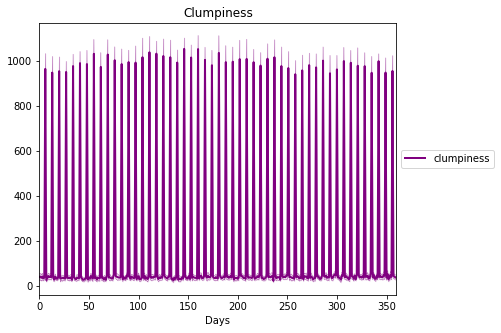

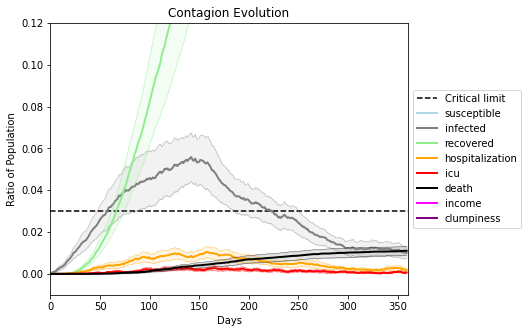

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1438, 9249, 2719, 8532, 3400, 8555, 2688, 1532, 7338, 9334, 7819, 7043, 4733, 8930, 4157, 777, 258, 6719, 6072, 8606]
Average similarity between family members is 0.23376525085771027 at temperature -0.4
Average similarity between family and home is 0.9998542286092963 at temperature -1
Average similarity between students and their classroom is 0.16632314470249765 at temperature -0.4
Average classroom occupancy is 1.6284153005464481 and number classrooms is 183
Average similarity between workers is 0.13458141371988208 at temperature -0.4
Average office occupancy is 3.1818181818181817 and number offices is 198
Average friend similarity for adults: 0.27274055913291606 for kids: 0.21007098564006438
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.03568418075201241
avg restaurant similarity -0.011990178730487544
avg restaurant similarity 0.08986191144193818
avg restaurant similarity 0.04193746214298397
avg restaurant similarity 0.07177289716160379
avg restaurant similarity 0.02050834296146269
avg restaurant similarity 0.0009569701328644847
avg restaurant similarity 0.042352364395805635
avg restaurant similarity 0.09850622323812167
avg restaurant similarity 0.04797554888389941
avg restaurant similarity 0.051934569791433356
avg restaurant similarity -0.002412995563358023
avg restaurant similarity 0.003001593609122219
avg restaurant similarity 0.0571791559897306
avg restaurant similarity 0.033631979095652326
avg restaurant similarity 0.05599419105899148
avg restaurant similarity 0.0775187833947453
avg restaurant similarity 0.009824123406943398
avg restaurant similarity 0.004420415107813167
avg restaurant similarity -0.008016338472063327
avg restaurant similarity 0.04422439373579739
avg restaurant similar

avg restaurant similarity 0.028797531325352455
avg restaurant similarity -0.031491845391005184
avg restaurant similarity 0.04450307296875487
avg restaurant similarity 0.06202697865363738
avg restaurant similarity 0.03019471297079816
avg restaurant similarity 0.07934102393024356
avg restaurant similarity 0.03909799412246668
avg restaurant similarity 0.04078835338630393
avg restaurant similarity 0.02647474803303379
avg restaurant similarity 0.0089330938357394
avg restaurant similarity 0.06026883786973824
avg restaurant similarity 0.040810254692751326
avg restaurant similarity 0.043163621341429606
avg restaurant similarity 0.05816283648329843
avg restaurant similarity 0.06611397727486344
avg restaurant similarity 0.018293498941558406
avg restaurant similarity 0.03381613346182661
avg restaurant similarity 0.01590973326829034
avg restaurant similarity 0.008864312992369469
avg restaurant similarity 0.01591221006916428
avg restaurant similarity 0.016037771866352014
avg restaurant similarity 0

avg restaurant similarity 0.030441732511204366
avg restaurant similarity 0.08506582699470089
avg restaurant similarity 0.04166276723919513
avg restaurant similarity 0.020853624097721783
avg restaurant similarity 0.0032403772850748778
Average similarity between family members is 0.2285948373457465 at temperature -0.4
Average similarity between family and home is 0.9998691299967918 at temperature -1
Average similarity between students and their classroom is 0.1689107418977057 at temperature -0.4
Average classroom occupancy is 1.630057803468208 and number classrooms is 173
Average similarity between workers is 0.15852954875295028 at temperature -0.4
Average office occupancy is 3.4213197969543145 and number offices is 197
Average friend similarity for adults: 0.28894819151673196 for kids: 0.22390205782889358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people a

avg restaurant similarity 0.030595571571681152
avg restaurant similarity 0.07106782009490639
avg restaurant similarity 0.10708534513853789
avg restaurant similarity 0.06562084743714179
avg restaurant similarity 0.10859831594483096
avg restaurant similarity 0.1287240640829197
avg restaurant similarity 0.07275596139932505
avg restaurant similarity 0.10565789506058401
avg restaurant similarity 0.08599066893000015
avg restaurant similarity 0.10582459381082462
avg restaurant similarity 0.034374693669446635
avg restaurant similarity 0.06810783499374753
avg restaurant similarity 0.09688375182998424
avg restaurant similarity 0.0721417584754379
avg restaurant similarity 0.061200401897751985
avg restaurant similarity 0.050725946810325565
avg restaurant similarity 0.04726650118032257
avg restaurant similarity 0.11321939242613756
avg restaurant similarity 0.0931335036271858
avg restaurant similarity 0.07736333959602304
avg restaurant similarity 0.08575231014678546
avg restaurant similarity 0.07465

avg restaurant similarity 0.10744366077724386
avg restaurant similarity 0.02939786115227132
avg restaurant similarity 0.10526836642730102
avg restaurant similarity 0.06418790574793126
avg restaurant similarity 0.058493442774467205
avg restaurant similarity 0.08923958724005898
avg restaurant similarity 0.03719856330334032
avg restaurant similarity 0.09450971882269159
avg restaurant similarity 0.051799576986217
avg restaurant similarity 0.05871715513897836
avg restaurant similarity 0.08044175165403457
avg restaurant similarity 0.11211181367073599
avg restaurant similarity 0.10211344150560407
avg restaurant similarity 0.13010436004014828
avg restaurant similarity 0.07499338861391978
avg restaurant similarity 0.045998960148969606
avg restaurant similarity 0.06384037266723977
avg restaurant similarity 0.07679690196679309
avg restaurant similarity 0.0733081679608909
avg restaurant similarity 0.09084185501479257
avg restaurant similarity 0.05876235644650115
avg restaurant similarity 0.0709831

avg restaurant similarity 0.026037103522944898
avg restaurant similarity 0.041330914456361945
Average similarity between family members is 0.20950698218825142 at temperature -0.4
Average similarity between family and home is 0.9998508715251563 at temperature -1
Average similarity between students and their classroom is 0.19189674075252397 at temperature -0.4
Average classroom occupancy is 1.7380952380952381 and number classrooms is 168
Average similarity between workers is 0.14639056903706751 at temperature -0.4
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.2781792361831307 for kids: 0.21135917781317232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allo

avg restaurant similarity 0.03267195384459676
avg restaurant similarity 0.05624187888664244
avg restaurant similarity 0.08261220349565425
avg restaurant similarity 0.06497398899409064
avg restaurant similarity 0.07453854382931803
avg restaurant similarity 0.04884210187969608
avg restaurant similarity 0.08766763176955429
avg restaurant similarity 0.06719360387060572
avg restaurant similarity 0.07638438320354464
avg restaurant similarity 0.04375027515158436
avg restaurant similarity 0.07679351539656801
avg restaurant similarity 0.06780708917552425
avg restaurant similarity 0.09663716197377212
avg restaurant similarity 0.056462631539980934
avg restaurant similarity 0.03998999837780983
avg restaurant similarity 0.04163045092907688
avg restaurant similarity 0.04348249910341428
avg restaurant similarity 0.05190695173277376
avg restaurant similarity 0.030311488785398036
avg restaurant similarity 0.0646545193284125
avg restaurant similarity 0.04610226887769734
avg restaurant similarity 0.07045

avg restaurant similarity 0.060035205149400916
avg restaurant similarity 0.038780827921600286
avg restaurant similarity 0.0759148810957253
avg restaurant similarity 0.1120384088322149
avg restaurant similarity 0.05151274399231294
avg restaurant similarity 0.07796083628441189
avg restaurant similarity 0.08933975632023115
avg restaurant similarity 0.022814908246081015
avg restaurant similarity 0.05552337725720938
avg restaurant similarity 0.09990567113587404
avg restaurant similarity 0.06411750099121656
avg restaurant similarity 0.03688946630043078
avg restaurant similarity 0.07351160024081281
avg restaurant similarity 0.06805471720309329
avg restaurant similarity 0.0877635550255357
avg restaurant similarity 0.09804902125416237
avg restaurant similarity 0.09011635364109634
avg restaurant similarity 0.070717752006113
avg restaurant similarity 0.04103767831954232
avg restaurant similarity 0.0703965187619568
avg restaurant similarity 0.042775999869612204
avg restaurant similarity 0.07453986

avg restaurant similarity 0.07103784693591954
avg restaurant similarity 0.07378355414838576
avg restaurant similarity 0.08005787242577735
avg restaurant similarity 0.045003138382322644
Average similarity between family members is 0.21259339399193578 at temperature -0.4
Average similarity between family and home is 0.9998647203062646 at temperature -1
Average similarity between students and their classroom is 0.16953854481558672 at temperature -0.4
Average classroom occupancy is 1.580110497237569 and number classrooms is 181
Average similarity between workers is 0.1408695818221137 at temperature -0.4
Average office occupancy is 3.2058823529411766 and number offices is 204
Average friend similarity for adults: 0.2734489104463111 for kids: 0.20916298238888292
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.10302968814732967
avg restaurant similarity 0.03833876979473078
avg restaurant similarity 0.038990114420237774
avg restaurant similarity 0.07388854746285357
avg restaurant similarity 0.03971462649384614
avg restaurant similarity 0.03685741474162477
avg restaurant similarity 0.07185992187031283
avg restaurant similarity 0.01883373883998975
avg restaurant similarity 0.08157195910944941
avg restaurant similarity 0.041374441218210094
avg restaurant similarity -0.008560856632225508
avg restaurant similarity 0.07293670545886431
avg restaurant similarity 0.03960613020331944
avg restaurant similarity 0.09008086713564405
avg restaurant similarity -9.037037119020268e-05
avg restaurant similarity 0.10548715063452246
avg restaurant similarity 0.06106196342111202
avg restaurant similarity 0.11978542130034757
avg restaurant similarity 0.09243196515189019
avg restaurant similarity 0.027887853263693082
avg restaurant similarity 0.0800040221976226
avg restaurant similarity 0

avg restaurant similarity 0.06562522709759026
avg restaurant similarity 0.08372110833261581
avg restaurant similarity -0.031916288427322255
avg restaurant similarity 0.05469155105267
avg restaurant similarity 0.0384712098732825
avg restaurant similarity 0.07784486292647923
avg restaurant similarity 0.03176102058007602
avg restaurant similarity 0.09453418001003432
avg restaurant similarity 0.05080546235547536
avg restaurant similarity 0.08912611560379587
avg restaurant similarity 0.0129064078102693
avg restaurant similarity 0.06983681844831731
avg restaurant similarity 0.04064454699566504
avg restaurant similarity 0.026505108901736043
avg restaurant similarity 0.08557079139193663
avg restaurant similarity 0.05031357759689597
avg restaurant similarity -0.0028973599116334896
avg restaurant similarity 0.0822519300019208
avg restaurant similarity 0.10356726811261412
avg restaurant similarity 0.06917907228856598
avg restaurant similarity 0.07970136098970769
avg restaurant similarity 0.071999

avg restaurant similarity 0.03445712953678167
avg restaurant similarity 0.05439254184099914
avg restaurant similarity 0.05369984108111312
avg restaurant similarity 0.05405818416068458
Average similarity between family members is 0.2281716156000896 at temperature -0.4
Average similarity between family and home is 0.9998590516462864 at temperature -1
Average similarity between students and their classroom is 0.1806580143976561 at temperature -0.4
Average classroom occupancy is 1.5789473684210527 and number classrooms is 171
Average similarity between workers is 0.1518758159467776 at temperature -0.4
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.2870918466891702 for kids: 0.23002228135370373
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.04812504596545828
avg restaurant similarity 0.03189576054933651
avg restaurant similarity 0.04737288795258677
avg restaurant similarity 0.010468193441326335
avg restaurant similarity 0.031714323871866144
avg restaurant similarity 0.03718010344932744
avg restaurant similarity 0.10591924931702229
avg restaurant similarity 0.04557807363512744
avg restaurant similarity 0.041222310656404054
avg restaurant similarity 0.04222934834280155
avg restaurant similarity 0.09372724253013263
avg restaurant similarity 0.11561832868223512
avg restaurant similarity 0.10536992887275168
avg restaurant similarity 0.09624571414325328
avg restaurant similarity 0.05074426122832134
avg restaurant similarity 0.00793177368919591
avg restaurant similarity 0.09122752234041018
avg restaurant similarity 0.0677698700746584
avg restaurant similarity 0.03742657157288952
avg restaurant similarity 0.05285197235526404
avg restaurant similarity 0.08493437404598958
avg restaurant similarity 0.0154

avg restaurant similarity 0.04542518266412039
avg restaurant similarity 0.08594197212488865
avg restaurant similarity 0.03996367182083774
avg restaurant similarity -0.03629718783277801
avg restaurant similarity 0.0174013374979409
avg restaurant similarity 0.05456648783374001
avg restaurant similarity 0.048684492564040525
avg restaurant similarity 0.0028870865213923617
avg restaurant similarity 0.10562057234939784
avg restaurant similarity 0.11766795421404652
avg restaurant similarity -0.01025091205044159
avg restaurant similarity 0.07720903525333637
avg restaurant similarity 0.009785381482607098
avg restaurant similarity 0.060085968880134344
avg restaurant similarity 0.05411573935508517
avg restaurant similarity 0.0481551089766327
avg restaurant similarity 0.03556303510954196
avg restaurant similarity 0.03363887725627757
avg restaurant similarity 0.07769366872117706
avg restaurant similarity 0.08771398460724922
avg restaurant similarity -0.005849652500674083
avg restaurant similarity 0

avg restaurant similarity 0.0850612990565974
avg restaurant similarity 0.06144725744000903
avg restaurant similarity 0.0541791780540392
avg restaurant similarity 0.040862508258535206
avg restaurant similarity 0.07037716848899589
Average similarity between family members is 0.22285922132233849 at temperature -0.4
Average similarity between family and home is 0.9998554877062344 at temperature -1
Average similarity between students and their classroom is 0.2093715238964202 at temperature -0.4
Average classroom occupancy is 1.6645962732919255 and number classrooms is 161
Average similarity between workers is 0.14864082357213312 at temperature -0.4
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.289963789217909 for kids: 0.24022969584696668
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people alloca

avg restaurant similarity 0.072024994410269
avg restaurant similarity 0.1058063885007716
avg restaurant similarity 0.05882999856103879
avg restaurant similarity 0.0469904258737082
avg restaurant similarity 0.024256339141211232
avg restaurant similarity 0.0007082542844342842
avg restaurant similarity 0.05047112845624597
avg restaurant similarity 0.0728658198354687
avg restaurant similarity 0.06756391388108755
avg restaurant similarity 0.11802144733985373
avg restaurant similarity 0.07803894240183887
avg restaurant similarity 0.07773786270761723
avg restaurant similarity 0.047575314673955295
avg restaurant similarity 0.025743561626814
avg restaurant similarity 0.012531525746478867
avg restaurant similarity 0.0481779584199719
avg restaurant similarity 0.015877653498602037
avg restaurant similarity 0.05020865657175296
avg restaurant similarity 0.044299992755346594
avg restaurant similarity 0.03400880731566215
avg restaurant similarity 0.05590495514277891
avg restaurant similarity 0.0536106

avg restaurant similarity 0.09552378747516449
avg restaurant similarity 0.057372806246126784
avg restaurant similarity 0.07134503533778214
avg restaurant similarity 0.016294135741661858
avg restaurant similarity 0.04283989054342215
avg restaurant similarity 0.09415173165525483
avg restaurant similarity 0.05554218917232402
avg restaurant similarity 0.08967362550313382
avg restaurant similarity 0.07387677491497814
avg restaurant similarity 0.1194829398761518
avg restaurant similarity -0.04685613124559753
avg restaurant similarity 0.04059202446730338
avg restaurant similarity 0.053661439280459765
avg restaurant similarity -0.030325513238741116
avg restaurant similarity 0.036125384469137885
avg restaurant similarity 0.016132022409653078
avg restaurant similarity 0.06324898789587782
avg restaurant similarity 0.09134345885974728
avg restaurant similarity 0.062037375596593405
avg restaurant similarity 0.08591387447011846
avg restaurant similarity 0.04522791650057996
avg restaurant similarity 

avg restaurant similarity 0.0866568644362379
avg restaurant similarity 0.0497443326486872
avg restaurant similarity 0.06672425367585437
avg restaurant similarity 0.007634366485496985
avg restaurant similarity 0.08848589145271978
Average similarity between family members is 0.23752223429751265 at temperature -0.4
Average similarity between family and home is 0.9998592613942239 at temperature -1
Average similarity between students and their classroom is 0.18493478865156648 at temperature -0.4
Average classroom occupancy is 1.6432432432432433 and number classrooms is 185
Average similarity between workers is 0.17582047289749364 at temperature -0.4
Average office occupancy is 3.107317073170732 and number offices is 205
Average friend similarity for adults: 0.288652420512297 for kids: 0.2215044026775883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocat

avg restaurant similarity 0.0585672919910509
avg restaurant similarity 0.10562440307049674
avg restaurant similarity 0.07039314804690215
avg restaurant similarity 0.08798028199882217
avg restaurant similarity 0.05314211120407005
avg restaurant similarity 0.09560314059843168
avg restaurant similarity 0.09964668436687903
avg restaurant similarity 0.10113351627022461
avg restaurant similarity 0.11793296205903346
avg restaurant similarity 0.08490483283907596
avg restaurant similarity 0.06949648216216507
avg restaurant similarity 0.07264689932406267
avg restaurant similarity 0.0967975153624517
avg restaurant similarity 0.0717747278824293
avg restaurant similarity 0.07449904354016539
avg restaurant similarity 0.10561558352217239
avg restaurant similarity 0.045312533677951634
avg restaurant similarity 0.10150165985536541
avg restaurant similarity 0.11030720217273157
avg restaurant similarity 0.09016066246890769
avg restaurant similarity 0.09963855630060327
avg restaurant similarity 0.11340174

avg restaurant similarity 0.08484212905811149
avg restaurant similarity 0.11865855696650587
avg restaurant similarity 0.11355663164873965
avg restaurant similarity 0.10859932515609605
avg restaurant similarity 0.05636915745068536
avg restaurant similarity 0.1334651124838085
avg restaurant similarity 0.08579683472514962
avg restaurant similarity 0.10887091131817962
avg restaurant similarity 0.13510128840503166
avg restaurant similarity 0.11600241621676996
avg restaurant similarity 0.11822413273975693
avg restaurant similarity 0.0877910656033892
avg restaurant similarity 0.10482101678505738
avg restaurant similarity 0.09463324393204933
avg restaurant similarity 0.12578814975287975
avg restaurant similarity 0.15069099698905725
avg restaurant similarity 0.08759552098531735
avg restaurant similarity 0.11920138183421917
avg restaurant similarity 0.09020134624772815
avg restaurant similarity 0.10589294184566982
avg restaurant similarity 0.08137008659174441
avg restaurant similarity 0.09288173

avg restaurant similarity 0.11888064159695526
avg restaurant similarity 0.08631793690252702
Average similarity between family members is 0.21880983506747326 at temperature -0.4
Average similarity between family and home is 0.9998566051581571 at temperature -1
Average similarity between students and their classroom is 0.19772738690959354 at temperature -0.4
Average classroom occupancy is 1.7045454545454546 and number classrooms is 176
Average similarity between workers is 0.15298354858589483 at temperature -0.4
Average office occupancy is 3.292307692307692 and number offices is 195
Average friend similarity for adults: 0.2900505343031564 for kids: 0.23269075412774787
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.09200441807063371
avg restaurant similarity 0.11181912643889803
avg restaurant similarity 0.08235061760747553
avg restaurant similarity 0.10942148316572217
avg restaurant similarity 0.05741501846047098
avg restaurant similarity 0.1152883337528034
avg restaurant similarity 0.038923970248635836
avg restaurant similarity 0.053318146716267896
avg restaurant similarity 0.08674208741196657
avg restaurant similarity 0.10059741985423434
avg restaurant similarity 0.06617098341210169
avg restaurant similarity 0.05647354426756114
avg restaurant similarity 0.05905498673494014
avg restaurant similarity 0.05597805454872197
avg restaurant similarity 0.11518103674356822
avg restaurant similarity 0.1049266226458352
avg restaurant similarity 0.08587962806767516
avg restaurant similarity 0.0764630363644092
avg restaurant similarity 0.0938153836208677
avg restaurant similarity 0.02752808356410536
avg restaurant similarity 0.05722883406026073
avg restaurant similarity 0.04610603

avg restaurant similarity 0.09920358230073949
avg restaurant similarity 0.030337290126562187
avg restaurant similarity 0.0752708915290918
avg restaurant similarity 0.02187213129684287
avg restaurant similarity 0.09622134544739788
avg restaurant similarity 0.05345980702238441
avg restaurant similarity 0.06834797364892024
avg restaurant similarity -0.004644068360059319
avg restaurant similarity 0.05877934627687581
avg restaurant similarity 0.08743198575494111
avg restaurant similarity 0.12744922294287972
avg restaurant similarity 0.13385206991709753
avg restaurant similarity 0.06157574803938009
avg restaurant similarity 0.048188613096465424
avg restaurant similarity 0.05415695114143761
avg restaurant similarity 0.06837818546069224
avg restaurant similarity 0.04730317904996798
avg restaurant similarity 0.1453448826494152
avg restaurant similarity 0.042899062312970714
avg restaurant similarity 0.03311155489173482
avg restaurant similarity 0.07230828651875766
avg restaurant similarity 0.065

avg restaurant similarity 0.03460222812759987
avg restaurant similarity 0.03454195847591521
avg restaurant similarity 0.0430771876490947
Average similarity between family members is 0.21247808532691217 at temperature -0.4
Average similarity between family and home is 0.999851067368984 at temperature -1
Average similarity between students and their classroom is 0.17889880512478495 at temperature -0.4
Average classroom occupancy is 1.5168539325842696 and number classrooms is 178
Average similarity between workers is 0.14208172154466178 at temperature -0.4
Average office occupancy is 3.2718446601941746 and number offices is 206
Average friend similarity for adults: 0.28149720242951387 for kids: 0.21732623042656318
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.07223492960293293
avg restaurant similarity 0.08922681537781557
avg restaurant similarity 0.06738850212214847
avg restaurant similarity 0.09471492195844641
avg restaurant similarity 0.10584984967174618
avg restaurant similarity 0.03860436462505409
avg restaurant similarity 0.10024732513868943
avg restaurant similarity 0.14548601827257385
avg restaurant similarity 0.07003242731959912
avg restaurant similarity 0.07993035331494314
avg restaurant similarity 0.0879807828683337
avg restaurant similarity 0.06896044421991245
avg restaurant similarity 0.1308349380049261
avg restaurant similarity 0.13413752775448284
avg restaurant similarity 0.08420426451179308
avg restaurant similarity 0.10603230030194621
avg restaurant similarity 0.10513691000167405
avg restaurant similarity 0.11496248388790967
avg restaurant similarity 0.0646050524869322
avg restaurant similarity 0.08296132433967625
avg restaurant similarity 0.10832761202552948
avg restaurant similarity 0.012077078

avg restaurant similarity 0.07603574728835785
avg restaurant similarity 0.0881991151757234
avg restaurant similarity 0.12174839030417313
avg restaurant similarity 0.08344521552061406
avg restaurant similarity 0.04638832846981705
avg restaurant similarity 0.06492723656555678
avg restaurant similarity 0.06701156091352638
avg restaurant similarity 0.09915335847909523
avg restaurant similarity 0.10618009430894113
avg restaurant similarity 0.09044320625931514
avg restaurant similarity 0.04773702206693956
avg restaurant similarity 0.08033727014371787
avg restaurant similarity 0.14858259695008372
avg restaurant similarity 0.08479545647854833
avg restaurant similarity 0.08837705421940463
avg restaurant similarity 0.04582864418603614
avg restaurant similarity 0.08599471194616982
avg restaurant similarity 0.10363872965979262
avg restaurant similarity 0.08777199058496658
avg restaurant similarity 0.05642684456873499
avg restaurant similarity 0.06976195632879723
avg restaurant similarity 0.0927072

avg restaurant similarity 0.11020591821762253
avg restaurant similarity 0.11532678087465764
Average similarity between family members is 0.1975439206641795 at temperature -0.4
Average similarity between family and home is 0.9998533142828464 at temperature -1
Average similarity between students and their classroom is 0.13753960301025928 at temperature -0.4
Average classroom occupancy is 1.5176470588235293 and number classrooms is 170
Average similarity between workers is 0.1345510646929947 at temperature -0.4
Average office occupancy is 3.373134328358209 and number offices is 201
Average friend similarity for adults: 0.2865888361526583 for kids: 0.208875217944312
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.06807456513963372
avg restaurant similarity 0.06756617701186493
avg restaurant similarity 0.07242936756406443
avg restaurant similarity 0.0906683722687382
avg restaurant similarity 0.08269007267413392
avg restaurant similarity 0.0484507147355166
avg restaurant similarity 0.07344938564888417
avg restaurant similarity 0.06655971000707958
avg restaurant similarity 0.03782019522687498
avg restaurant similarity 0.0558193623700078
avg restaurant similarity 0.019888531422665636
avg restaurant similarity 0.056010700160980684
avg restaurant similarity 0.05793771758796805
avg restaurant similarity 0.11635735143694319
avg restaurant similarity 0.0740075439481146
avg restaurant similarity 0.03057253669394268
avg restaurant similarity 0.00864283956762152
avg restaurant similarity 0.06980456063002789
avg restaurant similarity 0.06307720101547241
avg restaurant similarity 0.05432822838557349
avg restaurant similarity 0.06148378496523173
avg restaurant similarity 0.04948287

avg restaurant similarity 0.021341495076993053
avg restaurant similarity 0.038222184257151556
avg restaurant similarity 0.018581636141725897
avg restaurant similarity -0.008857215311862612
avg restaurant similarity 0.0664137901439193
avg restaurant similarity -0.06670053035693527
avg restaurant similarity 0.012457264428872607
avg restaurant similarity 0.02552124648137468
avg restaurant similarity 0.03682263038695251
avg restaurant similarity 0.0832222032629987
avg restaurant similarity 0.03734057264462692
avg restaurant similarity 0.05173665170471593
avg restaurant similarity -0.004882379209120865
avg restaurant similarity 0.03862462719852775
avg restaurant similarity 0.025534512506376103
avg restaurant similarity 0.08136897777291952
avg restaurant similarity 0.03939243587641312
avg restaurant similarity 0.07948153474093794
avg restaurant similarity 0.02136557619797507
avg restaurant similarity 0.012656062770283782
avg restaurant similarity 0.01296239637931842
avg restaurant similarity

avg restaurant similarity 0.07436513630958476
avg restaurant similarity 0.07038248536173038
avg restaurant similarity 0.04271675758053966
avg restaurant similarity 0.05048978397532271
Average similarity between family members is 0.23038970809234854 at temperature -0.4
Average similarity between family and home is 0.99985212761678 at temperature -1
Average similarity between students and their classroom is 0.14412070274004843 at temperature -0.4
Average classroom occupancy is 1.6312849162011174 and number classrooms is 179
Average similarity between workers is 0.15981867629193758 at temperature -0.4
Average office occupancy is 3.2763819095477387 and number offices is 199
Average friend similarity for adults: 0.2772799836413194 for kids: 0.21352558435600735
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.07897039768453924
avg restaurant similarity 0.04526818407752779
avg restaurant similarity 0.08895054092711471
avg restaurant similarity 0.03658497474648312
avg restaurant similarity 0.10371315911791257
avg restaurant similarity 0.10964947537974659
avg restaurant similarity 0.05841525546364829
avg restaurant similarity 0.054820287355595125
avg restaurant similarity 0.05523543952169417
avg restaurant similarity 0.08510360789491184
avg restaurant similarity 0.08277110202779556
avg restaurant similarity 0.07786752292528475
avg restaurant similarity 0.0526013961278045
avg restaurant similarity 0.07179848851193257
avg restaurant similarity 0.05026596277738271
avg restaurant similarity 0.01704079468759806
avg restaurant similarity 0.11607308998268533
avg restaurant similarity 0.11216687882670763
avg restaurant similarity 0.09942499288373476
avg restaurant similarity 0.04328762541915855
avg restaurant similarity 0.04323090204324341
avg restaurant similarity 0.064847

avg restaurant similarity 0.11294663274297934
avg restaurant similarity 0.08825379165884147
avg restaurant similarity 0.08672728394026846
avg restaurant similarity 0.11388114670398973
avg restaurant similarity 0.06773576309205721
avg restaurant similarity 0.09417526137705393
avg restaurant similarity 0.06583686201942479
avg restaurant similarity 0.06590549163562111
avg restaurant similarity 0.10018767282132501
avg restaurant similarity 0.11293182808803809
avg restaurant similarity 0.0862144325649053
avg restaurant similarity 0.07121424334617549
avg restaurant similarity 0.07147908022014453
avg restaurant similarity 0.09551119579127182
avg restaurant similarity 0.09359424935355784
avg restaurant similarity 0.06320150933517199
avg restaurant similarity 0.13119255355720627
avg restaurant similarity 0.07352782102386762
avg restaurant similarity 0.08358313404402659
avg restaurant similarity 0.06748317901431433
avg restaurant similarity 0.060966032802694546
avg restaurant similarity 0.108303

avg restaurant similarity 0.06542194196270823
avg restaurant similarity 0.052676820666894934
Average similarity between family members is 0.21729538111237984 at temperature -0.4
Average similarity between family and home is 0.999866296745838 at temperature -1
Average similarity between students and their classroom is 0.16898886312064515 at temperature -0.4
Average classroom occupancy is 1.5611111111111111 and number classrooms is 180
Average similarity between workers is 0.14635199587914183 at temperature -0.4
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.2786112120543789 for kids: 0.20002780709110798
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.03168379446605274
avg restaurant similarity 0.07333770843195285
avg restaurant similarity 0.051763325109565585
avg restaurant similarity 0.033994107466920255
avg restaurant similarity 0.08031121448322479
avg restaurant similarity 0.08522214008007195
avg restaurant similarity 0.06159058326531078
avg restaurant similarity 0.12285320861520219
avg restaurant similarity 0.018860166913646573
avg restaurant similarity 0.07012349860136587
avg restaurant similarity 0.08507323144454514
avg restaurant similarity 0.09110770854946816
avg restaurant similarity 0.07284231456755051
avg restaurant similarity 0.12337803428359627
avg restaurant similarity 0.03875786745686776
avg restaurant similarity 0.08280882356107087
avg restaurant similarity 0.13114843381835914
avg restaurant similarity 0.06108056413780211
avg restaurant similarity 0.038315047762976784
avg restaurant similarity 0.07653892624135177
avg restaurant similarity 0.07969086643241399
avg restaurant similarity 0.04

avg restaurant similarity 0.06075791467316861
avg restaurant similarity 0.09223913942631919
avg restaurant similarity 0.04696391859388842
avg restaurant similarity 0.043885440867558446
avg restaurant similarity 0.06899885802031058
avg restaurant similarity 0.09966042725139584
avg restaurant similarity 0.09334813037845113
avg restaurant similarity 0.017141963791312723
avg restaurant similarity 0.054215130448465265
avg restaurant similarity 0.03843185037871356
avg restaurant similarity 0.077561222017254
avg restaurant similarity 0.06729056335007759
avg restaurant similarity 0.054682250783495645
avg restaurant similarity 0.07265736326863194
avg restaurant similarity 0.00674829143977895
avg restaurant similarity 0.097325874906342
avg restaurant similarity 0.039512268959291816
avg restaurant similarity 0.1056434041273775
avg restaurant similarity 0.04483452032526455
avg restaurant similarity 0.056973278351681825
avg restaurant similarity 0.04671366955678549
avg restaurant similarity 0.06692

avg restaurant similarity 0.07458856114211188
avg restaurant similarity 0.06844126563175344
avg restaurant similarity 0.05054581830786824
avg restaurant similarity 0.008327523323644089
Average similarity between family members is 0.23631211186576906 at temperature -0.4
Average similarity between family and home is 0.9998491602018144 at temperature -1
Average similarity between students and their classroom is 0.18473801386843663 at temperature -0.4
Average classroom occupancy is 1.5775401069518717 and number classrooms is 187
Average similarity between workers is 0.15730270560247314 at temperature -0.4
Average office occupancy is 3.25 and number offices is 200
Average friend similarity for adults: 0.29174589930180106 for kids: 0.21425758795073602
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.033347398374722705
avg restaurant similarity 0.08103030618312744
avg restaurant similarity 0.09519212969847321
avg restaurant similarity 0.0654093465531578
avg restaurant similarity 0.04401874631576912
avg restaurant similarity 0.0677802912644531
avg restaurant similarity 0.08723252731199045
avg restaurant similarity 0.09349974986062039
avg restaurant similarity 0.032165090308811206
avg restaurant similarity 0.05463554747342926
avg restaurant similarity 0.03815414018089069
avg restaurant similarity 0.0331869525592243
avg restaurant similarity 0.06985571762688358
avg restaurant similarity 0.09330260477803574
avg restaurant similarity 0.09674143369192499
avg restaurant similarity 0.08592992017434412
avg restaurant similarity 0.048490126295699966
avg restaurant similarity 0.0705034578557565
avg restaurant similarity 0.0640628294661539
avg restaurant similarity 0.07896294935760376
avg restaurant similarity 0.04356274674382298
avg restaurant similarity 0.03491143

avg restaurant similarity 0.1390493531598372
avg restaurant similarity 0.05940648267063688
avg restaurant similarity 0.05382635671550688
avg restaurant similarity 0.07136409245563859
avg restaurant similarity 0.05416942565189044
avg restaurant similarity 0.04462294884216105
avg restaurant similarity 0.04180920136084957
avg restaurant similarity 0.07442889938872277
avg restaurant similarity 0.07273884867130159
avg restaurant similarity 0.08735616946107697
avg restaurant similarity 0.12206819424867826
avg restaurant similarity 0.01986098031106521
avg restaurant similarity 0.09640897241978996
avg restaurant similarity 0.04474401982438351
avg restaurant similarity 0.058530666424056854
avg restaurant similarity 0.024327988637670796
avg restaurant similarity 0.1287778043348849
avg restaurant similarity 0.0737779448238543
avg restaurant similarity 0.08784396341176956
avg restaurant similarity 0.09141403948203736
avg restaurant similarity 0.08737864714096007
avg restaurant similarity 0.0642539

avg restaurant similarity 0.04539467737567824
avg restaurant similarity 0.12703500473067894
avg restaurant similarity 0.09120726856921645
avg restaurant similarity 0.09943670246998529
Average similarity between family members is 0.21060783516987086 at temperature -0.4
Average similarity between family and home is 0.9998572929287349 at temperature -1
Average similarity between students and their classroom is 0.19404411784087275 at temperature -0.4
Average classroom occupancy is 1.540983606557377 and number classrooms is 183
Average similarity between workers is 0.17406784567676764 at temperature -0.4
Average office occupancy is 3.3069306930693068 and number offices is 202
Average friend similarity for adults: 0.29531884041959483 for kids: 0.21653745415329698
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.0974119509635057
avg restaurant similarity 0.0731833476630687
avg restaurant similarity 0.06925937723634049
avg restaurant similarity 0.0072767687655355545
avg restaurant similarity 0.08910729976114587
avg restaurant similarity 0.04628928010661521
avg restaurant similarity 0.1504121599199079
avg restaurant similarity 0.04669903956493575
avg restaurant similarity 0.10272555867594706
avg restaurant similarity 0.056774148011044155
avg restaurant similarity 0.025229395947078452
avg restaurant similarity 0.08759704189567337
avg restaurant similarity 0.06119491153591663
avg restaurant similarity 0.020497150558068326
avg restaurant similarity 0.09430677924735588
avg restaurant similarity 0.07237559001431006
avg restaurant similarity 0.028708363098856993
avg restaurant similarity 0.07181499061092828
avg restaurant similarity 0.01631635520084516
avg restaurant similarity 0.0404940386762488
avg restaurant similarity 0.03285702266655537
avg restaurant similarity 0.0476

avg restaurant similarity 0.01029416600118017
avg restaurant similarity 0.05732721986541316
avg restaurant similarity 0.1164337507397669
avg restaurant similarity 0.061946729902679895
avg restaurant similarity 0.034821581445925225
avg restaurant similarity 0.06528970850607552
avg restaurant similarity 0.0619362562277187
avg restaurant similarity 0.037370119678324515
avg restaurant similarity -0.004171310428635644
avg restaurant similarity -0.004794560223698678
avg restaurant similarity 0.07481007224536268
avg restaurant similarity 0.07545557134093273
avg restaurant similarity 0.06174929422500681
avg restaurant similarity 0.025607854723257523
avg restaurant similarity 0.02929209468261038
avg restaurant similarity -0.018794793208841178
avg restaurant similarity 0.08111370788034947
avg restaurant similarity 0.033123469109345
avg restaurant similarity 0.03892732385683825
avg restaurant similarity 0.007783588282727779
avg restaurant similarity 0.025374041626634633
avg restaurant similarity 

avg restaurant similarity 0.05733164978191572
avg restaurant similarity 0.06555402084059946
avg restaurant similarity 0.07945495980708404
avg restaurant similarity 0.08631337162190104
avg restaurant similarity 0.10224799394938991
Average similarity between family members is 0.20896406360631886 at temperature -0.4
Average similarity between family and home is 0.9998583832254617 at temperature -1
Average similarity between students and their classroom is 0.16528906816111205 at temperature -0.4
Average classroom occupancy is 1.6166666666666667 and number classrooms is 180
Average similarity between workers is 0.15076719114619597 at temperature -0.4
Average office occupancy is 3.272727272727273 and number offices is 198
Average friend similarity for adults: 0.27737944467947 for kids: 0.21343924277718293
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people alloca

avg restaurant similarity 0.050830528825453594
avg restaurant similarity 0.05037564571022859
avg restaurant similarity 0.11620623055118168
avg restaurant similarity 0.06279787623490948
avg restaurant similarity 0.10583303300012568
avg restaurant similarity 0.029540042139367038
avg restaurant similarity 0.05987788865938476
avg restaurant similarity 0.058567137311523826
avg restaurant similarity 0.059327328790832995
avg restaurant similarity 0.049298927847026795
avg restaurant similarity 0.09794054511821113
avg restaurant similarity 0.026930201721397585
avg restaurant similarity 0.11616144125663513
avg restaurant similarity 0.09673903324797323
avg restaurant similarity 0.08401050448164663
avg restaurant similarity 0.049606511516554416
avg restaurant similarity 0.0849162501414575
avg restaurant similarity 0.016484583859367383
avg restaurant similarity 0.05899042911283087
avg restaurant similarity 0.10079316929577135
avg restaurant similarity 0.0924254703529249
avg restaurant similarity 0.

avg restaurant similarity 0.09520232379119459
avg restaurant similarity 0.10110462988415603
avg restaurant similarity 0.10736182550321259
avg restaurant similarity 0.06727219651708913
avg restaurant similarity 0.09557070719299833
avg restaurant similarity 0.07043688369089215
avg restaurant similarity 0.0937347010744196
avg restaurant similarity 0.0750484517708364
avg restaurant similarity 0.044803762101331496
avg restaurant similarity 0.05309638135667946
avg restaurant similarity 0.02750842865920502
avg restaurant similarity 0.08650353880983004
avg restaurant similarity 0.05434617097081459
avg restaurant similarity 0.0571504786357815
avg restaurant similarity 0.035382689864495546
avg restaurant similarity 0.035285474929441805
avg restaurant similarity 0.012726801170494687
avg restaurant similarity 0.05146887536199623
avg restaurant similarity 0.053474379314685246
avg restaurant similarity 0.045388453277200244
avg restaurant similarity 0.07701869262193266
avg restaurant similarity 0.091

avg restaurant similarity 0.026840622671378468
avg restaurant similarity 0.08818408204326225
avg restaurant similarity 0.02667877208075841
avg restaurant similarity 0.06594955227721974
Average similarity between family members is 0.22414212536324213 at temperature -0.4
Average similarity between family and home is 0.9998494028307187 at temperature -1
Average similarity between students and their classroom is 0.16724713485043294 at temperature -0.4
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.12945889489630946 at temperature -0.4
Average office occupancy is 3.305 and number offices is 200
Average friend similarity for adults: 0.2816285412150532 for kids: 0.22360868419668029
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.09290236225827218
avg restaurant similarity 0.0771921367002485
avg restaurant similarity 0.11614528621927
avg restaurant similarity 0.010369792091777057
avg restaurant similarity 0.06695496277765896
avg restaurant similarity 0.058980893324205495
avg restaurant similarity 0.060153714842365445
avg restaurant similarity 0.05132490143964215
avg restaurant similarity 0.05657436076566834
avg restaurant similarity 0.04167800943762139
avg restaurant similarity 0.10410148585013204
avg restaurant similarity 0.05717792174041102
avg restaurant similarity 0.05667703301643614
avg restaurant similarity 0.089677461252873
avg restaurant similarity 0.050590212222796645
avg restaurant similarity 0.06827824026185804
avg restaurant similarity 0.10423897236902009
avg restaurant similarity 0.07022784238550255
avg restaurant similarity 0.060739578388350146
avg restaurant similarity 0.026010148077832508
avg restaurant similarity 0.09414480232373952
avg restaurant similarity 0.070903

avg restaurant similarity 0.04127524424074705
avg restaurant similarity 0.06226660045025572
avg restaurant similarity 0.06116730276539872
avg restaurant similarity 0.017351516908993874
avg restaurant similarity 0.07838117586707583
avg restaurant similarity 0.0865181276290408
avg restaurant similarity 0.06951021191787747
avg restaurant similarity 0.07919510551504434
avg restaurant similarity 0.07144963178200128
avg restaurant similarity 0.0681691531653107
avg restaurant similarity 0.09162345514447849
avg restaurant similarity 0.07195208215858766
avg restaurant similarity 0.05873198906033073
avg restaurant similarity 0.08641763504086937
avg restaurant similarity 0.06393625879755498
avg restaurant similarity 0.035462834945111835
avg restaurant similarity 0.06470790169766086
avg restaurant similarity 0.042929049248657467
avg restaurant similarity 0.10257510835404848
avg restaurant similarity 0.06236135127001971
avg restaurant similarity 0.03812300803155317
avg restaurant similarity 0.06273

avg restaurant similarity 0.06937771157809047
avg restaurant similarity 0.09619935453817505
Average similarity between family members is 0.21393708939394857 at temperature -0.4
Average similarity between family and home is 0.9998606414274531 at temperature -1
Average similarity between students and their classroom is 0.14188927708379467 at temperature -0.4
Average classroom occupancy is 1.595959595959596 and number classrooms is 198
Average similarity between workers is 0.17563683748893277 at temperature -0.4
Average office occupancy is 3.1256281407035176 and number offices is 199
Average friend similarity for adults: 0.2798344846627665 for kids: 0.22000286766222454
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.11319100220751159
avg restaurant similarity 0.07299219709181798
avg restaurant similarity 0.13041972691073747
avg restaurant similarity 0.06690278341699077
avg restaurant similarity 0.1286786655831369
avg restaurant similarity 0.09515922319522044
avg restaurant similarity 0.07709526546028951
avg restaurant similarity 0.07064269101660137
avg restaurant similarity 0.04780849678867092
avg restaurant similarity 0.11757589057605765
avg restaurant similarity 0.11786782478881538
avg restaurant similarity 0.15203041244600257
avg restaurant similarity 0.045624376672791254
avg restaurant similarity 0.10271642107725783
avg restaurant similarity 0.07003132063835998
avg restaurant similarity 0.07216801982100847
avg restaurant similarity 0.0383574712636711
avg restaurant similarity 0.14040225661793088
avg restaurant similarity 0.09965688155548331
avg restaurant similarity 0.0862315830736455
avg restaurant similarity 0.09939951265124569
avg restaurant similarity 0.07691145

avg restaurant similarity 0.1308767824120023
avg restaurant similarity 0.1402634444996734
avg restaurant similarity 0.1065523057989469
avg restaurant similarity 0.046903682801935805
avg restaurant similarity 0.08628913370526171
avg restaurant similarity 0.08299016054330567
avg restaurant similarity 0.10145319065084825
avg restaurant similarity 0.1106982591690996
avg restaurant similarity 0.08904274835129113
avg restaurant similarity 0.08613987750791299
avg restaurant similarity 0.09644598916481703
avg restaurant similarity 0.09858765152175605
avg restaurant similarity 0.09987303903371142
avg restaurant similarity 0.13636868835003635
avg restaurant similarity 0.09281618901494885
avg restaurant similarity 0.12939699465538754
avg restaurant similarity 0.10082103382588258
avg restaurant similarity 0.08246271592159078
avg restaurant similarity 0.060603202241963305
avg restaurant similarity 0.07195129380299553
avg restaurant similarity 0.13610788006620955
avg restaurant similarity 0.09399626

avg restaurant similarity 0.10791009718532549
avg restaurant similarity 0.09863890916696258
Average similarity between family members is 0.22663532694611363 at temperature -0.4
Average similarity between family and home is 0.9998615968047116 at temperature -1
Average similarity between students and their classroom is 0.1583359837242294 at temperature -0.4
Average classroom occupancy is 1.7078651685393258 and number classrooms is 178
Average similarity between workers is 0.17687756937354174 at temperature -0.4
Average office occupancy is 3.263959390862944 and number offices is 197
Average friend similarity for adults: 0.28401847783923057 for kids: 0.20901392199063587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocat

avg restaurant similarity 0.11529461921866749
avg restaurant similarity 0.10714796466771266
avg restaurant similarity 0.12742709661117368
avg restaurant similarity 0.09398657703912901
avg restaurant similarity 0.062324069320076045
avg restaurant similarity 0.11004451983953585
avg restaurant similarity 0.11482901498193702
avg restaurant similarity 0.10482788160624214
avg restaurant similarity 0.11297368673563511
avg restaurant similarity 0.1537234032611063
avg restaurant similarity 0.07710454667444369
avg restaurant similarity 0.10698927815454196
avg restaurant similarity 0.06890341031046181
avg restaurant similarity 0.1134244704211091
avg restaurant similarity 0.08133742175902904
avg restaurant similarity 0.09989101177506673
avg restaurant similarity 0.08557338880691082
avg restaurant similarity 0.13604279096972605
avg restaurant similarity 0.08661810042592673
avg restaurant similarity 0.0692851966810774
avg restaurant similarity 0.13717587128243017
avg restaurant similarity 0.12197636

avg restaurant similarity 0.09270602666048795
avg restaurant similarity 0.08408241325537263
avg restaurant similarity 0.17031652049349327
avg restaurant similarity 0.08315804000345195
avg restaurant similarity 0.06455548865093479
avg restaurant similarity 0.09037553125959794
avg restaurant similarity 0.12816512994256146
avg restaurant similarity 0.059092966625838496
avg restaurant similarity 0.08607307496620206
avg restaurant similarity 0.12087054474364449
avg restaurant similarity 0.0842087861314303
avg restaurant similarity 0.12224896044798944
avg restaurant similarity 0.11413525601655643
avg restaurant similarity 0.0916135798129378
avg restaurant similarity 0.10748733737199526
avg restaurant similarity 0.1241366481031848
avg restaurant similarity 0.06005912878855093
avg restaurant similarity 0.10691401820549523
avg restaurant similarity 0.08236469377902524
avg restaurant similarity 0.0785980698669457
avg restaurant similarity 0.0739163408413922
avg restaurant similarity 0.1321109078

avg restaurant similarity 0.14892297088417814
avg restaurant similarity 0.14877123384275612
Average similarity between family members is 0.2174100233583039 at temperature -0.4
Average similarity between family and home is 0.9998667749624927 at temperature -1
Average similarity between students and their classroom is 0.15088804401607464 at temperature -0.4
Average classroom occupancy is 1.6071428571428572 and number classrooms is 168
Average similarity between workers is 0.1351527748271396 at temperature -0.4
Average office occupancy is 3.3181818181818183 and number offices is 198
Average friend similarity for adults: 0.2752468698809683 for kids: 0.21232031033174686
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.039739742145769676
avg restaurant similarity 0.0966823740157364
avg restaurant similarity 0.13267653068825738
avg restaurant similarity 0.04081538599413847
avg restaurant similarity 0.10465870260909055
avg restaurant similarity 0.07752428279250821
avg restaurant similarity 0.05903820857961874
avg restaurant similarity 0.08302957873534828
avg restaurant similarity 0.07034411963202011
avg restaurant similarity 0.07139720349566302
avg restaurant similarity 0.10625634371817227
avg restaurant similarity 0.09214553811555415
avg restaurant similarity 0.09166553339936202
avg restaurant similarity 0.055820295737323306
avg restaurant similarity 0.06881198331052321
avg restaurant similarity 0.0808731186981576
avg restaurant similarity 0.07792195024735553
avg restaurant similarity 0.11115586721728087
avg restaurant similarity 0.07748434209651782
avg restaurant similarity 0.06932881826479911
avg restaurant similarity 0.1150979882285323
avg restaurant similarity 0.0520487

avg restaurant similarity 0.13682430087890313
avg restaurant similarity 0.06448212764292871
avg restaurant similarity 0.08910485667397827
avg restaurant similarity 0.06592989660067304
avg restaurant similarity 0.10083758979748936
avg restaurant similarity 0.11870029925768782
avg restaurant similarity 0.04146726383939757
avg restaurant similarity 0.1206225851554194
avg restaurant similarity 0.04341810800859319
avg restaurant similarity 0.06610263910151487
avg restaurant similarity 0.030088074791708618
avg restaurant similarity 0.05673819499048171
avg restaurant similarity 0.061838765471010165
avg restaurant similarity 0.08875482871837424
avg restaurant similarity 0.08301161225802112
avg restaurant similarity 0.09489259821132118
avg restaurant similarity 0.08691079536681615
avg restaurant similarity 0.08392139918115514
avg restaurant similarity 0.10228740187282463
avg restaurant similarity 0.09453703779661497
avg restaurant similarity 0.0651707265335031
avg restaurant similarity 0.100549

avg restaurant similarity 0.005412386202171941
avg restaurant similarity 0.07626436879267659
Average similarity between family members is 0.22961004383143171 at temperature -0.4
Average similarity between family and home is 0.9998415299004455 at temperature -1
Average similarity between students and their classroom is 0.1697398569316485 at temperature -0.4
Average classroom occupancy is 1.6875 and number classrooms is 176
Average similarity between workers is 0.15777255493893738 at temperature -0.4
Average office occupancy is 3.1881188118811883 and number offices is 202
Average friend similarity for adults: 0.2748231456769865 for kids: 0.22054691175577448
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity 0.040000959013351815
avg restaurant similarity 0.048818755110523984
avg restaurant similarity 0.10354729888514304
avg restaurant similarity 0.04183431378461615
avg restaurant similarity 0.12639585992333563
avg restaurant similarity 0.09679104170531082
avg restaurant similarity 0.08907552619782334
avg restaurant similarity 0.09327956646849692
avg restaurant similarity 0.033246405130011904
avg restaurant similarity 0.05279367036270977
avg restaurant similarity 0.06009540106640461
avg restaurant similarity 0.09139803769648969
avg restaurant similarity 0.04694976366089101
avg restaurant similarity 0.07842278741613687
avg restaurant similarity 0.11431171401093944
avg restaurant similarity 0.09334413787846868
avg restaurant similarity 0.09706215482968532
avg restaurant similarity 0.08940454822289272
avg restaurant similarity 0.06636009461204528
avg restaurant similarity 0.04908189382453114
avg restaurant similarity 0.04077140474095493
avg restaurant similarity 0.062

avg restaurant similarity 0.11430868650308672
avg restaurant similarity 0.08433542153170609
avg restaurant similarity 0.03299106175291861
avg restaurant similarity 0.10264581194962165
avg restaurant similarity 0.05146537139245531
avg restaurant similarity 0.10538777960831808
avg restaurant similarity 0.07661720705110084
avg restaurant similarity 0.06783615088505332
avg restaurant similarity 0.06989282615569994
avg restaurant similarity 0.0768382156052301
avg restaurant similarity 0.10200432334753484
avg restaurant similarity 0.04706260934954715
avg restaurant similarity 0.0628977428449989
avg restaurant similarity 0.08063183315435872
avg restaurant similarity 0.06488266880400184
avg restaurant similarity 0.0442435287222146
avg restaurant similarity 0.10288277012821444
avg restaurant similarity 0.07489311655472575
avg restaurant similarity 0.1034789014487544
avg restaurant similarity 0.10765823167246566
avg restaurant similarity 0.06359821891782429
avg restaurant similarity 0.1193543754

avg restaurant similarity 0.12489117203939068
avg restaurant similarity 0.10955865755585863
using average of time series:
stats on susceptible:
data: [0.7513194444444445, 0.7760194444444445, 0.7563111111111113, 0.7628111111111112, 0.784986111111111, 0.8545954045954046, 0.7448972222222222, 0.6892083333333333, 0.8546416666666666, 0.8177583333333334, 0.667875, 0.7456805555555556, 0.6794888888888889, 0.7353951603951603, 0.7855977355977356, 0.7117361111111111, 0.793461111111111, 0.8425388888888888, 0.7150055555555556, 0.8347361111111111]
min:
0.667875
max:
0.8546416666666666
std:
0.05532797373710915
mean:
0.765203165029415
median:
0.7595611111111112
95% confidence interval for the mean:
(0.7386361852913225,0.7917701447675075)
using average of time series:
stats on infected:
data: [0.026363888888888888, 0.025391666666666667, 0.02488055555555556, 0.02545833333333333, 0.025402777777777778, 0.018889443889443892, 0.02833888888888889, 0.038555555555555565, 0.016080555555555556, 0.0238666666666666

(<function dict.items>, <function dict.items>, <function dict.items>)

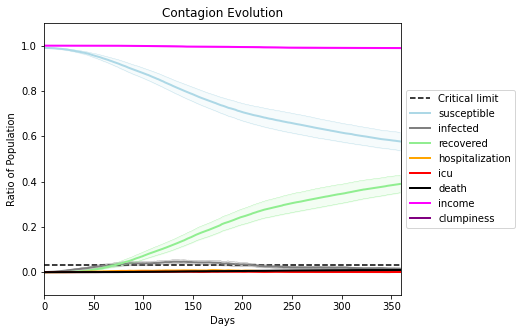

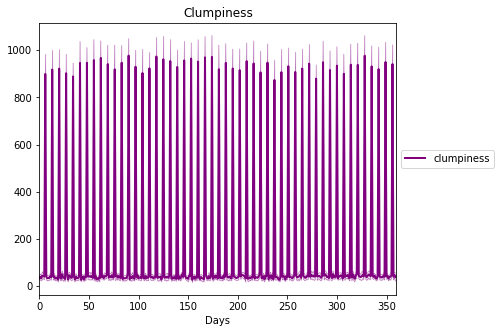

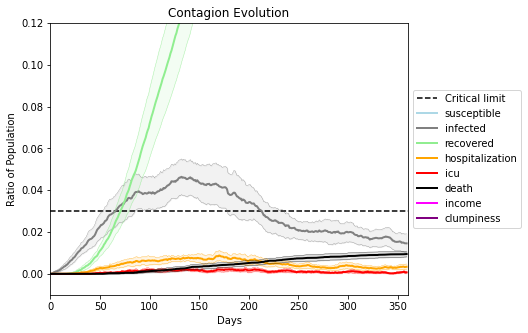

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[4536, 4512, 9410, 2009, 7104, 6378, 45, 4284, 9009, 9487, 9594, 2574, 5993, 2441, 7604, 5648, 9469, 2940, 1743, 9070]
Average similarity between family members is 0.19265534415124913 at temperature -0.3
Average similarity between family and home is 0.9998609895421535 at temperature -1
Average similarity between students and their classroom is 0.1445605579404665 at temperature -0.3
Average classroom occupancy is 1.6848484848484848 and number classrooms is 165
Average similarity between workers is 0.152975820200404 at temperature -0.3
Average office occupancy is 3.230392156862745 and number offices is 204
Average friend similarity for adults: 0.2383314438991688 for kids: 0.21270961647185052
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Hom

avg restaurant similarity 0.09014126812647363
avg restaurant similarity 0.1052945808554649
avg restaurant similarity 0.10085283432793947
avg restaurant similarity 0.10373414134780014
avg restaurant similarity 0.0711732036839303
avg restaurant similarity 0.06367589889937164
avg restaurant similarity 0.05217322544430909
avg restaurant similarity 0.09433416965515944
avg restaurant similarity 0.05045678232998071
avg restaurant similarity 0.10376898227773018
avg restaurant similarity 0.0903710006294017
avg restaurant similarity 0.0803325397481519
avg restaurant similarity 0.0931605983521037
avg restaurant similarity 0.05573277117869701
avg restaurant similarity 0.11512997562380804
avg restaurant similarity 0.0970324171305155
avg restaurant similarity 0.08598686505135705
avg restaurant similarity 0.1112143794615499
avg restaurant similarity 0.07944512604114916
avg restaurant similarity 0.05999767209029661
avg restaurant similarity 0.07588716860543668
avg restaurant similarity 0.0794822583640

avg restaurant similarity 0.06703100221566226
avg restaurant similarity 0.1054061995356649
avg restaurant similarity 0.09998262012047703
avg restaurant similarity 0.10311985678092161
avg restaurant similarity 0.09760105107107091
avg restaurant similarity 0.052730943458180496
avg restaurant similarity 0.07449895026717947
avg restaurant similarity 0.11985430108027231
avg restaurant similarity 0.05319215775298094
avg restaurant similarity 0.05375860746309368
avg restaurant similarity 0.09876814672685855
avg restaurant similarity 0.05299856056640898
avg restaurant similarity 0.10556390716441785
avg restaurant similarity 0.11040156116222961
avg restaurant similarity 0.09907963506630925
avg restaurant similarity 0.0741973667471326
avg restaurant similarity 0.11646911161696659
avg restaurant similarity 0.09724170152593888
avg restaurant similarity 0.10318458410960757
avg restaurant similarity 0.10151147423024888
avg restaurant similarity 0.10651573106761567
avg restaurant similarity 0.0511648

avg restaurant similarity 0.08285878192175486
avg restaurant similarity 0.07928873108951051
Average similarity between family members is 0.1956965143895971 at temperature -0.3
Average similarity between family and home is 0.9998540860662581 at temperature -1
Average similarity between students and their classroom is 0.13675632258645629 at temperature -0.3
Average classroom occupancy is 1.6627218934911243 and number classrooms is 169
Average similarity between workers is 0.13059225469078586 at temperature -0.3
Average office occupancy is 3.336683417085427 and number offices is 199
Average friend similarity for adults: 0.2381006386326234 for kids: 0.2156001086332193
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.06501442266375594
avg restaurant similarity 0.051632348184811994
avg restaurant similarity 0.05924326358563127
avg restaurant similarity 0.07733927367852077
avg restaurant similarity 0.055417568084454555
avg restaurant similarity 0.06800544799966005
avg restaurant similarity 0.04833049523223608
avg restaurant similarity 0.05310160243966235
avg restaurant similarity 0.0887114188218728
avg restaurant similarity 0.04294580311653183
avg restaurant similarity 0.09250535962296765
avg restaurant similarity 0.11800270844861119
avg restaurant similarity 0.058705816963711
avg restaurant similarity 0.07532389732684434
avg restaurant similarity 0.06785414380987331
avg restaurant similarity 0.06974191605328114
avg restaurant similarity 0.011868317959138288
avg restaurant similarity 0.0880634673265586
avg restaurant similarity 0.08316191243103384
avg restaurant similarity 0.0530761185277805
avg restaurant similarity 0.021334001261816397
avg restaurant similarity 0.0964576

avg restaurant similarity 0.05220746808243724
avg restaurant similarity 0.034607125977531523
avg restaurant similarity 0.06225154657727477
avg restaurant similarity 0.12407254271209363
avg restaurant similarity 0.036427151588273164
avg restaurant similarity 0.0204404235966999
avg restaurant similarity 0.04016044402335853
avg restaurant similarity 0.1113086632413386
avg restaurant similarity 0.08467089296468026
avg restaurant similarity 0.0704259313228024
avg restaurant similarity 0.08338784345343246
avg restaurant similarity 0.0371992315243988
avg restaurant similarity 0.06366537437474336
avg restaurant similarity 0.09376294147978079
avg restaurant similarity 0.07304801537490538
avg restaurant similarity 0.08722496626907561
avg restaurant similarity 0.07623035629238123
avg restaurant similarity 0.08247303994819927
avg restaurant similarity 0.07310643490791263
avg restaurant similarity 0.041549412401850276
avg restaurant similarity 0.09677245164719418
avg restaurant similarity 0.0569710

avg restaurant similarity 0.06967996790246739
avg restaurant similarity 0.08473320548141985
avg restaurant similarity 0.03736060271579057
avg restaurant similarity 0.04412571198337145
Average similarity between family members is 0.1979526890444344 at temperature -0.3
Average similarity between family and home is 0.9998558411825169 at temperature -1
Average similarity between students and their classroom is 0.17865032037781514 at temperature -0.3
Average classroom occupancy is 1.6193181818181819 and number classrooms is 176
Average similarity between workers is 0.1471007494836367 at temperature -0.3
Average office occupancy is 3.3054187192118225 and number offices is 203
Average friend similarity for adults: 0.2516404244967415 for kids: 0.21611544681332273
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.018219920787979356
avg restaurant similarity 0.07987813218059434
avg restaurant similarity 0.012767714543505088
avg restaurant similarity 0.03365980345101756
avg restaurant similarity 0.05649571283501996
avg restaurant similarity 0.009785571674598398
avg restaurant similarity 0.07632800410131356
avg restaurant similarity 0.0715105340824364
avg restaurant similarity 0.05308931212065142
avg restaurant similarity 0.05717492404882402
avg restaurant similarity -0.00953860148711772
avg restaurant similarity 0.04781557193310842
avg restaurant similarity 0.09537233076261978
avg restaurant similarity 0.003947159000934557
avg restaurant similarity -0.009306195963240406
avg restaurant similarity 0.04208530091821035
avg restaurant similarity 0.0468724992550358
avg restaurant similarity 0.11377319117488767
avg restaurant similarity 0.0443916287123361
avg restaurant similarity 0.048522639654737944
avg restaurant similarity 0.012713476583610259
avg restaurant similarity 0.

avg restaurant similarity 0.06079447799207384
avg restaurant similarity 0.10943491817305895
avg restaurant similarity 0.08046924106824706
avg restaurant similarity 0.06662811778038956
avg restaurant similarity 0.02975357284294183
avg restaurant similarity 0.06932088873647853
avg restaurant similarity 0.023265939069645285
avg restaurant similarity 0.05132846178673254
avg restaurant similarity 0.034389733527589166
avg restaurant similarity 0.06201740706621024
avg restaurant similarity 0.005713058701750266
avg restaurant similarity 0.05804691078292343
avg restaurant similarity 0.09661430259776434
avg restaurant similarity 0.013886762377346528
avg restaurant similarity 0.03663418148759483
avg restaurant similarity 0.04164779846408231
avg restaurant similarity 0.03896210381069633
avg restaurant similarity 0.011231203180881371
avg restaurant similarity 0.07516145831738805
avg restaurant similarity 0.011006169989651376
avg restaurant similarity 0.037940657413289926
avg restaurant similarity 0

avg restaurant similarity 0.0668072555918958
avg restaurant similarity 0.0486424893995994
avg restaurant similarity 0.021639600264564064
avg restaurant similarity 0.05679038028194372
avg restaurant similarity 0.036677834358061004
Average similarity between family members is 0.17724945744707013 at temperature -0.3
Average similarity between family and home is 0.9998644892958954 at temperature -1
Average similarity between students and their classroom is 0.15879901083255238 at temperature -0.3
Average classroom occupancy is 1.696629213483146 and number classrooms is 178
Average similarity between workers is 0.15557090973953935 at temperature -0.3
Average office occupancy is 3.1724137931034484 and number offices is 203
Average friend similarity for adults: 0.2440394133273338 for kids: 0.2170807485123598
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people alloc

avg restaurant similarity 0.05587107278298776
avg restaurant similarity 0.02751918649116451
avg restaurant similarity 0.12551840756647759
avg restaurant similarity 0.049314127618958245
avg restaurant similarity 0.03989871180920494
avg restaurant similarity 0.025235428637187148
avg restaurant similarity 0.044995160308790104
avg restaurant similarity 0.01663965028159594
avg restaurant similarity 0.02961077129376193
avg restaurant similarity 0.030372711486654592
avg restaurant similarity 0.057988745854565836
avg restaurant similarity 0.08273233081652141
avg restaurant similarity 0.07725134180980434
avg restaurant similarity 0.04720009906831877
avg restaurant similarity 0.02164872285508589
avg restaurant similarity 0.07723467347516137
avg restaurant similarity 0.06600544222115351
avg restaurant similarity 0.09792748791790443
avg restaurant similarity 0.06074807099639577
avg restaurant similarity 0.05322835499158394
avg restaurant similarity 0.06277734931931607
avg restaurant similarity 0.0

avg restaurant similarity 0.03818872117891648
avg restaurant similarity 0.06210950274816832
avg restaurant similarity 0.02074613944477928
avg restaurant similarity 0.03303820059648808
avg restaurant similarity 0.06363327010608223
avg restaurant similarity 0.08146289400069988
avg restaurant similarity 0.11591744190099078
avg restaurant similarity 0.07555880955219976
avg restaurant similarity 0.03273276778333522
avg restaurant similarity 0.03600268432021892
avg restaurant similarity 0.09409059660470628
avg restaurant similarity 0.08211075110268203
avg restaurant similarity 0.050655200619087355
avg restaurant similarity 0.04627868658345043
avg restaurant similarity 0.04934736579053817
avg restaurant similarity 0.07335678880198751
avg restaurant similarity 0.06008419059445992
avg restaurant similarity 0.06617344242444316
avg restaurant similarity 0.04833934009154231
avg restaurant similarity 0.04805119928368157
avg restaurant similarity 0.0938861249601357
avg restaurant similarity 0.072039

avg restaurant similarity 0.07976114712577737
avg restaurant similarity 0.09357263564619156
avg restaurant similarity 0.05676690340279461
avg restaurant similarity 0.013084689973959425
Average similarity between family members is 0.17928876417112105 at temperature -0.3
Average similarity between family and home is 0.9998550499452646 at temperature -1
Average similarity between students and their classroom is 0.16489234166035913 at temperature -0.3
Average classroom occupancy is 1.6703296703296704 and number classrooms is 182
Average similarity between workers is 0.1450500071929162 at temperature -0.3
Average office occupancy is 3.1930693069306932 and number offices is 202
Average friend similarity for adults: 0.238464791920736 for kids: 0.21529177215901682
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.09306967354877604
avg restaurant similarity 0.05782948589911707
avg restaurant similarity 0.0907438475254754
avg restaurant similarity 0.04458360592164018
avg restaurant similarity 0.08382099453667728
avg restaurant similarity 0.07932108166494549
avg restaurant similarity 0.06956358493057753
avg restaurant similarity 0.10126893663264613
avg restaurant similarity 0.0981556246675584
avg restaurant similarity 0.05695448695152972
avg restaurant similarity 0.10702273202581722
avg restaurant similarity 0.10086945439130927
avg restaurant similarity 0.08589288033593585
avg restaurant similarity 0.09178663935817168
avg restaurant similarity 0.06647564439618683
avg restaurant similarity 0.06737078283929555
avg restaurant similarity 0.07596719787904882
avg restaurant similarity 0.08359452505171404
avg restaurant similarity 0.006125149323945747
avg restaurant similarity 0.03723172237534498
avg restaurant similarity 0.14576571937533
avg restaurant similarity 0.0430177099

avg restaurant similarity 0.09506885602131311
avg restaurant similarity 0.09348690946880697
avg restaurant similarity 0.08602326322188178
avg restaurant similarity 0.09424992599308427
avg restaurant similarity 0.07277811526020556
avg restaurant similarity 0.11327847280569771
avg restaurant similarity 0.04148307284450895
avg restaurant similarity 0.02555244823762332
avg restaurant similarity 0.0520796952755984
avg restaurant similarity 0.12268827986737631
avg restaurant similarity 0.09299514434295743
avg restaurant similarity 0.08183728244484909
avg restaurant similarity 0.05803712923906099
avg restaurant similarity 0.1092682998592172
avg restaurant similarity 0.04875610880763771
avg restaurant similarity 0.107967466311729
avg restaurant similarity 0.05623508011389982
avg restaurant similarity 0.06869431832897134
avg restaurant similarity 0.03218321795858154
avg restaurant similarity 0.07884081774604702
avg restaurant similarity 0.06972220852035795
avg restaurant similarity 0.0570713450

avg restaurant similarity 0.06387668886599449
avg restaurant similarity 0.08646848896877768
avg restaurant similarity 0.05811181189671063
avg restaurant similarity 0.05243875315662501
Average similarity between family members is 0.1846093416084839 at temperature -0.3
Average similarity between family and home is 0.9998598267682982 at temperature -1
Average similarity between students and their classroom is 0.1738572007753469 at temperature -0.3
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.15660470583555505 at temperature -0.3
Average office occupancy is 3.3233830845771144 and number offices is 201
Average friend similarity for adults: 0.2516719463048879 for kids: 0.22534227588308176
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.03592966384710445
avg restaurant similarity 0.04359978343880218
avg restaurant similarity 0.036400779424305835
avg restaurant similarity 0.08354598587679418
avg restaurant similarity 0.0914729135741735
avg restaurant similarity 0.07564980357571
avg restaurant similarity 0.032574266061781716
avg restaurant similarity 0.062066907739283736
avg restaurant similarity 0.05124433322191194
avg restaurant similarity 0.05693780803448528
avg restaurant similarity 0.05392348617825838
avg restaurant similarity 0.05289968569260263
avg restaurant similarity 0.05432038821155402
avg restaurant similarity 0.06351894715321606
avg restaurant similarity 0.07810167938948795
avg restaurant similarity 0.04661018493866052
avg restaurant similarity 0.0938960240617894
avg restaurant similarity 0.08002748856123207
avg restaurant similarity 0.07194858248227086
avg restaurant similarity 0.06773401104491326
avg restaurant similarity 0.0269592017921419
avg restaurant similarity 0.061170976

avg restaurant similarity 0.06482544316423361
avg restaurant similarity 0.040161478735270095
avg restaurant similarity 0.03981838538064678
avg restaurant similarity 0.04790930559493639
avg restaurant similarity 0.062496676406493964
avg restaurant similarity 0.06741962917392828
avg restaurant similarity 0.06848972682457449
avg restaurant similarity 0.03697664289060065
avg restaurant similarity 0.06823591038846848
avg restaurant similarity 0.059319714428901923
avg restaurant similarity 0.03339316872219529
avg restaurant similarity 0.1129002321320671
avg restaurant similarity 0.03416580373528253
avg restaurant similarity 0.026012027823159554
avg restaurant similarity 0.07283147052426339
avg restaurant similarity 0.046469538624479036
avg restaurant similarity 0.038877186847187155
avg restaurant similarity 0.06925005022398545
avg restaurant similarity 0.08773268171866345
avg restaurant similarity 0.03468309775016257
avg restaurant similarity 0.012286076326326677
avg restaurant similarity 0.

avg restaurant similarity 0.052237681089436536
avg restaurant similarity 0.05312383860138881
avg restaurant similarity 0.07861786064596936
avg restaurant similarity 0.011721937502494143
Average similarity between family members is 0.18067542029607356 at temperature -0.3
Average similarity between family and home is 0.9998512019793309 at temperature -1
Average similarity between students and their classroom is 0.17890305439889276 at temperature -0.3
Average classroom occupancy is 1.6647727272727273 and number classrooms is 176
Average similarity between workers is 0.14090114066045425 at temperature -0.3
Average office occupancy is 3.2598039215686274 and number offices is 204
Average friend similarity for adults: 0.24625800814272436 for kids: 0.2220687603165323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distr

avg restaurant similarity 0.11632252604740972
avg restaurant similarity 0.09247120160869002
avg restaurant similarity 0.05270349213749518
avg restaurant similarity 0.11905647106609862
avg restaurant similarity 0.08148655007207013
avg restaurant similarity 0.1010930693442217
avg restaurant similarity 0.06180085592340986
avg restaurant similarity 0.08571241058659014
avg restaurant similarity 0.04892514955534151
avg restaurant similarity 0.09192899465178173
avg restaurant similarity 0.12531907187088276
avg restaurant similarity 0.08867719052801191
avg restaurant similarity 0.1278895386852243
avg restaurant similarity 0.12048683458757828
avg restaurant similarity 0.07461058203653732
avg restaurant similarity 0.09023986151130273
avg restaurant similarity 0.059615800302560286
avg restaurant similarity 0.06142857896948968
avg restaurant similarity 0.06879734642293077
avg restaurant similarity 0.03972115290558093
avg restaurant similarity 0.050022705146441006
avg restaurant similarity 0.080804

avg restaurant similarity 0.11571574302480479
avg restaurant similarity 0.081572448721642
avg restaurant similarity 0.05809705256990883
avg restaurant similarity 0.07272696687403686
avg restaurant similarity 0.0826387876881094
avg restaurant similarity 0.13138315059890193
avg restaurant similarity 0.07002207724739298
avg restaurant similarity 0.12710692791278322
avg restaurant similarity 0.04664445707955592
avg restaurant similarity 0.16066404232990228
avg restaurant similarity 0.12954976502308643
avg restaurant similarity 0.06829480801187642
avg restaurant similarity 0.12216132932952464
avg restaurant similarity 0.07265041921378057
avg restaurant similarity 0.10289979412698184
avg restaurant similarity 0.07108914372923018
avg restaurant similarity 0.08149646159577037
avg restaurant similarity 0.07553947203033874
avg restaurant similarity 0.06915607137897391
avg restaurant similarity 0.07644027090298153
avg restaurant similarity 0.06782137632493812
avg restaurant similarity 0.059124123

avg restaurant similarity 0.09382455121225389
avg restaurant similarity 0.11057684534673798
Average similarity between family members is 0.2071855391595842 at temperature -0.3
Average similarity between family and home is 0.9998589411155879 at temperature -1
Average similarity between students and their classroom is 0.15551745817406173 at temperature -0.3
Average classroom occupancy is 1.564516129032258 and number classrooms is 186
Average similarity between workers is 0.1624249916680332 at temperature -0.3
Average office occupancy is 3.2388059701492535 and number offices is 201
Average friend similarity for adults: 0.24564249360228732 for kids: 0.22243731961566496
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated 

avg restaurant similarity 0.11501004344202456
avg restaurant similarity 0.05657808899032851
avg restaurant similarity 0.03139779647473351
avg restaurant similarity 0.06211148452955596
avg restaurant similarity 0.06744968492865487
avg restaurant similarity 0.09443881604938041
avg restaurant similarity 0.06821266872112247
avg restaurant similarity 0.10200047008434995
avg restaurant similarity 0.09818881569620642
avg restaurant similarity 0.04931180630199767
avg restaurant similarity 0.07588850925413408
avg restaurant similarity 0.07712909548470022
avg restaurant similarity 0.058840271894785946
avg restaurant similarity 0.11963718232740644
avg restaurant similarity 0.11316627082272923
avg restaurant similarity 0.03366157567391945
avg restaurant similarity 0.002683995957223297
avg restaurant similarity 0.035178385834320376
avg restaurant similarity 0.07287556388164122
avg restaurant similarity -0.021943661840968003
avg restaurant similarity 0.09296546786590114
avg restaurant similarity 0.0

avg restaurant similarity 0.049645264951124125
avg restaurant similarity 0.03532586215133346
avg restaurant similarity 0.07201678180313374
avg restaurant similarity 0.09269399302479842
avg restaurant similarity 0.07736690008844505
avg restaurant similarity 0.08075713050083365
avg restaurant similarity 0.05552615849929772
avg restaurant similarity 0.0730253303226933
avg restaurant similarity 0.046543471489839706
avg restaurant similarity 0.06472422576494016
avg restaurant similarity 0.04681690926537414
avg restaurant similarity 0.12440334271576671
avg restaurant similarity 0.07008153129224994
avg restaurant similarity 0.0937924619016423
avg restaurant similarity 0.01264788008827026
avg restaurant similarity 0.059966307329287316
avg restaurant similarity 0.040138082059821396
avg restaurant similarity 0.08848643931864414
avg restaurant similarity 0.08529418409576787
avg restaurant similarity 0.08084104895030554
avg restaurant similarity 0.06471963021292354
avg restaurant similarity 0.0525

avg restaurant similarity 0.050677727532638245
avg restaurant similarity 0.06409649806790747
avg restaurant similarity -0.008695626731513278
avg restaurant similarity 0.04363001953103792
Average similarity between family members is 0.17949964879065397 at temperature -0.3
Average similarity between family and home is 0.9998569842568924 at temperature -1
Average similarity between students and their classroom is 0.17096644182059526 at temperature -0.3
Average classroom occupancy is 1.6162162162162161 and number classrooms is 185
Average similarity between workers is 0.14673542883776908 at temperature -0.3
Average office occupancy is 3.25 and number offices is 196
Average friend similarity for adults: 0.23697191974267642 for kids: 0.20810498625776896
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.09276203774322027
avg restaurant similarity 0.05297004314236384
avg restaurant similarity 0.05285692558210768
avg restaurant similarity 0.07022115141233227
avg restaurant similarity 0.05154362250757562
avg restaurant similarity 0.0719750685504034
avg restaurant similarity 0.06642044682999756
avg restaurant similarity 0.06229538272931568
avg restaurant similarity 0.049182914036877606
avg restaurant similarity 0.07732559457692656
avg restaurant similarity 0.05143071121677197
avg restaurant similarity 0.08108106314682996
avg restaurant similarity 0.04105414963262787
avg restaurant similarity 0.056534179318278456
avg restaurant similarity 0.009374294676877172
avg restaurant similarity 0.060396893087489946
avg restaurant similarity 0.03956358874565245
avg restaurant similarity 0.05165336429463354
avg restaurant similarity 0.06253968732757385
avg restaurant similarity 0.08341563438148275
avg restaurant similarity 0.028061641622644694
avg restaurant similarity 0.09

avg restaurant similarity 0.058991497028843924
avg restaurant similarity 0.05927532530734841
avg restaurant similarity 0.026545481447781138
avg restaurant similarity 0.07968920648220057
avg restaurant similarity 0.03707020812311594
avg restaurant similarity 0.03151952222811689
avg restaurant similarity 0.09229498723981228
avg restaurant similarity 0.07703281632928782
avg restaurant similarity 0.06235266046923489
avg restaurant similarity 0.018406598053232817
avg restaurant similarity 0.03625553125797341
avg restaurant similarity 0.06764091560448546
avg restaurant similarity 0.040505709152882735
avg restaurant similarity 0.09093649029304093
avg restaurant similarity 0.02163928944073474
avg restaurant similarity 0.02263341738566849
avg restaurant similarity 0.07022083162441883
avg restaurant similarity 0.07269260509721251
avg restaurant similarity 0.045596571676508026
avg restaurant similarity 0.05685399461376605
avg restaurant similarity 0.04207455959917589
avg restaurant similarity 0.0

avg restaurant similarity 0.07504312987870895
avg restaurant similarity 0.08375877356308196
avg restaurant similarity 0.0365453752152516
avg restaurant similarity 0.0438600839004447
Average similarity between family members is 0.21013901073176272 at temperature -0.3
Average similarity between family and home is 0.9998619995809221 at temperature -1
Average similarity between students and their classroom is 0.17148416705853087 at temperature -0.3
Average classroom occupancy is 1.6397849462365592 and number classrooms is 186
Average similarity between workers is 0.15938863816024487 at temperature -0.3
Average office occupancy is 3.127450980392157 and number offices is 204
Average friend similarity for adults: 0.24194679730870597 for kids: 0.207574060033818
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.09513214069174442
avg restaurant similarity 0.06403937153204779
avg restaurant similarity 0.092985905516109
avg restaurant similarity 0.06637853281979186
avg restaurant similarity 0.10558289429895222
avg restaurant similarity 0.05141798947177439
avg restaurant similarity 0.06773305256752635
avg restaurant similarity 0.04926237716247893
avg restaurant similarity 0.06252948500164843
avg restaurant similarity 0.06004496775348551
avg restaurant similarity 0.05009217383752984
avg restaurant similarity 0.05856262937848443
avg restaurant similarity 0.054756588763814486
avg restaurant similarity 0.08003879412839833
avg restaurant similarity 0.10304862594739957
avg restaurant similarity 0.07126454191112368
avg restaurant similarity 0.05255973916687806
avg restaurant similarity 0.046418534799387484
avg restaurant similarity 0.04855689585665395
avg restaurant similarity 0.06196681568075884
avg restaurant similarity 0.0741469479394867
avg restaurant similarity 0.0775637

avg restaurant similarity 0.11403096741172415
avg restaurant similarity 0.021171321417139625
avg restaurant similarity 0.0655077271377014
avg restaurant similarity 0.09848356493318162
avg restaurant similarity 0.07654034065055369
avg restaurant similarity 0.015581142262929733
avg restaurant similarity 0.11096756128487194
avg restaurant similarity 0.08985184421244227
avg restaurant similarity 0.11813258294101014
avg restaurant similarity 0.07283401007271109
avg restaurant similarity 0.07044391836833978
avg restaurant similarity 0.0824997221093097
avg restaurant similarity 0.09195199507258327
avg restaurant similarity 0.042458517024368245
avg restaurant similarity 0.06023785841102979
avg restaurant similarity 0.05118741072656618
avg restaurant similarity 0.05554741206222178
avg restaurant similarity 0.08988781639061554
avg restaurant similarity 0.012532915882204999
avg restaurant similarity 0.07381773354613658
avg restaurant similarity 0.02197049441460098
avg restaurant similarity 0.0596

avg restaurant similarity 0.07190835598668766
avg restaurant similarity 0.0735261403260761
Average similarity between family members is 0.19505023016428086 at temperature -0.3
Average similarity between family and home is 0.999859653864151 at temperature -1
Average similarity between students and their classroom is 0.1788210947190258 at temperature -0.3
Average classroom occupancy is 1.6353591160220995 and number classrooms is 181
Average similarity between workers is 0.14112667019130148 at temperature -0.3
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.23251645252918118 for kids: 0.2088739057112645
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated un

avg restaurant similarity -0.009359244223791334
avg restaurant similarity 0.047518995084059844
avg restaurant similarity 0.01815749125095658
avg restaurant similarity 0.0258933880690744
avg restaurant similarity 0.050766785495918246
avg restaurant similarity 0.04193407373680959
avg restaurant similarity 0.045740344838276936
avg restaurant similarity 0.04847396552589989
avg restaurant similarity 0.0682155415566772
avg restaurant similarity 0.010990869972167104
avg restaurant similarity 0.0682869605253235
avg restaurant similarity 0.04448312222287344
avg restaurant similarity 0.03400475973893134
avg restaurant similarity 0.03307677997663488
avg restaurant similarity 0.004024662410719569
avg restaurant similarity 0.04471289115345978
avg restaurant similarity 0.08619824072869313
avg restaurant similarity 0.0007463044805476583
avg restaurant similarity 0.004116398775339019
avg restaurant similarity 0.013257627195170063
avg restaurant similarity 0.10324535444379827
avg restaurant similarity 

avg restaurant similarity 0.054406946122729505
avg restaurant similarity 0.046026092829123746
avg restaurant similarity 0.03048451749525678
avg restaurant similarity 0.03128424789813661
avg restaurant similarity 0.05030705663052473
avg restaurant similarity 0.024239478808867978
avg restaurant similarity 0.056872057182267545
avg restaurant similarity 0.03381984942852053
avg restaurant similarity 0.09045614022541405
avg restaurant similarity 0.11301336791941723
avg restaurant similarity 0.10125172535959268
avg restaurant similarity 0.047914241057012995
avg restaurant similarity 0.08736397609046388
avg restaurant similarity 0.03133373460461638
avg restaurant similarity 0.07782806024922725
avg restaurant similarity 0.058981833474543874
avg restaurant similarity 0.05198830133980993
avg restaurant similarity 0.030302628364218688
avg restaurant similarity 0.0398148781105374
avg restaurant similarity 0.03941710539821687
avg restaurant similarity 0.0720343581467091
avg restaurant similarity 0.0

avg restaurant similarity 0.0018001806972173001
avg restaurant similarity 0.05505210975473099
avg restaurant similarity 0.1288319349651043
avg restaurant similarity 0.040654817730673073
avg restaurant similarity 0.026705382175745116
avg restaurant similarity 0.06563478404863494
Average similarity between family members is 0.19819358585877822 at temperature -0.3
Average similarity between family and home is 0.9998457695129439 at temperature -1
Average similarity between students and their classroom is 0.174824015203669 at temperature -0.3
Average classroom occupancy is 1.6042780748663101 and number classrooms is 187
Average similarity between workers is 0.15122371018413883 at temperature -0.3
Average office occupancy is 3.1724137931034484 and number offices is 203
Average friend similarity for adults: 0.23704600128901818 for kids: 0.20995849212310885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units w

avg restaurant similarity 0.047117554836660976
avg restaurant similarity 0.04530796646026575
avg restaurant similarity 0.05889400617210305
avg restaurant similarity 0.052312731527607945
avg restaurant similarity 0.06357012155661407
avg restaurant similarity 0.0141522611471966
avg restaurant similarity 0.09730065129789595
avg restaurant similarity 0.06180916353755166
avg restaurant similarity 0.009220118450941346
avg restaurant similarity 0.08262296383288213
avg restaurant similarity -0.005843824335448384
avg restaurant similarity 0.020844260203051253
avg restaurant similarity 0.0637960474066659
avg restaurant similarity 0.12011097078186445
avg restaurant similarity 0.03530507840694348
avg restaurant similarity 0.08827590987607252
avg restaurant similarity 0.010774328142006009
avg restaurant similarity 0.07094066971937396
avg restaurant similarity 0.04900938380236574
avg restaurant similarity 0.0615015364200788
avg restaurant similarity 0.04282962264364395
avg restaurant similarity 0.01

avg restaurant similarity 0.030500663602902767
avg restaurant similarity 0.07185402664117671
avg restaurant similarity 0.07991127908380856
avg restaurant similarity 0.020456079964684543
avg restaurant similarity 0.03204044166268805
avg restaurant similarity -0.004911034503388183
avg restaurant similarity 0.0358674012104797
avg restaurant similarity -0.01764069522462466
avg restaurant similarity 0.02039784918696549
avg restaurant similarity 0.04546255217133759
avg restaurant similarity 0.01354205806289552
avg restaurant similarity 0.05756996725252699
avg restaurant similarity 0.04088116987716072
avg restaurant similarity 0.07209047984486826
avg restaurant similarity -0.011986316502402046
avg restaurant similarity 0.06919905584617812
avg restaurant similarity 0.04825213821541817
avg restaurant similarity 0.05975799163286253
avg restaurant similarity 0.06736506248204951
avg restaurant similarity 0.02652477446654445
avg restaurant similarity 0.07780450122803637
avg restaurant similarity 0.

avg restaurant similarity 0.04183591099655098
avg restaurant similarity 0.029048521512711208
avg restaurant similarity 0.07413169879271467
avg restaurant similarity 0.019965860703581844
avg restaurant similarity 0.08777323654124684
Average similarity between family members is 0.1751837332310673 at temperature -0.3
Average similarity between family and home is 0.9998587082157486 at temperature -1
Average similarity between students and their classroom is 0.20394991576906754 at temperature -0.3
Average classroom occupancy is 1.5846994535519126 and number classrooms is 183
Average similarity between workers is 0.1560253768975769 at temperature -0.3
Average office occupancy is 3.2562814070351758 and number offices is 199
Average friend similarity for adults: 0.23686215244933714 for kids: 0.2178378202125461
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people all

avg restaurant similarity 0.0691366157590802
avg restaurant similarity 0.053530669171336046
avg restaurant similarity 0.06462791130743802
avg restaurant similarity 0.06103445083811838
avg restaurant similarity 0.05093640959401054
avg restaurant similarity 0.09968390397799601
avg restaurant similarity 0.09452870886293215
avg restaurant similarity 0.06544747215521833
avg restaurant similarity 0.06164132335966156
avg restaurant similarity 0.04587333851777376
avg restaurant similarity 0.01304184594793251
avg restaurant similarity 0.10017124083421806
avg restaurant similarity 0.10807148838703826
avg restaurant similarity 0.08424725865202518
avg restaurant similarity 0.03794153105445597
avg restaurant similarity 0.07836990332781403
avg restaurant similarity 0.024682718139619295
avg restaurant similarity 0.08756588287537145
avg restaurant similarity 0.0473802356177658
avg restaurant similarity 0.10185090996921813
avg restaurant similarity 0.022501344893302758
avg restaurant similarity 0.04126

avg restaurant similarity 0.07570900440248358
avg restaurant similarity 0.07067784836754057
avg restaurant similarity 0.054538926313691075
avg restaurant similarity 0.09627195742363409
avg restaurant similarity 0.08193562546819387
avg restaurant similarity 0.0730667120698727
avg restaurant similarity 0.0804778270495055
avg restaurant similarity 0.11712688267640184
avg restaurant similarity 0.018348059906146495
avg restaurant similarity 0.07599572589499985
avg restaurant similarity 0.10896805884187444
avg restaurant similarity 0.06978748117009895
avg restaurant similarity 0.06753465196277111
avg restaurant similarity 0.027856918485703708
avg restaurant similarity 0.07995739212483043
avg restaurant similarity 0.096687766004827
avg restaurant similarity 0.04530640683654112
avg restaurant similarity 0.07481564189815613
avg restaurant similarity 0.06827596663370894
avg restaurant similarity 0.07127667897895829
avg restaurant similarity 0.07520271069829551
avg restaurant similarity 0.0920250

avg restaurant similarity 0.04865693627165629
avg restaurant similarity 0.09446753249776625
avg restaurant similarity 0.05571095154088197
Average similarity between family members is 0.21347293430971767 at temperature -0.3
Average similarity between family and home is 0.9998499223378546 at temperature -1
Average similarity between students and their classroom is 0.17666706361275925 at temperature -0.3
Average classroom occupancy is 1.574585635359116 and number classrooms is 181
Average similarity between workers is 0.15304717122749795 at temperature -0.3
Average office occupancy is 3.253731343283582 and number offices is 201
Average friend similarity for adults: 0.24693201062503783 for kids: 0.2283813369060289
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.10358263397049265
avg restaurant similarity 0.03844444798028721
avg restaurant similarity 0.08009186190502068
avg restaurant similarity 0.08205160223530039
avg restaurant similarity 0.0980291508815088
avg restaurant similarity 0.0677285442883825
avg restaurant similarity 0.05073935285522852
avg restaurant similarity 0.15811109201003753
avg restaurant similarity 0.05851755315614058
avg restaurant similarity 0.022928417346485746
avg restaurant similarity 0.142740928284131
avg restaurant similarity 0.047267317557232666
avg restaurant similarity 0.14728133324787046
avg restaurant similarity 0.0771475607601786
avg restaurant similarity 0.09418484319817692
avg restaurant similarity 0.10135891691932326
avg restaurant similarity 0.05619948435574859
avg restaurant similarity 0.034321029067588736
avg restaurant similarity 0.07792413749837275
avg restaurant similarity 0.03895520808900207
avg restaurant similarity 0.09770421161760696
avg restaurant similarity 0.09916912

avg restaurant similarity 0.08116199128653699
avg restaurant similarity 0.1375444996741138
avg restaurant similarity 0.08551552822673902
avg restaurant similarity 0.10582239727954153
avg restaurant similarity 0.03945204223050761
avg restaurant similarity 0.08336208690975165
avg restaurant similarity 0.048042132136745304
avg restaurant similarity 0.12100061516036181
avg restaurant similarity 0.12389534189084572
avg restaurant similarity 0.03610958684150825
avg restaurant similarity 0.0726346563093392
avg restaurant similarity 0.04959022337540721
avg restaurant similarity 0.029833516642220375
avg restaurant similarity 0.06644257730242376
avg restaurant similarity 0.012835000589533577
avg restaurant similarity 0.09557892968435683
avg restaurant similarity 0.08580716140732356
avg restaurant similarity 0.0631732949769019
avg restaurant similarity 0.11568341697950249
avg restaurant similarity 0.06465875381585691
avg restaurant similarity 0.09652269401860991
avg restaurant similarity 0.089470

avg restaurant similarity 0.16167413296707317
avg restaurant similarity 0.03303329455693317
Average similarity between family members is 0.20880182555916654 at temperature -0.3
Average similarity between family and home is 0.9998540430005386 at temperature -1
Average similarity between students and their classroom is 0.15598454107266674 at temperature -0.3
Average classroom occupancy is 1.5368421052631578 and number classrooms is 190
Average similarity between workers is 0.14244249701946632 at temperature -0.3
Average office occupancy is 3.3434343434343434 and number offices is 198
Average friend similarity for adults: 0.24235539420250335 for kids: 0.20963863655669435
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.04502149768149937
avg restaurant similarity 0.002747114055970934
avg restaurant similarity 0.03726378999260653
avg restaurant similarity 0.013327169234123859
avg restaurant similarity 0.0336897887772594
avg restaurant similarity -0.016919754535110035
avg restaurant similarity 0.016984389762551125
avg restaurant similarity 0.056955010953253685
avg restaurant similarity 0.022961040737649915
avg restaurant similarity 0.048268765866130305
avg restaurant similarity 0.05546475888338219
avg restaurant similarity 0.0377187568999945
avg restaurant similarity 0.051259425278733534
avg restaurant similarity 0.03931152318087406
avg restaurant similarity 0.04731029441614779
avg restaurant similarity 0.031002412097294818
avg restaurant similarity 0.022659131880837558
avg restaurant similarity 0.018674177446061948
avg restaurant similarity 0.06262817285654378
avg restaurant similarity 0.06483359822004284
avg restaurant similarity 0.06421501875754822
avg restaurant similarit

avg restaurant similarity 0.04846699038175838
avg restaurant similarity 0.018914321744975822
avg restaurant similarity 0.06937271157543623
avg restaurant similarity 0.07007289872682
avg restaurant similarity 0.004944514356126005
avg restaurant similarity 0.09046907401295722
avg restaurant similarity 0.008903001807453676
avg restaurant similarity 0.029966272182125143
avg restaurant similarity 0.05545818174242074
avg restaurant similarity 0.01897991191965726
avg restaurant similarity 0.04123878205282496
avg restaurant similarity 0.04864612596255556
avg restaurant similarity 0.05977302909834086
avg restaurant similarity 0.035990806337444656
avg restaurant similarity -0.005711095708537136
avg restaurant similarity 0.06168139903357387
avg restaurant similarity 0.03370387650896314
avg restaurant similarity 0.05151682401488029
avg restaurant similarity 0.005969615388800149
avg restaurant similarity 0.04716804551889105
avg restaurant similarity 0.015633339592547858
avg restaurant similarity -0

avg restaurant similarity 0.015334407491876562
avg restaurant similarity 0.013030301529677508
avg restaurant similarity 0.03183587668175968
avg restaurant similarity 0.053820994589109376
avg restaurant similarity 0.047409898001999476
avg restaurant similarity 0.025003122765991738
Average similarity between family members is 0.2067489329156882 at temperature -0.3
Average similarity between family and home is 0.9998553679315402 at temperature -1
Average similarity between students and their classroom is 0.17147725320798465 at temperature -0.3
Average classroom occupancy is 1.5108695652173914 and number classrooms is 184
Average similarity between workers is 0.1640179445274663 at temperature -0.3
Average office occupancy is 3.35 and number offices is 200
Average friend similarity for adults: 0.25356517021235847 for kids: 0.20643815454340683
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total 

avg restaurant similarity 0.13423263846157207
avg restaurant similarity 0.05237922940599972
avg restaurant similarity 0.06640745009809305
avg restaurant similarity 0.06395555026607533
avg restaurant similarity 0.0692579020093666
avg restaurant similarity 0.10655078706418561
avg restaurant similarity 0.13729508141277513
avg restaurant similarity 0.07157098940193295
avg restaurant similarity 0.05974944788811143
avg restaurant similarity 0.0909846873548942
avg restaurant similarity 0.06634136369077612
avg restaurant similarity 0.10933220698211932
avg restaurant similarity 0.10679501306987842
avg restaurant similarity 0.07977738104800952
avg restaurant similarity 0.06648251682909358
avg restaurant similarity 0.06030706280230531
avg restaurant similarity 0.04999471285587058
avg restaurant similarity 0.0745798571376779
avg restaurant similarity 0.06528309915408942
avg restaurant similarity 0.05210883865613302
avg restaurant similarity 0.07216199085750483
avg restaurant similarity 0.113818884

avg restaurant similarity 0.04922060797374815
avg restaurant similarity 0.06391555775278841
avg restaurant similarity 0.06429465026625615
avg restaurant similarity 0.09208409372897851
avg restaurant similarity 0.08021049167319706
avg restaurant similarity 0.1355885450074484
avg restaurant similarity 0.08298360075869966
avg restaurant similarity 0.10242912376734353
avg restaurant similarity 0.08238066834354908
avg restaurant similarity 0.01692457068270622
avg restaurant similarity 0.09341943295424261
avg restaurant similarity 0.07652700313506064
avg restaurant similarity 0.10421821352238815
avg restaurant similarity 0.05227295894112364
avg restaurant similarity 0.04578340898679355
avg restaurant similarity 0.06196693337834955
avg restaurant similarity 0.06255489287496539
avg restaurant similarity 0.06477459946997595
avg restaurant similarity 0.06146385971505806
avg restaurant similarity 0.11428839825746683
avg restaurant similarity 0.09148346175592635
avg restaurant similarity 0.0955171

avg restaurant similarity 0.09487202122351554
avg restaurant similarity 0.020297302949851725
avg restaurant similarity 0.04551838608812017
avg restaurant similarity 0.07184910327961433
Average similarity between family members is 0.1976570434581426 at temperature -0.3
Average similarity between family and home is 0.9998569666047593 at temperature -1
Average similarity between students and their classroom is 0.1723328295150308 at temperature -0.3
Average classroom occupancy is 1.6043956043956045 and number classrooms is 182
Average similarity between workers is 0.1710337361007215 at temperature -0.3
Average office occupancy is 3.2233009708737863 and number offices is 206
Average friend similarity for adults: 0.2405607326505272 for kids: 0.21733938417310958
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.047801423985580196
avg restaurant similarity 0.08404249582075211
avg restaurant similarity 0.09563731604331863
avg restaurant similarity 0.06376224557301238
avg restaurant similarity 0.047163942383178954
avg restaurant similarity 0.10178798423144651
avg restaurant similarity 0.05760452648781904
avg restaurant similarity 0.031588527722873676
avg restaurant similarity 0.04929310242766597
avg restaurant similarity 0.055709777891037496
avg restaurant similarity 0.036626327423832386
avg restaurant similarity 0.0424220060031092
avg restaurant similarity 0.09933824203330467
avg restaurant similarity 0.07912569284954403
avg restaurant similarity 0.032949302853920226
avg restaurant similarity 0.052493752046276015
avg restaurant similarity 0.08827786653949266
avg restaurant similarity 0.08697546840722772
avg restaurant similarity 0.037065047636812856
avg restaurant similarity 0.040541194219700614
avg restaurant similarity 0.05003449848809301
avg restaurant similarity 

avg restaurant similarity 0.11505692303794743
avg restaurant similarity 0.07439799967428662
avg restaurant similarity 0.07635473498983741
avg restaurant similarity 0.09563749981937766
avg restaurant similarity 0.0600363180874756
avg restaurant similarity 0.07631256332333915
avg restaurant similarity 0.0341623772930623
avg restaurant similarity 0.07459245271325696
avg restaurant similarity 0.08668476539471714
avg restaurant similarity 0.043364034349099946
avg restaurant similarity 0.08416647984008169
avg restaurant similarity 0.026623072285038206
avg restaurant similarity 0.04652990443677432
avg restaurant similarity 0.03918333145320815
avg restaurant similarity 0.03155957748878109
avg restaurant similarity 0.0823868686550848
avg restaurant similarity 0.0691627621362292
avg restaurant similarity 0.03022270397973031
avg restaurant similarity 0.09499696951199989
avg restaurant similarity 0.041670878144635784
avg restaurant similarity 0.04405479603650239
avg restaurant similarity 0.0760938

avg restaurant similarity 0.0791089998213144
avg restaurant similarity 0.059128865834739336
avg restaurant similarity 0.09132861172184767
avg restaurant similarity 0.036325806413325556
Average similarity between family members is 0.18676531448763095 at temperature -0.3
Average similarity between family and home is 0.9998532321080305 at temperature -1
Average similarity between students and their classroom is 0.1501475724784026 at temperature -0.3
Average classroom occupancy is 1.621212121212121 and number classrooms is 198
Average similarity between workers is 0.14484634867319193 at temperature -0.3
Average office occupancy is 3.230769230769231 and number offices is 195
Average friend similarity for adults: 0.2317599514723779 for kids: 0.21472049992501938
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.06044316585772201
avg restaurant similarity 0.0584211715475804
avg restaurant similarity 0.07110379983544013
avg restaurant similarity 0.03526400000902168
avg restaurant similarity 0.08101029971432659
avg restaurant similarity 0.1001922341188582
avg restaurant similarity 0.02729159250168632
avg restaurant similarity 0.07095689957709866
avg restaurant similarity 0.043274504771488975
avg restaurant similarity 0.09709267273125548
avg restaurant similarity 0.07716535200183508
avg restaurant similarity 0.04516329818882693
avg restaurant similarity 0.08482445592139323
avg restaurant similarity 0.09465218625355447
avg restaurant similarity 0.10573274900242922
avg restaurant similarity 0.029399222166989775
avg restaurant similarity 0.06619412288709954
avg restaurant similarity 0.06280814514248576
avg restaurant similarity 0.09649384059107625
avg restaurant similarity 0.09012483676988493
avg restaurant similarity 0.04572874740372724
avg restaurant similarity 0.033370

avg restaurant similarity 0.097596903353381
avg restaurant similarity 0.07243805072858443
avg restaurant similarity 0.004195202657808671
avg restaurant similarity 0.09369738927421202
avg restaurant similarity 0.012926308118745858
avg restaurant similarity 0.06497548887215121
avg restaurant similarity 0.06940364990651449
avg restaurant similarity 0.053376525204069526
avg restaurant similarity 0.015681055393749633
avg restaurant similarity 0.08127184756950855
avg restaurant similarity 0.014110269763490883
avg restaurant similarity 0.06099050615892003
avg restaurant similarity 0.08064645159679784
avg restaurant similarity 0.04277786343890186
avg restaurant similarity 0.0193318239118124
avg restaurant similarity 0.05526797042816721
avg restaurant similarity 0.07235359017715864
avg restaurant similarity 0.04545042401219397
avg restaurant similarity 0.08944394639931218
avg restaurant similarity 0.09391884531268564
avg restaurant similarity 0.02254791825034126
avg restaurant similarity 0.0590

avg restaurant similarity 0.04898894364834149
avg restaurant similarity 0.04678010525658714
avg restaurant similarity 0.06237579504651616
avg restaurant similarity 0.057975038434236126
Average similarity between family members is 0.20083937136779778 at temperature -0.3
Average similarity between family and home is 0.9998465812639574 at temperature -1
Average similarity between students and their classroom is 0.17939004920322027 at temperature -0.3
Average classroom occupancy is 1.5393258426966292 and number classrooms is 178
Average similarity between workers is 0.16245078831470186 at temperature -0.3
Average office occupancy is 3.3582089552238807 and number offices is 201
Average friend similarity for adults: 0.24712725302117483 for kids: 0.20983955427596854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.016820410370267897
avg restaurant similarity 0.0828083366667099
avg restaurant similarity 0.04938990236345926
avg restaurant similarity 0.06376969084092925
avg restaurant similarity 0.08926602592072576
avg restaurant similarity 0.015559879792897415
avg restaurant similarity 0.10107257957592414
avg restaurant similarity 0.05453932531721193
avg restaurant similarity 0.09437656653782761
avg restaurant similarity 0.05436142946492157
avg restaurant similarity 0.05732115909429416
avg restaurant similarity 0.06214961476100456
avg restaurant similarity 0.039212177067191954
avg restaurant similarity 0.06518522100290992
avg restaurant similarity 0.08750460185601878
avg restaurant similarity 0.06409063362753539
avg restaurant similarity 0.06259429321676364
avg restaurant similarity 0.022258018875387506
avg restaurant similarity 0.05833143330043858
avg restaurant similarity 0.06219139914039755
avg restaurant similarity 0.11742121468742225
avg restaurant similarity 0.114

avg restaurant similarity 0.052274777174272806
avg restaurant similarity 0.13725379671174404
avg restaurant similarity 0.029629673071606313
avg restaurant similarity 0.060468885793910014
avg restaurant similarity 0.09779001968175877
avg restaurant similarity 0.10354980231135451
avg restaurant similarity 0.055042169327227886
avg restaurant similarity 0.12117139119368414
avg restaurant similarity 0.08154164170374406
avg restaurant similarity 0.0743318680830776
avg restaurant similarity 0.02600078041035613
avg restaurant similarity 0.06709003427342576
avg restaurant similarity 0.08585924691646893
avg restaurant similarity 0.09989702347572955
avg restaurant similarity 0.030799228699479108
avg restaurant similarity 0.08630668368311387
avg restaurant similarity 0.07139546930081049
avg restaurant similarity 0.04204912419084629
avg restaurant similarity 0.06083669295165971
avg restaurant similarity 0.09983482519772016
avg restaurant similarity 0.07117461063173082
avg restaurant similarity 0.07

avg restaurant similarity 0.10071873473985954
avg restaurant similarity 0.04865629420436332
avg restaurant similarity 0.1031898171385463
Average similarity between family members is 0.17632153724003694 at temperature -0.3
Average similarity between family and home is 0.9998552801313086 at temperature -1
Average similarity between students and their classroom is 0.13289668221369727 at temperature -0.3
Average classroom occupancy is 1.583815028901734 and number classrooms is 173
Average similarity between workers is 0.15396596859885284 at temperature -0.3
Average office occupancy is 3.4029850746268657 and number offices is 201
Average friend similarity for adults: 0.24270245993649076 for kids: 0.2029647333667249
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.029152867357898862
avg restaurant similarity -0.006301101776229214
avg restaurant similarity 0.03852074375084884
avg restaurant similarity 0.041989760930382175
avg restaurant similarity 0.05172726230182977
avg restaurant similarity 0.050761076765850933
avg restaurant similarity 0.053596170487762794
avg restaurant similarity 0.08017478404617424
avg restaurant similarity 0.07385330034837896
avg restaurant similarity 0.09524389421685434
avg restaurant similarity 0.049245914313793965
avg restaurant similarity 0.03314718648469332
avg restaurant similarity 0.05180680814117839
avg restaurant similarity 0.07147287728069021
avg restaurant similarity 0.046692032150226846
avg restaurant similarity 0.04466019704979772
avg restaurant similarity 0.02685363911548946
avg restaurant similarity -0.039281965425343145
avg restaurant similarity 0.0247725325020831
avg restaurant similarity 0.035451309650688295
avg restaurant similarity -0.010076601938575819
avg restaurant similar

avg restaurant similarity 0.001201817203081828
avg restaurant similarity 0.0634376782846294
avg restaurant similarity 0.10077526594770465
avg restaurant similarity 0.05855153508816056
avg restaurant similarity 0.06775849044341066
avg restaurant similarity 0.004174831848438562
avg restaurant similarity -0.012440782808957608
avg restaurant similarity 0.02325860026120528
avg restaurant similarity 0.061682309072339465
avg restaurant similarity 0.04262075401607823
avg restaurant similarity 0.06639807273088502
avg restaurant similarity 0.04426064619587708
avg restaurant similarity 0.07953208916012677
avg restaurant similarity 0.07177594314462461
avg restaurant similarity 0.06534062192278248
avg restaurant similarity 0.06209322215042007
avg restaurant similarity 0.03063722703560338
avg restaurant similarity -0.012976679865297625
avg restaurant similarity 0.07124202289461198
avg restaurant similarity 0.05890636724795533
avg restaurant similarity 0.014816785372608245
avg restaurant similarity 0

avg restaurant similarity 0.01880388131558381
avg restaurant similarity 0.06167560505478781
avg restaurant similarity 0.06428845812622584
avg restaurant similarity 0.056317327353471294
avg restaurant similarity 0.03561258103020305
avg restaurant similarity 0.0457113952630894
using average of time series:
stats on susceptible:
data: [0.6700638888888889, 0.8025722222222224, 0.8196803196803197, 0.6055277777777778, 0.7843608064694804, 0.8068222222222222, 0.6905888888888889, 0.7868498229305001, 0.7554362304362304, 0.8554277777777778, 0.8422416666666667, 0.7376083333333333, 0.8159583333333333, 0.7855083333333334, 0.7013611111111111, 0.8949750000000001, 0.7081666666666667, 0.8478271728271728, 0.7594944444444445, 0.6312944444444445]
min:
0.6055277777777778
max:
0.8949750000000001
std:
0.07547446921519176
mean:
0.7650882731727408
median:
0.7849345699014069
95% confidence interval for the mean:
(0.7288474973237885,0.801329049021693)
using average of time series:
stats on infected:
data: [0.03102

(<function dict.items>, <function dict.items>, <function dict.items>)

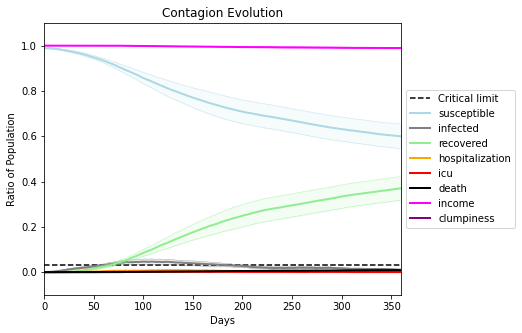

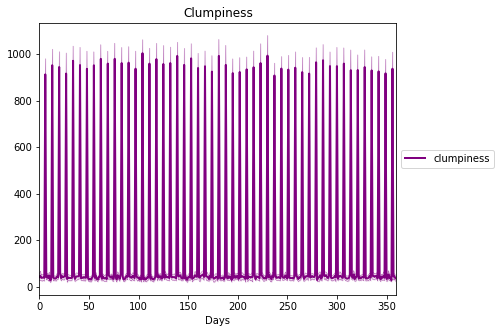

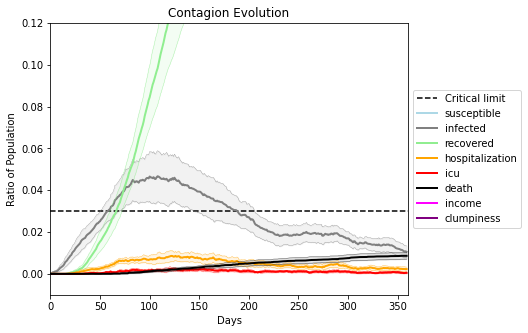

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2566, 7824, 8223, 9084, 2943, 4993, 1947, 9524, 2682, 1543, 3877, 858, 9555, 6922, 2995, 7777, 4056, 1701, 4697, 7669]
Average similarity between family members is 0.18775335120080694 at temperature -0.2
Average similarity between family and home is 0.99984860017229 at temperature -1
Average similarity between students and their classroom is 0.20017156475160097 at temperature -0.2
Average classroom occupancy is 1.5833333333333333 and number classrooms is 180
Average similarity between workers is 0.13762879455182878 at temperature -0.2
Average office occupancy is 3.4248704663212437 and number offices is 193
Average friend similarity for adults: 0.2118205236401975 for kids: 0.2236312337181572
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.03279200368850326
avg restaurant similarity 0.04851145215457427
avg restaurant similarity 0.03568244153097123
avg restaurant similarity 0.07888756323383433
avg restaurant similarity 0.05933665784172544
avg restaurant similarity 0.05804102177440909
avg restaurant similarity 0.04100814608711051
avg restaurant similarity 0.04990124752321452
avg restaurant similarity 0.09640470854526002
avg restaurant similarity 0.021798975866787473
avg restaurant similarity 0.06278051831819065
avg restaurant similarity 0.036479216481416415
avg restaurant similarity 0.03676256770790292
avg restaurant similarity 0.03988998674712104
avg restaurant similarity 0.053236150717257215
avg restaurant similarity 0.051515194403021394
avg restaurant similarity 0.055469390023590415
avg restaurant similarity 0.10254850768955304
avg restaurant similarity 0.06775070976335035
avg restaurant similarity 0.06991453071009708
avg restaurant similarity 0.06695076552545327
avg restaurant similarity 0.0

avg restaurant similarity 0.0894253568513419
avg restaurant similarity 0.045426301349333426
avg restaurant similarity 0.061483119757596155
avg restaurant similarity 0.059102492214096025
avg restaurant similarity 0.01364103121542033
avg restaurant similarity 0.05001620936114274
avg restaurant similarity 0.06310433418438154
avg restaurant similarity 0.05479884339270566
avg restaurant similarity 0.04679850607347459
avg restaurant similarity 0.10574527658690412
avg restaurant similarity 0.0874893202938012
avg restaurant similarity 0.038302156190379355
avg restaurant similarity 0.0708896687624094
avg restaurant similarity 0.04078235343855481
avg restaurant similarity 0.04941377129539611
avg restaurant similarity 0.08564223913776657
avg restaurant similarity 0.0459080293842803
avg restaurant similarity 0.05579839972421206
avg restaurant similarity 0.08220391270077189
avg restaurant similarity 0.06995690995081347
avg restaurant similarity 0.08164574318401499
avg restaurant similarity 0.100304

avg restaurant similarity 0.06977239359085954
avg restaurant similarity -0.0056193874989096376
avg restaurant similarity 0.055888412368083056
avg restaurant similarity 0.0415832391189994
Average similarity between family members is 0.18553773854670697 at temperature -0.2
Average similarity between family and home is 0.999866540937214 at temperature -1
Average similarity between students and their classroom is 0.15252273604925076 at temperature -0.2
Average classroom occupancy is 1.5174129353233832 and number classrooms is 201
Average similarity between workers is 0.15042273516756757 at temperature -0.2
Average office occupancy is 3.251256281407035 and number offices is 199
Average friend similarity for adults: 0.22096200039784275 for kids: 0.21294104614864243
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.0660043515072344
avg restaurant similarity 0.10425933732701445
avg restaurant similarity 0.04517257673454157
avg restaurant similarity 0.1056837587033504
avg restaurant similarity 0.05986752005280768
avg restaurant similarity 0.0358019023772073
avg restaurant similarity 0.05777446537933803
avg restaurant similarity 0.07869247823057506
avg restaurant similarity 0.04240873001972541
avg restaurant similarity 0.036991458138661046
avg restaurant similarity 0.023366896389910727
avg restaurant similarity 0.08038192221054058
avg restaurant similarity 0.08053034879518434
avg restaurant similarity 0.12525470369657754
avg restaurant similarity 0.08966273840222203
avg restaurant similarity 0.0786155083320845
avg restaurant similarity 0.09479366679851028
avg restaurant similarity 0.06583802346289208
avg restaurant similarity 0.055717384753515835
avg restaurant similarity 0.09498727893141595
avg restaurant similarity 0.07592831908401568
avg restaurant similarity 0.0127756

avg restaurant similarity 0.04695791774979501
avg restaurant similarity 0.10305560138223512
avg restaurant similarity 0.08380367000574895
avg restaurant similarity 0.10497030234577875
avg restaurant similarity 0.1047848595429486
avg restaurant similarity 0.08324987660198703
avg restaurant similarity 0.061687365744710114
avg restaurant similarity 0.09904974803409232
avg restaurant similarity 0.08704545682238293
avg restaurant similarity 0.12436443282426847
avg restaurant similarity 0.08943469014714066
avg restaurant similarity 0.06981748680438557
avg restaurant similarity 0.04722084593324846
avg restaurant similarity 0.08043976751995645
avg restaurant similarity 0.09359839135867634
avg restaurant similarity 0.016263397209936022
avg restaurant similarity 0.03526361552044102
avg restaurant similarity 0.04574490023400724
avg restaurant similarity 0.043791506637373384
avg restaurant similarity 0.08543195163130775
avg restaurant similarity 0.12155439434448129
avg restaurant similarity 0.0260

avg restaurant similarity 0.061931680076781
avg restaurant similarity 0.07112098858283843
avg restaurant similarity 0.07184410753705749
Average similarity between family members is 0.16036188669294252 at temperature -0.2
Average similarity between family and home is 0.999862411655206 at temperature -1
Average similarity between students and their classroom is 0.1609729791208629 at temperature -0.2
Average classroom occupancy is 1.521978021978022 and number classrooms is 182
Average similarity between workers is 0.16761375946066107 at temperature -0.2
Average office occupancy is 3.35 and number offices is 200
Average friend similarity for adults: 0.210744200439431 for kids: 0.21830171702707865
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capaci

avg restaurant similarity 0.07369565382583255
avg restaurant similarity 0.030068403696891777
avg restaurant similarity 0.013520281977509582
avg restaurant similarity 0.04492353569528497
avg restaurant similarity 0.06155321617466457
avg restaurant similarity 0.020160623563266703
avg restaurant similarity 0.060129501618577906
avg restaurant similarity 0.031830084314601534
avg restaurant similarity 0.043859413927785376
avg restaurant similarity 0.0488363883385666
avg restaurant similarity 0.03420425467974767
avg restaurant similarity 0.006045930551292538
avg restaurant similarity -0.0058975249796572125
avg restaurant similarity 0.10029139933237169
avg restaurant similarity 0.037829746087700386
avg restaurant similarity 0.0834429361048721
avg restaurant similarity 0.043133359728005645
avg restaurant similarity 0.06066285526346451
avg restaurant similarity 0.11376059711341896
avg restaurant similarity 0.019283510268943992
avg restaurant similarity 0.0470381258125842
avg restaurant similarit

avg restaurant similarity 0.07958012057318561
avg restaurant similarity 0.036387194771084125
avg restaurant similarity 0.05235215656311699
avg restaurant similarity 0.06897574659873264
avg restaurant similarity 0.05519575980555323
avg restaurant similarity 0.035359620441165425
avg restaurant similarity 0.0900345611169133
avg restaurant similarity 0.03208484978742303
avg restaurant similarity 0.051053228278208004
avg restaurant similarity 0.017463234192676147
avg restaurant similarity 0.035462841319440275
avg restaurant similarity 0.06578684187077512
avg restaurant similarity 0.033880202217750406
avg restaurant similarity 0.02050287867305321
avg restaurant similarity 0.02286307175091652
avg restaurant similarity 0.018363091420599807
avg restaurant similarity 0.020377526584694612
avg restaurant similarity 0.03600601098434247
avg restaurant similarity -0.018795087383914003
avg restaurant similarity 0.08288339550299792
avg restaurant similarity 0.032704989707981504
avg restaurant similarit

avg restaurant similarity 0.07660055116822713
avg restaurant similarity 0.06370908971852747
avg restaurant similarity 0.07314265770394222
avg restaurant similarity 0.049894632688347235
avg restaurant similarity 0.059045918112743276
avg restaurant similarity 0.05952032596659484
Average similarity between family members is 0.1625928564605178 at temperature -0.2
Average similarity between family and home is 0.9998604622697418 at temperature -1
Average similarity between students and their classroom is 0.14567575804907473 at temperature -0.2
Average classroom occupancy is 1.6187845303867403 and number classrooms is 181
Average similarity between workers is 0.14379269087275187 at temperature -0.2
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.20656178978550405 for kids: 0.20285871414974097
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units w

avg restaurant similarity 0.05717996961490201
avg restaurant similarity 0.07625958007126038
avg restaurant similarity 0.08221390992726994
avg restaurant similarity 0.06697262621090928
avg restaurant similarity 0.06318745906205546
avg restaurant similarity 0.0499843404134223
avg restaurant similarity 0.10803736777894896
avg restaurant similarity 0.06042580323800667
avg restaurant similarity 0.05272055662904482
avg restaurant similarity 0.06355425653384959
avg restaurant similarity 0.05081399330212759
avg restaurant similarity 0.056414115936986205
avg restaurant similarity 0.06613131411687498
avg restaurant similarity 0.04323336515813169
avg restaurant similarity 0.05672614627854444
avg restaurant similarity 0.04942564932794024
avg restaurant similarity 0.0660409897124385
avg restaurant similarity 0.04025644549749768
avg restaurant similarity 0.013719791302185353
avg restaurant similarity 0.0784675401601317
avg restaurant similarity 0.0383679801226459
avg restaurant similarity 0.08063537

avg restaurant similarity 0.03473568816536022
avg restaurant similarity 0.0700577241670585
avg restaurant similarity 0.05522314275545395
avg restaurant similarity 0.04413331481367458
avg restaurant similarity 0.06561242327963113
avg restaurant similarity 0.08779404880531726
avg restaurant similarity 0.08706187128204725
avg restaurant similarity 0.04216753773546232
avg restaurant similarity 0.05888989113720399
avg restaurant similarity 0.046818690561186795
avg restaurant similarity 0.07200899812258736
avg restaurant similarity 0.08064154584436047
avg restaurant similarity 0.0612510629749075
avg restaurant similarity 0.10874618953152236
avg restaurant similarity 0.04762929717444809
avg restaurant similarity 0.08614311913609866
avg restaurant similarity 0.06240480191565484
avg restaurant similarity 0.07970201449803557
avg restaurant similarity 0.09084197094611915
avg restaurant similarity 0.07314541888810686
avg restaurant similarity 0.08964580508362631
avg restaurant similarity 0.0764557

avg restaurant similarity 0.06208663102062125
avg restaurant similarity 0.07955350166596285
avg restaurant similarity 0.08843555601870008
avg restaurant similarity 0.08393583379258265
Average similarity between family members is 0.16953384512273229 at temperature -0.2
Average similarity between family and home is 0.9998569496415022 at temperature -1
Average similarity between students and their classroom is 0.16963735467271998 at temperature -0.2
Average classroom occupancy is 1.5675675675675675 and number classrooms is 185
Average similarity between workers is 0.14581760458311577 at temperature -0.2
Average office occupancy is 3.3197969543147208 and number offices is 197
Average friend similarity for adults: 0.2081950928379619 for kids: 0.20704057024109512
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.061252268291604066
avg restaurant similarity 0.07114834207705119
avg restaurant similarity 0.05585708809581317
avg restaurant similarity 0.047268286674803824
avg restaurant similarity 0.04641138955402511
avg restaurant similarity 0.04964009966084195
avg restaurant similarity 0.0728795706234218
avg restaurant similarity 0.03410817039548701
avg restaurant similarity 0.08091531523654917
avg restaurant similarity 0.053400529803368256
avg restaurant similarity 0.072892903102562
avg restaurant similarity 0.055999774587608284
avg restaurant similarity 0.03010321502439917
avg restaurant similarity 0.05377946468175845
avg restaurant similarity 0.047342297472218166
avg restaurant similarity 0.029307468531828567
avg restaurant similarity 0.03208325027559226
avg restaurant similarity 0.06500215702133776
avg restaurant similarity 0.05222430763462817
avg restaurant similarity 0.04822623119012601
avg restaurant similarity 0.08317540806953151
avg restaurant similarity 0.083

avg restaurant similarity 0.027680493826871915
avg restaurant similarity 0.015581776443467824
avg restaurant similarity 0.05061463885883833
avg restaurant similarity 0.05672680749914568
avg restaurant similarity 0.07176825512518957
avg restaurant similarity 0.021571502028182424
avg restaurant similarity 0.05495319211461068
avg restaurant similarity 0.06960295929009544
avg restaurant similarity 0.04364921916575239
avg restaurant similarity 0.09710448790921376
avg restaurant similarity 0.04737802758310625
avg restaurant similarity 0.06392243279139231
avg restaurant similarity 0.04490873643031022
avg restaurant similarity 0.02616992215218802
avg restaurant similarity 0.07559667783112316
avg restaurant similarity 0.055322753670191405
avg restaurant similarity 0.058114303093967624
avg restaurant similarity 0.05625386781810218
avg restaurant similarity 0.05861190391817416
avg restaurant similarity 0.07584056152722814
avg restaurant similarity 0.04456085290843006
avg restaurant similarity 0.0

avg restaurant similarity 0.04673200702649304
avg restaurant similarity 0.059723729337338605
avg restaurant similarity 0.061320669095769526
avg restaurant similarity 0.04563779680945637
Average similarity between family members is 0.17742228110755615 at temperature -0.2
Average similarity between family and home is 0.9998616808388238 at temperature -1
Average similarity between students and their classroom is 0.185306564058771 at temperature -0.2
Average classroom occupancy is 1.6592178770949721 and number classrooms is 179
Average similarity between workers is 0.1649614587953247 at temperature -0.2
Average office occupancy is 3.2588832487309647 and number offices is 197
Average friend similarity for adults: 0.2107844238079732 for kids: 0.2160646021723802
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.015411466629771367
avg restaurant similarity 0.008803783250545798
avg restaurant similarity 0.0386985193555146
avg restaurant similarity 0.08141271013845605
avg restaurant similarity 0.1025569052727131
avg restaurant similarity 0.0417260788380631
avg restaurant similarity 0.033398153538347936
avg restaurant similarity 0.017362811089220234
avg restaurant similarity 0.03327267908309091
avg restaurant similarity 0.06823607869029417
avg restaurant similarity 0.09529776776435363
avg restaurant similarity -0.007606671678876214
avg restaurant similarity 0.06458199234789405
avg restaurant similarity 0.08093636951772422
avg restaurant similarity 0.062179027617614714
avg restaurant similarity 0.08911641391287778
avg restaurant similarity 0.060208726049138045
avg restaurant similarity 0.08277185592447817
avg restaurant similarity 0.03772827969244231
avg restaurant similarity 0.006767319737161907
avg restaurant similarity 0.041996021773888885
avg restaurant similarity 0

avg restaurant similarity 0.07509232254371084
avg restaurant similarity 0.05971611700191332
avg restaurant similarity 0.08410379077533327
avg restaurant similarity 0.10014839705361672
avg restaurant similarity 0.06149109348550419
avg restaurant similarity 0.056290747912915697
avg restaurant similarity 0.05202670164208617
avg restaurant similarity 0.10184629719105075
avg restaurant similarity 0.10361232143831356
avg restaurant similarity 0.10483035104412469
avg restaurant similarity 0.05073334061768564
avg restaurant similarity 0.08309843639827649
avg restaurant similarity 0.060112494457867705
avg restaurant similarity 0.11110950432476563
avg restaurant similarity 0.019603662824749336
avg restaurant similarity 0.10087013797452331
avg restaurant similarity 0.1128688432222256
avg restaurant similarity 0.06730405451707613
avg restaurant similarity 0.08560059581771107
avg restaurant similarity 0.08019952277181112
avg restaurant similarity -0.007739752658991626
avg restaurant similarity 0.04

avg restaurant similarity 0.042891579798990546
avg restaurant similarity 0.11160662471935763
avg restaurant similarity 0.021221551956882363
avg restaurant similarity 0.06776728357049493
Average similarity between family members is 0.19001458302240265 at temperature -0.2
Average similarity between family and home is 0.9998492870430008 at temperature -1
Average similarity between students and their classroom is 0.1886183130229712 at temperature -0.2
Average classroom occupancy is 1.5549132947976878 and number classrooms is 173
Average similarity between workers is 0.1531964543049723 at temperature -0.2
Average office occupancy is 3.35 and number offices is 200
Average friend similarity for adults: 0.21678458963508523 for kids: 0.22027385849863476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.08845422789102735
avg restaurant similarity 0.075599537536303
avg restaurant similarity 0.02086805238252422
avg restaurant similarity 0.0838259530048359
avg restaurant similarity 0.1006479899281228
avg restaurant similarity 0.04893821362686448
avg restaurant similarity 0.04789162943782352
avg restaurant similarity -0.018146170622201065
avg restaurant similarity 0.04947926654877649
avg restaurant similarity 0.06457965898484849
avg restaurant similarity 0.045745837804274235
avg restaurant similarity 0.04832358056684259
avg restaurant similarity 0.04664373041399179
avg restaurant similarity 0.055327472425652516
avg restaurant similarity 0.016662815012506806
avg restaurant similarity 0.0884134598967874
avg restaurant similarity 0.07933159482334193
avg restaurant similarity 0.07465911197351044
avg restaurant similarity 0.08004419401787191
avg restaurant similarity 0.01778399623977801
avg restaurant similarity 0.06847121836422079
avg restaurant similarity 0.089573

avg restaurant similarity 0.08610202677105114
avg restaurant similarity 0.009898090772498367
avg restaurant similarity 0.10299920443913983
avg restaurant similarity 0.0720008977831931
avg restaurant similarity 0.060558722595691845
avg restaurant similarity 0.140615764148529
avg restaurant similarity 0.09772437199096513
avg restaurant similarity 0.04849694557759115
avg restaurant similarity 0.06748532912926453
avg restaurant similarity 0.08164265456958643
avg restaurant similarity 0.07325729532626918
avg restaurant similarity 0.07957241343284946
avg restaurant similarity 0.05755365185052659
avg restaurant similarity 0.060618534338366926
avg restaurant similarity 0.006643362765613131
avg restaurant similarity 0.06449798102412345
avg restaurant similarity 0.08990155952053365
avg restaurant similarity 0.06533523984212791
avg restaurant similarity 0.05415135028467818
avg restaurant similarity 0.06367534616918923
avg restaurant similarity 0.04345534677553122
avg restaurant similarity 0.08037

avg restaurant similarity 0.04172387138589981
avg restaurant similarity 0.07015226763817983
avg restaurant similarity -0.01608152586648361
avg restaurant similarity 0.04816592896386556
Average similarity between family members is 0.1677786406723411 at temperature -0.2
Average similarity between family and home is 0.9998512863287945 at temperature -1
Average similarity between students and their classroom is 0.19119679474624335 at temperature -0.2
Average classroom occupancy is 1.5823529411764705 and number classrooms is 170
Average similarity between workers is 0.1409856056504297 at temperature -0.2
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.21361115335569172 for kids: 0.21444583065683062
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district 

avg restaurant similarity 0.02668392461093701
avg restaurant similarity 0.032591031494045075
avg restaurant similarity 0.059717390573823186
avg restaurant similarity 0.037905350268925136
avg restaurant similarity 0.03762473215437502
avg restaurant similarity 0.04175308106366946
avg restaurant similarity 0.02105788806158483
avg restaurant similarity 0.034331870280373024
avg restaurant similarity 0.04791159233305963
avg restaurant similarity 0.01094969178454963
avg restaurant similarity 0.05324317378049804
avg restaurant similarity 0.07979854237502002
avg restaurant similarity 0.019719413015552172
avg restaurant similarity 0.088925507268398
avg restaurant similarity 0.07551324627357897
avg restaurant similarity 0.04857305776552254
avg restaurant similarity 0.07136048325552925
avg restaurant similarity 0.04538607602448786
avg restaurant similarity 0.04106172809050298
avg restaurant similarity 0.022737989184986943
avg restaurant similarity 0.034569624901747406
avg restaurant similarity 0.0

avg restaurant similarity 0.039239134599102575
avg restaurant similarity 0.033998856850466906
avg restaurant similarity 0.05823123711261758
avg restaurant similarity -0.011850479980467196
avg restaurant similarity 0.08298926337824336
avg restaurant similarity 0.02870592211540281
avg restaurant similarity 0.04189691901857673
avg restaurant similarity 0.03991713822228815
avg restaurant similarity 0.07452805174723429
avg restaurant similarity 0.015204583635522153
avg restaurant similarity 0.004497429659619623
avg restaurant similarity 0.04193352684702095
avg restaurant similarity 0.08939157229089528
avg restaurant similarity 0.005895846868745451
avg restaurant similarity 0.08521141339043506
avg restaurant similarity 0.05606676857406663
avg restaurant similarity 0.03593246385967404
avg restaurant similarity 0.05244487895119691
avg restaurant similarity 0.027186602566592076
avg restaurant similarity 0.009053702165791731
avg restaurant similarity 0.056556940667013965
avg restaurant similarit

avg restaurant similarity 0.1255278250953888
avg restaurant similarity 0.052235935642188716
avg restaurant similarity 0.04497932825804146
avg restaurant similarity 0.033726030159343647
avg restaurant similarity 0.063944915742492
avg restaurant similarity 0.06270575811204981
Average similarity between family members is 0.18587070052837754 at temperature -0.2
Average similarity between family and home is 0.9998531366528631 at temperature -1
Average similarity between students and their classroom is 0.13228877092981237 at temperature -0.2
Average classroom occupancy is 1.5797872340425532 and number classrooms is 188
Average similarity between workers is 0.16337664225482817 at temperature -0.2
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.21899677009607252 for kids: 0.20743695430503495
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wit

avg restaurant similarity 0.07466097970252172
avg restaurant similarity 0.013675895944744918
avg restaurant similarity 0.06188399456588021
avg restaurant similarity 0.07351574606718578
avg restaurant similarity 0.06528478822831033
avg restaurant similarity 0.04194385269151729
avg restaurant similarity 0.05365009065314799
avg restaurant similarity 0.05323231917870756
avg restaurant similarity 0.04521765668121044
avg restaurant similarity 0.0487208509123875
avg restaurant similarity 0.06483608545461102
avg restaurant similarity 0.07217107961375842
avg restaurant similarity 0.054539602231991044
avg restaurant similarity 0.061608856976843464
avg restaurant similarity 0.05384217707508839
avg restaurant similarity 0.06017936696575529
avg restaurant similarity 0.07541877350656172
avg restaurant similarity 0.0843258441477735
avg restaurant similarity 0.018046712077494035
avg restaurant similarity 0.07217570762843915
avg restaurant similarity 0.024988553852016676
avg restaurant similarity 0.041

avg restaurant similarity 0.06319126230259946
avg restaurant similarity 0.04442209982819417
avg restaurant similarity 0.10887047368080305
avg restaurant similarity 0.07210798181984551
avg restaurant similarity 0.06065557585204282
avg restaurant similarity 0.11246575826264457
avg restaurant similarity 0.06033654614111587
avg restaurant similarity 0.045958790308759934
avg restaurant similarity 0.05181242787057256
avg restaurant similarity 0.032727205668586924
avg restaurant similarity 0.014681084775890346
avg restaurant similarity 0.032218555549598245
avg restaurant similarity 0.01547536082313597
avg restaurant similarity 0.08575830022728329
avg restaurant similarity 0.07253609745915977
avg restaurant similarity 0.050913133092350966
avg restaurant similarity 0.06367700169870208
avg restaurant similarity 0.0612031030143706
avg restaurant similarity 0.06694063583263177
avg restaurant similarity 0.05558911551961327
avg restaurant similarity 0.05361448149390787
avg restaurant similarity 0.01

avg restaurant similarity 0.06949085012913593
avg restaurant similarity 0.05102253427604733
avg restaurant similarity 0.12081189865910345
avg restaurant similarity 0.046894282648616385
Average similarity between family members is 0.15497356986592833 at temperature -0.2
Average similarity between family and home is 0.9998598467020878 at temperature -1
Average similarity between students and their classroom is 0.16414686335613188 at temperature -0.2
Average classroom occupancy is 1.572972972972973 and number classrooms is 185
Average similarity between workers is 0.16151066435249914 at temperature -0.2
Average office occupancy is 3.31 and number offices is 200
Average friend similarity for adults: 0.21178699083230001 for kids: 0.215585776932413
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.03803974093327323
avg restaurant similarity 0.06812689022322464
avg restaurant similarity 0.06530715010307832
avg restaurant similarity 0.0635899382336153
avg restaurant similarity 0.02871281710130441
avg restaurant similarity 0.02136237105698375
avg restaurant similarity 0.07388154096991699
avg restaurant similarity 0.14792797442608238
avg restaurant similarity 0.08446060512128534
avg restaurant similarity 0.10776656540239608
avg restaurant similarity 0.09078535725590674
avg restaurant similarity 0.015341442074164687
avg restaurant similarity 0.056979322979681564
avg restaurant similarity 0.0696689703194637
avg restaurant similarity 0.036467248556899236
avg restaurant similarity 0.08417473995088924
avg restaurant similarity 0.041614098771015136
avg restaurant similarity 0.08588481168588163
avg restaurant similarity 0.05801338784931215
avg restaurant similarity 0.08074254116262035
avg restaurant similarity 0.07293707389787937
avg restaurant similarity 0.0523

avg restaurant similarity 0.06367318155128203
avg restaurant similarity 0.024989305524243915
avg restaurant similarity 0.0455968996948024
avg restaurant similarity 0.06507908597432312
avg restaurant similarity 0.09109940872944508
avg restaurant similarity 0.052019767756370495
avg restaurant similarity 0.04920959092330703
avg restaurant similarity 0.09938138234722421
avg restaurant similarity 0.06856608738963449
avg restaurant similarity 0.07432883996326238
avg restaurant similarity 0.11820876110847825
avg restaurant similarity 0.12289407692281297
avg restaurant similarity 0.06892274944001206
avg restaurant similarity -0.002331808445467345
avg restaurant similarity 0.013426706391562987
avg restaurant similarity 0.07969494303909046
avg restaurant similarity 0.08047142793362642
avg restaurant similarity 0.09340255900274375
avg restaurant similarity 0.06233989771442095
avg restaurant similarity 0.09414069184671231
avg restaurant similarity 0.0356034459442164
avg restaurant similarity 0.071

avg restaurant similarity 0.06814778592437673
avg restaurant similarity 0.06501415300948876
avg restaurant similarity 0.05008373969800527
avg restaurant similarity 0.049302051243701614
Average similarity between family members is 0.20935363802070575 at temperature -0.2
Average similarity between family and home is 0.9998511421506038 at temperature -1
Average similarity between students and their classroom is 0.12018154182287027 at temperature -0.2
Average classroom occupancy is 1.5736040609137056 and number classrooms is 197
Average similarity between workers is 0.15821053301206958 at temperature -0.2
Average office occupancy is 3.1133004926108376 and number offices is 203
Average friend similarity for adults: 0.20930509119568025 for kids: 0.21465695029415668
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.030718669760010593
avg restaurant similarity 0.07789092859345301
avg restaurant similarity 0.03833178096634436
avg restaurant similarity 0.08089400798778411
avg restaurant similarity 0.05624627504242849
avg restaurant similarity 0.06316903648003114
avg restaurant similarity 0.06267014191698297
avg restaurant similarity 0.02596949651720803
avg restaurant similarity 0.09643717943598641
avg restaurant similarity 0.08582877697934824
avg restaurant similarity 0.08393333217783422
avg restaurant similarity 0.03018917644993525
avg restaurant similarity -0.005616666303758413
avg restaurant similarity 0.07981845930645269
avg restaurant similarity 0.05363843013274094
avg restaurant similarity 0.0797535048359175
avg restaurant similarity 0.021510312277965942
avg restaurant similarity 0.03329974712181184
avg restaurant similarity 0.06025319944391008
avg restaurant similarity 0.04285744862247799
avg restaurant similarity 0.039142192270822024
avg restaurant similarity 0.01

avg restaurant similarity 0.09265007410074491
avg restaurant similarity 0.0874172322685778
avg restaurant similarity 0.015708458371452575
avg restaurant similarity 0.09802003070965609
avg restaurant similarity 0.09104731573591394
avg restaurant similarity 0.13320188113788678
avg restaurant similarity 0.05390595878552685
avg restaurant similarity 0.06558305623890248
avg restaurant similarity 0.09661279599498404
avg restaurant similarity 0.10920725014871592
avg restaurant similarity 0.06887235431131006
avg restaurant similarity 0.04365490305834276
avg restaurant similarity 0.08205790214387033
avg restaurant similarity 0.11309443474555558
avg restaurant similarity 0.036233250437571245
avg restaurant similarity 0.07275248342910465
avg restaurant similarity 0.09105373064027941
avg restaurant similarity 0.09731140782488673
avg restaurant similarity 0.053981919006811506
avg restaurant similarity 0.017248165265177168
avg restaurant similarity 0.08733975225346755
avg restaurant similarity 0.007

avg restaurant similarity 0.06304337375630557
avg restaurant similarity 0.06217026901012531
avg restaurant similarity 0.07987567908040785
avg restaurant similarity 0.026459259043442533
Average similarity between family members is 0.17625470899939574 at temperature -0.2
Average similarity between family and home is 0.9998482209676374 at temperature -1
Average similarity between students and their classroom is 0.17077790945184632 at temperature -0.2
Average classroom occupancy is 1.7 and number classrooms is 180
Average similarity between workers is 0.15832889434058006 at temperature -0.2
Average office occupancy is 3.122549019607843 and number offices is 204
Average friend similarity for adults: 0.2135313929868968 for kids: 0.21257876945083856
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.08579718385559695
avg restaurant similarity 0.08310240470145522
avg restaurant similarity 0.07384996202825059
avg restaurant similarity 0.04510079716314879
avg restaurant similarity 0.0356632153007045
avg restaurant similarity 0.10153023515034335
avg restaurant similarity 0.02265990784703116
avg restaurant similarity 0.10250193956415077
avg restaurant similarity 0.10050136966197844
avg restaurant similarity 0.06415884279587493
avg restaurant similarity 0.114123063238716
avg restaurant similarity 0.08408556511253538
avg restaurant similarity 0.05837260734741656
avg restaurant similarity 0.04708800183227905
avg restaurant similarity 0.037745231805307415
avg restaurant similarity 0.07931804342970478
avg restaurant similarity 0.10118030439604442
avg restaurant similarity 0.044315397606194906
avg restaurant similarity 0.058458460390431094
avg restaurant similarity 0.020821577734134938
avg restaurant similarity 0.11624139583298233
avg restaurant similarity 0.04871

avg restaurant similarity 0.11181156654318924
avg restaurant similarity 0.04542557628908849
avg restaurant similarity 0.017929904123320656
avg restaurant similarity 0.07662168487493937
avg restaurant similarity 0.0697227888928959
avg restaurant similarity 0.07271383186467065
avg restaurant similarity 0.11225619580507626
avg restaurant similarity 0.12967678796339097
avg restaurant similarity 0.06108660484427385
avg restaurant similarity 0.11391434931008643
avg restaurant similarity 0.06694361174797224
avg restaurant similarity 0.12710274904557792
avg restaurant similarity 0.07040739338378194
avg restaurant similarity 0.09214526117832299
avg restaurant similarity 0.07165160101678712
avg restaurant similarity 0.1081231239987788
avg restaurant similarity 0.05555202866791339
avg restaurant similarity 0.08822233854163837
avg restaurant similarity 0.09289765106725041
avg restaurant similarity 0.041942891702541354
avg restaurant similarity 0.08685780596301435
avg restaurant similarity 0.055060

avg restaurant similarity 0.06057175252452265
avg restaurant similarity 0.12364409557640323
Average similarity between family members is 0.17353535316474797 at temperature -0.2
Average similarity between family and home is 0.9998543754130256 at temperature -1
Average similarity between students and their classroom is 0.13557644108986872 at temperature -0.2
Average classroom occupancy is 1.5722543352601157 and number classrooms is 173
Average similarity between workers is 0.17062409484393323 at temperature -0.2
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.21841953642370593 for kids: 0.21588923773452548
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.05323287443091525
avg restaurant similarity 0.064882039297273
avg restaurant similarity 0.03837166758730319
avg restaurant similarity 0.06374697796410503
avg restaurant similarity 0.04942181378696414
avg restaurant similarity -0.012041508509451548
avg restaurant similarity 0.005559624677194309
avg restaurant similarity 0.02195832895318476
avg restaurant similarity 0.016975791431516955
avg restaurant similarity -0.009204804336333382
avg restaurant similarity 0.0706442799328388
avg restaurant similarity 0.06119246899548398
avg restaurant similarity 0.01868946365763965
avg restaurant similarity 0.008382777283127934
avg restaurant similarity 0.05260310788851079
avg restaurant similarity 0.03919970302461476
avg restaurant similarity 0.05441860612511762
avg restaurant similarity 0.08367561010700283
avg restaurant similarity -0.013722721940625566
avg restaurant similarity 0.0854045605162831
avg restaurant similarity 0.052752716264898206
avg restaurant similarity 0.

avg restaurant similarity 0.017106040842882655
avg restaurant similarity 0.0044303878410100065
avg restaurant similarity 0.05513238272085232
avg restaurant similarity 0.08321540479062306
avg restaurant similarity 0.06238518438925526
avg restaurant similarity 0.03812812943999061
avg restaurant similarity 0.06127187025286009
avg restaurant similarity -0.013252473319115549
avg restaurant similarity 0.04077083412715801
avg restaurant similarity 0.0651184781715111
avg restaurant similarity 0.028284792203774643
avg restaurant similarity 0.06394042328555986
avg restaurant similarity -0.015654732634054494
avg restaurant similarity 0.018168942651322652
avg restaurant similarity 0.06731198212350607
avg restaurant similarity 0.01372900595316989
avg restaurant similarity 0.027440702207568207
avg restaurant similarity 0.06109612316304627
avg restaurant similarity 0.04473171251246702
avg restaurant similarity 0.05108378555892715
avg restaurant similarity 0.08354676379408867
avg restaurant similarity

avg restaurant similarity 0.027328651360108782
avg restaurant similarity 0.10733184924917506
avg restaurant similarity 0.037288319417832214
avg restaurant similarity 0.027162813819503015
Average similarity between family members is 0.19069460176593123 at temperature -0.2
Average similarity between family and home is 0.9998652596437272 at temperature -1
Average similarity between students and their classroom is 0.14780925863492947 at temperature -0.2
Average classroom occupancy is 1.6284153005464481 and number classrooms is 183
Average similarity between workers is 0.1631681030686684 at temperature -0.2
Average office occupancy is 3.295918367346939 and number offices is 196
Average friend similarity for adults: 0.2053850688648387 for kids: 0.20538538847641202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.058109604106350334
avg restaurant similarity 0.06013668188928125
avg restaurant similarity 0.06580887557257895
avg restaurant similarity 0.06305107155720638
avg restaurant similarity 0.07210862751883232
avg restaurant similarity 0.0489963902530164
avg restaurant similarity 0.1014409088673908
avg restaurant similarity 0.10891608364962327
avg restaurant similarity 0.06909366147302806
avg restaurant similarity 0.09042452061703313
avg restaurant similarity 0.09028051324635186
avg restaurant similarity 0.04870972615060098
avg restaurant similarity 0.06330257615237579
avg restaurant similarity 0.08791296571454517
avg restaurant similarity 0.058665192142387634
avg restaurant similarity 0.06147105887287388
avg restaurant similarity 0.10311485580788242
avg restaurant similarity 0.025412052404087348
avg restaurant similarity 0.05778458766628602
avg restaurant similarity 0.0677345256228618
avg restaurant similarity 0.03888667787156217
avg restaurant similarity 0.059286

avg restaurant similarity 0.049913188898519964
avg restaurant similarity 0.09435557883555949
avg restaurant similarity 0.07585175329459337
avg restaurant similarity 0.05448350416250291
avg restaurant similarity 0.029507557173040863
avg restaurant similarity 0.06023142559479315
avg restaurant similarity 0.07971036630149103
avg restaurant similarity 0.09178005716013395
avg restaurant similarity 0.04573674563635926
avg restaurant similarity 0.06054120888052285
avg restaurant similarity 0.058655300947081324
avg restaurant similarity 0.04122563901607354
avg restaurant similarity 0.06157870791510056
avg restaurant similarity 0.09269139381713629
avg restaurant similarity 0.07125653929175933
avg restaurant similarity 0.04796201886308093
avg restaurant similarity 0.05694291656990856
avg restaurant similarity 0.07277734307707788
avg restaurant similarity 0.06634182645173733
avg restaurant similarity 0.06842826306384993
avg restaurant similarity 0.05530622467048664
avg restaurant similarity 0.058

avg restaurant similarity 0.01867147837743138
avg restaurant similarity 0.08913759074313067
avg restaurant similarity 0.05808396734897535
avg restaurant similarity 0.07250212552941376
Average similarity between family members is 0.16606674574594477 at temperature -0.2
Average similarity between family and home is 0.9998594961254166 at temperature -1
Average similarity between students and their classroom is 0.21032602708248738 at temperature -0.2
Average classroom occupancy is 1.6666666666666667 and number classrooms is 177
Average similarity between workers is 0.1690427335355055 at temperature -0.2
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.2118959715048105 for kids: 0.2143364471254534
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.07870013619780052
avg restaurant similarity 0.06615521562060873
avg restaurant similarity 0.008851988516354738
avg restaurant similarity 0.05779538269848802
avg restaurant similarity 0.019960086582505313
avg restaurant similarity 0.06511365337481786
avg restaurant similarity 0.03487648193888087
avg restaurant similarity 0.036967254858747724
avg restaurant similarity 0.04432525256372417
avg restaurant similarity 0.06103898327522676
avg restaurant similarity 0.06912913647560048
avg restaurant similarity 0.00019965769909472894
avg restaurant similarity 0.0017098659158574583
avg restaurant similarity 0.05784283497102867
avg restaurant similarity 0.04637984511340157
avg restaurant similarity 0.05701396602551393
avg restaurant similarity 0.03655193863525238
avg restaurant similarity 0.051412925312809284
avg restaurant similarity 0.05818392926103655
avg restaurant similarity 0.061950633220993374
avg restaurant similarity 0.06947621939468891
avg restaurant similarit

avg restaurant similarity 0.024614088388784146
avg restaurant similarity 0.041769109307312806
avg restaurant similarity 0.06596074565589662
avg restaurant similarity 0.06964040041518725
avg restaurant similarity 0.060536141643150895
avg restaurant similarity 0.06064282627378309
avg restaurant similarity 0.03475872508650164
avg restaurant similarity 0.02787159497952791
avg restaurant similarity 0.0512843846131177
avg restaurant similarity 0.022202293039911062
avg restaurant similarity 0.05983676110318827
avg restaurant similarity 0.0388424882498733
avg restaurant similarity 0.062954785742851
avg restaurant similarity 0.09585542901820567
avg restaurant similarity 0.013487357831312885
avg restaurant similarity 0.06230756263884569
avg restaurant similarity 0.0846255268693559
avg restaurant similarity 0.06118834558034437
avg restaurant similarity 0.061669073684525004
avg restaurant similarity 0.07828127057996269
avg restaurant similarity 0.0462884807335289
avg restaurant similarity 0.006662

avg restaurant similarity 0.034650198772191
avg restaurant similarity 0.0396003758893879
avg restaurant similarity 0.02197399798415672
avg restaurant similarity 0.04861582488328949
Average similarity between family members is 0.1711742605195711 at temperature -0.2
Average similarity between family and home is 0.9998587742042688 at temperature -1
Average similarity between students and their classroom is 0.14997458911709674 at temperature -0.2
Average classroom occupancy is 1.6404494382022472 and number classrooms is 178
Average similarity between workers is 0.13599552024770348 at temperature -0.2
Average office occupancy is 3.1911764705882355 and number offices is 204
Average friend similarity for adults: 0.20891554311580374 for kids: 0.20476166742238036
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.03858497354225469
avg restaurant similarity 0.057714024105860996
avg restaurant similarity 0.07722890240470144
avg restaurant similarity 0.054580489686498326
avg restaurant similarity 0.05257963071904092
avg restaurant similarity 0.016683397675618532
avg restaurant similarity 0.018115794594613783
avg restaurant similarity 0.020028986135475862
avg restaurant similarity 0.04975398041671913
avg restaurant similarity 0.038611051891893976
avg restaurant similarity 0.04782076156300398
avg restaurant similarity 0.06861653559537279
avg restaurant similarity 0.08218612883456475
avg restaurant similarity 0.029490176269720423
avg restaurant similarity -0.004777557938477023
avg restaurant similarity -0.007917922981597396
avg restaurant similarity 0.06737502592365711
avg restaurant similarity 0.052620716891471
avg restaurant similarity 0.062405463517410116
avg restaurant similarity 0.12134459965570814
avg restaurant similarity 0.0463528224027222
avg restaurant similarity

avg restaurant similarity 0.06856813275483475
avg restaurant similarity 0.02790393884567611
avg restaurant similarity 0.02294599615199813
avg restaurant similarity 0.04215485984343009
avg restaurant similarity 0.04520170029095809
avg restaurant similarity 0.04371841138217703
avg restaurant similarity 0.07470835027600878
avg restaurant similarity 0.04076266699424536
avg restaurant similarity 0.06379556639456486
avg restaurant similarity -0.009291035510706125
avg restaurant similarity 0.043042916001020844
avg restaurant similarity 0.027894993174595446
avg restaurant similarity 0.09373186150376113
avg restaurant similarity 0.026363892074405856
avg restaurant similarity 0.03354200876052953
avg restaurant similarity 0.08518701243340059
avg restaurant similarity -0.008982431278305343
avg restaurant similarity 0.03776069881109577
avg restaurant similarity 0.039148142938959345
avg restaurant similarity 0.05484184497274688
avg restaurant similarity 0.0383390157927576
avg restaurant similarity 0

avg restaurant similarity 0.055227072703552614
avg restaurant similarity 0.0556229424546039
avg restaurant similarity 0.04001889721532098
avg restaurant similarity 0.11394962690598703
avg restaurant similarity 0.0760107887946728
avg restaurant similarity 0.07428156564422664
Average similarity between family members is 0.16898746026903744 at temperature -0.2
Average similarity between family and home is 0.9998480133878718 at temperature -1
Average similarity between students and their classroom is 0.1474684435105963 at temperature -0.2
Average classroom occupancy is 1.5502958579881656 and number classrooms is 169
Average similarity between workers is 0.14832077703996296 at temperature -0.2
Average office occupancy is 3.4623115577889445 and number offices is 199
Average friend similarity for adults: 0.21498377992876266 for kids: 0.2139867852555985
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with 

avg restaurant similarity 0.07751901312419754
avg restaurant similarity 0.04343157891982413
avg restaurant similarity 0.06626345537092557
avg restaurant similarity 0.07858853633734621
avg restaurant similarity 0.09627733859710855
avg restaurant similarity -0.013328361540310984
avg restaurant similarity 0.08280075212981691
avg restaurant similarity 0.09022182041037834
avg restaurant similarity 0.021964627980515364
avg restaurant similarity 0.11655484170042667
avg restaurant similarity 0.06638670803727979
avg restaurant similarity 0.10203373907790902
avg restaurant similarity 0.07021078172787557
avg restaurant similarity 0.08195415021123952
avg restaurant similarity 0.027866359975202846
avg restaurant similarity 0.025013591018608734
avg restaurant similarity 0.06996186387075051
avg restaurant similarity 0.025396797846497187
avg restaurant similarity 0.08364343924250596
avg restaurant similarity 0.04983394698596117
avg restaurant similarity 0.05239510004678099
avg restaurant similarity 0.

avg restaurant similarity 0.07507367102947791
avg restaurant similarity 0.14206914393333975
avg restaurant similarity 0.01536381627975516
avg restaurant similarity 0.12464094523842467
avg restaurant similarity -0.0022869350293309634
avg restaurant similarity 0.01949916638442395
avg restaurant similarity 0.009703065615190012
avg restaurant similarity 0.02568626777087021
avg restaurant similarity 0.01829473340308024
avg restaurant similarity 0.07766168753267003
avg restaurant similarity 0.035422803553275733
avg restaurant similarity 0.041323921789788894
avg restaurant similarity 0.08510071771842215
avg restaurant similarity -0.011310928431941926
avg restaurant similarity 0.01975579615096211
avg restaurant similarity 0.07729665569981525
avg restaurant similarity 0.06229962729493987
avg restaurant similarity 0.03989159552987036
avg restaurant similarity 0.046141492454240665
avg restaurant similarity 0.06420841002553561
avg restaurant similarity 0.015019380519125738
avg restaurant similarit

avg restaurant similarity -0.002318702866510186
avg restaurant similarity 0.009914864900770903
avg restaurant similarity 0.0304673982012501
avg restaurant similarity 0.07256515903268557
avg restaurant similarity 0.04110980599023198
avg restaurant similarity 0.008775945326301297
Average similarity between family members is 0.1758335455949036 at temperature -0.2
Average similarity between family and home is 0.9998690217700192 at temperature -1
Average similarity between students and their classroom is 0.16785402345212627 at temperature -0.2
Average classroom occupancy is 1.6021505376344085 and number classrooms is 186
Average similarity between workers is 0.15347026617398554 at temperature -0.2
Average office occupancy is 3.213197969543147 and number offices is 197
Average friend similarity for adults: 0.20951715166013504 for kids: 0.22629278515944853
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units w

avg restaurant similarity 0.072560171976295
avg restaurant similarity 0.03607820531687325
avg restaurant similarity 0.04303243107351403
avg restaurant similarity 0.09183412982634907
avg restaurant similarity 0.03864320293133147
avg restaurant similarity 0.07364296299372511
avg restaurant similarity 0.08456181099754194
avg restaurant similarity 0.06290743818229047
avg restaurant similarity 0.05398898088566739
avg restaurant similarity 0.06668297111269826
avg restaurant similarity 0.08247268867319854
avg restaurant similarity 0.12913674508853396
avg restaurant similarity 0.07718373817710072
avg restaurant similarity 0.03973706067612176
avg restaurant similarity 0.04654037883671129
avg restaurant similarity 0.0597496597197221
avg restaurant similarity 0.08149980013493698
avg restaurant similarity 0.020148277937225043
avg restaurant similarity 0.04793222256610385
avg restaurant similarity 0.08627482247376621
avg restaurant similarity 0.023595106251310692
avg restaurant similarity 0.0516396

avg restaurant similarity 0.05095925326048951
avg restaurant similarity 0.07942280943205714
avg restaurant similarity 0.03268042619276953
avg restaurant similarity 0.09721439267754844
avg restaurant similarity 0.07823821363879405
avg restaurant similarity 0.04655507117798895
avg restaurant similarity 0.06677646371491595
avg restaurant similarity 0.07334155387950356
avg restaurant similarity 0.05235812867253534
avg restaurant similarity 0.06499352951042518
avg restaurant similarity 0.002092355334615144
avg restaurant similarity 0.053481646952753016
avg restaurant similarity 0.03699444916608953
avg restaurant similarity 0.04960732505387025
avg restaurant similarity 0.07853282248820076
avg restaurant similarity 0.026109899390512385
avg restaurant similarity 0.08065891917021283
avg restaurant similarity 0.013197476902988708
avg restaurant similarity 0.061762684337875344
avg restaurant similarity 0.07252404625995622
avg restaurant similarity 0.0702781156518638
avg restaurant similarity 0.09

avg restaurant similarity 0.0645195109266522
avg restaurant similarity 0.09068502789729095
avg restaurant similarity 0.07466894450874771
avg restaurant similarity 0.05259461663751881
Average similarity between family members is 0.1623285066029954 at temperature -0.2
Average similarity between family and home is 0.999849954632982 at temperature -1
Average similarity between students and their classroom is 0.18000141684855253 at temperature -0.2
Average classroom occupancy is 1.5879120879120878 and number classrooms is 182
Average similarity between workers is 0.16776484215848572 at temperature -0.2
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.2100211907339958 for kids: 0.20855897229975257
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district wi

avg restaurant similarity 0.06051123015352487
avg restaurant similarity 0.07143719614661717
avg restaurant similarity 0.0789071211023367
avg restaurant similarity 0.03149846080223549
avg restaurant similarity 0.08081097177228966
avg restaurant similarity 0.047280532901271884
avg restaurant similarity 0.06585648177564081
avg restaurant similarity 0.08195326870144701
avg restaurant similarity 0.06015145896294075
avg restaurant similarity 0.09784658844351984
avg restaurant similarity 0.033373513656110354
avg restaurant similarity 0.04074647963717655
avg restaurant similarity 0.03444422684242494
avg restaurant similarity 0.04071617131335758
avg restaurant similarity 0.05328738090119565
avg restaurant similarity 0.05417737783465871
avg restaurant similarity 0.033384074928653196
avg restaurant similarity 0.013764637105104664
avg restaurant similarity 0.07335567023116535
avg restaurant similarity 0.0640636850589773
avg restaurant similarity 0.04443075175544154
avg restaurant similarity 0.0963

avg restaurant similarity 0.0542105072243304
avg restaurant similarity 0.056778836277677346
avg restaurant similarity 0.005872311203247868
avg restaurant similarity 0.04426839006035201
avg restaurant similarity 0.08601049361753366
avg restaurant similarity 0.06791593893165923
avg restaurant similarity 0.037276398439275694
avg restaurant similarity 0.05824246097440935
avg restaurant similarity 0.023221425013572144
avg restaurant similarity 0.009961019703116872
avg restaurant similarity 0.07548168784241123
avg restaurant similarity 0.033489238852177645
avg restaurant similarity 0.08302667504633647
avg restaurant similarity 0.025631987542810392
avg restaurant similarity 0.05565825471759228
avg restaurant similarity 0.05761979761943828
avg restaurant similarity 0.03856755519515033
avg restaurant similarity 0.001173625397669156
avg restaurant similarity 0.07811094723794475
avg restaurant similarity 0.06143254182526675
avg restaurant similarity 0.034414552817868885
avg restaurant similarity 

avg restaurant similarity 0.06292842602424863
avg restaurant similarity 0.033890623826426595
avg restaurant similarity 0.027736588937841745
avg restaurant similarity 0.025176512293233196
avg restaurant similarity 0.05761327274573341
Average similarity between family members is 0.1673011684313465 at temperature -0.2
Average similarity between family and home is 0.9998550750256233 at temperature -1
Average similarity between students and their classroom is 0.17397451990877036 at temperature -0.2
Average classroom occupancy is 1.6544502617801047 and number classrooms is 191
Average similarity between workers is 0.16459244761421954 at temperature -0.2
Average office occupancy is 3.212121212121212 and number offices is 198
Average friend similarity for adults: 0.21463026096744242 for kids: 0.20954998918695827
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people all

avg restaurant similarity 0.010392039935616064
avg restaurant similarity 0.06865756257712764
avg restaurant similarity -0.000325377989937289
avg restaurant similarity 0.04915707630137505
avg restaurant similarity -0.004668667616116791
avg restaurant similarity 0.03691120035069041
avg restaurant similarity 0.06405815295360644
avg restaurant similarity 0.11888889294174876
avg restaurant similarity 0.0341534687020043
avg restaurant similarity 0.02007695975582819
avg restaurant similarity 0.0492667755941689
avg restaurant similarity 0.03758724731032731
avg restaurant similarity 0.04195071994521201
avg restaurant similarity 0.00970227314936859
avg restaurant similarity 0.06817408413852766
avg restaurant similarity 0.026515208909405008
avg restaurant similarity 0.07902794313839082
avg restaurant similarity 0.08166917310464358
avg restaurant similarity 0.055590295399448715
avg restaurant similarity 0.059157262853158185
avg restaurant similarity 0.047416808306725906
avg restaurant similarity -

avg restaurant similarity 0.02994098711528793
avg restaurant similarity 0.04673591248327503
avg restaurant similarity 0.0658979070818866
avg restaurant similarity 0.04953095271486514
avg restaurant similarity -0.016058231745609813
avg restaurant similarity 0.04099439636005588
avg restaurant similarity 0.06427248667030835
avg restaurant similarity 0.03318931405761066
avg restaurant similarity 0.07148812223730901
avg restaurant similarity 0.04150003038021225
avg restaurant similarity 0.03151907172061824
avg restaurant similarity 0.026362091803852114
avg restaurant similarity 0.10853907684183872
avg restaurant similarity 0.012316676768719568
avg restaurant similarity 0.021880171176186968
avg restaurant similarity 0.03963469805435854
avg restaurant similarity 0.05430002184358486
avg restaurant similarity 0.03919538455927917
avg restaurant similarity 0.050779159873072924
avg restaurant similarity 0.027946177429906415
avg restaurant similarity -0.00030011678795886267
avg restaurant similarit

avg restaurant similarity 0.04662695895546514
avg restaurant similarity 0.05144984195421441
avg restaurant similarity 0.002292122754430288
avg restaurant similarity 0.054590129473471506
avg restaurant similarity 0.08818423896245214
avg restaurant similarity -0.0029988880817668545
using average of time series:
stats on susceptible:
data: [0.7061055555555555, 0.7961094461094461, 0.7548194444444445, 0.8248027777777779, 0.7546888888888889, 0.7242861111111111, 0.792275, 0.7977277777777777, 0.6758019758019758, 0.7010585959093422, 0.7860833333333334, 0.6905194444444445, 0.77205, 0.85625, 0.7329027777777779, 0.7672027777777779, 0.8038749999999999, 0.7561666666666668, 0.7007194444444443, 0.776959968950987]
min:
0.6758019758019758
max:
0.85625
std:
0.04699357529576242
mean:
0.7585202493385875
median:
0.7616847222222223
95% confidence interval for the mean:
(0.7359552197816551,0.7810852788955199)
using average of time series:
stats on infected:
data: [0.032275, 0.02387889887889888, 0.026822222222

(<function dict.items>, <function dict.items>, <function dict.items>)

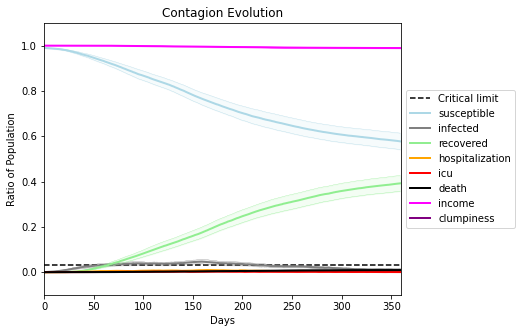

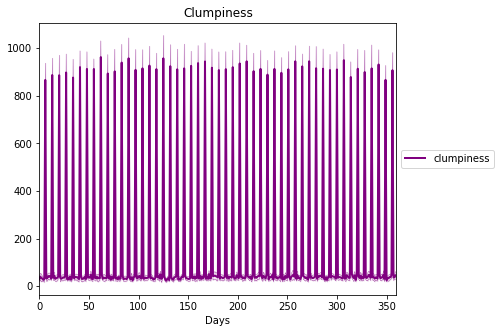

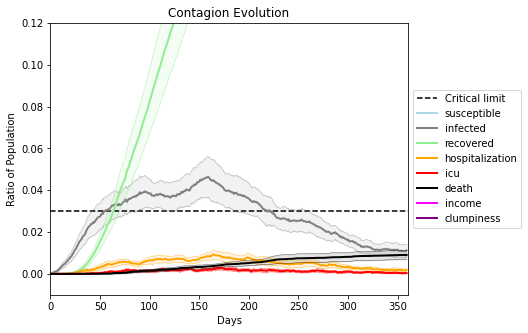

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7669, 8190, 5618, 7315, 6923, 2208, 9819, 5770, 3497, 3511, 5050, 7990, 6409, 3128, 524, 2786, 4304, 7973, 7764, 6635]
Average similarity between family members is 0.1534000615935309 at temperature -0.1
Average similarity between family and home is 0.9998520363780963 at temperature -1
Average similarity between students and their classroom is 0.17140628930682844 at temperature -0.1
Average classroom occupancy is 1.6458333333333333 and number classrooms is 192
Average similarity between workers is 0.1665278743688948 at temperature -0.1
Average office occupancy is 3.228426395939086 and number offices is 197
Average friend similarity for adults: 0.20874964752383693 for kids: 0.21069226443766242
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.01751169503151113
avg restaurant similarity 0.02978805238206381
avg restaurant similarity 0.05751762949569324
avg restaurant similarity 0.05759167028466796
avg restaurant similarity 0.019542989988989838
avg restaurant similarity 0.07812704953632749
avg restaurant similarity 0.044994775255406044
avg restaurant similarity 0.0177421750799178
avg restaurant similarity 0.012977457626812378
avg restaurant similarity 0.011917232365362058
avg restaurant similarity 0.07420019163412107
avg restaurant similarity 0.09817888370677347
avg restaurant similarity 0.042275692807628946
avg restaurant similarity 0.03300962666682562
avg restaurant similarity 0.09894372333573466
avg restaurant similarity 0.04144010057102107
avg restaurant similarity 0.018040694327607333
avg restaurant similarity 0.0639185797357163
avg restaurant similarity 0.0738585116409769
avg restaurant similarity 0.03640493022980472
avg restaurant similarity 0.07566854222106371
avg restaurant similarity 0.035

avg restaurant similarity 0.05247179004854853
avg restaurant similarity 0.04131174788977905
avg restaurant similarity 0.037463371341021054
avg restaurant similarity 0.06638115723496843
avg restaurant similarity 0.11742283454567501
avg restaurant similarity 0.08835139612399394
avg restaurant similarity 0.0426971233562872
avg restaurant similarity 0.06145775473484563
avg restaurant similarity 0.023870636752467953
avg restaurant similarity -0.01769939749822007
avg restaurant similarity 0.07395053821833393
avg restaurant similarity 0.09057014994473873
avg restaurant similarity 0.01756551612980933
avg restaurant similarity 0.036077829851954624
avg restaurant similarity 0.053198698319751145
avg restaurant similarity 0.0463740364510825
avg restaurant similarity 0.006866221679907284
avg restaurant similarity 0.09200997273058306
avg restaurant similarity 0.11601200249234159
avg restaurant similarity 0.08372028223608168
avg restaurant similarity 0.05906700583658729
avg restaurant similarity 0.02

avg restaurant similarity 0.003996978347698649
avg restaurant similarity 0.05286207851732313
avg restaurant similarity 0.024275977122061074
avg restaurant similarity 0.055915998931091754
avg restaurant similarity 0.06374948751139148
avg restaurant similarity 0.03573924009720877
Average similarity between family members is 0.1612432277705542 at temperature -0.1
Average similarity between family and home is 0.9998499871451764 at temperature -1
Average similarity between students and their classroom is 0.14678067419654803 at temperature -0.1
Average classroom occupancy is 1.5423728813559323 and number classrooms is 177
Average similarity between workers is 0.13073635887177015 at temperature -0.1
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.212323339968279 for kids: 0.21983551683428942
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of

avg restaurant similarity 0.0800827280632236
avg restaurant similarity 0.10477415288509247
avg restaurant similarity 0.10245391030344912
avg restaurant similarity 0.08678459035436095
avg restaurant similarity 0.059778804685001234
avg restaurant similarity 0.08444540365073878
avg restaurant similarity 0.06501075121112576
avg restaurant similarity 0.06592114087777337
avg restaurant similarity 0.060533542179839375
avg restaurant similarity 0.12205536491719685
avg restaurant similarity 0.05045261298435591
avg restaurant similarity 0.06656441653312391
avg restaurant similarity 0.08911567046279119
avg restaurant similarity 0.09838859449061972
avg restaurant similarity 0.024184876907672896
avg restaurant similarity 0.08767972910479976
avg restaurant similarity 0.05210050974451094
avg restaurant similarity 0.07746408655622626
avg restaurant similarity 0.08047699264509954
avg restaurant similarity 0.10529657247701167
avg restaurant similarity 0.1103354571305585
avg restaurant similarity 0.06879

avg restaurant similarity 0.08419478859917313
avg restaurant similarity 0.0827320462505492
avg restaurant similarity 0.08062869846494271
avg restaurant similarity 0.028531052669916616
avg restaurant similarity 0.05522329806030492
avg restaurant similarity 0.06586346611515353
avg restaurant similarity 0.06418046710157058
avg restaurant similarity 0.06723639327379334
avg restaurant similarity 0.1052799977799873
avg restaurant similarity 0.023896304998187422
avg restaurant similarity 0.08328250436379751
avg restaurant similarity 0.09171641780444292
avg restaurant similarity 0.05025823778709766
avg restaurant similarity 0.04612006060091711
avg restaurant similarity 0.08935179588287065
avg restaurant similarity 0.07046038223257861
avg restaurant similarity 0.05589248039528783
avg restaurant similarity 0.019063052214448484
avg restaurant similarity 0.14416367836561897
avg restaurant similarity 0.1055230090192822
avg restaurant similarity 0.059459534542665456
avg restaurant similarity 0.05211

avg restaurant similarity 0.10022114549299178
avg restaurant similarity 0.08329392936821753
avg restaurant similarity 0.07504813564964775
Average similarity between family members is 0.14833408915827428 at temperature -0.1
Average similarity between family and home is 0.9998481869204279 at temperature -1
Average similarity between students and their classroom is 0.1836793582778232 at temperature -0.1
Average classroom occupancy is 1.6091954022988506 and number classrooms is 174
Average similarity between workers is 0.1690106399326298 at temperature -0.1
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.21204920913993847 for kids: 0.2204968658496609
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.07353484745303955
avg restaurant similarity 0.05603022219139541
avg restaurant similarity 0.112148543369801
avg restaurant similarity 0.0867432898254205
avg restaurant similarity 0.044374433968644066
avg restaurant similarity 0.10252938065188247
avg restaurant similarity 0.055829963814631935
avg restaurant similarity 0.042204308619296624
avg restaurant similarity 0.0813082593203185
avg restaurant similarity 0.04859516160675119
avg restaurant similarity 0.08924149261769442
avg restaurant similarity 0.12794746275345545
avg restaurant similarity 0.03959112723443306
avg restaurant similarity 0.0020359959788763884
avg restaurant similarity 0.08969048852825666
avg restaurant similarity 0.10990531715718854
avg restaurant similarity 0.06494305036338036
avg restaurant similarity 0.08994155847506755
avg restaurant similarity 0.06331894064737469
avg restaurant similarity 0.07674319018290174
avg restaurant similarity 0.08292510683691698
avg restaurant similarity 0.10714

avg restaurant similarity 0.05949384993821437
avg restaurant similarity 0.054138630969563326
avg restaurant similarity 0.055124418095673214
avg restaurant similarity 0.042957617655886876
avg restaurant similarity 0.0747806534223765
avg restaurant similarity 0.07536618866526396
avg restaurant similarity 0.09110961475714499
avg restaurant similarity 0.10564682597116277
avg restaurant similarity 0.04327583291889062
avg restaurant similarity 0.0785302281054105
avg restaurant similarity 0.06136077472473677
avg restaurant similarity 0.062148192241380136
avg restaurant similarity 0.10553722915865786
avg restaurant similarity 0.07599764192058411
avg restaurant similarity 0.06395675934442381
avg restaurant similarity 0.063823312753385
avg restaurant similarity 0.10272042900268169
avg restaurant similarity 0.023640812331219476
avg restaurant similarity 0.07949457833343056
avg restaurant similarity 0.0670316496876983
avg restaurant similarity 0.07745606169976614
avg restaurant similarity 0.042178

avg restaurant similarity 0.01794337429675847
avg restaurant similarity 0.10443184728844097
avg restaurant similarity 0.04385540782207979
avg restaurant similarity 0.08007285659149872
Average similarity between family members is 0.1773192230743771 at temperature -0.1
Average similarity between family and home is 0.99985016062811 at temperature -1
Average similarity between students and their classroom is 0.16931578740242967 at temperature -0.1
Average classroom occupancy is 1.6551724137931034 and number classrooms is 174
Average similarity between workers is 0.16372281123477087 at temperature -0.1
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.20547101654315392 for kids: 0.2096817434421406
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.04915036458710175
avg restaurant similarity 0.05550696632266028
avg restaurant similarity 0.00615063250303483
avg restaurant similarity 0.023751567299824153
avg restaurant similarity 0.07217012823191853
avg restaurant similarity 0.08340457622351505
avg restaurant similarity 0.005976600256158317
avg restaurant similarity 0.039902164496817556
avg restaurant similarity 0.10000051324834028
avg restaurant similarity 0.06981051334367656
avg restaurant similarity -0.014945259112636292
avg restaurant similarity 0.04081803282769092
avg restaurant similarity 0.05925252049038961
avg restaurant similarity 0.07633265455887679
avg restaurant similarity 0.005455659734913791
avg restaurant similarity 0.06497528117333434
avg restaurant similarity 0.04326190892071575
avg restaurant similarity 0.02384275015933355
avg restaurant similarity 0.06442799970071181
avg restaurant similarity 0.03150342533548186
avg restaurant similarity 0.0448381433917331
avg restaurant similarity 0.0

avg restaurant similarity 0.1198264805730654
avg restaurant similarity 0.060526657673877465
avg restaurant similarity 0.0791185510224814
avg restaurant similarity 0.09900790161497121
avg restaurant similarity 0.06670281532379806
avg restaurant similarity 0.07294842507973665
avg restaurant similarity 0.029805589523109754
avg restaurant similarity 0.0324174232112407
avg restaurant similarity 0.04217269435272781
avg restaurant similarity 0.004314651867058323
avg restaurant similarity 0.09299453463958615
avg restaurant similarity 0.0294584471775416
avg restaurant similarity 0.06606271586098841
avg restaurant similarity -0.029502978500936927
avg restaurant similarity 0.06530145663933822
avg restaurant similarity 0.1153399017406625
avg restaurant similarity 0.06507942104695734
avg restaurant similarity 0.007737862546574145
avg restaurant similarity 0.018342108918442828
avg restaurant similarity 0.06667811076407229
avg restaurant similarity 0.0578817588104424
avg restaurant similarity 0.09516

avg restaurant similarity 0.05286120711575398
avg restaurant similarity 0.017518296469337856
avg restaurant similarity 0.06380016684391403
avg restaurant similarity 0.07016059338265189
Average similarity between family members is 0.16352003024343204 at temperature -0.1
Average similarity between family and home is 0.9998556862659997 at temperature -1
Average similarity between students and their classroom is 0.1863065034539164 at temperature -0.1
Average classroom occupancy is 1.5903614457831325 and number classrooms is 166
Average similarity between workers is 0.17903308817129943 at temperature -0.1
Average office occupancy is 3.35 and number offices is 200
Average friend similarity for adults: 0.21315769309271282 for kids: 0.2054500779521387
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.06517871793423045
avg restaurant similarity 0.0798005536317482
avg restaurant similarity 0.05749306511056819
avg restaurant similarity 0.11695831033720644
avg restaurant similarity 0.13140353346953745
avg restaurant similarity 0.08251469458547753
avg restaurant similarity 0.06585393806318608
avg restaurant similarity 0.07508202435440145
avg restaurant similarity 0.10032103348899497
avg restaurant similarity 0.06243898942694827
avg restaurant similarity 0.08016379687686379
avg restaurant similarity 0.09176817174999309
avg restaurant similarity 0.11707898637178996
avg restaurant similarity 0.11518459015432217
avg restaurant similarity 0.09672755502904476
avg restaurant similarity 0.1208028874483245
avg restaurant similarity 0.08232067353413365
avg restaurant similarity 0.11173783822379141
avg restaurant similarity 0.08379523646661638
avg restaurant similarity 0.057832873785951915
avg restaurant similarity 0.04851670935703555
avg restaurant similarity 0.0479210

avg restaurant similarity 0.08470445870137824
avg restaurant similarity 0.040282848154302955
avg restaurant similarity 0.10743512860498025
avg restaurant similarity 0.05769407398082705
avg restaurant similarity 0.033594030769538076
avg restaurant similarity 0.1038791095790803
avg restaurant similarity 0.06606710855225338
avg restaurant similarity 0.0728397674069204
avg restaurant similarity 0.08075541694906778
avg restaurant similarity 0.07741411992213722
avg restaurant similarity 0.10149374389098541
avg restaurant similarity 0.06210312217600421
avg restaurant similarity 0.10111171169179077
avg restaurant similarity 0.0821208235282211
avg restaurant similarity 0.09833655300763251
avg restaurant similarity 0.10016186728026015
avg restaurant similarity 0.10502565429547964
avg restaurant similarity 0.08896082601694835
avg restaurant similarity 0.10894856789436917
avg restaurant similarity 0.08240801622465983
avg restaurant similarity 0.08366635044026885
avg restaurant similarity 0.0514702

avg restaurant similarity 0.025833116283660675
avg restaurant similarity 0.08619208272765747
Average similarity between family members is 0.1559468971820384 at temperature -0.1
Average similarity between family and home is 0.9998641440021091 at temperature -1
Average similarity between students and their classroom is 0.1744810153227403 at temperature -0.1
Average classroom occupancy is 1.664804469273743 and number classrooms is 179
Average similarity between workers is 0.15439465313932563 at temperature -0.1
Average office occupancy is 3.202970297029703 and number offices is 202
Average friend similarity for adults: 0.21013355810090506 for kids: 0.21862053269331663
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.04210819611665031
avg restaurant similarity 0.046318563159672775
avg restaurant similarity 0.05332390540814481
avg restaurant similarity 0.0794194102307163
avg restaurant similarity 0.04586984346878259
avg restaurant similarity 0.06745079557365932
avg restaurant similarity 0.058080248661746756
avg restaurant similarity 0.028101508109647084
avg restaurant similarity 0.05190076767625793
avg restaurant similarity 0.04748563902557801
avg restaurant similarity 0.04721233487111974
avg restaurant similarity 0.01068639225313206
avg restaurant similarity 0.050752503213389755
avg restaurant similarity 0.038450018023883134
avg restaurant similarity 0.037661346063946714
avg restaurant similarity 0.030660334310359055
avg restaurant similarity 0.07805308869844178
avg restaurant similarity 0.054762818483198625
avg restaurant similarity 0.06313831851168315
avg restaurant similarity 0.04279790366910538
avg restaurant similarity 0.08241931206553389
avg restaurant similarity 0

avg restaurant similarity 0.09412133357937591
avg restaurant similarity 0.023523573522600816
avg restaurant similarity 0.05870709432719194
avg restaurant similarity 0.06543324959251001
avg restaurant similarity 0.06156594200314584
avg restaurant similarity 0.07352178869277624
avg restaurant similarity 0.06451533668704036
avg restaurant similarity 0.06842958768245927
avg restaurant similarity 0.03960645455226036
avg restaurant similarity 0.09357459403881163
avg restaurant similarity 0.09344519516222258
avg restaurant similarity 0.067041196502511
avg restaurant similarity 0.07148781706183789
avg restaurant similarity 0.09366698921264133
avg restaurant similarity 0.019235198748580776
avg restaurant similarity 0.07050074051098454
avg restaurant similarity 0.04604525257819775
avg restaurant similarity 0.056210184509733876
avg restaurant similarity 0.061942210693450094
avg restaurant similarity 0.06116135794925595
avg restaurant similarity 0.04722338855719054
avg restaurant similarity 0.0738

avg restaurant similarity 0.0437493132204397
avg restaurant similarity 0.07799674917014109
avg restaurant similarity 0.04753951976825145
avg restaurant similarity 0.04868059735205223
Average similarity between family members is 0.1716202534390015 at temperature -0.1
Average similarity between family and home is 0.9998531312069446 at temperature -1
Average similarity between students and their classroom is 0.17922512611125424 at temperature -0.1
Average classroom occupancy is 1.6162790697674418 and number classrooms is 172
Average similarity between workers is 0.1555891665231797 at temperature -0.1
Average office occupancy is 3.3168316831683167 and number offices is 202
Average friend similarity for adults: 0.21827773204505652 for kids: 0.2221605325815865
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.06335414120415742
avg restaurant similarity 0.0451546290034703
avg restaurant similarity 0.08123743669949696
avg restaurant similarity 0.02737156343088661
avg restaurant similarity 0.07392079691179372
avg restaurant similarity 0.09821050249682496
avg restaurant similarity 0.06758700358782826
avg restaurant similarity 0.032717694002515826
avg restaurant similarity 0.0239089436007663
avg restaurant similarity 0.06433213164984242
avg restaurant similarity 0.05253598804739105
avg restaurant similarity 0.01981524153782228
avg restaurant similarity 0.054452026105570074
avg restaurant similarity 0.04841209702393843
avg restaurant similarity 0.041626180289334264
avg restaurant similarity 0.0352777742303627
avg restaurant similarity 0.04851150337716686
avg restaurant similarity 0.04253384082246897
avg restaurant similarity 0.05420197219029543
avg restaurant similarity 0.011415114341511993
avg restaurant similarity 0.028327050252256996
avg restaurant similarity 0.0546

avg restaurant similarity 0.018356260313129865
avg restaurant similarity 0.01958441513330608
avg restaurant similarity 0.04335327981440748
avg restaurant similarity 0.024586043389104396
avg restaurant similarity -0.006630109596567005
avg restaurant similarity 0.013433244070901405
avg restaurant similarity 0.009424470803787683
avg restaurant similarity 0.05074432816713911
avg restaurant similarity 0.09735596246381661
avg restaurant similarity 0.03479900608204496
avg restaurant similarity -0.005714674993224436
avg restaurant similarity 0.05425879113327327
avg restaurant similarity 0.038947412008532765
avg restaurant similarity 0.03785125337742405
avg restaurant similarity 0.027957566584919404
avg restaurant similarity 0.06645550400411546
avg restaurant similarity 0.008991070695771007
avg restaurant similarity -0.005315809655509355
avg restaurant similarity 0.08327666558643661
avg restaurant similarity 0.07039926057581333
avg restaurant similarity 0.09703868941750461
avg restaurant simila

avg restaurant similarity 0.08208565126751202
avg restaurant similarity 0.04090424699145274
avg restaurant similarity 0.06646293135345821
avg restaurant similarity 0.03676254354672914
Average similarity between family members is 0.16211601879493442 at temperature -0.1
Average similarity between family and home is 0.9998415013498138 at temperature -1
Average similarity between students and their classroom is 0.1727363517875675 at temperature -0.1
Average classroom occupancy is 1.5773809523809523 and number classrooms is 168
Average similarity between workers is 0.1673564727501966 at temperature -0.1
Average office occupancy is 3.3823529411764706 and number offices is 204
Average friend similarity for adults: 0.21246250745239292 for kids: 0.21464389823300337
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.06289410228392839
avg restaurant similarity 0.04131016600133598
avg restaurant similarity 0.031424698092508564
avg restaurant similarity 0.02758197739545139
avg restaurant similarity 0.09067387825290157
avg restaurant similarity 0.0747577510180249
avg restaurant similarity 0.047590082651789975
avg restaurant similarity 0.05620114149918995
avg restaurant similarity 0.11396084847672572
avg restaurant similarity 0.020346990767275235
avg restaurant similarity 0.052882957564004913
avg restaurant similarity 0.052785773843903525
avg restaurant similarity 0.08400783982122577
avg restaurant similarity 0.07741288139300231
avg restaurant similarity 0.09933773813338782
avg restaurant similarity 0.011553465187828292
avg restaurant similarity 0.07310472736215005
avg restaurant similarity 0.08958856577456156
avg restaurant similarity 0.08385371033728556
avg restaurant similarity 0.07712444531575893
avg restaurant similarity 0.12471139763814833
avg restaurant similarity 0.0

avg restaurant similarity 0.05141388251544999
avg restaurant similarity 0.05267016985240319
avg restaurant similarity 0.04454867303154594
avg restaurant similarity 0.011810022413023728
avg restaurant similarity 0.09036060866538549
avg restaurant similarity 0.05572774814064827
avg restaurant similarity 0.05673527919637555
avg restaurant similarity 0.0447008903626499
avg restaurant similarity 0.07028806816184126
avg restaurant similarity 0.08502103389228445
avg restaurant similarity 0.07352520370626203
avg restaurant similarity 0.08707043241253844
avg restaurant similarity 0.06371158120892596
avg restaurant similarity 0.08243699900159883
avg restaurant similarity 0.10100411289325331
avg restaurant similarity 0.08371267782324292
avg restaurant similarity 0.048680509261121566
avg restaurant similarity 0.07290369842410495
avg restaurant similarity 0.09409570765043625
avg restaurant similarity 0.06153938786521032
avg restaurant similarity 0.07995440070192929
avg restaurant similarity 0.03354

avg restaurant similarity 0.03468065687958671
avg restaurant similarity 0.03938899915014461
avg restaurant similarity 0.05443408588031948
Average similarity between family members is 0.15986614593700665 at temperature -0.1
Average similarity between family and home is 0.9998623686682973 at temperature -1
Average similarity between students and their classroom is 0.198131923470502 at temperature -0.1
Average classroom occupancy is 1.582857142857143 and number classrooms is 175
Average similarity between workers is 0.13640813899336 at temperature -0.1
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.2079405280796567 for kids: 0.20819142298204188
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.05773200070272844
avg restaurant similarity 0.038727175761540764
avg restaurant similarity 0.06315356326309512
avg restaurant similarity 0.07414196853918723
avg restaurant similarity 0.042951826312196406
avg restaurant similarity 0.05826974748711651
avg restaurant similarity 0.04939617167045811
avg restaurant similarity 0.013868912874122721
avg restaurant similarity 0.0841096100550303
avg restaurant similarity 0.058688397422731034
avg restaurant similarity 0.1201556847279452
avg restaurant similarity 0.08801518322278112
avg restaurant similarity 0.05131412398129537
avg restaurant similarity 0.0865571902434875
avg restaurant similarity 0.06082987420079531
avg restaurant similarity 0.01767614546261873
avg restaurant similarity 0.05523440883454845
avg restaurant similarity 0.047824269621808156
avg restaurant similarity 0.08302536220468636
avg restaurant similarity 0.05831189441736186
avg restaurant similarity 0.08753696592319575
avg restaurant similarity 0.0824

avg restaurant similarity 0.09049965597128944
avg restaurant similarity 0.08321848260358068
avg restaurant similarity 0.07957274131510772
avg restaurant similarity 0.1107189897413916
avg restaurant similarity 0.07483993002643213
avg restaurant similarity 0.075580240558166
avg restaurant similarity 0.06485001115423315
avg restaurant similarity 0.0894159744606998
avg restaurant similarity 0.0659101508352254
avg restaurant similarity 0.08242473261294635
avg restaurant similarity 0.08638952671065818
avg restaurant similarity 0.07839343749112293
avg restaurant similarity 0.057285849699747725
avg restaurant similarity 0.04084622442971442
avg restaurant similarity 0.09522802903372546
avg restaurant similarity 0.1140199489577293
avg restaurant similarity 0.0776704666753207
avg restaurant similarity 0.06238236079109907
avg restaurant similarity 0.09809098719115801
avg restaurant similarity 0.06624569151751579
avg restaurant similarity 0.07879816867530458
avg restaurant similarity 0.094518047397

avg restaurant similarity 0.035471754779276374
avg restaurant similarity 0.09283343923101038
avg restaurant similarity 0.034510630962874864
Average similarity between family members is 0.1854099310838094 at temperature -0.1
Average similarity between family and home is 0.9998543658575451 at temperature -1
Average similarity between students and their classroom is 0.18038756655754123 at temperature -0.1
Average classroom occupancy is 1.4497354497354498 and number classrooms is 189
Average similarity between workers is 0.15766529264954024 at temperature -0.1
Average office occupancy is 3.3465346534653464 and number offices is 202
Average friend similarity for adults: 0.21213834241104212 for kids: 0.23198143165287807
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 u

avg restaurant similarity 0.04543943680144901
avg restaurant similarity 0.0675272593843316
avg restaurant similarity 0.05138641309633366
avg restaurant similarity 0.11064294381517634
avg restaurant similarity 0.09763212794968675
avg restaurant similarity 0.06389894969937007
avg restaurant similarity 0.025385123292392838
avg restaurant similarity 0.07441563639909447
avg restaurant similarity 0.07909452381666042
avg restaurant similarity 0.032038414789451575
avg restaurant similarity 0.06599948414643628
avg restaurant similarity 0.10352781492350632
avg restaurant similarity 0.09479603650737142
avg restaurant similarity 0.04492164186884872
avg restaurant similarity 0.0961857324975476
avg restaurant similarity 0.08131947246212265
avg restaurant similarity 0.045999985187082974
avg restaurant similarity 0.06592536082700726
avg restaurant similarity 0.05693510789670455
avg restaurant similarity 0.08672422012013865
avg restaurant similarity 0.09916207776513314
avg restaurant similarity 0.06786

avg restaurant similarity 0.027233211409187656
avg restaurant similarity 0.07207509126167387
avg restaurant similarity 0.04987517933429353
avg restaurant similarity -0.02135086715556916
avg restaurant similarity 0.06626950171061521
avg restaurant similarity 0.1088819560514878
avg restaurant similarity 0.0519092552773536
avg restaurant similarity 0.07129637302081263
avg restaurant similarity 0.11529826901007506
avg restaurant similarity 0.08860328467683322
avg restaurant similarity 0.0866896566231822
avg restaurant similarity 0.10051037680713197
avg restaurant similarity 0.04522293457176543
avg restaurant similarity 0.06877476550515953
avg restaurant similarity 0.1053339207847784
avg restaurant similarity 0.06411663858979712
avg restaurant similarity 0.10114070931458737
avg restaurant similarity 0.09134560424372003
avg restaurant similarity 0.08556042850094979
avg restaurant similarity 0.0706830066731646
avg restaurant similarity 0.08886724370384604
avg restaurant similarity 0.033070823

avg restaurant similarity 0.07953172697531459
avg restaurant similarity 0.07997854081925801
avg restaurant similarity 0.03166664318520468
avg restaurant similarity 0.05492476641752921
Average similarity between family members is 0.1708656680876924 at temperature -0.1
Average similarity between family and home is 0.9998652898537395 at temperature -1
Average similarity between students and their classroom is 0.1454341298112108 at temperature -0.1
Average classroom occupancy is 1.639344262295082 and number classrooms is 183
Average similarity between workers is 0.1459093026356063 at temperature -0.1
Average office occupancy is 3.282828282828283 and number offices is 198
Average friend similarity for adults: 0.22440711797480611 for kids: 0.2205139079880511
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.0887141582295123
avg restaurant similarity 0.07870828142434215
avg restaurant similarity 0.05825562424465437
avg restaurant similarity 0.08512621371903427
avg restaurant similarity 0.08416090386618114
avg restaurant similarity 0.12738355699544562
avg restaurant similarity 0.08556426766620727
avg restaurant similarity 0.0575722941841843
avg restaurant similarity 0.104381496863501
avg restaurant similarity 0.05039751651396309
avg restaurant similarity 0.0479632455892612
avg restaurant similarity 0.12099815605343948
avg restaurant similarity 0.11851356505349211
avg restaurant similarity 0.08335332694348825
avg restaurant similarity 0.09540147211053024
avg restaurant similarity 0.0669190169966372
avg restaurant similarity 0.12017539666452204
avg restaurant similarity 0.08003378432055827
avg restaurant similarity 0.04580392957635298
avg restaurant similarity 0.09008242283423178
avg restaurant similarity 0.045401460929657016
avg restaurant similarity 0.11196921810

avg restaurant similarity 0.10404065610835879
avg restaurant similarity 0.08666293932586781
avg restaurant similarity 0.15956689955652342
avg restaurant similarity 0.09164578102543312
avg restaurant similarity 0.08919091448223812
avg restaurant similarity 0.05320467915549095
avg restaurant similarity 0.09486786299360536
avg restaurant similarity 0.0750085647645118
avg restaurant similarity 0.13179790946737796
avg restaurant similarity 0.12413227854535505
avg restaurant similarity 0.13709354129118312
avg restaurant similarity 0.09455989991680042
avg restaurant similarity 0.06920892482161684
avg restaurant similarity 0.05790422257402718
avg restaurant similarity 0.08458068691868781
avg restaurant similarity 0.0550991093486306
avg restaurant similarity 0.06859980809259515
avg restaurant similarity 0.05606485370586859
avg restaurant similarity 0.057305952151828536
avg restaurant similarity 0.09592328822871594
avg restaurant similarity 0.03519469718559874
avg restaurant similarity 0.0523238

avg restaurant similarity 0.08778493591282523
avg restaurant similarity 0.09598576850612744
Average similarity between family members is 0.14797974674629435 at temperature -0.1
Average similarity between family and home is 0.9998614154855102 at temperature -1
Average similarity between students and their classroom is 0.12825409233291 at temperature -0.1
Average classroom occupancy is 1.6630434782608696 and number classrooms is 184
Average similarity between workers is 0.13533493016816464 at temperature -0.1
Average office occupancy is 3.3076923076923075 and number offices is 195
Average friend similarity for adults: 0.21037687944912292 for kids: 0.212676204665913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated un

avg restaurant similarity 0.06887189954749534
avg restaurant similarity 0.06462711013948294
avg restaurant similarity 0.044803825805515125
avg restaurant similarity 0.07299697409696816
avg restaurant similarity 0.07265784297078709
avg restaurant similarity 0.08004153151932154
avg restaurant similarity 0.031582448374950306
avg restaurant similarity 0.05958559450372734
avg restaurant similarity 0.040962643488550464
avg restaurant similarity 0.04281909297657293
avg restaurant similarity 0.02000636434832808
avg restaurant similarity 0.06097109902908073
avg restaurant similarity 0.030906821198417884
avg restaurant similarity 0.08949113032498589
avg restaurant similarity 0.0967735424836985
avg restaurant similarity 0.021108907995553282
avg restaurant similarity 0.05589614389095527
avg restaurant similarity 0.0136336859053929
avg restaurant similarity 0.06277681771172347
avg restaurant similarity 0.058062655750861114
avg restaurant similarity 0.023560597277681884
avg restaurant similarity 0.0

avg restaurant similarity 0.0651740640460929
avg restaurant similarity 0.05268934304796313
avg restaurant similarity 0.016348950948286877
avg restaurant similarity 0.041083607682296665
avg restaurant similarity 0.08663573277137582
avg restaurant similarity 0.029036533682292476
avg restaurant similarity 0.039518505501156494
avg restaurant similarity 0.07473199521516635
avg restaurant similarity 0.008595842021191884
avg restaurant similarity 0.023368109962803193
avg restaurant similarity 0.026843317117549184
avg restaurant similarity 0.06066131237157876
avg restaurant similarity 0.050911328857380735
avg restaurant similarity -0.037898825455844644
avg restaurant similarity 0.017792566916990066
avg restaurant similarity 0.036764737686590394
avg restaurant similarity -0.003786603180563411
avg restaurant similarity 0.053417964766910624
avg restaurant similarity 0.06668167464707814
avg restaurant similarity 0.05729209685996961
avg restaurant similarity 0.043864523143129525
avg restaurant simi

avg restaurant similarity 0.05061424316364022
avg restaurant similarity 0.04501787841224622
avg restaurant similarity 0.04862403779578787
avg restaurant similarity 0.07456039148911209
avg restaurant similarity 0.07308875739670596
avg restaurant similarity 0.07637016491403216
Average similarity between family members is 0.16417861454718183 at temperature -0.1
Average similarity between family and home is 0.9998637865690901 at temperature -1
Average similarity between students and their classroom is 0.16557397025009682 at temperature -0.1
Average classroom occupancy is 1.7374301675977655 and number classrooms is 179
Average similarity between workers is 0.13514226895735973 at temperature -0.1
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.20351509676535104 for kids: 0.20379577174751862
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wi

avg restaurant similarity 0.03955129850559123
avg restaurant similarity 0.04407961873496486
avg restaurant similarity 0.022071739275518514
avg restaurant similarity 0.07814574478103714
avg restaurant similarity 0.09267590380389361
avg restaurant similarity 0.06160262906779196
avg restaurant similarity 0.07301444147319361
avg restaurant similarity 0.04571243847891745
avg restaurant similarity 0.0427474983677828
avg restaurant similarity 0.06630886606670224
avg restaurant similarity 0.08147473011941089
avg restaurant similarity 0.08668045734726632
avg restaurant similarity 0.025063834867309037
avg restaurant similarity 0.048255728750988554
avg restaurant similarity 0.004254614355413265
avg restaurant similarity 0.017383909919170496
avg restaurant similarity 0.04929935353712852
avg restaurant similarity 0.03734635013841121
avg restaurant similarity 0.03587152528055438
avg restaurant similarity 0.0681866763618106
avg restaurant similarity 0.05060879956150832
avg restaurant similarity 0.013

avg restaurant similarity 0.06926667306213329
avg restaurant similarity 0.02427111259621085
avg restaurant similarity 0.12115912013555524
avg restaurant similarity 0.03596175366698264
avg restaurant similarity 0.05249314465678843
avg restaurant similarity 0.03240861233008133
avg restaurant similarity 0.07622974351921481
avg restaurant similarity 0.050263523013037985
avg restaurant similarity 0.01402172509711959
avg restaurant similarity 0.016883104752790312
avg restaurant similarity 0.028692289082606418
avg restaurant similarity 0.07468558526922955
avg restaurant similarity 0.05492107401300859
avg restaurant similarity 0.053198173276926324
avg restaurant similarity 0.006004347219030263
avg restaurant similarity 0.022687640145101984
avg restaurant similarity 0.052207620714482976
avg restaurant similarity 0.05634000938968284
avg restaurant similarity 0.0660750915287696
avg restaurant similarity 0.05810366683056343
avg restaurant similarity 0.01387124311968159
avg restaurant similarity 0.

avg restaurant similarity 0.05297423311827098
avg restaurant similarity 0.05641410298323455
avg restaurant similarity 0.007241472371803009
avg restaurant similarity 0.07994671935427491
avg restaurant similarity 0.02875892551913831
avg restaurant similarity -0.0017930405301301551
Average similarity between family members is 0.15721542194790056 at temperature -0.1
Average similarity between family and home is 0.9998512314094183 at temperature -1
Average similarity between students and their classroom is 0.12710551387838775 at temperature -0.1
Average classroom occupancy is 1.558139534883721 and number classrooms is 172
Average similarity between workers is 0.1528627100960648 at temperature -0.1
Average office occupancy is 3.318407960199005 and number offices is 201
Average friend similarity for adults: 0.20617352585557944 for kids: 0.21333272280980964
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units w

avg restaurant similarity 0.014119992956142807
avg restaurant similarity 0.03130118506420281
avg restaurant similarity 0.07224140662609947
avg restaurant similarity 0.04019389511683746
avg restaurant similarity 0.05769656350458658
avg restaurant similarity 0.02443997023470436
avg restaurant similarity 0.028147647252482116
avg restaurant similarity 0.04918114758553195
avg restaurant similarity 0.054831272699548975
avg restaurant similarity 0.06157014068097189
avg restaurant similarity 0.04553764276005517
avg restaurant similarity 0.042122440467020184
avg restaurant similarity 0.03238216508968114
avg restaurant similarity 0.02762859206000993
avg restaurant similarity 0.02269208961083069
avg restaurant similarity 0.040446043354387444
avg restaurant similarity 0.07954018649883432
avg restaurant similarity 0.060107599596225324
avg restaurant similarity 0.06112277077389373
avg restaurant similarity 0.040184400476438405
avg restaurant similarity 0.02631138098091587
avg restaurant similarity 0

avg restaurant similarity 0.025842504033008126
avg restaurant similarity 0.06335702197480883
avg restaurant similarity 0.0024249575602173752
avg restaurant similarity 0.050415858914949443
avg restaurant similarity 0.05384999420168586
avg restaurant similarity 0.04263318274397969
avg restaurant similarity 0.07441801264072818
avg restaurant similarity 0.020163652756081965
avg restaurant similarity 0.06503335330140085
avg restaurant similarity 0.07010238400961946
avg restaurant similarity 0.06349430720915346
avg restaurant similarity 0.06921579974930296
avg restaurant similarity 0.06243711959237071
avg restaurant similarity 0.1026692286291545
avg restaurant similarity 0.06572543974003042
avg restaurant similarity 0.05860720555124659
avg restaurant similarity 0.02636297766042252
avg restaurant similarity 0.027771301927519247
avg restaurant similarity 0.054056340289204745
avg restaurant similarity 0.006532941231440126
avg restaurant similarity 0.051977596020320906
avg restaurant similarity 

avg restaurant similarity 0.05176664537470657
avg restaurant similarity 0.03866984462551839
avg restaurant similarity 0.028802992326358346
avg restaurant similarity 0.0022083257511565663
avg restaurant similarity 0.04947779876918463
avg restaurant similarity 0.05208941713073761
Average similarity between family members is 0.1504477433229759 at temperature -0.1
Average similarity between family and home is 0.9998474928368452 at temperature -1
Average similarity between students and their classroom is 0.17257902265845798 at temperature -0.1
Average classroom occupancy is 1.638036809815951 and number classrooms is 163
Average similarity between workers is 0.1307918484218893 at temperature -0.1
Average office occupancy is 3.3465346534653464 and number offices is 202
Average friend similarity for adults: 0.2047489329807072 for kids: 0.21064016857787693
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity 0.049007754394668694
avg restaurant similarity 0.02059463555035422
avg restaurant similarity 0.019470799188038224
avg restaurant similarity 0.07041181390766053
avg restaurant similarity 0.012057322733064021
avg restaurant similarity 0.007788635850521794
avg restaurant similarity 0.04785988271763421
avg restaurant similarity 0.07497825077763343
avg restaurant similarity 0.0009014533544898119
avg restaurant similarity 0.0845567996823892
avg restaurant similarity 0.0068174443416206595
avg restaurant similarity 0.11115167742769842
avg restaurant similarity 0.040820193737259265
avg restaurant similarity 0.036790298699506035
avg restaurant similarity 0.031226361916373832
avg restaurant similarity 0.10831301846041243
avg restaurant similarity 0.04304413299416424
avg restaurant similarity 0.01836208819194854
avg restaurant similarity 0.055444403752437595
avg restaurant similarity 0.006812738904968543
avg restaurant similarity 0.08356710022278642
avg restaurant similar

avg restaurant similarity 0.05466047229937306
avg restaurant similarity 0.034399680434883464
avg restaurant similarity 0.09475519809850177
avg restaurant similarity -0.024365858497305975
avg restaurant similarity 0.0455737244322331
avg restaurant similarity 0.06953250311196335
avg restaurant similarity 0.054913873003635795
avg restaurant similarity 0.03756759400559302
avg restaurant similarity -0.00946033717431833
avg restaurant similarity 0.09985270815043477
avg restaurant similarity 0.04813100433161236
avg restaurant similarity 0.09194667135066482
avg restaurant similarity 0.05602532563485416
avg restaurant similarity 0.06985541355219115
avg restaurant similarity 0.09335568757449461
avg restaurant similarity 0.04941588304516164
avg restaurant similarity 0.0658307892913285
avg restaurant similarity -0.014814249803039598
avg restaurant similarity 0.036336412980837444
avg restaurant similarity 0.041096253827573474
avg restaurant similarity 0.04203273445741935
avg restaurant similarity 0

avg restaurant similarity -0.004120562878157466
avg restaurant similarity 0.008806555551183712
avg restaurant similarity 0.03914736979829208
avg restaurant similarity 0.016412432303156317
avg restaurant similarity 0.0497083196401093
avg restaurant similarity 0.07749432318008531
avg restaurant similarity 0.07560288608167616
Average similarity between family members is 0.16516267577474822 at temperature -0.1
Average similarity between family and home is 0.9998513840327723 at temperature -1
Average similarity between students and their classroom is 0.17440782281797315 at temperature -0.1
Average classroom occupancy is 1.5536723163841808 and number classrooms is 177
Average similarity between workers is 0.16655714289143636 at temperature -0.1
Average office occupancy is 3.383084577114428 and number offices is 201
Average friend similarity for adults: 0.2055458750984937 for kids: 0.21920967194986998
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.059065585694746875
avg restaurant similarity 0.04404039043428116
avg restaurant similarity 0.02436143891319777
avg restaurant similarity 0.059726174405872856
avg restaurant similarity 0.06395654575299836
avg restaurant similarity 0.05763712157968378
avg restaurant similarity 0.054637105367910055
avg restaurant similarity 0.04254510186540498
avg restaurant similarity 0.07592312993352075
avg restaurant similarity 0.04849808971632328
avg restaurant similarity 0.08143985310504503
avg restaurant similarity 0.03253509470332137
avg restaurant similarity 0.03817710016680035
avg restaurant similarity 0.057769686896842413
avg restaurant similarity 0.0842077758459575
avg restaurant similarity 0.0773080467226909
avg restaurant similarity 0.09373083383953901
avg restaurant similarity 0.05815569032520809
avg restaurant similarity 0.07729700805878895
avg restaurant similarity 0.06394814500814144
avg restaurant similarity 0.08105942979061857
avg restaurant similarity 0.0786

avg restaurant similarity 0.0663522819441703
avg restaurant similarity 0.048990202705495874
avg restaurant similarity 0.07313265231710098
avg restaurant similarity 0.052345491820879116
avg restaurant similarity 0.06424803732272293
avg restaurant similarity 0.04134923535892586
avg restaurant similarity 0.14494993978535975
avg restaurant similarity 0.04919920928827851
avg restaurant similarity 0.08529193775262775
avg restaurant similarity 0.0416584229593743
avg restaurant similarity 0.09039421135138315
avg restaurant similarity 0.07698333980413738
avg restaurant similarity 0.08396250626132838
avg restaurant similarity 0.09882143980940758
avg restaurant similarity 0.02759860639995398
avg restaurant similarity 0.08462749239100639
avg restaurant similarity 0.09607509750292526
avg restaurant similarity 0.04231492119159719
avg restaurant similarity 0.12428709911546135
avg restaurant similarity 0.04413182715790774
avg restaurant similarity 0.08506862855924822
avg restaurant similarity 0.035686

avg restaurant similarity 0.11198864589318194
avg restaurant similarity 0.06787681712239566
avg restaurant similarity 0.060368802638047614
avg restaurant similarity 0.12169545135322206
Average similarity between family members is 0.15215896038645046 at temperature -0.1
Average similarity between family and home is 0.9998618042443631 at temperature -1
Average similarity between students and their classroom is 0.181402228991242 at temperature -0.1
Average classroom occupancy is 1.6588235294117648 and number classrooms is 170
Average similarity between workers is 0.151645428471475 at temperature -0.1
Average office occupancy is 3.335 and number offices is 200
Average friend similarity for adults: 0.19772951345273826 for kids: 0.2046487380017609
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.0011397214535154403
avg restaurant similarity 0.0497109513390915
avg restaurant similarity 0.08240461159693609
avg restaurant similarity 0.06645142063256936
avg restaurant similarity 0.09832014485164407
avg restaurant similarity 0.02717370401681216
avg restaurant similarity 0.057690502287021744
avg restaurant similarity 0.07951103452018682
avg restaurant similarity 0.02226128771932385
avg restaurant similarity 0.03830471471940946
avg restaurant similarity 0.05051169692573254
avg restaurant similarity 0.06976606156973957
avg restaurant similarity 0.09797167712457033
avg restaurant similarity 0.04971488375055773
avg restaurant similarity 0.0245340477799157
avg restaurant similarity 0.047233684241933735
avg restaurant similarity 0.08418517053653211
avg restaurant similarity 0.05652064412229228
avg restaurant similarity 0.00971021537533696
avg restaurant similarity 0.03721856790568413
avg restaurant similarity 0.10034315102742392
avg restaurant similarity 0.0588

avg restaurant similarity 0.05359778372092781
avg restaurant similarity 0.07198153018899434
avg restaurant similarity 0.08803000753792516
avg restaurant similarity 0.03524625862939783
avg restaurant similarity 0.03728497182389798
avg restaurant similarity 0.08790718478962162
avg restaurant similarity 0.11354800801431793
avg restaurant similarity 0.09488288455182832
avg restaurant similarity 0.02923275671803812
avg restaurant similarity 0.03662682421504098
avg restaurant similarity 0.055644392522509224
avg restaurant similarity 0.15222836449151608
avg restaurant similarity 0.05578237809577889
avg restaurant similarity 0.021742499472349974
avg restaurant similarity 0.10798379800569435
avg restaurant similarity 0.08295400938886349
avg restaurant similarity 0.08887278523138223
avg restaurant similarity 0.07150009061217924
avg restaurant similarity 0.048630152089039216
avg restaurant similarity 0.08245462263099976
avg restaurant similarity 0.08909846541094764
avg restaurant similarity 0.036

avg restaurant similarity 0.08148681897169412
avg restaurant similarity 0.079674185718739
avg restaurant similarity 0.07796879908728588
avg restaurant similarity 0.058403015783599306
Average similarity between family members is 0.14263935916711618 at temperature -0.1
Average similarity between family and home is 0.9998469228759868 at temperature -1
Average similarity between students and their classroom is 0.18647323069939067 at temperature -0.1
Average classroom occupancy is 1.6216216216216217 and number classrooms is 185
Average similarity between workers is 0.15495891073659795 at temperature -0.1
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.21073220361990133 for kids: 0.2081394456797381
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.029173117261746945
avg restaurant similarity 0.07924137086439742
avg restaurant similarity 0.05429320379934093
avg restaurant similarity 0.06889911945124204
avg restaurant similarity 0.06585138593221566
avg restaurant similarity -0.01115468980290957
avg restaurant similarity 0.07474267047126677
avg restaurant similarity 0.021498652482627886
avg restaurant similarity 0.04921902307374268
avg restaurant similarity -0.002850522660865831
avg restaurant similarity -0.014718508287950672
avg restaurant similarity 0.04973309964895945
avg restaurant similarity 0.06357204960320223
avg restaurant similarity 0.022521099483264122
avg restaurant similarity -0.01500347656581757
avg restaurant similarity 0.06713396517133716
avg restaurant similarity 0.04978143567134153
avg restaurant similarity -0.03418633715333359
avg restaurant similarity 0.05777943633942004
avg restaurant similarity 0.044206989517258405
avg restaurant similarity 0.08043346284884775
avg restaurant similari

avg restaurant similarity 0.027690854955974113
avg restaurant similarity 0.030142194385909912
avg restaurant similarity 0.036760840360180215
avg restaurant similarity 0.03099252957289504
avg restaurant similarity 0.06019182070862226
avg restaurant similarity 0.05767661462136344
avg restaurant similarity 0.04697060535068614
avg restaurant similarity 0.080602209410122
avg restaurant similarity -0.03883205064443972
avg restaurant similarity 0.029772600631855384
avg restaurant similarity 0.030870508498236287
avg restaurant similarity 0.04035132183713395
avg restaurant similarity 0.06535961455415588
avg restaurant similarity 0.03679495816137308
avg restaurant similarity 0.05967323607183677
avg restaurant similarity 0.00587180030625076
avg restaurant similarity 0.03689157614207903
avg restaurant similarity 0.008176258957857535
avg restaurant similarity 0.011953462896818756
avg restaurant similarity 0.07334090445922968
avg restaurant similarity 0.0659483930657156
avg restaurant similarity 0.0

avg restaurant similarity 0.04219459188194595
avg restaurant similarity 0.05287620001394298
avg restaurant similarity 0.05507467115625831
avg restaurant similarity 0.03841296133410252
avg restaurant similarity 0.031504016790792656
avg restaurant similarity 0.0621620229601367
Average similarity between family members is 0.17443011875696546 at temperature -0.1
Average similarity between family and home is 0.9998497445618336 at temperature -1
Average similarity between students and their classroom is 0.1817497773634058 at temperature -0.1
Average classroom occupancy is 1.521505376344086 and number classrooms is 186
Average similarity between workers is 0.15949566148771618 at temperature -0.1
Average office occupancy is 3.227722772277228 and number offices is 202
Average friend similarity for adults: 0.2132612992809459 for kids: 0.2179713631291309
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a 

avg restaurant similarity 0.07759158579274578
avg restaurant similarity 0.11386238167458235
avg restaurant similarity 0.053759896716135715
avg restaurant similarity 0.0505287496163552
avg restaurant similarity 0.05080167583659151
avg restaurant similarity 0.06738606724245162
avg restaurant similarity 0.04272511196065126
avg restaurant similarity 0.08668792587500157
avg restaurant similarity 0.0957635403446393
avg restaurant similarity 0.013570478873929077
avg restaurant similarity 0.09103227787636474
avg restaurant similarity 0.062346945108708925
avg restaurant similarity 0.12060409221338138
avg restaurant similarity 0.060078098858944204
avg restaurant similarity 0.036831833254003334
avg restaurant similarity 0.1018490727632058
avg restaurant similarity 0.0437475857077888
avg restaurant similarity 0.08940207771045637
avg restaurant similarity 0.07954935134219696
avg restaurant similarity 0.05358927252720621
avg restaurant similarity 0.02532344792419156
avg restaurant similarity 0.09475

avg restaurant similarity 0.038157891948333765
avg restaurant similarity 0.07960189690776498
avg restaurant similarity 0.05519072493305058
avg restaurant similarity 0.05113860086317692
avg restaurant similarity 0.05250117445111462
avg restaurant similarity 0.08173892178279615
avg restaurant similarity 0.030556706045671927
avg restaurant similarity 0.04994780692396422
avg restaurant similarity 0.12579603351121751
avg restaurant similarity 0.05455435130227689
avg restaurant similarity 0.08058511440882793
avg restaurant similarity 0.023410474798743895
avg restaurant similarity 0.015713114192867642
avg restaurant similarity 0.08581478975714264
avg restaurant similarity 0.08000986873847685
avg restaurant similarity 0.10511202807876856
avg restaurant similarity 0.058188673805115686
avg restaurant similarity 0.03721148321159204
avg restaurant similarity 0.08545491353004014
avg restaurant similarity 0.09450179789363419
avg restaurant similarity 0.08395233292851796
avg restaurant similarity 0.0

avg restaurant similarity 0.02877703900951234
avg restaurant similarity 0.06375659353776521
avg restaurant similarity 0.12792091627199412
avg restaurant similarity 0.03974774277577116
Average similarity between family members is 0.17298300286904497 at temperature -0.1
Average similarity between family and home is 0.9998652186319261 at temperature -1
Average similarity between students and their classroom is 0.14995001886390255 at temperature -0.1
Average classroom occupancy is 1.6649484536082475 and number classrooms is 194
Average similarity between workers is 0.15429740930288416 at temperature -0.1
Average office occupancy is 3.1393034825870645 and number offices is 201
Average friend similarity for adults: 0.199842782617461 for kids: 0.20452167945015715
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.038756579457881905
avg restaurant similarity 0.032099827872292465
avg restaurant similarity 0.0390449735450254
avg restaurant similarity 0.015835363576647332
avg restaurant similarity 0.04236047332076471
avg restaurant similarity 0.09434444861044905
avg restaurant similarity 0.022449342470414718
avg restaurant similarity 0.014197443115290503
avg restaurant similarity 0.014491661824705772
avg restaurant similarity -0.004563111932721997
avg restaurant similarity 0.018875756628845743
avg restaurant similarity 0.02715791333566043
avg restaurant similarity 0.031920400489073054
avg restaurant similarity 0.08296773699580522
avg restaurant similarity 0.09764351170613511
avg restaurant similarity -0.00494603341243117
avg restaurant similarity 0.100211659685795
avg restaurant similarity 0.012096629467666577
avg restaurant similarity 0.03693123287537466
avg restaurant similarity 0.11735541064810329
avg restaurant similarity 0.0448738953215022
avg restaurant similarity 

avg restaurant similarity 0.05812306017544872
avg restaurant similarity 0.024578019822713043
avg restaurant similarity 0.06713754162150411
avg restaurant similarity 0.061424590158023665
avg restaurant similarity 0.04999902013999083
avg restaurant similarity 0.0671537725398293
avg restaurant similarity 0.02285221646705325
avg restaurant similarity 0.04515318582099514
avg restaurant similarity 0.013103561074754841
avg restaurant similarity 0.1157166096143261
avg restaurant similarity 0.044658407968761554
avg restaurant similarity 0.034063889426304075
avg restaurant similarity 0.05892611814158284
avg restaurant similarity 0.060939327936863734
avg restaurant similarity 0.06606145602126756
avg restaurant similarity 0.06148306584666426
avg restaurant similarity 0.023774758951115086
avg restaurant similarity 0.023581549720804985
avg restaurant similarity 0.07590771762870288
avg restaurant similarity 0.09047571754860023
avg restaurant similarity 0.0396804514650193
avg restaurant similarity 0.0

avg restaurant similarity 0.03349644127656797
avg restaurant similarity -0.006791463886530524
avg restaurant similarity 0.07123778186513388
avg restaurant similarity 0.08125117220274806
using average of time series:
stats on susceptible:
data: [0.7479208250166334, 0.6692055555555556, 0.6635, 0.8019666666666666, 0.8035472222222222, 0.7692150359314539, 0.7107972222222222, 0.8628444444444443, 0.7774694444444444, 0.7740564990564991, 0.7300027777777778, 0.7414638888888889, 0.7609946773120425, 0.699763888888889, 0.7651305555555555, 0.8384499999999999, 0.8519508269508268, 0.7081444444444445, 0.7855949605949606, 0.7309749999999998]
min:
0.6635
max:
0.8628444444444443
std:
0.054146792078227854
mean:
0.7596496967986763
median:
0.763062616433799
95% confidence interval for the mean:
(0.7336498881872116,0.7856495054101411)
using average of time series:
stats on infected:
data: [0.03114049678420936, 0.03328888888888888, 0.03398333333333333, 0.022422222222222225, 0.02283333333333333, 0.0263294637921

(<function dict.items>, <function dict.items>, <function dict.items>)

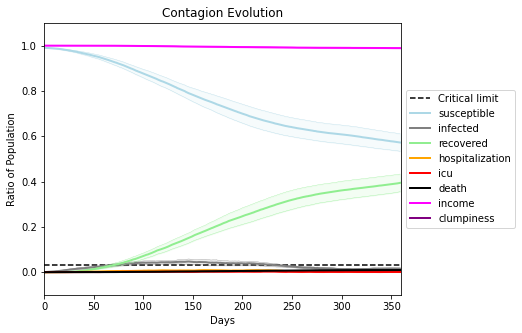

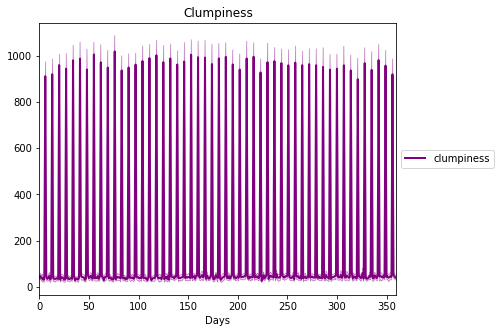

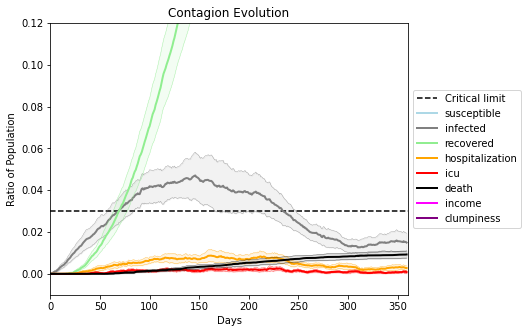

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6253, 341, 1535, 4846, 4419, 3345, 9342, 9654, 4476, 8588, 2676, 5195, 5773, 9212, 2979, 1224, 7561, 5579, 2981, 372]
Average similarity between family members is 0.15385376497328832 at temperature 0
Average similarity between family and home is 0.999856475769215 at temperature -1
Average similarity between students and their classroom is 0.14198042083585846 at temperature 0
Average classroom occupancy is 1.4648648648648648 and number classrooms is 185
Average similarity between workers is 0.15197577691636602 at temperature 0
Average office occupancy is 3.4321608040201004 and number offices is 199
Average friend similarity for adults: 0.21162160992623327 for kids: 0.21228466065082932
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homoge

avg restaurant similarity 0.02799724411527472
avg restaurant similarity 0.021982829258251003
avg restaurant similarity -9.398133854250605e-05
avg restaurant similarity 0.037176959589198276
avg restaurant similarity 0.045461556690866045
avg restaurant similarity 0.09402115995873689
avg restaurant similarity 0.02350463373694359
avg restaurant similarity -0.008792858121236445
avg restaurant similarity 0.03155184836708875
avg restaurant similarity 0.050779842638830376
avg restaurant similarity 0.07072152845701193
avg restaurant similarity 0.035199752186260425
avg restaurant similarity 0.009780743773662505
avg restaurant similarity 0.03746716511555509
avg restaurant similarity 0.014526302163991577
avg restaurant similarity 0.07761904755462475
avg restaurant similarity 0.09341695153786295
avg restaurant similarity 0.04451388211767081
avg restaurant similarity 0.032687035381794335
avg restaurant similarity 0.060102567949777544
avg restaurant similarity 0.0330869793037658
avg restaurant simila

avg restaurant similarity 0.008416550317461902
avg restaurant similarity 0.055485365887479696
avg restaurant similarity 0.0876513242557787
avg restaurant similarity 0.06727135639932541
avg restaurant similarity 0.05785226417785839
avg restaurant similarity 0.046807555441825695
avg restaurant similarity 0.09827620959401108
avg restaurant similarity 0.033037372727674985
avg restaurant similarity 0.0931053286018702
avg restaurant similarity 0.05190395979577243
avg restaurant similarity 0.053570233556150676
avg restaurant similarity 0.07801426314167519
avg restaurant similarity 0.057023981346559886
avg restaurant similarity 0.03445329991011408
avg restaurant similarity 0.03179560199723704
avg restaurant similarity 0.00298975958273887
avg restaurant similarity 0.022431419536908137
avg restaurant similarity 0.034923129462018906
avg restaurant similarity 0.06078159377293206
avg restaurant similarity 0.08235954797511079
avg restaurant similarity 0.01886533445397321
avg restaurant similarity 0.

avg restaurant similarity 0.13661401249603009
avg restaurant similarity 0.06990165513642499
avg restaurant similarity 0.03899729627070829
avg restaurant similarity 0.017173998129198252
avg restaurant similarity 0.030172360210865022
avg restaurant similarity 0.052785642471577326
Average similarity between family members is 0.17263743033096954 at temperature 0
Average similarity between family and home is 0.9998645485811006 at temperature -1
Average similarity between students and their classroom is 0.15285641019111673 at temperature 0
Average classroom occupancy is 1.660919540229885 and number classrooms is 174
Average similarity between workers is 0.17286812103063315 at temperature 0
Average office occupancy is 3.2338308457711444 and number offices is 201
Average friend similarity for adults: 0.21713976314299083 for kids: 0.2168309982017095
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a tot

avg restaurant similarity 0.047953166438661245
avg restaurant similarity 0.017656501330319457
avg restaurant similarity 0.07285747533298924
avg restaurant similarity 0.08717773258129859
avg restaurant similarity 0.06599793201585567
avg restaurant similarity 0.10633865890674142
avg restaurant similarity 0.007235599644914691
avg restaurant similarity 0.08256482242590645
avg restaurant similarity 0.07482266959057211
avg restaurant similarity 0.10908158604516417
avg restaurant similarity 0.0801315422750665
avg restaurant similarity 0.08269837887839807
avg restaurant similarity 0.02651605514225656
avg restaurant similarity 0.042930302114311564
avg restaurant similarity 0.008846399477924783
avg restaurant similarity 0.03006349512448599
avg restaurant similarity 0.07561348221270651
avg restaurant similarity 0.0933176425294211
avg restaurant similarity 0.017118138965187706
avg restaurant similarity 0.04038719297578835
avg restaurant similarity 0.08805022004111085
avg restaurant similarity 0.05

avg restaurant similarity 0.08593497538813687
avg restaurant similarity 0.012654299739447835
avg restaurant similarity 0.0344019502122005
avg restaurant similarity 0.07290785473905793
avg restaurant similarity 0.09332667728773851
avg restaurant similarity 0.06861624526205683
avg restaurant similarity 0.11459655841026745
avg restaurant similarity 0.0729480995762935
avg restaurant similarity 0.09386526765235437
avg restaurant similarity 0.07771760400714328
avg restaurant similarity 0.08887717811360496
avg restaurant similarity 0.05534181563781767
avg restaurant similarity 0.10770210519434349
avg restaurant similarity 0.12291877784248646
avg restaurant similarity 0.0721174460510107
avg restaurant similarity 0.07627200374783287
avg restaurant similarity 0.01760126936018999
avg restaurant similarity 0.07574089900170322
avg restaurant similarity 0.0580965124624106
avg restaurant similarity 0.043944505146897725
avg restaurant similarity 0.12129269039837205
avg restaurant similarity 0.05969969

avg restaurant similarity 0.09272100302494299
avg restaurant similarity 0.015440864103849681
avg restaurant similarity 0.07688934167426976
Average similarity between family members is 0.16132806044963544 at temperature 0
Average similarity between family and home is 0.9998468976648255 at temperature -1
Average similarity between students and their classroom is 0.1643377022277044 at temperature 0
Average classroom occupancy is 1.4943181818181819 and number classrooms is 176
Average similarity between workers is 0.1553650495870427 at temperature 0
Average office occupancy is 3.2829268292682925 and number offices is 205
Average friend similarity for adults: 0.20709888317843775 for kids: 0.20555279717723074
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.0663221324722732
avg restaurant similarity 0.09480053863946565
avg restaurant similarity 0.07060370734287519
avg restaurant similarity 0.03228663446174602
avg restaurant similarity 0.09358628709249109
avg restaurant similarity 0.042501167745226436
avg restaurant similarity 0.06259718232750107
avg restaurant similarity 0.040600532671881136
avg restaurant similarity 0.055259266635901555
avg restaurant similarity 0.07934382315503001
avg restaurant similarity 0.03649245168499132
avg restaurant similarity 0.07999568590950894
avg restaurant similarity 0.07903442731809658
avg restaurant similarity 0.09966978210183952
avg restaurant similarity 0.054503844576704645
avg restaurant similarity 0.06151787705805357
avg restaurant similarity 0.03895742447677653
avg restaurant similarity 0.07583901501008254
avg restaurant similarity 0.08197783721544005
avg restaurant similarity 0.08521517564268476
avg restaurant similarity 0.01789115182230353
avg restaurant similarity 0.097

avg restaurant similarity 0.034914834477746653
avg restaurant similarity 0.04253129336853107
avg restaurant similarity 0.06365744903691214
avg restaurant similarity 0.07659940997918073
avg restaurant similarity 0.049515732090425334
avg restaurant similarity 0.014829269596412762
avg restaurant similarity 0.047560452021759285
avg restaurant similarity 0.09935919570527542
avg restaurant similarity 0.056177268246487
avg restaurant similarity 0.10177511038693693
avg restaurant similarity 0.07879282168366948
avg restaurant similarity 0.0864706301697684
avg restaurant similarity 0.08093214222148683
avg restaurant similarity 0.08610534283799047
avg restaurant similarity 0.05422538908467511
avg restaurant similarity 0.0763500821098027
avg restaurant similarity 0.08864487662668279
avg restaurant similarity 0.06272871650589885
avg restaurant similarity 0.06462491030319689
avg restaurant similarity 0.0845897288632071
avg restaurant similarity 0.07086376004429976
avg restaurant similarity 0.0541869

avg restaurant similarity 0.018077927853881695
avg restaurant similarity 0.10473473596719528
avg restaurant similarity 0.08759266062246032
Average similarity between family members is 0.15040228756467694 at temperature 0
Average similarity between family and home is 0.9998598476143634 at temperature -1
Average similarity between students and their classroom is 0.18237656297281607 at temperature 0
Average classroom occupancy is 1.6046511627906976 and number classrooms is 172
Average similarity between workers is 0.14895730940823157 at temperature 0
Average office occupancy is 3.306532663316583 and number offices is 199
Average friend similarity for adults: 0.2168632319003627 for kids: 0.20047015020050785
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.11203434679582953
avg restaurant similarity 0.02865494372463148
avg restaurant similarity 0.030048402628800073
avg restaurant similarity -0.01681009368537979
avg restaurant similarity 0.042386030005070637
avg restaurant similarity 0.06109350654674531
avg restaurant similarity 0.023508129058986298
avg restaurant similarity -0.002782597730689596
avg restaurant similarity 0.008595593823209272
avg restaurant similarity 0.06628515675134602
avg restaurant similarity 0.048180122934702634
avg restaurant similarity 0.05665742124522431
avg restaurant similarity 0.05712113031037503
avg restaurant similarity 0.06928997297566582
avg restaurant similarity 0.028038352553652817
avg restaurant similarity 0.062157601801270494
avg restaurant similarity 0.09493624737630023
avg restaurant similarity 0.07011371947308195
avg restaurant similarity 0.058121664848475404
avg restaurant similarity 0.040441147192474304
avg restaurant similarity 0.05889318722267911
avg restaurant similar

avg restaurant similarity 0.06737561037259843
avg restaurant similarity 0.017140228616569154
avg restaurant similarity 0.07551647575110901
avg restaurant similarity 0.06197763214908827
avg restaurant similarity 0.049265316773827686
avg restaurant similarity 0.12452921360157804
avg restaurant similarity 0.052704919917625034
avg restaurant similarity 0.06434331842995338
avg restaurant similarity 0.04626458886189791
avg restaurant similarity 0.028948856986606784
avg restaurant similarity 0.07909627851990385
avg restaurant similarity 0.032768332435291654
avg restaurant similarity 0.07090270455441429
avg restaurant similarity 0.0676221945249675
avg restaurant similarity 0.06315979851754751
avg restaurant similarity 0.09400709343032607
avg restaurant similarity 0.053162559455195844
avg restaurant similarity 0.12811802456120394
avg restaurant similarity 0.019541400465796683
avg restaurant similarity 0.010896542734269004
avg restaurant similarity 0.0637366497046612
avg restaurant similarity 0.

avg restaurant similarity 0.06841659259439994
avg restaurant similarity 0.04473891918016083
avg restaurant similarity 0.08852573711494342
avg restaurant similarity 0.03527350114864496
avg restaurant similarity 0.03623943106733303
Average similarity between family members is 0.14278751467602702 at temperature 0
Average similarity between family and home is 0.9998510540646491 at temperature -1
Average similarity between students and their classroom is 0.17651509004675914 at temperature 0
Average classroom occupancy is 1.5714285714285714 and number classrooms is 182
Average similarity between workers is 0.14229671913842026 at temperature 0
Average office occupancy is 3.207920792079208 and number offices is 202
Average friend similarity for adults: 0.20409625221633296 for kids: 0.21021482169931355
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in

avg restaurant similarity 0.10025863191439724
avg restaurant similarity 0.11517261108915494
avg restaurant similarity 0.05886735830117261
avg restaurant similarity 0.07156051338018868
avg restaurant similarity 0.08793549568552614
avg restaurant similarity 0.06094708888644877
avg restaurant similarity 0.10012075666627109
avg restaurant similarity 0.08460118079916645
avg restaurant similarity 0.04796231980265847
avg restaurant similarity 0.10218117595934383
avg restaurant similarity 0.0731850540788289
avg restaurant similarity 0.07052034573321586
avg restaurant similarity 0.08512199001812813
avg restaurant similarity 0.11953919847448537
avg restaurant similarity 0.07659337093364132
avg restaurant similarity 0.05399144894279696
avg restaurant similarity 0.05214354210286768
avg restaurant similarity 0.08890603276305388
avg restaurant similarity 0.058530142148813545
avg restaurant similarity 0.06657623794606986
avg restaurant similarity 0.03397074103645644
avg restaurant similarity 0.090009

avg restaurant similarity 0.07418986239553
avg restaurant similarity 0.06539924628586681
avg restaurant similarity 0.05824758570797043
avg restaurant similarity 0.08611722972014034
avg restaurant similarity 0.020497301181555454
avg restaurant similarity 0.07484413445711652
avg restaurant similarity 0.08427830067617793
avg restaurant similarity 0.05545880092551894
avg restaurant similarity 0.06006945730063366
avg restaurant similarity 0.04666945462920798
avg restaurant similarity 0.048196827472877395
avg restaurant similarity 0.13505505279422172
avg restaurant similarity 0.08760659815251903
avg restaurant similarity 0.08783376734946452
avg restaurant similarity 0.09933087437487423
avg restaurant similarity 0.08650273299594821
avg restaurant similarity 0.07423706099041064
avg restaurant similarity 0.10112896525703377
avg restaurant similarity 0.08169805350889868
avg restaurant similarity 0.08572113617694936
avg restaurant similarity 0.06279294878068407
avg restaurant similarity 0.0901093

avg restaurant similarity 0.1196189453440538
avg restaurant similarity 0.045712046034705536
Average similarity between family members is 0.12802023738400348 at temperature 0
Average similarity between family and home is 0.9998454687374594 at temperature -1
Average similarity between students and their classroom is 0.17424063168848694 at temperature 0
Average classroom occupancy is 1.559782608695652 and number classrooms is 184
Average similarity between workers is 0.15770218518954307 at temperature 0
Average office occupancy is 3.23 and number offices is 200
Average friend similarity for adults: 0.20372460037628703 for kids: 0.2172940647337672
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 

avg restaurant similarity 0.1040866763411437
avg restaurant similarity 0.06785877942799463
avg restaurant similarity 0.10418504117053341
avg restaurant similarity 0.0561115089701144
avg restaurant similarity 0.05766937388644355
avg restaurant similarity 0.07398476411329862
avg restaurant similarity 0.10435673745335529
avg restaurant similarity 0.06381157059772766
avg restaurant similarity 0.07536927321711394
avg restaurant similarity 0.08279099877417592
avg restaurant similarity 0.11084418879376459
avg restaurant similarity 0.0736827679319347
avg restaurant similarity 0.04486696839986547
avg restaurant similarity 0.02831817862163121
avg restaurant similarity 0.0584978748186355
avg restaurant similarity 0.091778671978136
avg restaurant similarity 0.113994332356666
avg restaurant similarity 0.0789888478047347
avg restaurant similarity 0.09188579370396659
avg restaurant similarity 0.061313183836322796
avg restaurant similarity 0.05451745977217789
avg restaurant similarity 0.06294259198317

avg restaurant similarity 0.06559105925005089
avg restaurant similarity 0.11527557232965187
avg restaurant similarity 0.03698127521962156
avg restaurant similarity 0.07191428531705808
avg restaurant similarity 0.09546012598056594
avg restaurant similarity 0.08145157888343638
avg restaurant similarity 0.06942903467638906
avg restaurant similarity 0.05463873749946497
avg restaurant similarity 0.05086216739983178
avg restaurant similarity 0.08732207877172811
avg restaurant similarity 0.0759320683112591
avg restaurant similarity 0.013494287219355553
avg restaurant similarity 0.08042510713083252
avg restaurant similarity 0.09904943766130232
avg restaurant similarity 0.06208942239033449
avg restaurant similarity 0.06241840671906638
avg restaurant similarity 0.07591457904651487
avg restaurant similarity 0.041590587479046995
avg restaurant similarity 0.06739204274006785
avg restaurant similarity 0.1059207239579608
avg restaurant similarity 0.03148370490659874
avg restaurant similarity 0.065266

avg restaurant similarity 0.06157282793060428
avg restaurant similarity 0.05737475116554316
Average similarity between family members is 0.14574803041887383 at temperature 0
Average similarity between family and home is 0.9998653006716381 at temperature -1
Average similarity between students and their classroom is 0.13246551513341032 at temperature 0
Average classroom occupancy is 1.6222222222222222 and number classrooms is 180
Average similarity between workers is 0.14227718475774834 at temperature 0
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.20496982660199625 for kids: 0.21372691283205644
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units 

avg restaurant similarity 0.0267383399175145
avg restaurant similarity 0.07208769448827153
avg restaurant similarity 0.05748506583676204
avg restaurant similarity 0.017959821841770484
avg restaurant similarity 0.02481284447427436
avg restaurant similarity 0.04548674145092366
avg restaurant similarity 0.025500816668213983
avg restaurant similarity 0.013563714160535551
avg restaurant similarity 0.08524534704741152
avg restaurant similarity 0.039100516680991224
avg restaurant similarity 0.047764585819039626
avg restaurant similarity 0.04693213762613748
avg restaurant similarity 0.012201953912600462
avg restaurant similarity 0.01927147212185924
avg restaurant similarity 0.05296025873845213
avg restaurant similarity 0.05134390871184138
avg restaurant similarity 0.01645656957886316
avg restaurant similarity 0.023952873795404592
avg restaurant similarity 0.03555348259207406
avg restaurant similarity 0.07558391142862388
avg restaurant similarity 0.07184615888436649
avg restaurant similarity 0.

avg restaurant similarity 0.04679002174964002
avg restaurant similarity 0.05497699322084789
avg restaurant similarity 0.017408388827308142
avg restaurant similarity 0.06201782577112002
avg restaurant similarity 0.014135748749604488
avg restaurant similarity -0.0158425944788844
avg restaurant similarity -0.0022310033035097226
avg restaurant similarity 0.022242525676369328
avg restaurant similarity 0.0730896648850859
avg restaurant similarity 0.012661198202671838
avg restaurant similarity 0.03517389305490337
avg restaurant similarity 0.1273030001018424
avg restaurant similarity 0.09013586398209261
avg restaurant similarity 0.03727774230922151
avg restaurant similarity 0.07902449699947652
avg restaurant similarity 0.11187592643709386
avg restaurant similarity 0.07797255948765552
avg restaurant similarity 0.06425669057868515
avg restaurant similarity 0.06435999580558037
avg restaurant similarity 0.0294952009540646
avg restaurant similarity 0.04965214304634342
avg restaurant similarity 0.04

avg restaurant similarity 0.0699372774227549
avg restaurant similarity 0.08178030061722716
avg restaurant similarity 0.04463324582807747
avg restaurant similarity 0.06501779721619491
avg restaurant similarity 0.0483278425415996
Average similarity between family members is 0.15611268617801433 at temperature 0
Average similarity between family and home is 0.9998604362456154 at temperature -1
Average similarity between students and their classroom is 0.19473728906381527 at temperature 0
Average classroom occupancy is 1.6257309941520468 and number classrooms is 171
Average similarity between workers is 0.17673129659526982 at temperature 0
Average office occupancy is 3.298507462686567 and number offices is 201
Average friend similarity for adults: 0.20789674466439817 for kids: 0.21268202508379572
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in t

avg restaurant similarity 0.04494668088947302
avg restaurant similarity 0.07280027115540173
avg restaurant similarity 0.001658655631188875
avg restaurant similarity 0.07674989885075488
avg restaurant similarity 0.014904271977485218
avg restaurant similarity 0.07128960635729024
avg restaurant similarity 0.0632676532812963
avg restaurant similarity 0.06569217390633451
avg restaurant similarity 0.03791270216397708
avg restaurant similarity 0.06192197921194087
avg restaurant similarity 0.04301732080991844
avg restaurant similarity -0.01264245831592143
avg restaurant similarity -0.02122772279556868
avg restaurant similarity 0.03685099070237519
avg restaurant similarity 0.02450400181045546
avg restaurant similarity 0.0517029644963329
avg restaurant similarity 0.03521015717148699
avg restaurant similarity 0.02312624183231551
avg restaurant similarity 0.0326810017744911
avg restaurant similarity 0.03694915419372957
avg restaurant similarity -0.006852482738921077
avg restaurant similarity 0.019

avg restaurant similarity 0.060985018056073474
avg restaurant similarity 0.03881222193755895
avg restaurant similarity 0.0967407725358734
avg restaurant similarity 0.12207354249650663
avg restaurant similarity 0.048801384401042314
avg restaurant similarity 0.0018949495990684608
avg restaurant similarity 0.042425766288076226
avg restaurant similarity 0.06687740408895781
avg restaurant similarity 0.03966369424077151
avg restaurant similarity -0.0036794787048704328
avg restaurant similarity -0.010207878308872419
avg restaurant similarity 0.030433219123602067
avg restaurant similarity 0.06706877744012531
avg restaurant similarity 0.04525130602777967
avg restaurant similarity -0.0246743662430361
avg restaurant similarity 0.0021162269034559053
avg restaurant similarity 0.07482477414575889
avg restaurant similarity 0.08720688814705274
avg restaurant similarity 0.026113051167328667
avg restaurant similarity 0.02388106369313868
avg restaurant similarity 0.006082303060819236
avg restaurant simil

avg restaurant similarity 0.0946892781169882
avg restaurant similarity 0.043537365833719754
avg restaurant similarity 0.0710078180278089
avg restaurant similarity 0.01585469603077238
avg restaurant similarity -9.237821536644941e-05
avg restaurant similarity 0.05838152279276224
Average similarity between family members is 0.15740066836875796 at temperature 0
Average similarity between family and home is 0.9998516011105417 at temperature -1
Average similarity between students and their classroom is 0.18182514740445158 at temperature 0
Average classroom occupancy is 1.580110497237569 and number classrooms is 181
Average similarity between workers is 0.15817046832444784 at temperature 0
Average office occupancy is 3.234146341463415 and number offices is 205
Average friend similarity for adults: 0.2055444339915499 for kids: 0.21291566318853525
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total

avg restaurant similarity 0.09655973814292508
avg restaurant similarity -0.023669426971454476
avg restaurant similarity 0.040726933086619885
avg restaurant similarity 0.05293700032950895
avg restaurant similarity 0.0274664732043211
avg restaurant similarity 0.027049827531248846
avg restaurant similarity 0.07827275818532889
avg restaurant similarity 0.07563242294185388
avg restaurant similarity 0.03514988760202201
avg restaurant similarity 0.06318513395395803
avg restaurant similarity 0.05959222386119262
avg restaurant similarity 0.04612668095889579
avg restaurant similarity 0.06168280627385998
avg restaurant similarity 0.07389429860516471
avg restaurant similarity 0.05995540322368061
avg restaurant similarity 0.051039388120627194
avg restaurant similarity 0.12405223427558727
avg restaurant similarity 0.033219127006291725
avg restaurant similarity 0.07097434589676282
avg restaurant similarity 0.03672189241940977
avg restaurant similarity 0.0376752935381804
avg restaurant similarity -0.0

avg restaurant similarity 0.03641284743520591
avg restaurant similarity 0.1101645218581689
avg restaurant similarity 0.03330005036164426
avg restaurant similarity 0.02647213592866075
avg restaurant similarity 0.08124487808270389
avg restaurant similarity 0.04644926481284968
avg restaurant similarity 0.06385037906701117
avg restaurant similarity 0.057580812789610504
avg restaurant similarity 0.027258671152916563
avg restaurant similarity 0.0851628193456491
avg restaurant similarity 0.04145411689356682
avg restaurant similarity 0.025211625120739767
avg restaurant similarity 0.004677600977401533
avg restaurant similarity 0.0625984574969912
avg restaurant similarity 0.08704957463448683
avg restaurant similarity 0.05193058474866827
avg restaurant similarity 0.06290458474388623
avg restaurant similarity 0.06207901298476497
avg restaurant similarity 0.0637020446636402
avg restaurant similarity 0.07372617740066856
avg restaurant similarity 0.08757757458452459
avg restaurant similarity 0.074350

avg restaurant similarity 0.049472694817717995
avg restaurant similarity 0.0705141068855754
avg restaurant similarity 0.09792645548999412
avg restaurant similarity 0.04057843496086939
Average similarity between family members is 0.16524435329474316 at temperature 0
Average similarity between family and home is 0.9998481690848983 at temperature -1
Average similarity between students and their classroom is 0.22098979375113323 at temperature 0
Average classroom occupancy is 1.6127167630057804 and number classrooms is 173
Average similarity between workers is 0.1196589545700964 at temperature 0
Average office occupancy is 3.2807881773399017 and number offices is 203
Average friend similarity for adults: 0.21080099203308153 for kids: 0.2208101700069327
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.08231940465058063
avg restaurant similarity 0.02747870869568881
avg restaurant similarity 0.046707380823883635
avg restaurant similarity 0.033484186000413516
avg restaurant similarity 0.013901239300801883
avg restaurant similarity 0.02134873659841045
avg restaurant similarity 0.042750738488951286
avg restaurant similarity 0.09358411364498852
avg restaurant similarity 0.07436878693557801
avg restaurant similarity 0.03816463672067376
avg restaurant similarity 0.06425628029385332
avg restaurant similarity 0.0484603798721936
avg restaurant similarity 0.06584742368416945
avg restaurant similarity 0.04461924482056782
avg restaurant similarity 0.02860998238688465
avg restaurant similarity 0.10404405041130303
avg restaurant similarity 0.06480228303351017
avg restaurant similarity 0.04040064601051106
avg restaurant similarity 0.0465295856073241
avg restaurant similarity 0.06676832067724311
avg restaurant similarity 0.029971551450664182
avg restaurant similarity 0.024

avg restaurant similarity 0.07583353803036234
avg restaurant similarity 0.029353160827885274
avg restaurant similarity 0.02776278336350788
avg restaurant similarity 0.013683507240010002
avg restaurant similarity 0.0454586347281517
avg restaurant similarity 0.043870312241419136
avg restaurant similarity 0.0027798729767766358
avg restaurant similarity 0.04473322657779054
avg restaurant similarity 0.05744181823655706
avg restaurant similarity 0.06537135590273795
avg restaurant similarity 0.0713469428231151
avg restaurant similarity 0.06684906358143228
avg restaurant similarity 0.05230793650901562
avg restaurant similarity 0.021446945927171474
avg restaurant similarity 0.0705981756917579
avg restaurant similarity 0.09455911423331322
avg restaurant similarity 0.02447334463158409
avg restaurant similarity 0.07962032271974362
avg restaurant similarity 0.04204826269625533
avg restaurant similarity 0.009320047853440294
avg restaurant similarity 0.055438808858850844
avg restaurant similarity 0.0

avg restaurant similarity 0.09815403854663977
avg restaurant similarity 0.06114290207656965
avg restaurant similarity 0.04079656127596922
avg restaurant similarity -0.000538478722379815
Average similarity between family members is 0.12735037407226754 at temperature 0
Average similarity between family and home is 0.99984728289456 at temperature -1
Average similarity between students and their classroom is 0.1665809215396699 at temperature 0
Average classroom occupancy is 1.6111111111111112 and number classrooms is 180
Average similarity between workers is 0.1413714137004211 at temperature 0
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.2002317949596106 for kids: 0.21521624856010663
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.05231150112983525
avg restaurant similarity 0.06277893207430553
avg restaurant similarity 0.07527341496135892
avg restaurant similarity 0.028782034338883145
avg restaurant similarity 0.0387147551647717
avg restaurant similarity 0.021585853424308608
avg restaurant similarity 0.06563741885193812
avg restaurant similarity 0.08113674622872609
avg restaurant similarity 0.03399704689857327
avg restaurant similarity 0.0029062846789547356
avg restaurant similarity 0.024481339680697444
avg restaurant similarity 0.03936735806346866
avg restaurant similarity 0.06786668117727432
avg restaurant similarity 0.058992783051085795
avg restaurant similarity 0.06565535434158373
avg restaurant similarity 0.06233842096314972
avg restaurant similarity 0.04064028393595542
avg restaurant similarity 0.08002518208881734
avg restaurant similarity 0.07449228270911606
avg restaurant similarity 0.05741550285134156
avg restaurant similarity 0.020293169940368973
avg restaurant similarity 0.

avg restaurant similarity 0.015420796067442233
avg restaurant similarity 0.004081147106570234
avg restaurant similarity 0.09112011824259886
avg restaurant similarity 0.06795218907090167
avg restaurant similarity 0.0474261639727212
avg restaurant similarity 0.05935046895119603
avg restaurant similarity 0.0804349017292475
avg restaurant similarity 0.0674365454143322
avg restaurant similarity 0.05650127026796684
avg restaurant similarity 0.06206412813602484
avg restaurant similarity 0.02444009423987403
avg restaurant similarity 0.07573736810429947
avg restaurant similarity 0.05823646831046572
avg restaurant similarity 0.046975511009133254
avg restaurant similarity 0.08430913448324183
avg restaurant similarity 0.06690306751076996
avg restaurant similarity 0.054695338718478065
avg restaurant similarity 0.05853089069168201
avg restaurant similarity 0.13884454130794574
avg restaurant similarity 0.09312854565523002
avg restaurant similarity 0.03612257516088943
avg restaurant similarity 0.04832

avg restaurant similarity 0.044119546444858736
avg restaurant similarity 0.03663756940540586
avg restaurant similarity 0.05464960671660866
avg restaurant similarity 0.03307779208704975
Average similarity between family members is 0.14163663431549112 at temperature 0
Average similarity between family and home is 0.9998416156455393 at temperature -1
Average similarity between students and their classroom is 0.15737619136952685 at temperature 0
Average classroom occupancy is 1.5706521739130435 and number classrooms is 184
Average similarity between workers is 0.14800875812504563 at temperature 0
Average office occupancy is 3.237623762376238 and number offices is 202
Average friend similarity for adults: 0.20591138980144277 for kids: 0.19954221640684427
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 B

avg restaurant similarity 0.01810134100655665
avg restaurant similarity 0.02960587564777375
avg restaurant similarity 0.08592490545468914
avg restaurant similarity 0.13139428069660244
avg restaurant similarity 0.08725030451691183
avg restaurant similarity 0.05491782139605036
avg restaurant similarity 0.0391700488539248
avg restaurant similarity 0.16454299853248483
avg restaurant similarity 0.04770747080994419
avg restaurant similarity 0.004501780994857308
avg restaurant similarity 0.1098260486308296
avg restaurant similarity 0.028079657290463005
avg restaurant similarity 0.041433529349582714
avg restaurant similarity 0.15589427474524548
avg restaurant similarity 0.07090233450539087
avg restaurant similarity 0.03827357716207667
avg restaurant similarity 0.06619304242713983
avg restaurant similarity 0.026375535398025843
avg restaurant similarity 0.034358188745822256
avg restaurant similarity 0.03368708118512238
avg restaurant similarity 0.060044749134635735
avg restaurant similarity 0.01

avg restaurant similarity 0.09475353925563645
avg restaurant similarity 0.062348764702187844
avg restaurant similarity 0.030274213178776547
avg restaurant similarity 0.06604195499621225
avg restaurant similarity 0.021716664373137167
avg restaurant similarity 0.050554753121465644
avg restaurant similarity 0.06460798220001458
avg restaurant similarity 0.031469858743243026
avg restaurant similarity 0.04821976647598155
avg restaurant similarity 0.05550400544983785
avg restaurant similarity 0.01262687879355859
avg restaurant similarity 0.08678199465023398
avg restaurant similarity 0.07170502820530793
avg restaurant similarity 0.006887821524927151
avg restaurant similarity 0.06281994458507739
avg restaurant similarity 0.07134857944519372
avg restaurant similarity 0.025225147757525896
avg restaurant similarity 0.04498175116320612
avg restaurant similarity 0.042928666662665864
avg restaurant similarity 0.07225557948583632
avg restaurant similarity 0.11514657132393909
avg restaurant similarity 

avg restaurant similarity 0.04864636485789638
avg restaurant similarity 0.12102232421605594
avg restaurant similarity 0.06510505831916188
avg restaurant similarity 0.0485897513138431
Average similarity between family members is 0.1660006466084869 at temperature 0
Average similarity between family and home is 0.9998633848380543 at temperature -1
Average similarity between students and their classroom is 0.16771690117376167 at temperature 0
Average classroom occupancy is 1.6629213483146068 and number classrooms is 178
Average similarity between workers is 0.14376314478873103 at temperature 0
Average office occupancy is 3.269035532994924 and number offices is 197
Average friend similarity for adults: 0.20573701656222448 for kids: 0.212354185336055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.014692446514575238
avg restaurant similarity 0.04750755329475492
avg restaurant similarity 0.018426623492166838
avg restaurant similarity 0.057829503672231816
avg restaurant similarity 0.05424964558419864
avg restaurant similarity 0.0700531340279523
avg restaurant similarity 0.03307427702755288
avg restaurant similarity 0.06409396820943958
avg restaurant similarity 0.0854629236261065
avg restaurant similarity 0.06145396685252855
avg restaurant similarity 0.06863342639516794
avg restaurant similarity 0.047861155660046506
avg restaurant similarity 0.014237763266645762
avg restaurant similarity 0.057501927090352734
avg restaurant similarity 0.0520749623297133
avg restaurant similarity 0.0613443283417298
avg restaurant similarity 0.03828103043165389
avg restaurant similarity 0.05981111186287217
avg restaurant similarity 0.014396960258803765
avg restaurant similarity -0.003317021670810138
avg restaurant similarity 0.05947698269056379
avg restaurant similarity 0.1

avg restaurant similarity 0.13989985915058775
avg restaurant similarity 0.06871909298036201
avg restaurant similarity 0.03663679082215477
avg restaurant similarity 0.09853318832823085
avg restaurant similarity 0.03218502221520143
avg restaurant similarity 0.04066974117438731
avg restaurant similarity 0.06232888216373267
avg restaurant similarity 0.03334732579892022
avg restaurant similarity 0.061660306390595755
avg restaurant similarity 0.036032574212206486
avg restaurant similarity 0.05552457356226266
avg restaurant similarity 0.10226646514238678
avg restaurant similarity 0.01717856449064989
avg restaurant similarity 0.06240882798371734
avg restaurant similarity 0.0769824964689186
avg restaurant similarity 0.09159317151613151
avg restaurant similarity 0.08845395333925303
avg restaurant similarity 0.0341100256213469
avg restaurant similarity 0.061880855239417915
avg restaurant similarity 0.03777491267040851
avg restaurant similarity 0.005700203103616368
avg restaurant similarity 0.0300

avg restaurant similarity 0.008747365032852577
avg restaurant similarity 0.041746894634564734
avg restaurant similarity 0.04041487847783707
avg restaurant similarity 0.07353149912303668
Average similarity between family members is 0.13569501446095605 at temperature 0
Average similarity between family and home is 0.999857885375169 at temperature -1
Average similarity between students and their classroom is 0.12033370418016402 at temperature 0
Average classroom occupancy is 1.5666666666666667 and number classrooms is 180
Average similarity between workers is 0.17135901145540203 at temperature 0
Average office occupancy is 3.3333333333333335 and number offices is 201
Average friend similarity for adults: 0.20628066851245988 for kids: 0.20747047999949667
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity 0.051680899992481946
avg restaurant similarity 0.1122617391260813
avg restaurant similarity 0.06372767619713306
avg restaurant similarity 0.08132773273263887
avg restaurant similarity 0.03459252655109943
avg restaurant similarity 0.07381217555486373
avg restaurant similarity 0.04432961909479741
avg restaurant similarity 0.09092199025865866
avg restaurant similarity 0.031036229948185334
avg restaurant similarity 0.08783519133019636
avg restaurant similarity 0.04982594018648234
avg restaurant similarity 0.04186844044312099
avg restaurant similarity 0.05407763096944628
avg restaurant similarity 0.03527308186452616
avg restaurant similarity 0.10923142550006831
avg restaurant similarity 0.11867594298191315
avg restaurant similarity 0.03166114709759153
avg restaurant similarity 0.06729061391739898
avg restaurant similarity 0.06156231008754445
avg restaurant similarity 0.04414074231279334
avg restaurant similarity 0.01952277420639967
avg restaurant similarity 0.01697

avg restaurant similarity 0.06166984013459619
avg restaurant similarity 0.04142274894856646
avg restaurant similarity 0.06715592800300825
avg restaurant similarity 0.10002832484204871
avg restaurant similarity 0.05360906027100968
avg restaurant similarity 0.023133832224399
avg restaurant similarity 0.007714342934512919
avg restaurant similarity 0.03745870312055635
avg restaurant similarity -0.013661772181166331
avg restaurant similarity 0.10351331234055534
avg restaurant similarity 0.077451586662405
avg restaurant similarity 0.0458769634860563
avg restaurant similarity 0.021045166169728183
avg restaurant similarity 0.033231218760687145
avg restaurant similarity -0.0007140872823928728
avg restaurant similarity 0.093241505719208
avg restaurant similarity 0.024776977920816526
avg restaurant similarity 0.04157719879305338
avg restaurant similarity 0.06319961667221644
avg restaurant similarity 0.10954966541800236
avg restaurant similarity 0.053978761993698
avg restaurant similarity 0.081384

avg restaurant similarity 0.06007328971778398
avg restaurant similarity 0.04360088346045914
avg restaurant similarity 0.056746409602276074
avg restaurant similarity 0.0689980061421022
Average similarity between family members is 0.14013409525808523 at temperature 0
Average similarity between family and home is 0.9998519105554029 at temperature -1
Average similarity between students and their classroom is 0.1522564328346417 at temperature 0
Average classroom occupancy is 1.6195652173913044 and number classrooms is 184
Average similarity between workers is 0.1537127428864949 at temperature 0
Average office occupancy is 3.221105527638191 and number offices is 199
Average friend similarity for adults: 0.21073358547774185 for kids: 0.21116824497956949
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buil

avg restaurant similarity 0.049994404960678175
avg restaurant similarity 0.0634131301740151
avg restaurant similarity 0.088409774432355
avg restaurant similarity 0.05843535414345702
avg restaurant similarity 0.0007307000266878779
avg restaurant similarity 0.013541197277674352
avg restaurant similarity 0.08818352707783007
avg restaurant similarity 0.046263671971099235
avg restaurant similarity 0.08646465164403382
avg restaurant similarity 0.1278903165526135
avg restaurant similarity 0.12073692093035286
avg restaurant similarity 0.05370168772161814
avg restaurant similarity 0.08250723088323829
avg restaurant similarity 0.04376456804648012
avg restaurant similarity 0.0327978962437331
avg restaurant similarity 0.04530578410163107
avg restaurant similarity 0.04483475353047295
avg restaurant similarity 0.051795391122280786
avg restaurant similarity 0.03540928561672577
avg restaurant similarity 0.07171843339695791
avg restaurant similarity 0.09908878896812412
avg restaurant similarity 0.08298

avg restaurant similarity 0.03797700227317668
avg restaurant similarity 0.10824016765460966
avg restaurant similarity 0.03854864968095664
avg restaurant similarity 0.04538671118453561
avg restaurant similarity 0.058580805737890956
avg restaurant similarity 0.06637762915880141
avg restaurant similarity 0.06041800974797056
avg restaurant similarity 0.06264249593008368
avg restaurant similarity 0.04476724937462393
avg restaurant similarity 0.04705488057603575
avg restaurant similarity 0.015660500649372702
avg restaurant similarity 0.049869042195793745
avg restaurant similarity 0.046958563446127005
avg restaurant similarity 0.07086466346932604
avg restaurant similarity 0.08751733476544898
avg restaurant similarity 0.04115254974195358
avg restaurant similarity 0.08974153137574288
avg restaurant similarity 0.03556468865184184
avg restaurant similarity 0.0331843576461531
avg restaurant similarity 0.004215566609044811
avg restaurant similarity 0.06611645088043255
avg restaurant similarity 0.05

avg restaurant similarity 0.0988114132842147
avg restaurant similarity 0.01857256774528405
avg restaurant similarity 0.05011497424573698
avg restaurant similarity 0.013301757860287276
Average similarity between family members is 0.13342476988331195 at temperature 0
Average similarity between family and home is 0.9998549682561353 at temperature -1
Average similarity between students and their classroom is 0.19253162691003375 at temperature 0
Average classroom occupancy is 1.5375722543352601 and number classrooms is 173
Average similarity between workers is 0.16032946655143476 at temperature 0
Average office occupancy is 3.3054187192118225 and number offices is 203
Average friend similarity for adults: 0.2084446984530432 for kids: 0.21360644659253897
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 28 people.
Total of 28 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.05109956927101676
avg restaurant similarity 0.08997742966704442
avg restaurant similarity 0.05989063496514434
avg restaurant similarity 0.05895926230184051
avg restaurant similarity 0.05879328516568182
avg restaurant similarity 0.07158420509275695
avg restaurant similarity 0.04399372408290225
avg restaurant similarity 0.06600978022877414
avg restaurant similarity 0.04772041700131307
avg restaurant similarity 0.007853714416657779
avg restaurant similarity 0.028831066535681554
avg restaurant similarity 0.05108288097603134
avg restaurant similarity 0.07802297143837648
avg restaurant similarity 0.0261831989817727
avg restaurant similarity 0.05031152604065375
avg restaurant similarity 0.033398208255614695
avg restaurant similarity 0.04700571346604752
avg restaurant similarity 0.07777603887687413
avg restaurant similarity 0.023427838485302707
avg restaurant similarity 0.04636697775334371
avg restaurant similarity 0.0357967588841894
avg restaurant similarity 0.0738

avg restaurant similarity 0.06314657118640382
avg restaurant similarity 0.06595941724642655
avg restaurant similarity 0.04599387040844384
avg restaurant similarity 0.06125994124481431
avg restaurant similarity 0.03327824691402414
avg restaurant similarity 0.06230211387480585
avg restaurant similarity 0.05737210609664073
avg restaurant similarity 0.13091385184938387
avg restaurant similarity 0.07100156283307917
avg restaurant similarity 0.054083617370862154
avg restaurant similarity 0.06467628349765404
avg restaurant similarity 0.07302811782088714
avg restaurant similarity 0.07029257396558893
avg restaurant similarity 0.01994605337562975
avg restaurant similarity 0.016261863523446062
avg restaurant similarity 0.05926400955582124
avg restaurant similarity 0.04744565564960464
avg restaurant similarity 0.03215032732281818
avg restaurant similarity 0.04819356041713185
avg restaurant similarity 0.049248086919606505
avg restaurant similarity 0.05500758591690405
avg restaurant similarity 0.065

avg restaurant similarity 0.0443134594042979
avg restaurant similarity 0.03432983093525874
avg restaurant similarity 0.033207656388606205
avg restaurant similarity 0.020427854147856736
Average similarity between family members is 0.17438052591359832 at temperature 0
Average similarity between family and home is 0.9998584647516018 at temperature -1
Average similarity between students and their classroom is 0.15694729164160945 at temperature 0
Average classroom occupancy is 1.6497175141242937 and number classrooms is 177
Average similarity between workers is 0.15408148311698627 at temperature 0
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.21281758329027062 for kids: 0.21640115482780803
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 

avg restaurant similarity 0.06312019965243854
avg restaurant similarity 0.08944551785224422
avg restaurant similarity 0.06116659717258667
avg restaurant similarity 0.07173915572309023
avg restaurant similarity 0.09255024585221672
avg restaurant similarity 0.03065073999695315
avg restaurant similarity 0.0597114818884901
avg restaurant similarity 0.026285214409821886
avg restaurant similarity 0.038854748541740536
avg restaurant similarity 0.07374266024562551
avg restaurant similarity 0.03140177390518465
avg restaurant similarity 0.06191411541570844
avg restaurant similarity 0.08330951595159326
avg restaurant similarity 0.061336124569384996
avg restaurant similarity 0.05220740645196627
avg restaurant similarity -0.0029436227016101345
avg restaurant similarity 0.058286596165784035
avg restaurant similarity 0.049911783704901395
avg restaurant similarity 0.06747249051923736
avg restaurant similarity 0.06370666728351658
avg restaurant similarity 0.06393651743984816
avg restaurant similarity 0

avg restaurant similarity 0.0066985192875104295
avg restaurant similarity 0.05671383541668932
avg restaurant similarity 0.05022724094375471
avg restaurant similarity 0.030487446374606132
avg restaurant similarity 2.7393590539465856e-05
avg restaurant similarity 0.07407616949171769
avg restaurant similarity 0.05023592881342722
avg restaurant similarity 0.0344922034185571
avg restaurant similarity 0.07078082545379757
avg restaurant similarity 0.07733323278205466
avg restaurant similarity 0.04567829608311326
avg restaurant similarity 0.0445346266564724
avg restaurant similarity 0.048659193902402864
avg restaurant similarity 0.02177316481537859
avg restaurant similarity -0.028516664366795397
avg restaurant similarity 0.014706182213728337
avg restaurant similarity 0.013094967404306535
avg restaurant similarity 0.031860946006538465
avg restaurant similarity 0.0649225559419794
avg restaurant similarity 0.020521767527776805
avg restaurant similarity 0.03321554131503848
avg restaurant similarit

avg restaurant similarity 0.13280523540968703
avg restaurant similarity 0.024929837857456165
avg restaurant similarity 0.06919329546162661
avg restaurant similarity 0.06190073584264953
avg restaurant similarity 0.004883484091907568
Average similarity between family members is 0.12818297133215475 at temperature 0
Average similarity between family and home is 0.999850807439423 at temperature -1
Average similarity between students and their classroom is 0.18659132288143795 at temperature 0
Average classroom occupancy is 1.6726190476190477 and number classrooms is 168
Average similarity between workers is 0.1382456607754213 at temperature 0
Average office occupancy is 3.292079207920792 and number offices is 202
Average friend similarity for adults: 0.21077924144372542 for kids: 0.2050014862762821
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in th

avg restaurant similarity 0.05885059936249992
avg restaurant similarity 0.0829354444590083
avg restaurant similarity 0.08843021133450096
avg restaurant similarity 0.07814358534436357
avg restaurant similarity 0.05796266137500105
avg restaurant similarity 0.05225878750326274
avg restaurant similarity 0.050414921502840035
avg restaurant similarity 0.11091992783683832
avg restaurant similarity 0.07270763074834566
avg restaurant similarity 0.047627091685849186
avg restaurant similarity 0.11777864373455589
avg restaurant similarity 0.027620859069392715
avg restaurant similarity 0.07937569502895728
avg restaurant similarity 0.07746814658952898
avg restaurant similarity 0.046769918097477575
avg restaurant similarity 0.024535358776161722
avg restaurant similarity 0.0031027202231742306
avg restaurant similarity 0.016613807086459313
avg restaurant similarity 0.06066213671453066
avg restaurant similarity 0.04464738157778931
avg restaurant similarity 0.08965386642927972
avg restaurant similarity 0

avg restaurant similarity 0.03622473400444408
avg restaurant similarity 0.016620975114434732
avg restaurant similarity 0.05534557927537234
avg restaurant similarity 0.014468655078073411
avg restaurant similarity 0.03344054729467602
avg restaurant similarity 0.08266331925482076
avg restaurant similarity 0.04584177982123049
avg restaurant similarity 0.056258217637610464
avg restaurant similarity 0.07369987133001955
avg restaurant similarity 0.06276068705699522
avg restaurant similarity 0.02393316081946888
avg restaurant similarity 0.0596869600772827
avg restaurant similarity 0.12288406292366441
avg restaurant similarity 0.046508078470552015
avg restaurant similarity 0.05381765839383661
avg restaurant similarity 0.026744241995663505
avg restaurant similarity 0.04224334644615894
avg restaurant similarity 0.032778874430004226
avg restaurant similarity 0.06481165538484127
avg restaurant similarity 0.08637365473396294
avg restaurant similarity 0.03391755245875401
avg restaurant similarity 0.0

avg restaurant similarity 0.023020594871300582
avg restaurant similarity 0.018554695941303184
avg restaurant similarity 0.07832463185080563
avg restaurant similarity 0.04389812691957239
Average similarity between family members is 0.152490861552989 at temperature 0
Average similarity between family and home is 0.9998516734342665 at temperature -1
Average similarity between students and their classroom is 0.16723229356231953 at temperature 0
Average classroom occupancy is 1.5435897435897437 and number classrooms is 195
Average similarity between workers is 0.15835124714293514 at temperature 0
Average office occupancy is 3.353846153846154 and number offices is 195
Average friend similarity for adults: 0.21437557232104978 for kids: 0.22352611851144444
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 

avg restaurant similarity 0.0834127391537121
avg restaurant similarity 0.06801830690066782
avg restaurant similarity 0.03800365152580255
avg restaurant similarity 0.09130434729236231
avg restaurant similarity 0.06742913248008768
avg restaurant similarity 0.06803569480602908
avg restaurant similarity 0.07432124721690099
avg restaurant similarity 0.0636679689774897
avg restaurant similarity 0.0611586975240599
avg restaurant similarity 0.07460407831198251
avg restaurant similarity 0.0974187606330589
avg restaurant similarity 0.06515290084963338
avg restaurant similarity 0.07777298356207227
avg restaurant similarity 0.10884773769280008
avg restaurant similarity 0.04616733260483118
avg restaurant similarity 0.07381282640929158
avg restaurant similarity 0.02014807282309
avg restaurant similarity 0.06684801061609927
avg restaurant similarity 0.04999255048892798
avg restaurant similarity 0.05473672705185017
avg restaurant similarity 0.08195480436278436
avg restaurant similarity 0.0504544993642

avg restaurant similarity 0.026534628826453657
avg restaurant similarity 0.031705950338001075
avg restaurant similarity 0.08435308204738613
avg restaurant similarity 0.04481809249681818
avg restaurant similarity 0.082404763171053
avg restaurant similarity 0.05998554028231031
avg restaurant similarity 0.04936240772864178
avg restaurant similarity 0.05827049755175944
avg restaurant similarity 0.057865698781290796
avg restaurant similarity 0.057436442259467375
avg restaurant similarity 0.06240964096999291
avg restaurant similarity 0.05663349443149692
avg restaurant similarity 0.06369819019582565
avg restaurant similarity 0.0714410762198487
avg restaurant similarity 0.05948247919658035
avg restaurant similarity 0.07381159449326959
avg restaurant similarity 0.06869834074000948
avg restaurant similarity 0.05162028004752816
avg restaurant similarity 0.05699199578070877
avg restaurant similarity 0.04652014614315734
avg restaurant similarity 0.033196065208331016
avg restaurant similarity 0.0337

avg restaurant similarity 0.06619932764498815
avg restaurant similarity 0.06039951747479944
avg restaurant similarity 0.07760780937152931
Average similarity between family members is 0.13277863754103103 at temperature 0
Average similarity between family and home is 0.9998578650008391 at temperature -1
Average similarity between students and their classroom is 0.20798422665424637 at temperature 0
Average classroom occupancy is 1.4944444444444445 and number classrooms is 180
Average similarity between workers is 0.1776605002063533 at temperature 0
Average office occupancy is 3.4129353233830844 and number offices is 201
Average friend similarity for adults: 0.21240436974785812 for kids: 0.22462117765754155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.0655617085731453
avg restaurant similarity 0.05102122348118538
avg restaurant similarity 0.08481955468643866
avg restaurant similarity 0.050071997890900284
avg restaurant similarity 0.08209342039450035
avg restaurant similarity 0.06593719954058239
avg restaurant similarity 0.07025930742506581
avg restaurant similarity 0.08984608157451393
avg restaurant similarity 0.10938687156216119
avg restaurant similarity 0.11302157585151194
avg restaurant similarity 0.04222518666092202
avg restaurant similarity 0.10831415713501143
avg restaurant similarity 0.07161869888242552
avg restaurant similarity 0.03164851393942765
avg restaurant similarity 0.07345448196688821
avg restaurant similarity 0.06061460717676231
avg restaurant similarity 0.0806748355431397
avg restaurant similarity 0.09278952932315969
avg restaurant similarity 0.057428856639748296
avg restaurant similarity 0.06472976859317868
avg restaurant similarity 0.06075388572985269
avg restaurant similarity 0.067069

avg restaurant similarity 0.0765863930449309
avg restaurant similarity 0.0992344533099424
avg restaurant similarity 0.07008805446396041
avg restaurant similarity 0.06538787285666767
avg restaurant similarity 0.07963359294559012
avg restaurant similarity 0.03441500343812546
avg restaurant similarity 0.044221799870139286
avg restaurant similarity 0.11775337297774863
avg restaurant similarity 0.04540676267550494
avg restaurant similarity 0.013284710053043498
avg restaurant similarity 0.06025387884615254
avg restaurant similarity 0.06344322394994971
avg restaurant similarity 0.09949927185429142
avg restaurant similarity 0.060098686350378294
avg restaurant similarity 0.07881307689605709
avg restaurant similarity 0.03382492583948155
avg restaurant similarity 0.059941140574573525
avg restaurant similarity 0.037574586802869
avg restaurant similarity 0.09202302194634066
avg restaurant similarity 0.05223800381902675
avg restaurant similarity 0.02406808180083486
avg restaurant similarity 0.071888

avg restaurant similarity 0.047552286560269476
avg restaurant similarity 0.07680961163678457
avg restaurant similarity 0.031561279162063874
using average of time series:
stats on susceptible:
data: [0.8390333333333334, 0.7409055555555556, 0.7864416666666667, 0.7213666666666667, 0.7215534465534466, 0.7796138888888889, 0.8355555555555556, 0.86465, 0.6344305555555555, 0.7144444444444444, 0.6438333333333333, 0.7654111111111112, 0.720475, 0.7972222222222223, 0.745736111111111, 0.8303194444444445, 0.8148277777777778, 0.8217555555555556, 0.7266416666666667, 0.7015888888888888]
min:
0.6344305555555555
max:
0.86465
std:
0.0625025694411316
mean:
0.7602903112165612
median:
0.7555736111111111
95% confidence interval for the mean:
(0.7302782868505298,0.7903023355825927)
using average of time series:
stats on infected:
data: [0.018233333333333334, 0.034069444444444444, 0.02813055555555556, 0.025869444444444445, 0.02830780330780331, 0.02387777777777778, 0.019761111111111115, 0.0149, 0.037177777777777

(<function dict.items>, <function dict.items>, <function dict.items>)

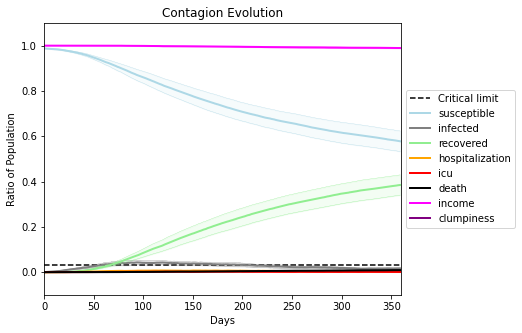

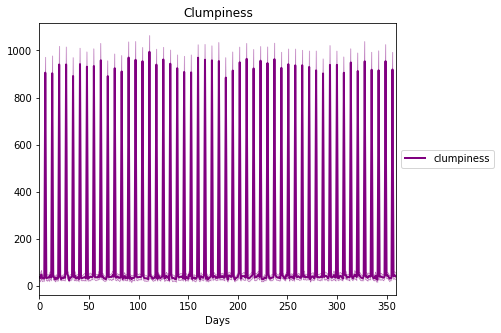

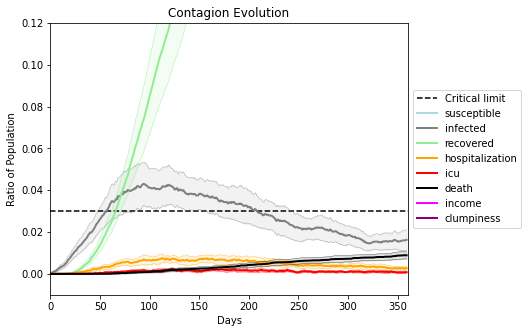

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[441, 8357, 691, 2127, 8129, 2844, 7484, 7503, 1640, 145, 600, 9472, 2899, 9996, 6048, 7811, 5154, 7367, 1558, 7191]
Average similarity between family members is 0.10290871422166643 at temperature 0.33
Average similarity between family and home is 0.9998440688257918 at temperature -1
Average similarity between students and their classroom is 0.09578619862994335 at temperature 0.33
Average classroom occupancy is 1.537037037037037 and number classrooms is 162
Average similarity between workers is 0.107270997345631 at temperature 0.33
Average office occupancy is 3.400990099009901 and number offices is 202
Average friend similarity for adults: 0.16159498981409384 for kids: 0.17556734184230918
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Ho

avg restaurant similarity 0.058899983997646475
avg restaurant similarity 0.024038864747023988
avg restaurant similarity 0.031600327117338727
avg restaurant similarity 0.0074566328269578454
avg restaurant similarity 0.026913348477442072
avg restaurant similarity 0.07636938560119967
avg restaurant similarity 0.0008216526614177299
avg restaurant similarity -0.004521228781458157
avg restaurant similarity 0.10478453352205311
avg restaurant similarity 0.04893800049955548
avg restaurant similarity 0.042981028331603055
avg restaurant similarity 0.039761728245689965
avg restaurant similarity 0.005185087834886146
avg restaurant similarity 0.07478507508748326
avg restaurant similarity -0.0013061505741706642
avg restaurant similarity 0.10217170759047868
avg restaurant similarity -0.016950038748353092
avg restaurant similarity 0.04385950105957971
avg restaurant similarity 0.0927158214116931
avg restaurant similarity -0.0030974955330308356
avg restaurant similarity 0.0745432162459971
avg restaurant 

avg restaurant similarity 0.0027666358472796127
avg restaurant similarity 0.036279624149466824
avg restaurant similarity 0.03982722877692784
avg restaurant similarity 0.05866290923991579
avg restaurant similarity 0.017417967139519208
avg restaurant similarity 0.03339141885528902
avg restaurant similarity 0.04035786529099835
avg restaurant similarity 0.05459724937320489
avg restaurant similarity 0.03793259960521693
avg restaurant similarity 0.053032983205012894
avg restaurant similarity -0.015011452709886356
avg restaurant similarity 0.06636632540939688
avg restaurant similarity 0.07127586986134088
avg restaurant similarity 0.023142173119865887
avg restaurant similarity 0.0597286939955033
avg restaurant similarity 0.04772570146033215
avg restaurant similarity 0.03979654200911703
avg restaurant similarity 0.03454181150822303
avg restaurant similarity -0.010123560383259686
avg restaurant similarity 0.03778016508695459
avg restaurant similarity 0.07730598238885052
avg restaurant similarity

avg restaurant similarity 0.018060610475941895
avg restaurant similarity 0.04155467518138911
avg restaurant similarity 0.06020621664709779
avg restaurant similarity 0.05441170663355281
avg restaurant similarity 0.06219009930118075
avg restaurant similarity 0.021032826285530187
Average similarity between family members is 0.08386879102651208 at temperature 0.33
Average similarity between family and home is 0.9998596456525494 at temperature -1
Average similarity between students and their classroom is 0.11754025690828855 at temperature 0.33
Average classroom occupancy is 1.6685393258426966 and number classrooms is 178
Average similarity between workers is 0.11402569159093447 at temperature 0.33
Average office occupancy is 3.242424242424242 and number offices is 198
Average friend similarity for adults: 0.17361716567232438 for kids: 0.1654206348975379
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wi

avg restaurant similarity 0.06231939777074868
avg restaurant similarity 0.09685741803239019
avg restaurant similarity 0.08487660073169773
avg restaurant similarity 0.13068232273826139
avg restaurant similarity 0.06271397709985424
avg restaurant similarity 0.09609119666395761
avg restaurant similarity 0.053056913536161876
avg restaurant similarity 0.04939452934608128
avg restaurant similarity 0.028861773870406303
avg restaurant similarity 0.05680970233511682
avg restaurant similarity 0.08822110284424267
avg restaurant similarity 0.07866827534296857
avg restaurant similarity 0.04311198923267693
avg restaurant similarity 0.07944100446354037
avg restaurant similarity 0.04239943362665318
avg restaurant similarity 0.07109520973394781
avg restaurant similarity 0.0820139518933624
avg restaurant similarity 0.10989481291857141
avg restaurant similarity 0.0927444719669934
avg restaurant similarity 0.05568241621420448
avg restaurant similarity 0.10028929888215625
avg restaurant similarity 0.065858

avg restaurant similarity 0.08973821266155127
avg restaurant similarity 0.0827949764622452
avg restaurant similarity 0.0579794311865923
avg restaurant similarity 0.05113967163389242
avg restaurant similarity 0.05468803091520998
avg restaurant similarity 0.05424828670619944
avg restaurant similarity 0.07442886707866123
avg restaurant similarity 0.06071172887680246
avg restaurant similarity 0.043119326453836815
avg restaurant similarity 0.06678924984518972
avg restaurant similarity 0.04384532381910714
avg restaurant similarity 0.05052057556392527
avg restaurant similarity 0.05000511740093983
avg restaurant similarity 0.12105808423059718
avg restaurant similarity 0.05818151349807688
avg restaurant similarity 0.06860692111563194
avg restaurant similarity 0.08510541897086836
avg restaurant similarity 0.0856508387429403
avg restaurant similarity 0.05620545838931964
avg restaurant similarity 0.08002499975409967
avg restaurant similarity 0.07542690724431704
avg restaurant similarity 0.00832712

avg restaurant similarity 0.07113101604140758
avg restaurant similarity 0.06939262501037677
avg restaurant similarity 0.1092498179391442
Average similarity between family members is 0.0987253422592585 at temperature 0.33
Average similarity between family and home is 0.999862219066304 at temperature -1
Average similarity between students and their classroom is 0.12710438433885618 at temperature 0.33
Average classroom occupancy is 1.5873015873015872 and number classrooms is 189
Average similarity between workers is 0.13082844059117188 at temperature 0.33
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.17049942111513802 for kids: 0.16333851507335886
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.06630443838172072
avg restaurant similarity 0.05758211147931279
avg restaurant similarity 0.05080689437624503
avg restaurant similarity 0.08736616450942881
avg restaurant similarity 0.03754769949129677
avg restaurant similarity -0.018103546020333282
avg restaurant similarity 0.06282370005737264
avg restaurant similarity 0.04623519621741302
avg restaurant similarity 0.03898123377393402
avg restaurant similarity 0.02761706975670327
avg restaurant similarity 0.07501427191144129
avg restaurant similarity 0.06040372052977205
avg restaurant similarity 0.08557101313670697
avg restaurant similarity 0.07560195339020444
avg restaurant similarity 0.03884157947906817
avg restaurant similarity 0.07375427365022237
avg restaurant similarity 0.07509981995334734
avg restaurant similarity 0.0415878343560014
avg restaurant similarity 0.07600882576942267
avg restaurant similarity 0.043526208156355446
avg restaurant similarity 0.11858115835063812
avg restaurant similarity 0.0614

avg restaurant similarity 0.07009455979441323
avg restaurant similarity 0.06660905917342536
avg restaurant similarity 0.04021595574885268
avg restaurant similarity 0.05076323339953878
avg restaurant similarity 0.06109969217342886
avg restaurant similarity 0.0942628284873581
avg restaurant similarity 0.04312124982600798
avg restaurant similarity 0.08015997740854305
avg restaurant similarity 0.05160626420793007
avg restaurant similarity 0.07021203928646427
avg restaurant similarity 0.03406131053788297
avg restaurant similarity 0.04590324611422126
avg restaurant similarity 0.06369487495045191
avg restaurant similarity 0.03544985002499979
avg restaurant similarity 0.017886475080661234
avg restaurant similarity 0.08021576983523118
avg restaurant similarity 0.0253448689379819
avg restaurant similarity 0.07847756698134656
avg restaurant similarity 0.07954384596523127
avg restaurant similarity 0.06884130885719512
avg restaurant similarity 0.10262771084282384
avg restaurant similarity 0.1055042

avg restaurant similarity 0.06974684066188998
avg restaurant similarity 0.10532089668461708
avg restaurant similarity 0.02379430159256954
avg restaurant similarity 0.07652690293871123
Average similarity between family members is 0.1178745942648595 at temperature 0.33
Average similarity between family and home is 0.9998527431410458 at temperature -1
Average similarity between students and their classroom is 0.12001281487375524 at temperature 0.33
Average classroom occupancy is 1.5126903553299493 and number classrooms is 197
Average similarity between workers is 0.08195824825683434 at temperature 0.33
Average office occupancy is 3.2549019607843137 and number offices is 204
Average friend similarity for adults: 0.16796211240751224 for kids: 0.18170363022146202
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity -0.020341765944040455
avg restaurant similarity 0.04935738279837059
avg restaurant similarity 0.09757451261023245
avg restaurant similarity 0.06266348443646566
avg restaurant similarity 0.038953316604000345
avg restaurant similarity 0.04900682851826087
avg restaurant similarity 0.05678640477022185
avg restaurant similarity 0.11378119837324842
avg restaurant similarity 0.046042984964910216
avg restaurant similarity 0.028531666635151956
avg restaurant similarity 0.024350553197776122
avg restaurant similarity 0.013402781315341575
avg restaurant similarity -0.0017902054480258445
avg restaurant similarity 0.014754019463896283
avg restaurant similarity 0.03799346557648139
avg restaurant similarity 0.06192776432882995
avg restaurant similarity 0.04857599132990596
avg restaurant similarity 0.0900784928754494
avg restaurant similarity 0.037336342066980964
avg restaurant similarity 0.01461476933267853
avg restaurant similarity 0.041098075984368945
avg restaurant similar

avg restaurant similarity 0.054508420102380974
avg restaurant similarity 0.046752861454164005
avg restaurant similarity 0.038320017980179664
avg restaurant similarity 0.06555991441994564
avg restaurant similarity 0.11159091939942667
avg restaurant similarity 0.09615955961250879
avg restaurant similarity 0.025313910988282347
avg restaurant similarity 0.02506172199754151
avg restaurant similarity 0.012863778830083824
avg restaurant similarity 0.011692480854566251
avg restaurant similarity -0.018839830354108023
avg restaurant similarity 0.10049392044468179
avg restaurant similarity 0.06045505663249756
avg restaurant similarity 0.04941500537453457
avg restaurant similarity 0.0806985563808426
avg restaurant similarity 0.06951957804341943
avg restaurant similarity 0.07795265888049596
avg restaurant similarity 0.04778653615294325
avg restaurant similarity 0.051950479391902706
avg restaurant similarity 0.020728904187421026
avg restaurant similarity 0.058297077178227366
avg restaurant similarit

avg restaurant similarity 0.046506084661013594
avg restaurant similarity 0.03632634860681671
avg restaurant similarity 0.02008881341358423
avg restaurant similarity 0.02677328596402253
avg restaurant similarity 0.01765037339450836
avg restaurant similarity 0.044690684408632865
Average similarity between family members is 0.09825503829243541 at temperature 0.33
Average similarity between family and home is 0.9998544629914271 at temperature -1
Average similarity between students and their classroom is 0.12148362081639237 at temperature 0.33
Average classroom occupancy is 1.5666666666666667 and number classrooms is 180
Average similarity between workers is 0.08055894418786733 at temperature 0.33
Average office occupancy is 3.2388059701492535 and number offices is 201
Average friend similarity for adults: 0.15625441199175694 for kids: 0.17510863580956332
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units 

avg restaurant similarity 0.026715821075826436
avg restaurant similarity 0.0773376459854291
avg restaurant similarity 0.008676854206818154
avg restaurant similarity 0.0277223405576563
avg restaurant similarity 0.037737113694327445
avg restaurant similarity 0.014268603101562078
avg restaurant similarity 0.04372275638152735
avg restaurant similarity 0.019354677076331206
avg restaurant similarity 0.0364686497158608
avg restaurant similarity 0.018716040622138788
avg restaurant similarity 0.020013118383100117
avg restaurant similarity 0.008139406028490616
avg restaurant similarity 0.0483697479984942
avg restaurant similarity 0.01731608898209928
avg restaurant similarity 0.0194216819758555
avg restaurant similarity 0.024053440010513228
avg restaurant similarity 0.011088221787784503
avg restaurant similarity 0.00918643338849738
avg restaurant similarity 0.02228605246819666
avg restaurant similarity 0.02099145318322397
avg restaurant similarity 0.00020316389873992584
avg restaurant similarity 

avg restaurant similarity 0.016021559072901814
avg restaurant similarity 0.05054234545647727
avg restaurant similarity 0.04361325721682485
avg restaurant similarity 0.04844329255249427
avg restaurant similarity 0.06950455543593013
avg restaurant similarity 0.05872641491992814
avg restaurant similarity 0.024011952288690363
avg restaurant similarity 0.05446785920546854
avg restaurant similarity 0.07221074660214818
avg restaurant similarity 0.0605224269356607
avg restaurant similarity 0.013449632119908784
avg restaurant similarity 0.04895636957888935
avg restaurant similarity 0.006886653299879718
avg restaurant similarity 0.06202506132668755
avg restaurant similarity 0.06644228729410755
avg restaurant similarity 0.02233173675299193
avg restaurant similarity 0.0677211308676618
avg restaurant similarity 0.02424999875806153
avg restaurant similarity 0.01264883473161431
avg restaurant similarity 0.03635986839481462
avg restaurant similarity 0.04345084367067018
avg restaurant similarity 0.0031

avg restaurant similarity 0.023273432802086318
avg restaurant similarity 0.005427847355457651
avg restaurant similarity 0.03452776404889497
avg restaurant similarity -0.014336479145294243
avg restaurant similarity 0.05217439284315155
avg restaurant similarity 0.03497421303713262
avg restaurant similarity -0.005666790499804593
Average similarity between family members is 0.0895672656594124 at temperature 0.33
Average similarity between family and home is 0.9998579312880385 at temperature -1
Average similarity between students and their classroom is 0.1261536964692819 at temperature 0.33
Average classroom occupancy is 1.6853932584269662 and number classrooms is 178
Average similarity between workers is 0.09488028296707444 at temperature 0.33
Average office occupancy is 3.3523316062176165 and number offices is 193
Average friend similarity for adults: 0.15851477663919578 for kids: 0.16536255540897332
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.055484006985914706
avg restaurant similarity 0.01665937458734206
avg restaurant similarity 0.033351878870133196
avg restaurant similarity 0.021664196466059663
avg restaurant similarity -0.022224701161610495
avg restaurant similarity 0.08040750505856771
avg restaurant similarity 0.02494573310953061
avg restaurant similarity 0.03902614612779592
avg restaurant similarity 0.10063745925097045
avg restaurant similarity 0.046194782953756876
avg restaurant similarity 0.006084412174227301
avg restaurant similarity 0.027710589881888143
avg restaurant similarity -0.0009756406339974549
avg restaurant similarity 0.0009616631896124837
avg restaurant similarity 0.08718371038764881
avg restaurant similarity 0.060855588569612734
avg restaurant similarity 0.07696106779433855
avg restaurant similarity 0.050212378074486926
avg restaurant similarity 0.020046724653466536
avg restaurant similarity 0.08681958588204104
avg restaurant similarity 0.06334726257662596
avg restaurant sim

avg restaurant similarity 0.06416977457603211
avg restaurant similarity 0.02188205494292952
avg restaurant similarity -0.00663100161636703
avg restaurant similarity 0.030888663163534575
avg restaurant similarity 0.027241344371915773
avg restaurant similarity 0.02542172717889229
avg restaurant similarity 0.019584295754773766
avg restaurant similarity 0.04800542935392086
avg restaurant similarity 0.037703379560850035
avg restaurant similarity -0.006685915722025818
avg restaurant similarity -0.04635531819393322
avg restaurant similarity 0.0005474164022918064
avg restaurant similarity 0.023485559741585425
avg restaurant similarity 0.013472632783798245
avg restaurant similarity 0.04693464861901909
avg restaurant similarity -0.030393495961418975
avg restaurant similarity 0.0888306838935612
avg restaurant similarity 0.037643166970433184
avg restaurant similarity 0.03233983179205491
avg restaurant similarity 0.03176924601035479
avg restaurant similarity -0.0499338844910156
avg restaurant simil

avg restaurant similarity -0.0008397172459706816
avg restaurant similarity 0.07918734675296069
avg restaurant similarity 0.018533787541000987
avg restaurant similarity 0.03937656107046124
avg restaurant similarity 0.06528698511474501
avg restaurant similarity 0.0437367318158975
avg restaurant similarity 0.02353587561603025
avg restaurant similarity 0.029396859376027876
Average similarity between family members is 0.0959652996730767 at temperature 0.33
Average similarity between family and home is 0.9998566564513492 at temperature -1
Average similarity between students and their classroom is 0.1326976062448746 at temperature 0.33
Average classroom occupancy is 1.6198830409356726 and number classrooms is 171
Average similarity between workers is 0.10265342348120958 at temperature 0.33
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.16858974572507088 for kids: 0.16190493981668128
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.03221401661291901
avg restaurant similarity 0.05482545018950935
avg restaurant similarity 0.02060408363980635
avg restaurant similarity 0.07117866163076549
avg restaurant similarity 0.0415940521991685
avg restaurant similarity 0.06564624711704868
avg restaurant similarity 0.04265173274029985
avg restaurant similarity 0.012233598534816805
avg restaurant similarity 0.04039746099887073
avg restaurant similarity 0.05059463613290578
avg restaurant similarity 0.061171557673771866
avg restaurant similarity 0.04283944078328611
avg restaurant similarity 0.05391912854481346
avg restaurant similarity 0.029320906530568
avg restaurant similarity 0.06808834014334808
avg restaurant similarity 0.06623116911769257
avg restaurant similarity 0.02257371761717655
avg restaurant similarity 0.0649773610755954
avg restaurant similarity 0.03429587213583118
avg restaurant similarity 0.04557330052630833
avg restaurant similarity -0.015225482240814794
avg restaurant similarity 0.096230

avg restaurant similarity 0.07558805372620381
avg restaurant similarity 0.06017152178278173
avg restaurant similarity 0.04209131220464452
avg restaurant similarity -0.0006517046156226073
avg restaurant similarity 0.03832114272953095
avg restaurant similarity 0.10487101817241706
avg restaurant similarity 0.03962848410180824
avg restaurant similarity 0.06062905606320887
avg restaurant similarity 0.06174712878077197
avg restaurant similarity -0.0029384263734867962
avg restaurant similarity 0.04504019145452991
avg restaurant similarity 0.028683816523292154
avg restaurant similarity 0.09020711670548459
avg restaurant similarity -0.038684623911388764
avg restaurant similarity 0.04127471143608474
avg restaurant similarity 0.05249077759332667
avg restaurant similarity 0.06615933289185127
avg restaurant similarity 0.04102876225799133
avg restaurant similarity 0.0779715370934429
avg restaurant similarity 0.01823294483387589
avg restaurant similarity 0.014740604891001721
avg restaurant similarity

avg restaurant similarity 0.02914179253016247
avg restaurant similarity 0.028844895651862424
avg restaurant similarity 0.0670602391705102
avg restaurant similarity 0.06088185108620967
Average similarity between family members is 0.08666379767493296 at temperature 0.33
Average similarity between family and home is 0.9998558632669037 at temperature -1
Average similarity between students and their classroom is 0.12203164321825113 at temperature 0.33
Average classroom occupancy is 1.5885416666666667 and number classrooms is 192
Average similarity between workers is 0.13304253159262205 at temperature 0.33
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.16337752982024495 for kids: 0.16806343686592842
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.025361689975091774
avg restaurant similarity 0.006531452544576609
avg restaurant similarity 0.01864232019438611
avg restaurant similarity 0.025279810482668637
avg restaurant similarity 0.010101051269589066
avg restaurant similarity 0.06059906022845899
avg restaurant similarity 0.028493289131025043
avg restaurant similarity -0.04985415748483157
avg restaurant similarity 0.024386613293053697
avg restaurant similarity 0.011441712002904596
avg restaurant similarity 0.016064760685730574
avg restaurant similarity 0.036242185675271335
avg restaurant similarity 0.02407509654414537
avg restaurant similarity 0.043022290629887695
avg restaurant similarity 0.06979935492197291
avg restaurant similarity -0.026459750758012213
avg restaurant similarity 0.02036075408967463
avg restaurant similarity 0.019886237621586162
avg restaurant similarity 0.01808601243207685
avg restaurant similarity 0.00702120450435244
avg restaurant similarity 0.030810902183629207
avg restaurant simi

avg restaurant similarity -0.0029161789804120907
avg restaurant similarity 0.0444639878010436
avg restaurant similarity 0.00516023581168954
avg restaurant similarity 0.02199434721583194
avg restaurant similarity 0.02388738896259592
avg restaurant similarity 0.07372922031709842
avg restaurant similarity 0.023429377140941347
avg restaurant similarity 0.02989015625886092
avg restaurant similarity 0.03154460675091629
avg restaurant similarity -0.01174053387578787
avg restaurant similarity -0.013083800446152042
avg restaurant similarity 0.004526759226687647
avg restaurant similarity 0.0028787338661933866
avg restaurant similarity 0.01389909012084028
avg restaurant similarity 0.04671510293526079
avg restaurant similarity 0.018666650691367942
avg restaurant similarity 0.049353259358282296
avg restaurant similarity 0.024795817082205955
avg restaurant similarity 0.02180459325825173
avg restaurant similarity -0.009409125930984046
avg restaurant similarity 0.0006798964078640696
avg restaurant sim

avg restaurant similarity -0.009368850224655218
avg restaurant similarity 0.02998785479543428
avg restaurant similarity -0.016674507083404864
avg restaurant similarity 0.06064122398290856
avg restaurant similarity 0.03708952055642501
avg restaurant similarity 0.017160605833665514
avg restaurant similarity 0.027456776030131597
avg restaurant similarity 0.01612121105656489
avg restaurant similarity 0.06219776182244762
Average similarity between family members is 0.10198959282909904 at temperature 0.33
Average similarity between family and home is 0.9998494552022781 at temperature -1
Average similarity between students and their classroom is 0.10783905140691928 at temperature 0.33
Average classroom occupancy is 1.5824742268041236 and number classrooms is 194
Average similarity between workers is 0.09387550415977985 at temperature 0.33
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.16277753391506666 for kids: 0.1654724895502

avg restaurant similarity 0.005493014161803806
avg restaurant similarity 0.027696079526795234
avg restaurant similarity 0.03167531259894178
avg restaurant similarity 0.045410150133502206
avg restaurant similarity 0.025173246186677618
avg restaurant similarity 0.0046069868465685015
avg restaurant similarity 0.03003463809657401
avg restaurant similarity 0.012573022825361551
avg restaurant similarity -0.007296548606029589
avg restaurant similarity 0.04593352212932115
avg restaurant similarity 0.07110148283696058
avg restaurant similarity 0.05077163515656806
avg restaurant similarity 0.02607919423746021
avg restaurant similarity -0.0017492054739502215
avg restaurant similarity 0.053850084347418774
avg restaurant similarity 0.012324263661715405
avg restaurant similarity 0.013134786754332124
avg restaurant similarity 0.03360100416203124
avg restaurant similarity 0.030878625804491723
avg restaurant similarity -0.005177669623438273
avg restaurant similarity 0.03994006028580678
avg restaurant s

avg restaurant similarity 0.013422734238838241
avg restaurant similarity 0.03830443639973378
avg restaurant similarity 0.06976288361469736
avg restaurant similarity 0.04030171075058029
avg restaurant similarity 0.033685827487820785
avg restaurant similarity 0.028216536248557588
avg restaurant similarity 0.07830395801892942
avg restaurant similarity -0.028905925416861992
avg restaurant similarity 0.04881622487772179
avg restaurant similarity 0.01256722165240966
avg restaurant similarity 0.04133213680266865
avg restaurant similarity 0.035262592770575904
avg restaurant similarity 0.06618090115577464
avg restaurant similarity 0.04323131147869472
avg restaurant similarity 0.0523947978216127
avg restaurant similarity 0.03485221067005178
avg restaurant similarity 0.008892978966632532
avg restaurant similarity 0.05729349059263291
avg restaurant similarity 0.04600924139610194
avg restaurant similarity 0.039768323820646045
avg restaurant similarity 0.08852303046775803
avg restaurant similarity 0

avg restaurant similarity 0.054571438492026655
avg restaurant similarity 0.0701761576946882
avg restaurant similarity 0.004506593602835603
avg restaurant similarity 0.026070259158374732
avg restaurant similarity 0.06752846341943909
avg restaurant similarity 0.015441733247196493
avg restaurant similarity 0.033334809529170305
avg restaurant similarity -0.02368591490001189
Average similarity between family members is 0.09339319114333891 at temperature 0.33
Average similarity between family and home is 0.9998489798985919 at temperature -1
Average similarity between students and their classroom is 0.08603624006994208 at temperature 0.33
Average classroom occupancy is 1.5555555555555556 and number classrooms is 171
Average similarity between workers is 0.08271502221517982 at temperature 0.33
Average office occupancy is 3.476923076923077 and number offices is 195
Average friend similarity for adults: 0.16681640288792007 for kids: 0.17324813077834744
home_districts
[
Home (0,0) district with 1

avg restaurant similarity 0.040133452714787306
avg restaurant similarity 0.06894066479629686
avg restaurant similarity 0.043820674516704246
avg restaurant similarity 0.03251928490627182
avg restaurant similarity 0.0523175506704785
avg restaurant similarity 0.011189432823723446
avg restaurant similarity 0.030772740928605758
avg restaurant similarity 0.023598280064416156
avg restaurant similarity 0.03336569148093567
avg restaurant similarity -0.002386635854394872
avg restaurant similarity 0.03539653737364524
avg restaurant similarity 0.013518565208416343
avg restaurant similarity 0.034393687138445046
avg restaurant similarity 0.02075713697583155
avg restaurant similarity 0.051614195872803
avg restaurant similarity 0.038510397829074276
avg restaurant similarity 0.057946624128012596
avg restaurant similarity 0.056680750446348765
avg restaurant similarity 0.005334057086094171
avg restaurant similarity 0.06829645979478849
avg restaurant similarity 0.012107921605683572
avg restaurant similari

avg restaurant similarity -0.004014597320776093
avg restaurant similarity 0.06006613078980586
avg restaurant similarity 0.0501365271096888
avg restaurant similarity 0.03354051757396501
avg restaurant similarity 0.02350309838324329
avg restaurant similarity 0.0557193953160315
avg restaurant similarity 0.03939123328767223
avg restaurant similarity 0.06865572587623076
avg restaurant similarity 0.040782232747344056
avg restaurant similarity 0.01379270534764878
avg restaurant similarity -0.025963911921653527
avg restaurant similarity 0.0459192876701054
avg restaurant similarity 0.004363019244530649
avg restaurant similarity 0.019345245027581028
avg restaurant similarity 0.056031078218918465
avg restaurant similarity 0.0262303635489224
avg restaurant similarity 0.014226468339712693
avg restaurant similarity 0.03644670121049451
avg restaurant similarity 0.0098618046067781
avg restaurant similarity 0.003984008729394915
avg restaurant similarity 0.056251739554868965
avg restaurant similarity 0.

avg restaurant similarity 0.04752987623254757
avg restaurant similarity 0.015609514564014805
avg restaurant similarity -0.0003818625960023165
avg restaurant similarity 0.028481356306631494
avg restaurant similarity -0.0009083241943178845
avg restaurant similarity 0.0293467829854049
avg restaurant similarity 0.03134655437157367
avg restaurant similarity 0.025302205029509313
Average similarity between family members is 0.11989580788446 at temperature 0.33
Average similarity between family and home is 0.9998562300214692 at temperature -1
Average similarity between students and their classroom is 0.15348463534731807 at temperature 0.33
Average classroom occupancy is 1.5654761904761905 and number classrooms is 168
Average similarity between workers is 0.10318539399179477 at temperature 0.33
Average office occupancy is 3.436548223350254 and number offices is 197
Average friend similarity for adults: 0.17094718444091614 for kids: 0.16974878499334414
home_districts
[
Home (0,0) district with 1

avg restaurant similarity 0.05749136935786101
avg restaurant similarity 0.061367822453531624
avg restaurant similarity 0.046517207079394995
avg restaurant similarity 0.07130269285407591
avg restaurant similarity 0.0752803557659506
avg restaurant similarity 0.07031100640836874
avg restaurant similarity 0.06574662426291712
avg restaurant similarity 0.07156008823209835
avg restaurant similarity 0.08011448843470147
avg restaurant similarity 0.049503868234305415
avg restaurant similarity 0.05278714649022136
avg restaurant similarity 0.05745782411660966
avg restaurant similarity 0.08458295784320273
avg restaurant similarity 0.06567117235225196
avg restaurant similarity 0.058081060630518114
avg restaurant similarity 0.07268873214952597
avg restaurant similarity 0.0467394879412761
avg restaurant similarity 0.05986840756517807
avg restaurant similarity 0.09361102725553187
avg restaurant similarity 0.07339366707428915
avg restaurant similarity 0.0926001558826995
avg restaurant similarity 0.04359

avg restaurant similarity 0.08056219728080162
avg restaurant similarity 0.08356053731420346
avg restaurant similarity 0.0480781754792043
avg restaurant similarity 0.07039862547714128
avg restaurant similarity 0.0014057991739659815
avg restaurant similarity 0.09548787243957786
avg restaurant similarity 0.05646755997583202
avg restaurant similarity 0.08756810339933539
avg restaurant similarity 0.043908006758320066
avg restaurant similarity 0.08310433575021496
avg restaurant similarity 0.0982552315307982
avg restaurant similarity 0.05298131900935437
avg restaurant similarity 0.05557999823001635
avg restaurant similarity 0.07207944069005404
avg restaurant similarity 0.06945350343560039
avg restaurant similarity 0.05486212399996072
avg restaurant similarity 0.07442181030378728
avg restaurant similarity 0.011150323203638221
avg restaurant similarity 0.0623702883324644
avg restaurant similarity 0.06110225831569384
avg restaurant similarity 0.030410506477932295
avg restaurant similarity 0.0447

avg restaurant similarity 0.06983194868892005
avg restaurant similarity 0.024397088032156438
avg restaurant similarity 0.050483661278963726
avg restaurant similarity 0.07458772949537171
Average similarity between family members is 0.08175286669959786 at temperature 0.33
Average similarity between family and home is 0.9998525961646855 at temperature -1
Average similarity between students and their classroom is 0.15087647832466788 at temperature 0.33
Average classroom occupancy is 1.6043956043956045 and number classrooms is 182
Average similarity between workers is 0.11153497381711758 at temperature 0.33
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.17193906830152225 for kids: 0.17418684788764988
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) distri

avg restaurant similarity 0.03760275454800605
avg restaurant similarity 0.04139319343647776
avg restaurant similarity 0.09194428874768727
avg restaurant similarity 0.06287451571438613
avg restaurant similarity 0.03788149308393839
avg restaurant similarity 0.018398799049819274
avg restaurant similarity 0.03759605458041841
avg restaurant similarity 0.10921616785133544
avg restaurant similarity 0.04252694121751031
avg restaurant similarity 0.06592942930070929
avg restaurant similarity 0.05944801045611077
avg restaurant similarity 0.07186202935206733
avg restaurant similarity 0.03152327577442611
avg restaurant similarity 0.035695494332560015
avg restaurant similarity 0.03041274622895072
avg restaurant similarity 0.060507812096005927
avg restaurant similarity 0.028610693934822122
avg restaurant similarity 0.045410489790442904
avg restaurant similarity 0.007419061155552264
avg restaurant similarity 0.039281826322016336
avg restaurant similarity 0.02101964432122746
avg restaurant similarity 0

avg restaurant similarity 0.041308099176661
avg restaurant similarity 0.03169584853022519
avg restaurant similarity 0.0706854146796955
avg restaurant similarity 0.030585196131229606
avg restaurant similarity 0.048240766961823695
avg restaurant similarity 0.04516487753281054
avg restaurant similarity 0.0716972904559922
avg restaurant similarity 0.04238352095500616
avg restaurant similarity 0.06112578190891609
avg restaurant similarity 0.06940096837090408
avg restaurant similarity 0.06571749594732251
avg restaurant similarity 0.05471768101412768
avg restaurant similarity 0.042346207843399056
avg restaurant similarity -0.03466090933104257
avg restaurant similarity 0.05954228290783063
avg restaurant similarity 0.0407659015261733
avg restaurant similarity -0.020599378909273904
avg restaurant similarity 0.02517590952754665
avg restaurant similarity -0.027288109132169395
avg restaurant similarity 0.02816933723388518
avg restaurant similarity 0.016878686249481894
avg restaurant similarity 0.01

avg restaurant similarity 0.09990388817347864
avg restaurant similarity 0.04875647070977155
avg restaurant similarity 0.018545705983331974
avg restaurant similarity 0.03832207553295548
avg restaurant similarity 0.05310481841308397
avg restaurant similarity 0.04421468999703638
Average similarity between family members is 0.08749309889211816 at temperature 0.33
Average similarity between family and home is 0.9998557130424506 at temperature -1
Average similarity between students and their classroom is 0.13764856354629648 at temperature 0.33
Average classroom occupancy is 1.619047619047619 and number classrooms is 168
Average similarity between workers is 0.10019210574354835 at temperature 0.33
Average office occupancy is 3.398009950248756 and number offices is 201
Average friend similarity for adults: 0.16437523849598726 for kids: 0.18120475327849672
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wit

avg restaurant similarity 0.07206989323779446
avg restaurant similarity 0.032351991405797705
avg restaurant similarity -0.02161135450479551
avg restaurant similarity 0.02243271687469943
avg restaurant similarity 0.03695924531138976
avg restaurant similarity 0.002921996738570436
avg restaurant similarity -0.0005785305783560005
avg restaurant similarity 0.00913485414262329
avg restaurant similarity -0.011559929177673739
avg restaurant similarity 0.044444054946862946
avg restaurant similarity 0.025767750423286436
avg restaurant similarity 0.04555268575526766
avg restaurant similarity -0.01620252245204578
avg restaurant similarity 0.03301524124309372
avg restaurant similarity 0.06167900094685925
avg restaurant similarity 0.020799396931332786
avg restaurant similarity 0.05217315981445802
avg restaurant similarity -0.012006330607528239
avg restaurant similarity 0.018246493991883703
avg restaurant similarity 0.03866453599634846
avg restaurant similarity -0.01180699484407478
avg restaurant sim

avg restaurant similarity -0.011503946558410005
avg restaurant similarity 0.046092942953254515
avg restaurant similarity 0.06423188763252323
avg restaurant similarity 0.04916738622744336
avg restaurant similarity 0.07318697743408056
avg restaurant similarity 0.07020046259964438
avg restaurant similarity 0.02276631853624044
avg restaurant similarity 0.054969529732730706
avg restaurant similarity -0.003981037868053629
avg restaurant similarity 0.03674858743700598
avg restaurant similarity 0.030155750352042387
avg restaurant similarity 0.038266174898668244
avg restaurant similarity 0.04021200652385296
avg restaurant similarity 0.04236753322710981
avg restaurant similarity 0.01766506381606096
avg restaurant similarity 0.021233571042190428
avg restaurant similarity 0.0715870038688026
avg restaurant similarity -0.01017570501425211
avg restaurant similarity 0.0057842746661232606
avg restaurant similarity 0.030398077102650196
avg restaurant similarity -0.029074122218433772
avg restaurant simil

avg restaurant similarity 0.05500235919261265
avg restaurant similarity 0.03823252397603316
avg restaurant similarity 0.04095318741954295
avg restaurant similarity 0.022100356850569613
avg restaurant similarity 0.019578523210845692
avg restaurant similarity 0.032026955163706614
avg restaurant similarity -0.027563676711625996
avg restaurant similarity -0.023705676545463288
Average similarity between family members is 0.09913001542990406 at temperature 0.33
Average similarity between family and home is 0.9998549822468236 at temperature -1
Average similarity between students and their classroom is 0.11606436695845643 at temperature 0.33
Average classroom occupancy is 1.5307262569832403 and number classrooms is 179
Average similarity between workers is 0.11974678833069728 at temperature 0.33
Average office occupancy is 3.310344827586207 and number offices is 203
Average friend similarity for adults: 0.16743109473289786 for kids: 0.17227236124257997
home_districts
[
Home (0,0) district with

avg restaurant similarity 0.04223337446522561
avg restaurant similarity 0.0855215446550268
avg restaurant similarity 0.06268946425238481
avg restaurant similarity -0.0045700846696558545
avg restaurant similarity 0.04594688764144548
avg restaurant similarity 0.05142557280741624
avg restaurant similarity 0.03185424105757089
avg restaurant similarity 0.047316330448707755
avg restaurant similarity 0.03500178880628976
avg restaurant similarity 0.00040617592192828767
avg restaurant similarity 0.007393050142187777
avg restaurant similarity 0.0668093615112072
avg restaurant similarity 0.052452852816284444
avg restaurant similarity 0.021889645913382366
avg restaurant similarity -0.004045066885230611
avg restaurant similarity 0.06543100698866124
avg restaurant similarity -0.0027022957626079186
avg restaurant similarity 0.020740788184273273
avg restaurant similarity 0.06030394974955684
avg restaurant similarity 0.03696488267067162
avg restaurant similarity 0.030307334898632035
avg restaurant simi

avg restaurant similarity 0.024163873781712444
avg restaurant similarity 0.06472413620681178
avg restaurant similarity 0.03742852273036755
avg restaurant similarity 0.044424678690619626
avg restaurant similarity 0.010807038751696633
avg restaurant similarity 0.007404864010623623
avg restaurant similarity 0.046400181922618224
avg restaurant similarity -0.010476052439873465
avg restaurant similarity 0.025965540629119748
avg restaurant similarity 0.03327498741500746
avg restaurant similarity 0.04611741123534646
avg restaurant similarity 0.03136234384140366
avg restaurant similarity 0.022583840189166583
avg restaurant similarity 0.10395749913329697
avg restaurant similarity 0.0079725202078097
avg restaurant similarity 0.06273446110071683
avg restaurant similarity 0.04202100593286375
avg restaurant similarity 0.05001212492243907
avg restaurant similarity 0.0487110485390407
avg restaurant similarity 0.08748563171133518
avg restaurant similarity 0.08020400612426946
avg restaurant similarity 0

avg restaurant similarity 0.03058724379892797
avg restaurant similarity 0.03276370378029572
avg restaurant similarity 0.029186496351162373
avg restaurant similarity 0.060564596074225416
avg restaurant similarity 0.05511901389300224
avg restaurant similarity 0.040155925837404606
Average similarity between family members is 0.08253525549558544 at temperature 0.33
Average similarity between family and home is 0.9998614034466282 at temperature -1
Average similarity between students and their classroom is 0.094439661409074 at temperature 0.33
Average classroom occupancy is 1.5561224489795917 and number classrooms is 196
Average similarity between workers is 0.09390219135690128 at temperature 0.33
Average office occupancy is 3.227722772277228 and number offices is 202
Average friend similarity for adults: 0.1603090535794455 for kids: 0.17425799019601274
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units wit

avg restaurant similarity 0.05886528519461118
avg restaurant similarity 0.07586055915967728
avg restaurant similarity 0.03687954124607485
avg restaurant similarity 0.034761693263139784
avg restaurant similarity 0.055416438165327306
avg restaurant similarity 0.04444110037458361
avg restaurant similarity 0.05546204698355044
avg restaurant similarity 0.05040402191975438
avg restaurant similarity 0.05637155874572502
avg restaurant similarity 0.028593919142492784
avg restaurant similarity 0.04285948562030444
avg restaurant similarity 0.02155075362464823
avg restaurant similarity -0.0022498080718209358
avg restaurant similarity 0.05053191354689975
avg restaurant similarity 0.07531812743289891
avg restaurant similarity 0.07974722419420102
avg restaurant similarity 0.04081218587870591
avg restaurant similarity -0.0023677490065885307
avg restaurant similarity 0.03411729729633897
avg restaurant similarity 0.094194221720619
avg restaurant similarity 0.03263563597360149
avg restaurant similarity 0

avg restaurant similarity 0.055013959244404755
avg restaurant similarity 0.04265963358836327
avg restaurant similarity 0.04137769132696535
avg restaurant similarity 0.03203362739339864
avg restaurant similarity 0.05892244473037153
avg restaurant similarity 0.0353592786277127
avg restaurant similarity 0.027063297204467
avg restaurant similarity 0.04322772773842944
avg restaurant similarity 0.05448825853695072
avg restaurant similarity 0.05371033610891291
avg restaurant similarity 0.024010583614615888
avg restaurant similarity 0.08472927481888282
avg restaurant similarity 0.06597139587195404
avg restaurant similarity 0.05850919749741176
avg restaurant similarity 0.056726569429661075
avg restaurant similarity 0.05570938796113648
avg restaurant similarity -0.008111098526413181
avg restaurant similarity 0.06424889332280198
avg restaurant similarity 0.039884186439594474
avg restaurant similarity 0.014449142916368986
avg restaurant similarity -0.0182632937141076
avg restaurant similarity 0.09

avg restaurant similarity 0.08015877833409298
avg restaurant similarity 0.05898263086555912
avg restaurant similarity 0.04918770153009056
avg restaurant similarity 0.05109794370540629
avg restaurant similarity 0.007131293161631472
Average similarity between family members is 0.07802018441125591 at temperature 0.33
Average similarity between family and home is 0.9998656261327286 at temperature -1
Average similarity between students and their classroom is 0.10488568586527434 at temperature 0.33
Average classroom occupancy is 1.6615384615384616 and number classrooms is 195
Average similarity between workers is 0.11814067785090321 at temperature 0.33
Average office occupancy is 3.063106796116505 and number offices is 206
Average friend similarity for adults: 0.1630113228123413 for kids: 0.1784117364422404
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allo

avg restaurant similarity 0.025470072600002055
avg restaurant similarity 0.04480059735692493
avg restaurant similarity 0.03665514817002305
avg restaurant similarity 0.08240011043614234
avg restaurant similarity 0.07229399721373994
avg restaurant similarity 0.060816243418636895
avg restaurant similarity 0.07021843881638803
avg restaurant similarity 0.05748082334175599
avg restaurant similarity 0.08605775208407028
avg restaurant similarity 0.07130276620855897
avg restaurant similarity 0.11084916990717678
avg restaurant similarity 0.07522608467990856
avg restaurant similarity 0.07299781007891418
avg restaurant similarity 0.07117340471843646
avg restaurant similarity 0.052931461631798925
avg restaurant similarity 0.011617837215922714
avg restaurant similarity 0.13618690051745552
avg restaurant similarity 0.022403288072921503
avg restaurant similarity 0.06617953493931598
avg restaurant similarity 0.06853368684985303
avg restaurant similarity 0.06668075775616189
avg restaurant similarity 0.0

avg restaurant similarity 0.027995208867302224
avg restaurant similarity -0.010690489595834737
avg restaurant similarity -0.004347378995183693
avg restaurant similarity 0.015577203178903641
avg restaurant similarity 0.053797664116606275
avg restaurant similarity 0.024737300755877045
avg restaurant similarity 0.028427642483863806
avg restaurant similarity 0.08729817228630352
avg restaurant similarity 0.012722890472655037
avg restaurant similarity 0.10191189870154564
avg restaurant similarity 0.0661995653251436
avg restaurant similarity 0.032939443537850055
avg restaurant similarity 0.031097849787452555
avg restaurant similarity 0.02832683742682555
avg restaurant similarity -0.040079405966410284
avg restaurant similarity 0.0680154838135234
avg restaurant similarity 0.031622091222412906
avg restaurant similarity 0.07915142320663285
avg restaurant similarity 0.06905728071018345
avg restaurant similarity 0.06355440600975205
avg restaurant similarity 0.03858257604560328
avg restaurant simila

avg restaurant similarity 0.046387519936943775
avg restaurant similarity 0.06780693487186892
avg restaurant similarity 0.0390259225024933
avg restaurant similarity 0.05587732406959396
avg restaurant similarity 0.02869390567508392
avg restaurant similarity -0.002200261457472985
Average similarity between family members is 0.09882851323053166 at temperature 0.33
Average similarity between family and home is 0.9998587953408937 at temperature -1
Average similarity between students and their classroom is 0.15432945312741836 at temperature 0.33
Average classroom occupancy is 1.5054945054945055 and number classrooms is 182
Average similarity between workers is 0.13701394078433454 at temperature 0.33
Average office occupancy is 3.3251231527093594 and number offices is 203
Average friend similarity for adults: 0.1744207579745992 for kids: 0.17334843226649246
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units w

avg restaurant similarity 0.035189470653324124
avg restaurant similarity 0.04137122982952028
avg restaurant similarity 0.026960881361804932
avg restaurant similarity -0.013047313796105514
avg restaurant similarity 0.04534838651811387
avg restaurant similarity -0.006899719544700661
avg restaurant similarity 0.043486718796048755
avg restaurant similarity 0.08115528875176845
avg restaurant similarity 0.015516484481970622
avg restaurant similarity 0.06407188342873744
avg restaurant similarity 0.038439490796925706
avg restaurant similarity 0.06430275976417453
avg restaurant similarity 0.06386710318843607
avg restaurant similarity 0.08893956647119014
avg restaurant similarity -0.00423152650488403
avg restaurant similarity 0.02852939428923882
avg restaurant similarity 0.05785743518131752
avg restaurant similarity 0.01955347927055052
avg restaurant similarity 0.07001819957844198
avg restaurant similarity 0.07678896355792426
avg restaurant similarity 0.031079133244093022
avg restaurant similari

avg restaurant similarity 0.04321184580258018
avg restaurant similarity 0.054814211750146294
avg restaurant similarity 0.02329859330735394
avg restaurant similarity 0.08163759061048256
avg restaurant similarity 0.035725558723305004
avg restaurant similarity 0.02787864478825614
avg restaurant similarity 0.0898885957321548
avg restaurant similarity 0.003552208631844094
avg restaurant similarity 0.06168523558100559
avg restaurant similarity 0.03629759146586794
avg restaurant similarity 0.04230758152211542
avg restaurant similarity 0.04703804508341619
avg restaurant similarity 0.07609015063367554
avg restaurant similarity 0.08521113053092161
avg restaurant similarity 0.06972299671897132
avg restaurant similarity 0.0680922946029194
avg restaurant similarity 0.054328181111148705
avg restaurant similarity 0.050717498647977054
avg restaurant similarity 0.029819443460646477
avg restaurant similarity -0.014952401017580863
avg restaurant similarity 0.06508462779774213
avg restaurant similarity 0.

avg restaurant similarity 0.014437959825446144
avg restaurant similarity -0.01958158471395013
avg restaurant similarity 0.05050443984335181
avg restaurant similarity 0.0014768816159302228
Average similarity between family members is 0.10001121471266376 at temperature 0.33
Average similarity between family and home is 0.9998497323856542 at temperature -1
Average similarity between students and their classroom is 0.10834345850550559 at temperature 0.33
Average classroom occupancy is 1.452127659574468 and number classrooms is 188
Average similarity between workers is 0.09818037330097587 at temperature 0.33
Average office occupancy is 3.2439024390243905 and number offices is 205
Average friend similarity for adults: 0.1639061339772076 for kids: 0.17015587260117326
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) dist

avg restaurant similarity -0.022876312751470458
avg restaurant similarity 0.012586708931033277
avg restaurant similarity -0.0035950394148530954
avg restaurant similarity 0.03559068276959473
avg restaurant similarity 0.019793025523738978
avg restaurant similarity 0.024453288369732533
avg restaurant similarity 0.035380745522578416
avg restaurant similarity 0.04600583513197848
avg restaurant similarity 0.037205372136469204
avg restaurant similarity 0.013324855844045039
avg restaurant similarity 0.03630249310868689
avg restaurant similarity 0.010050635184062847
avg restaurant similarity -0.019155370261752912
avg restaurant similarity 0.026006946158864657
avg restaurant similarity 0.040093586842753035
avg restaurant similarity 0.06903891328664596
avg restaurant similarity 0.04323229905431772
avg restaurant similarity 0.0722041860016479
avg restaurant similarity 0.01652099506779581
avg restaurant similarity 0.030713590562079753
avg restaurant similarity -0.008414471208951713
avg restaurant s

avg restaurant similarity -0.01290831324461094
avg restaurant similarity 0.03659387898384861
avg restaurant similarity 0.09102496560131217
avg restaurant similarity 0.019118463151678353
avg restaurant similarity -0.058063937381948524
avg restaurant similarity 0.049095783815149154
avg restaurant similarity -0.02953051231941199
avg restaurant similarity 0.009713431997180864
avg restaurant similarity 0.047793472960261124
avg restaurant similarity 0.04052812589936153
avg restaurant similarity 0.027182562090904198
avg restaurant similarity 0.02769807140302802
avg restaurant similarity 0.031899601242716964
avg restaurant similarity 0.014253670092304055
avg restaurant similarity -0.008467968771084747
avg restaurant similarity 0.03047026086922108
avg restaurant similarity 0.034992364996532174
avg restaurant similarity 0.09911237786127745
avg restaurant similarity 0.022796725741173005
avg restaurant similarity 0.005466057297868456
avg restaurant similarity -0.02336417087551081
avg restaurant si

avg restaurant similarity 0.04494181339075001
avg restaurant similarity 0.02492825539405735
avg restaurant similarity -0.0015419409733907392
avg restaurant similarity 0.05286562593764642
avg restaurant similarity 0.0221931452276643
avg restaurant similarity 0.03927042010907238
avg restaurant similarity -0.00956127284634254
avg restaurant similarity 0.04968156734887746
avg restaurant similarity 0.06788998914789265
Average similarity between family members is 0.10631730607221049 at temperature 0.33
Average similarity between family and home is 0.9998446921618486 at temperature -1
Average similarity between students and their classroom is 0.12870135858213191 at temperature 0.33
Average classroom occupancy is 1.5617977528089888 and number classrooms is 178
Average similarity between workers is 0.10183896586310034 at temperature 0.33
Average office occupancy is 3.41025641025641 and number offices is 195
Average friend similarity for adults: 0.1718539464149044 for kids: 0.18531783571657934
h

avg restaurant similarity 0.05238182109743079
avg restaurant similarity 0.005664113353595271
avg restaurant similarity 0.061831349418382066
avg restaurant similarity 0.0009905592057307868
avg restaurant similarity 0.0321599956553955
avg restaurant similarity 0.010349925999294032
avg restaurant similarity 0.03179536293466576
avg restaurant similarity 0.007221326307388488
avg restaurant similarity 0.0822686949519537
avg restaurant similarity 0.06910917718618734
avg restaurant similarity 0.01153805669902351
avg restaurant similarity 0.029106633630697373
avg restaurant similarity 0.07599758800488864
avg restaurant similarity 0.09080433032565256
avg restaurant similarity 0.024795715186891408
avg restaurant similarity 0.057654238718587075
avg restaurant similarity 0.04603992962551032
avg restaurant similarity 0.029146489340364422
avg restaurant similarity 0.02977295312680852
avg restaurant similarity 0.12575566797994395
avg restaurant similarity 0.05016657789326255
avg restaurant similarity 

avg restaurant similarity 0.08286552071795217
avg restaurant similarity 0.031147115992053418
avg restaurant similarity 0.04549113419980154
avg restaurant similarity 0.044665842448132015
avg restaurant similarity 0.04301372348218799
avg restaurant similarity 0.06284463612220692
avg restaurant similarity 0.027180569662166826
avg restaurant similarity 0.025371526518042007
avg restaurant similarity 0.024856883956948805
avg restaurant similarity 0.02324630286427179
avg restaurant similarity 0.02479185217148165
avg restaurant similarity 0.07986457668621277
avg restaurant similarity 0.0614243723619509
avg restaurant similarity 0.022179388588976928
avg restaurant similarity 0.06822463566712315
avg restaurant similarity 0.07428409621084966
avg restaurant similarity 0.027401755748284254
avg restaurant similarity 0.03846661484305083
avg restaurant similarity 0.02725875886908622
avg restaurant similarity 0.014051296866192145
avg restaurant similarity 0.0308413542348734
avg restaurant similarity 0.

avg restaurant similarity 0.05641773164117306
avg restaurant similarity 0.02204201882326465
avg restaurant similarity 0.038706023066947946
avg restaurant similarity 0.056386859686458034
avg restaurant similarity 0.04460967770454106
Average similarity between family members is 0.09906799281075622 at temperature 0.33
Average similarity between family and home is 0.9998600690328575 at temperature -1
Average similarity between students and their classroom is 0.12029293169556152 at temperature 0.33
Average classroom occupancy is 1.6526315789473685 and number classrooms is 190
Average similarity between workers is 0.09209739974807511 at temperature 0.33
Average office occupancy is 3.125 and number offices is 200
Average friend similarity for adults: 0.15828710897838744 for kids: 0.1605089649641085
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in t

avg restaurant similarity 0.0648446782318033
avg restaurant similarity 0.021545230792388834
avg restaurant similarity 0.04277155725796385
avg restaurant similarity 0.009848659890138335
avg restaurant similarity 0.03331380614803123
avg restaurant similarity 0.018516219422847202
avg restaurant similarity -0.040803951683600674
avg restaurant similarity 0.028694815048734452
avg restaurant similarity 0.015537495614437357
avg restaurant similarity 0.03281085448439942
avg restaurant similarity 0.01251123261828467
avg restaurant similarity -0.02214151838481308
avg restaurant similarity 0.023447708350067556
avg restaurant similarity -0.04702435273007015
avg restaurant similarity 0.002635250073593957
avg restaurant similarity 0.015130060547178213
avg restaurant similarity 0.007541563416803145
avg restaurant similarity 0.013079333769912755
avg restaurant similarity 0.01134461989876869
avg restaurant similarity -0.030481463102271376
avg restaurant similarity 0.012730708076522284
avg restaurant sim

avg restaurant similarity -0.03366335012763831
avg restaurant similarity -0.008035742623655305
avg restaurant similarity 0.023335590961310427
avg restaurant similarity -0.007938938020838495
avg restaurant similarity 0.007599293310740893
avg restaurant similarity -0.009391486374086636
avg restaurant similarity 0.019302671270653594
avg restaurant similarity 0.03101302367957811
avg restaurant similarity 0.002768837639195998
avg restaurant similarity -0.004616464655392331
avg restaurant similarity -0.005495008948554869
avg restaurant similarity 0.024815442243695716
avg restaurant similarity 0.014108689163404083
avg restaurant similarity 0.04818220847162996
avg restaurant similarity 0.024742674239306827
avg restaurant similarity -0.025061098787684755
avg restaurant similarity -0.019338872158486044
avg restaurant similarity 0.0057569383824295954
avg restaurant similarity 0.024015291063061352
avg restaurant similarity -0.03507841612225337
avg restaurant similarity 0.0022228287350668538
avg re

avg restaurant similarity 0.003844257178159914
avg restaurant similarity 0.0561611247751027
avg restaurant similarity -0.0019451944698455669
avg restaurant similarity 0.0041681430314783885
avg restaurant similarity 0.046138766666332154
avg restaurant similarity 0.0147386474595148
avg restaurant similarity -0.023761268096412304
avg restaurant similarity 0.0410952752751221
avg restaurant similarity 0.006141843494605125
avg restaurant similarity -0.00419730561143519
avg restaurant similarity -0.03743065179679801
using average of time series:
stats on susceptible:
data: [0.7575999999999999, 0.7127138888888889, 0.8187895437895438, 0.6971166666666666, 0.8037666666666666, 0.7772194444444444, 0.6456777777777778, 0.7650777777777777, 0.7753666666666666, 0.8394861111111112, 0.8692416666666667, 0.8492944444444444, 0.7253722222222223, 0.755611111111111, 0.7055444444444444, 0.6868353868353867, 0.781329008649368, 0.7421888888888889, 0.8862861111111111, 0.8124930624930625]
min:
0.6456777777777778
max:

(<function dict.items>, <function dict.items>, <function dict.items>)

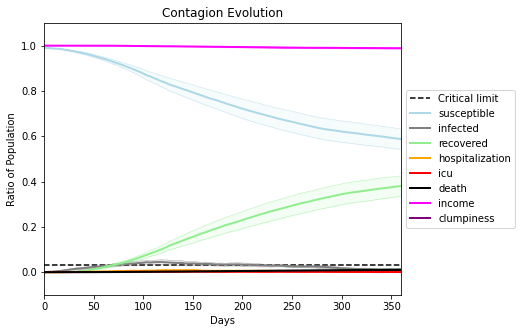

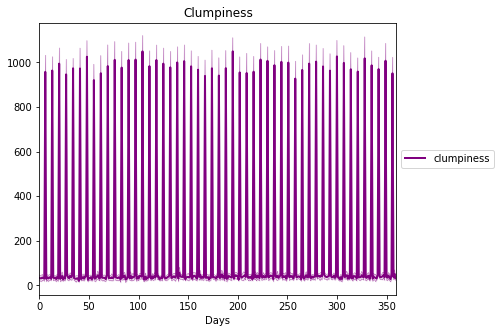

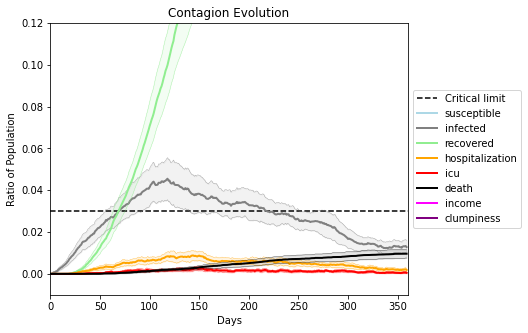

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5097, 2868, 602, 2746, 3638, 7834, 4121, 8156, 1626, 666, 5889, 8299, 5352, 221, 7091, 3294, 9159, 7548, 2417, 2972]
Average similarity between family members is 0.0653832410056147 at temperature 0.66
Average similarity between family and home is 0.9998450962809755 at temperature -1
Average similarity between students and their classroom is 0.06541165164046041 at temperature 0.66
Average classroom occupancy is 1.5508021390374331 and number classrooms is 187
Average similarity between workers is 0.07788416853523412 at temperature 0.66
Average office occupancy is 3.3535353535353534 and number offices is 198
Average friend similarity for adults: 0.1317650940756433 for kids: 0.12337493901593183
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
H

avg restaurant similarity 0.025918939484939976
avg restaurant similarity -0.020186887807988677
avg restaurant similarity 0.011155427589014222
avg restaurant similarity 0.017382002142973647
avg restaurant similarity 0.030013882374222534
avg restaurant similarity 0.048053568435531005
avg restaurant similarity -0.006276543963347303
avg restaurant similarity 0.006737123526752763
avg restaurant similarity 0.06660180192172108
avg restaurant similarity -0.0017244637567747096
avg restaurant similarity 0.027450675147490198
avg restaurant similarity 0.020602870974694296
avg restaurant similarity -0.008828182453963633
avg restaurant similarity 0.0678080688930358
avg restaurant similarity 0.013412791736629905
avg restaurant similarity 0.03716156242367747
avg restaurant similarity 0.02410946495151433
avg restaurant similarity -0.01968848154868505
avg restaurant similarity 0.02067913659387485
avg restaurant similarity 0.025438728892176347
avg restaurant similarity 0.016711839455316218
avg restaurant

avg restaurant similarity 0.020446829741659785
avg restaurant similarity 0.045309720682258144
avg restaurant similarity 0.08056340765709807
avg restaurant similarity 0.01324981717642119
avg restaurant similarity -0.02218255472354022
avg restaurant similarity 0.01814437280806436
avg restaurant similarity 0.03983040458156255
avg restaurant similarity 0.04099050050345259
avg restaurant similarity 0.011811824293405451
avg restaurant similarity 0.03460625851292272
avg restaurant similarity 0.03564751746322739
avg restaurant similarity 0.020764200596508315
avg restaurant similarity 0.02955945140580766
avg restaurant similarity 0.04131902037406859
avg restaurant similarity 0.07773692141958259
avg restaurant similarity 0.022476912794382752
avg restaurant similarity 0.0401168907855439
avg restaurant similarity 0.032017080921043724
avg restaurant similarity 0.021766010168015
avg restaurant similarity 0.0369936620069358
avg restaurant similarity 0.026410915952211216
avg restaurant similarity 0.04

avg restaurant similarity 0.034221521708335485
avg restaurant similarity 0.03949739508741548
avg restaurant similarity -0.014570426206220668
avg restaurant similarity 0.07679310229482882
avg restaurant similarity 0.03013268637659517
avg restaurant similarity 0.039200218077418254
avg restaurant similarity 0.07046450080273677
avg restaurant similarity 0.046359632319525654
Average similarity between family members is 0.06543864283574839 at temperature 0.66
Average similarity between family and home is 0.9998531451818642 at temperature -1
Average similarity between students and their classroom is 0.06355035107656201 at temperature 0.66
Average classroom occupancy is 1.6157894736842104 and number classrooms is 190
Average similarity between workers is 0.06876078177523946 at temperature 0.66
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.12141810754223999 for kids: 0.13787375814765318
home_districts
[
Home (0,0) district with 

avg restaurant similarity 0.03417107862262015
avg restaurant similarity 0.059889276155654474
avg restaurant similarity 0.011018593795022237
avg restaurant similarity 0.0372216673870927
avg restaurant similarity 0.03352705548346083
avg restaurant similarity -0.0009704130360309406
avg restaurant similarity -0.0031315141893716414
avg restaurant similarity -0.015682500669569853
avg restaurant similarity 0.01858915591880385
avg restaurant similarity -0.002660331144863231
avg restaurant similarity 0.006226103823395809
avg restaurant similarity 0.07601003105644637
avg restaurant similarity 0.0022589275375334535
avg restaurant similarity -0.04090250668153578
avg restaurant similarity 0.012667445046853451
avg restaurant similarity 0.012398249002641094
avg restaurant similarity 0.006640277861086172
avg restaurant similarity -0.02133179704241157
avg restaurant similarity 0.02744500777084628
avg restaurant similarity 0.011942384334515095
avg restaurant similarity -0.03987807891973309
avg restauran

avg restaurant similarity 0.01972217039169798
avg restaurant similarity 0.011670771956818338
avg restaurant similarity 0.039889917582455386
avg restaurant similarity 0.01711548683308712
avg restaurant similarity -0.018430703795662185
avg restaurant similarity -0.0021803903956139773
avg restaurant similarity -0.006661725576349039
avg restaurant similarity 0.022948823120976503
avg restaurant similarity 0.054114954336215326
avg restaurant similarity 0.041693260945609434
avg restaurant similarity 0.04997150988833104
avg restaurant similarity 0.0012624761090003647
avg restaurant similarity 0.016883552205103316
avg restaurant similarity 0.03501481775949033
avg restaurant similarity -0.020236471394538928
avg restaurant similarity 0.019333604354678957
avg restaurant similarity -0.014901030777512092
avg restaurant similarity 0.005866797216361733
avg restaurant similarity 0.05082723126511165
avg restaurant similarity 0.06785031473669074
avg restaurant similarity 0.025217908641881382
avg restaura

avg restaurant similarity 0.0177963315971982
avg restaurant similarity 0.028879919041970663
avg restaurant similarity 0.007035960141122116
avg restaurant similarity 0.013681216866097164
avg restaurant similarity -0.021727499856099383
avg restaurant similarity 0.02479260993119055
avg restaurant similarity 0.09718884870898076
avg restaurant similarity -0.02157109732548054
avg restaurant similarity 0.009851645000586468
avg restaurant similarity -0.029055309057794337
Average similarity between family members is 0.06401116911358871 at temperature 0.66
Average similarity between family and home is 0.9998619960265214 at temperature -1
Average similarity between students and their classroom is 0.03209501643913389 at temperature 0.66
Average classroom occupancy is 1.5245901639344261 and number classrooms is 183
Average similarity between workers is 0.05027060992555356 at temperature 0.66
Average office occupancy is 3.1862745098039214 and number offices is 204
Average friend similarity for adult

avg restaurant similarity 0.07529145298911927
avg restaurant similarity -0.0005192857512084676
avg restaurant similarity 0.060409054131180605
avg restaurant similarity 0.04951421200706699
avg restaurant similarity 0.010804547705281208
avg restaurant similarity 0.03983430849592386
avg restaurant similarity -0.02368680559477688
avg restaurant similarity 0.022826752068196142
avg restaurant similarity 0.054465768890126255
avg restaurant similarity -0.0020056876035165028
avg restaurant similarity -0.012160955492170115
avg restaurant similarity 0.012068903940931248
avg restaurant similarity 0.06678993210780546
avg restaurant similarity 0.027443450685711072
avg restaurant similarity 0.043675607598246804
avg restaurant similarity 0.020220612066005374
avg restaurant similarity -0.02395538323620897
avg restaurant similarity 0.050911090122239606
avg restaurant similarity 0.03241370508138494
avg restaurant similarity 0.037078641733556364
avg restaurant similarity 0.07992773236048381
avg restaurant

avg restaurant similarity -0.0062523637227730605
avg restaurant similarity 0.024811360388220568
avg restaurant similarity 0.07502773456637488
avg restaurant similarity 0.08125151139292662
avg restaurant similarity 0.014233808338607164
avg restaurant similarity 0.06892095514910869
avg restaurant similarity -0.001063868804294033
avg restaurant similarity -0.012550943356275702
avg restaurant similarity 0.0801986134802346
avg restaurant similarity 0.041972252464945216
avg restaurant similarity 0.06674629010539421
avg restaurant similarity 0.04348310973408327
avg restaurant similarity 0.015906535317802544
avg restaurant similarity 0.001800385407316225
avg restaurant similarity 0.06769877956748792
avg restaurant similarity 0.026509400831956534
avg restaurant similarity 0.021373191567730078
avg restaurant similarity 0.06875253743988478
avg restaurant similarity 0.052493873011146504
avg restaurant similarity 0.012597916360223524
avg restaurant similarity 0.06391146936836091
avg restaurant simi

avg restaurant similarity 0.006768962113223401
avg restaurant similarity 0.026990865100780442
avg restaurant similarity 0.018859153916837713
avg restaurant similarity 0.012953225100368329
avg restaurant similarity 0.039909096687627404
avg restaurant similarity 0.023572292857817454
avg restaurant similarity 0.02789184326631565
avg restaurant similarity 0.06208717403307396
avg restaurant similarity 0.026755250707324527
Average similarity between family members is 0.06090017187647917 at temperature 0.66
Average similarity between family and home is 0.9998593196835083 at temperature -1
Average similarity between students and their classroom is 0.06306641690934331 at temperature 0.66
Average classroom occupancy is 1.5235294117647058 and number classrooms is 170
Average similarity between workers is 0.061194516909944686 at temperature 0.66
Average office occupancy is 3.374384236453202 and number offices is 203
Average friend similarity for adults: 0.12784091002549916 for kids: 0.135359439186

avg restaurant similarity 0.04176341065647613
avg restaurant similarity 4.0361689599275966e-05
avg restaurant similarity 0.02080423030505669
avg restaurant similarity 0.05845577654179624
avg restaurant similarity -0.03459601936039891
avg restaurant similarity 0.027532226322247572
avg restaurant similarity 0.015387046896244873
avg restaurant similarity 0.024738642488859156
avg restaurant similarity 0.02351314767151915
avg restaurant similarity 0.04470867979264726
avg restaurant similarity -0.04443403803785692
avg restaurant similarity 0.045835052689508736
avg restaurant similarity 0.029202443023216333
avg restaurant similarity -0.003976908128266653
avg restaurant similarity -0.033443296677989544
avg restaurant similarity 0.011360662910790216
avg restaurant similarity 0.012778218314824568
avg restaurant similarity 0.026415901914687265
avg restaurant similarity 0.02899939181420498
avg restaurant similarity 0.023299484806070383
avg restaurant similarity -0.026797292134667017
avg restaurant

avg restaurant similarity 0.02167069800764025
avg restaurant similarity 0.005501621145973609
avg restaurant similarity 0.038787725462159126
avg restaurant similarity 0.031209060361229835
avg restaurant similarity 0.010503499575460188
avg restaurant similarity 0.0011283121554223636
avg restaurant similarity -0.004043787052420748
avg restaurant similarity -0.002815538428987667
avg restaurant similarity 0.018323968644631993
avg restaurant similarity -0.009912097447509113
avg restaurant similarity 0.026478243681497437
avg restaurant similarity -0.012502100684005745
avg restaurant similarity 0.04550722969389621
avg restaurant similarity 0.025255848092524458
avg restaurant similarity 0.004176196871350665
avg restaurant similarity 0.033323970893054694
avg restaurant similarity 0.029171262762037044
avg restaurant similarity 0.04884715185125065
avg restaurant similarity 0.011651212270972395
avg restaurant similarity 0.03818199819120307
avg restaurant similarity 0.013079634167501212
avg restaura

avg restaurant similarity 0.008884439895248893
avg restaurant similarity 0.04276086673200203
avg restaurant similarity 0.03531549465063365
avg restaurant similarity 0.013023935858529486
avg restaurant similarity 0.015200871243535448
avg restaurant similarity 0.04656473713311283
avg restaurant similarity -0.006253039921072615
avg restaurant similarity 0.004604958588258922
avg restaurant similarity -0.0035999042345903013
avg restaurant similarity 0.02894214929993522
Average similarity between family members is 0.06849742930980074 at temperature 0.66
Average similarity between family and home is 0.9998558857488163 at temperature -1
Average similarity between students and their classroom is 0.0970190786061377 at temperature 0.66
Average classroom occupancy is 1.6045197740112995 and number classrooms is 177
Average similarity between workers is 0.06966489879465014 at temperature 0.66
Average office occupancy is 3.3618090452261304 and number offices is 199
Average friend similarity for adult

avg restaurant similarity -0.00856124748051818
avg restaurant similarity 0.02948888417657656
avg restaurant similarity 0.018725327555878427
avg restaurant similarity 0.04802869923413584
avg restaurant similarity 0.016114615446842877
avg restaurant similarity 0.02446424365378589
avg restaurant similarity 0.05878984274809054
avg restaurant similarity 0.08995267372216591
avg restaurant similarity 0.020917127491530327
avg restaurant similarity 0.012217003705205752
avg restaurant similarity -0.019434383459216435
avg restaurant similarity -0.004711015942246754
avg restaurant similarity -0.0031146537955487694
avg restaurant similarity 0.006835443302803718
avg restaurant similarity 0.021351740672558264
avg restaurant similarity 0.05840105551204893
avg restaurant similarity -0.0023907178683611322
avg restaurant similarity -0.015547352420037686
avg restaurant similarity 0.010004581894531179
avg restaurant similarity -0.007563315594903814
avg restaurant similarity 0.03177175763293441
avg restaura

avg restaurant similarity 0.037378283517257645
avg restaurant similarity -0.005080061223810676
avg restaurant similarity -0.01690590499796274
avg restaurant similarity 0.057247449224991274
avg restaurant similarity 0.03523719683835578
avg restaurant similarity 0.007945997426637586
avg restaurant similarity -0.030809765942557483
avg restaurant similarity 0.023426823596757865
avg restaurant similarity 0.036610755494874685
avg restaurant similarity 0.048387245934504323
avg restaurant similarity 0.0013907685033747277
avg restaurant similarity 0.011939204146765752
avg restaurant similarity -0.02442180201568997
avg restaurant similarity 0.028175694029385863
avg restaurant similarity -0.028631637632057453
avg restaurant similarity -0.026134360461324897
avg restaurant similarity -0.0047126940061509685
avg restaurant similarity 0.04169834237048059
avg restaurant similarity 0.04406074027064655
avg restaurant similarity 0.01594762605639863
avg restaurant similarity -0.007532817830771484
avg resta

avg restaurant similarity 0.001473526929857986
avg restaurant similarity 0.04638792923187935
avg restaurant similarity 0.009251565575326305
avg restaurant similarity -0.024137623962818305
avg restaurant similarity -0.007293680665156322
avg restaurant similarity 0.03291616842724889
avg restaurant similarity 0.03830670618009391
avg restaurant similarity 0.005136499338859121
avg restaurant similarity -0.03670492148486214
avg restaurant similarity 0.012004499988680542
avg restaurant similarity -0.013290483691117117
Average similarity between family members is 0.07635419349120347 at temperature 0.66
Average similarity between family and home is 0.9998614267863652 at temperature -1
Average similarity between students and their classroom is 0.06583599731101018 at temperature 0.66
Average classroom occupancy is 1.6063829787234043 and number classrooms is 188
Average similarity between workers is 0.07361467136259776 at temperature 0.66
Average office occupancy is 3.208955223880597 and number of

avg restaurant similarity 0.021951300329497048
avg restaurant similarity 0.01472922180699311
avg restaurant similarity -0.007741918096682438
avg restaurant similarity 0.010035043323495762
avg restaurant similarity 0.013544280277919731
avg restaurant similarity 0.09782920170978911
avg restaurant similarity 0.03139444397239916
avg restaurant similarity 0.03936011670984884
avg restaurant similarity 0.054158356983868325
avg restaurant similarity -0.020154452896537407
avg restaurant similarity 0.03487640990342332
avg restaurant similarity 0.03883500368359988
avg restaurant similarity 0.0458255864943363
avg restaurant similarity -0.011560861375128349
avg restaurant similarity 0.02522028159418609
avg restaurant similarity 0.040220161206245574
avg restaurant similarity -0.023942231834082273
avg restaurant similarity -0.009796123537793962
avg restaurant similarity 0.03988928959557695
avg restaurant similarity 0.03770169769643216
avg restaurant similarity -0.015064193264664301
avg restaurant sim

avg restaurant similarity -0.03557950450955045
avg restaurant similarity 0.016655419429532876
avg restaurant similarity 0.010482993402622338
avg restaurant similarity 0.02007042017136562
avg restaurant similarity 0.00951586019630888
avg restaurant similarity 0.02051794505790844
avg restaurant similarity 0.019131394363601964
avg restaurant similarity 0.016781977419003107
avg restaurant similarity 0.006383182033333042
avg restaurant similarity 0.005849189656811199
avg restaurant similarity -0.016219560330286306
avg restaurant similarity -0.02541044019925773
avg restaurant similarity 0.007243763417008668
avg restaurant similarity -0.00740503316229023
avg restaurant similarity -0.016336237248348838
avg restaurant similarity 0.04250902016728856
avg restaurant similarity 0.01083912105698247
avg restaurant similarity -0.036945530644449026
avg restaurant similarity -0.038323629075975814
avg restaurant similarity 0.008700773683843947
avg restaurant similarity 0.04075011367546449
avg restaurant 

avg restaurant similarity 0.03822796545637538
avg restaurant similarity 0.025380555012738917
avg restaurant similarity 0.03713587138942076
avg restaurant similarity 0.022550434367545318
avg restaurant similarity 0.0027597803939027055
avg restaurant similarity -0.014701970853465621
avg restaurant similarity -0.00037645747603089473
avg restaurant similarity 0.007938756328828438
avg restaurant similarity 0.026928378176723482
avg restaurant similarity 0.011662871300329296
avg restaurant similarity -0.020996909004141143
Average similarity between family members is 0.039372883632128534 at temperature 0.66
Average similarity between family and home is 0.9998555192518815 at temperature -1
Average similarity between students and their classroom is 0.0744227832615714 at temperature 0.66
Average classroom occupancy is 1.6067415730337078 and number classrooms is 178
Average similarity between workers is 0.04424851140907718 at temperature 0.66
Average office occupancy is 3.3115577889447234 and numb

avg restaurant similarity 0.0343290725008597
avg restaurant similarity 0.004954193786883787
avg restaurant similarity -0.014725328310106521
avg restaurant similarity 0.029677851748867036
avg restaurant similarity 0.030188167101951706
avg restaurant similarity 0.0284239623835834
avg restaurant similarity 0.06938947631579948
avg restaurant similarity 0.024545907650825864
avg restaurant similarity 0.04162036129854995
avg restaurant similarity 0.03140774955725587
avg restaurant similarity 0.004462740087955462
avg restaurant similarity 0.007496325045430652
avg restaurant similarity 0.02864683653516917
avg restaurant similarity 0.031763785949323574
avg restaurant similarity 0.020518847092340052
avg restaurant similarity 0.017093870926144103
avg restaurant similarity 0.0203181251328732
avg restaurant similarity 0.02688078052105476
avg restaurant similarity 0.026839363992388808
avg restaurant similarity -0.017473862648304393
avg restaurant similarity -0.02495514322545781
avg restaurant similar

avg restaurant similarity 0.04816006001743697
avg restaurant similarity -0.014263756344031058
avg restaurant similarity 0.001393166624319097
avg restaurant similarity 0.10520720904434372
avg restaurant similarity 0.07452290794377987
avg restaurant similarity -0.020509250006523105
avg restaurant similarity 0.04076378551257562
avg restaurant similarity 0.04667286491150155
avg restaurant similarity -0.0038195802576815614
avg restaurant similarity 0.017900266563849385
avg restaurant similarity 0.025154313306130435
avg restaurant similarity 0.017680770857094488
avg restaurant similarity 0.05299622652446527
avg restaurant similarity 0.03183886676765232
avg restaurant similarity 0.04509336467092342
avg restaurant similarity 0.0072137597519337125
avg restaurant similarity -0.010591120860480311
avg restaurant similarity 0.03564058483063333
avg restaurant similarity 0.005558613692077244
avg restaurant similarity 0.0677556353738011
avg restaurant similarity -0.017238857489610366
avg restaurant si

avg restaurant similarity -0.01475963881855056
avg restaurant similarity 0.01765769549069835
avg restaurant similarity 0.054791008262068834
avg restaurant similarity -0.001885113008357472
avg restaurant similarity 0.008443045917219052
avg restaurant similarity 0.002412985299284434
avg restaurant similarity 0.014308163810977383
avg restaurant similarity 0.028017299439702974
avg restaurant similarity 0.0638021851481729
avg restaurant similarity 0.06736443229770923
Average similarity between family members is 0.06394256241652622 at temperature 0.66
Average similarity between family and home is 0.9998464438721406 at temperature -1
Average similarity between students and their classroom is 0.021151110337343137 at temperature 0.66
Average classroom occupancy is 1.575268817204301 and number classrooms is 186
Average similarity between workers is 0.037583370584035165 at temperature 0.66
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.12404383

avg restaurant similarity 0.009058134980676792
avg restaurant similarity 0.007937867368835679
avg restaurant similarity 0.03646620821212929
avg restaurant similarity -0.01211051874949146
avg restaurant similarity -0.003896032562594827
avg restaurant similarity 0.02747964183979447
avg restaurant similarity 0.026388813988724374
avg restaurant similarity 0.0054654330543880345
avg restaurant similarity 0.011228625749489565
avg restaurant similarity -0.006523681092349505
avg restaurant similarity 0.021306917992391032
avg restaurant similarity 0.046252540095493865
avg restaurant similarity -0.016720232686868917
avg restaurant similarity 0.00880852003938846
avg restaurant similarity 0.003816064496543149
avg restaurant similarity 0.06389290296908227
avg restaurant similarity 0.06689058955508005
avg restaurant similarity 0.012051495882338887
avg restaurant similarity -0.028105193876977862
avg restaurant similarity 0.028394351341327975
avg restaurant similarity 0.03224149614671265
avg restaurant

avg restaurant similarity 0.0412189596433662
avg restaurant similarity 0.001092908449591117
avg restaurant similarity 0.03209513670994384
avg restaurant similarity 0.024211491658089203
avg restaurant similarity 0.0205674581474942
avg restaurant similarity 0.005462840108208849
avg restaurant similarity 0.019418952722120946
avg restaurant similarity 0.0016327192082922378
avg restaurant similarity 0.0227240023317287
avg restaurant similarity 0.031780461801180486
avg restaurant similarity 0.036637205861180355
avg restaurant similarity 0.02242338129265223
avg restaurant similarity 0.007085551486282463
avg restaurant similarity 0.013631357174193191
avg restaurant similarity 0.00800325074863383
avg restaurant similarity 0.04816130283716922
avg restaurant similarity 0.03085550184037956
avg restaurant similarity 0.008435614735268914
avg restaurant similarity -0.01516830632327128
avg restaurant similarity -0.00022700785092885864
avg restaurant similarity -0.013942966844675043
avg restaurant simi

avg restaurant similarity 0.015861692621288812
avg restaurant similarity -0.036653011788819544
avg restaurant similarity 0.0054882843182484835
avg restaurant similarity 0.007815710250478133
avg restaurant similarity 0.040471817361280644
avg restaurant similarity 0.02974086035672637
avg restaurant similarity 0.0329514316382612
avg restaurant similarity 0.023662474619801345
avg restaurant similarity -0.028379620865031405
avg restaurant similarity 0.017683305742069704
Average similarity between family members is 0.047156932834647454 at temperature 0.66
Average similarity between family and home is 0.999859415837258 at temperature -1
Average similarity between students and their classroom is 0.044692540042776306 at temperature 0.66
Average classroom occupancy is 1.5248618784530388 and number classrooms is 181
Average similarity between workers is 0.049854920509046836 at temperature 0.66
Average office occupancy is 3.328358208955224 and number offices is 201
Average friend similarity for ad

avg restaurant similarity 0.03182262531048509
avg restaurant similarity -0.0024295792177767193
avg restaurant similarity 0.01787020397890029
avg restaurant similarity 0.04786364723356685
avg restaurant similarity 0.001365255548084749
avg restaurant similarity 0.0235924100478138
avg restaurant similarity -0.026521192626871862
avg restaurant similarity 0.04986341078975198
avg restaurant similarity 0.04251166832548809
avg restaurant similarity -0.011797126904509122
avg restaurant similarity 0.05738820617620469
avg restaurant similarity 0.0030653557048294293
avg restaurant similarity -0.01700468940980029
avg restaurant similarity 0.02348255281549504
avg restaurant similarity 0.013582962097007155
avg restaurant similarity -0.004695908744286798
avg restaurant similarity 0.03224019286861396
avg restaurant similarity 0.015294863943803165
avg restaurant similarity -0.02579229418788637
avg restaurant similarity -0.018891254331515832
avg restaurant similarity 0.01903143601779881
avg restaurant si

avg restaurant similarity -0.014283553506096893
avg restaurant similarity 0.03647208811347702
avg restaurant similarity 0.03720912780066924
avg restaurant similarity 0.006035413575887699
avg restaurant similarity -0.005635134119713175
avg restaurant similarity 0.0171815866579675
avg restaurant similarity -0.01246651838740008
avg restaurant similarity 0.010665384484698915
avg restaurant similarity 0.01568592372002848
avg restaurant similarity -0.0072681475689460665
avg restaurant similarity 0.035308791585472614
avg restaurant similarity -0.012387998799048207
avg restaurant similarity -0.030137207927886944
avg restaurant similarity -0.002468176973384348
avg restaurant similarity 0.059543852365598504
avg restaurant similarity 0.0020906821779507908
avg restaurant similarity 0.04303967613251769
avg restaurant similarity -0.007798105016708815
avg restaurant similarity 0.009575610867247567
avg restaurant similarity 0.01686020690207122
avg restaurant similarity 0.023290463979467893
avg restaur

avg restaurant similarity -0.01547820345746265
avg restaurant similarity -0.02188292338682907
avg restaurant similarity 0.03536234711811638
avg restaurant similarity 0.029159640993581978
avg restaurant similarity 0.009191131962876062
avg restaurant similarity -0.04538115316199241
avg restaurant similarity 0.00032315653863933887
avg restaurant similarity 0.007062799748074311
avg restaurant similarity 0.06882792208800714
avg restaurant similarity 0.003409885261681426
avg restaurant similarity 0.012144286551680955
Average similarity between family members is 0.05440410138144222 at temperature 0.66
Average similarity between family and home is 0.9998625250231651 at temperature -1
Average similarity between students and their classroom is 0.07752674987477799 at temperature 0.66
Average classroom occupancy is 1.5251396648044693 and number classrooms is 179
Average similarity between workers is 0.0677249851114275 at temperature 0.66
Average office occupancy is 3.407035175879397 and number off

avg restaurant similarity 0.02906380211160788
avg restaurant similarity -0.0027521536741925484
avg restaurant similarity -0.010024150349323673
avg restaurant similarity 0.023162826607347926
avg restaurant similarity 0.05138636006157689
avg restaurant similarity 0.04288837402602567
avg restaurant similarity 0.011595204348148666
avg restaurant similarity 0.007747419124665482
avg restaurant similarity 0.0290626737984659
avg restaurant similarity 0.040589609744043444
avg restaurant similarity -0.0007956639031884629
avg restaurant similarity -0.0004890932542842513
avg restaurant similarity -0.003375482876904577
avg restaurant similarity -0.01145507711679396
avg restaurant similarity -0.034041351508701356
avg restaurant similarity 0.05238984777419935
avg restaurant similarity -0.044392506105210956
avg restaurant similarity -0.004309677695713087
avg restaurant similarity 0.014653209999074539
avg restaurant similarity -0.037580286182143895
avg restaurant similarity -0.00045031032691822143
avg 

avg restaurant similarity -0.0002802320792658503
avg restaurant similarity 0.01582435341980111
avg restaurant similarity -0.042665524788738314
avg restaurant similarity 0.019726464823345204
avg restaurant similarity 0.016203179103764655
avg restaurant similarity 0.03725154510407803
avg restaurant similarity 0.014215644354054827
avg restaurant similarity 0.04162179126278071
avg restaurant similarity -0.005520055387764742
avg restaurant similarity 0.04681824718072733
avg restaurant similarity 0.0283640501717377
avg restaurant similarity 0.030464349580352806
avg restaurant similarity 0.04729580538827544
avg restaurant similarity 0.05207331879786496
avg restaurant similarity -0.046802932731469654
avg restaurant similarity -0.01041472870864802
avg restaurant similarity 0.0004732302421209941
avg restaurant similarity 0.004825843382900972
avg restaurant similarity -0.008213233123347652
avg restaurant similarity 0.02485836675865134
avg restaurant similarity 0.003642010864756126
avg restaurant 

avg restaurant similarity -0.018819714181090217
avg restaurant similarity 0.0037727742510074622
avg restaurant similarity 0.04509723464601809
avg restaurant similarity -0.04787398312084527
avg restaurant similarity -0.01944484151584985
avg restaurant similarity -0.026756306137603644
avg restaurant similarity 0.047580079586230284
avg restaurant similarity -0.00018586159211586627
avg restaurant similarity 0.0392404669876285
avg restaurant similarity -0.04826045341040547
Average similarity between family members is 0.038393772605877625 at temperature 0.66
Average similarity between family and home is 0.9998568912461664 at temperature -1
Average similarity between students and their classroom is 0.0906297826463395 at temperature 0.66
Average classroom occupancy is 1.576086956521739 and number classrooms is 184
Average similarity between workers is 0.05685332602218009 at temperature 0.66
Average office occupancy is 3.3435897435897437 and number offices is 195
Average friend similarity for a

avg restaurant similarity 0.005393269315502137
avg restaurant similarity 0.03007328188795668
avg restaurant similarity -0.014267875955872531
avg restaurant similarity 0.06147836585210567
avg restaurant similarity 0.01688953731809049
avg restaurant similarity 0.003705784315188438
avg restaurant similarity -0.006808378765153888
avg restaurant similarity 0.04309023236048631
avg restaurant similarity -0.011235718697665056
avg restaurant similarity 0.029070930071608377
avg restaurant similarity -0.029156521935826626
avg restaurant similarity 0.012024910110966654
avg restaurant similarity 0.05879927005035918
avg restaurant similarity 0.0005121194317776505
avg restaurant similarity 0.002247729392566834
avg restaurant similarity 0.023208222615809307
avg restaurant similarity -0.009427688899798526
avg restaurant similarity 0.04815638606236419
avg restaurant similarity 0.015273268354186841
avg restaurant similarity 0.026235540738247715
avg restaurant similarity -0.04197822414029546
avg restauran

avg restaurant similarity 0.025881314880768228
avg restaurant similarity 0.041477253507123134
avg restaurant similarity 0.02437328433846481
avg restaurant similarity 0.046197105993807934
avg restaurant similarity 0.06047034508802281
avg restaurant similarity 0.015158831120843673
avg restaurant similarity 0.01751957518492809
avg restaurant similarity 0.024023523973195078
avg restaurant similarity 0.016217106060317683
avg restaurant similarity 0.03737537074652122
avg restaurant similarity -0.006228231245443946
avg restaurant similarity -0.031178787310664556
avg restaurant similarity 0.024282046516294866
avg restaurant similarity 0.009243484978973643
avg restaurant similarity 0.007680326097543759
avg restaurant similarity -0.003337718424512815
avg restaurant similarity 0.0730873813989522
avg restaurant similarity 0.004177355379563139
avg restaurant similarity 0.04162359359654355
avg restaurant similarity 0.03955004178451462
avg restaurant similarity 0.03793837231508087
avg restaurant simi

avg restaurant similarity 0.05279974044506811
avg restaurant similarity 0.02257546389940749
avg restaurant similarity 0.006998513963699122
avg restaurant similarity 0.03459561687912137
avg restaurant similarity 0.0675908363072567
avg restaurant similarity -0.013119746818527825
avg restaurant similarity -0.008013026469120083
avg restaurant similarity 0.015537868342087017
avg restaurant similarity 0.00022811571713291092
avg restaurant similarity 0.0301578362242721
Average similarity between family members is 0.06550546682891291 at temperature 0.66
Average similarity between family and home is 0.9998623657382474 at temperature -1
Average similarity between students and their classroom is 0.05514777816205007 at temperature 0.66
Average classroom occupancy is 1.6228571428571428 and number classrooms is 175
Average similarity between workers is 0.047304366892642016 at temperature 0.66
Average office occupancy is 3.264705882352941 and number offices is 204
Average friend similarity for adults

avg restaurant similarity 0.06376236376296905
avg restaurant similarity -0.004297566749269977
avg restaurant similarity 0.018563408955272507
avg restaurant similarity 0.04867893086090732
avg restaurant similarity 0.04926975559015467
avg restaurant similarity 0.04492759172171967
avg restaurant similarity 0.024964727918720887
avg restaurant similarity 0.018425473052352953
avg restaurant similarity 0.020618877243794537
avg restaurant similarity 0.02422828415068498
avg restaurant similarity 0.05577932845680722
avg restaurant similarity 0.030155007127810367
avg restaurant similarity 0.03917666719442812
avg restaurant similarity 0.05960714073326307
avg restaurant similarity 0.03086170399457689
avg restaurant similarity 0.013324661139222083
avg restaurant similarity 0.018688745064564336
avg restaurant similarity 0.02482227036471182
avg restaurant similarity 0.05026710692715026
avg restaurant similarity 0.02472001112015589
avg restaurant similarity 0.02630172547150484
avg restaurant similarity

avg restaurant similarity 0.045197476260871006
avg restaurant similarity 0.00017762690655540373
avg restaurant similarity 0.018819211086774177
avg restaurant similarity 0.018035452675053954
avg restaurant similarity 0.029085847378841435
avg restaurant similarity -0.007476081354902995
avg restaurant similarity 0.041839429949548985
avg restaurant similarity 0.049947687022691645
avg restaurant similarity 0.01843973012068906
avg restaurant similarity 0.012941687439935033
avg restaurant similarity 0.02766354112839771
avg restaurant similarity 0.017606694891980246
avg restaurant similarity 0.02145514431688068
avg restaurant similarity -0.0031332712928492288
avg restaurant similarity 0.06047561460335149
avg restaurant similarity 0.03046370529898304
avg restaurant similarity 0.06542820294403852
avg restaurant similarity 0.026888975044122288
avg restaurant similarity 0.045122019982000966
avg restaurant similarity -0.00971778802271635
avg restaurant similarity 0.01333347402862758
avg restaurant 

avg restaurant similarity 0.021868412196159263
avg restaurant similarity 0.03042663689812125
avg restaurant similarity 0.008713494523823632
avg restaurant similarity 0.04558832264715034
avg restaurant similarity 0.019753304717660916
avg restaurant similarity -0.007401475159141688
avg restaurant similarity 0.017140766735602643
avg restaurant similarity 0.017680213976180213
Average similarity between family members is 0.06878431463545787 at temperature 0.66
Average similarity between family and home is 0.9998492780585739 at temperature -1
Average similarity between students and their classroom is 0.06404072967877267 at temperature 0.66
Average classroom occupancy is 1.632183908045977 and number classrooms is 174
Average similarity between workers is 0.09449696231837498 at temperature 0.66
Average office occupancy is 3.2857142857142856 and number offices is 203
Average friend similarity for adults: 0.1235513918535482 for kids: 0.13832400233463069
home_districts
[
Home (0,0) district with 

avg restaurant similarity -0.007026436037353867
avg restaurant similarity 0.010025124487150996
avg restaurant similarity 0.03698691637397341
avg restaurant similarity 0.047392809873214724
avg restaurant similarity 0.02059029429060139
avg restaurant similarity 0.018765580369063072
avg restaurant similarity 0.04266648937098489
avg restaurant similarity 0.02429152889728534
avg restaurant similarity 0.05476478757012723
avg restaurant similarity 0.013252036977546275
avg restaurant similarity 0.03233210386106357
avg restaurant similarity 0.01954727898466863
avg restaurant similarity -0.0054656780561879595
avg restaurant similarity 0.03804420357239257
avg restaurant similarity 0.06064078263744377
avg restaurant similarity 0.021944181675350508
avg restaurant similarity 0.03094220695308226
avg restaurant similarity 0.058457009550712834
avg restaurant similarity 0.023846769749439698
avg restaurant similarity 0.034143323126609844
avg restaurant similarity 0.04897509499796418
avg restaurant simila

avg restaurant similarity 0.022550693184886124
avg restaurant similarity 0.054827549742476944
avg restaurant similarity 0.0473933059701721
avg restaurant similarity 0.04030906183352388
avg restaurant similarity 0.056890695347098195
avg restaurant similarity 7.827835418671268e-06
avg restaurant similarity 0.031433835247991
avg restaurant similarity 0.05978486222596497
avg restaurant similarity 0.05952291714190218
avg restaurant similarity 0.038868408743889575
avg restaurant similarity -0.005513781044540546
avg restaurant similarity -0.028352055437228196
avg restaurant similarity 0.022907263301225694
avg restaurant similarity -0.0014768896821287082
avg restaurant similarity 0.004535862079938975
avg restaurant similarity 0.03551860005021245
avg restaurant similarity 0.04396011818636136
avg restaurant similarity 0.08630147743205006
avg restaurant similarity 0.021905655273016512
avg restaurant similarity 0.015908763688373604
avg restaurant similarity 0.0050457327370169985
avg restaurant sim

avg restaurant similarity 0.02493581843268576
avg restaurant similarity 0.028918777174323854
avg restaurant similarity 0.013696161253916397
avg restaurant similarity 0.02728009387107149
avg restaurant similarity 0.033112342944783
avg restaurant similarity -0.0020399319004554797
avg restaurant similarity 0.04716016249385009
Average similarity between family members is 0.035746383606451694 at temperature 0.66
Average similarity between family and home is 0.9998403621828781 at temperature -1
Average similarity between students and their classroom is 0.09667709473431371 at temperature 0.66
Average classroom occupancy is 1.5952380952380953 and number classrooms is 168
Average similarity between workers is 0.0609843941307698 at temperature 0.66
Average office occupancy is 3.3399014778325125 and number offices is 203
Average friend similarity for adults: 0.12369247893100471 for kids: 0.13669698996835555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity -0.012634405872726944
avg restaurant similarity 0.01273400112440647
avg restaurant similarity -0.0067736218773439775
avg restaurant similarity 0.016027528263499343
avg restaurant similarity 0.025982719374009425
avg restaurant similarity 0.049368069425576096
avg restaurant similarity 0.050358601476039086
avg restaurant similarity -0.011624187002908608
avg restaurant similarity 0.03326570711119976
avg restaurant similarity -0.0027142516476285224
avg restaurant similarity 0.02493937465583563
avg restaurant similarity -0.025474863982508728
avg restaurant similarity -0.00495706593444679
avg restaurant similarity 0.04190986115317537
avg restaurant similarity 0.04969660442598845
avg restaurant similarity 0.013116872915984732
avg restaurant similarity 0.026346091591523197
avg restaurant similarity -0.0049339113292344704
avg restaurant similarity 0.02923559728110396
avg restaurant similarity 0.004940546194020221
avg restaurant similarity 0.01454422512061387
avg restaur

avg restaurant similarity 0.041586054436873764
avg restaurant similarity 0.017938784953394397
avg restaurant similarity 0.036793410831287586
avg restaurant similarity 0.00183487744012079
avg restaurant similarity 0.028891026318795855
avg restaurant similarity 0.03594493453110699
avg restaurant similarity -0.007707207738995892
avg restaurant similarity 0.017908980370714634
avg restaurant similarity 0.01337728128526828
avg restaurant similarity 0.005569510498732844
avg restaurant similarity -0.0028867343631037963
avg restaurant similarity 0.01892417685178484
avg restaurant similarity 0.0447281020538257
avg restaurant similarity -0.006721462465136665
avg restaurant similarity -0.0067158011951571756
avg restaurant similarity -0.02802265519612695
avg restaurant similarity -0.012029319253331559
avg restaurant similarity 0.019768563622314408
avg restaurant similarity 0.018039247906951023
avg restaurant similarity 0.04730168698316116
avg restaurant similarity 0.015734984170910925
avg restauran

avg restaurant similarity 0.03409149803443357
avg restaurant similarity 0.02744089745012295
avg restaurant similarity 0.06272597007671223
avg restaurant similarity 0.030954156207426007
avg restaurant similarity 0.05030112733324926
avg restaurant similarity -0.013137246814287675
avg restaurant similarity -0.008764335960838318
avg restaurant similarity 0.02042520993141141
avg restaurant similarity 0.014213030634918772
avg restaurant similarity 0.005290337239354331
Average similarity between family members is 0.05372976378982094 at temperature 0.66
Average similarity between family and home is 0.9998476159171686 at temperature -1
Average similarity between students and their classroom is 0.06604070602786033 at temperature 0.66
Average classroom occupancy is 1.5085714285714287 and number classrooms is 175
Average similarity between workers is 0.0515428330856209 at temperature 0.66
Average office occupancy is 3.354679802955665 and number offices is 203
Average friend similarity for adults: 

avg restaurant similarity 0.04023149346163623
avg restaurant similarity 0.04415471911495851
avg restaurant similarity 0.03585923168559223
avg restaurant similarity 0.014868242439827817
avg restaurant similarity 0.017096379589665346
avg restaurant similarity 0.10529389169177923
avg restaurant similarity 0.05800050699180503
avg restaurant similarity 0.06540074085708661
avg restaurant similarity 0.027911158524451096
avg restaurant similarity 0.03014035813767604
avg restaurant similarity -0.0018940318034860876
avg restaurant similarity 0.06884950392902439
avg restaurant similarity 0.0029980570570819986
avg restaurant similarity 0.04652404897474843
avg restaurant similarity 0.017896360291300033
avg restaurant similarity 0.05342417212167644
avg restaurant similarity 0.0301932922907462
avg restaurant similarity 0.04332040516853294
avg restaurant similarity -0.008862612914585417
avg restaurant similarity 0.04670675726506707
avg restaurant similarity 0.023103468417765803
avg restaurant similari

avg restaurant similarity 0.02624246429507617
avg restaurant similarity 0.03771615963215349
avg restaurant similarity 0.04284405113134856
avg restaurant similarity 0.11784619838660176
avg restaurant similarity -0.0196145633610034
avg restaurant similarity 0.021301970924764733
avg restaurant similarity 0.03437530973728599
avg restaurant similarity -0.0058819621348686025
avg restaurant similarity 0.018009410065752574
avg restaurant similarity 0.030891275516161592
avg restaurant similarity 0.03607663481407767
avg restaurant similarity 0.0919182933194073
avg restaurant similarity 0.006917477667609378
avg restaurant similarity 0.0072547084058487196
avg restaurant similarity 0.11163354168199131
avg restaurant similarity 0.02576512910850476
avg restaurant similarity 0.062623492292081
avg restaurant similarity 0.010902754885323593
avg restaurant similarity 0.03827214014836132
avg restaurant similarity 0.01877436080137855
avg restaurant similarity 0.07749144529631874
avg restaurant similarity 0

avg restaurant similarity 0.08200171197811841
avg restaurant similarity 0.05270485998640576
avg restaurant similarity 0.12535688397687175
avg restaurant similarity 0.036559187506320645
avg restaurant similarity 0.04994827779076801
avg restaurant similarity 0.007527687729144089
avg restaurant similarity 0.007832893420535576
avg restaurant similarity 0.04799403991144457
Average similarity between family members is 0.05009032588811715 at temperature 0.66
Average similarity between family and home is 0.9998501421223689 at temperature -1
Average similarity between students and their classroom is 0.05333527437268291 at temperature 0.66
Average classroom occupancy is 1.638743455497382 and number classrooms is 191
Average similarity between workers is 0.07121277614768491 at temperature 0.66
Average office occupancy is 3.0792079207920793 and number offices is 202
Average friend similarity for adults: 0.13688682243781217 for kids: 0.13663378971984647
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.047590784625644825
avg restaurant similarity 0.06767010933300958
avg restaurant similarity 0.03419554755590087
avg restaurant similarity 0.05716454691402189
avg restaurant similarity -0.010074224168074825
avg restaurant similarity 0.08178711320955545
avg restaurant similarity 0.012793005479731261
avg restaurant similarity 0.030382447550098717
avg restaurant similarity -0.002125574912935973
avg restaurant similarity -0.021288747428235156
avg restaurant similarity -0.007381549783857803
avg restaurant similarity 0.0167147398758673
avg restaurant similarity 0.023606203621128342
avg restaurant similarity 0.026698511912647632
avg restaurant similarity 0.010580479612863998
avg restaurant similarity 0.05287616021654814
avg restaurant similarity 0.02789782868063232
avg restaurant similarity -0.0007102993510216289
avg restaurant similarity 0.011344894772867655
avg restaurant similarity 0.031843561076736915
avg restaurant similarity 0.028610728826883643
avg restaurant 

avg restaurant similarity 0.04170517623251504
avg restaurant similarity 0.020762135439204885
avg restaurant similarity 0.051206674737855944
avg restaurant similarity 0.0056870358097636025
avg restaurant similarity -0.02139724570413308
avg restaurant similarity 0.05662452523240115
avg restaurant similarity -0.007005984608438254
avg restaurant similarity 0.03581307896989291
avg restaurant similarity 0.012994328752144037
avg restaurant similarity -0.0029689684811441542
avg restaurant similarity 0.050006642927734955
avg restaurant similarity 0.03636781347381834
avg restaurant similarity 0.051478796922024575
avg restaurant similarity 0.0015993825093417568
avg restaurant similarity -0.047726439708582064
avg restaurant similarity 0.005511357588824181
avg restaurant similarity 0.05163581265621193
avg restaurant similarity 0.022793735676825324
avg restaurant similarity 0.01657495553473205
avg restaurant similarity -0.03628680064087688
avg restaurant similarity 0.004700579887178623
avg restauran

avg restaurant similarity 0.018380818667825767
avg restaurant similarity 0.00978870532436242
avg restaurant similarity -0.005392938752805473
avg restaurant similarity 0.008420076554765715
avg restaurant similarity 0.026939348121049873
avg restaurant similarity 0.05043134571279525
avg restaurant similarity 0.027149383426477183
avg restaurant similarity 0.060882565976360485
avg restaurant similarity 0.0128459423224914
avg restaurant similarity 0.013708053468655551
Average similarity between family members is 0.04646034134043791 at temperature 0.66
Average similarity between family and home is 0.9998506535955698 at temperature -1
Average similarity between students and their classroom is 0.05638261723050816 at temperature 0.66
Average classroom occupancy is 1.5966850828729282 and number classrooms is 181
Average similarity between workers is 0.040805579241782255 at temperature 0.66
Average office occupancy is 3.255 and number offices is 200
Average friend similarity for adults: 0.11988189

avg restaurant similarity -0.009429520852814524
avg restaurant similarity 0.010457101422493113
avg restaurant similarity 0.006965207975504616
avg restaurant similarity 0.03376581146731993
avg restaurant similarity 0.003610005874392205
avg restaurant similarity 0.022767831082508495
avg restaurant similarity 0.012221244428066647
avg restaurant similarity -0.013878585207826418
avg restaurant similarity -0.010277497441135017
avg restaurant similarity 0.010057168318685682
avg restaurant similarity 0.04249321008428515
avg restaurant similarity 0.003084798442770973
avg restaurant similarity -0.014897602686571651
avg restaurant similarity 0.06468131888252238
avg restaurant similarity -0.013116472742815443
avg restaurant similarity 0.02903375071224175
avg restaurant similarity -0.0023401509922850467
avg restaurant similarity 0.038732111516683196
avg restaurant similarity 0.018000791698860267
avg restaurant similarity 0.028525182516881437
avg restaurant similarity -0.038765166206583906
avg resta

avg restaurant similarity 0.05609121285937154
avg restaurant similarity 0.033760151651348325
avg restaurant similarity 0.04347488627392737
avg restaurant similarity 0.025183970479666397
avg restaurant similarity 0.024659272541881154
avg restaurant similarity 0.021425397436519934
avg restaurant similarity 0.02602594662141045
avg restaurant similarity 0.0013612686534565086
avg restaurant similarity 0.04183881809143614
avg restaurant similarity 0.00589880956056161
avg restaurant similarity 0.0034304145671214805
avg restaurant similarity 0.0008064135280460143
avg restaurant similarity -0.011656400841845167
avg restaurant similarity 0.031645274223421636
avg restaurant similarity 0.0014643469983540043
avg restaurant similarity -0.0008745091979929272
avg restaurant similarity 0.01062388863640464
avg restaurant similarity 0.019261450646446285
avg restaurant similarity 0.012903643047454762
avg restaurant similarity 0.0429712437890042
avg restaurant similarity -0.027328323228487137
avg restauran

avg restaurant similarity 0.024991045231272394
avg restaurant similarity -0.022984002955527112
avg restaurant similarity 0.02820357689082962
avg restaurant similarity 0.015386785898929063
avg restaurant similarity 0.026389153671929542
avg restaurant similarity 0.037160169439613304
avg restaurant similarity 0.05274595592200966
avg restaurant similarity 0.03495204681808965
avg restaurant similarity 0.02719335951767266
avg restaurant similarity 0.021545296213921532
Average similarity between family members is 0.060708383881799305 at temperature 0.66
Average similarity between family and home is 0.9998530571992263 at temperature -1
Average similarity between students and their classroom is 0.044990153138861365 at temperature 0.66
Average classroom occupancy is 1.619047619047619 and number classrooms is 168
Average similarity between workers is 0.056553089958847 at temperature 0.66
Average office occupancy is 3.343283582089552 and number offices is 201
Average friend similarity for adults: 

avg restaurant similarity 0.04490490165933884
avg restaurant similarity 0.0019492444132236692
avg restaurant similarity 0.003928483280767097
avg restaurant similarity 0.03211856637619936
avg restaurant similarity 0.010962626550595643
avg restaurant similarity 0.0038638488906001574
avg restaurant similarity -0.008911349846424275
avg restaurant similarity -0.001007119596595024
avg restaurant similarity 0.0036716183420578263
avg restaurant similarity 0.011775762271502326
avg restaurant similarity 0.003459893714416547
avg restaurant similarity -0.0020782223341709034
avg restaurant similarity -0.031443143120985
avg restaurant similarity 0.029617767898815296
avg restaurant similarity 0.0013763464985875507
avg restaurant similarity 0.02978748307290655
avg restaurant similarity 0.036142193599375774
avg restaurant similarity 0.01110691213123147
avg restaurant similarity 0.02828179807215701
avg restaurant similarity 0.023494335894682954
avg restaurant similarity -0.005703883136704161
avg restaur

avg restaurant similarity 7.786913169383196e-05
avg restaurant similarity 0.0501033231374878
avg restaurant similarity 0.023054628659229554
avg restaurant similarity -0.002302041941107814
avg restaurant similarity 0.003244499747883786
avg restaurant similarity 0.02726864407311478
avg restaurant similarity 0.020683827490896846
avg restaurant similarity 0.010293652612545506
avg restaurant similarity -0.0020470813353893652
avg restaurant similarity 0.033139947410681984
avg restaurant similarity 0.00964957751773243
avg restaurant similarity 0.004504565076046503
avg restaurant similarity -0.024507916054871716
avg restaurant similarity 0.052184211334903516
avg restaurant similarity -0.0001585030086119398
avg restaurant similarity 0.020031226136907034
avg restaurant similarity 0.010710967378878665
avg restaurant similarity 0.018743563415964278
avg restaurant similarity -0.007733060942431295
avg restaurant similarity -0.00927857445403133
avg restaurant similarity 0.004617186006747761
avg resta

avg restaurant similarity -0.013135852845601564
avg restaurant similarity 0.03380885279572615
avg restaurant similarity -0.04410950288704028
avg restaurant similarity 0.004202205093097047
avg restaurant similarity -0.025570768649035684
avg restaurant similarity 0.019899443020200414
avg restaurant similarity -0.007905372895662859
avg restaurant similarity 0.0060821549701488
avg restaurant similarity 0.014377958488193612
avg restaurant similarity -0.021628979211033485
avg restaurant similarity -0.009037659247155277
Average similarity between family members is 0.060147214650111656 at temperature 0.66
Average similarity between family and home is 0.9998545163539411 at temperature -1
Average similarity between students and their classroom is 0.06769818712795528 at temperature 0.66
Average classroom occupancy is 1.6077348066298343 and number classrooms is 181
Average similarity between workers is 0.05465220123310594 at temperature 0.66
Average office occupancy is 3.3762886597938144 and numbe

avg restaurant similarity 0.032966467539418204
avg restaurant similarity 0.051112255889488575
avg restaurant similarity 0.04597464264642264
avg restaurant similarity 0.06799977185398665
avg restaurant similarity 0.05885757035406192
avg restaurant similarity 0.042215742604820236
avg restaurant similarity 0.0507812311680651
avg restaurant similarity 0.06409025906923124
avg restaurant similarity 0.026233661758310853
avg restaurant similarity 0.08392668000049305
avg restaurant similarity 0.04421099355457015
avg restaurant similarity 0.02168234501092292
avg restaurant similarity 0.02700889469794206
avg restaurant similarity 0.043183330516320964
avg restaurant similarity 0.05618507309392534
avg restaurant similarity 0.03976048201583458
avg restaurant similarity 0.05497647180077083
avg restaurant similarity 0.029602351332892095
avg restaurant similarity -0.035888178959065486
avg restaurant similarity 0.017651269208870383
avg restaurant similarity 0.02172124919258431
avg restaurant similarity 

avg restaurant similarity 0.01583928885735191
avg restaurant similarity 0.07441408842358285
avg restaurant similarity 0.025658663009907014
avg restaurant similarity 0.08459721173883696
avg restaurant similarity 0.012050799093981806
avg restaurant similarity 0.027429144515435933
avg restaurant similarity 0.01611963795133975
avg restaurant similarity 0.027230740117750916
avg restaurant similarity 0.07211842955371248
avg restaurant similarity 0.0621650946806552
avg restaurant similarity 0.035408938490406
avg restaurant similarity 0.03965973556001033
avg restaurant similarity 0.07587047407732568
avg restaurant similarity 0.05844219905047421
avg restaurant similarity 0.05435674227519779
avg restaurant similarity 0.03474992381406521
avg restaurant similarity 0.03084543146052431
avg restaurant similarity 0.017376662556136468
avg restaurant similarity 0.06401179430542418
avg restaurant similarity 0.07979820491344598
avg restaurant similarity 0.06899264049243191
avg restaurant similarity 0.0839

avg restaurant similarity 0.005017573523318548
avg restaurant similarity -0.0414400589896736
avg restaurant similarity 0.04122660554663068
avg restaurant similarity 0.056023673996059335
avg restaurant similarity 0.05862482904452777
avg restaurant similarity 0.06867581411046349
Average similarity between family members is 0.06498347995757675 at temperature 0.66
Average similarity between family and home is 0.9998503080008224 at temperature -1
Average similarity between students and their classroom is 0.09034568922636389 at temperature 0.66
Average classroom occupancy is 1.6123595505617978 and number classrooms is 178
Average similarity between workers is 0.05843394002986398 at temperature 0.66
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.1261414706885363 for kids: 0.1233478390953863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wit

avg restaurant similarity -0.04043205081508151
avg restaurant similarity 0.0671598632902705
avg restaurant similarity 0.005877541200719696
avg restaurant similarity 0.11069980332542735
avg restaurant similarity 0.06831284121589057
avg restaurant similarity -0.06016313386768097
avg restaurant similarity 0.01681775353460049
avg restaurant similarity -0.01904692105851598
avg restaurant similarity 0.03925094160124399
avg restaurant similarity 0.01565684782028673
avg restaurant similarity 0.02051496116358172
avg restaurant similarity 0.009056402789880532
avg restaurant similarity -0.031181636582353425
avg restaurant similarity -0.004314759844267197
avg restaurant similarity 0.010657808740122485
avg restaurant similarity 0.027336051307596063
avg restaurant similarity 0.058358320774041524
avg restaurant similarity -0.005996892562475257
avg restaurant similarity -0.044124249503075356
avg restaurant similarity 0.13040923758105566
avg restaurant similarity 0.014222900444067037
avg restaurant sim

avg restaurant similarity -0.0018082294881517095
avg restaurant similarity 0.013042621454139107
avg restaurant similarity 0.0069085371750869295
avg restaurant similarity 0.023483270196708088
avg restaurant similarity 0.0271241518285381
avg restaurant similarity 0.03771396047486588
avg restaurant similarity 0.020754743387513347
avg restaurant similarity 0.0278742183027728
avg restaurant similarity 0.01518865524355461
avg restaurant similarity 0.0017580877925673592
avg restaurant similarity -0.0480867378740632
avg restaurant similarity -0.02334799587130293
avg restaurant similarity 0.01911021798654353
avg restaurant similarity 0.041658590566640764
avg restaurant similarity 0.08627524246161913
avg restaurant similarity 0.0017613776244631578
avg restaurant similarity 0.02953658299787839
avg restaurant similarity -0.013537799316240155
avg restaurant similarity 0.0025469173938140652
avg restaurant similarity 0.014234197896901998
avg restaurant similarity 0.05025813612876148
avg restaurant si

avg restaurant similarity -0.022979896434145296
avg restaurant similarity 0.005191871042569231
avg restaurant similarity -0.01146766379855657
avg restaurant similarity 0.01799314537041831
avg restaurant similarity 0.0701469855182053
avg restaurant similarity 0.05217470934001691
avg restaurant similarity 0.04858953714830955
avg restaurant similarity 0.04449660510784029
avg restaurant similarity 0.06413857243309258
using average of time series:
stats on susceptible:
data: [0.8410277777777777, 0.8564102564102565, 0.8221833333333333, 0.5961861111111111, 0.7319166666666667, 0.8040903540903541, 0.8266527777777779, 0.7192478121191979, 0.6280194444444445, 0.6912777777777778, 0.8789499999999999, 0.7190944444444445, 0.7555972222222221, 0.7275250000000001, 0.6821444444444444, 0.8108500000000001, 0.8391333333333333, 0.7144444444444444, 0.7818861111111113, 0.8522138888888889]
min:
0.5961861111111111
max:
0.8789499999999999
std:
0.07748944463685743
mean:
0.7639425600198793
median:
0.7687416666666667

(<function dict.items>, <function dict.items>, <function dict.items>)

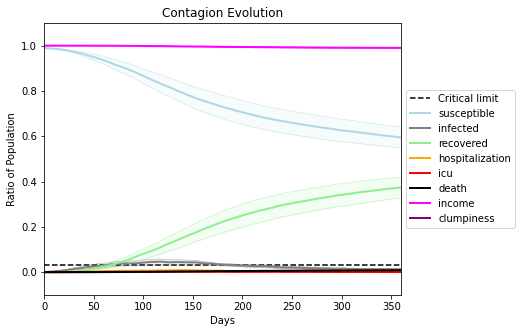

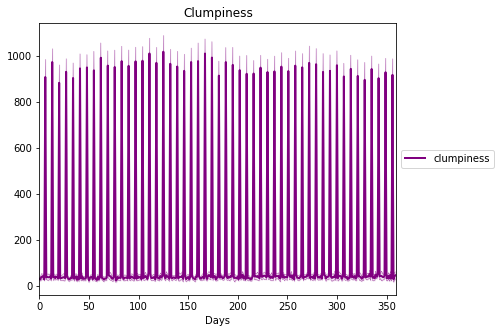

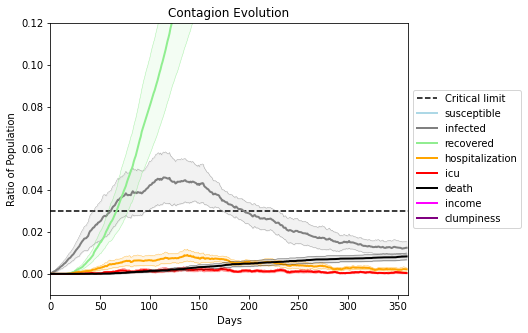

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5987, 3334, 4381, 4618, 4538, 8322, 3148, 5028, 4830, 9660, 7005, 7558, 4272, 8955, 6982, 4626, 4351, 6194, 8876, 7571]
Average similarity between family members is 0.0021063785103430334 at temperature 1
Average similarity between family and home is 0.9998591354470997 at temperature -1
Average similarity between students and their classroom is 0.03290146115105889 at temperature 1
Average classroom occupancy is 1.643979057591623 and number classrooms is 191
Average similarity between workers is 0.0008254784749992187 at temperature 1
Average office occupancy is 3.1170731707317074 and number offices is 205
Average friend similarity for adults: 0.08726640733615071 for kids: 0.09193976105027679
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity -0.038575011414728876
avg restaurant similarity -0.030008070199328815
avg restaurant similarity 0.04589215135491402
avg restaurant similarity 4.3451977442020776e-05
avg restaurant similarity 0.030245174309065058
avg restaurant similarity 0.02959264480753491
avg restaurant similarity 0.008873843233976731
avg restaurant similarity -0.016714385997962856
avg restaurant similarity -0.02142880002335745
avg restaurant similarity 0.05407788188859958
avg restaurant similarity -0.025439936594955942
avg restaurant similarity -0.021573786111404963
avg restaurant similarity 0.014933455483594047
avg restaurant similarity 0.005557397737642391
avg restaurant similarity -0.01861887032485629
avg restaurant similarity -0.010934379353041965
avg restaurant similarity 0.04141464161420451
avg restaurant similarity -0.03197465224708435
avg restaurant similarity 0.023972981209292494
avg restaurant similarity -0.041321381700773485
avg restaurant similarity -0.02390418881133696
avg rest

avg restaurant similarity -0.015958355025158917
avg restaurant similarity 0.02396500090796221
avg restaurant similarity -0.027631451439070493
avg restaurant similarity 0.05305446669698799
avg restaurant similarity -0.02250418844980799
avg restaurant similarity 0.016748500461364908
avg restaurant similarity 0.055142092590029904
avg restaurant similarity -0.006338361494619994
avg restaurant similarity -0.013105367545596614
avg restaurant similarity -0.0458158124641402
avg restaurant similarity 0.03753314592441471
avg restaurant similarity -0.012160974743728441
avg restaurant similarity 0.020397745778471324
avg restaurant similarity -0.013286222067684544
avg restaurant similarity 0.019267462415157956
avg restaurant similarity -0.0050372969914594294
avg restaurant similarity -0.027647330040000917
avg restaurant similarity -0.015156558571797858
avg restaurant similarity 0.016960563410316577
avg restaurant similarity 0.03369228848453457
avg restaurant similarity 0.006231299573524843
avg rest

avg restaurant similarity 0.029777759987764264
avg restaurant similarity -0.033517779840617316
avg restaurant similarity 0.004111878704802065
avg restaurant similarity -0.009956922543064003
avg restaurant similarity -0.019745937858723597
avg restaurant similarity 0.011635021607995311
avg restaurant similarity -0.02150931077180072
avg restaurant similarity 0.01214612043487732
avg restaurant similarity 0.028864187051119972
avg restaurant similarity 0.0105120723803649
avg restaurant similarity -0.0006699859117951725
avg restaurant similarity 0.015465071056388384
Average similarity between family members is -0.010695131161351592 at temperature 1
Average similarity between family and home is 0.9998572308366745 at temperature -1
Average similarity between students and their classroom is 0.007874009390678406 at temperature 1
Average classroom occupancy is 1.5945945945945945 and number classrooms is 185
Average similarity between workers is 0.013237620124593284 at temperature 1
Average office 

avg restaurant similarity -0.03191065201426684
avg restaurant similarity -0.006640141843000759
avg restaurant similarity -0.0708843480616875
avg restaurant similarity -0.0642317073157279
avg restaurant similarity -0.017040219601763672
avg restaurant similarity 0.007888733651088529
avg restaurant similarity 0.009559704829951486
avg restaurant similarity -0.005664680727314506
avg restaurant similarity 0.02819970273400201
avg restaurant similarity -0.015536946662338385
avg restaurant similarity -0.02827483149467095
avg restaurant similarity -0.025548615953928898
avg restaurant similarity 0.0022056140889495043
avg restaurant similarity 0.03930853052228094
avg restaurant similarity -0.025003899864576826
avg restaurant similarity -0.021361873861700294
avg restaurant similarity 0.014985865702768766
avg restaurant similarity 0.02353724544300851
avg restaurant similarity -0.04393499193086078
avg restaurant similarity 0.000300914973139399
avg restaurant similarity 0.024405799884548017
avg restau

avg restaurant similarity 0.02550969867166537
avg restaurant similarity 0.003613039292211084
avg restaurant similarity -0.013498516811975326
avg restaurant similarity -0.0204588441308203
avg restaurant similarity -0.06546101694394943
avg restaurant similarity -0.021241641756420234
avg restaurant similarity -0.08533619104276949
avg restaurant similarity -0.0359852390918162
avg restaurant similarity -0.01717276574968954
avg restaurant similarity -0.06326296647853615
avg restaurant similarity 0.018921990718459358
avg restaurant similarity -0.038693275575414944
avg restaurant similarity -0.01905545060955976
avg restaurant similarity -0.035597926205135855
avg restaurant similarity 0.02523237315545164
avg restaurant similarity 0.05197530875506689
avg restaurant similarity -0.02317069681637555
avg restaurant similarity 0.03551775635792757
avg restaurant similarity 0.04898430302117905
avg restaurant similarity 0.039604507622002405
avg restaurant similarity -0.007810452454326294
avg restaurant 

avg restaurant similarity -0.00614757771787064
avg restaurant similarity -0.00800298560463292
avg restaurant similarity 0.0006731972766893627
avg restaurant similarity 0.026744645510208068
avg restaurant similarity -0.03829949459915286
avg restaurant similarity 0.007032268726624824
avg restaurant similarity 0.009342275340224622
avg restaurant similarity -0.03314784718536153
avg restaurant similarity 0.040514054770845485
avg restaurant similarity -0.03728298647174121
avg restaurant similarity 0.005904654756224076
avg restaurant similarity 0.006853287798314105
Average similarity between family members is 0.03657414642788793 at temperature 1
Average similarity between family and home is 0.9998582043467327 at temperature -1
Average similarity between students and their classroom is 0.0359934154158309 at temperature 1
Average classroom occupancy is 1.6627218934911243 and number classrooms is 169
Average similarity between workers is 0.010379930981187228 at temperature 1
Average office occup

avg restaurant similarity 0.019018246264154264
avg restaurant similarity -0.020766308912577875
avg restaurant similarity -0.0121216019392976
avg restaurant similarity 0.011330895111158711
avg restaurant similarity 0.019781627096723427
avg restaurant similarity -0.007722740227199294
avg restaurant similarity 0.03889023497075167
avg restaurant similarity -0.008928353766533089
avg restaurant similarity -0.003756401777735748
avg restaurant similarity 0.0012398704403543458
avg restaurant similarity -0.052846239815362794
avg restaurant similarity -0.012626439834489507
avg restaurant similarity -0.07273549427933448
avg restaurant similarity 0.03061529098040661
avg restaurant similarity 0.047667231326846596
avg restaurant similarity -0.012915805546736292
avg restaurant similarity 0.021322425746826867
avg restaurant similarity -0.014163793035518712
avg restaurant similarity -0.007577872585045458
avg restaurant similarity 0.014549595982574387
avg restaurant similarity -0.001614028066437383
avg r

avg restaurant similarity 0.03869601909670966
avg restaurant similarity 0.014603083013519784
avg restaurant similarity -0.031249710608657978
avg restaurant similarity 0.02811489096272031
avg restaurant similarity 0.0012253741254042768
avg restaurant similarity 0.0022473450598821075
avg restaurant similarity 0.07079771751312873
avg restaurant similarity -7.942647495658453e-05
avg restaurant similarity -0.015312161809567565
avg restaurant similarity -0.02506375187574198
avg restaurant similarity 0.04165119960658767
avg restaurant similarity -0.043284598479624334
avg restaurant similarity 0.009206697617681251
avg restaurant similarity 0.03009757021587471
avg restaurant similarity -0.014401821487801733
avg restaurant similarity 0.022491849878987658
avg restaurant similarity 0.044745085448014164
avg restaurant similarity 0.014192926098466344
avg restaurant similarity -0.011727762631381596
avg restaurant similarity 0.008425391669182531
avg restaurant similarity -0.010196275323047876
avg rest

avg restaurant similarity -0.033864641117710405
avg restaurant similarity 0.026329674118844015
avg restaurant similarity 0.0026315142441838846
avg restaurant similarity -0.07660597545500478
avg restaurant similarity -0.02381394134658618
avg restaurant similarity 0.012292250591499063
avg restaurant similarity 0.01287298113000165
avg restaurant similarity -0.00585110697791787
avg restaurant similarity -0.012860461437951873
avg restaurant similarity -0.02074602538580356
avg restaurant similarity 0.01611236839657259
avg restaurant similarity -0.0037167788128239375
avg restaurant similarity 0.006344491523257618
Average similarity between family members is 0.007612322160796711 at temperature 1
Average similarity between family and home is 0.9998623706283017 at temperature -1
Average similarity between students and their classroom is 0.03322612794294512 at temperature 1
Average classroom occupancy is 1.5941176470588236 and number classrooms is 170
Average similarity between workers is 0.01789

avg restaurant similarity -0.03127787768984774
avg restaurant similarity -0.006393457324225562
avg restaurant similarity -0.032292834762740544
avg restaurant similarity 0.05554215769683136
avg restaurant similarity -0.030871509883117113
avg restaurant similarity 0.002354243793693218
avg restaurant similarity -0.022426749311806955
avg restaurant similarity -0.008459574960662943
avg restaurant similarity -0.022223068391863273
avg restaurant similarity -0.04660089701857718
avg restaurant similarity -0.04042480555900197
avg restaurant similarity -0.044516589449522526
avg restaurant similarity -0.03330146500901787
avg restaurant similarity -0.07651641962968328
avg restaurant similarity -0.05854716894926835
avg restaurant similarity -0.029110348002926716
avg restaurant similarity -0.06026490688723057
avg restaurant similarity -0.024151499928950423
avg restaurant similarity -0.016117161577557264
avg restaurant similarity -0.05693073947409826
avg restaurant similarity -0.019459717139626236
avg

avg restaurant similarity -0.025346174014042034
avg restaurant similarity -0.0494080226129162
avg restaurant similarity -0.0048945207140294045
avg restaurant similarity -0.026987082703089135
avg restaurant similarity -0.015053165449331718
avg restaurant similarity -0.017299293468194733
avg restaurant similarity -0.02346650298923709
avg restaurant similarity 0.012092652160640528
avg restaurant similarity -0.04260891720210658
avg restaurant similarity -0.002951223738407947
avg restaurant similarity -0.020578945924493847
avg restaurant similarity -0.041125537955814376
avg restaurant similarity 0.028690320389290466
avg restaurant similarity -0.03155764267671401
avg restaurant similarity -0.009089013925220431
avg restaurant similarity 0.00041174367187618924
avg restaurant similarity -0.05398813211307208
avg restaurant similarity -0.011942483918014918
avg restaurant similarity -0.014840282121812681
avg restaurant similarity 0.010571234757378648
avg restaurant similarity -0.001100388610585499

avg restaurant similarity 0.0007191794156190173
avg restaurant similarity 0.000865451176701232
avg restaurant similarity -0.012552469793732096
avg restaurant similarity -0.00641301859230483
avg restaurant similarity -0.037847104579289845
avg restaurant similarity 0.005643913185629847
avg restaurant similarity 0.001355941728632255
avg restaurant similarity -0.004370069556165937
avg restaurant similarity -0.013509780438041704
avg restaurant similarity -0.008955516940055397
avg restaurant similarity -0.024615214166722372
avg restaurant similarity -0.06111866464110574
avg restaurant similarity -0.025541308514821535
avg restaurant similarity -0.005815533722056197
Average similarity between family members is 0.014251883560358732 at temperature 1
Average similarity between family and home is 0.9998528991604261 at temperature -1
Average similarity between students and their classroom is 0.007173247370274007 at temperature 1
Average classroom occupancy is 1.5614973262032086 and number classroom

avg restaurant similarity -0.0020744609774317416
avg restaurant similarity 0.03673616519010896
avg restaurant similarity 0.056903903296897644
avg restaurant similarity 0.05924148614550223
avg restaurant similarity 0.02063252580934967
avg restaurant similarity 0.0348592671206133
avg restaurant similarity 0.022442154117610774
avg restaurant similarity 0.03884680459374804
avg restaurant similarity 0.012795507502675765
avg restaurant similarity 0.032333176301291955
avg restaurant similarity 0.035712803561134876
avg restaurant similarity 0.04056118111878428
avg restaurant similarity 0.03339386213178448
avg restaurant similarity -0.0021934366373127312
avg restaurant similarity 0.027632422466497567
avg restaurant similarity 0.03097297250828584
avg restaurant similarity 0.05141452199035651
avg restaurant similarity 0.059883618316446306
avg restaurant similarity 0.020837161571094588
avg restaurant similarity 0.037605163663835546
avg restaurant similarity 0.05118817693750028
avg restaurant simil

avg restaurant similarity 0.02936420481419277
avg restaurant similarity 0.04018363189944511
avg restaurant similarity 0.014856254852922406
avg restaurant similarity 0.0548322004561295
avg restaurant similarity 0.03045090941185908
avg restaurant similarity 0.018112623828757966
avg restaurant similarity 0.017012555256007523
avg restaurant similarity -0.005816953805272101
avg restaurant similarity 0.012813829667678965
avg restaurant similarity 0.020340731590352264
avg restaurant similarity 0.013675997316382246
avg restaurant similarity 0.04040847456877936
avg restaurant similarity 0.0459727968700278
avg restaurant similarity 0.023077224351354137
avg restaurant similarity -0.010604143143699877
avg restaurant similarity 0.05458056158626679
avg restaurant similarity 0.04197685021537659
avg restaurant similarity -0.022158600649947544
avg restaurant similarity 0.04535840285699282
avg restaurant similarity -0.03201589912026127
avg restaurant similarity -0.020585375474084205
avg restaurant simil

avg restaurant similarity 0.03184663722157235
avg restaurant similarity 0.004899091885726011
avg restaurant similarity -0.01312016539463366
avg restaurant similarity 0.020456204603563812
avg restaurant similarity 0.0018113150627053997
avg restaurant similarity 0.02884304133318342
avg restaurant similarity 0.008100312806149982
avg restaurant similarity 0.017029399501953847
Average similarity between family members is -0.00021750891372617073 at temperature 1
Average similarity between family and home is 0.9998617872050363 at temperature -1
Average similarity between students and their classroom is 0.017500512131992576 at temperature 1
Average classroom occupancy is 1.627027027027027 and number classrooms is 185
Average similarity between workers is -0.0006669837892664333 at temperature 1
Average office occupancy is 3.1625615763546797 and number offices is 203
Average friend similarity for adults: 0.07574670271625027 for kids: 0.0866830332452361
home_districts
[
Home (0,0) district with 1

avg restaurant similarity -0.027488444863767537
avg restaurant similarity -0.005522274648997365
avg restaurant similarity -0.020202108409448964
avg restaurant similarity 0.009959201282703917
avg restaurant similarity 0.01125009843783723
avg restaurant similarity -0.007310632200586071
avg restaurant similarity -0.0031959871683322582
avg restaurant similarity 0.0033705377563118264
avg restaurant similarity 0.005926899005165421
avg restaurant similarity -0.008289629456564163
avg restaurant similarity -0.0029406559364371456
avg restaurant similarity -0.01741898456762152
avg restaurant similarity -0.005509758650043243
avg restaurant similarity -0.029077909018995318
avg restaurant similarity 0.0010428429403639417
avg restaurant similarity -0.004530209682836513
avg restaurant similarity 0.016722149333459606
avg restaurant similarity 0.025204562941350366
avg restaurant similarity 0.02852761871950177
avg restaurant similarity -0.01576078912533955
avg restaurant similarity 0.012476561384806132
a

avg restaurant similarity 0.030868831331588208
avg restaurant similarity 0.0053190894382104245
avg restaurant similarity -0.00014313532314210622
avg restaurant similarity 0.01558043557022185
avg restaurant similarity -0.020118710961903492
avg restaurant similarity 0.07912778349158682
avg restaurant similarity -0.023889476455107677
avg restaurant similarity 0.03509967139158491
avg restaurant similarity 0.003987599475892483
avg restaurant similarity 0.05155391357666788
avg restaurant similarity 0.029629343461522184
avg restaurant similarity -0.004139841497476479
avg restaurant similarity -0.03576251387283375
avg restaurant similarity 0.005272414802204727
avg restaurant similarity -0.034761265074086826
avg restaurant similarity -0.037223269381084854
avg restaurant similarity -0.07386994324451658
avg restaurant similarity -0.0026194995972536636
avg restaurant similarity 0.0190189186943559
avg restaurant similarity -0.0015722990022843137
avg restaurant similarity -0.01462441373438987
avg re

avg restaurant similarity -0.02000891535587892
avg restaurant similarity 0.0571168962699955
avg restaurant similarity 0.00849852648086176
avg restaurant similarity 0.010844227757410497
avg restaurant similarity 0.009547468636250158
avg restaurant similarity 0.0027146396497245225
avg restaurant similarity -0.03466649709810627
avg restaurant similarity 0.05590369573659861
avg restaurant similarity -0.03554596014508065
avg restaurant similarity -0.005149735658837582
avg restaurant similarity 0.039426371089081785
avg restaurant similarity 0.004359825992387727
Average similarity between family members is 0.003839531602178862 at temperature 1
Average similarity between family and home is 0.9998582956118224 at temperature -1
Average similarity between students and their classroom is 0.02180308102475286 at temperature 1
Average classroom occupancy is 1.5872093023255813 and number classrooms is 172
Average similarity between workers is -0.006068388337484658 at temperature 1
Average office occup

avg restaurant similarity -0.022755568487397414
avg restaurant similarity 0.024142787582261578
avg restaurant similarity 0.01805575322164149
avg restaurant similarity 0.027091070112381238
avg restaurant similarity 0.0092641456249912
avg restaurant similarity -0.0004854449651311887
avg restaurant similarity 0.013867255752355812
avg restaurant similarity 0.02891741091457941
avg restaurant similarity -0.015264413753993086
avg restaurant similarity -0.016767680634569914
avg restaurant similarity -0.014201244541050677
avg restaurant similarity 0.034143540135145305
avg restaurant similarity -0.008154412873694322
avg restaurant similarity -0.015834567394108066
avg restaurant similarity 0.03076123862860408
avg restaurant similarity -0.0004155288209518284
avg restaurant similarity 0.03423804064443091
avg restaurant similarity 0.019190603115237043
avg restaurant similarity 0.011515696021399504
avg restaurant similarity 0.013882173049793976
avg restaurant similarity 0.015554408991447437
avg resta

avg restaurant similarity -0.020855489307909966
avg restaurant similarity 0.027888695807912825
avg restaurant similarity -0.0048823565904234124
avg restaurant similarity 0.02853000016823723
avg restaurant similarity 0.02137638479383098
avg restaurant similarity 0.02263754044622517
avg restaurant similarity -0.008924983861205146
avg restaurant similarity -0.02029343012354384
avg restaurant similarity 0.027911282994641618
avg restaurant similarity -0.0019634587343831575
avg restaurant similarity 0.04340025063613571
avg restaurant similarity 0.021332974417336625
avg restaurant similarity 0.01271735568238971
avg restaurant similarity 0.00017700999427373686
avg restaurant similarity 0.018839777806608414
avg restaurant similarity -0.01878340288143537
avg restaurant similarity 0.012001984731260048
avg restaurant similarity 0.03511369854796808
avg restaurant similarity 0.057681214194522185
avg restaurant similarity -0.021364147097948465
avg restaurant similarity 0.03310705032788643
avg restaur

avg restaurant similarity 0.014877995231836125
avg restaurant similarity -0.035265021474303104
avg restaurant similarity -0.016380393874783638
avg restaurant similarity 0.014447645452173705
avg restaurant similarity -0.001932227361871945
avg restaurant similarity -0.004558172518660671
avg restaurant similarity 0.03848455954809589
avg restaurant similarity 0.003672176232741608
avg restaurant similarity -0.0014132152475445146
avg restaurant similarity 0.019189964294769362
Average similarity between family members is 0.02485711153878057 at temperature 1
Average similarity between family and home is 0.9998614988360144 at temperature -1
Average similarity between students and their classroom is 0.022085993785816917 at temperature 1
Average classroom occupancy is 1.595505617977528 and number classrooms is 178
Average similarity between workers is 0.007681703349682238 at temperature 1
Average office occupancy is 3.282178217821782 and number offices is 202
Average friend similarity for adults:

avg restaurant similarity -0.0474138585262085
avg restaurant similarity 0.012680320814644947
avg restaurant similarity -0.010099534537753179
avg restaurant similarity 0.009621417416099433
avg restaurant similarity 0.022337449909926786
avg restaurant similarity -0.017454798988053327
avg restaurant similarity 0.012196661568892892
avg restaurant similarity 0.02888211436235028
avg restaurant similarity 0.01973763576709184
avg restaurant similarity 0.029597814872254546
avg restaurant similarity 0.03531047819924088
avg restaurant similarity -0.002410898959240368
avg restaurant similarity 0.004894285626070981
avg restaurant similarity 0.019278612148574018
avg restaurant similarity 0.038761975304985596
avg restaurant similarity 0.034591661349973886
avg restaurant similarity -0.035724528419261097
avg restaurant similarity 0.02890038515079727
avg restaurant similarity 0.03260859212998341
avg restaurant similarity -0.013001854202681202
avg restaurant similarity 0.029798837489645482
avg restaurant

avg restaurant similarity -0.011257995095125586
avg restaurant similarity -0.004775798607190913
avg restaurant similarity 0.050635599775805534
avg restaurant similarity 0.021620135315309947
avg restaurant similarity 0.040056211354394765
avg restaurant similarity -0.005763463804365243
avg restaurant similarity 0.00846222244156656
avg restaurant similarity 0.02399488817513109
avg restaurant similarity 0.05170580758930518
avg restaurant similarity 0.02951396052350622
avg restaurant similarity -0.039473887012181054
avg restaurant similarity -0.00732031223056172
avg restaurant similarity 0.05807044582522602
avg restaurant similarity -0.012455242575627546
avg restaurant similarity -0.02610839552157483
avg restaurant similarity -0.05922671299682343
avg restaurant similarity 0.044256068527211645
avg restaurant similarity 0.01938712663685642
avg restaurant similarity 0.020092057997840144
avg restaurant similarity 0.007287377593323547
avg restaurant similarity -0.01818327592222386
avg restaurant

avg restaurant similarity 0.03552273693378631
avg restaurant similarity -0.0036178525015712064
avg restaurant similarity 0.0239587517260699
avg restaurant similarity 0.021354736672542243
avg restaurant similarity 0.01771066257555545
avg restaurant similarity 0.06394834288263185
avg restaurant similarity 0.029414353740792265
avg restaurant similarity 0.029778240273094222
avg restaurant similarity 0.015874819559310135
avg restaurant similarity 0.009546725134481059
avg restaurant similarity -0.033708850487051585
Average similarity between family members is 0.018488463703677932 at temperature 1
Average similarity between family and home is 0.9998585033760424 at temperature -1
Average similarity between students and their classroom is 0.007020593292141419 at temperature 1
Average classroom occupancy is 1.6705882352941177 and number classrooms is 170
Average similarity between workers is 0.021200558569575246 at temperature 1
Average office occupancy is 3.328358208955224 and number offices is

avg restaurant similarity -0.05540194173086584
avg restaurant similarity 0.049499425074992415
avg restaurant similarity -0.019599461943835102
avg restaurant similarity 0.024247006222347316
avg restaurant similarity 0.016581857158592384
avg restaurant similarity 0.003295964072173187
avg restaurant similarity 0.05276671877922432
avg restaurant similarity -0.004665727285546077
avg restaurant similarity -0.02192451761830712
avg restaurant similarity 0.02408758394493213
avg restaurant similarity -0.012350622926118599
avg restaurant similarity 0.02652502570909769
avg restaurant similarity -0.005790963892033065
avg restaurant similarity -0.0031544608200476556
avg restaurant similarity 0.04482447715120457
avg restaurant similarity 0.0332029755367365
avg restaurant similarity 0.04741699725721562
avg restaurant similarity -0.02081815851437635
avg restaurant similarity -0.03376425911465004
avg restaurant similarity -0.0004470415197224654
avg restaurant similarity 0.008368219236290567
avg restaura

avg restaurant similarity -0.0016402127206248107
avg restaurant similarity -0.020760660291549996
avg restaurant similarity -0.013522728636256294
avg restaurant similarity 0.02499307831735783
avg restaurant similarity 0.0324890822620173
avg restaurant similarity -0.022298435562540728
avg restaurant similarity 0.041910249753219546
avg restaurant similarity -0.010258899719486821
avg restaurant similarity -0.03598810598171212
avg restaurant similarity -0.02290293120452668
avg restaurant similarity -0.003881138837694685
avg restaurant similarity -0.026385556407459532
avg restaurant similarity -0.013885707801514964
avg restaurant similarity 0.006488146907390779
avg restaurant similarity 0.007436568804382594
avg restaurant similarity -0.01857086794795396
avg restaurant similarity 0.015005395140927627
avg restaurant similarity -0.006440352647153279
avg restaurant similarity -0.01021707814524812
avg restaurant similarity -0.01208032463643765
avg restaurant similarity -0.01633019776282247
avg re

avg restaurant similarity 0.0036591656417134903
avg restaurant similarity -0.026153559870243995
avg restaurant similarity -0.018764693028876792
avg restaurant similarity -0.03135386302387078
avg restaurant similarity 0.036390078816661856
avg restaurant similarity -0.013188193700567192
avg restaurant similarity 0.01782472490372304
avg restaurant similarity 0.03248698863840447
avg restaurant similarity 0.014046446608438514
avg restaurant similarity -0.01728579350001796
avg restaurant similarity 0.020258440613682156
avg restaurant similarity 0.004914181184462982
Average similarity between family members is -0.0023308285604366433 at temperature 1
Average similarity between family and home is 0.9998494730270475 at temperature -1
Average similarity between students and their classroom is 0.006718289758685783 at temperature 1
Average classroom occupancy is 1.6935483870967742 and number classrooms is 186
Average similarity between workers is -0.022076599828860018 at temperature 1
Average offic

avg restaurant similarity 0.0071553167534724686
avg restaurant similarity -0.005456765173032585
avg restaurant similarity -0.006083739607365129
avg restaurant similarity 0.027473538358708225
avg restaurant similarity 0.014845075717196168
avg restaurant similarity -0.04150758297100937
avg restaurant similarity 0.03181588459752828
avg restaurant similarity -0.005942744799984776
avg restaurant similarity -0.006307841165887271
avg restaurant similarity -0.019855848334811528
avg restaurant similarity -0.05173984306724788
avg restaurant similarity 0.038011640731225066
avg restaurant similarity 0.0024752013313964387
avg restaurant similarity 0.03677266588805176
avg restaurant similarity -0.002102984928543016
avg restaurant similarity 0.018146963841574697
avg restaurant similarity -0.012102329586548218
avg restaurant similarity -0.031598908344304635
avg restaurant similarity 0.015488803023442466
avg restaurant similarity 0.03205297595186204
avg restaurant similarity 0.005647694169776621
avg re

avg restaurant similarity 0.017659698750038765
avg restaurant similarity 0.023118705219153955
avg restaurant similarity 0.0324304406594232
avg restaurant similarity 0.00471077900369719
avg restaurant similarity 0.003171532542587167
avg restaurant similarity 0.025815498885948984
avg restaurant similarity 0.016279679324966947
avg restaurant similarity 0.004564549230758777
avg restaurant similarity 0.014607708151728677
avg restaurant similarity -5.1345645036002615e-05
avg restaurant similarity -0.03317841420360744
avg restaurant similarity -0.04616084865561498
avg restaurant similarity -0.003488544257281486
avg restaurant similarity -0.02767402617623216
avg restaurant similarity 8.38763972841622e-05
avg restaurant similarity -0.008641367571038904
avg restaurant similarity -0.03815342165346536
avg restaurant similarity -0.032367795978935396
avg restaurant similarity 0.040325923614764884
avg restaurant similarity 0.00681214665375703
avg restaurant similarity 0.020357625572394462
avg restaur

avg restaurant similarity -0.015006626768280558
avg restaurant similarity -0.029671083215799164
avg restaurant similarity -0.011196195159996852
avg restaurant similarity -0.0018629515382327555
avg restaurant similarity -0.0402251293785973
avg restaurant similarity 0.04679763808078105
avg restaurant similarity -0.012620233675592663
avg restaurant similarity -0.021407249308085147
avg restaurant similarity -0.022633739490778626
avg restaurant similarity -0.014423669854448824
avg restaurant similarity -0.028000155287047045
avg restaurant similarity 0.008964851006436783
Average similarity between family members is 0.02352616295057622 at temperature 1
Average similarity between family and home is 0.9998388323152402 at temperature -1
Average similarity between students and their classroom is 0.03203330529070793 at temperature 1
Average classroom occupancy is 1.5804597701149425 and number classrooms is 174
Average similarity between workers is 0.0068586541938395725 at temperature 1
Average off

avg restaurant similarity 0.07314747340395307
avg restaurant similarity 0.023522747626400765
avg restaurant similarity 0.02425821083823637
avg restaurant similarity 0.05838491102131113
avg restaurant similarity 0.040726192026017974
avg restaurant similarity 0.012559466274137005
avg restaurant similarity 0.08634327273622151
avg restaurant similarity 0.03072941856287397
avg restaurant similarity 0.05259546464678236
avg restaurant similarity 0.05498601867228482
avg restaurant similarity 0.01474530701151054
avg restaurant similarity 0.0341802128055386
avg restaurant similarity 0.01662558787550583
avg restaurant similarity 0.05423265843750869
avg restaurant similarity 0.04078442608461618
avg restaurant similarity 0.03343942274523762
avg restaurant similarity 0.056667227216128824
avg restaurant similarity -0.0016789404114283663
avg restaurant similarity 0.035265856345726404
avg restaurant similarity -0.011742601679655133
avg restaurant similarity 0.030224180554286544
avg restaurant similarit

avg restaurant similarity 0.04524890468917646
avg restaurant similarity 0.02455460267938493
avg restaurant similarity 0.053903967823201705
avg restaurant similarity 0.01795427138922833
avg restaurant similarity 0.03135297041890107
avg restaurant similarity 0.027496891674209073
avg restaurant similarity 0.021155377506055877
avg restaurant similarity 0.016145568401869387
avg restaurant similarity -0.009407445980615287
avg restaurant similarity 0.024480005035004332
avg restaurant similarity 0.03379864518637518
avg restaurant similarity 0.01509462863934838
avg restaurant similarity 0.03695966954293851
avg restaurant similarity 0.03866414477435248
avg restaurant similarity -0.0059691476370103465
avg restaurant similarity 0.043666129038660746
avg restaurant similarity 0.043130124611568905
avg restaurant similarity 0.061688229882113324
avg restaurant similarity 0.019101723181884793
avg restaurant similarity 0.042522411151934066
avg restaurant similarity -0.0038422655239074084
avg restaurant s

avg restaurant similarity 0.032098787316419415
avg restaurant similarity -0.012228744024086354
avg restaurant similarity 0.029735285881879587
avg restaurant similarity 0.037375345171092596
avg restaurant similarity 0.018982545577245796
avg restaurant similarity 0.034922720264480886
avg restaurant similarity 0.015770825027417393
avg restaurant similarity -0.0021472352969701615
Average similarity between family members is 0.018572070843488653 at temperature 1
Average similarity between family and home is 0.9998593999001595 at temperature -1
Average similarity between students and their classroom is 0.04048547794809222 at temperature 1
Average classroom occupancy is 1.5833333333333333 and number classrooms is 180
Average similarity between workers is 0.018699252852872952 at temperature 1
Average office occupancy is 3.268292682926829 and number offices is 205
Average friend similarity for adults: 0.0776747547160144 for kids: 0.09046614674879351
home_districts
[
Home (0,0) district with 1 B

avg restaurant similarity 0.007855094945444709
avg restaurant similarity 0.03166432954626113
avg restaurant similarity 0.027463673910892068
avg restaurant similarity 0.01262308618069491
avg restaurant similarity -0.021144039169172634
avg restaurant similarity -0.0024160557615201367
avg restaurant similarity 0.011033958396967983
avg restaurant similarity -0.027341229970371937
avg restaurant similarity -0.001814486970591083
avg restaurant similarity 0.04303867382471504
avg restaurant similarity 0.011821515269634018
avg restaurant similarity 0.0046083507575456215
avg restaurant similarity -0.01855803013419106
avg restaurant similarity 0.014154549986028147
avg restaurant similarity 0.03147268882557855
avg restaurant similarity 0.003739989507582402
avg restaurant similarity 0.02213861640630972
avg restaurant similarity 0.020540001665611107
avg restaurant similarity 0.013780765334637271
avg restaurant similarity 0.004585197755356358
avg restaurant similarity -0.011990664451845372
avg restaur

avg restaurant similarity -0.014790195093267216
avg restaurant similarity -0.002272011214329008
avg restaurant similarity 0.01621927580272113
avg restaurant similarity 0.006417349633364198
avg restaurant similarity 0.014541993892904673
avg restaurant similarity 0.04738652895756677
avg restaurant similarity -0.008979208957464927
avg restaurant similarity -0.003064835081245904
avg restaurant similarity 0.04956193192967228
avg restaurant similarity -0.01597464704258865
avg restaurant similarity -0.00010998008488579565
avg restaurant similarity -0.01606876942021227
avg restaurant similarity 0.03470017811426168
avg restaurant similarity -0.020324921137419592
avg restaurant similarity -0.028718405037890433
avg restaurant similarity -0.00157341037255486
avg restaurant similarity 0.0012487184635517257
avg restaurant similarity 0.017095118448393967
avg restaurant similarity 0.01394842173416315
avg restaurant similarity -0.009252272579993087
avg restaurant similarity 0.010205411136413222
avg res

avg restaurant similarity -0.008790091118771742
avg restaurant similarity -0.05043052691051377
avg restaurant similarity -0.0015668469666056519
avg restaurant similarity 0.007166969732448027
avg restaurant similarity 0.02518010237329336
avg restaurant similarity -0.008545163276681464
avg restaurant similarity 0.04233936727355189
avg restaurant similarity -0.016369301632797977
avg restaurant similarity 0.018340403133758912
avg restaurant similarity 0.010265115252532302
avg restaurant similarity -0.009653835797877177
avg restaurant similarity 0.026425508802309632
avg restaurant similarity -0.02223386446997969
Average similarity between family members is 0.05574125876950516 at temperature 1
Average similarity between family and home is 0.9998572632762076 at temperature -1
Average similarity between students and their classroom is 0.005168631887237034 at temperature 1
Average classroom occupancy is 1.6011560693641618 and number classrooms is 173
Average similarity between workers is 0.0086

avg restaurant similarity -0.006973461070590369
avg restaurant similarity 0.027208467740584233
avg restaurant similarity 0.025703757357497782
avg restaurant similarity 0.018077695524393003
avg restaurant similarity -0.026071943764374824
avg restaurant similarity 0.031006537878373163
avg restaurant similarity 0.025829870307880923
avg restaurant similarity 0.014867690417219703
avg restaurant similarity 0.022496508042077618
avg restaurant similarity 0.06431939956030455
avg restaurant similarity -0.003347367614419087
avg restaurant similarity -0.0006028000381975713
avg restaurant similarity 0.015251345794650803
avg restaurant similarity 0.006599738035461787
avg restaurant similarity -0.012134133627363765
avg restaurant similarity 0.009124833013254468
avg restaurant similarity 0.045107999836214344
avg restaurant similarity 0.028023001716214743
avg restaurant similarity 0.012613999790031145
avg restaurant similarity 0.0071271097077113986
avg restaurant similarity 0.03503110138725375
avg rest

avg restaurant similarity 0.0023980000660418265
avg restaurant similarity 0.030486952585823346
avg restaurant similarity 0.023228309747320697
avg restaurant similarity -0.007364813269925387
avg restaurant similarity 0.0008595365178770767
avg restaurant similarity 0.017596667607271285
avg restaurant similarity -0.011604536522443861
avg restaurant similarity 0.005736327558286833
avg restaurant similarity 0.0009441420123680732
avg restaurant similarity 0.00609054763614399
avg restaurant similarity 0.0045859206019445535
avg restaurant similarity 0.00659205729528774
avg restaurant similarity 0.012844559208658377
avg restaurant similarity 0.04040726524247377
avg restaurant similarity -0.015033490120174318
avg restaurant similarity 0.014818494459847377
avg restaurant similarity -0.009066455665876622
avg restaurant similarity -0.01019383988331945
avg restaurant similarity -0.018204665874828798
avg restaurant similarity 0.07096774911126501
avg restaurant similarity 0.036964530103946514
avg rest

avg restaurant similarity 0.020038997320477033
avg restaurant similarity 0.005314694483520901
avg restaurant similarity 0.05082193451294067
avg restaurant similarity 0.01992959819419625
avg restaurant similarity -0.0007590542514082178
avg restaurant similarity 0.008495851797823547
avg restaurant similarity 0.035031477231269544
avg restaurant similarity 0.016684172097867142
avg restaurant similarity 0.00023591432104973017
avg restaurant similarity 0.0292948263530826
Average similarity between family members is 0.012322657705735804 at temperature 1
Average similarity between family and home is 0.9998618483596216 at temperature -1
Average similarity between students and their classroom is 0.02701899273367529 at temperature 1
Average classroom occupancy is 1.5396825396825398 and number classrooms is 189
Average similarity between workers is 0.018821582937525175 at temperature 1
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.

avg restaurant similarity 0.013137052430972017
avg restaurant similarity 0.01416752637992296
avg restaurant similarity -0.005984380602476242
avg restaurant similarity 0.0030558048662642358
avg restaurant similarity -0.010778055154025879
avg restaurant similarity 0.03498148424273289
avg restaurant similarity 0.0010649842857442843
avg restaurant similarity -0.00945913112633793
avg restaurant similarity 0.025970503396752418
avg restaurant similarity 0.024913322721478382
avg restaurant similarity 0.020710577598698498
avg restaurant similarity 0.0464645851778105
avg restaurant similarity 0.013139027202932788
avg restaurant similarity -0.0053068882447790365
avg restaurant similarity 0.02750861638652511
avg restaurant similarity -0.0053032497324522945
avg restaurant similarity -0.0157594459003986
avg restaurant similarity 0.001646833979780061
avg restaurant similarity -0.029726259474833486
avg restaurant similarity 0.006086879780339489
avg restaurant similarity 0.0064256626475391225
avg resta

avg restaurant similarity 0.03487711563932842
avg restaurant similarity -0.03653622098461869
avg restaurant similarity 0.03301336652622504
avg restaurant similarity 0.027720096590194847
avg restaurant similarity 0.028618546252447735
avg restaurant similarity -0.01040947546073521
avg restaurant similarity 0.0038606445686772727
avg restaurant similarity -0.009974932772300667
avg restaurant similarity -0.019176026652509417
avg restaurant similarity -0.00272273268219732
avg restaurant similarity 0.006901215315439328
avg restaurant similarity -0.001750391958001698
avg restaurant similarity 0.07467848811478839
avg restaurant similarity 0.028993989879544182
avg restaurant similarity 0.035562883148977965
avg restaurant similarity 0.03666011580957669
avg restaurant similarity 0.012850427679540054
avg restaurant similarity 0.026409173776825466
avg restaurant similarity 0.03346585538199174
avg restaurant similarity 0.046306066569250244
avg restaurant similarity 0.02183874887868338
avg restaurant 

avg restaurant similarity 0.04963157111579239
avg restaurant similarity 0.006434531558574016
avg restaurant similarity -0.030666547120466868
avg restaurant similarity 0.03105318308393259
avg restaurant similarity 0.0086339517368324
avg restaurant similarity 0.0168122147540352
avg restaurant similarity 0.022515656018805865
avg restaurant similarity -0.011403554766727443
avg restaurant similarity 0.002891862664027445
avg restaurant similarity 0.03672107612826473
avg restaurant similarity 0.02942781410982347
Average similarity between family members is 0.008040242873470433 at temperature 1
Average similarity between family and home is 0.9998489609684387 at temperature -1
Average similarity between students and their classroom is -0.015194654970755807 at temperature 1
Average classroom occupancy is 1.598901098901099 and number classrooms is 182
Average similarity between workers is 0.010428804634140405 at temperature 1
Average office occupancy is 3.251231527093596 and number offices is 203

avg restaurant similarity 0.03174105633485717
avg restaurant similarity -0.040120338607637904
avg restaurant similarity -0.006113295230607214
avg restaurant similarity -0.04140629141850704
avg restaurant similarity 0.024090747101912606
avg restaurant similarity -0.02974209697500735
avg restaurant similarity -0.030493789070352304
avg restaurant similarity 0.011249354108238001
avg restaurant similarity 0.0018579429738928971
avg restaurant similarity -0.049443608274302886
avg restaurant similarity 0.005523733868425671
avg restaurant similarity 0.012805015899496588
avg restaurant similarity -0.006576113147175137
avg restaurant similarity -0.0360387784649031
avg restaurant similarity 0.028745001948820965
avg restaurant similarity 0.03608856272033697
avg restaurant similarity -0.007862496734674165
avg restaurant similarity 0.020928657109619057
avg restaurant similarity -0.005158926223065506
avg restaurant similarity -0.014314437667272991
avg restaurant similarity -0.023876300868988086
avg re

avg restaurant similarity 0.03560844224470362
avg restaurant similarity 0.010366609701599682
avg restaurant similarity 0.033686978298516676
avg restaurant similarity -0.032313497962400975
avg restaurant similarity -0.021660627964578356
avg restaurant similarity 0.010954525927378781
avg restaurant similarity -0.005288942012999956
avg restaurant similarity 0.01882192699419518
avg restaurant similarity 0.0005783332735704257
avg restaurant similarity -0.021819486907386033
avg restaurant similarity 0.013642852788770615
avg restaurant similarity -0.0032887903573128783
avg restaurant similarity -0.06078646873635951
avg restaurant similarity -0.01062996404968509
avg restaurant similarity -0.03165202219830738
avg restaurant similarity 0.02324489191301863
avg restaurant similarity 0.030437132288954564
avg restaurant similarity -0.01591583064153061
avg restaurant similarity -0.036342452886454504
avg restaurant similarity -0.008293799038002973
avg restaurant similarity -0.0710896397515221
avg rest

avg restaurant similarity 0.027238338425858016
avg restaurant similarity -0.02199239563617478
avg restaurant similarity 0.011594833710788684
avg restaurant similarity 0.014231960699177742
avg restaurant similarity -0.006622241325013878
avg restaurant similarity 0.008824817055992662
avg restaurant similarity 0.010619893577235232
avg restaurant similarity -0.004234903719221347
avg restaurant similarity -0.006053058453796051
avg restaurant similarity 0.01853644224437102
avg restaurant similarity 0.012389291145138554
avg restaurant similarity -0.013545521312529313
avg restaurant similarity -0.020117514170088932
Average similarity between family members is 0.021140162552426685 at temperature 1
Average similarity between family and home is 0.9998575075964848 at temperature -1
Average similarity between students and their classroom is 0.016300106303842963 at temperature 1
Average classroom occupancy is 1.643979057591623 and number classrooms is 191
Average similarity between workers is 0.0073

avg restaurant similarity -0.005064006233317606
avg restaurant similarity -0.01591174883848193
avg restaurant similarity 0.06957972765807569
avg restaurant similarity -0.003982193759605939
avg restaurant similarity 0.014098471668175402
avg restaurant similarity -0.04238686730161069
avg restaurant similarity 0.039004715555799145
avg restaurant similarity 0.032451403113406004
avg restaurant similarity 0.026825286799310413
avg restaurant similarity -0.03689906919188558
avg restaurant similarity -0.034207241665424826
avg restaurant similarity 0.05480928203005821
avg restaurant similarity -0.02757414586411237
avg restaurant similarity 0.007382270117559368
avg restaurant similarity 0.06581760233065388
avg restaurant similarity 0.031123416804799568
avg restaurant similarity 0.011780961050667218
avg restaurant similarity -0.0171835121918354
avg restaurant similarity -0.008115912709765897
avg restaurant similarity 0.009732750407518177
avg restaurant similarity 0.007232647459421057
avg restauran

avg restaurant similarity 0.014789489887821833
avg restaurant similarity 0.0249723996942315
avg restaurant similarity -0.03244009207578945
avg restaurant similarity 0.02823104547736025
avg restaurant similarity 0.020193905496466137
avg restaurant similarity 0.0431905559965054
avg restaurant similarity 0.021456616215363752
avg restaurant similarity 0.0024584537792752847
avg restaurant similarity -0.011160232333623836
avg restaurant similarity 0.03507276581204788
avg restaurant similarity 0.020795746790582288
avg restaurant similarity -0.01221576925804526
avg restaurant similarity 0.014557204543569489
avg restaurant similarity 0.04725759502810027
avg restaurant similarity -0.040113947441827176
avg restaurant similarity 0.01962570330745328
avg restaurant similarity 0.0365274194044991
avg restaurant similarity 0.019368896198278918
avg restaurant similarity 0.05256423509921903
avg restaurant similarity -0.02086500887371499
avg restaurant similarity 0.044199801774430655
avg restaurant simila

avg restaurant similarity -0.0005219717364259471
avg restaurant similarity 0.02358406313821285
avg restaurant similarity 0.005175433194935607
avg restaurant similarity 0.026374595690869446
avg restaurant similarity 0.017756763938662826
avg restaurant similarity 0.007375814745438941
avg restaurant similarity 0.024706348268442622
avg restaurant similarity 0.017385836381805776
avg restaurant similarity 0.04023810489931034
avg restaurant similarity -0.007429070046210268
avg restaurant similarity -0.02853687896421438
Average similarity between family members is 0.0014842198336973156 at temperature 1
Average similarity between family and home is 0.9998617401885331 at temperature -1
Average similarity between students and their classroom is -0.04215694600019135 at temperature 1
Average classroom occupancy is 1.664864864864865 and number classrooms is 185
Average similarity between workers is 0.022014176872275495 at temperature 1
Average office occupancy is 3.1691542288557213 and number office

avg restaurant similarity 0.01698545719482869
avg restaurant similarity 0.004840217355507188
avg restaurant similarity 0.048535400468640424
avg restaurant similarity -0.0002128374381336724
avg restaurant similarity 0.008820310493272086
avg restaurant similarity 0.011513185906096695
avg restaurant similarity 0.04242145260900849
avg restaurant similarity 0.013473055988047353
avg restaurant similarity 0.02702237695338108
avg restaurant similarity 0.04478352467521853
avg restaurant similarity 0.04579359825249343
avg restaurant similarity -0.017408256893799993
avg restaurant similarity -0.006333298070811956
avg restaurant similarity 0.03542026249987307
avg restaurant similarity 0.04015610382493044
avg restaurant similarity 0.015621590219561764
avg restaurant similarity 0.012295208001170527
avg restaurant similarity 0.011785393255645094
avg restaurant similarity -0.009325294691205896
avg restaurant similarity -0.01215169980630261
avg restaurant similarity -0.0013409183791793418
avg restauran

avg restaurant similarity 0.02328112290962538
avg restaurant similarity 0.011786624347632144
avg restaurant similarity 0.040325201928505555
avg restaurant similarity 0.022972382076461448
avg restaurant similarity 0.0492197024738158
avg restaurant similarity -0.04843171794446575
avg restaurant similarity 0.01108883388872451
avg restaurant similarity 0.0389214859172133
avg restaurant similarity 0.03761767580117327
avg restaurant similarity 0.025312030396050983
avg restaurant similarity 0.009100239970769006
avg restaurant similarity 0.035612819300857704
avg restaurant similarity -0.014031544072665115
avg restaurant similarity 0.014578273239888213
avg restaurant similarity 0.02598313536119801
avg restaurant similarity -0.008170787347101454
avg restaurant similarity 0.04491626146901619
avg restaurant similarity -0.011253321456382637
avg restaurant similarity -0.007987032827562848
avg restaurant similarity 0.008107550428899974
avg restaurant similarity 0.03195366674973856
avg restaurant simi

avg restaurant similarity -0.0088008707754364
avg restaurant similarity 0.051931288925794565
avg restaurant similarity -0.0006904292065095385
avg restaurant similarity 0.010870711862462537
avg restaurant similarity 0.002974724034824262
avg restaurant similarity 0.05446531692784213
avg restaurant similarity 0.005783450594013809
avg restaurant similarity 0.026092222425846048
avg restaurant similarity -0.01502470058602571
Average similarity between family members is 0.017421898533812152 at temperature 1
Average similarity between family and home is 0.9998620614719621 at temperature -1
Average similarity between students and their classroom is -0.005227192788217987 at temperature 1
Average classroom occupancy is 1.5303867403314917 and number classrooms is 181
Average similarity between workers is 0.012278735015156325 at temperature 1
Average office occupancy is 3.323232323232323 and number offices is 198
Average friend similarity for adults: 0.08265692358125788 for kids: 0.0832152515149455

avg restaurant similarity 0.0036132072727797864
avg restaurant similarity 0.008317115456322544
avg restaurant similarity 0.03392584979839071
avg restaurant similarity -0.06210637573786395
avg restaurant similarity -0.03112973755119329
avg restaurant similarity 0.037949469987604637
avg restaurant similarity 0.013066444464175236
avg restaurant similarity 0.0668204538018298
avg restaurant similarity -0.02059298727570957
avg restaurant similarity 0.02144101173860812
avg restaurant similarity 0.007451706060945587
avg restaurant similarity 0.011033927161848032
avg restaurant similarity -0.012624353216778262
avg restaurant similarity 0.029067705427803413
avg restaurant similarity -0.045026829785146404
avg restaurant similarity -0.008995631365073767
avg restaurant similarity -0.004195420256470265
avg restaurant similarity 0.03051538650649062
avg restaurant similarity 0.007908322788681052
avg restaurant similarity -0.01789801461269708
avg restaurant similarity 0.005360381687226495
avg restauran

avg restaurant similarity -0.01358160897245691
avg restaurant similarity -0.011865137174799867
avg restaurant similarity 0.045013245046693295
avg restaurant similarity 0.021490065524224465
avg restaurant similarity 0.01643697658538078
avg restaurant similarity -0.008690772623832627
avg restaurant similarity -0.038142056893681234
avg restaurant similarity -0.02576639228502245
avg restaurant similarity 0.0003672934429518757
avg restaurant similarity 0.06406771808155293
avg restaurant similarity -0.048537250675814596
avg restaurant similarity -0.03261249607874907
avg restaurant similarity -0.018048910327132236
avg restaurant similarity -0.04591657177007137
avg restaurant similarity -0.024307643495849983
avg restaurant similarity -0.014851708386246927
avg restaurant similarity 0.0433724369147937
avg restaurant similarity 0.025032728318291297
avg restaurant similarity 0.0010672269554141578
avg restaurant similarity -0.01669087107125631
avg restaurant similarity 0.0017890818653470658
avg res

avg restaurant similarity -0.0030487402918587384
avg restaurant similarity 0.05272522407909348
avg restaurant similarity 0.03178307944793881
avg restaurant similarity -0.023528618210880786
avg restaurant similarity 0.0005183046977949774
avg restaurant similarity 0.04307490506546285
avg restaurant similarity 0.002395207249511158
avg restaurant similarity 0.006996664574240955
avg restaurant similarity -0.0030877266859141465
avg restaurant similarity -0.018309789102457275
avg restaurant similarity 0.0400004371011308
avg restaurant similarity 0.028654825381880224
Average similarity between family members is 0.022201944663056854 at temperature 1
Average similarity between family and home is 0.9998547728960867 at temperature -1
Average similarity between students and their classroom is 0.035538924456273935 at temperature 1
Average classroom occupancy is 1.5706214689265536 and number classrooms is 177
Average similarity between workers is 0.00789931835105965 at temperature 1
Average office oc

avg restaurant similarity 0.007050398763327612
avg restaurant similarity 0.026450051946583678
avg restaurant similarity 0.041844854082185565
avg restaurant similarity 0.024550655046933916
avg restaurant similarity -0.01187067999636136
avg restaurant similarity -0.0010109800131301986
avg restaurant similarity 0.07016903928125356
avg restaurant similarity 0.02283054662740905
avg restaurant similarity 0.014560094067111305
avg restaurant similarity 0.015953765688781756
avg restaurant similarity -0.003877482525372276
avg restaurant similarity 0.0076809138809969205
avg restaurant similarity 0.06300536589836847
avg restaurant similarity 0.03156186537483198
avg restaurant similarity 0.01433370568033403
avg restaurant similarity 0.038793147086860776
avg restaurant similarity 0.022438802230936396
avg restaurant similarity 0.012601691464236751
avg restaurant similarity 0.001686502095531224
avg restaurant similarity -0.04638327372700439
avg restaurant similarity 0.03628390586900232
avg restaurant 

avg restaurant similarity 0.044118665443361474
avg restaurant similarity 0.021024094245999266
avg restaurant similarity 0.007940545907157948
avg restaurant similarity 0.02206201132517817
avg restaurant similarity 0.010271938618611696
avg restaurant similarity 0.039874541161721545
avg restaurant similarity 0.013755156211203823
avg restaurant similarity 0.0015312817520399349
avg restaurant similarity 0.031585041357782985
avg restaurant similarity 0.035599058343715774
avg restaurant similarity 0.01489168632503361
avg restaurant similarity 0.01831163686307655
avg restaurant similarity 0.016245860541456252
avg restaurant similarity 0.02645852262364342
avg restaurant similarity 0.0330701962133397
avg restaurant similarity 0.009278731794552996
avg restaurant similarity 0.022463852716564404
avg restaurant similarity 0.024164027695746323
avg restaurant similarity 8.428166513306309e-05
avg restaurant similarity 0.006907191955581402
avg restaurant similarity 0.010267813034645749
avg restaurant si

avg restaurant similarity 0.024974455217846483
avg restaurant similarity 0.04874703792690983
avg restaurant similarity 0.026444788835652634
avg restaurant similarity 0.030606739198751638
avg restaurant similarity 0.04743158917658396
avg restaurant similarity -0.017363114879658036
avg restaurant similarity 0.027243477766406076
avg restaurant similarity -0.025577959089003826
avg restaurant similarity 0.020054061760566514
avg restaurant similarity 0.024145430180173198
Average similarity between family members is 0.0032857842129210488 at temperature 1
Average similarity between family and home is 0.9998563788521658 at temperature -1
Average similarity between students and their classroom is 0.03375408727823845 at temperature 1
Average classroom occupancy is 1.6236559139784945 and number classrooms is 186
Average similarity between workers is 0.001177867378352196 at temperature 1
Average office occupancy is 3.081730769230769 and number offices is 208
Average friend similarity for adults: 0.

avg restaurant similarity 1.4233626915919709e-05
avg restaurant similarity 0.010961711096447068
avg restaurant similarity 0.011650089638888512
avg restaurant similarity 0.013761891354542989
avg restaurant similarity 0.03803964757028012
avg restaurant similarity -0.012553163907702343
avg restaurant similarity 0.012960139212540796
avg restaurant similarity 0.023132868241565768
avg restaurant similarity 0.01868546793896041
avg restaurant similarity 0.013339696108944803
avg restaurant similarity 0.003109451502811766
avg restaurant similarity 0.025942909437787782
avg restaurant similarity 0.05301620214420136
avg restaurant similarity 0.021953508057013727
avg restaurant similarity 0.0392080749007594
avg restaurant similarity 0.008792643318771448
avg restaurant similarity 0.011956927874586102
avg restaurant similarity 0.029020275634110877
avg restaurant similarity -0.028027135898381184
avg restaurant similarity -0.010495180517161327
avg restaurant similarity 0.0168487297839492
avg restaurant 

avg restaurant similarity -0.003128103285266832
avg restaurant similarity 0.05362580439786787
avg restaurant similarity 0.023655935704446514
avg restaurant similarity 0.02050590736975519
avg restaurant similarity 0.0400495338186464
avg restaurant similarity 0.016117345181267395
avg restaurant similarity 0.024871859025367073
avg restaurant similarity 0.03268141497661672
avg restaurant similarity 0.012749360766889211
avg restaurant similarity 0.03254495243287761
avg restaurant similarity -0.020023325000674757
avg restaurant similarity 0.007419480749768235
avg restaurant similarity 0.06402380070229403
avg restaurant similarity 0.0007632017850790938
avg restaurant similarity 0.005959479714313206
avg restaurant similarity 0.07781198857585306
avg restaurant similarity 0.02038457983645129
avg restaurant similarity 0.008086185264121724
avg restaurant similarity -0.02986745048343493
avg restaurant similarity 0.03042969321853352
avg restaurant similarity 0.01862670046875794
avg restaurant simila

avg restaurant similarity 0.033284068566608836
avg restaurant similarity 0.02234822421393235
avg restaurant similarity 0.01769772942521693
avg restaurant similarity 0.042063932509261194
avg restaurant similarity 0.04651580927195085
avg restaurant similarity -0.002601627271997218
avg restaurant similarity 0.03659303858606286
avg restaurant similarity -0.049368106535543854
avg restaurant similarity 0.024920911662620913
avg restaurant similarity 0.025550578250467214
using average of time series:
stats on susceptible:
data: [0.8656243069416724, 0.7634527777777776, 0.8388527777777777, 0.8196749999999999, 0.7832944444444444, 0.611929736929737, 0.7726555555555555, 0.7692027777777778, 0.8385833333333333, 0.8492, 0.8463444444444446, 0.8457486957486957, 0.6704777777777778, 0.8363194444444446, 0.7647621423819029, 0.5575638888888889, 0.6718972222222221, 0.7378499999999999, 0.8253611111111111, 0.7926638888888888]
min:
0.5575638888888889
max:
0.8656243069416724
std:
0.08295039868467925
mean:
0.77307

(<function dict.items>, <function dict.items>, <function dict.items>)

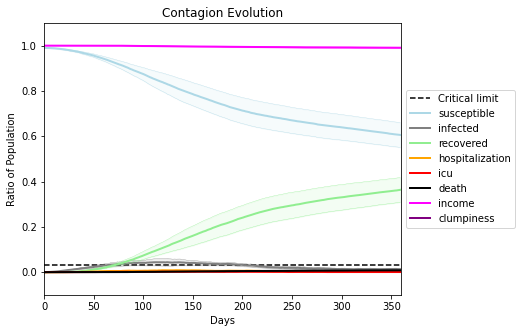

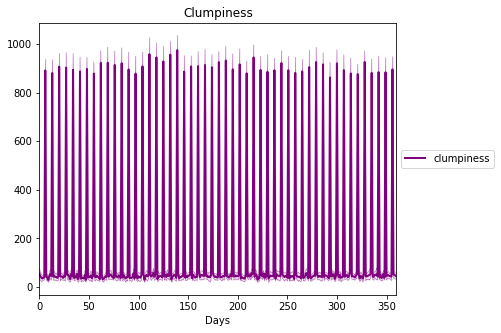

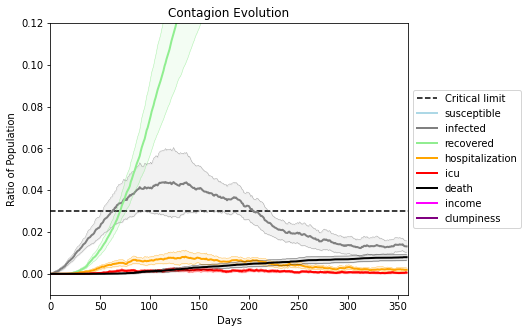

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)